In [7]:
import numpy as np
import os
import pickle
import matplotlib.pyplot as plt

In [8]:
def loadData(path):
    listOfFiles = os.listdir(path='cifar-10-batches-py/')
    train = []
    train_labels = []
        
        
    print("Training files = ",listOfFiles[1:6])
    #For collecting Training data:
    for file in listOfFiles[1:6]:
        with open(path+file,'rb') as fo:
            dict = pickle.load(fo,encoding='bytes')
            train.append(dict[b'data'])
            train_labels.append(dict[b'labels'])

    dictData = {}
    dictData['train_data'] = np.reshape(np.array(train),newshape=(np.array(train).shape[0]*np.array(train).shape[1],np.array(train).shape[2]))
    dictData['train_labels'] = np.reshape(np.array(train_labels),newshape=(np.array(train_labels).shape[0]*np.array(train_labels).shape[1]))
    return dictData

In [9]:
#load the dataset
dataset = loadData(path='cifar-10-batches-py/')

Training files =  ['data_batch_1', 'data_batch_2', 'data_batch_3', 'data_batch_4', 'data_batch_5']


In [10]:
dataset['train_data'].shape[0]

50000

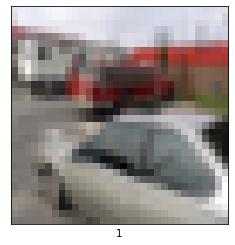

In [11]:
#visualizing train sample
temp = dataset['train_data'][49999]
label = dataset['train_labels'][49999]
# Since every row represents one example to re-map it to image we have to form three 32,32 matrix,
#representing RGB values

R = temp[0:1024].reshape(32,32)
G = np.reshape(temp[1024:2048],newshape=(32,32))
B = np.reshape(temp[2048:],newshape=(32,32))
temp = np.dstack((R,G,B))   #for stacking all these 32,32 matrices.
plt.imshow(temp)
plt.xticks([])
plt.yticks([])
plt.xlabel(label)
plt.show()

In [12]:
X_train, y_train= dataset['train_data'][20000:40000],dataset['train_labels'][20000:40000]

In [13]:
#Building the actual classifier:
#inputs will be of shape N X F where N = number of examples and F = number of features for each image.
#labels will be of size N,1. This consists of labels for all N labels from 10 classes

class kNearestNeighbour(object):
    def __init__(self):
        pass
    
    def train(self,X,Y):
        #Knn will remember all of its training data
        self.Xtr = X
        self.Ytr = Y
        
    def predict(self,X,k):
        #to get no. of samples in train set 
        test_samples = X.shape[0]
        print("Sample Size : ",test_samples)
        Ypred = np.zeros(test_samples,dtype=self.Ytr.dtype)
        
        #Calculating the l1 distance between current samples of test and train set
        for i in range(test_samples):
            
            print("Test example = ",i,end="\n")
            #label_count is array of zeros used to store the count for each class while comparing neighbours
            label_count = np.zeros(10,dtype=self.Ytr.dtype)    
            dist = np.sum(np.abs(X[i,:] - self.Xtr),axis=1)   #take the absolute sum horizontally across columns

            
            #idx will contain k smallest indices at the start of the list
            #this is called partial sorting for more information look: https://docs.scipy.org/doc/numpy/reference/generated/numpy.argpartition.html
            #min_ind will help us to slice through k indices which have minimum distance
            idx = np.argpartition(dist,k)
            min_ind = idx[:k]
            print("min_ind : ",min_ind,end="\n")
            
            
            #This for loop iterates over min_ind and find the label present in train-set_Y for x
            #and increase the count at that particular index whenever any label is repeated.
            #Max value at any index is returned using np.argmax() and stored at ith index of Ypred i.e. predicted values
            for x in min_ind:
                print("x : ",x,end="\n")
                label_count[int(self.Ytr[x])] +=1
                print("label_count : ",label_count,end="\n")
            Ypred[i] = np.argmax(label_count)
            print("Ypred[",i,"] : ", Ypred[i],end="\n")

    
    
        return Ypred



In [14]:
#Splitting the data into 5 equal folds
num_folds = 4
num_training = 20000

k_choices = [1,2,3,4,5]

# Check that training set can be equally divided into num_folds portions
if num_training/num_folds % num_folds != 0.0:
    raise ValueError('Number of training examples not evenly divisible by number of folds.')

# Split training set into num_folds lists
X_train_folds = np.split(X_train, num_folds)
y_train_folds = np.split(y_train, num_folds)

# A dictionary holding the accuracies for different values of k that we find
# when running cross-validation. After running cross-validation,
# k_to_accuracies[k] should be a list of length num_folds giving the different
# accuracy values that we found when using that value of k.
k_to_accuracies = {}

# Perform k-fold cross validation to find the best value of k
# Loop over num_folds in outer loop to reuse computed distances for all values of k
for k in k_choices:
    k_to_accuracies[k] = []
    
for idx in range(num_folds):
    print("Fold :", idx)
    # Use bin with index idx as validation set, rest as training set 
    X_train_set = np.concatenate((*X_train_folds[:idx], *X_train_folds[idx+1:]), axis=0)
    y_train_set = np.concatenate((*y_train_folds[:idx], *y_train_folds[idx+1:]), axis=0)
    X_validation_set = X_train_folds[idx]
    y_validation_set = y_train_folds[idx]   
    num_validation_set = X_validation_set.shape[0]
    # Train kNN classifier
    knn = kNearestNeighbour()
    knn.train(X_train_set, y_train_set)

    
    for k in k_choices:
        print("For k = ",k,end="\n")
        # Predict labels for validation set
        y_validation_pred = knn.predict(X_validation_set,k)
        # Check accuracy for validation set
        accuracy = np.mean(y_validation_pred==y_validation_set)
        k_to_accuracies[k].append(accuracy)
        print("\n")

Fold : 0
For k =  1
Sample Size :  5000
Test example =  0
min_ind :  [14514]
x :  14514
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 0 ] :  2
Test example =  1
min_ind :  [3952]
x :  3952
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1 ] :  5
Test example =  2
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2 ] :  4
Test example =  3
min_ind :  [10470]
x :  10470
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3 ] :  0
Test example =  4
min_ind :  [8635]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4 ] :  3
Test example =  5
min_ind :  [14779]
x :  14779
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 5 ] :  5
Test example =  6
min_ind :  [5776]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 6 ] :  9
Test example =  7
min_ind :  [2441]
x :  2441
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 7 ] :  3
Test example =  8
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 8 ] :  6
Test example =  9
min_ind :  [1757]
x :  1757
label_count :

min_ind :  [3133]
x :  3133
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 81 ] :  0
Test example =  82
min_ind :  [5636]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 82 ] :  0
Test example =  83
min_ind :  [4980]
x :  4980
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 83 ] :  0
Test example =  84
min_ind :  [2554]
x :  2554
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 84 ] :  6
Test example =  85
min_ind :  [2779]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 85 ] :  3
Test example =  86
min_ind :  [12524]
x :  12524
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 86 ] :  8
Test example =  87
min_ind :  [432]
x :  432
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 87 ] :  5
Test example =  88
min_ind :  [3834]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 88 ] :  2
Test example =  89
min_ind :  [3396]
x :  3396
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 89 ] :  8
Test example =  90
min_ind :  [9827]
x :  9827
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 90 ] :  2
Test exam

min_ind :  [6270]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 161 ] :  6
Test example =  162
min_ind :  [1031]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 162 ] :  7
Test example =  163
min_ind :  [13887]
x :  13887
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 163 ] :  3
Test example =  164
min_ind :  [8529]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 164 ] :  4
Test example =  165
min_ind :  [7363]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 165 ] :  0
Test example =  166
min_ind :  [2980]
x :  2980
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 166 ] :  2
Test example =  167
min_ind :  [7555]
x :  7555
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 167 ] :  3
Test example =  168
min_ind :  [6835]
x :  6835
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 168 ] :  6
Test example =  169
min_ind :  [13133]
x :  13133
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 169 ] :  8
Test example =  170
min_ind :  [252]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[

min_ind :  [14771]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 241 ] :  1
Test example =  242
min_ind :  [1189]
x :  1189
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 242 ] :  3
Test example =  243
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 243 ] :  4
Test example =  244
min_ind :  [8881]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 244 ] :  2
Test example =  245
min_ind :  [12480]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 245 ] :  1
Test example =  246
min_ind :  [9695]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 246 ] :  8
Test example =  247
min_ind :  [4625]
x :  4625
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 247 ] :  2
Test example =  248
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 248 ] :  0
Test example =  249
min_ind :  [14438]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 249 ] :  3
Test example =  250
min_ind :  [11303]
x :  11303
label_count :  [0 0 0 0 0 0 0 1 0 0]


min_ind :  [14960]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 321 ] :  2
Test example =  322
min_ind :  [11142]
x :  11142
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 322 ] :  4
Test example =  323
min_ind :  [7125]
x :  7125
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 323 ] :  6
Test example =  324
min_ind :  [8112]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 324 ] :  1
Test example =  325
min_ind :  [4717]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 325 ] :  0
Test example =  326
min_ind :  [7615]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 326 ] :  4
Test example =  327
min_ind :  [7428]
x :  7428
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 327 ] :  7
Test example =  328
min_ind :  [2681]
x :  2681
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 328 ] :  0
Test example =  329
min_ind :  [2432]
x :  2432
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 329 ] :  3
Test example =  330
min_ind :  [9817]
x :  9817
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypre

min_ind :  [4599]
x :  4599
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 401 ] :  0
Test example =  402
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 402 ] :  1
Test example =  403
min_ind :  [2205]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 403 ] :  4
Test example =  404
min_ind :  [8380]
x :  8380
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 404 ] :  0
Test example =  405
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 405 ] :  2
Test example =  406
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 406 ] :  6
Test example =  407
min_ind :  [8821]
x :  8821
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 407 ] :  7
Test example =  408
min_ind :  [3545]
x :  3545
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 408 ] :  2
Test example =  409
min_ind :  [4865]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 409 ] :  3
Test example =  410
min_ind :  [0]
x :  0
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 410 ] :  

min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 481 ] :  8
Test example =  482
min_ind :  [9542]
x :  9542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 482 ] :  6
Test example =  483
min_ind :  [2205]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 483 ] :  4
Test example =  484
min_ind :  [5414]
x :  5414
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 484 ] :  4
Test example =  485
min_ind :  [13845]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 485 ] :  6
Test example =  486
min_ind :  [7908]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 486 ] :  2
Test example =  487
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 487 ] :  4
Test example =  488
min_ind :  [3729]
x :  3729
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 488 ] :  4
Test example =  489
min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 489 ] :  0
Test example =  490
min_ind :  [5604]
x :  5604
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypre

min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 561 ] :  0
Test example =  562
min_ind :  [4583]
x :  4583
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 562 ] :  3
Test example =  563
min_ind :  [4111]
x :  4111
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 563 ] :  4
Test example =  564
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 564 ] :  6
Test example =  565
min_ind :  [13884]
x :  13884
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 565 ] :  7
Test example =  566
min_ind :  [14197]
x :  14197
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 566 ] :  6
Test example =  567
min_ind :  [1486]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 567 ] :  5
Test example =  568
min_ind :  [5825]
x :  5825
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 568 ] :  7
Test example =  569
min_ind :  [14426]
x :  14426
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 569 ] :  2
Test example =  570
min_ind :  [3744]
x :  3744
label_count :  [0 0 0 0 1 0 0 0 0 0]
Yp

min_ind :  [11988]
x :  11988
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 641 ] :  5
Test example =  642
min_ind :  [11461]
x :  11461
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 642 ] :  9
Test example =  643
min_ind :  [9720]
x :  9720
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 643 ] :  1
Test example =  644
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 644 ] :  4
Test example =  645
min_ind :  [4636]
x :  4636
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 645 ] :  2
Test example =  646
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 646 ] :  4
Test example =  647
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 647 ] :  4
Test example =  648
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 648 ] :  3
Test example =  649
min_ind :  [8265]
x :  8265
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 649 ] :  7
Test example =  650
min_ind :  [4928]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Yp

min_ind :  [14090]
x :  14090
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 721 ] :  5
Test example =  722
min_ind :  [6061]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 722 ] :  4
Test example =  723
min_ind :  [8209]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 723 ] :  4
Test example =  724
min_ind :  [1555]
x :  1555
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 724 ] :  4
Test example =  725
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 725 ] :  8
Test example =  726
min_ind :  [3396]
x :  3396
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 726 ] :  8
Test example =  727
min_ind :  [8713]
x :  8713
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 727 ] :  8
Test example =  728
min_ind :  [11771]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 728 ] :  0
Test example =  729
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 729 ] :  0
Test example =  730
min_ind :  [398]
x :  398
label_count :  [0 0 1 0 0 0 0 0 0 0]
Yp

min_ind :  [6932]
x :  6932
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 801 ] :  4
Test example =  802
min_ind :  [442]
x :  442
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 802 ] :  6
Test example =  803
min_ind :  [8018]
x :  8018
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 803 ] :  6
Test example =  804
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 804 ] :  0
Test example =  805
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 805 ] :  3
Test example =  806
min_ind :  [4685]
x :  4685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 806 ] :  3
Test example =  807
min_ind :  [13417]
x :  13417
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 807 ] :  5
Test example =  808
min_ind :  [11396]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 808 ] :  6
Test example =  809
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 809 ] :  4
Test example =  810
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypre

min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 881 ] :  3
Test example =  882
min_ind :  [5513]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 882 ] :  2
Test example =  883
min_ind :  [13390]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 883 ] :  3
Test example =  884
min_ind :  [2417]
x :  2417
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 884 ] :  4
Test example =  885
min_ind :  [1276]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 885 ] :  7
Test example =  886
min_ind :  [7286]
x :  7286
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 886 ] :  7
Test example =  887
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 887 ] :  3
Test example =  888
min_ind :  [9068]
x :  9068
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 888 ] :  1
Test example =  889
min_ind :  [14286]
x :  14286
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 889 ] :  0
Test example =  890
min_ind :  [6377]
x :  6377
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypre

min_ind :  [11653]
x :  11653
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 961 ] :  5
Test example =  962
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 962 ] :  0
Test example =  963
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 963 ] :  4
Test example =  964
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 964 ] :  3
Test example =  965
min_ind :  [2931]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 965 ] :  0
Test example =  966
min_ind :  [941]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 966 ] :  4
Test example =  967
min_ind :  [5592]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 967 ] :  7
Test example =  968
min_ind :  [9562]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 968 ] :  4
Test example =  969
min_ind :  [13221]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 969 ] :  8
Test example =  970
min_ind :  [4495]
x :  4495
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypre

min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1041 ] :  6
Test example =  1042
min_ind :  [12172]
x :  12172
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1042 ] :  4
Test example =  1043
min_ind :  [13580]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1043 ] :  0
Test example =  1044
min_ind :  [10967]
x :  10967
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1044 ] :  2
Test example =  1045
min_ind :  [9225]
x :  9225
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1045 ] :  3
Test example =  1046
min_ind :  [10985]
x :  10985
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1046 ] :  8
Test example =  1047
min_ind :  [4655]
x :  4655
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1047 ] :  0
Test example =  1048
min_ind :  [931]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1048 ] :  4
Test example =  1049
min_ind :  [1030]
x :  1030
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1049 ] :  5
Test example =  1050
min_ind :  [6835]
x :  6835
label_count :  [0 0 0

min_ind :  [7629]
x :  7629
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1119 ] :  0
Test example =  1120
min_ind :  [14054]
x :  14054
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1120 ] :  6
Test example =  1121
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1121 ] :  0
Test example =  1122
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1122 ] :  4
Test example =  1123
min_ind :  [13683]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1123 ] :  0
Test example =  1124
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1124 ] :  3
Test example =  1125
min_ind :  [415]
x :  415
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1125 ] :  2
Test example =  1126
min_ind :  [3266]
x :  3266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1126 ] :  8
Test example =  1127
min_ind :  [3377]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1127 ] :  2
Test example =  1128
min_ind :  [997]
x :  997
label_count :  [0 0 0 1 0

min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1197 ] :  0
Test example =  1198
min_ind :  [2722]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1198 ] :  3
Test example =  1199
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1199 ] :  0
Test example =  1200
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1200 ] :  2
Test example =  1201
min_ind :  [4717]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1201 ] :  0
Test example =  1202
min_ind :  [12095]
x :  12095
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1202 ] :  3
Test example =  1203
min_ind :  [13010]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1203 ] :  0
Test example =  1204
min_ind :  [979]
x :  979
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1204 ] :  6
Test example =  1205
min_ind :  [4625]
x :  4625
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1205 ] :  2
Test example =  1206
min_ind :  [6338]
x :  6338
label_count :  [0 1 0 0 0 0

min_ind :  [13410]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1276 ] :  0
Test example =  1277
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1277 ] :  4
Test example =  1278
min_ind :  [4714]
x :  4714
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1278 ] :  2
Test example =  1279
min_ind :  [972]
x :  972
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1279 ] :  6
Test example =  1280
min_ind :  [7968]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1280 ] :  0
Test example =  1281
min_ind :  [13375]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1281 ] :  4
Test example =  1282
min_ind :  [4711]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1282 ] :  1
Test example =  1283
min_ind :  [6479]
x :  6479
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1283 ] :  3
Test example =  1284
min_ind :  [1757]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1284 ] :  2
Test example =  1285
min_ind :  [8204]
x :  8204
label_count :  [0 0 1 0 0

min_ind :  [4645]
x :  4645
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1355 ] :  2
Test example =  1356
min_ind :  [2205]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1356 ] :  4
Test example =  1357
min_ind :  [12621]
x :  12621
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1357 ] :  5
Test example =  1358
min_ind :  [1757]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1358 ] :  2
Test example =  1359
min_ind :  [1723]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1359 ] :  0
Test example =  1360
min_ind :  [12324]
x :  12324
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1360 ] :  0
Test example =  1361
min_ind :  [14309]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1361 ] :  2
Test example =  1362
min_ind :  [2722]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1362 ] :  3
Test example =  1363
min_ind :  [12511]
x :  12511
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1363 ] :  2
Test example =  1364
min_ind :  [6237]
x :  6237
label_count :  [0 0

min_ind :  [3564]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1433 ] :  2
Test example =  1434
min_ind :  [12041]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1434 ] :  0
Test example =  1435
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1435 ] :  3
Test example =  1436
min_ind :  [1096]
x :  1096
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1436 ] :  2
Test example =  1437
min_ind :  [14793]
x :  14793
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1437 ] :  0
Test example =  1438
min_ind :  [9562]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1438 ] :  4
Test example =  1439
min_ind :  [14915]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1439 ] :  8
Test example =  1440
min_ind :  [4267]
x :  4267
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1440 ] :  4
Test example =  1441
min_ind :  [4865]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1441 ] :  3
Test example =  1442
min_ind :  [10146]
x :  10146
label_count :  [0 0

min_ind :  [3081]
x :  3081
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1511 ] :  1
Test example =  1512
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1512 ] :  6
Test example =  1513
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1513 ] :  4
Test example =  1514
min_ind :  [10026]
x :  10026
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1514 ] :  3
Test example =  1515
min_ind :  [7356]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1515 ] :  8
Test example =  1516
min_ind :  [11223]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1516 ] :  9
Test example =  1517
min_ind :  [4129]
x :  4129
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1517 ] :  4
Test example =  1518
min_ind :  [8432]
x :  8432
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1518 ] :  9
Test example =  1519
min_ind :  [1057]
x :  1057
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1519 ] :  9
Test example =  1520
min_ind :  [4601]
x :  4601
label_count :  [0 0 0

min_ind :  [11019]
x :  11019
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1589 ] :  4
Test example =  1590
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1590 ] :  6
Test example =  1591
min_ind :  [956]
x :  956
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1591 ] :  2
Test example =  1592
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1592 ] :  8
Test example =  1593
min_ind :  [10301]
x :  10301
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1593 ] :  8
Test example =  1594
min_ind :  [11374]
x :  11374
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1594 ] :  0
Test example =  1595
min_ind :  [6899]
x :  6899
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1595 ] :  1
Test example =  1596
min_ind :  [3418]
x :  3418
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1596 ] :  8
Test example =  1597
min_ind :  [5959]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1597 ] :  0
Test example =  1598
min_ind :  [14238]
x :  14238
label_count :  [0

min_ind :  [14364]
x :  14364
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1667 ] :  8
Test example =  1668
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1668 ] :  6
Test example =  1669
min_ind :  [9641]
x :  9641
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1669 ] :  8
Test example =  1670
min_ind :  [932]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1670 ] :  6
Test example =  1671
min_ind :  [9695]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1671 ] :  8
Test example =  1672
min_ind :  [252]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1672 ] :  5
Test example =  1673
min_ind :  [2205]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1673 ] :  4
Test example =  1674
min_ind :  [14281]
x :  14281
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1674 ] :  0
Test example =  1675
min_ind :  [10971]
x :  10971
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1675 ] :  6
Test example =  1676
min_ind :  [9542]
x :  9542
label_count :  [0 0 0 0 0

min_ind :  [2808]
x :  2808
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1745 ] :  8
Test example =  1746
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1746 ] :  4
Test example =  1747
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1747 ] :  6
Test example =  1748
min_ind :  [14675]
x :  14675
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1748 ] :  2
Test example =  1749
min_ind :  [1145]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1749 ] :  4
Test example =  1750
min_ind :  [1757]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1750 ] :  2
Test example =  1751
min_ind :  [12672]
x :  12672
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1751 ] :  0
Test example =  1752
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1752 ] :  6
Test example =  1753
min_ind :  [2390]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1753 ] :  4
Test example =  1754
min_ind :  [3887]
x :  3887
label_count :  [1 0 0 0

min_ind :  [7730]
x :  7730
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1823 ] :  2
Test example =  1824
min_ind :  [4928]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1824 ] :  8
Test example =  1825
min_ind :  [4027]
x :  4027
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1825 ] :  8
Test example =  1826
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1826 ] :  6
Test example =  1827
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1827 ] :  4
Test example =  1828
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1828 ] :  3
Test example =  1829
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1829 ] :  0
Test example =  1830
min_ind :  [3140]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1830 ] :  0
Test example =  1831
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1831 ] :  3
Test example =  1832
min_ind :  [9817]
x :  9817
label_count :  [0 0 0 0

min_ind :  [3133]
x :  3133
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1901 ] :  0
Test example =  1902
min_ind :  [8956]
x :  8956
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1902 ] :  3
Test example =  1903
min_ind :  [6591]
x :  6591
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1903 ] :  0
Test example =  1904
min_ind :  [13923]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1904 ] :  4
Test example =  1905
min_ind :  [4380]
x :  4380
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1905 ] :  0
Test example =  1906
min_ind :  [7629]
x :  7629
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1906 ] :  0
Test example =  1907
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1907 ] :  3
Test example =  1908
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1908 ] :  0
Test example =  1909
min_ind :  [4865]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1909 ] :  3
Test example =  1910
min_ind :  [8511]
x :  8511
label_count :  [0 0 0 1

min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1979 ] :  8
Test example =  1980
min_ind :  [932]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1980 ] :  6
Test example =  1981
min_ind :  [12343]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1981 ] :  2
Test example =  1982
min_ind :  [6535]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1982 ] :  3
Test example =  1983
min_ind :  [2000]
x :  2000
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1983 ] :  0
Test example =  1984
min_ind :  [4806]
x :  4806
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1984 ] :  1
Test example =  1985
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1985 ] :  8
Test example =  1986
min_ind :  [931]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1986 ] :  4
Test example =  1987
min_ind :  [7867]
x :  7867
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1987 ] :  4
Test example =  1988
min_ind :  [10727]
x :  10727
label_count :  [0 0 0 0

min_ind :  [13917]
x :  13917
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2057 ] :  6
Test example =  2058
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2058 ] :  3
Test example =  2059
min_ind :  [3584]
x :  3584
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2059 ] :  0
Test example =  2060
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2060 ] :  1
Test example =  2061
min_ind :  [5269]
x :  5269
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2061 ] :  1
Test example =  2062
min_ind :  [7165]
x :  7165
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2062 ] :  8
Test example =  2063
min_ind :  [6087]
x :  6087
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2063 ] :  0
Test example =  2064
min_ind :  [14953]
x :  14953
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2064 ] :  1
Test example =  2065
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2065 ] :  2
Test example =  2066
min_ind :  [6709]
x :  6709
label_count :  [0 0 0 0 1

min_ind :  [4991]
x :  4991
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2135 ] :  8
Test example =  2136
min_ind :  [2028]
x :  2028
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2136 ] :  4
Test example =  2137
min_ind :  [8240]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2137 ] :  8
Test example =  2138
min_ind :  [582]
x :  582
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2138 ] :  1
Test example =  2139
min_ind :  [6270]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2139 ] :  6
Test example =  2140
min_ind :  [2931]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2140 ] :  0
Test example =  2141
min_ind :  [4380]
x :  4380
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2141 ] :  0
Test example =  2142
min_ind :  [11653]
x :  11653
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2142 ] :  5
Test example =  2143
min_ind :  [4125]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2143 ] :  4
Test example =  2144
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0

min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2213 ] :  4
Test example =  2214
min_ind :  [891]
x :  891
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2214 ] :  0
Test example =  2215
min_ind :  [6173]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2215 ] :  2
Test example =  2216
min_ind :  [1723]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2216 ] :  0
Test example =  2217
min_ind :  [11591]
x :  11591
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2217 ] :  1
Test example =  2218
min_ind :  [66]
x :  66
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2218 ] :  0
Test example =  2219
min_ind :  [3887]
x :  3887
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2219 ] :  0
Test example =  2220
min_ind :  [5850]
x :  5850
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2220 ] :  9
Test example =  2221
min_ind :  [3758]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2221 ] :  5
Test example =  2222
min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0

min_ind :  [6401]
x :  6401
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2291 ] :  2
Test example =  2292
min_ind :  [13492]
x :  13492
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2292 ] :  4
Test example =  2293
min_ind :  [14857]
x :  14857
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2293 ] :  2
Test example =  2294
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2294 ] :  8
Test example =  2295
min_ind :  [6187]
x :  6187
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2295 ] :  8
Test example =  2296
min_ind :  [6503]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2296 ] :  3
Test example =  2297
min_ind :  [1987]
x :  1987
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2297 ] :  5
Test example =  2298
min_ind :  [7225]
x :  7225
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2298 ] :  4
Test example =  2299
min_ind :  [8596]
x :  8596
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2299 ] :  0
Test example =  2300
min_ind :  [2784]
x :  2784
label_count :  [0 0 0

min_ind :  [9636]
x :  9636
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2369 ] :  8
Test example =  2370
min_ind :  [11044]
x :  11044
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2370 ] :  6
Test example =  2371
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2371 ] :  1
Test example =  2372
min_ind :  [7261]
x :  7261
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2372 ] :  3
Test example =  2373
min_ind :  [2554]
x :  2554
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2373 ] :  6
Test example =  2374
min_ind :  [2532]
x :  2532
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2374 ] :  8
Test example =  2375
min_ind :  [3443]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2375 ] :  2
Test example =  2376
min_ind :  [10220]
x :  10220
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2376 ] :  7
Test example =  2377
min_ind :  [4125]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2377 ] :  4
Test example =  2378
min_ind :  [4387]
x :  4387
label_count :  [0 0 0 0

min_ind :  [12743]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2447 ] :  1
Test example =  2448
min_ind :  [11386]
x :  11386
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2448 ] :  0
Test example =  2449
min_ind :  [12439]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2449 ] :  0
Test example =  2450
min_ind :  [1031]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2450 ] :  7
Test example =  2451
min_ind :  [10042]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2451 ] :  0
Test example =  2452
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2452 ] :  8
Test example =  2453
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2453 ] :  2
Test example =  2454
min_ind :  [8135]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2454 ] :  2
Test example =  2455
min_ind :  [7714]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2455 ] :  8
Test example =  2456
min_ind :  [2043]
x :  2043
label_count :  

min_ind :  [5674]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2525 ] :  4
Test example =  2526
min_ind :  [7685]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2526 ] :  3
Test example =  2527
min_ind :  [12684]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2527 ] :  2
Test example =  2528
min_ind :  [4215]
x :  4215
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2528 ] :  3
Test example =  2529
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2529 ] :  3
Test example =  2530
min_ind :  [13923]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2530 ] :  4
Test example =  2531
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2531 ] :  0
Test example =  2532
min_ind :  [2786]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2532 ] :  3
Test example =  2533
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2533 ] :  6
Test example =  2534
min_ind :  [14189]
x :  14189
label_count :  

min_ind :  [14276]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2603 ] :  7
Test example =  2604
min_ind :  [8384]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2604 ] :  8
Test example =  2605
min_ind :  [7064]
x :  7064
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2605 ] :  9
Test example =  2606
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2606 ] :  4
Test example =  2607
min_ind :  [3758]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2607 ] :  5
Test example =  2608
min_ind :  [8537]
x :  8537
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2608 ] :  8
Test example =  2609
min_ind :  [11466]
x :  11466
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2609 ] :  4
Test example =  2610
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2610 ] :  2
Test example =  2611
min_ind :  [14980]
x :  14980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2611 ] :  3
Test example =  2612
min_ind :  [941]
x :  941
label_count :  [0 0 0 0 1

min_ind :  [4129]
x :  4129
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2681 ] :  4
Test example =  2682
min_ind :  [4674]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2682 ] :  8
Test example =  2683
min_ind :  [6443]
x :  6443
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2683 ] :  8
Test example =  2684
min_ind :  [8066]
x :  8066
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2684 ] :  4
Test example =  2685
min_ind :  [12710]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2685 ] :  8
Test example =  2686
min_ind :  [11339]
x :  11339
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2686 ] :  2
Test example =  2687
min_ind :  [1145]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2687 ] :  4
Test example =  2688
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2688 ] :  4
Test example =  2689
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2689 ] :  3
Test example =  2690
min_ind :  [10168]
x :  10168
label_count :  [0 0

min_ind :  [6904]
x :  6904
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2759 ] :  0
Test example =  2760
min_ind :  [13978]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2760 ] :  8
Test example =  2761
min_ind :  [10220]
x :  10220
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2761 ] :  7
Test example =  2762
min_ind :  [13776]
x :  13776
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2762 ] :  4
Test example =  2763
min_ind :  [2934]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2763 ] :  0
Test example =  2764
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2764 ] :  3
Test example =  2765
min_ind :  [252]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2765 ] :  5
Test example =  2766
min_ind :  [12953]
x :  12953
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2766 ] :  8
Test example =  2767
min_ind :  [14498]
x :  14498
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2767 ] :  7
Test example =  2768
min_ind :  [2051]
x :  2051
label_count :  [0 0

min_ind :  [3266]
x :  3266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2838 ] :  8
Test example =  2839
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2839 ] :  2
Test example =  2840
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2840 ] :  6
Test example =  2841
min_ind :  [3377]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2841 ] :  2
Test example =  2842
min_ind :  [2361]
x :  2361
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2842 ] :  3
Test example =  2843
min_ind :  [10709]
x :  10709
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2843 ] :  7
Test example =  2844
min_ind :  [11169]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2844 ] :  2
Test example =  2845
min_ind :  [2390]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2845 ] :  4
Test example =  2846
min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2846 ] :  6
Test example =  2847
min_ind :  [7131]
x :  7131
label_count :  [1 0 0

min_ind :  [2620]
x :  2620
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2916 ] :  3
Test example =  2917
min_ind :  [4928]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2917 ] :  8
Test example =  2918
min_ind :  [2938]
x :  2938
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2918 ] :  3
Test example =  2919
min_ind :  [932]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2919 ] :  6
Test example =  2920
min_ind :  [11262]
x :  11262
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2920 ] :  8
Test example =  2921
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2921 ] :  4
Test example =  2922
min_ind :  [7832]
x :  7832
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2922 ] :  8
Test example =  2923
min_ind :  [296]
x :  296
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2923 ] :  2
Test example =  2924
min_ind :  [2318]
x :  2318
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2924 ] :  1
Test example =  2925
min_ind :  [9757]
x :  9757
label_count :  [0 0 0 0 0 1 0

min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2994 ] :  0
Test example =  2995
min_ind :  [13804]
x :  13804
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2995 ] :  1
Test example =  2996
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2996 ] :  4
Test example =  2997
min_ind :  [10146]
x :  10146
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2997 ] :  2
Test example =  2998
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2998 ] :  4
Test example =  2999
min_ind :  [13439]
x :  13439
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2999 ] :  2
Test example =  3000
min_ind :  [346]
x :  346
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3000 ] :  4
Test example =  3001
min_ind :  [2278]
x :  2278
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3001 ] :  0
Test example =  3002
min_ind :  [10830]
x :  10830
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3002 ] :  6
Test example =  3003
min_ind :  [14175]
x :  14175
label_count :  [0 0

min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3072 ] :  0
Test example =  3073
min_ind :  [4893]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3073 ] :  0
Test example =  3074
min_ind :  [6418]
x :  6418
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3074 ] :  2
Test example =  3075
min_ind :  [1184]
x :  1184
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3075 ] :  0
Test example =  3076
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3076 ] :  4
Test example =  3077
min_ind :  [14826]
x :  14826
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3077 ] :  0
Test example =  3078
min_ind :  [931]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3078 ] :  4
Test example =  3079
min_ind :  [13457]
x :  13457
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3079 ] :  2
Test example =  3080
min_ind :  [4125]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3080 ] :  4
Test example =  3081
min_ind :  [932]
x :  932
label_count :  [0 0 0 0 0 0

min_ind :  [5239]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3150 ] :  2
Test example =  3151
min_ind :  [9809]
x :  9809
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3151 ] :  1
Test example =  3152
min_ind :  [1885]
x :  1885
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3152 ] :  6
Test example =  3153
min_ind :  [5433]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3153 ] :  8
Test example =  3154
min_ind :  [4865]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3154 ] :  3
Test example =  3155
min_ind :  [10661]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3155 ] :  8
Test example =  3156
min_ind :  [2931]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3156 ] :  0
Test example =  3157
min_ind :  [12439]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3157 ] :  0
Test example =  3158
min_ind :  [8529]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3158 ] :  4
Test example =  3159
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0

min_ind :  [11980]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3228 ] :  3
Test example =  3229
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3229 ] :  3
Test example =  3230
min_ind :  [12100]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3230 ] :  7
Test example =  3231
min_ind :  [7804]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3231 ] :  5
Test example =  3232
min_ind :  [4826]
x :  4826
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3232 ] :  8
Test example =  3233
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3233 ] :  0
Test example =  3234
min_ind :  [3443]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3234 ] :  2
Test example =  3235
min_ind :  [12805]
x :  12805
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3235 ] :  4
Test example =  3236
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3236 ] :  4
Test example =  3237
min_ind :  [14960]
x :  14960
label_count :  [0

min_ind :  [13467]
x :  13467
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3307 ] :  8
Test example =  3308
min_ind :  [7685]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3308 ] :  3
Test example =  3309
min_ind :  [12118]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3309 ] :  7
Test example =  3310
min_ind :  [1854]
x :  1854
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3310 ] :  4
Test example =  3311
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3311 ] :  3
Test example =  3312
min_ind :  [5433]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3312 ] :  8
Test example =  3313
min_ind :  [10042]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3313 ] :  0
Test example =  3314
min_ind :  [1783]
x :  1783
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3314 ] :  0
Test example =  3315
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3315 ] :  0
Test example =  3316
min_ind :  [13090]
x :  13090
label_count :  [0 0

min_ind :  [1826]
x :  1826
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3385 ] :  7
Test example =  3386
min_ind :  [13704]
x :  13704
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3386 ] :  2
Test example =  3387
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3387 ] :  0
Test example =  3388
min_ind :  [12381]
x :  12381
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3388 ] :  5
Test example =  3389
min_ind :  [10524]
x :  10524
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3389 ] :  0
Test example =  3390
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3390 ] :  0
Test example =  3391
min_ind :  [2158]
x :  2158
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3391 ] :  5
Test example =  3392
min_ind :  [10265]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3392 ] :  5
Test example =  3393
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3393 ] :  4
Test example =  3394
min_ind :  [367]
x :  367
label_count :  [0

min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3463 ] :  8
Test example =  3464
min_ind :  [12310]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3464 ] :  5
Test example =  3465
min_ind :  [7480]
x :  7480
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3465 ] :  2
Test example =  3466
min_ind :  [7080]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3466 ] :  6
Test example =  3467
min_ind :  [10657]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3467 ] :  9
Test example =  3468
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3468 ] :  4
Test example =  3469
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3469 ] :  6
Test example =  3470
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3470 ] :  8
Test example =  3471
min_ind :  [2931]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3471 ] :  0
Test example =  3472
min_ind :  [5959]
x :  5959
label_count :  [1 0

min_ind :  [1246]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3541 ] :  8
Test example =  3542
min_ind :  [3443]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3542 ] :  2
Test example =  3543
min_ind :  [1486]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3543 ] :  5
Test example =  3544
min_ind :  [8450]
x :  8450
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3544 ] :  7
Test example =  3545
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3545 ] :  0
Test example =  3546
min_ind :  [6580]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3546 ] :  6
Test example =  3547
min_ind :  [1145]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3547 ] :  4
Test example =  3548
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3548 ] :  3
Test example =  3549
min_ind :  [3002]
x :  3002
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3549 ] :  4
Test example =  3550
min_ind :  [2318]
x :  2318
label_count :  [0 1 0 0 0 0

min_ind :  [8854]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3619 ] :  2
Test example =  3620
min_ind :  [7990]
x :  7990
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3620 ] :  0
Test example =  3621
min_ind :  [9593]
x :  9593
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3621 ] :  3
Test example =  3622
min_ind :  [11220]
x :  11220
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3622 ] :  8
Test example =  3623
min_ind :  [3377]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3623 ] :  2
Test example =  3624
min_ind :  [13915]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3624 ] :  7
Test example =  3625
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3625 ] :  3
Test example =  3626
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3626 ] :  3
Test example =  3627
min_ind :  [9382]
x :  9382
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3627 ] :  5
Test example =  3628
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0

min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3697 ] :  6
Test example =  3698
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3698 ] :  6
Test example =  3699
min_ind :  [12800]
x :  12800
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3699 ] :  7
Test example =  3700
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3700 ] :  0
Test example =  3701
min_ind :  [12036]
x :  12036
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3701 ] :  8
Test example =  3702
min_ind :  [1486]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3702 ] :  5
Test example =  3703
min_ind :  [332]
x :  332
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3703 ] :  4
Test example =  3704
min_ind :  [931]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3704 ] :  4
Test example =  3705
min_ind :  [9562]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3705 ] :  4
Test example =  3706
min_ind :  [2722]
x :  2722
label_count :  [0 0 0 1 0

min_ind :  [1757]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3775 ] :  2
Test example =  3776
min_ind :  [7188]
x :  7188
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3776 ] :  0
Test example =  3777
min_ind :  [8007]
x :  8007
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3777 ] :  3
Test example =  3778
min_ind :  [4614]
x :  4614
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3778 ] :  7
Test example =  3779
min_ind :  [14509]
x :  14509
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3779 ] :  4
Test example =  3780
min_ind :  [5282]
x :  5282
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3780 ] :  4
Test example =  3781
min_ind :  [4232]
x :  4232
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3781 ] :  0
Test example =  3782
min_ind :  [720]
x :  720
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3782 ] :  5
Test example =  3783
min_ind :  [1316]
x :  1316
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3783 ] :  8
Test example =  3784
min_ind :  [1430]
x :  1430
label_count :  [1 0 0 0 0 0

min_ind :  [11169]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3853 ] :  2
Test example =  3854
min_ind :  [13576]
x :  13576
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3854 ] :  0
Test example =  3855
min_ind :  [2536]
x :  2536
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3855 ] :  8
Test example =  3856
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3856 ] :  0
Test example =  3857
min_ind :  [6189]
x :  6189
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3857 ] :  8
Test example =  3858
min_ind :  [5294]
x :  5294
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3858 ] :  8
Test example =  3859
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3859 ] :  4
Test example =  3860
min_ind :  [4092]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3860 ] :  0
Test example =  3861
min_ind :  [455]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3861 ] :  2
Test example =  3862
min_ind :  [9969]
x :  9969
label_count :  [0 0 0

min_ind :  [3286]
x :  3286
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3932 ] :  5
Test example =  3933
min_ind :  [2728]
x :  2728
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3933 ] :  8
Test example =  3934
min_ind :  [10872]
x :  10872
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3934 ] :  6
Test example =  3935
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3935 ] :  4
Test example =  3936
min_ind :  [2934]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3936 ] :  0
Test example =  3937
min_ind :  [8854]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3937 ] :  2
Test example =  3938
min_ind :  [13294]
x :  13294
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3938 ] :  4
Test example =  3939
min_ind :  [5391]
x :  5391
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3939 ] :  2
Test example =  3940
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3940 ] :  8
Test example =  3941
min_ind :  [14942]
x :  14942
label_count :  [0 0

min_ind :  [8742]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4010 ] :  1
Test example =  4011
min_ind :  [2931]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4011 ] :  0
Test example =  4012
min_ind :  [4916]
x :  4916
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4012 ] :  7
Test example =  4013
min_ind :  [13915]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4013 ] :  7
Test example =  4014
min_ind :  [8225]
x :  8225
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4014 ] :  8
Test example =  4015
min_ind :  [4095]
x :  4095
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4015 ] :  6
Test example =  4016
min_ind :  [14438]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4016 ] :  3
Test example =  4017
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4017 ] :  6
Test example =  4018
min_ind :  [6966]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4018 ] :  8
Test example =  4019
min_ind :  [12738]
x :  12738
label_count :  [1 0

min_ind :  [6769]
x :  6769
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4088 ] :  4
Test example =  4089
min_ind :  [9356]
x :  9356
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4089 ] :  7
Test example =  4090
min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4090 ] :  6
Test example =  4091
min_ind :  [12684]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4091 ] :  2
Test example =  4092
min_ind :  [6503]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4092 ] :  3
Test example =  4093
min_ind :  [5640]
x :  5640
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4093 ] :  8
Test example =  4094
min_ind :  [5233]
x :  5233
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4094 ] :  0
Test example =  4095
min_ind :  [7669]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4095 ] :  0
Test example =  4096
min_ind :  [12118]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4096 ] :  7
Test example =  4097
min_ind :  [13666]
x :  13666
label_count :  [0 0

min_ind :  [8529]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4166 ] :  4
Test example =  4167
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4167 ] :  3
Test example =  4168
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4168 ] :  6
Test example =  4169
min_ind :  [2407]
x :  2407
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4169 ] :  3
Test example =  4170
min_ind :  [1656]
x :  1656
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4170 ] :  0
Test example =  4171
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4171 ] :  4
Test example =  4172
min_ind :  [7266]
x :  7266
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4172 ] :  9
Test example =  4173
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4173 ] :  8
Test example =  4174
min_ind :  [7853]
x :  7853
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4174 ] :  6
Test example =  4175
min_ind :  [11506]
x :  11506
label_count :  [1 0 0

min_ind :  [1352]
x :  1352
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4245 ] :  8
Test example =  4246
min_ind :  [7039]
x :  7039
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4246 ] :  9
Test example =  4247
min_ind :  [11721]
x :  11721
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4247 ] :  1
Test example =  4248
min_ind :  [12710]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4248 ] :  8
Test example =  4249
min_ind :  [6535]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4249 ] :  3
Test example =  4250
min_ind :  [6879]
x :  6879
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4250 ] :  8
Test example =  4251
min_ind :  [4475]
x :  4475
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4251 ] :  8
Test example =  4252
min_ind :  [11591]
x :  11591
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4252 ] :  1
Test example =  4253
min_ind :  [2761]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4253 ] :  3
Test example =  4254
min_ind :  [1757]
x :  1757
label_count :  [0 0 1

min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4401 ] :  8
Test example =  4402
min_ind :  [6438]
x :  6438
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4402 ] :  2
Test example =  4403
min_ind :  [7730]
x :  7730
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4403 ] :  2
Test example =  4404
min_ind :  [691]
x :  691
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4404 ] :  8
Test example =  4405
min_ind :  [12684]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4405 ] :  2
Test example =  4406
min_ind :  [4636]
x :  4636
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4406 ] :  2
Test example =  4407
min_ind :  [13492]
x :  13492
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4407 ] :  4
Test example =  4408
min_ind :  [4863]
x :  4863
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4408 ] :  8
Test example =  4409
min_ind :  [3618]
x :  3618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4409 ] :  2
Test example =  4410
min_ind :  [2546]
x :  2546
label_count :  [0 0 1 0

min_ind :  [11871]
x :  11871
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4479 ] :  5
Test example =  4480
min_ind :  [4348]
x :  4348
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4480 ] :  0
Test example =  4481
min_ind :  [4162]
x :  4162
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4481 ] :  2
Test example =  4482
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4482 ] :  4
Test example =  4483
min_ind :  [14548]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4483 ] :  9
Test example =  4484
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4484 ] :  3
Test example =  4485
min_ind :  [9956]
x :  9956
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4485 ] :  4
Test example =  4486
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4486 ] :  6
Test example =  4487
min_ind :  [8801]
x :  8801
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4487 ] :  3
Test example =  4488
min_ind :  [2057]
x :  2057
label_count :  [0 0 0 0

min_ind :  [8000]
x :  8000
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4557 ] :  0
Test example =  4558
min_ind :  [1145]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4558 ] :  4
Test example =  4559
min_ind :  [7005]
x :  7005
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4559 ] :  4
Test example =  4560
min_ind :  [10796]
x :  10796
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4560 ] :  0
Test example =  4561
min_ind :  [7643]
x :  7643
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4561 ] :  4
Test example =  4562
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4562 ] :  6
Test example =  4563
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4563 ] :  4
Test example =  4564
min_ind :  [12583]
x :  12583
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4564 ] :  8
Test example =  4565
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4565 ] :  6
Test example =  4566
min_ind :  [11591]
x :  11591
label_count :  [0 1

min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4635 ] :  6
Test example =  4636
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4636 ] :  2
Test example =  4637
min_ind :  [11144]
x :  11144
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4637 ] :  7
Test example =  4638
min_ind :  [6518]
x :  6518
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4638 ] :  7
Test example =  4639
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4639 ] :  0
Test example =  4640
min_ind :  [13302]
x :  13302
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4640 ] :  5
Test example =  4641
min_ind :  [2071]
x :  2071
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4641 ] :  0
Test example =  4642
min_ind :  [807]
x :  807
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4642 ] :  0
Test example =  4643
min_ind :  [7685]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4643 ] :  3
Test example =  4644
min_ind :  [1607]
x :  1607
label_count :  [1 0 0

min_ind :  [7631]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4713 ] :  0
Test example =  4714
min_ind :  [2596]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4714 ] :  4
Test example =  4715
min_ind :  [932]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4715 ] :  6
Test example =  4716
min_ind :  [3485]
x :  3485
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4716 ] :  4
Test example =  4717
min_ind :  [5513]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4717 ] :  2
Test example =  4718
min_ind :  [14519]
x :  14519
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4718 ] :  0
Test example =  4719
min_ind :  [12770]
x :  12770
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4719 ] :  3
Test example =  4720
min_ind :  [7483]
x :  7483
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4720 ] :  0
Test example =  4721
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4721 ] :  4
Test example =  4722
min_ind :  [2205]
x :  2205
label_count :  [0 0 0 0 1

min_ind :  [6602]
x :  6602
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4791 ] :  3
Test example =  4792
min_ind :  [4092]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4792 ] :  0
Test example =  4793
min_ind :  [3887]
x :  3887
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4793 ] :  0
Test example =  4794
min_ind :  [7496]
x :  7496
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4794 ] :  4
Test example =  4795
min_ind :  [10726]
x :  10726
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4795 ] :  8
Test example =  4796
min_ind :  [1757]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4796 ] :  2
Test example =  4797
min_ind :  [252]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4797 ] :  5
Test example =  4798
min_ind :  [6167]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4798 ] :  4
Test example =  4799
min_ind :  [5414]
x :  5414
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4799 ] :  4
Test example =  4800
min_ind :  [7469]
x :  7469
label_count :  [0 0 0 0 0 0

min_ind :  [13657]
x :  13657
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4869 ] :  5
Test example =  4870
min_ind :  [13010]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4870 ] :  0
Test example =  4871
min_ind :  [8138]
x :  8138
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4871 ] :  5
Test example =  4872
min_ind :  [347]
x :  347
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4872 ] :  4
Test example =  4873
min_ind :  [8742]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4873 ] :  1
Test example =  4874
min_ind :  [2626]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4874 ] :  6
Test example =  4875
min_ind :  [5326]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4875 ] :  4
Test example =  4876
min_ind :  [14309]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4876 ] :  2
Test example =  4877
min_ind :  [7374]
x :  7374
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4877 ] :  7
Test example =  4878
min_ind :  [2071]
x :  2071
label_count :  [1 0 0 0

min_ind :  [4175]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4947 ] :  8
Test example =  4948
min_ind :  [8635]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4948 ] :  3
Test example =  4949
min_ind :  [10985]
x :  10985
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4949 ] :  8
Test example =  4950
min_ind :  [1246]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4950 ] :  8
Test example =  4951
min_ind :  [11287]
x :  11287
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4951 ] :  0
Test example =  4952
min_ind :  [12895]
x :  12895
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4952 ] :  2
Test example =  4953
min_ind :  [9729]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4953 ] :  2
Test example =  4954
min_ind :  [11937]
x :  11937
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4954 ] :  4
Test example =  4955
min_ind :  [9467]
x :  9467
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4955 ] :  6
Test example =  4956
min_ind :  [7859]
x :  7859
label_count :  [0 0

min_ind :  [ 1145 12278]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 17 ] :  2
Test example =  18
min_ind :  [11289  8862]
x :  11289
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 18 ] :  0
Test example =  19
min_ind :  [3758 1087]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1087
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 19 ] :  3
Test example =  20
min_ind :  [ 9324 10091]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10091
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 20 ] :  6
Test example =  21
min_ind :  [10266  1757]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 21 ] :  2
Test example =  22
min_ind :  [12915  4625]
x :  12915
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4625
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 22 ] :  2
Test example =  23
min_ind :  [8917 2761]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 

min_ind :  [ 1757 11160]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11160
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 71 ] :  2
Test example =  72
min_ind :  [10696  5672]
x :  10696
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5672
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 72 ] :  2
Test example =  73
min_ind :  [ 7103 12409]
x :  7103
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12409
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 73 ] :  2
Test example =  74
min_ind :  [13010   503]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  503
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 74 ] :  0
Test example =  75
min_ind :  [10899  2934]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2934
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 75 ] :  0
Test example =  76
min_ind :  [2912 1587]
x :  2912
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1587
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 76 ] :  5
Test example =  77
min_ind :  [ 455 3564]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]

min_ind :  [5239 8917]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 125 ] :  2
Test example =  126
min_ind :  [7685 2309]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 126 ] :  2
Test example =  127
min_ind :  [14771 12078]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12078
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 127 ] :  0
Test example =  128
min_ind :  [8287 5833]
x :  8287
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5833
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 128 ] :  6
Test example =  129
min_ind :  [ 7363 11506]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11506
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 129 ] :  0
Test example =  130
min_ind :  [4511  455]
x :  4511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  455
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 130 ] :  2
Test example =  131
min_ind :  [10927  2021]
x :  10927
label_count :  [1 0 0 0 0 0 

min_ind :  [6789 8135]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8135
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 179 ] :  2
Test example =  180
min_ind :  [6227 6061]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6061
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 180 ] :  4
Test example =  181
min_ind :  [1276 5674]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5674
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 181 ] :  4
Test example =  182
min_ind :  [14019 12253]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12253
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 182 ] :  1
Test example =  183
min_ind :  [5862 7024]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 183 ] :  3
Test example =  184
min_ind :  [12485  1087]
x :  12485
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1087
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 184 ] :  2
Test example =  185
min_ind :  [7352 6169]
x :  7352
label_count :  [0 0 0 0 0 1 0 

min_ind :  [10274 13631]
x :  10274
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13631
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 233 ] :  8
Test example =  234
min_ind :  [8638 6685]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6685
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 234 ] :  0
Test example =  235
min_ind :  [2596  455]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  455
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 235 ] :  2
Test example =  236
min_ind :  [ 7295 13849]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13849
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 236 ] :  0
Test example =  237
min_ind :  [6426 8869]
x :  6426
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8869
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 237 ] :  8
Test example =  238
min_ind :  [ 455 2596]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 238 ] :  2
Test example =  239
min_ind :  [2561 9009]
x :  2561
label_count :  [0 0 0 0 0 0 0 0 

min_ind :  [13684  5602]
x :  13684
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5602
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 287 ] :  2
Test example =  288
min_ind :  [ 8240 14960]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 288 ] :  2
Test example =  289
min_ind :  [14415  6474]
x :  14415
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6474
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 289 ] :  5
Test example =  290
min_ind :  [10633  8917]
x :  10633
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 290 ] :  0
Test example =  291
min_ind :  [10210 12567]
x :  10210
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12567
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 291 ] :  8
Test example =  292
min_ind :  [11219  7969]
x :  11219
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 292 ] :  3
Test example =  293
min_ind :  [7969 8917]
x :  7969
label_count :  [0 

min_ind :  [ 2390 11751]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11751
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 341 ] :  1
Test example =  342
min_ind :  [2205 6227]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 342 ] :  4
Test example =  343
min_ind :  [14942  2309]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 343 ] :  2
Test example =  344
min_ind :  [4511 6563]
x :  4511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6563
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 344 ] :  2
Test example =  345
min_ind :  [ 9578 10010]
x :  9578
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10010
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 345 ] :  0
Test example =  346
min_ind :  [13390  2779]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2779
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 346 ] :  3
Test example =  347
min_ind :  [1762 4625]
x :  1762
label_count :  [0 0 1 0 0

min_ind :  [ 7316 14242]
x :  7316
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14242
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 395 ] :  0
Test example =  396
min_ind :  [ 3874 12648]
x :  3874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12648
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 396 ] :  0
Test example =  397
min_ind :  [12382  1987]
x :  12382
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1987
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 397 ] :  1
Test example =  398
min_ind :  [12022  6879]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6879
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 398 ] :  0
Test example =  399
min_ind :  [14759  2628]
x :  14759
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2628
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 399 ] :  3
Test example =  400
min_ind :  [ 9152 10152]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 400 ] :  5
Test example =  401
min_ind :  [ 4599 13010]
x :  4599
label_count :  [1

min_ind :  [ 5674 10957]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10957
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 449 ] :  2
Test example =  450
min_ind :  [ 4717 14134]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 450 ] :  0
Test example =  451
min_ind :  [ 9531 14730]
x :  9531
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14730
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 451 ] :  5
Test example =  452
min_ind :  [7714 4711]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 452 ] :  1
Test example =  453
min_ind :  [ 2596 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 453 ] :  4
Test example =  454
min_ind :  [14826 12439]
x :  14826
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12439
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 454 ] :  0
Test example =  455
min_ind :  [12044  1723]
x :  12044
label_count :  [0 

min_ind :  [8638 1246]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1246
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 503 ] :  0
Test example =  504
min_ind :  [6709 5674]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5674
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 504 ] :  4
Test example =  505
min_ind :  [13294   741]
x :  13294
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  741
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 505 ] :  4
Test example =  506
min_ind :  [13299 12055]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12055
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 506 ] :  0
Test example =  507
min_ind :  [8638  448]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  448
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 507 ] :  0
Test example =  508
min_ind :  [7714 3546]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3546
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 508 ] :  8
Test example =  509
min_ind :  [749 111]
x :  749
label_count :  [0 0 0 0 0 0 0 0 1 0

min_ind :  [1358 5674]
x :  1358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5674
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 557 ] :  4
Test example =  558
min_ind :  [ 3978 13978]
x :  3978
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13978
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 558 ] :  0
Test example =  559
min_ind :  [13400  7295]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 559 ] :  1
Test example =  560
min_ind :  [2761 1175]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1175
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 560 ] :  2
Test example =  561
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 561 ] :  0
Test example =  562
min_ind :  [4583 8394]
x :  4583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8394
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 562 ] :  3
Test example =  563
min_ind :  [ 4111 13776]
x :  4111
label_count :  [0 0 0 0 1 0 0 

min_ind :  [14826   274]
x :  14826
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  274
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 611 ] :  0
Test example =  612
min_ind :  [ 1259 11730]
x :  1259
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11730
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 612 ] :  7
Test example =  613
min_ind :  [3329 7295]
x :  3329
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 613 ] :  1
Test example =  614
min_ind :  [8635 9602]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9602
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 614 ] :  3
Test example =  615
min_ind :  [9801 8835]
x :  9801
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8835
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 615 ] :  3
Test example =  616
min_ind :  [9870 9730]
x :  9870
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9730
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 616 ] :  8
Test example =  617
min_ind :  [2843 4380]
x :  2843
label_count :  [0 0 0 0 0 0 1 0 

min_ind :  [12743 12599]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12599
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 665 ] :  1
Test example =  666
min_ind :  [ 8917 10564]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 666 ] :  3
Test example =  667
min_ind :  [ 3609 13400]
x :  3609
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 667 ] :  3
Test example =  668
min_ind :  [6423 7062]
x :  6423
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7062
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 668 ] :  0
Test example =  669
min_ind :  [10672 13907]
x :  10672
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13907
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 669 ] :  2
Test example =  670
min_ind :  [7908 7416]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7416
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 670 ] :  2
Test example =  671
min_ind :  [ 4717 14134]
x :  4717
label_count :  [1 0 0

min_ind :  [12117  2307]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2307
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 718 ] :  3
Test example =  719
min_ind :  [6041  496]
x :  6041
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  496
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 719 ] :  2
Test example =  720
min_ind :  [10657  7989]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7989
label_count :  [0 0 0 0 1 0 0 0 0 1]
Ypred[ 720 ] :  4
Test example =  721
min_ind :  [14090  5833]
x :  14090
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5833
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 721 ] :  5
Test example =  722
min_ind :  [6061 8204]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8204
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 722 ] :  2
Test example =  723
min_ind :  [8209 8529]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 723 ] :  4
Test example =  724
min_ind :  [1555 6707]
x :  1555
label_count :  [0 0 0 0 1 0 0

min_ind :  [9023 2645]
x :  9023
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2645
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 772 ] :  0
Test example =  773
min_ind :  [1415 5786]
x :  1415
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5786
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 773 ] :  2
Test example =  774
min_ind :  [ 2596 12100]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 774 ] :  4
Test example =  775
min_ind :  [  155 14134]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 775 ] :  6
Test example =  776
min_ind :  [ 2554 13666]
x :  2554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 776 ] :  6
Test example =  777
min_ind :  [4092 3564]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 777 ] :  0
Test example =  778
min_ind :  [7469  474]
x :  7469
label_count :  [0 0 0 0 0 0 0

min_ind :  [8206  455]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 826 ] :  1
Test example =  827
min_ind :  [13235 11751]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11751
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 827 ] :  0
Test example =  828
min_ind :  [14515 13299]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 828 ] :  0
Test example =  829
min_ind :  [8970  143]
x :  8970
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  143
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 829 ] :  1
Test example =  830
min_ind :  [  155 12481]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12481
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 830 ] :  6
Test example =  831
min_ind :  [11771 14474]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14474
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 831 ] :  0
Test example =  832
min_ind :  [ 8862 14942]
x :  8862
label_count :  [0 0 0 0

min_ind :  [ 2596 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 880 ] :  4
Test example =  881
min_ind :  [8917  932]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  932
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 881 ] :  3
Test example =  882
min_ind :  [5513 6061]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6061
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 882 ] :  2
Test example =  883
min_ind :  [13390 12278]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 883 ] :  2
Test example =  884
min_ind :  [2417 4111]
x :  2417
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4111
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 884 ] :  4
Test example =  885
min_ind :  [1276 5592]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5592
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 885 ] :  7
Test example =  886
min_ind :  [7286 2596]
x :  7286
label_count :  [0 0 0 0 0 0 0 1

min_ind :  [9562 8511]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 934 ] :  3
Test example =  935
min_ind :  [ 455 9038]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9038
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 935 ] :  2
Test example =  936
min_ind :  [10168  1495]
x :  10168
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1495
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 936 ] :  0
Test example =  937
min_ind :  [8742 2934]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 937 ] :  0
Test example =  938
min_ind :  [3443 8394]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8394
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 938 ] :  2
Test example =  939
min_ind :  [ 1213 10392]
x :  1213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10392
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 939 ] :  2
Test example =  940
min_ind :  [ 8742 10042]
x :  8742
label_count :  [0 1 0 0 0 0 0 

min_ind :  [8811 5974]
x :  8811
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5974
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 988 ] :  2
Test example =  989
min_ind :  [14542  7722]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7722
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 989 ] :  4
Test example =  990
min_ind :  [2626 8638]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 990 ] :  0
Test example =  991
min_ind :  [4387 3857]
x :  4387
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3857
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 991 ] :  5
Test example =  992
min_ind :  [14034  9293]
x :  14034
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9293
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 992 ] :  2
Test example =  993
min_ind :  [7286 2931]
x :  7286
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2931
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 993 ] :  0
Test example =  994
min_ind :  [ 8638 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0

min_ind :  [12566 10168]
x :  12566
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1040 ] :  0
Test example =  1041
min_ind :  [2626 8112]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8112
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 1041 ] :  1
Test example =  1042
min_ind :  [12172 12266]
x :  12172
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12266
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1042 ] :  4
Test example =  1043
min_ind :  [13580  9019]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1043 ] :  0
Test example =  1044
min_ind :  [10967  4862]
x :  10967
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4862
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1044 ] :  2
Test example =  1045
min_ind :  [9225 7400]
x :  9225
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1045 ] :  3
Test example =  1046
min_ind :  [10985  2931]
x :  10985
label_co

min_ind :  [2626 4717]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1092 ] :  0
Test example =  1093
min_ind :  [ 3767 12517]
x :  3767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12517
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1093 ] :  0
Test example =  1094
min_ind :  [10039  9068]
x :  10039
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9068
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1094 ] :  0
Test example =  1095
min_ind :  [8783 5175]
x :  8783
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5175
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 1095 ] :  8
Test example =  1096
min_ind :  [5113 3664]
x :  5113
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3664
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1096 ] :  2
Test example =  1097
min_ind :  [13299 14942]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1097 ] :  0
Test example =  1098
min_ind :  [ 5698 12079]
x :  5698
label_count :

min_ind :  [6795 3394]
x :  6795
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3394
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1144 ] :  1
Test example =  1145
min_ind :  [ 4101 13540]
x :  4101
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13540
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1145 ] :  4
Test example =  1146
min_ind :  [ 7685 12904]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12904
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1146 ] :  3
Test example =  1147
min_ind :  [8112 2596]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1147 ] :  1
Test example =  1148
min_ind :  [1066 4979]
x :  1066
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4979
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1148 ] :  3
Test example =  1149
min_ind :  [ 4759 11703]
x :  4759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11703
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1149 ] :  0
Test example =  1150
min_ind :  [ 7408 11653]
x :  7408
label_count : 

min_ind :  [4689 8944]
x :  4689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8944
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1196 ] :  3
Test example =  1197
min_ind :  [ 9019 13849]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13849
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1197 ] :  0
Test example =  1198
min_ind :  [2722 2931]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1198 ] :  0
Test example =  1199
min_ind :  [ 8638 10042]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1199 ] :  0
Test example =  1200
min_ind :  [ 455 8206]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1200 ] :  1
Test example =  1201
min_ind :  [4717 8917]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1201 ] :  0
Test example =  1202
min_ind :  [12095  5371]
x :  12095
label_count :  [0

min_ind :  [2571 9761]
x :  2571
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9761
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1248 ] :  0
Test example =  1249
min_ind :  [1683  429]
x :  1683
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  429
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1249 ] :  4
Test example =  1250
min_ind :  [3834 3002]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3002
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1250 ] :  2
Test example =  1251
min_ind :  [9612 1145]
x :  9612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1145
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1251 ] :  4
Test example =  1252
min_ind :  [9324 2390]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1252 ] :  4
Test example =  1253
min_ind :  [1514  470]
x :  1514
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1253 ] :  8
Test example =  1254
min_ind :  [7282 2596]
x :  7282
label_count :  [0 0 0 0 0 0

min_ind :  [ 6258 14221]
x :  6258
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14221
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1300 ] :  4
Test example =  1301
min_ind :  [ 2596 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1301 ] :  4
Test example =  1302
min_ind :  [12757  1179]
x :  12757
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1179
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1302 ] :  4
Test example =  1303
min_ind :  [2596 8240]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1303 ] :  4
Test example =  1304
min_ind :  [  252 14455]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14455
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 1304 ] :  1
Test example =  1305
min_ind :  [ 8021 12324]
x :  8021
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12324
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1305 ] :  0
Test example =  1306
min_ind :  [ 7117 14959]
x :  7117
label_cou

min_ind :  [2786 2761]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1352 ] :  3
Test example =  1353
min_ind :  [14542 12022]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12022
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1353 ] :  0
Test example =  1354
min_ind :  [2626 2390]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1354 ] :  4
Test example =  1355
min_ind :  [4645 4247]
x :  4645
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4247
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1355 ] :  2
Test example =  1356
min_ind :  [2205  931]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1356 ] :  4
Test example =  1357
min_ind :  [12621 13025]
x :  12621
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1357 ] :  5
Test example =  1358
min_ind :  [1757 8638]
x :  1757
label_count :  [0 

min_ind :  [13083  6443]
x :  13083
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6443
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1404 ] :  0
Test example =  1405
min_ind :  [8635 5326]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1405 ] :  3
Test example =  1406
min_ind :  [ 2626 13400]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13400
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1406 ] :  3
Test example =  1407
min_ind :  [  415 10042]
x :  415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1407 ] :  0
Test example =  1408
min_ind :  [12743 11697]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1408 ] :  1
Test example =  1409
min_ind :  [6061  505]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  505
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1409 ] :  4
Test example =  1410
min_ind :  [7638 2596]
x :  7638
label_count : 

min_ind :  [ 505 3266]
x :  505
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3266
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 1456 ] :  5
Test example =  1457
min_ind :  [2219 4731]
x :  2219
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4731
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 1457 ] :  5
Test example =  1458
min_ind :  [2934 3564]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1458 ] :  0
Test example =  1459
min_ind :  [12684  6964]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6964
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1459 ] :  2
Test example =  1460
min_ind :  [13299 13923]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13923
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1460 ] :  0
Test example =  1461
min_ind :  [13235  6257]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6257
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1461 ] :  0
Test example =  1462
min_ind :  [ 455 3564]
x :  455
label_count :  [0

min_ind :  [13400  2596]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1508 ] :  3
Test example =  1509
min_ind :  [ 7969 14134]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1509 ] :  4
Test example =  1510
min_ind :  [7240 3877]
x :  7240
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3877
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 1510 ] :  5
Test example =  1511
min_ind :  [3081 2904]
x :  3081
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2904
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1511 ] :  1
Test example =  1512
min_ind :  [14134  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1512 ] :  3
Test example =  1513
min_ind :  [ 8862 10503]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10503
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1513 ] :  2
Test example =  1514
min_ind :  [10026  4677]
x :  10026
label_coun

min_ind :  [14134  1213]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1213
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1560 ] :  2
Test example =  1561
min_ind :  [11790  6022]
x :  11790
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6022
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1561 ] :  3
Test example =  1562
min_ind :  [ 2309 13206]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1562 ] :  2
Test example =  1563
min_ind :  [11018 10120]
x :  11018
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10120
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1563 ] :  0
Test example =  1564
min_ind :  [ 8708 13832]
x :  8708
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13832
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1564 ] :  2
Test example =  1565
min_ind :  [12022  4912]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4912
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1565 ] :  0
Test example =  1566
min_ind :  [1757 2390]
x :  1757
label_

min_ind :  [ 455 8206]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1612 ] :  1
Test example =  1613
min_ind :  [8862 2309]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1613 ] :  2
Test example =  1614
min_ind :  [13044 13206]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1614 ] :  0
Test example =  1615
min_ind :  [ 2596 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1615 ] :  4
Test example =  1616
min_ind :  [ 8030 12513]
x :  8030
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12513
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1616 ] :  2
Test example =  1617
min_ind :  [9366 9019]
x :  9366
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 1617 ] :  0
Test example =  1618
min_ind :  [12100  2596]
x :  12100
label_count :

min_ind :  [1723 6173]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1664 ] :  0
Test example =  1665
min_ind :  [11476  2988]
x :  11476
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2988
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1665 ] :  3
Test example =  1666
min_ind :  [4655 2394]
x :  4655
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2394
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1666 ] :  0
Test example =  1667
min_ind :  [14364 13527]
x :  14364
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13527
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 1667 ] :  6
Test example =  1668
min_ind :  [2626 4717]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1668 ] :  0
Test example =  1669
min_ind :  [9641 6343]
x :  9641
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6343
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1669 ] :  2
Test example =  1670
min_ind :  [  932 12840]
x :  932
label_count :  [0

min_ind :  [2931 2202]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1716 ] :  0
Test example =  1717
min_ind :  [ 5592 13299]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1717 ] :  0
Test example =  1718
min_ind :  [8386 9782]
x :  8386
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9782
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1718 ] :  0
Test example =  1719
min_ind :  [5326 4129]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4129
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1719 ] :  4
Test example =  1720
min_ind :  [ 7968 13207]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13207
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1720 ] :  0
Test example =  1721
min_ind :  [ 1722 10063]
x :  1722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10063
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1721 ] :  0
Test example =  1722
min_ind :  [6964  155]
x :  6964
label_count :  [

min_ind :  [10023  3173]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3173
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1768 ] :  2
Test example =  1769
min_ind :  [8638 8917]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1769 ] :  0
Test example =  1770
min_ind :  [ 5513 13210]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13210
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 1770 ] :  2
Test example =  1771
min_ind :  [13235  6338]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6338
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1771 ] :  0
Test example =  1772
min_ind :  [8635 7969]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1772 ] :  3
Test example =  1773
min_ind :  [13845 13375]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1773 ] :  4
Test example =  1774
min_ind :  [6572 5029]
x :  6572
label_count 

min_ind :  [1145 9200]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9200
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1820 ] :  2
Test example =  1821
min_ind :  [13206 12425]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12425
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1821 ] :  3
Test example =  1822
min_ind :  [7266 6287]
x :  7266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6287
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 1822 ] :  9
Test example =  1823
min_ind :  [7730 2323]
x :  7730
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2323
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1823 ] :  0
Test example =  1824
min_ind :  [ 4928 13689]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13689
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1824 ] :  8
Test example =  1825
min_ind :  [ 4027 10742]
x :  4027
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10742
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 1825 ] :  6
Test example =  1826
min_ind :  [14134 10633]
x :  14134
label_count 

min_ind :  [2626 6766]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6766
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1872 ] :  2
Test example =  1873
min_ind :  [13233  3808]
x :  13233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3808
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1873 ] :  0
Test example =  1874
min_ind :  [10657 13849]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 1874 ] :  0
Test example =  1875
min_ind :  [12714 13845]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1875 ] :  6
Test example =  1876
min_ind :  [ 7969 14942]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1876 ] :  4
Test example =  1877
min_ind :  [13356  1358]
x :  13356
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1358
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1877 ] :  7
Test example =  1878
min_ind :  [7908 3662]
x :  7908
label_co

min_ind :  [11499 13966]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13966
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1924 ] :  5
Test example =  1925
min_ind :  [3725 3956]
x :  3725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3956
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1925 ] :  3
Test example =  1926
min_ind :  [ 3176 14942]
x :  3176
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1926 ] :  2
Test example =  1927
min_ind :  [14847  8881]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1927 ] :  2
Test example =  1928
min_ind :  [6709 1276]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1276
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1928 ] :  4
Test example =  1929
min_ind :  [ 7659 13866]
x :  7659
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13866
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1929 ] :  0
Test example =  1930
min_ind :  [  274 14563]
x :  274
label_count

min_ind :  [4836 2425]
x :  4836
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2425
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 1976 ] :  0
Test example =  1977
min_ind :  [3531 7579]
x :  3531
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7579
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1977 ] :  5
Test example =  1978
min_ind :  [11636 11801]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1978 ] :  2
Test example =  1979
min_ind :  [10266  8638]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1979 ] :  0
Test example =  1980
min_ind :  [ 932 1757]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1757
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1980 ] :  2
Test example =  1981
min_ind :  [12343  4247]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4247
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1981 ] :  2
Test example =  1982
min_ind :  [ 6535 10266]
x :  6535
label_count : 

min_ind :  [ 8712 12225]
x :  8712
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12225
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 2028 ] :  7
Test example =  2029
min_ind :  [8204 9152]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9152
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2029 ] :  2
Test example =  2030
min_ind :  [12429  3529]
x :  12429
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3529
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2030 ] :  3
Test example =  2031
min_ind :  [14134  8862]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2031 ] :  4
Test example =  2032
min_ind :  [ 8862 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2032 ] :  4
Test example =  2033
min_ind :  [2028 6859]
x :  2028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6859
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2033 ] :  4
Test example =  2034
min_ind :  [13977  2147]
x :  13977
label_coun

min_ind :  [10369  5029]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5029
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2080 ] :  0
Test example =  2081
min_ind :  [ 455 8206]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 2081 ] :  1
Test example =  2082
min_ind :  [14220  6270]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2082 ] :  3
Test example =  2083
min_ind :  [10564  4605]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4605
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2083 ] :  4
Test example =  2084
min_ind :  [12710  8754]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8754
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 2084 ] :  1
Test example =  2085
min_ind :  [ 920 7359]
x :  920
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7359
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2085 ] :  0
Test example =  2086
min_ind :  [1953 7739]
x :  1953
label_count :  

min_ind :  [7178 6267]
x :  7178
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6267
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2132 ] :  8
Test example =  2133
min_ind :  [2938 6923]
x :  2938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6923
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2133 ] :  3
Test example =  2134
min_ind :  [14938  9853]
x :  14938
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9853
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2134 ] :  3
Test example =  2135
min_ind :  [ 4991 12240]
x :  4991
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2135 ] :  0
Test example =  2136
min_ind :  [2028 8881]
x :  2028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2136 ] :  2
Test example =  2137
min_ind :  [8240 3443]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2137 ] :  2
Test example =  2138
min_ind :  [  582 12400]
x :  582
label_count :  [0 

min_ind :  [5832 1765]
x :  5832
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1765
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2184 ] :  2
Test example =  2185
min_ind :  [14728 13000]
x :  14728
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13000
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2185 ] :  0
Test example =  2186
min_ind :  [13400  2115]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2115
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2186 ] :  3
Test example =  2187
min_ind :  [6513 4873]
x :  6513
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4873
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2187 ] :  7
Test example =  2188
min_ind :  [ 504 6970]
x :  504
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6970
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2188 ] :  0
Test example =  2189
min_ind :  [11162  6227]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6227
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2189 ] :  2
Test example =  2190
min_ind :  [ 931 4111]
x :  931
label_count :  [0

min_ind :  [14188 12370]
x :  14188
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12370
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2236 ] :  3
Test example =  2237
min_ind :  [1757 8638]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2237 ] :  0
Test example =  2238
min_ind :  [2931 2722]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2722
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2238 ] :  0
Test example =  2239
min_ind :  [13390 14659]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14659
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2239 ] :  3
Test example =  2240
min_ind :  [8917 1757]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2240 ] :  2
Test example =  2241
min_ind :  [6169 9325]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9325
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2241 ] :  2
Test example =  2242
min_ind :  [ 8862 14942]
x :  8862
label_count :  

min_ind :  [7804 8862]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2288 ] :  4
Test example =  2289
min_ind :  [12738  8529]
x :  12738
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8529
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2289 ] :  0
Test example =  2290
min_ind :  [10042   455]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2290 ] :  0
Test example =  2291
min_ind :  [ 6401 10583]
x :  6401
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10583
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2291 ] :  2
Test example =  2292
min_ind :  [13492  3039]
x :  13492
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3039
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2292 ] :  4
Test example =  2293
min_ind :  [14857  4455]
x :  14857
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4455
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2293 ] :  2
Test example =  2294
min_ind :  [10266  3416]
x :  10266
label_co

min_ind :  [10719 10938]
x :  10719
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10938
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2340 ] :  8
Test example =  2341
min_ind :  [6789 3382]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3382
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 2341 ] :  6
Test example =  2342
min_ind :  [13707  8051]
x :  13707
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8051
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2342 ] :  2
Test example =  2343
min_ind :  [3998 1657]
x :  3998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1657
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2343 ] :  3
Test example =  2344
min_ind :  [12278  7685]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2344 ] :  2
Test example =  2345
min_ind :  [8018 4760]
x :  8018
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4760
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 2345 ] :  5
Test example =  2346
min_ind :  [3387  629]
x :  3387
label_count :  

min_ind :  [9776 1091]
x :  9776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1091
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2392 ] :  4
Test example =  2393
min_ind :  [9580 5960]
x :  9580
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5960
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2393 ] :  2
Test example =  2394
min_ind :  [ 5968 11038]
x :  5968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11038
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2394 ] :  0
Test example =  2395
min_ind :  [12021  9325]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9325
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2395 ] :  2
Test example =  2396
min_ind :  [13520 10392]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10392
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 2396 ] :  2
Test example =  2397
min_ind :  [166 932]
x :  166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  932
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2397 ] :  2
Test example =  2398
min_ind :  [11134  6237]
x :  11134
label_count :  [

min_ind :  [12854 10103]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10103
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2444 ] :  4
Test example =  2445
min_ind :  [ 2596 13884]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13884
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2445 ] :  4
Test example =  2446
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2446 ] :  0
Test example =  2447
min_ind :  [12743  7432]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7432
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2447 ] :  0
Test example =  2448
min_ind :  [11386 14241]
x :  11386
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14241
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2448 ] :  0
Test example =  2449
min_ind :  [12439  1893]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1893
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2449 ] :  0
Test example =  2450
min_ind :  [1031 1246]
x :  1031
label_cou

min_ind :  [13867  2864]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2864
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2496 ] :  8
Test example =  2497
min_ind :  [14697  5578]
x :  14697
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5578
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 2497 ] :  6
Test example =  2498
min_ind :  [11697  9558]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9558
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 2498 ] :  0
Test example =  2499
min_ind :  [ 8742 10266]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 2499 ] :  1
Test example =  2500
min_ind :  [13206  2761]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2500 ] :  3
Test example =  2501
min_ind :  [4893 7968]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2501 ] :  0
Test example =  2502
min_ind :  [13010  6984]
x :  13010
label_c

min_ind :  [14847  9324]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2548 ] :  2
Test example =  2549
min_ind :  [1087 1974]
x :  1087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1974
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2549 ] :  3
Test example =  2550
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2550 ] :  0
Test example =  2551
min_ind :  [14134  4569]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4569
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2551 ] :  3
Test example =  2552
min_ind :  [ 1937 10827]
x :  1937
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10827
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 2552 ] :  1
Test example =  2553
min_ind :  [7295 3634]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3634
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 2553 ] :  1
Test example =  2554
min_ind :  [10266  4718]
x :  10266
label_count : 

Ypred[ 2600 ] :  8
Test example =  2601
min_ind :  [10985  6027]
x :  10985
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6027
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2601 ] :  4
Test example =  2602
min_ind :  [14515  4849]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4849
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2602 ] :  2
Test example =  2603
min_ind :  [14276  6609]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6609
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2603 ] :  4
Test example =  2604
min_ind :  [8384 4711]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 2604 ] :  1
Test example =  2605
min_ind :  [ 7064 12415]
x :  7064
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12415
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2605 ] :  3
Test example =  2606
min_ind :  [2596  252]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  252
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2606 ] :  4
Test example =  2607
min_ind

min_ind :  [3462 7685]
x :  3462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7685
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2653 ] :  3
Test example =  2654
min_ind :  [2626 6373]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2654 ] :  6
Test example =  2655
min_ind :  [2375 1507]
x :  2375
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1507
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2655 ] :  0
Test example =  2656
min_ind :  [11499  7698]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7698
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2656 ] :  7
Test example =  2657
min_ind :  [10266 13410]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2657 ] :  0
Test example =  2658
min_ind :  [5992 2761]
x :  5992
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2761
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2658 ] :  1
Test example =  2659
min_ind :  [10392  3887]
x :  10392
label_count :  

min_ind :  [7183 8227]
x :  7183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8227
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2705 ] :  8
Test example =  2706
min_ind :  [4731 2761]
x :  4731
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2706 ] :  3
Test example =  2707
min_ind :  [6270 2596]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2596
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2707 ] :  4
Test example =  2708
min_ind :  [ 7818 12298]
x :  7818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12298
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2708 ] :  2
Test example =  2709
min_ind :  [2626 3620]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3620
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2709 ] :  4
Test example =  2710
min_ind :  [ 8917 10657]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2710 ] :  3
Test example =  2711
min_ind :  [10266 13410]
x :  10266
label_count :  [

min_ind :  [6300 6839]
x :  6300
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6839
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 2757 ] :  1
Test example =  2758
min_ind :  [12388 13748]
x :  12388
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13748
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2758 ] :  0
Test example =  2759
min_ind :  [6904 7230]
x :  6904
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7230
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2759 ] :  0
Test example =  2760
min_ind :  [13978   694]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  694
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2760 ] :  8
Test example =  2761
min_ind :  [10220  2283]
x :  10220
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2283
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 2761 ] :  5
Test example =  2762
min_ind :  [13776 10105]
x :  13776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10105
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 2762 ] :  1
Test example =  2763
min_ind :  [2934 8206]
x :  2934
label_count 

min_ind :  [  455 10042]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2809 ] :  0
Test example =  2810
min_ind :  [2309 5371]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5371
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2810 ] :  2
Test example =  2811
min_ind :  [13832 11499]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2811 ] :  7
Test example =  2812
min_ind :  [2626 4865]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2812 ] :  3
Test example =  2813
min_ind :  [9597 2254]
x :  9597
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2254
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2813 ] :  2
Test example =  2814
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2814 ] :  0
Test example =  2815
min_ind :  [13755 14414]
x :  13755
label_count :  [0

min_ind :  [ 6731 14803]
x :  6731
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14803
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2861 ] :  3
Test example =  2862
min_ind :  [  66 5306]
x :  66
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5306
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2862 ] :  0
Test example =  2863
min_ind :  [ 1031 10266]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2863 ] :  7
Test example =  2864
min_ind :  [13849 13299]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2864 ] :  0
Test example =  2865
min_ind :  [  932 13025]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 2865 ] :  6
Test example =  2866
min_ind :  [2590 3564]
x :  2590
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3564
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2866 ] :  2
Test example =  2867
min_ind :  [2731 3438]
x :  2731
label_count :  

min_ind :  [2028 8881]
x :  2028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2914 ] :  2
Test example =  2915
min_ind :  [316 977]
x :  316
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  977
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2915 ] :  0
Test example =  2916
min_ind :  [2620 2041]
x :  2620
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2041
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2916 ] :  3
Test example =  2917
min_ind :  [4928 2761]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2917 ] :  3
Test example =  2918
min_ind :  [2938 7295]
x :  2938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2918 ] :  1
Test example =  2919
min_ind :  [932 155]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  155
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2919 ] :  6
Test example =  2920
min_ind :  [11262  9641]
x :  11262
label_count :  [0 0 0 0 0 0 0 

min_ind :  [8938 9980]
x :  8938
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9980
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2966 ] :  3
Test example =  2967
min_ind :  [10265 12675]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12675
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2967 ] :  3
Test example =  2968
min_ind :  [4865 8917]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2968 ] :  3
Test example =  2969
min_ind :  [4731 4928]
x :  4731
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4928
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2969 ] :  6
Test example =  2970
min_ind :  [6687 5493]
x :  6687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5493
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2970 ] :  2
Test example =  2971
min_ind :  [8862  367]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  367
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2971 ] :  2
Test example =  2972
min_ind :  [14134  2784]
x :  14134
label_count :  [0 0

min_ind :  [ 5928 14720]
x :  5928
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14720
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 3018 ] :  7
Test example =  3019
min_ind :  [11223   946]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  946
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 3019 ] :  9
Test example =  3020
min_ind :  [10910  5968]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3020 ] :  0
Test example =  3021
min_ind :  [5267 6041]
x :  5267
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6041
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3021 ] :  0
Test example =  3022
min_ind :  [5326 8881]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3022 ] :  2
Test example =  3023
min_ind :  [2844  889]
x :  2844
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  889
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 3023 ] :  5
Test example =  3024
min_ind :  [ 4893 13010]
x :  4893
label_count :  [

min_ind :  [ 9350 10178]
x :  9350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10178
label_count :  [0 0 0 0 1 0 0 0 0 1]
Ypred[ 3070 ] :  4
Test example =  3071
min_ind :  [10412  7697]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7697
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3071 ] :  2
Test example =  3072
min_ind :  [ 9019 11661]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11661
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 3072 ] :  0
Test example =  3073
min_ind :  [4893 1189]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1189
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3073 ] :  0
Test example =  3074
min_ind :  [6418 3039]
x :  6418
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3039
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3074 ] :  2
Test example =  3075
min_ind :  [1184 8596]
x :  1184
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8596
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3075 ] :  0
Test example =  3076
min_ind :  [7969 7024]
x :  7969
label_count :  [

min_ind :  [1429 9325]
x :  1429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9325
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3122 ] :  2
Test example =  3123
min_ind :  [13209   871]
x :  13209
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  871
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3123 ] :  3
Test example =  3124
min_ind :  [ 2596 13025]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13025
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3124 ] :  4
Test example =  3125
min_ind :  [ 4102 10168]
x :  4102
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10168
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3125 ] :  2
Test example =  3126
min_ind :  [ 4524 10279]
x :  4524
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3126 ] :  0
Test example =  3127
min_ind :  [13915   728]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  728
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 3127 ] :  7
Test example =  3128
min_ind :  [ 741 2259]
x :  741
label_count :

min_ind :  [10727  7631]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3174 ] :  0
Test example =  3175
min_ind :  [ 2864 14309]
x :  2864
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3175 ] :  2
Test example =  3176
min_ind :  [ 426 3575]
x :  426
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3575
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3176 ] :  2
Test example =  3177
min_ind :  [9493 1371]
x :  9493
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1371
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 3177 ] :  1
Test example =  3178
min_ind :  [13824  4849]
x :  13824
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4849
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3178 ] :  4
Test example =  3179
min_ind :  [12266 14394]
x :  12266
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14394
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 3179 ] :  5
Test example =  3180
min_ind :  [3986 6848]
x :  3986
label_count :

min_ind :  [14594 12760]
x :  14594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12760
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 3227 ] :  2
Test example =  3228
min_ind :  [11980  3443]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3443
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3228 ] :  2
Test example =  3229
min_ind :  [13400 13206]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 3229 ] :  3
Test example =  3230
min_ind :  [12100   415]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  415
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 3230 ] :  2
Test example =  3231
min_ind :  [7804 7969]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3231 ] :  4
Test example =  3232
min_ind :  [ 4826 10910]
x :  4826
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 3232 ] :  1
Test example =  3233
min_ind :  [ 8638 13025]
x :  8638
label_c

min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3280 ] :  0
Test example =  3281
min_ind :  [14134  8862]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3281 ] :  4
Test example =  3282
min_ind :  [8862 5306]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5306
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3282 ] :  4
Test example =  3283
min_ind :  [7969 4605]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4605
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3283 ] :  4
Test example =  3284
min_ind :  [2931 4092]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3284 ] :  0
Test example =  3285
min_ind :  [2586 8286]
x :  2586
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8286
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3285 ] :  2
Test example =  3286
min_ind :  [14189   252]
x :  14189
label_count :  [0 0 

min_ind :  [13235 10266]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3332 ] :  0
Test example =  3333
min_ind :  [6503 1599]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1599
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3333 ] :  0
Test example =  3334
min_ind :  [14942 10564]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3334 ] :  4
Test example =  3335
min_ind :  [4656 4865]
x :  4656
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 3335 ] :  3
Test example =  3336
min_ind :  [9916 9019]
x :  9916
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 3336 ] :  0
Test example =  3337
min_ind :  [14942  7969]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3337 ] :  4
Test example =  3338
min_ind :  [3857 8229]
x :  3857
label_count : 

min_ind :  [1826 1745]
x :  1826
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1745
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3385 ] :  4
Test example =  3386
min_ind :  [13704   796]
x :  13704
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  796
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3386 ] :  2
Test example =  3387
min_ind :  [13299 12021]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12021
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 3387 ] :  0
Test example =  3388
min_ind :  [12381 10887]
x :  12381
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10887
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3388 ] :  2
Test example =  3389
min_ind :  [10524  2202]
x :  10524
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3389 ] :  0
Test example =  3390
min_ind :  [13299  8862]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3390 ] :  0
Test example =  3391
min_ind :  [2158 4044]
x :  2158
label_cou

min_ind :  [13208  2293]
x :  13208
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2293
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3438 ] :  0
Test example =  3439
min_ind :  [12728  2351]
x :  12728
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2351
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3439 ] :  0
Test example =  3440
min_ind :  [13540  9695]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3440 ] :  8
Test example =  3441
min_ind :  [14451  1242]
x :  14451
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1242
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3441 ] :  2
Test example =  3442
min_ind :  [12261  7789]
x :  12261
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7789
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3442 ] :  4
Test example =  3443
min_ind :  [2150 9112]
x :  2150
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9112
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3443 ] :  5
Test example =  3444
min_ind :  [11373 14825]
x :  11373
label_c

min_ind :  [10266  2596]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3490 ] :  4
Test example =  3491
min_ind :  [14942 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3491 ] :  4
Test example =  3492
min_ind :  [ 6963 12714]
x :  6963
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3492 ] :  6
Test example =  3493
min_ind :  [ 5152 12137]
x :  5152
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12137
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3493 ] :  0
Test example =  3494
min_ind :  [10916 11631]
x :  10916
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11631
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3494 ] :  0
Test example =  3495
min_ind :  [8917  899]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  899
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3495 ] :  3
Test example =  3496
min_ind :  [6572 5029]
x :  6572
label_cou

min_ind :  [3443 4125]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4125
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3542 ] :  2
Test example =  3543
min_ind :  [1486 4569]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4569
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3543 ] :  3
Test example =  3544
min_ind :  [ 8450 11984]
x :  8450
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11984
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 3544 ] :  6
Test example =  3545
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3545 ] :  0
Test example =  3546
min_ind :  [6580 8638]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 3546 ] :  0
Test example =  3547
min_ind :  [1145 9612]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9612
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3547 ] :  4
Test example =  3548
min_ind :  [2761 8917]
x :  2761
label_count :  [0 0 0 1

min_ind :  [5239 8862]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3594 ] :  2
Test example =  3595
min_ind :  [8917 3789]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3789
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3595 ] :  3
Test example =  3596
min_ind :  [1253 3758]
x :  1253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3758
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3596 ] :  3
Test example =  3597
min_ind :  [8862 7006]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7006
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3597 ] :  3
Test example =  3598
min_ind :  [  455 13235]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3598 ] :  0
Test example =  3599
min_ind :  [2768 2158]
x :  2768
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2158
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 3599 ] :  0
Test example =  3600
min_ind :  [3200 2444]
x :  3200
label_count :  [0 0 0 0

min_ind :  [8883 1639]
x :  8883
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1639
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 3646 ] :  6
Test example =  3647
min_ind :  [13206  4928]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3647 ] :  8
Test example =  3648
min_ind :  [10301 13206]
x :  10301
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3648 ] :  8
Test example =  3649
min_ind :  [7117 1826]
x :  7117
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1826
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3649 ] :  4
Test example =  3650
min_ind :  [2626 2390]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3650 ] :  4
Test example =  3651
min_ind :  [7851 4232]
x :  7851
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4232
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 3651 ] :  0
Test example =  3652
min_ind :  [ 8204 10727]
x :  8204
label_count :  [

min_ind :  [2626  442]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  442
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3698 ] :  6
Test example =  3699
min_ind :  [12800  1715]
x :  12800
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1715
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3699 ] :  4
Test example =  3700
min_ind :  [8638  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3700 ] :  0
Test example =  3701
min_ind :  [12036  6966]
x :  12036
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3701 ] :  8
Test example =  3702
min_ind :  [1486 4865]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3702 ] :  3
Test example =  3703
min_ind :  [ 332 3356]
x :  332
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3356
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3703 ] :  3
Test example =  3704
min_ind :  [ 931 6169]
x :  931
label_count :  [0 0 0 0

min_ind :  [10361  5303]
x :  10361
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5303
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3750 ] :  8
Test example =  3751
min_ind :  [4893 5968]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3751 ] :  0
Test example =  3752
min_ind :  [  619 10633]
x :  619
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10633
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3752 ] :  0
Test example =  3753
min_ind :  [2934 8206]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3753 ] :  0
Test example =  3754
min_ind :  [14223 11650]
x :  14223
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11650
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3754 ] :  0
Test example =  3755
min_ind :  [10265   252]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  252
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3755 ] :  5
Test example =  3756
min_ind :  [7993 9602]
x :  7993
label_count : 

min_ind :  [8881  520]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  520
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3802 ] :  2
Test example =  3803
min_ind :  [ 7284 12714]
x :  7284
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3803 ] :  4
Test example =  3804
min_ind :  [12325  8258]
x :  12325
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8258
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3804 ] :  0
Test example =  3805
min_ind :  [ 9062 10434]
x :  9062
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10434
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3805 ] :  0
Test example =  3806
min_ind :  [3052 2202]
x :  3052
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3806 ] :  0
Test example =  3807
min_ind :  [ 2596 13400]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3807 ] :  3
Test example =  3808
min_ind :  [ 6964 10281]
x :  6964
label_count 

min_ind :  [2536 1487]
x :  2536
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1487
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3855 ] :  8
Test example =  3856
min_ind :  [13044  5963]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5963
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3856 ] :  0
Test example =  3857
min_ind :  [ 6189 13911]
x :  6189
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13911
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 3857 ] :  1
Test example =  3858
min_ind :  [5294 3327]
x :  5294
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3327
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3858 ] :  2
Test example =  3859
min_ind :  [14942  7024]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3859 ] :  4
Test example =  3860
min_ind :  [4092 9038]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9038
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3860 ] :  0
Test example =  3861
min_ind :  [  455 10042]
x :  455
label_count :  

min_ind :  [ 2042 12790]
x :  2042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12790
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 3907 ] :  0
Test example =  3908
min_ind :  [7266 4475]
x :  7266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4475
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 3908 ] :  8
Test example =  3909
min_ind :  [5806 1709]
x :  5806
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1709
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 3909 ] :  3
Test example =  3910
min_ind :  [14960 11812]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3910 ] :  2
Test example =  3911
min_ind :  [8209 4135]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4135
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3911 ] :  2
Test example =  3912
min_ind :  [ 7435 10250]
x :  7435
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10250
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3912 ] :  4
Test example =  3913
min_ind :  [10526 14933]
x :  10526
label_count 

min_ind :  [ 5830 14530]
x :  5830
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14530
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3959 ] :  0
Test example =  3960
min_ind :  [14563  6966]
x :  14563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3960 ] :  8
Test example =  3961
min_ind :  [8826 8862]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3961 ] :  4
Test example =  3962
min_ind :  [13496  8240]
x :  13496
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3962 ] :  4
Test example =  3963
min_ind :  [6499 2187]
x :  6499
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2187
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 3963 ] :  3
Test example =  3964
min_ind :  [ 8514 12495]
x :  8514
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12495
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3964 ] :  0
Test example =  3965
min_ind :  [ 2390 12116]
x :  2390
label_count

min_ind :  [2931 7363]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7363
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4011 ] :  0
Test example =  4012
min_ind :  [4916  334]
x :  4916
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  334
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4012 ] :  7
Test example =  4013
min_ind :  [13915  7432]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7432
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 4013 ] :  0
Test example =  4014
min_ind :  [8225 3267]
x :  8225
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3267
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4014 ] :  0
Test example =  4015
min_ind :  [4095  997]
x :  4095
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  997
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4015 ] :  3
Test example =  4016
min_ind :  [14438  3407]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3407
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4016 ] :  3
Test example =  4017
min_ind :  [12714 12281]
x :  12714
label_count :  [0 

min_ind :  [11661  8568]
x :  11661
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8568
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 4063 ] :  6
Test example =  4064
min_ind :  [7835 7359]
x :  7835
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7359
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4064 ] :  5
Test example =  4065
min_ind :  [5707 6707]
x :  5707
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6707
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4065 ] :  2
Test example =  4066
min_ind :  [1757 3887]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3887
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4066 ] :  0
Test example =  4067
min_ind :  [8917 6363]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6363
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 4067 ] :  1
Test example =  4068
min_ind :  [ 9853 10549]
x :  9853
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10549
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4068 ] :  3
Test example =  4069
min_ind :  [12381 10252]
x :  12381
label_count :  [

min_ind :  [ 8922 12480]
x :  8922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12480
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4116 ] :  0
Test example =  4117
min_ind :  [ 931 8529]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4117 ] :  4
Test example =  4118
min_ind :  [5959 8206]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4118 ] :  0
Test example =  4119
min_ind :  [8638 8742]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4119 ] :  0
Test example =  4120
min_ind :  [7969 8862]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4120 ] :  4
Test example =  4121
min_ind :  [ 4635 10633]
x :  4635
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10633
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4121 ] :  0
Test example =  4122
min_ind :  [4865 2489]
x :  4865
label_count :  [0 0 

min_ind :  [14134 14847]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4168 ] :  2
Test example =  4169
min_ind :  [ 2407 10408]
x :  2407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10408
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4169 ] :  3
Test example =  4170
min_ind :  [ 1656 14416]
x :  1656
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14416
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4170 ] :  0
Test example =  4171
min_ind :  [ 2596 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4171 ] :  4
Test example =  4172
min_ind :  [7266 3329]
x :  7266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3329
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 4172 ] :  9
Test example =  4173
min_ind :  [13206  7295]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4173 ] :  1
Test example =  4174
min_ind :  [7853 8917]
x :  7853
label_cou

min_ind :  [13987  5645]
x :  13987
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5645
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4220 ] :  0
Test example =  4221
min_ind :  [7867  941]
x :  7867
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  941
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4221 ] :  4
Test example =  4222
min_ind :  [520 444]
x :  520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  444
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4222 ] :  3
Test example =  4223
min_ind :  [14134 13666]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 4223 ] :  6
Test example =  4224
min_ind :  [11703 11479]
x :  11703
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11479
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 4224 ] :  1
Test example =  4225
min_ind :  [13080  2155]
x :  13080
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2155
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4225 ] :  0
Test example =  4226
min_ind :  [13813  7024]
x :  13813
label_count :

min_ind :  [13299  6167]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6167
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4272 ] :  0
Test example =  4273
min_ind :  [ 8836 12007]
x :  8836
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12007
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 4273 ] :  1
Test example =  4274
min_ind :  [13299  8862]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4274 ] :  0
Test example =  4275
min_ind :  [2626 4717]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 4275 ] :  0
Test example =  4276
min_ind :  [14189 13080]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13080
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4276 ] :  2
Test example =  4277
min_ind :  [ 5433 10496]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4277 ] :  8
Test example =  4278
min_ind :  [9916 1057]
x :  9916
label_cou

min_ind :  [ 332 8882]
x :  332
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4324 ] :  3
Test example =  4325
min_ind :  [11858  9434]
x :  11858
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9434
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4325 ] :  0
Test example =  4326
min_ind :  [ 1486 12806]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12806
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 4326 ] :  0
Test example =  4327
min_ind :  [ 2205 13299]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4327 ] :  0
Test example =  4328
min_ind :  [13666  9856]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9856
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4328 ] :  0
Test example =  4329
min_ind :  [8742 2934]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4329 ] :  0
Test example =  4330
min_ind :  [ 8881 14189]
x :  8881
label_count 

min_ind :  [12172  1191]
x :  12172
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1191
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4376 ] :  4
Test example =  4377
min_ind :  [3857  945]
x :  3857
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  945
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 4377 ] :  5
Test example =  4378
min_ind :  [14266  1240]
x :  14266
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1240
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 4378 ] :  6
Test example =  4379
min_ind :  [2309 9152]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9152
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4379 ] :  2
Test example =  4380
min_ind :  [4132 8917]
x :  4132
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4380 ] :  3
Test example =  4381
min_ind :  [ 2994 12130]
x :  2994
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12130
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4381 ] :  0
Test example =  4382
min_ind :  [ 8638 13235]
x :  8638
label_count :  

min_ind :  [12278 14134]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4428 ] :  2
Test example =  4429
min_ind :  [ 7024 11243]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11243
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4429 ] :  4
Test example =  4430
min_ind :  [ 941 1145]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4430 ] :  4
Test example =  4431
min_ind :  [12644  6257]
x :  12644
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4431 ] :  3
Test example =  4432
min_ind :  [13299  4865]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4865
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4432 ] :  0
Test example =  4433
min_ind :  [14502 10518]
x :  14502
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10518
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4433 ] :  8
Test example =  4434
min_ind :  [13235  4247]
x :  13235
label_

min_ind :  [4348 8917]
x :  4348
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4480 ] :  0
Test example =  4481
min_ind :  [4162 2786]
x :  4162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2786
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4481 ] :  2
Test example =  4482
min_ind :  [7024 4717]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4717
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4482 ] :  0
Test example =  4483
min_ind :  [14548 13966]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 4483 ] :  5
Test example =  4484
min_ind :  [ 8917 13235]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4484 ] :  0
Test example =  4485
min_ind :  [9956 2725]
x :  9956
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2725
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4485 ] :  4
Test example =  4486
min_ind :  [ 2626 11806]
x :  2626
label_count :  [

min_ind :  [5592 9685]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9685
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 4532 ] :  2
Test example =  4533
min_ind :  [ 2626 11806]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 4533 ] :  6
Test example =  4534
min_ind :  [5080 3874]
x :  5080
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3874
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 4534 ] :  8
Test example =  4535
min_ind :  [10657  7295]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 4535 ] :  1
Test example =  4536
min_ind :  [13688 10812]
x :  13688
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10812
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4536 ] :  7
Test example =  4537
min_ind :  [12278 12021]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12021
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4537 ] :  2
Test example =  4538
min_ind :  [8409 1395]
x :  8409
label_count

min_ind :  [10403  9255]
x :  10403
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9255
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4585 ] :  0
Test example =  4586
min_ind :  [12643  3657]
x :  12643
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3657
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4586 ] :  3
Test example =  4587
min_ind :  [12718 13914]
x :  12718
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13914
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4587 ] :  0
Test example =  4588
min_ind :  [ 6795 12044]
x :  6795
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12044
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4588 ] :  8
Test example =  4589
min_ind :  [ 7823 12858]
x :  7823
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12858
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4589 ] :  8
Test example =  4590
min_ind :  [4511 6270]
x :  4511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4590 ] :  2
Test example =  4591
min_ind :  [14189  5265]
x :  14189
label_

min_ind :  [6518 6503]
x :  6518
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6503
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4638 ] :  3
Test example =  4639
min_ind :  [8638 2934]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4639 ] :  0
Test example =  4640
min_ind :  [13302 11739]
x :  13302
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11739
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 4640 ] :  5
Test example =  4641
min_ind :  [2071 3305]
x :  2071
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3305
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4641 ] :  0
Test example =  4642
min_ind :  [ 807 2042]
x :  807
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2042
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4642 ] :  0
Test example =  4643
min_ind :  [7685 4636]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4636
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4643 ] :  2
Test example =  4644
min_ind :  [1607   66]
x :  1607
label_count :  [1 0 0 

min_ind :  [1657 2333]
x :  1657
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2333
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4691 ] :  2
Test example =  4692
min_ind :  [9636 2647]
x :  9636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4692 ] :  4
Test example =  4693
min_ind :  [13099  8327]
x :  13099
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8327
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 4693 ] :  1
Test example =  4694
min_ind :  [2779 4625]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4625
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4694 ] :  2
Test example =  4695
min_ind :  [1140 8190]
x :  1140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8190
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4695 ] :  8
Test example =  4696
min_ind :  [ 8917 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4696 ] :  3
Test example =  4697
min_ind :  [8638  455]
x :  8638
label_count :  [1 0

min_ind :  [7363   95]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  95
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4743 ] :  0
Test example =  4744
min_ind :  [4443 4759]
x :  4443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4759
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 4744 ] :  0
Test example =  4745
min_ind :  [ 7331 14131]
x :  7331
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14131
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 4745 ] :  5
Test example =  4746
min_ind :  [2987 2761]
x :  2987
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4746 ] :  3
Test example =  4747
min_ind :  [ 8949 14403]
x :  8949
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14403
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 4747 ] :  5
Test example =  4748
min_ind :  [13832 10727]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4748 ] :  8
Test example =  4749
min_ind :  [5513 3773]
x :  5513
label_count :  [0

min_ind :  [10726 13741]
x :  10726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13741
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4795 ] :  2
Test example =  4796
min_ind :  [1757 8436]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8436
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4796 ] :  2
Test example =  4797
min_ind :  [  252 14189]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4797 ] :  5
Test example =  4798
min_ind :  [6167 8209]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4798 ] :  4
Test example =  4799
min_ind :  [ 5414 14529]
x :  5414
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14529
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 4799 ] :  4
Test example =  4800
min_ind :  [ 7469 14111]
x :  7469
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14111
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4800 ] :  7
Test example =  4801
min_ind :  [ 367 7969]
x :  367
label_count : 

min_ind :  [10091  8917]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4847 ] :  3
Test example =  4848
min_ind :  [ 2309 14942]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4848 ] :  2
Test example =  4849
min_ind :  [11801  3546]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3546
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4849 ] :  2
Test example =  4850
min_ind :  [2013   95]
x :  2013
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  95
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4850 ] :  2
Test example =  4851
min_ind :  [14223  5229]
x :  14223
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5229
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4851 ] :  0
Test example =  4852
min_ind :  [13845  1145]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1145
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4852 ] :  4
Test example =  4853
min_ind :  [ 8862 13299]
x :  8862
label_coun

min_ind :  [ 931 8209]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4899 ] :  4
Test example =  4900
min_ind :  [14134  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4900 ] :  3
Test example =  4901
min_ind :  [ 2786 13206]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4901 ] :  3
Test example =  4902
min_ind :  [13291  9189]
x :  13291
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9189
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4902 ] :  0
Test example =  4903
min_ind :  [9325 5801]
x :  9325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5801
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4903 ] :  2
Test example =  4904
min_ind :  [11974  6900]
x :  11974
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6900
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4904 ] :  3
Test example =  4905
min_ind :  [11267  4319]
x :  11267
label_count

min_ind :  [12895  6651]
x :  12895
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6651
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4952 ] :  2
Test example =  4953
min_ind :  [9729 2417]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2417
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4953 ] :  2
Test example =  4954
min_ind :  [11937  5878]
x :  11937
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5878
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4954 ] :  2
Test example =  4955
min_ind :  [ 9467 14144]
x :  9467
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14144
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 4955 ] :  6
Test example =  4956
min_ind :  [7859  723]
x :  7859
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  723
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4956 ] :  6
Test example =  4957
min_ind :  [ 949 6211]
x :  949
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6211
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4957 ] :  4
Test example =  4958
min_ind :  [  146 12804]
x :  146
label_count :  [0

min_ind :  [4645 8635 6257]
x :  4645
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8635
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 4 ] :  2
Test example =  5
min_ind :  [14779  1010 10590]
x :  14779
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1010
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  10590
label_count :  [0 0 0 0 0 3 0 0 0 0]
Ypred[ 5 ] :  5
Test example =  6
min_ind :  [ 5776 13044 12710]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 6 ] :  0
Test example =  7
min_ind :  [2441 3520  426]
x :  2441
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3520
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  426
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 7 ] :  2
Test example =  8
min_ind :  [14134  8917  8881]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[

min_ind :  [8917 7969 2390]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2390
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 44 ] :  4
Test example =  45
min_ind :  [ 891 9235 7822]
x :  891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7822
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 45 ] :  0
Test example =  46
min_ind :  [2934 6270 8742]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 1 0 0 0]
Ypred[ 46 ] :  0
Test example =  47
min_ind :  [10366   247  7075]
x :  10366
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  247
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7075
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 47 ] :  3
Test example =  48
min_ind :  [14134  4380  4348]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4380
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4348
label_count :  [2 0 0 0 0 0 1 0 0 0]
Ypred

min_ind :  [7969 1190 2554]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1190
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2554
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 84 ] :  6
Test example =  85
min_ind :  [ 2779 13058 14938]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13058
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14938
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 85 ] :  2
Test example =  86
min_ind :  [12524  3272  4446]
x :  12524
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3272
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4446
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 86 ] :  8
Test example =  87
min_ind :  [ 432 3181 1263]
x :  432
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3181
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  1263
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 87 ] :  2
Test example =  88
min_ind :  [14191  3834  7352]
x :  14191
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7352
label_count :  [0 0 1 0 0 1 0 0 1 0]

min_ind :  [6231 2931 6715]
x :  6231
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6715
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 124 ] :  0
Test example =  125
min_ind :  [5239 8412 8917]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8412
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 125 ] :  2
Test example =  126
min_ind :  [7685 7496 2309]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7496
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 126 ] :  2
Test example =  127
min_ind :  [12078 14771  8510]
x :  12078
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14771
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8510
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 127 ] :  0
Test example =  128
min_ind :  [5833 8287 3725]
x :  5833
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8287
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  3725
label_count :  [0 0 0 1 0 0 1 0 1 0

min_ind :  [13769  8529  2205]
x :  13769
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8529
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 164 ] :  4
Test example =  165
min_ind :  [7363 2931 6563]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6563
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 165 ] :  0
Test example =  166
min_ind :  [ 2980  8922 12230]
x :  2980
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8922
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12230
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 166 ] :  0
Test example =  167
min_ind :  [7555 7141 5306]
x :  7555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7141
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5306
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 167 ] :  2
Test example =  168
min_ind :  [ 6835  8638 13016]
x :  6835
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13016
label_count :  [1 0 1 0 0 0 

min_ind :  [8635 3662 6479]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3662
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6479
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 204 ] :  3
Test example =  205
min_ind :  [ 9729  2761 10940]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10940
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 205 ] :  2
Test example =  206
min_ind :  [ 2596  2647 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 206 ] :  4
Test example =  207
min_ind :  [3657 4354 2407]
x :  3657
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4354
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2407
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 207 ] :  3
Test example =  208
min_ind :  [8833 2441 2779]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2441
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2779
label_count :  [0 0 0 3 0 0 0 0 

min_ind :  [12480 11499  9080]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11499
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  9080
label_count :  [0 2 0 0 0 0 0 1 0 0]
Ypred[ 245 ] :  1
Test example =  246
min_ind :  [ 9695  3438 10297]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3438
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  10297
label_count :  [0 0 0 0 0 1 0 0 1 1]
Ypred[ 246 ] :  5
Test example =  247
min_ind :  [8204 4625 1276]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4625
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1276
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 247 ] :  2
Test example =  248
min_ind :  [ 8638  7363 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7363
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 248 ] :  0
Test example =  249
min_ind :  [14438  7057  9550]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7057
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9550
label_count :  [0 0 1 1

min_ind :  [10216  2761 10091]
x :  10216
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 285 ] :  2
Test example =  286
min_ind :  [12129  3377  5229]
x :  12129
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3377
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5229
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 286 ] :  2
Test example =  287
min_ind :  [13684  5602  6536]
x :  13684
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5602
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6536
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 287 ] :  2
Test example =  288
min_ind :  [14960  8240  3443]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3443
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 288 ] :  2
Test example =  289
min_ind :  [14415  6474 13897]
x :  14415
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6474
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13897
label_count :  [0 

min_ind :  [8112 2596 2626]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 1 0 1 0 0 0]
Ypred[ 324 ] :  1
Test example =  325
min_ind :  [4089 1213 4717]
x :  4089
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1213
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 325 ] :  0
Test example =  326
min_ind :  [ 7615  4865 13751]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13751
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 326 ] :  3
Test example =  327
min_ind :  [7428 9839 2991]
x :  7428
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9839
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  2991
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 327 ] :  5
Test example =  328
min_ind :  [2681 3327 2541]
x :  2681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3327
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2541
label_count :  [1 0 1 0 0 0 0 0 1 0]

min_ind :  [ 7024 14942 12118]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 365 ] :  4
Test example =  366
min_ind :  [11751  2626   932]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  932
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 366 ] :  6
Test example =  367
min_ind :  [8833 3470 3443]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3470
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3443
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 367 ] :  2
Test example =  368
min_ind :  [ 6975 12265  3586]
x :  6975
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12265
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3586
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 368 ] :  0
Test example =  369
min_ind :  [11697  2249   814]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2249
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  814
label_count :  [1 0 0 0 0

min_ind :  [ 8638   455 10042]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 405 ] :  0
Test example =  406
min_ind :  [2626 2390 1213]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1213
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 406 ] :  2
Test example =  407
min_ind :  [ 8821  2596 12684]
x :  8821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 407 ] :  2
Test example =  408
min_ind :  [ 3545  1091 13090]
x :  3545
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1091
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13090
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 408 ] :  2
Test example =  409
min_ind :  [ 4865 14134 14847]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 

min_ind :  [11961  3616  6977]
x :  11961
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3616
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6977
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 445 ] :  5
Test example =  446
min_ind :  [8501 8115 7197]
x :  8501
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8115
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7197
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 446 ] :  4
Test example =  447
min_ind :  [14942  7969  4605]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4605
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 447 ] :  4
Test example =  448
min_ind :  [ 7024  6169 14883]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6169
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14883
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 448 ] :  0
Test example =  449
min_ind :  [10957  8862  5674]
x :  10957
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5674
label_count :  [0 0 1 0 

min_ind :  [13845  1145 13375]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1145
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 485 ] :  4
Test example =  486
min_ind :  [13520   932  7908]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  932
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 486 ] :  2
Test example =  487
min_ind :  [7024 3176  931]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3176
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 487 ] :  4
Test example =  488
min_ind :  [  659  3729 10569]
x :  659
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3729
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10569
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 488 ] :  0
Test example =  489
min_ind :  [14507  9019  9981]
x :  14507
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9981
label_count :  [1 0 1 0 0 

min_ind :  [ 3876 11231 12859]
x :  3876
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11231
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12859
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 525 ] :  0
Test example =  526
min_ind :  [13722 12532  4233]
x :  13722
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12532
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4233
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 526 ] :  0
Test example =  527
min_ind :  [14134  1486  2626]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1486
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 527 ] :  6
Test example =  528
min_ind :  [ 8405  7080 10155]
x :  8405
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7080
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10155
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 528 ] :  6
Test example =  529
min_ind :  [ 2852  6040 13666]
x :  2852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6040
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 

min_ind :  [  252  1462 13884]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1462
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13884
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 565 ] :  3
Test example =  566
min_ind :  [10271  8844 14197]
x :  10271
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8844
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  14197
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 566 ] :  3
Test example =  567
min_ind :  [1486 6338 8917]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6338
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 567 ] :  1
Test example =  568
min_ind :  [ 5825 14426 11538]
x :  5825
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14426
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11538
label_count :  [0 0 1 0 0 0 0 2 0 0]
Ypred[ 568 ] :  7
Test example =  569
min_ind :  [ 2403 14426 12382]
x :  2403
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14426
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12382
label_count :  [0 1 1 

min_ind :  [8882 8051 4765]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8051
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4765
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 605 ] :  1
Test example =  606
min_ind :  [ 7333  4540 13118]
x :  7333
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4540
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  13118
label_count :  [1 0 0 0 0 2 0 0 0 0]
Ypred[ 606 ] :  5
Test example =  607
min_ind :  [  931  1745 12021]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1745
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12021
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 607 ] :  4
Test example =  608
min_ind :  [ 7969 14942 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 608 ] :  4
Test example =  609
min_ind :  [7685 4865 3557]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3557
label_count :  [0 0 1 2 0 0 

min_ind :  [2493 4636 4041]
x :  2493
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4636
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4041
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 645 ] :  4
Test example =  646
min_ind :  [14942  7024  7969]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 646 ] :  4
Test example =  647
min_ind :  [ 7969  7024 14942]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 647 ] :  4
Test example =  648
min_ind :  [8917 7969 5239]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 648 ] :  2
Test example =  649
min_ind :  [ 8352  8265 11925]
x :  8352
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8265
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11925
label_count :  [1 0 0 0 1 0 

min_ind :  [ 3443 11980  6338]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11980
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 685 ] :  1
Test example =  686
min_ind :  [ 111 6423 2293]
x :  111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6423
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2293
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 686 ] :  8
Test example =  687
min_ind :  [13666  2315  4605]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4605
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 687 ] :  0
Test example =  688
min_ind :  [ 7452 13235  8638]
x :  7452
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13235
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 688 ] :  0
Test example =  689
min_ind :  [14847  8917 14134]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 1 

min_ind :  [13206  8638  1757]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 725 ] :  0
Test example =  726
min_ind :  [3396 5303 6245]
x :  3396
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5303
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6245
label_count :  [0 1 0 0 0 0 0 0 2 0]
Ypred[ 726 ] :  8
Test example =  727
min_ind :  [ 8713 13058  4303]
x :  8713
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4303
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 727 ] :  2
Test example =  728
min_ind :  [13457 11771  5811]
x :  13457
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11771
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5811
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 728 ] :  0
Test example =  729
min_ind :  [ 9729 13044 10727]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10727
label_count :  [1 0 1 

min_ind :  [ 3329 12710  2778]
x :  3329
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  2778
label_count :  [0 0 0 0 0 0 0 1 1 1]
Ypred[ 765 ] :  7
Test example =  766
min_ind :  [13923  2761  4971]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4971
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 766 ] :  3
Test example =  767
min_ind :  [13299  7006  8862]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7006
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 767 ] :  0
Test example =  768
min_ind :  [4873 1010 9756]
x :  4873
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1010
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  9756
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 768 ] :  3
Test example =  769
min_ind :  [1031 1246 8638]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1246
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 

min_ind :  [ 8917 14134  2390]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 805 ] :  3
Test example =  806
min_ind :  [4685 2265  191]
x :  4685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2265
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  191
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 806 ] :  0
Test example =  807
min_ind :  [13417 13007  2843]
x :  13417
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13007
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  2843
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 807 ] :  2
Test example =  808
min_ind :  [11396 10250 11178]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10250
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11178
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 808 ] :  4
Test example =  809
min_ind :  [10023  8862 13299]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0

min_ind :  [14134  2626  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 845 ] :  6
Test example =  846
min_ind :  [5371 7969 8917]
x :  5371
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 846 ] :  2
Test example =  847
min_ind :  [ 8862 12214   341]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  341
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 847 ] :  4
Test example =  848
min_ind :  [ 3857 13193  5265]
x :  3857
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13193
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5265
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 848 ] :  3
Test example =  849
min_ind :  [11721  2481 11319]
x :  11721
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2481
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  11319
label_count :  [0 1 0 0 

min_ind :  [5592 1276 3043]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1276
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3043
label_count :  [0 0 1 0 0 0 0 2 0 0]
Ypred[ 885 ] :  7
Test example =  886
min_ind :  [13042  2596  7286]
x :  13042
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7286
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 886 ] :  7
Test example =  887
min_ind :  [8917 2626 6167]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2626
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6167
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 887 ] :  3
Test example =  888
min_ind :  [ 9068 14771  8127]
x :  9068
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14771
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  8127
label_count :  [1 2 0 0 0 0 0 0 0 0]
Ypred[ 888 ] :  1
Test example =  889
min_ind :  [14286  5261 13198]
x :  14286
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5261
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13198
label_count :  [2 0 0 0 0 0

min_ind :  [ 2931  6987 11993]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6987
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11993
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 925 ] :  0
Test example =  926
min_ind :  [6270  455  415]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  455
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  415
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 926 ] :  2
Test example =  927
min_ind :  [14134  6964 14847]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6964
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 927 ] :  6
Test example =  928
min_ind :  [ 1189 13010 12041]
x :  1189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13010
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 928 ] :  0
Test example =  929
min_ind :  [14134 10091  8610]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10091
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8610
label_count :  [0 0 0 0

min_ind :  [11506  2931  7968]
x :  11506
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 965 ] :  0
Test example =  966
min_ind :  [7685  941 3051]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  941
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3051
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 966 ] :  2
Test example =  967
min_ind :  [1808 5592  556]
x :  1808
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  556
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 967 ] :  4
Test example =  968
min_ind :  [ 9562 12021  2761]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12021
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 968 ] :  3
Test example =  969
min_ind :  [14771 13221 14276]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13221
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14276
label_count :  [0 1 0 0 0 0 

min_ind :  [13580 11634 11925]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11634
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11925
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1005 ] :  0
Test example =  1006
min_ind :  [ 1745  3620 10686]
x :  1745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3620
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10686
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1006 ] :  4
Test example =  1007
min_ind :  [ 5592 14883  7685]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14883
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7685
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 1007 ] :  0
Test example =  1008
min_ind :  [ 8409 14732  5081]
x :  8409
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14732
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5081
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 1008 ] :  2
Test example =  1009
min_ind :  [13845  1145   520]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1145
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  520
label_count

min_ind :  [9225 7400 7483]
x :  9225
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7483
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 1045 ] :  3
Test example =  1046
min_ind :  [ 2931 10985  1656]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10985
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1656
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1046 ] :  0
Test example =  1047
min_ind :  [13185  4655  3282]
x :  13185
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4655
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3282
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 1047 ] :  0
Test example =  1048
min_ind :  [3834  931 5513]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5513
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1048 ] :  2
Test example =  1049
min_ind :  [5075 1030 7050]
x :  5075
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1030
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7050
label_count :  [0 0 0 0 1

min_ind :  [ 7483  7452 10273]
x :  7483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7452
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10273
label_count :  [1 0 0 0 0 2 0 0 0 0]
Ypred[ 1085 ] :  5
Test example =  1086
min_ind :  [12278 12684  1145]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1145
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1086 ] :  2
Test example =  1087
min_ind :  [ 4717  2626 11806]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [1 0 0 0 0 0 1 1 0 0]
Ypred[ 1087 ] :  0
Test example =  1088
min_ind :  [14189  8881 12684]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1088 ] :  2
Test example =  1089
min_ind :  [12240   191 10265]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  191
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10265
label_coun

min_ind :  [ 415  455 6270]
x :  415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  455
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1125 ] :  2
Test example =  1126
min_ind :  [ 3266 14123 10843]
x :  3266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14123
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  10843
label_count :  [0 0 0 0 1 1 0 0 1 0]
Ypred[ 1126 ] :  4
Test example =  1127
min_ind :  [ 3377  6675 14675]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6675
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14675
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 1127 ] :  2
Test example =  1128
min_ind :  [1213  997 8436]
x :  1213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  997
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8436
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 1128 ] :  2
Test example =  1129
min_ind :  [14269  3651 14188]
x :  14269
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3651
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14188
label_count :  [0 0 1

min_ind :  [3133 2681 6835]
x :  3133
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2681
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6835
label_count :  [2 0 0 0 0 0 1 0 0 0]
Ypred[ 1165 ] :  0
Test example =  1166
min_ind :  [12743 11374  7077]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11374
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7077
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 1166 ] :  0
Test example =  1167
min_ind :  [14847  2761  4865]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4865
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 1167 ] :  3
Test example =  1168
min_ind :  [  346 12381  6439]
x :  346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12381
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6439
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 1168 ] :  5
Test example =  1169
min_ind :  [2023 3418 4928]
x :  2023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3418
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4928
label_count :  [0 0 

min_ind :  [ 4625   496 10868]
x :  4625
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  496
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10868
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1205 ] :  2
Test example =  1206
min_ind :  [ 6338   914 10657]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  914
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10657
label_count :  [0 1 0 0 0 0 1 0 0 1]
Ypred[ 1206 ] :  1
Test example =  1207
min_ind :  [  114  8962 13860]
x :  114
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8962
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13860
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 1207 ] :  5
Test example =  1208
min_ind :  [9663 1566  821]
x :  9663
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1566
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  821
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 1208 ] :  2
Test example =  1209
min_ind :  [ 2526  9756 12310]
x :  2526
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9756
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12310
label_count :  [0 0 

min_ind :  [2722 5830 4893]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5830
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4893
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 1245 ] :  0
Test example =  1246
min_ind :  [6227 1723 6061]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1723
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6061
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 1246 ] :  4
Test example =  1247
min_ind :  [ 931 8209 4135]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4135
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1247 ] :  4
Test example =  1248
min_ind :  [2571 9761 1311]
x :  2571
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9761
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1311
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1248 ] :  0
Test example =  1249
min_ind :  [1683  429 1897]
x :  1683
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  429
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1897
label_count :  [0 0 0 0 2 0 0 1 0 

min_ind :  [4711 4111 8204]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4111
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8204
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 1285 ] :  1
Test example =  1286
min_ind :  [9311 1145 9112]
x :  9311
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1145
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9112
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 1286 ] :  4
Test example =  1287
min_ind :  [4218 8216 9580]
x :  4218
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8216
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9580
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1287 ] :  2
Test example =  1288
min_ind :  [10657  2596  6338]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  6338
label_count :  [0 1 0 0 1 0 0 0 0 1]
Ypred[ 1288 ] :  1
Test example =  1289
min_ind :  [10700  7295 10657]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [1 1 0 0

min_ind :  [5592 9663 3043]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9663
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3043
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 1325 ] :  2
Test example =  1326
min_ind :  [ 8862 12118  5513]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  5513
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 1326 ] :  2
Test example =  1327
min_ind :  [1757 2596 8638]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1327 ] :  0
Test example =  1328
min_ind :  [5251 8638 1757]
x :  5251
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1328 ] :  2
Test example =  1329
min_ind :  [ 1108  4711 12710]
x :  1108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 1 0 0 

min_ind :  [9580 5243  931]
x :  9580
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5243
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1365 ] :  4
Test example =  1366
min_ind :  [7969 7534 3176]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7534
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3176
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1366 ] :  2
Test example =  1367
min_ind :  [9189 2390 1213]
x :  9189
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2390
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1213
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1367 ] :  0
Test example =  1368
min_ind :  [12710 13044  2645]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2645
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1368 ] :  0
Test example =  1369
min_ind :  [ 8861   374 11484]
x :  8861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  374
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11484
label_count :  [0 0 0 0 0

min_ind :  [8635 5326 4802]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4802
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 1405 ] :  3
Test example =  1406
min_ind :  [ 8638  2626 13400]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13400
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 1406 ] :  0
Test example =  1407
min_ind :  [13235 10042   415]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  415
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1407 ] :  0
Test example =  1408
min_ind :  [12743 11697  9019]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9019
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 1408 ] :  0
Test example =  1409
min_ind :  [6061  505   66]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  505
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  66
label_count :  [1 0 0 

min_ind :  [ 7403 12743  2195]
x :  7403
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12743
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2195
label_count :  [1 2 0 0 0 0 0 0 0 0]
Ypred[ 1445 ] :  1
Test example =  1446
min_ind :  [9734 1430  931]
x :  9734
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1430
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  931
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1446 ] :  0
Test example =  1447
min_ind :  [14847  8917  7969]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 1447 ] :  2
Test example =  1448
min_ind :  [11927  8510 14793]
x :  11927
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8510
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14793
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1448 ] :  0
Test example =  1449
min_ind :  [11909  5262 12052]
x :  11909
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5262
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12052
label_count :  

min_ind :  [5306 8862 9152]
x :  5306
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9152
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 1484 ] :  4
Test example =  1485
min_ind :  [ 6687 11100  7070]
x :  6687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11100
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7070
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1485 ] :  0
Test example =  1486
min_ind :  [ 5592  1276 13375]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1276
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  13375
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 1486 ] :  7
Test example =  1487
min_ind :  [2414 2070 6363]
x :  2414
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2070
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  6363
label_count :  [0 1 0 0 0 0 1 0 0 1]
Ypred[ 1487 ] :  1
Test example =  1488
min_ind :  [ 1495 12439    28]
x :  1495
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12439
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  28
label_count :  [2 0 0 

min_ind :  [7084 2596 2599]
x :  7084
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  2599
label_count :  [0 0 1 0 1 0 0 0 0 1]
Ypred[ 1524 ] :  2
Test example =  1525
min_ind :  [13898  6343  7069]
x :  13898
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6343
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7069
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1525 ] :  0
Test example =  1526
min_ind :  [13400 13206  2626]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2626
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 1526 ] :  3
Test example =  1527
min_ind :  [1757 4247 6338]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4247
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 1527 ] :  1
Test example =  1528
min_ind :  [2390   46  741]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  46
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  741
label_count :  [0 1 0 0 1 

min_ind :  [ 8708 13832 10991]
x :  8708
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13832
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10991
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 1564 ] :  0
Test example =  1565
min_ind :  [12022  4912  1723]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4912
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1723
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1565 ] :  0
Test example =  1566
min_ind :  [ 2390  1757 14134]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1566 ] :  2
Test example =  1567
min_ind :  [ 9817 11243  5920]
x :  9817
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11243
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5920
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 1567 ] :  6
Test example =  1568
min_ind :  [5564 1514 7464]
x :  5564
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1514
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7464
label_count :  

min_ind :  [14778  5970  1453]
x :  14778
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5970
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1453
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1604 ] :  3
Test example =  1605
min_ind :  [3706 5640 1369]
x :  3706
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5640
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1369
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1605 ] :  8
Test example =  1606
min_ind :  [10761  5667 13342]
x :  10761
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5667
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13342
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1606 ] :  0
Test example =  1607
min_ind :  [5282 9928 8529]
x :  5282
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9928
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1607 ] :  4
Test example =  1608
min_ind :  [10819  4342 10091]
x :  10819
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4342
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  10091
label_count :  [0 

min_ind :  [14189  7993 10478]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7993
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10478
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 1644 ] :  6
Test example =  1645
min_ind :  [ 7969 14942 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1645 ] :  4
Test example =  1646
min_ind :  [12710  4175  4674]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1646 ] :  8
Test example =  1647
min_ind :  [11193  5273  3350]
x :  11193
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5273
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3350
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 1647 ] :  2
Test example =  1648
min_ind :  [ 1493 12263  1522]
x :  1493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12263
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1522
label_coun

min_ind :  [ 2761 12806  8917]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12806
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 1684 ] :  3
Test example =  1685
min_ind :  [10301 13206  2761]
x :  10301
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 1685 ] :  8
Test example =  1686
min_ind :  [14269   109  5634]
x :  14269
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  109
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5634
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 1686 ] :  2
Test example =  1687
min_ind :  [13495  5767  8578]
x :  13495
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5767
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8578
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 1687 ] :  2
Test example =  1688
min_ind :  [ 2686  2596 12561]
x :  2686
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12561
label_count 

min_ind :  [2596 3443 2647]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3443
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1724 ] :  4
Test example =  1725
min_ind :  [7411 7424 2980]
x :  7411
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7424
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2980
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 1725 ] :  0
Test example =  1726
min_ind :  [10877  9651  3375]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9651
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3375
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1726 ] :  4
Test example =  1727
min_ind :  [2789 2647 2596]
x :  2789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1727 ] :  4
Test example =  1728
min_ind :  [ 7017 10405 14690]
x :  7017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10405
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14690
label_count :  [0 0 1 0

min_ind :  [ 8385 14690 12854]
x :  8385
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14690
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12854
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 1764 ] :  4
Test example =  1765
min_ind :  [12714  3998  7024]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3998
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1765 ] :  6
Test example =  1766
min_ind :  [9975 5929 7960]
x :  9975
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5929
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7960
label_count :  [1 0 0 0 1 0 0 0 0 1]
Ypred[ 1766 ] :  0
Test example =  1767
min_ind :  [12278   899 13299]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1767 ] :  0
Test example =  1768
min_ind :  [10023  3173 12734]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3173
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12734
label_count : 

min_ind :  [6535   16 2729]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  16
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2729
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1804 ] :  0
Test example =  1805
min_ind :  [7615 1145 9612]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9612
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1805 ] :  4
Test example =  1806
min_ind :  [10266  3758  3564]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3564
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 1806 ] :  2
Test example =  1807
min_ind :  [4605 7969 2554]
x :  4605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2554
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1807 ] :  4
Test example =  1808
min_ind :  [455 579 166]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  579
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  166
label_count :  [0 0 2 0 1 0 0 0 0 0]

min_ind :  [ 3420 11860 13247]
x :  3420
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11860
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13247
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 1844 ] :  1
Test example =  1845
min_ind :  [ 7969 10564 14134]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1845 ] :  4
Test example =  1846
min_ind :  [8638 8882 1757]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1846 ] :  0
Test example =  1847
min_ind :  [6346  184 8638]
x :  6346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  184
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 1847 ] :  3
Test example =  1848
min_ind :  [11697  7968 11470]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  11470
label_count :  [2 

min_ind :  [11771  9019 11739]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11739
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1884 ] :  0
Test example =  1885
min_ind :  [8529  931 8209]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1885 ] :  4
Test example =  1886
min_ind :  [ 9119  6709 13390]
x :  9119
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13390
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 1886 ] :  4
Test example =  1887
min_ind :  [ 9026  2375 14849]
x :  9026
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2375
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14849
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 1887 ] :  0
Test example =  1888
min_ind :  [6728 6270 4443]
x :  6728
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4443
label_count :  [1 0 

min_ind :  [12263 13966 11499]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13966
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11499
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 1924 ] :  3
Test example =  1925
min_ind :  [3725 3956  499]
x :  3725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3956
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  499
label_count :  [0 0 0 1 0 0 1 0 0 1]
Ypred[ 1925 ] :  3
Test example =  1926
min_ind :  [ 7969 14942  3176]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3176
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1926 ] :  4
Test example =  1927
min_ind :  [  155  8881 14847]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1927 ] :  2
Test example =  1928
min_ind :  [6709 1276 7989]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1276
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7989
label_count :  [0 0 

min_ind :  [ 9569 14189  7993]
x :  9569
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7993
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 1964 ] :  6
Test example =  1965
min_ind :  [ 4515 13326  1552]
x :  4515
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13326
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1552
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1965 ] :  0
Test example =  1966
min_ind :  [2626 6153 6373]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6153
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1966 ] :  6
Test example =  1967
min_ind :  [14222  2239  5535]
x :  14222
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2239
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5535
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1967 ] :  2
Test example =  1968
min_ind :  [2596 6479 2590]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6479
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2590
label_count :  [0 0 

min_ind :  [ 2432 13206  2761]
x :  2432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 2004 ] :  3
Test example =  2005
min_ind :  [ 7024 14942  7969]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2005 ] :  4
Test example =  2006
min_ind :  [7295 2645 5206]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2645
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5206
label_count :  [1 1 0 0 1 0 0 0 0 0]
Ypred[ 2006 ] :  0
Test example =  2007
min_ind :  [ 8240 12684  2414]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2414
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 2007 ] :  2
Test example =  2008
min_ind :  [ 6563 14019  9688]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9688
label_count :  [

min_ind :  [9324 2390  155]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  155
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 2044 ] :  6
Test example =  2045
min_ind :  [ 9109 14826  9404]
x :  9109
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14826
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9404
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2045 ] :  0
Test example =  2046
min_ind :  [7363 4246 4092]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4246
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2046 ] :  0
Test example =  2047
min_ind :  [2930 9019  527]
x :  2930
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9019
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  527
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 2047 ] :  0
Test example =  2048
min_ind :  [ 6237  9286 12214]
x :  6237
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9286
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12214
label_count :  [0 0 1 0 1 

min_ind :  [12710  8754  2645]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8754
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  2645
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 2084 ] :  0
Test example =  2085
min_ind :  [7359  920  972]
x :  7359
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  920
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  972
label_count :  [1 0 0 0 0 0 2 0 0 0]
Ypred[ 2085 ] :  6
Test example =  2086
min_ind :  [1953 7739 4297]
x :  1953
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7739
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4297
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2086 ] :  2
Test example =  2087
min_ind :  [13044  8917 13206]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 2087 ] :  0
Test example =  2088
min_ind :  [13206  2309 12806]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12806
label_count :  [1 0 

min_ind :  [ 5592  5878 13299]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5878
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 2124 ] :  0
Test example =  2125
min_ind :  [10032  6270 13410]
x :  10032
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13410
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 2125 ] :  0
Test example =  2126
min_ind :  [3998 7024 6167]
x :  3998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6167
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2126 ] :  4
Test example =  2127
min_ind :  [ 8825 14222  3713]
x :  8825
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14222
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3713
label_count :  [0 0 1 0 0 0 0 1 0 1]
Ypred[ 2127 ] :  2
Test example =  2128
min_ind :  [  441 14257 14542]
x :  441
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14257
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14542
label_count :  

min_ind :  [ 8064 14221  2517]
x :  8064
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14221
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2517
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 2164 ] :  2
Test example =  2165
min_ind :  [ 6933  6622 10910]
x :  6933
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6622
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10910
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 2165 ] :  6
Test example =  2166
min_ind :  [14894  2695  8569]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2695
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8569
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 2166 ] :  9
Test example =  2167
min_ind :  [ 8862  8917 12684]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2167 ] :  2
Test example =  2168
min_ind :  [14237  9219 10146]
x :  14237
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9219
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10146
label_count

min_ind :  [ 5592  2601 14394]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2601
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  14394
label_count :  [0 1 0 0 0 1 0 1 0 0]
Ypred[ 2204 ] :  1
Test example =  2205
min_ind :  [11337  4486  9068]
x :  11337
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4486
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9068
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 2205 ] :  0
Test example =  2206
min_ind :  [ 1108  6581 12710]
x :  1108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2206 ] :  8
Test example =  2207
min_ind :  [ 455 8206 4092]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4092
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 2207 ] :  0
Test example =  2208
min_ind :  [ 7295 13206  1522]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  1522
label_count :  [1

min_ind :  [ 5156 11661 11909]
x :  5156
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11661
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11909
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 2244 ] :  0
Test example =  2245
min_ind :  [8954 7368 8076]
x :  8954
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7368
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8076
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2245 ] :  0
Test example =  2246
min_ind :  [4865  442    0]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  442
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  0
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 2246 ] :  6
Test example =  2247
min_ind :  [ 8917  7295 12310]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12310
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 2247 ] :  1
Test example =  2248
min_ind :  [10503  7804 14942]
x :  10503
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7804
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14942
label_count :  [0 0 1 

min_ind :  [6169 5513 9990]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5513
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9990
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 2284 ] :  2
Test example =  2285
min_ind :  [4495 2779 8944]
x :  4495
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  8944
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 2285 ] :  3
Test example =  2286
min_ind :  [14260 14309 12022]
x :  14260
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14309
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12022
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2286 ] :  0
Test example =  2287
min_ind :  [8882    0 2390]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  0
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 2287 ] :  3
Test example =  2288
min_ind :  [8862 7804 2554]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7804
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2554
label_count :  [0 0 0 0 1 1 1

min_ind :  [ 7685 12278  2043]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2043
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 2324 ] :  2
Test example =  2325
min_ind :  [9562 9293 8854]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9293
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8854
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2325 ] :  2
Test example =  2326
min_ind :  [11162  4881  1723]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4881
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1723
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2326 ] :  0
Test example =  2327
min_ind :  [ 1306 10899 14159]
x :  1306
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  14159
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 2327 ] :  3
Test example =  2328
min_ind :  [6868 6531 3956]
x :  6868
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6531
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3956
label_count :  [0 0

min_ind :  [ 505 5513 6227]
x :  505
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5513
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6227
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 2364 ] :  2
Test example =  2365
min_ind :  [2117 8635 7615]
x :  2117
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7615
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 2365 ] :  3
Test example =  2366
min_ind :  [5845 9652 2779]
x :  5845
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9652
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  2779
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 2366 ] :  3
Test example =  2367
min_ind :  [8922 6643 9573]
x :  8922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6643
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9573
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 2367 ] :  9
Test example =  2368
min_ind :  [6257 8638 1757]
x :  6257
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1757
label_count :  [1 0 1 0 0 0 1 0 0

min_ind :  [ 8638 10042 10098]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10098
label_count :  [2 0 0 0 0 0 1 0 0 0]
Ypred[ 2404 ] :  0
Test example =  2405
min_ind :  [ 8882 14276  6951]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14276
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  6951
label_count :  [0 1 0 1 0 0 0 1 0 0]
Ypred[ 2405 ] :  1
Test example =  2406
min_ind :  [7006  941 8263]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  941
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8263
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2406 ] :  2
Test example =  2407
min_ind :  [5269 8638 4523]
x :  5269
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4523
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 2407 ] :  0
Test example =  2408
min_ind :  [ 2846  9026 13453]
x :  2846
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9026
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13453
label_count :  [1 0 

min_ind :  [ 7579 12854 10103]
x :  7579
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12854
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10103
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 2444 ] :  4
Test example =  2445
min_ind :  [ 2596 13884  7239]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13884
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 2445 ] :  7
Test example =  2446
min_ind :  [ 455 2596 8638]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2446 ] :  0
Test example =  2447
min_ind :  [12743  7432 12225]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7432
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12225
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 2447 ] :  0
Test example =  2448
min_ind :  [14241 10742 11386]
x :  14241
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10742
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11386
label_count :

min_ind :  [5615 2043  932]
x :  5615
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2043
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  932
label_count :  [0 0 0 0 0 0 1 1 0 1]
Ypred[ 2484 ] :  6
Test example =  2485
min_ind :  [ 4034  2931 13457]
x :  4034
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2931
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13457
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2485 ] :  0
Test example =  2486
min_ind :  [13666  6684 14942]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6684
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 2486 ] :  2
Test example =  2487
min_ind :  [6434 7645  479]
x :  6434
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7645
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  479
label_count :  [0 1 0 0 2 0 0 0 0 0]
Ypred[ 2487 ] :  4
Test example =  2488
min_ind :  [10042   455  1757]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 2 

min_ind :  [  188 13205 12565]
x :  188
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13205
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12565
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2524 ] :  8
Test example =  2525
min_ind :  [5674 1358 6227]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1358
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 2525 ] :  4
Test example =  2526
min_ind :  [2596 7685 1551]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7685
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1551
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2526 ] :  2
Test example =  2527
min_ind :  [12684 13375  4636]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4636
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2527 ] :  2
Test example =  2528
min_ind :  [ 4215 12599 14189]
x :  4215
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12599
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14189
label_count :  [0 

min_ind :  [ 8638  1757 13235]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2564 ] :  0
Test example =  2565
min_ind :  [ 9729 13299  7969]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2565 ] :  0
Test example =  2566
min_ind :  [6964 9612    0]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9612
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  0
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 2566 ] :  6
Test example =  2567
min_ind :  [ 931 5674 2205]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5674
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2567 ] :  4
Test example =  2568
min_ind :  [6709 8329 6402]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8329
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6402
label_count :  [0 0 0 2 1 0 

min_ind :  [ 8384  4711 13044]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 2604 ] :  0
Test example =  2605
min_ind :  [ 7064 12415  4096]
x :  7064
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12415
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  4096
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 2605 ] :  3
Test example =  2606
min_ind :  [2596  252 8821]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  252
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8821
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 2606 ] :  4
Test example =  2607
min_ind :  [12343  3758  1551]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3758
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1551
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 2607 ] :  2
Test example =  2608
min_ind :  [ 8537 14835 10963]
x :  8537
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14835
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  10963
label_count :  [

min_ind :  [10388  3493 11993]
x :  10388
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3493
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11993
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2644 ] :  8
Test example =  2645
min_ind :  [ 1723 11162  9724]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11162
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9724
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2645 ] :  0
Test example =  2646
min_ind :  [ 6668  7629 10725]
x :  6668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7629
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10725
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 2646 ] :  0
Test example =  2647
min_ind :  [  770  7804 10458]
x :  770
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7804
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  10458
label_count :  [0 0 0 0 0 1 1 1 0 0]
Ypred[ 2647 ] :  5
Test example =  2648
min_ind :  [8742 2934  455]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1

min_ind :  [ 8066 14731   780]
x :  8066
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14731
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  780
label_count :  [0 0 0 0 1 0 0 0 1 1]
Ypred[ 2684 ] :  4
Test example =  2685
min_ind :  [ 9645 12710  4863]
x :  9645
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4863
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 2685 ] :  8
Test example =  2686
min_ind :  [11833  5772 11339]
x :  11833
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5772
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  11339
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 2686 ] :  2
Test example =  2687
min_ind :  [1145 5801 9286]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5801
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9286
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2687 ] :  4
Test example =  2688
min_ind :  [13235  2596  1757]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1757
label_count :  [

min_ind :  [13044 13206 13689]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13689
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2724 ] :  8
Test example =  2725
min_ind :  [ 8483 10341 14536]
x :  8483
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10341
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  14536
label_count :  [0 0 0 0 0 0 0 2 0 1]
Ypred[ 2725 ] :  7
Test example =  2726
min_ind :  [ 6275 13906  2685]
x :  6275
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13906
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2685
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2726 ] :  2
Test example =  2727
min_ind :  [10549 10797   227]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10797
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  227
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 2727 ] :  3
Test example =  2728
min_ind :  [7024  931 5353]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5353
label_count : 

min_ind :  [ 8917 14134 13025]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 2764 ] :  3
Test example =  2765
min_ind :  [ 7993   252 14189]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  252
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 2765 ] :  6
Test example =  2766
min_ind :  [12953  1260 10665]
x :  12953
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1260
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10665
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 2766 ] :  0
Test example =  2767
min_ind :  [14498 13044  4621]
x :  14498
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  4621
label_count :  [1 0 0 0 0 0 0 2 0 0]
Ypred[ 2767 ] :  7
Test example =  2768
min_ind :  [ 2874  2051 10091]
x :  2874
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2051
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10091
label_coun

min_ind :  [14134  2390  9324]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9324
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 2804 ] :  6
Test example =  2805
min_ind :  [ 899 2596 9440]
x :  899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9440
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 2805 ] :  3
Test example =  2806
min_ind :  [ 8135   520 10564]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  520
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2806 ] :  2
Test example =  2807
min_ind :  [5945 4942  246]
x :  5945
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4942
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  246
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 2807 ] :  1
Test example =  2808
min_ind :  [ 8047  8529 12093]
x :  8047
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12093
label_count :  [0 0 1 0

min_ind :  [11169  8011 11162]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8011
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11162
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 2844 ] :  2
Test example =  2845
min_ind :  [ 2390  8635 14134]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 2845 ] :  3
Test example =  2846
min_ind :  [14189  8821  3443]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8821
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  3443
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 2846 ] :  2
Test example =  2847
min_ind :  [1722 7131 6572]
x :  1722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7131
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6572
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2847 ] :  0
Test example =  2848
min_ind :  [13235 10266   455]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  455
label_count :  

min_ind :  [ 5880 10798  5333]
x :  5880
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10798
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5333
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 2884 ] :  0
Test example =  2885
min_ind :  [ 931 3002 5513]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3002
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5513
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2885 ] :  4
Test example =  2886
min_ind :  [10002  6270  8206]
x :  10002
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  8206
label_count :  [0 1 0 0 0 0 1 1 0 0]
Ypred[ 2886 ] :  1
Test example =  2887
min_ind :  [14883  7024   341]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  341
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2887 ] :  0
Test example =  2888
min_ind :  [14571   514  6966]
x :  14571
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  514
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6966
label_count :  [1 0

min_ind :  [ 2318  8754 13733]
x :  2318
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8754
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13733
label_count :  [0 2 0 0 0 0 0 0 1 0]
Ypred[ 2924 ] :  1
Test example =  2925
min_ind :  [ 9757  8558 11679]
x :  9757
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8558
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11679
label_count :  [1 1 0 0 0 1 0 0 0 0]
Ypred[ 2925 ] :  0
Test example =  2926
min_ind :  [  487 11678  6270]
x :  487
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11678
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 2 0]
Ypred[ 2926 ] :  8
Test example =  2927
min_ind :  [14266  7282  5876]
x :  14266
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7282
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  5876
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 2927 ] :  7
Test example =  2928
min_ind :  [4511 4092 5408]
x :  4511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4092
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5408
label_count :  [2

min_ind :  [  455 10266  2596]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 2964 ] :  2
Test example =  2965
min_ind :  [ 5881 12550 10265]
x :  5881
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12550
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10265
label_count :  [0 0 0 0 1 1 0 0 1 0]
Ypred[ 2965 ] :  4
Test example =  2966
min_ind :  [8938 9980 7657]
x :  8938
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9980
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7657
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 2966 ] :  3
Test example =  2967
min_ind :  [12675 10265 14221]
x :  12675
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10265
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14221
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 2967 ] :  3
Test example =  2968
min_ind :  [4865 8917 1486]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1486
label_count :  [0 

min_ind :  [7058 8514 9434]
x :  7058
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8514
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9434
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3004 ] :  0
Test example =  3005
min_ind :  [1825  946 8690]
x :  1825
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  946
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8690
label_count :  [0 0 0 0 0 0 1 0 0 2]
Ypred[ 3005 ] :  9
Test example =  3006
min_ind :  [ 2994 11845 10266]
x :  2994
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11845
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 3006 ] :  1
Test example =  3007
min_ind :  [ 9062  9311 13375]
x :  9062
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9311
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3007 ] :  2
Test example =  3008
min_ind :  [2817 8684 3031]
x :  2817
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8684
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3031
label_count :  [0 0 1 0 

min_ind :  [ 1974 12024  6479]
x :  1974
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12024
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6479
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 3044 ] :  3
Test example =  3045
min_ind :  [11751  8917 13235]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 3045 ] :  0
Test example =  3046
min_ind :  [  155 13025  4247]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  4247
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 3046 ] :  3
Test example =  3047
min_ind :  [13206  7432  8131]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7432
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8131
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 3047 ] :  0
Test example =  3048
min_ind :  [10317  9189  9562]
x :  10317
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9189
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9562
label_count 

min_ind :  [7969 3504 2761]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3504
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3084 ] :  3
Test example =  3085
min_ind :  [ 9756 13849 14350]
x :  9756
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14350
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 3085 ] :  0
Test example =  3086
min_ind :  [ 7969 14942  9597]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9597
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3086 ] :  4
Test example =  3087
min_ind :  [ 6383  5986 13390]
x :  6383
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5986
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13390
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 3087 ] :  3
Test example =  3088
min_ind :  [13525 10897  5047]
x :  13525
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10897
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  5047
label_count : 

min_ind :  [ 2596 13025  2390]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13025
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2390
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 3124 ] :  4
Test example =  3125
min_ind :  [14907 10168  4102]
x :  14907
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4102
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3125 ] :  0
Test example =  3126
min_ind :  [ 4524 10279  1105]
x :  4524
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1105
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3126 ] :  8
Test example =  3127
min_ind :  [  728 13915  2916]
x :  728
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  2916
label_count :  [0 0 0 0 0 0 0 2 1 0]
Ypred[ 3127 ] :  7
Test example =  3128
min_ind :  [ 741 2259 2987]
x :  741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2259
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2987
label_count :  [0

min_ind :  [14475  3377   236]
x :  14475
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3377
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  236
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 3163 ] :  0
Test example =  3164
min_ind :  [4893 2695 2722]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2695
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  2722
label_count :  [1 0 0 1 0 0 0 0 0 1]
Ypred[ 3164 ] :  0
Test example =  3165
min_ind :  [12021  7969   367]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  367
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3165 ] :  2
Test example =  3166
min_ind :  [10727  3461  2566]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2566
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 3166 ] :  8
Test example =  3167
min_ind :  [12684 10564  7969]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7969
label_count :  [0

min_ind :  [8206  455 4759]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4759
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 3203 ] :  0
Test example =  3204
min_ind :  [ 527 2400 9019]
x :  527
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2400
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9019
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 3204 ] :  0
Test example =  3205
min_ind :  [14134 14960  2390]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14960
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3205 ] :  2
Test example =  3206
min_ind :  [  891 11777  9235]
x :  891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11777
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9235
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 3206 ] :  0
Test example =  3207
min_ind :  [9554 3662 4645]
x :  9554
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3662
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4645
label_count :  [0 1 2 0 0 

min_ind :  [ 6571 13191  2105]
x :  6571
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13191
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2105
label_count :  [0 0 0 0 1 0 0 0 0 2]
Ypred[ 3243 ] :  9
Test example =  3244
min_ind :  [ 7024   998 12854]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  998
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3244 ] :  4
Test example =  3245
min_ind :  [4717 8917 2007]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2007
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3245 ] :  0
Test example =  3246
min_ind :  [14224  7282  4036]
x :  14224
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7282
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  4036
label_count :  [0 0 0 0 0 0 1 2 0 0]
Ypred[ 3246 ] :  7
Test example =  3247
min_ind :  [ 9324 12481  4865]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12481
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4865
label_count :  [0

min_ind :  [ 7969  4605 14134]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4605
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3283 ] :  4
Test example =  3284
min_ind :  [ 2931  4092 12998]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12998
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3284 ] :  0
Test example =  3285
min_ind :  [2586 8286 7239]
x :  2586
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8286
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7239
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 3285 ] :  2
Test example =  3286
min_ind :  [14189   252  2155]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  252
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  2155
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 3286 ] :  0
Test example =  3287
min_ind :  [ 5321 13400  2469]
x :  5321
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2469
label_count :  [1

min_ind :  [13843 13010  4893]
x :  13843
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13010
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4893
label_count :  [2 0 0 0 0 0 1 0 0 0]
Ypred[ 3323 ] :  0
Test example =  3324
min_ind :  [13843 10098   448]
x :  13843
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10098
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  448
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 3324 ] :  6
Test example =  3325
min_ind :  [ 2013 10657  2779]
x :  2013
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  2779
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 3325 ] :  3
Test example =  3326
min_ind :  [ 2691  1210 13253]
x :  2691
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1210
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13253
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 3326 ] :  5
Test example =  3327
min_ind :  [14942  8862 13044]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13044
label_coun

min_ind :  [14847  8917  9542]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3363 ] :  2
Test example =  3364
min_ind :  [12684   252 12278]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  252
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 3364 ] :  2
Test example =  3365
min_ind :  [4865 1486 8882]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 3365 ] :  3
Test example =  3366
min_ind :  [2596 2647 4125]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3366 ] :  4
Test example =  3367
min_ind :  [14515   931  8529]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 1

min_ind :  [ 9645 11108  7295]
x :  9645
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 3403 ] :  1
Test example =  3404
min_ind :  [14942   367  7024]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3404 ] :  4
Test example =  3405
min_ind :  [3260 9147 2249]
x :  3260
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9147
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  2249
label_count :  [0 0 0 0 1 0 0 0 0 2]
Ypred[ 3405 ] :  9
Test example =  3406
min_ind :  [2934  455 3564]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3406 ] :  2
Test example =  3407
min_ind :  [ 9652 11461 14718]
x :  9652
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11461
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  14718
label_count :  [0 0 0

min_ind :  [9112 2150 7134]
x :  9112
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2150
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  7134
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 3443 ] :  5
Test example =  3444
min_ind :  [ 5646 14825 11373]
x :  5646
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14825
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  11373
label_count :  [0 2 0 0 0 0 1 0 0 0]
Ypred[ 3444 ] :  1
Test example =  3445
min_ind :  [14134  8862 14942]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3445 ] :  4
Test example =  3446
min_ind :  [13867 14970  4027]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4027
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3446 ] :  8
Test example =  3447
min_ind :  [1854 7685 9602]
x :  1854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7685
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9602
label_count :  [0

min_ind :  [ 997 8240  932]
x :  997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  932
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 3482 ] :  3
Test example =  3483
min_ind :  [ 2779  7321 13400]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7321
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 3483 ] :  3
Test example =  3484
min_ind :  [10168  4446  9907]
x :  10168
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4446
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9907
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 3484 ] :  2
Test example =  3485
min_ind :  [10279  6231 12018]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6231
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12018
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3485 ] :  0
Test example =  3486
min_ind :  [9651 6380 3964]
x :  9651
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6380
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3964
label_count :  [0 0 1

min_ind :  [7309  444 8509]
x :  7309
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  444
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8509
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 3522 ] :  0
Test example =  3523
min_ind :  [ 3462 14394  8862]
x :  3462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14394
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 3523 ] :  4
Test example =  3524
min_ind :  [4865 5462 5845]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5462
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  5845
label_count :  [0 0 0 1 0 0 0 1 0 1]
Ypred[ 3524 ] :  3
Test example =  3525
min_ind :  [ 9297  6742 13966]
x :  9297
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6742
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  13966
label_count :  [0 0 0 1 0 1 0 0 0 1]
Ypred[ 3525 ] :  3
Test example =  3526
min_ind :  [11267  7327 13625]
x :  11267
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7327
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13625
label_count :  [0 0 

min_ind :  [ 7847 13899  9399]
x :  7847
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13899
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  9399
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 3562 ] :  1
Test example =  3563
min_ind :  [ 8685 12156  1246]
x :  8685
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12156
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1246
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 3563 ] :  3
Test example =  3564
min_ind :  [ 455 8206 5959]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 3564 ] :  0
Test example =  3565
min_ind :  [ 111 7810 6966]
x :  111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7810
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 3565 ] :  8
Test example =  3566
min_ind :  [13302  4836  5830]
x :  13302
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4836
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  5830
label_count :  [1 0 0 

min_ind :  [14589 12283  3138]
x :  14589
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12283
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3138
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3602 ] :  0
Test example =  3603
min_ind :  [12118  7024 14942]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 3603 ] :  4
Test example =  3604
min_ind :  [14046  7024  8209]
x :  14046
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3604 ] :  4
Test example =  3605
min_ind :  [11633  6580  9795]
x :  11633
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6580
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9795
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 3605 ] :  6
Test example =  3606
min_ind :  [10266  2596  8638]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8638
label_coun

min_ind :  [ 6257  4523 13235]
x :  6257
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4523
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 3642 ] :  0
Test example =  3643
min_ind :  [ 7005  7756 11178]
x :  7005
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7756
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11178
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3643 ] :  4
Test example =  3644
min_ind :  [11165 13779  8030]
x :  11165
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13779
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  8030
label_count :  [0 0 1 0 0 0 0 0 1 1]
Ypred[ 3644 ] :  2
Test example =  3645
min_ind :  [11636   470  4674]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3645 ] :  8
Test example =  3646
min_ind :  [8883 1639  941]
x :  8883
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1639
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  941
label_count :  [0

min_ind :  [6974 3724 6164]
x :  6974
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3724
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6164
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3682 ] :  0
Test example =  3683
min_ind :  [8638  455 2596]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3683 ] :  0
Test example =  3684
min_ind :  [11653 12643  8516]
x :  11653
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12643
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  8516
label_count :  [1 0 0 0 0 1 0 0 1 0]
Ypred[ 3684 ] :  0
Test example =  3685
min_ind :  [12263   579 10259]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  579
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10259
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3685 ] :  2
Test example =  3686
min_ind :  [ 7969 14942 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0

min_ind :  [2934 8638 8742]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 3722 ] :  0
Test example =  3723
min_ind :  [9308 9009 5452]
x :  9308
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9009
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  5452
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 3723 ] :  0
Test example =  3724
min_ind :  [2761 1757 8917]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 3724 ] :  3
Test example =  3725
min_ind :  [ 6581 11636 12710]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3725 ] :  8
Test example =  3726
min_ind :  [10695  8946   573]
x :  10695
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8946
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  573
label_count :  [0 0 0 0 

min_ind :  [ 7969  7804 14891]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7804
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  14891
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 3762 ] :  4
Test example =  3763
min_ind :  [6609 9019 7789]
x :  6609
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9019
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7789
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 3763 ] :  4
Test example =  3764
min_ind :  [ 455 8638 3564]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3764 ] :  2
Test example =  3765
min_ind :  [ 946 9068 2696]
x :  946
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9068
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  2696
label_count :  [0 1 1 0 0 0 0 0 0 1]
Ypred[ 3765 ] :  1
Test example =  3766
min_ind :  [12684  2852  9705]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2852
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9705
label_count :  [1 0 1 0 1 

min_ind :  [8881  520 7993]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  520
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7993
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3802 ] :  2
Test example =  3803
min_ind :  [ 7615 12714  7284]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7284
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3803 ] :  4
Test example =  3804
min_ind :  [ 8258 12325 12283]
x :  8258
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12325
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12283
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3804 ] :  0
Test example =  3805
min_ind :  [  252  9062 10434]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9062
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  10434
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 3805 ] :  0
Test example =  3806
min_ind :  [3052 2202  854]
x :  3052
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  854
label_count :  [2 0 0 

min_ind :  [13390  8685 13299]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8685
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 3842 ] :  0
Test example =  3843
min_ind :  [ 6796 12281  1715]
x :  6796
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12281
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1715
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3843 ] :  4
Test example =  3844
min_ind :  [6479 8112 2596]
x :  6479
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8112
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 3844 ] :  1
Test example =  3845
min_ind :  [13845 12714  7024]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 3845 ] :  6
Test example =  3846
min_ind :  [10091   222  9166]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  222
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9166
label_count :  

min_ind :  [10564 14942 13666]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 3882 ] :  4
Test example =  3883
min_ind :  [  470  4674 12710]
x :  470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3883 ] :  8
Test example =  3884
min_ind :  [2355 9606 2491]
x :  2355
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9606
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2491
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 3884 ] :  3
Test example =  3885
min_ind :  [10673  5480 10363]
x :  10673
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5480
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10363
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 3885 ] :  2
Test example =  3886
min_ind :  [2841 6933 7989]
x :  2841
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6933
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7989
label_count :  [0 

min_ind :  [ 899 2596 8917]
x :  899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 3922 ] :  3
Test example =  3923
min_ind :  [ 5147 14072 14937]
x :  5147
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14072
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14937
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3923 ] :  8
Test example =  3924
min_ind :  [ 9576  8764 14241]
x :  9576
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8764
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14241
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 3924 ] :  0
Test example =  3925
min_ind :  [ 3052 13016  7073]
x :  3052
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13016
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7073
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 3925 ] :  0
Test example =  3926
min_ind :  [ 5147 11267   573]
x :  5147
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11267
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  573
label_count :  [0

min_ind :  [ 8821  8240 13496]
x :  8821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8240
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  13496
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 3962 ] :  4
Test example =  3963
min_ind :  [6499 7270 2187]
x :  6499
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7270
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2187
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 3963 ] :  3
Test example =  3964
min_ind :  [ 8514 12495  7309]
x :  8514
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12495
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3964 ] :  0
Test example =  3965
min_ind :  [ 2390 12116 11678]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12116
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11678
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 3965 ] :  4
Test example =  3966
min_ind :  [2647 2596 4523]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4523
label_count :  [0 0

min_ind :  [ 6796 11718  4326]
x :  6796
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11718
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4326
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 4002 ] :  7
Test example =  4003
min_ind :  [10032 13400  1404]
x :  10032
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1404
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 4003 ] :  3
Test example =  4004
min_ind :  [ 8030 12234 12406]
x :  8030
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12234
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12406
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4004 ] :  2
Test example =  4005
min_ind :  [8638  455 6270]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 4005 ] :  0
Test example =  4006
min_ind :  [13634  6995  3519]
x :  13634
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6995
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3519
label_count :  

min_ind :  [ 9720 13294 10792]
x :  9720
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13294
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10792
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 4042 ] :  1
Test example =  4043
min_ind :  [11703 14175 10827]
x :  11703
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14175
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  10827
label_count :  [0 2 0 1 0 0 0 0 0 0]
Ypred[ 4043 ] :  1
Test example =  4044
min_ind :  [1486 6338 8917]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6338
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 4044 ] :  1
Test example =  4045
min_ind :  [ 2411 12644 14865]
x :  2411
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12644
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  14865
label_count :  [0 0 0 2 0 0 0 1 0 0]
Ypred[ 4045 ] :  3
Test example =  4046
min_ind :  [11812  8917  8635]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8635
label_count 

min_ind :  [ 3523  2433 13432]
x :  3523
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2433
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13432
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 4082 ] :  3
Test example =  4083
min_ind :  [ 8240 14189     0]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  0
label_count :  [0 0 0 0 0 0 2 0 1 0]
Ypred[ 4083 ] :  6
Test example =  4084
min_ind :  [ 9396 11368  3322]
x :  9396
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11368
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3322
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4084 ] :  6
Test example =  4085
min_ind :  [ 9093 13901  4428]
x :  9093
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13901
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4428
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4085 ] :  8
Test example =  4086
min_ind :  [13492  9895  2400]
x :  13492
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9895
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2400
label_count :  

min_ind :  [2489 4865 8638]
x :  2489
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 4122 ] :  0
Test example =  4123
min_ind :  [11322  1191  2852]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1191
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2852
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 4123 ] :  0
Test example =  4124
min_ind :  [ 1031 10266  8240]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8240
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 4124 ] :  8
Test example =  4125
min_ind :  [10171  2205  7362]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7362
label_count :  [0 0 0 0 1 0 1 0 1 0]
Ypred[ 4125 ] :  4
Test example =  4126
min_ind :  [5928 2768 4215]
x :  5928
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2768
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  4215
label_count :  [1 0 

min_ind :  [ 1065 14825  1237]
x :  1065
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14825
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  1237
label_count :  [0 2 0 0 0 1 0 0 0 0]
Ypred[ 4162 ] :  1
Test example =  4163
min_ind :  [ 2315  6795 14281]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6795
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14281
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4163 ] :  0
Test example =  4164
min_ind :  [4632  566 5979]
x :  4632
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  566
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5979
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 4164 ] :  0
Test example =  4165
min_ind :  [13114 11777  8578]
x :  13114
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11777
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8578
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 4165 ] :  5
Test example =  4166
min_ind :  [8529 3594 2205]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3594
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 

min_ind :  [  95 3140 7070]
x :  95
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3140
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7070
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4202 ] :  0
Test example =  4203
min_ind :  [ 5816 11039  2815]
x :  5816
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11039
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  2815
label_count :  [0 1 0 0 0 0 1 0 0 1]
Ypred[ 4203 ] :  1
Test example =  4204
min_ind :  [14891  8862  7534]
x :  14891
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7534
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 4204 ] :  4
Test example =  4205
min_ind :  [2626  442 3382]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  442
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  3382
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 4205 ] :  6
Test example =  4206
min_ind :  [ 2761 13206  8917]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 2

min_ind :  [2205 8529 9344]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9344
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4242 ] :  4
Test example =  4243
min_ind :  [14789  2931 12240]
x :  14789
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12240
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 4243 ] :  0
Test example =  4244
min_ind :  [5513 3834 6169]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3834
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6169
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 4244 ] :  2
Test example =  4245
min_ind :  [4175 1352 1184]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1352
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1184
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4245 ] :  8
Test example =  4246
min_ind :  [7039 6263 4965]
x :  7039
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6263
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  4965
label_count :  [0 0 0 0 0 0

min_ind :  [13923  1745  5862]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1745
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5862
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 4282 ] :  4
Test example =  4283
min_ind :  [ 5016 11996  6766]
x :  5016
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11996
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6766
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 4283 ] :  2
Test example =  4284
min_ind :  [7295 2938  945]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2938
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  945
label_count :  [0 1 0 1 0 0 0 0 0 1]
Ypred[ 4284 ] :  1
Test example =  4285
min_ind :  [11771  3212  2071]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3212
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2071
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4285 ] :  0
Test example =  4286
min_ind :  [11420 10243 13722]
x :  11420
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10243
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13722
label_count :  

min_ind :  [ 7385 10359 11406]
x :  7385
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10359
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11406
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4322 ] :  3
Test example =  4323
min_ind :  [12714  1854  9286]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1854
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9286
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 4323 ] :  6
Test example =  4324
min_ind :  [  332  8882 12644]
x :  332
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12644
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4324 ] :  3
Test example =  4325
min_ind :  [11858  9434  7508]
x :  11858
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9434
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7508
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4325 ] :  0
Test example =  4326
min_ind :  [ 1486 12806  7908]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12806
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  7908
label_count 

min_ind :  [ 2492 12369 12518]
x :  2492
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12369
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12518
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 4362 ] :  2
Test example =  4363
min_ind :  [10042 11728  6270]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11728
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 4363 ] :  0
Test example =  4364
min_ind :  [14898  9870  1662]
x :  14898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9870
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1662
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 4364 ] :  0
Test example =  4365
min_ind :  [10168  9834 14006]
x :  10168
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9834
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14006
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4365 ] :  0
Test example =  4366
min_ind :  [2626 6373 4865]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4865
label_count :

min_ind :  [6438  734  615]
x :  6438
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  734
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  615
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4402 ] :  2
Test example =  4403
min_ind :  [ 5790  7730 14803]
x :  5790
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7730
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14803
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4403 ] :  4
Test example =  4404
min_ind :  [7691  691 6730]
x :  7691
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  691
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6730
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4404 ] :  8
Test example =  4405
min_ind :  [  899  8240 12684]
x :  899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12684
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 4405 ] :  2
Test example =  4406
min_ind :  [5881 4636  252]
x :  5881
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4636
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  252
label_count :  [0 0 1 0 1 1 0

min_ind :  [ 2057  8407 12439]
x :  2057
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8407
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4442 ] :  8
Test example =  4443
min_ind :  [11538 13299  6167]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  6167
label_count :  [1 0 0 0 1 0 0 1 0 0]
Ypred[ 4443 ] :  0
Test example =  4444
min_ind :  [ 5433 13683 14918]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14918
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4444 ] :  8
Test example =  4445
min_ind :  [ 8509 11427 13666]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11427
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13666
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4445 ] :  0
Test example =  4446
min_ind :  [14847  8240  6363]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6363
label_cou

min_ind :  [4717 7024 1745]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1745
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 4482 ] :  4
Test example =  4483
min_ind :  [14548  2622 13966]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2622
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 2]
Ypred[ 4483 ] :  9
Test example =  4484
min_ind :  [13235 11751  8917]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11751
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 4484 ] :  0
Test example =  4485
min_ind :  [9956 2725 9663]
x :  9956
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2725
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9663
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4485 ] :  4
Test example =  4486
min_ind :  [ 2626 11806  8121]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  8121
label_count :  [0 

min_ind :  [12253 13554 13002]
x :  12253
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13554
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13002
label_count :  [0 1 0 0 0 0 0 0 2 0]
Ypred[ 4522 ] :  8
Test example =  4523
min_ind :  [1199 8152 5391]
x :  1199
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8152
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5391
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 4523 ] :  2
Test example =  4524
min_ind :  [2596 2647 1551]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1551
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4524 ] :  4
Test example =  4525
min_ind :  [ 6211 12854  2847]
x :  6211
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2847
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4525 ] :  4
Test example =  4526
min_ind :  [12022  6879  5564]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6879
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5564
label_count :  [2 

min_ind :  [1757 8917 2626]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2626
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 4562 ] :  2
Test example =  4563
min_ind :  [ 8862 14942  9597]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9597
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4563 ] :  4
Test example =  4564
min_ind :  [12583 10661  4428]
x :  12583
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4428
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4564 ] :  8
Test example =  4565
min_ind :  [10091  2626  6020]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  6020
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4565 ] :  6
Test example =  4566
min_ind :  [11812 11591 11845]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11591
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  11845
label_count :

min_ind :  [12512  8352   105]
x :  12512
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8352
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  105
label_count :  [0 2 0 0 1 0 0 0 0 0]
Ypred[ 4602 ] :  1
Test example =  4603
min_ind :  [1246  932 8917]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  932
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 4603 ] :  3
Test example =  4604
min_ind :  [1082 1404 5712]
x :  1082
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1404
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  5712
label_count :  [0 3 0 0 0 0 0 0 0 0]
Ypred[ 4604 ] :  1
Test example =  4605
min_ind :  [11721 12381  9299]
x :  11721
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12381
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  9299
label_count :  [0 1 0 0 0 2 0 0 0 0]
Ypred[ 4605 ] :  5
Test example =  4606
min_ind :  [ 3641  6020 14194]
x :  3641
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6020
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14194
label_count :  [0 0 2

min_ind :  [  807  2042 11827]
x :  807
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11827
label_count :  [2 0 0 0 0 0 0 0 0 1]
Ypred[ 4642 ] :  0
Test example =  4643
min_ind :  [ 4636  7685 12278]
x :  4636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 4643 ] :  2
Test example =  4644
min_ind :  [ 1607 13867    66]
x :  1607
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13867
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  66
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4644 ] :  0
Test example =  4645
min_ind :  [10877 14491  2914]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14491
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2914
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4645 ] :  4
Test example =  4646
min_ind :  [ 7024 14134 14847]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14847
label_count :

min_ind :  [2761 2987 8917]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2987
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 1 0 0]
Ypred[ 4682 ] :  3
Test example =  4683
min_ind :  [1522 5043 1021]
x :  1522
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5043
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1021
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 4683 ] :  9
Test example =  4684
min_ind :  [ 1430 14542 10193]
x :  1430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14542
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  10193
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 4684 ] :  0
Test example =  4685
min_ind :  [11119  5429 13566]
x :  11119
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5429
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13566
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4685 ] :  0
Test example =  4686
min_ind :  [14942  8862 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0

min_ind :  [ 2205 11383  5391]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11383
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5391
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4722 ] :  4
Test example =  4723
min_ind :  [ 2843 13206  8917]
x :  2843
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 4723 ] :  3
Test example =  4724
min_ind :  [9729 2938 7295]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2938
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 4724 ] :  1
Test example =  4725
min_ind :  [12024 11322  4170]
x :  12024
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11322
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4170
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 4725 ] :  0
Test example =  4726
min_ind :  [1919 7411 4314]
x :  1919
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7411
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4314
label_count :  [1 1

min_ind :  [ 4928 11033 11782]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11033
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11782
label_count :  [0 1 0 0 0 1 0 0 1 0]
Ypred[ 4762 ] :  1
Test example =  4763
min_ind :  [12253  5047 11062]
x :  12253
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5047
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  11062
label_count :  [0 2 0 0 0 0 1 0 0 0]
Ypred[ 4763 ] :  1
Test example =  4764
min_ind :  [6173 3327 2315]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3327
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2315
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4764 ] :  2
Test example =  4765
min_ind :  [10361  1105  7316]
x :  10361
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1105
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7316
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4765 ] :  8
Test example =  4766
min_ind :  [11636   470   295]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  295
label_count :  [

min_ind :  [9783 2931 4866]
x :  9783
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4866
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 4802 ] :  0
Test example =  4803
min_ind :  [ 670 8280  603]
x :  670
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8280
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  603
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 4803 ] :  5
Test example =  4804
min_ind :  [ 8862  1500 11322]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1500
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11322
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 4804 ] :  0
Test example =  4805
min_ind :  [13235  3758 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3758
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  12343
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 4805 ] :  0
Test example =  4806
min_ind :  [6880 2647 4225]
x :  6880
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2647
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4225
label_count :  [2 0 0 0 1

min_ind :  [ 6169  1429 12714]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1429
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4842 ] :  6
Test example =  4843
min_ind :  [8881 9350 3889]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9350
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3889
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 4843 ] :  2
Test example =  4844
min_ind :  [5986 8064 2372]
x :  5986
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8064
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2372
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 4844 ] :  3
Test example =  4845
min_ind :  [9562 8956 2167]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8956
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2167
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 4845 ] :  4
Test example =  4846
min_ind :  [ 1854 12714  5801]
x :  1854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5801
label_count :  [0 0 0 0 

min_ind :  [13522  1091  9467]
x :  13522
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1091
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9467
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 4882 ] :  6
Test example =  4883
min_ind :  [11322  7804  5282]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7804
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  5282
label_count :  [1 0 0 0 1 1 0 0 0 0]
Ypred[ 4883 ] :  0
Test example =  4884
min_ind :  [ 5963  1352 11801]
x :  5963
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1352
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11801
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4884 ] :  0
Test example =  4885
min_ind :  [  455 10042  8206]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 4885 ] :  0
Test example =  4886
min_ind :  [12510 13991  2196]
x :  12510
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13991
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2196
label_count 

min_ind :  [4928 7435 3943]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7435
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  3943
label_count :  [0 0 0 0 0 0 2 0 1 0]
Ypred[ 4922 ] :  6
Test example =  4923
min_ind :  [ 7626  5514 10249]
x :  7626
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5514
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10249
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4923 ] :  8
Test example =  4924
min_ind :  [4759 8742 2934]
x :  4759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4924 ] :  0
Test example =  4925
min_ind :  [ 932 8917 2390]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4925 ] :  3
Test example =  4926
min_ind :  [14847  1486  8917]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0

min_ind :  [ 8917  1486 14847]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 4962 ] :  2
Test example =  4963
min_ind :  [14659   252 10419]
x :  14659
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  252
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10419
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 4963 ] :  3
Test example =  4964
min_ind :  [14942  8917  2761]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4964 ] :  3
Test example =  4965
min_ind :  [3876 7108 4760]
x :  3876
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7108
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4760
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 4965 ] :  1
Test example =  4966
min_ind :  [12118 11287 14942]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11287
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  14942
label_count : 

min_ind :  [14942 14134  7969  8635]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 2 ] :  4
Test example =  3
min_ind :  [10470 12041 12609  5798]
x :  10470
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12609
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  5798
label_count :  [2 0 0 0 0 0 2 0 0 0]
Ypred[ 3 ] :  0
Test example =  4
min_ind :  [4645 8635 6257 8638]
x :  4645
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8635
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 4 ] :  0
Test example =  5
min_ind :  [14779 10590  3235  1010]
x :  14779
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10590
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  3235
label_count :  [0 0 0 0 0 2 0 0 0 1]
x :  1010
label_count :  [0 0 0 0 0 3 0 0 

min_ind :  [6270 2640 8638 1031]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2640
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  1031
label_count :  [1 0 0 0 0 0 1 1 1 0]
Ypred[ 34 ] :  0
Test example =  35
min_ind :  [12285  8533  4928 14918]
x :  12285
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  14918
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 35 ] :  8
Test example =  36
min_ind :  [ 6279 10797  9299  2010]
x :  6279
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10797
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9299
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  2010
label_count :  [0 0 0 0 1 1 2 0 0 0]
Ypred[ 36 ] :  6
Test example =  37
min_ind :  [ 7063 10691  7684 12021]
x :  7063
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10691
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  7684
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  12021
label_count :  [0 2 0 0 0 0 

min_ind :  [ 1246  2596 10266  2599]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  2599
label_count :  [0 0 1 0 1 0 0 0 2 0]
Ypred[ 66 ] :  8
Test example =  67
min_ind :  [10985 14188  7611 14193]
x :  10985
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14188
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7611
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  14193
label_count :  [0 0 0 0 0 0 1 0 3 0]
Ypred[ 67 ] :  8
Test example =  68
min_ind :  [ 4374 14330  4928  7092]
x :  4374
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14330
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  4928
label_count :  [0 0 1 0 0 0 0 0 1 1]
x :  7092
label_count :  [0 0 1 0 0 0 0 0 2 1]
Ypred[ 68 ] :  8
Test example =  69
min_ind :  [11108 13206  7295 13044]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  13044
label_count :  [1 1 0

min_ind :  [13299   941  8209   998]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  941
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  998
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 98 ] :  4
Test example =  99
min_ind :  [ 5326 14960  8240  3443]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  3443
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 99 ] :  2
Test example =  100
min_ind :  [ 1331 13668  4028  7774]
x :  1331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13668
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  4028
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  7774
label_count :  [0 1 0 2 1 0 0 0 0 0]
Ypred[ 100 ] :  3
Test example =  101
min_ind :  [4092 3564 2934 5959]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [3 0 1 0 0 0 0

min_ind :  [4092  455 4511 2934]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4511
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 130 ] :  0
Test example =  131
min_ind :  [ 2021  1656  3121 10927]
x :  2021
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1656
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3121
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  10927
label_count :  [2 0 0 2 0 0 0 0 0 0]
Ypred[ 131 ] :  0
Test example =  132
min_ind :  [13867  7714  2643  3874]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2643
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3874
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 132 ] :  8
Test example =  133
min_ind :  [7080  579 1642 2489]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  579
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1642
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2489
label_count :  [0 0 0 1 2 0 1 0

min_ind :  [8638 5636 1031 4309]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5636
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1031
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  4309
label_count :  [2 1 0 0 0 0 0 1 0 0]
Ypred[ 162 ] :  0
Test example =  163
min_ind :  [13887 14252  9398  2443]
x :  13887
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14252
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9398
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2443
label_count :  [0 0 1 1 0 1 1 0 0 0]
Ypred[ 163 ] :  2
Test example =  164
min_ind :  [13769  8529  2205   931]
x :  13769
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8529
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  931
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 164 ] :  4
Test example =  165
min_ind :  [2931 6563 5490 7363]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6563
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5490
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7363
label_count :  [2 0 0 1 0 0 0

min_ind :  [ 2761 13206  2786 11751]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2786
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  11751
label_count :  [0 1 0 2 0 0 0 0 1 0]
Ypred[ 195 ] :  3
Test example =  196
min_ind :  [8638 1757 3443  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3443
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 196 ] :  2
Test example =  197
min_ind :  [ 8042 14395   415  8638]
x :  8042
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14395
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  415
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  8638
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 197 ] :  2
Test example =  198
min_ind :  [ 4175 11801  7714  7501]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7714
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  7501
label_count :  [0 0 1 0 0

min_ind :  [  760  2842 10835 14849]
x :  760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2842
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14849
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 228 ] :  8
Test example =  229
min_ind :  [9504 1260 4286 9225]
x :  9504
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1260
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4286
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  9225
label_count :  [1 0 0 2 1 0 0 0 0 0]
Ypred[ 229 ] :  3
Test example =  230
min_ind :  [ 6709  3181 13503 11653]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3181
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13503
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  11653
label_count :  [0 0 0 0 1 2 1 0 0 0]
Ypred[ 230 ] :  5
Test example =  231
min_ind :  [8713 8826 5306 1500]
x :  8713
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5306
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  1500
label_count :  [0 0 1 0 2 0 

min_ind :  [ 3948 12684 13080  5291]
x :  3948
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13080
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  5291
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 261 ] :  2
Test example =  262
min_ind :  [11108  4928  7295  9981]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  9981
label_count :  [0 1 1 0 0 0 0 0 2 0]
Ypred[ 262 ] :  8
Test example =  263
min_ind :  [ 931 8209 2205 6169]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6169
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 263 ] :  4
Test example =  264
min_ind :  [ 2761 13206  2013  4932]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2013
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  4932
label_count :  [0 1 0 2 

min_ind :  [ 8635 10091 13751 12278]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13751
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 294 ] :  6
Test example =  295
min_ind :  [ 9212 13759 11697  3140]
x :  9212
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13759
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 295 ] :  9
Test example =  296
min_ind :  [ 741 2761 8917 9325]
x :  741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  9325
label_count :  [0 0 1 2 0 0 0 1 0 0]
Ypred[ 296 ] :  3
Test example =  297
min_ind :  [13410  2596 10266  6270]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  6270
label_count :  [1 0 0

min_ind :  [7428 9839 2991  949]
x :  7428
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9839
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  2991
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  949
label_count :  [0 0 0 0 1 2 0 1 0 0]
Ypred[ 327 ] :  5
Test example =  328
min_ind :  [2681 7265 2541 3327]
x :  2681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7265
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2541
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3327
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 328 ] :  8
Test example =  329
min_ind :  [ 6709 12310  2432 13390]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12310
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2432
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  13390
label_count :  [0 0 0 2 1 1 0 0 0 0]
Ypred[ 329 ] :  3
Test example =  330
min_ind :  [ 4426  9817 12021  4058]
x :  4426
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9817
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12021
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  4058
label_count :  [0 0 1 0 0 0 3

min_ind :  [11751  6338 13206  4717]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  4717
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 360 ] :  1
Test example =  361
min_ind :  [ 6227  3002 12854  2613]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3002
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2613
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 361 ] :  4
Test example =  362
min_ind :  [ 2761 12644 13206  7080]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12644
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  7080
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 362 ] :  3
Test example =  363
min_ind :  [12281   941 12714 13247]
x :  12281
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13247
label_count :  [

min_ind :  [8030 9636 7225 6403]
x :  8030
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7225
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  6403
label_count :  [0 0 1 0 1 0 0 0 1 1]
Ypred[ 392 ] :  2
Test example =  393
min_ind :  [ 5229  2138  7150 11650]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2138
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7150
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  11650
label_count :  [0 0 1 1 0 0 0 1 1 0]
Ypred[ 393 ] :  2
Test example =  394
min_ind :  [14134 13666  9542 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  9542
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  10564
label_count :  [0 0 0 0 1 0 2 0 1 0]
Ypred[ 394 ] :  6
Test example =  395
min_ind :  [ 4455 14242  7861  7316]
x :  4455
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14242
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7861
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  7316
label_count :  [1 0 1 

min_ind :  [ 8638  2596 10266  2640]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  2640
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 425 ] :  8
Test example =  426
min_ind :  [13898  1722  6591  3231]
x :  13898
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1722
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3231
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 426 ] :  0
Test example =  427
min_ind :  [ 2843  2786 10899 13206]
x :  2843
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2786
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10899
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 427 ] :  3
Test example =  428
min_ind :  [   36  7993 14189  4636]
x :  36
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  14189
label_count :  [0 0 0 0 0 0 2 0 0 1]
x :  4636
label_count :  [0 0 

min_ind :  [3564  455 2934 4092]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  455
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 458 ] :  0
Test example =  459
min_ind :  [ 8206   455  8638 10042]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 459 ] :  0
Test example =  460
min_ind :  [13368  3360 14947 13466]
x :  13368
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3360
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14947
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  13466
label_count :  [3 0 0 0 1 0 0 0 0 0]
Ypred[ 460 ] :  0
Test example =  461
min_ind :  [ 1108 13704  3874   796]
x :  1108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13704
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3874
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  796
label_count :  [0 0 1 0 0

min_ind :  [ 6061 13502  2534 10926]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13502
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2534
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10926
label_count :  [0 1 1 0 2 0 0 0 0 0]
Ypred[ 491 ] :  4
Test example =  492
min_ind :  [7969 8917 1213 4569]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1213
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  4569
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 492 ] :  3
Test example =  493
min_ind :  [14134  2414  1586  7853]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2414
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1586
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7853
label_count :  [0 0 0 0 1 0 3 0 0 0]
Ypred[ 493 ] :  6
Test example =  494
min_ind :  [4785 6988  340 6138]
x :  4785
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6988
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  340
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  6138
label_count :  [0 2 0 0 0 1 1

min_ind :  [5055 6270 9440 2596]
x :  5055
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9440
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  2596
label_count :  [0 0 0 1 1 0 1 1 0 0]
Ypred[ 524 ] :  3
Test example =  525
min_ind :  [11231 12859  3876  2581]
x :  11231
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12859
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  3876
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  2581
label_count :  [1 1 0 0 0 0 0 1 0 1]
Ypred[ 525 ] :  0
Test example =  526
min_ind :  [13722 12532  4233 10243]
x :  13722
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12532
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4233
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  10243
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 526 ] :  2
Test example =  527
min_ind :  [14134  1486  2626 10091]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1486
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  10091
label_count :  [0 0 

min_ind :  [8917 7969  367 5239]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  367
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 556 ] :  2
Test example =  557
min_ind :  [ 1358  5674 10341  2372]
x :  1358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5674
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10341
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  2372
label_count :  [0 0 0 0 2 0 0 2 0 0]
Ypred[ 557 ] :  4
Test example =  558
min_ind :  [13978  3978 10719 10377]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3978
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10719
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10377
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 558 ] :  0
Test example =  559
min_ind :  [ 7295 13400 11108 13432]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  11108
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  13432
label_count :  [0 1 0

min_ind :  [ 3346 14394  8862   941]
x :  3346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  941
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 588 ] :  4
Test example =  589
min_ind :  [ 1430 14542 10681  2534]
x :  1430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14542
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  10681
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  2534
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 589 ] :  0
Test example =  590
min_ind :  [  660 12253 12633  5490]
x :  660
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12253
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12633
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  5490
label_count :  [0 1 0 1 0 0 0 0 2 0]
Ypred[ 590 ] :  8
Test example =  591
min_ind :  [ 257 3843 4906 9461]
x :  257
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3843
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4906
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  9461
label_count :  [0 0 1 2 0

min_ind :  [10985 11175 10665  2986]
x :  10985
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11175
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10665
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2986
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 620 ] :  0
Test example =  621
min_ind :  [ 6488  1495  3377 12439]
x :  6488
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1495
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3377
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12439
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 621 ] :  0
Test example =  622
min_ind :  [12018  9608  6231  5968]
x :  12018
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9608
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6231
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5968
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 622 ] :  2
Test example =  623
min_ind :  [6780 8638 3443 1757]
x :  6780
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  3443
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  1757
label_count :  [1 0 2 

min_ind :  [ 3418 12044  5294 14119]
x :  3418
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12044
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5294
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14119
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 652 ] :  8
Test example =  653
min_ind :  [9026 2444 4174 6635]
x :  9026
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2444
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4174
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6635
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 653 ] :  0
Test example =  654
min_ind :  [ 1145  8881 13375  7993]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7993
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 654 ] :  4
Test example =  655
min_ind :  [12805  5225 12942  3173]
x :  12805
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5225
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3173
label_count :  [0 0 1 

min_ind :  [ 2761  3620  6167 13923]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3620
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6167
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  13923
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 684 ] :  4
Test example =  685
min_ind :  [ 3443 11980  6338  2443]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11980
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  2443
label_count :  [0 1 1 1 0 1 0 0 0 0]
Ypred[ 685 ] :  1
Test example =  686
min_ind :  [ 111 6423 2293 3599]
x :  111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6423
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2293
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3599
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 686 ] :  8
Test example =  687
min_ind :  [13666  2315  4605  8000]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4605
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  8000
label_count :  [2 0 0 0 1

min_ind :  [ 7142  4030 11119  7400]
x :  7142
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4030
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  11119
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7400
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 716 ] :  3
Test example =  717
min_ind :  [ 8638  8917  2390 14134]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2390
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 717 ] :  0
Test example =  718
min_ind :  [ 2307 14221 12117  1462]
x :  2307
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14221
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  12117
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  1462
label_count :  [0 0 0 2 1 0 0 0 0 1]
Ypred[ 718 ] :  3
Test example =  719
min_ind :  [  496  6041   891 14309]
x :  496
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6041
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  891
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14309
label_count :  [1 0 

min_ind :  [2596 6338 1757 8917]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  1757
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 1 1 1 1 0 0 0 0 0]
Ypred[ 748 ] :  1
Test example =  749
min_ind :  [ 2205  8384 10727  8713]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8384
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  8713
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 749 ] :  8
Test example =  750
min_ind :  [1757 8638 1031  932]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1031
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  932
label_count :  [1 0 1 0 0 0 1 1 0 0]
Ypred[ 750 ] :  0
Test example =  751
min_ind :  [ 2758 10168 14907  6591]
x :  2758
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14907
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6591
label_count :  [3 0 1 0 0 0 0

min_ind :  [ 1866  7024 13299   931]
x :  1866
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  931
label_count :  [1 0 0 0 2 0 0 1 0 0]
Ypred[ 780 ] :  4
Test example =  781
min_ind :  [13400 10899  5061  2761]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  5061
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 3 1 0 0 0 0 0]
Ypred[ 781 ] :  3
Test example =  782
min_ind :  [2626 4717 8917 2390]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 782 ] :  0
Test example =  783
min_ind :  [10042  8742   455  1744]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  1744
label_count :  [2 1 1 0 0

min_ind :  [ 1757  6766 10216  4247]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10216
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  4247
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 812 ] :  2
Test example =  813
min_ind :  [13118  1523  8134  2820]
x :  13118
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1523
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8134
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  2820
label_count :  [0 0 2 0 0 1 0 0 1 0]
Ypred[ 813 ] :  2
Test example =  814
min_ind :  [1364 6330 3651 1919]
x :  1364
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6330
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3651
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  1919
label_count :  [0 0 0 0 0 1 3 0 0 0]
Ypred[ 814 ] :  6
Test example =  815
min_ind :  [ 5513  4798  9325 13427]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4798
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9325
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13427
label_count :  [0 0 2 0 

min_ind :  [10665  2394  7234  4655]
x :  10665
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2394
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7234
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  4655
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 844 ] :  0
Test example =  845
min_ind :  [14134  2626  8917  2390]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 845 ] :  6
Test example =  846
min_ind :  [5371 2443 8917 7969]
x :  5371
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2443
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  7969
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 846 ] :  2
Test example =  847
min_ind :  [ 3173   341  8862 12214]
x :  3173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  341
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12214
label_count :  [0 0 2 0 2

min_ind :  [10216 10091  7480  3403]
x :  10216
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7480
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  3403
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 876 ] :  2
Test example =  877
min_ind :  [ 8862 14942 13299  9325]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  9325
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 877 ] :  4
Test example =  878
min_ind :  [ 8638 13235 12343  6257]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6257
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 878 ] :  0
Test example =  879
min_ind :  [10255 14041  8825  9019]
x :  10255
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14041
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  8825
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  9019
label_count :  

min_ind :  [ 6307  9219  5186 10146]
x :  6307
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9219
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5186
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 908 ] :  2
Test example =  909
min_ind :  [10098 13274  4759 11703]
x :  10098
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13274
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  4759
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  11703
label_count :  [1 1 0 0 0 0 1 0 1 0]
Ypred[ 909 ] :  0
Test example =  910
min_ind :  [ 6245 12743  4938  2760]
x :  6245
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12743
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  4938
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  2760
label_count :  [1 2 0 0 0 0 0 0 0 1]
Ypred[ 910 ] :  1
Test example =  911
min_ind :  [ 6563  4092  3564 12788]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3564
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  12788
label_count :  [2

min_ind :  [7411 6418 5452 1287]
x :  7411
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6418
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5452
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  1287
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 941 ] :  2
Test example =  942
min_ind :  [ 4319   470  7356 14956]
x :  4319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14956
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 942 ] :  8
Test example =  943
min_ind :  [ 2465 10657 10152 14825]
x :  2465
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  10152
label_count :  [0 1 0 0 0 1 0 0 0 1]
x :  14825
label_count :  [0 2 0 0 0 1 0 0 0 1]
Ypred[ 943 ] :  1
Test example =  944
min_ind :  [ 9269  3640 10549  3485]
x :  9269
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3640
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  10549
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  3485
label_count :  [0 2 0 1

min_ind :  [13666  8509  8862 10564]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  10564
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 973 ] :  4
Test example =  974
min_ind :  [6463 8970 6987 2506]
x :  6463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8970
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6987
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  2506
label_count :  [1 2 0 1 0 0 0 0 0 0]
Ypred[ 974 ] :  1
Test example =  975
min_ind :  [4582 4135 8529 1566]
x :  4582
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4135
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  1566
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 975 ] :  4
Test example =  976
min_ind :  [4674 5206 1474 9750]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5206
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1474
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  9750
label_count :  [1 1 0 0 1 0 0 0 1

min_ind :  [13580 11634 11925 12130]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11634
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11925
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12130
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1005 ] :  0
Test example =  1006
min_ind :  [ 1745  3620 10686  2761]
x :  1745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3620
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10686
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2761
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 1006 ] :  4
Test example =  1007
min_ind :  [ 5592 14883  7685   335]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14883
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7685
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  335
label_count :  [1 0 0 1 1 0 0 1 0 0]
Ypred[ 1007 ] :  0
Test example =  1008
min_ind :  [ 8409 14732  5081   945]
x :  8409
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14732
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5081
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  945
label_count 

min_ind :  [ 2117 12278  6964  2784]
x :  2117
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6964
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  2784
label_count :  [0 0 1 0 0 0 2 0 0 1]
Ypred[ 1036 ] :  6
Test example =  1037
min_ind :  [14241  5467 14105 10063]
x :  14241
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5467
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14105
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  10063
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 1037 ] :  0
Test example =  1038
min_ind :  [13299 10213  2254  2761]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10213
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2254
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  2761
label_count :  [1 0 0 2 0 0 1 0 0 0]
Ypred[ 1038 ] :  3
Test example =  1039
min_ind :  [ 9219  9621 14542  1430]
x :  9219
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9621
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  1430
label_coun

min_ind :  [14134   932  2390 13025]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  932
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  13025
label_count :  [0 0 0 0 1 0 2 1 0 0]
Ypred[ 1068 ] :  6
Test example =  1069
min_ind :  [ 3620  1826  7024 14847]
x :  3620
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1826
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  14847
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 1069 ] :  4
Test example =  1070
min_ind :  [8206 2596  455 4125]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  455
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 1 1 0 2 0 0 0 0 0]
Ypred[ 1070 ] :  4
Test example =  1071
min_ind :  [12710  7714  8097 13704]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8097
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  13704
label_count :  [0 

min_ind :  [11472 10526 14189  6368]
x :  11472
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10526
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  6368
label_count :  [0 0 0 0 1 0 2 1 0 0]
Ypred[ 1100 ] :  6
Test example =  1101
min_ind :  [ 1486  3443 13206  2843]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3443
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  2843
label_count :  [0 0 1 0 0 1 1 0 1 0]
Ypred[ 1101 ] :  2
Test example =  1102
min_ind :  [ 2931 10279  9783  5490]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5490
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 1102 ] :  0
Test example =  1103
min_ind :  [3564 5271 1693 2931]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5271
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1693
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2931
label_count :  [

min_ind :  [6580 2626 8638 1213]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  1213
label_count :  [1 0 1 0 0 0 2 0 0 0]
Ypred[ 1132 ] :  6
Test example =  1133
min_ind :  [ 2722  2768 13206 10152]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2768
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10152
label_count :  [1 0 0 1 0 1 0 0 1 0]
Ypred[ 1133 ] :  0
Test example =  1134
min_ind :  [7356 8097  470 9009]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8097
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  9009
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 1134 ] :  8
Test example =  1135
min_ind :  [11801  3978  9805   295]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3978
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9805
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  295
label_count :  [1 0 2 0 

min_ind :  [14041 13700   111  2589]
x :  14041
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13700
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  111
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  2589
label_count :  [0 0 0 0 0 0 0 0 2 2]
Ypred[ 1164 ] :  8
Test example =  1165
min_ind :  [ 2681  3133 11299  6835]
x :  2681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3133
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11299
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  6835
label_count :  [2 0 0 0 0 0 1 0 1 0]
Ypred[ 1165 ] :  0
Test example =  1166
min_ind :  [12743 11374  7077  5261]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11374
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7077
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  5261
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 1166 ] :  8
Test example =  1167
min_ind :  [14847  2761  4865  8917]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4865
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  8917
label_count 

min_ind :  [4689 8944 6620  619]
x :  4689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8944
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6620
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  619
label_count :  [0 1 0 1 0 1 0 0 1 0]
Ypred[ 1196 ] :  1
Test example =  1197
min_ind :  [13849  9019  7295  4404]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  4404
label_count :  [2 1 0 0 1 0 0 0 0 0]
Ypred[ 1197 ] :  0
Test example =  1198
min_ind :  [2722 2931 2202  109]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  109
label_count :  [2 0 0 1 0 0 0 1 0 0]
Ypred[ 1198 ] :  0
Test example =  1199
min_ind :  [ 1031  8638 10042  2934]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  2934
label_count :  [3 0 0 0 0

min_ind :  [13967  9580  8245 10877]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9580
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8245
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10877
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 1228 ] :  4
Test example =  1229
min_ind :  [ 4605 13948  3260 12767]
x :  4605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13948
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3260
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  12767
label_count :  [1 0 0 0 2 0 0 1 0 0]
Ypred[ 1229 ] :  4
Test example =  1230
min_ind :  [10042   455  8638 14175]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  14175
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 1230 ] :  0
Test example =  1231
min_ind :  [13475 11341  6127  5414]
x :  13475
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11341
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6127
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  5414
label_coun

min_ind :  [ 2761 13400  8917  1757]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 3 0 0 0 0 0 0]
Ypred[ 1260 ] :  3
Test example =  1261
min_ind :  [14134  8917  4717  1486]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  1486
label_count :  [1 0 0 1 0 1 1 0 0 0]
Ypred[ 1261 ] :  0
Test example =  1262
min_ind :  [ 3224 14390  5905  6058]
x :  3224
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14390
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5905
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6058
label_count :  [0 0 4 0 0 0 0 0 0 0]
Ypred[ 1262 ] :  2
Test example =  1263
min_ind :  [ 470 4175 1108 7356]
x :  470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1108
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  7356
label_count :  [0 0

min_ind :  [ 7024 14942  1745  3489]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1745
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3489
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1292 ] :  4
Test example =  1293
min_ind :  [ 8742  4759  8206 10266]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4759
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 1293 ] :  1
Test example =  1294
min_ind :  [   66 13867 13149  4711]
x :  66
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13867
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13149
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  4711
label_count :  [1 1 0 1 0 0 0 0 1 0]
Ypred[ 1294 ] :  0
Test example =  1295
min_ind :  [ 3438 12710  6581  4674]
x :  3438
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12710
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  6581
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  4674
label_count : 

min_ind :  [1757 9324 2596  932]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  932
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 1324 ] :  6
Test example =  1325
min_ind :  [5592 9663 3043 5005]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9663
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3043
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  5005
label_count :  [0 0 3 0 0 0 0 1 0 0]
Ypred[ 1325 ] :  2
Test example =  1326
min_ind :  [ 8862 12118  5513  2309]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  5513
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  2309
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 1326 ] :  2
Test example =  1327
min_ind :  [1757 2596 8638 7335]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  7335
label_count :  [1 0 1 0 1 0 0

min_ind :  [ 931 2205 6061 8529]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6061
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1356 ] :  4
Test example =  1357
min_ind :  [12621 13025  7969  8917]
x :  12621
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7969
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  8917
label_count :  [0 0 0 1 1 1 0 1 0 0]
Ypred[ 1357 ] :  3
Test example =  1358
min_ind :  [ 1757 12343 13235  8638]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 1358 ] :  0
Test example =  1359
min_ind :  [2725 1723 6612 9956]
x :  2725
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1723
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6612
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  9956
label_count :  [1 0 0 

min_ind :  [8917 2390 2626 1486]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1486
label_count :  [0 0 0 1 1 1 1 0 0 0]
Ypred[ 1389 ] :  3
Test example =  1390
min_ind :  [10386  7286  2590  9356]
x :  10386
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7286
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  2590
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  9356
label_count :  [0 0 0 0 0 2 0 2 0 0]
Ypred[ 1390 ] :  5
Test example =  1391
min_ind :  [8509 8119 9375 5807]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8119
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9375
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  5807
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 1391 ] :  8
Test example =  1392
min_ind :  [9612 2852 7024 3176]
x :  9612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2852
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  3176
label_count :  [0 0 1 0 2 0 

min_ind :  [  236 12990  1956   398]
x :  236
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12990
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1956
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  398
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 1421 ] :  2
Test example =  1422
min_ind :  [10366  6902  5414 10549]
x :  10366
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6902
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  5414
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  10549
label_count :  [0 1 0 1 2 0 0 0 0 0]
Ypred[ 1422 ] :  4
Test example =  1423
min_ind :  [4484 3758 8033 5061]
x :  4484
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3758
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8033
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  5061
label_count :  [0 0 0 2 1 1 0 0 0 0]
Ypred[ 1423 ] :  3
Test example =  1424
min_ind :  [10250  7853  7024  7534]
x :  10250
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7853
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7534
label_count :  [0 0

min_ind :  [ 8862  5862  2309 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 1453 ] :  4
Test example =  1454
min_ind :  [14942 13375 12214  7024]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1454 ] :  4
Test example =  1455
min_ind :  [9729 4404 3260 2546]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4404
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3260
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2546
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 1455 ] :  2
Test example =  1456
min_ind :  [  505  3266 13540  1723]
x :  505
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3266
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  1723
label_count :  [1

min_ind :  [ 6687 11100  7070  1629]
x :  6687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11100
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7070
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1629
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 1485 ] :  0
Test example =  1486
min_ind :  [ 5592  1276 13375  6614]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1276
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  13375
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  6614
label_count :  [0 0 1 0 1 0 0 2 0 0]
Ypred[ 1486 ] :  7
Test example =  1487
min_ind :  [14509  6363  2414  2070]
x :  14509
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6363
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  2414
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  2070
label_count :  [0 1 0 0 1 0 1 0 0 1]
Ypred[ 1487 ] :  1
Test example =  1488
min_ind :  [ 1495 12439    28  5894]
x :  1495
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12439
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  28
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  5894
label_count :  

min_ind :  [4129 2309 2554 5371]
x :  4129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2554
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5371
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1517 ] :  2
Test example =  1518
min_ind :  [ 8432 12400 12593  8789]
x :  8432
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12400
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  12593
label_count :  [0 0 0 0 0 0 1 0 0 2]
x :  8789
label_count :  [0 0 0 1 0 0 1 0 0 2]
Ypred[ 1518 ] :  9
Test example =  1519
min_ind :  [ 1057  4193  8568 13561]
x :  1057
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4193
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8568
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  13561
label_count :  [0 0 0 0 0 0 0 0 0 4]
Ypred[ 1519 ] :  9
Test example =  1520
min_ind :  [ 4601 10657  3758 13235]
x :  4601
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  13235
label_count :  [

min_ind :  [2647 7306 2596 8638]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7306
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 1549 ] :  4
Test example =  1550
min_ind :  [14134  8917  9542 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9542
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  10564
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 1550 ] :  6
Test example =  1551
min_ind :  [11141  5325 12418 14269]
x :  11141
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5325
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12418
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  14269
label_count :  [0 1 3 0 0 0 0 0 0 0]
Ypred[ 1551 ] :  2
Test example =  1552
min_ind :  [ 199 3874 4227 5472]
x :  199
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3874
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4227
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5472
label_count :  [1 0 0

min_ind :  [   0 4865 9324 9612]
x :  0
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9324
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  9612
label_count :  [0 0 0 1 0 0 3 0 0 0]
Ypred[ 1581 ] :  6
Test example =  1582
min_ind :  [ 8135  4017  4613 10793]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4017
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  4613
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  10793
label_count :  [0 0 1 0 1 0 0 2 0 0]
Ypred[ 1582 ] :  7
Test example =  1583
min_ind :  [ 1189  5289 13470  1064]
x :  1189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5289
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13470
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1064
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 1583 ] :  3
Test example =  1584
min_ind :  [  252 11377  3876  9356]
x :  252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11377
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  3876
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  9356
label_count :  [0 1 1 

min_ind :  [8862 2309 9597 5282]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9597
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5282
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 1613 ] :  2
Test example =  1614
min_ind :  [ 6571 13206 13044  3051]
x :  6571
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3051
label_count :  [1 0 1 0 0 0 0 0 1 1]
Ypred[ 1614 ] :  0
Test example =  1615
min_ind :  [10266  2596  2155  2647]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2155
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  2647
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 1615 ] :  4
Test example =  1616
min_ind :  [11165 12513  8030  8958]
x :  11165
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12513
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  8030
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  8958
label_count :  [

min_ind :  [14942 10564  7969 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 1645 ] :  4
Test example =  1646
min_ind :  [12710  4175  4674   470]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1646 ] :  8
Test example =  1647
min_ind :  [ 5273  3350 11193 10793]
x :  5273
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3350
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  11193
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  10793
label_count :  [0 0 1 0 0 1 0 1 1 0]
Ypred[ 1647 ] :  2
Test example =  1648
min_ind :  [ 1493 12263  1522  8638]
x :  1493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12263
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1522
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  8638
label_count

min_ind :  [ 7969 13206 12621  4129]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12621
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  4129
label_count :  [0 0 0 0 2 1 0 0 1 0]
Ypred[ 1677 ] :  4
Test example =  1678
min_ind :  [ 4799  5157 11756 10469]
x :  4799
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5157
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11756
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  10469
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 1678 ] :  2
Test example =  1679
min_ind :  [ 9152 12710  5674  6966]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  6966
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 1679 ] :  8
Test example =  1680
min_ind :  [13400   720 13206 10657]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  720
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  10657
label_coun

min_ind :  [ 2626 11806  3789  4865]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  3789
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 1 1 0 0]
Ypred[ 1709 ] :  3
Test example =  1710
min_ind :  [ 3807 13978   470 10345]
x :  3807
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10345
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1710 ] :  8
Test example =  1711
min_ind :  [  155 14134 13025 10091]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  10091
label_count :  [0 0 0 0 0 0 3 1 0 0]
Ypred[ 1711 ] :  6
Test example =  1712
min_ind :  [4092 3564 2934 8742]
x :  4092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8742
label_count :  [2

min_ind :  [ 6270 11014 14220 13677]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14220
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  13677
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 1740 ] :  3
Test example =  1741
min_ind :  [ 6966 12377  8287 13540]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12377
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8287
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13540
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 1741 ] :  8
Test example =  1742
min_ind :  [ 1376  2867 13083  2137]
x :  1376
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2867
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13083
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2137
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1742 ] :  0
Test example =  1743
min_ind :  [ 6076  1588  4786 14723]
x :  6076
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1588
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4786
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  14723
label_coun

min_ind :  [7969 8635 8917 3504]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  3504
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 1772 ] :  3
Test example =  1773
min_ind :  [13845 10107 13375  7993]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10107
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7993
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 1773 ] :  6
Test example =  1774
min_ind :  [ 6591  6572  5029 14241]
x :  6591
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6572
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5029
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  14241
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1774 ] :  0
Test example =  1775
min_ind :  [12041  2695  5993  8945]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2695
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5993
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  8945
label_count :  [

min_ind :  [ 2729  6535 12041    16]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6535
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12041
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  16
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 1804 ] :  0
Test example =  1805
min_ind :  [ 7615  1145 13845  9612]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9612
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 1805 ] :  4
Test example =  1806
min_ind :  [10266  3758  3564 14175]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3564
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  14175
label_count :  [0 0 1 1 0 1 0 0 1 0]
Ypred[ 1806 ] :  2
Test example =  1807
min_ind :  [4605 7969 2554 7804]
x :  4605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2554
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7804
label_count :  [0 0

min_ind :  [ 2626  2390  8917 14134]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 1836 ] :  6
Test example =  1837
min_ind :  [ 8917 13206  2761 13299]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  13299
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 1837 ] :  3
Test example =  1838
min_ind :  [2772 4006  854 2331]
x :  2772
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4006
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  854
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  2331
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 1838 ] :  3
Test example =  1839
min_ind :  [ 7239 12840  9367 13884]
x :  7239
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12840
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9367
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  13884
label_count :  [0

min_ind :  [ 2596 10266 14134 14960]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  14960
label_count :  [0 0 1 0 1 0 1 0 1 0]
Ypred[ 1868 ] :  2
Test example =  1869
min_ind :  [8509 8862 8000 1500]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8000
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  1500
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 1869 ] :  0
Test example =  1870
min_ind :  [ 9493  3438 13799 13206]
x :  9493
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3438
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  13799
label_count :  [0 2 0 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 2 0 0 0 1 0 0 1 0]
Ypred[ 1870 ] :  1
Test example =  1871
min_ind :  [ 6857  5850 14391  2722]
x :  6857
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5850
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  14391
label_count :  [0 1 0 0 0 0 1 0 0 1]
x :  2722
label_count :  

min_ind :  [ 2390 14847  2626  1213]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1213
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1900 ] :  2
Test example =  1901
min_ind :  [2599 3133  683 4645]
x :  2599
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3133
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  683
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  4645
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 1901 ] :  2
Test example =  1902
min_ind :  [14051  8956   505  5410]
x :  14051
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8956
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  505
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  5410
label_count :  [0 0 1 1 0 1 0 1 0 0]
Ypred[ 1902 ] :  2
Test example =  1903
min_ind :  [14881  1722  6591  4446]
x :  14881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1722
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4446
label_count :  [2 0 

min_ind :  [2931 8131 7363 6563]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8131
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7363
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  6563
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 1932 ] :  0
Test example =  1933
min_ind :  [3394 2275 1959 2810]
x :  3394
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2275
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  1959
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  2810
label_count :  [0 1 0 1 1 0 0 0 0 1]
Ypred[ 1933 ] :  1
Test example =  1934
min_ind :  [  871   998   931 12298]
x :  871
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  998
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12298
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 1934 ] :  2
Test example =  1935
min_ind :  [ 5532 12517  4655  4173]
x :  5532
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12517
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4655
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4173
label_count :  [3 0 1 0 0 

min_ind :  [ 9569 14189  7993  9612]
x :  9569
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7993
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  9612
label_count :  [0 0 0 0 0 0 3 1 0 0]
Ypred[ 1964 ] :  6
Test example =  1965
min_ind :  [ 4515 13326  1552 12189]
x :  4515
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13326
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1552
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12189
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1965 ] :  0
Test example =  1966
min_ind :  [2626 6153 2761 6373]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6153
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 1966 ] :  6
Test example =  1967
min_ind :  [14222  2239  5535   999]
x :  14222
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2239
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5535
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  999
label_count :  [1 

min_ind :  [ 9440 13604  4125  2596]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13604
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4125
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  2596
label_count :  [0 0 0 0 2 0 0 2 0 0]
Ypred[ 1996 ] :  4
Test example =  1997
min_ind :  [ 7483  4674 13832 13966]
x :  7483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4674
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13832
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13966
label_count :  [1 0 0 0 0 1 0 0 2 0]
Ypred[ 1997 ] :  8
Test example =  1998
min_ind :  [12343   166 13206 13235]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  166
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 1998 ] :  2
Test example =  1999
min_ind :  [5564 9269 2502 6966]
x :  5564
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9269
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2502
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  6966
label_count :  [

min_ind :  [ 8712 12225 14189  1314]
x :  8712
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12225
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  1314
label_count :  [0 0 0 0 0 0 1 2 0 1]
Ypred[ 2028 ] :  7
Test example =  2029
min_ind :  [ 9152  8204 14918  9645]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14918
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  9645
label_count :  [0 0 1 0 0 0 0 0 2 1]
Ypred[ 2029 ] :  8
Test example =  2030
min_ind :  [ 3529 12429  3904   236]
x :  3529
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12429
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3904
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  236
label_count :  [1 0 0 2 1 0 0 0 0 0]
Ypred[ 2030 ] :  3
Test example =  2031
min_ind :  [14134  8862  8635 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  10564
label_count 

min_ind :  [13044 13206  7295  7804]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  7804
label_count :  [1 1 0 0 0 1 0 0 1 0]
Ypred[ 2060 ] :  0
Test example =  2061
min_ind :  [6984  923 5269 6270]
x :  6984
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  923
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5269
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  6270
label_count :  [0 1 0 1 0 0 2 0 0 0]
Ypred[ 2061 ] :  6
Test example =  2062
min_ind :  [ 2670  7165  7296 14746]
x :  2670
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7165
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7296
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  14746
label_count :  [0 0 0 0 0 0 0 1 2 1]
Ypred[ 2062 ] :  8
Test example =  2063
min_ind :  [3676   25 6087 3461]
x :  3676
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  25
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6087
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  3461
label_count :  [1 0 0 0 1

min_ind :  [ 8529 13058 13090  2205]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13058
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13090
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2205
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2092 ] :  4
Test example =  2093
min_ind :  [2647 4125 2596 6270]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2093 ] :  4
Test example =  2094
min_ind :  [ 2852 10792  1145 13496]
x :  2852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10792
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13496
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2094 ] :  4
Test example =  2095
min_ind :  [ 4443  8206 13410 10021]
x :  4443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8206
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  13410
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  10021
label_count :  

min_ind :  [ 5592  5878 13299   941]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5878
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  941
label_count :  [1 0 1 0 1 0 0 1 0 0]
Ypred[ 2124 ] :  0
Test example =  2125
min_ind :  [10032  6270 13410 10333]
x :  10032
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13410
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  10333
label_count :  [1 0 0 1 0 0 1 1 0 0]
Ypred[ 2125 ] :  0
Test example =  2126
min_ind :  [6167 3620 3998 7024]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3620
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3998
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2126 ] :  4
Test example =  2127
min_ind :  [ 8825 14222  3713  9019]
x :  8825
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14222
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3713
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  9019
label_count :  [1

min_ind :  [ 7416 13400  2596  8882]
x :  7416
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 3 1 0 0 0 0 0]
Ypred[ 2156 ] :  3
Test example =  2157
min_ind :  [7080 3504 2761 8917]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3504
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2761
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 2157 ] :  3
Test example =  2158
min_ind :  [ 4865 12485  2596     0]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12485
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  0
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2158 ] :  2
Test example =  2159
min_ind :  [ 6940 13133  7861  9893]
x :  6940
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13133
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7861
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  9893
label_count :  [0 0 0

min_ind :  [ 6936   504  6970 13657]
x :  6936
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  504
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6970
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  13657
label_count :  [1 0 0 2 0 1 0 0 0 0]
Ypred[ 2188 ] :  3
Test example =  2189
min_ind :  [ 6227   941 11162  9789]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11162
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  9789
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 2189 ] :  2
Test example =  2190
min_ind :  [ 4111   931 11383  6963]
x :  4111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11383
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6963
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2190 ] :  4
Test example =  2191
min_ind :  [ 8917 14134  2390 10091]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  10091
label_count :  

min_ind :  [5850 6593 3767 9504]
x :  5850
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6593
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3767
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  9504
label_count :  [2 0 0 0 1 0 0 0 0 1]
Ypred[ 2220 ] :  0
Test example =  2221
min_ind :  [ 5321 10266  3758  8502]
x :  5321
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3758
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  8502
label_count :  [2 0 0 0 0 1 0 0 1 0]
Ypred[ 2221 ] :  0
Test example =  2222
min_ind :  [14276  2938  9019  7295]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2938
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9019
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  7295
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 2222 ] :  0
Test example =  2223
min_ind :  [4125 2647 2596 1551]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1551
label_count :  [0 0 1 0

min_ind :  [11162  2549 12022  4432]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2549
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12022
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4432
label_count :  [1 0 2 0 0 1 0 0 0 0]
Ypred[ 2252 ] :  2
Test example =  2253
min_ind :  [2586 8833 8007 5251]
x :  2586
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8833
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8007
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  5251
label_count :  [0 0 1 3 0 0 0 0 0 0]
Ypred[ 2253 ] :  3
Test example =  2254
min_ind :  [ 3377  5229  8598 14675]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5229
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8598
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  14675
label_count :  [0 1 3 0 0 0 0 0 0 0]
Ypred[ 2254 ] :  2
Test example =  2255
min_ind :  [ 7006 12021  8425  4058]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12021
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8425
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  4058
label_count :  [0

min_ind :  [6169 5513 9990 6963]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5513
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9990
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  6963
label_count :  [0 0 2 0 0 0 1 1 0 0]
Ypred[ 2284 ] :  2
Test example =  2285
min_ind :  [ 4495  2779  8944 13206]
x :  4495
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2779
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  8944
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 1]
Ypred[ 2285 ] :  3
Test example =  2286
min_ind :  [14260 14309 12022  7986]
x :  14260
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14309
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12022
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7986
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 2286 ] :  0
Test example =  2287
min_ind :  [8882    0 2390 3443]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  0
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  3443
label_count :  [0 0 1 1 

min_ind :  [14394  6258  6261 13400]
x :  14394
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6258
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  6261
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  13400
label_count :  [0 0 0 2 0 1 0 0 1 0]
Ypred[ 2316 ] :  3
Test example =  2317
min_ind :  [ 6383  1358  1639 10341]
x :  6383
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1358
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  1639
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  10341
label_count :  [0 0 0 1 0 0 0 2 1 0]
Ypred[ 2317 ] :  7
Test example =  2318
min_ind :  [ 1486 14134 12278 14960]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  14960
label_count :  [0 0 2 0 0 1 1 0 0 0]
Ypred[ 2318 ] :  2
Test example =  2319
min_ind :  [1276 7496 1826 6167]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7496
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1826
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  6167
label_count :  

min_ind :  [ 3758  3839  6261 13400]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3839
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6261
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13400
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 2348 ] :  3
Test example =  2349
min_ind :  [12714 10107 13845   520]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10107
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  520
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 2349 ] :  6
Test example =  2350
min_ind :  [12439  3924  9578  4378]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9578
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4378
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2350 ] :  0
Test example =  2351
min_ind :  [ 2596  2647 10266  4125]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  4125
label_count 

min_ind :  [ 3319 11156 11974 10957]
x :  3319
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11156
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11974
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10957
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 2380 ] :  4
Test example =  2381
min_ind :  [14891  8862  2117  8499]
x :  14891
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2117
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8499
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2381 ] :  4
Test example =  2382
min_ind :  [  579  2786 13206  7374]
x :  579
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2786
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  7374
label_count :  [0 0 0 1 1 0 0 1 1 0]
Ypred[ 2382 ] :  3
Test example =  2383
min_ind :  [ 2170  2524 12358  8011]
x :  2170
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2524
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  12358
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  8011
label_count 

min_ind :  [ 408 8824  877 7435]
x :  408
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8824
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  877
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  7435
label_count :  [0 0 0 0 0 1 3 0 0 0]
Ypred[ 2412 ] :  6
Test example =  2413
min_ind :  [ 2938  7295 11220 10312]
x :  2938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  11220
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  10312
label_count :  [0 1 0 1 0 0 1 0 1 0]
Ypred[ 2413 ] :  1
Test example =  2414
min_ind :  [10825  5058 11993 10111]
x :  10825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5058
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  11993
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10111
label_count :  [1 0 1 1 0 0 0 0 1 0]
Ypred[ 2414 ] :  0
Test example =  2415
min_ind :  [ 1757   899  7335 10266]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7335
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  10266
label_count :  [0 

min_ind :  [ 7579 12854 10103  1358]
x :  7579
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12854
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10103
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  1358
label_count :  [0 0 0 0 1 0 1 2 0 0]
Ypred[ 2444 ] :  7
Test example =  2445
min_ind :  [ 2596 13884  7239  2647]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13884
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 2 0 0]
Ypred[ 2445 ] :  4
Test example =  2446
min_ind :  [ 455 2596 8638 3758]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3758
label_count :  [1 0 1 0 1 1 0 0 0 0]
Ypred[ 2446 ] :  0
Test example =  2447
min_ind :  [ 7432 10002 12743 12225]
x :  7432
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10002
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12743
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  12225
label_count :  [

min_ind :  [8018 7435  442 2183]
x :  8018
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7435
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  442
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  2183
label_count :  [0 0 0 0 0 0 4 0 0 0]
Ypred[ 2476 ] :  6
Test example =  2477
min_ind :  [11586  7295  4178  3148]
x :  11586
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7295
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  4178
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  3148
label_count :  [0 2 0 0 0 0 1 1 0 0]
Ypred[ 2477 ] :  1
Test example =  2478
min_ind :  [14249  4092  1693  4131]
x :  14249
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4092
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1693
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  4131
label_count :  [2 0 0 0 2 0 0 0 0 0]
Ypred[ 2478 ] :  0
Test example =  2479
min_ind :  [2228 7851 6245 2293]
x :  2228
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7851
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  6245
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  2293
label_count :  [0 2 0 0 

min_ind :  [ 8833  8409 10026  5839]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8409
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  10026
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  5839
label_count :  [0 0 0 4 0 0 0 0 0 0]
Ypred[ 2507 ] :  3
Test example =  2508
min_ind :  [6789 7756 3036 8112]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7756
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3036
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  8112
label_count :  [1 1 0 0 1 0 0 1 0 0]
Ypred[ 2508 ] :  0
Test example =  2509
min_ind :  [ 6789  6193 14189  5928]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6193
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  5928
label_count :  [0 1 0 0 0 0 1 2 0 0]
Ypred[ 2509 ] :  7
Test example =  2510
min_ind :  [ 8917 12278   899  9705]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  9705
label_count :  [1 0

min_ind :  [13867 10237  8156 11172]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10237
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  8156
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  11172
label_count :  [0 0 0 0 0 1 0 1 2 0]
Ypred[ 2539 ] :  8
Test example =  2540
min_ind :  [1723 6227 8862 6061]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6227
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  6061
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 2540 ] :  4
Test example =  2541
min_ind :  [13058  8425  2779  2761]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8425
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2779
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2761
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 2541 ] :  3
Test example =  2542
min_ind :  [ 1299 13010  7308  5323]
x :  1299
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13010
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7308
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5323
label_count :  [

min_ind :  [ 3998  7024   979 12714]
x :  3998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  979
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 3 0 0 0]
Ypred[ 2571 ] :  6
Test example =  2572
min_ind :  [ 1500  7969  3504 14891]
x :  1500
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3504
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14891
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 2572 ] :  4
Test example =  2573
min_ind :  [ 5930  5845 13099 12743]
x :  5930
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5845
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13099
label_count :  [1 0 0 0 0 1 0 1 0 0]
x :  12743
label_count :  [1 1 0 0 0 1 0 1 0 0]
Ypred[ 2573 ] :  0
Test example =  2574
min_ind :  [6227 8826 1826 4162]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1826
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  4162
label_count :  [0 

min_ind :  [ 5282  8826  4849 14515]
x :  5282
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4849
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2602 ] :  4
Test example =  2603
min_ind :  [ 6609 14276  8283  3808]
x :  6609
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14276
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8283
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  3808
label_count :  [0 0 0 1 1 1 0 1 0 0]
Ypred[ 2603 ] :  3
Test example =  2604
min_ind :  [13044   125  8384  4711]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  125
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8384
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  4711
label_count :  [1 1 1 0 0 0 0 0 1 0]
Ypred[ 2604 ] :  0
Test example =  2605
min_ind :  [ 7924  7064  4096 12415]
x :  7924
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7064
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  4096
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  12415
label_count : 

min_ind :  [5959 3758 2934 3564]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3758
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  2934
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  3564
label_count :  [2 0 1 0 0 1 0 0 0 0]
Ypred[ 2634 ] :  0
Test example =  2635
min_ind :  [ 8917 13206 13044 11108]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  11108
label_count :  [1 0 0 1 0 0 0 0 2 0]
Ypred[ 2635 ] :  8
Test example =  2636
min_ind :  [ 5265 14189   252  7993]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  252
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  7993
label_count :  [0 0 0 0 0 1 2 1 0 0]
Ypred[ 2636 ] :  6
Test example =  2637
min_ind :  [ 3140  6103 13759  7698]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6103
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13759
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  7698
label_count :  [1

min_ind :  [2596 9440 9367 7239]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9440
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  9367
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7239
label_count :  [0 0 0 0 1 0 0 3 0 0]
Ypred[ 2666 ] :  7
Test example =  2667
min_ind :  [ 2761  3628  9729 13044]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3628
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9729
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 2667 ] :  2
Test example =  2668
min_ind :  [13686  8204 13689 13044]
x :  13686
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13689
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13044
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 2668 ] :  8
Test example =  2669
min_ind :  [ 9665 11337  8489  4232]
x :  9665
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11337
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8489
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  4232
label_count :  [

min_ind :  [14134  8917 14847 14960]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14960
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 2698 ] :  2
Test example =  2699
min_ind :  [ 8258  5048 12566  1287]
x :  8258
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5048
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12566
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1287
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2699 ] :  0
Test example =  2700
min_ind :  [2164 8638 8882 6685]
x :  2164
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  6685
label_count :  [1 0 0 1 0 0 2 0 0 0]
Ypred[ 2700 ] :  6
Test example =  2701
min_ind :  [14220  1586 14189  2039]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1586
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2039
label_count :  

min_ind :  [  101 13143  3584   257]
x :  101
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13143
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3584
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  257
label_count :  [1 0 1 1 0 0 0 1 0 0]
Ypred[ 2730 ] :  0
Test example =  2731
min_ind :  [6270 8638 4523  455]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4523
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  455
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 2731 ] :  0
Test example =  2732
min_ind :  [ 1442 10872 13638 11626]
x :  1442
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10872
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13638
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  11626
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 2732 ] :  2
Test example =  2733
min_ind :  [ 2205  7270 10681 14515]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7270
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10681
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14515
label_count :  [0 

min_ind :  [13776 10105 14542  6377]
x :  13776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10105
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14542
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  6377
label_count :  [0 1 1 0 1 0 1 0 0 0]
Ypred[ 2762 ] :  1
Test example =  2763
min_ind :  [8742 8206 5959 2934]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 2763 ] :  0
Test example =  2764
min_ind :  [ 8917 14134 13025  1486]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  1486
label_count :  [0 0 0 1 0 1 1 1 0 0]
Ypred[ 2764 ] :  3
Test example =  2765
min_ind :  [ 7993   252 14189  9636]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  252
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  9636
label_count :  [

min_ind :  [6710 8262 6469 2470]
x :  6710
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8262
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6469
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  2470
label_count :  [0 0 2 1 0 1 0 0 0 0]
Ypred[ 2794 ] :  2
Test example =  2795
min_ind :  [14616  2174  8398 12915]
x :  14616
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2174
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8398
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  12915
label_count :  [0 1 0 1 0 1 0 0 1 0]
Ypred[ 2795 ] :  1
Test example =  2796
min_ind :  [ 8165  5328  3066 10661]
x :  8165
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5328
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3066
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 2796 ] :  8
Test example =  2797
min_ind :  [14942  7024  7969  9542]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  9542
label_count :  [0

min_ind :  [ 7332  4487  5594 12274]
x :  7332
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4487
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5594
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  12274
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 2826 ] :  0
Test example =  2827
min_ind :  [10661  5328 10917 14628]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5328
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10917
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14628
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2827 ] :  8
Test example =  2828
min_ind :  [14292  9789  3002  5513]
x :  14292
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9789
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3002
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5513
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 2828 ] :  2
Test example =  2829
min_ind :  [11108 13467  9645   619]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13467
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9645
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  619
label_count

min_ind :  [1430 4111 6377 9466]
x :  1430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4111
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6377
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  9466
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 2857 ] :  2
Test example =  2858
min_ind :  [  243 14281  6880  3133]
x :  243
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14281
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6880
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3133
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2858 ] :  0
Test example =  2859
min_ind :  [14019 14175  8742  4759]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14175
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8742
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  4759
label_count :  [1 1 1 1 0 0 0 0 0 0]
Ypred[ 2859 ] :  0
Test example =  2860
min_ind :  [3504 8917 2761  932]
x :  3504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  932
label_count :  [0 0 0 2 

min_ind :  [2414 3443 4125 8592]
x :  2414
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3443
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4125
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8592
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 2889 ] :  2
Test example =  2890
min_ind :  [10638 13829 11608  3626]
x :  10638
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13829
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11608
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3626
label_count :  [0 1 1 1 0 0 0 1 0 0]
Ypred[ 2890 ] :  1
Test example =  2891
min_ind :  [ 919 5792 5258 9550]
x :  919
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5792
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5258
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  9550
label_count :  [0 1 1 0 0 1 1 0 0 0]
Ypred[ 2891 ] :  1
Test example =  2892
min_ind :  [ 9621  8209 14752  5243]
x :  9621
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8209
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14752
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  5243
label_count :  [0 0 0 

min_ind :  [12278  8862 14134  5740]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5740
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2921 ] :  2
Test example =  2922
min_ind :  [10400   203  7832  1868]
x :  10400
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  203
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7832
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  1868
label_count :  [0 0 1 0 0 0 0 1 1 1]
Ypred[ 2922 ] :  2
Test example =  2923
min_ind :  [3661 3854  296  284]
x :  3661
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3854
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  296
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  284
label_count :  [0 0 1 0 0 3 0 0 0 0]
Ypred[ 2923 ] :  5
Test example =  2924
min_ind :  [ 2375  2318 13733  8754]
x :  2375
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2318
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13733
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  8754
label_count :  [1 2 

min_ind :  [ 7103  4625 10146  1758]
x :  7103
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4625
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  1758
label_count :  [0 0 4 0 0 0 0 0 0 0]
Ypred[ 2953 ] :  2
Test example =  2954
min_ind :  [ 6581  4175   470 10835]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2954 ] :  8
Test example =  2955
min_ind :  [ 4184 13350  7044 11402]
x :  4184
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13350
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7044
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  11402
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 2955 ] :  4
Test example =  2956
min_ind :  [ 2057 13285  8811 13734]
x :  2057
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13285
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8811
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  13734
label_count 

min_ind :  [ 2647  2596  9636 10266]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9636
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 2985 ] :  4
Test example =  2986
min_ind :  [ 1757  8638 12343  7908]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7908
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 2986 ] :  2
Test example =  2987
min_ind :  [11739 10524 13043 10279]
x :  11739
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10524
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13043
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 2987 ] :  0
Test example =  2988
min_ind :  [ 5375  9219  7413 14390]
x :  5375
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9219
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7413
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  14390
label_coun

min_ind :  [2626 2390 4865 1213]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1213
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 3017 ] :  2
Test example =  3018
min_ind :  [14720  5928 10877 10631]
x :  14720
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5928
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  10877
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  10631
label_count :  [0 0 0 0 1 0 0 3 0 0]
Ypred[ 3018 ] :  7
Test example =  3019
min_ind :  [11223  2622   946   573]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2622
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  946
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  573
label_count :  [0 0 0 0 0 0 0 0 1 3]
Ypred[ 3019 ] :  9
Test example =  3020
min_ind :  [10910  5968  1189 11038]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1189
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  11038
label_count :  [2

min_ind :  [ 3396   111  5071 12039]
x :  3396
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  111
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5071
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  12039
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 3049 ] :  8
Test example =  3050
min_ind :  [ 8882    46  8917 11816]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  46
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  11816
label_count :  [0 1 0 2 0 0 1 0 0 0]
Ypred[ 3050 ] :  3
Test example =  3051
min_ind :  [ 4865     0  2626 10266]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  0
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 2 0 1 0]
Ypred[ 3051 ] :  6
Test example =  3052
min_ind :  [10042  8742   455  2934]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 1 

min_ind :  [1246  932 1031  155]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  932
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  1031
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  155
label_count :  [0 0 0 0 0 0 2 1 1 0]
Ypred[ 3081 ] :  6
Test example =  3082
min_ind :  [1031 3443 5636 1757]
x :  1031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3443
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5636
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  1757
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 3082 ] :  2
Test example =  3083
min_ind :  [  455  2934 10042  8638]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3083 ] :  0
Test example =  3084
min_ind :  [ 3504 12021  7969  2761]
x :  3504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12021
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 

min_ind :  [ 3178  6687  5493 10362]
x :  3178
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6687
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5493
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10362
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 3113 ] :  2
Test example =  3114
min_ind :  [7080 8917 3443 1757]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3443
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  1757
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 3114 ] :  2
Test example =  3115
min_ind :  [8384 1010 2432 6966]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1010
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  2432
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  6966
label_count :  [0 0 0 1 0 1 0 0 2 0]
Ypred[ 3115 ] :  8
Test example =  3116
min_ind :  [ 1246 10266  5636  1031]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1031
label_count :  [1 0 0 0

min_ind :  [3032 4247 9650 9324]
x :  3032
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4247
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9650
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  9324
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 3145 ] :  3
Test example =  3146
min_ind :  [ 6380  6061  1010 12415]
x :  6380
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6061
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1010
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  12415
label_count :  [0 0 0 2 1 1 0 0 0 0]
Ypred[ 3146 ] :  3
Test example =  3147
min_ind :  [13299  5674  8862  2205]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5674
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  2205
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 3147 ] :  4
Test example =  3148
min_ind :  [13978  8165  6695 14563]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8165
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6695
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14563
label_count :  [0

x :  426
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3575
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  2554
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  10797
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 3176 ] :  2
Test example =  3177
min_ind :  [ 9493  1371 14435   573]
x :  9493
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1371
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14435
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  573
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 3177 ] :  8
Test example =  3178
min_ind :  [ 4849  1430   474 13824]
x :  4849
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1430
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  474
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  13824
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 3178 ] :  4
Test example =  3179
min_ind :  [12266 14394 14221  2372]
x :  12266
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14394
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  14221
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  2372
label_count :  [0 0 0 0 2 1 0 1 0 0]
Ypred[ 3179 ] 

min_ind :  [8742 8638 4511 3416]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4511
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  3416
label_count :  [1 1 1 0 0 0 1 0 0 0]
Ypred[ 3208 ] :  0
Test example =  3209
min_ind :  [ 7969  4717  2626 14134]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4717
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  14134
label_count :  [1 0 0 0 1 0 2 0 0 0]
Ypred[ 3209 ] :  6
Test example =  3210
min_ind :  [13584  6377 14808  9344]
x :  13584
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6377
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14808
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9344
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3210 ] :  4
Test example =  3211
min_ind :  [ 1495 11441 10243 13029]
x :  1495
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11441
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10243
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13029
label_count :  

min_ind :  [11169  5233 13943 12358]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5233
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13943
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12358
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3240 ] :  0
Test example =  3241
min_ind :  [3877 4373 1098 3278]
x :  3877
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4373
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1098
label_count :  [0 0 0 0 0 2 0 0 1 0]
x :  3278
label_count :  [0 0 0 0 1 2 0 0 1 0]
Ypred[ 3241 ] :  5
Test example =  3242
min_ind :  [1158 3956 8853 7810]
x :  1158
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3956
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  8853
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  7810
label_count :  [0 1 0 0 0 1 1 0 0 1]
Ypred[ 3242 ] :  1
Test example =  3243
min_ind :  [ 6571 13191  2105 10282]
x :  6571
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13191
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2105
label_count :  [0 0 0 0 1 0 0 0 0 2]
x :  10282
label_count :  [1 0 

min_ind :  [11499 13470 13966 13832]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13470
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13966
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  13832
label_count :  [0 0 0 0 0 1 1 1 1 0]
Ypred[ 3272 ] :  5
Test example =  3273
min_ind :  [10180  7422  6238  2626]
x :  10180
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7422
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6238
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  2626
label_count :  [0 0 0 0 1 0 3 0 0 0]
Ypred[ 3273 ] :  6
Test example =  3274
min_ind :  [4221 1522 1493  210]
x :  4221
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1522
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1493
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  210
label_count :  [2 1 0 0 0 0 0 0 0 1]
Ypred[ 3274 ] :  0
Test example =  3275
min_ind :  [ 2761 13206  8917  7908]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  7908
label_count :  [

min_ind :  [11203 14701  7579  7282]
x :  11203
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14701
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7579
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7282
label_count :  [0 0 0 0 1 0 0 3 0 0]
Ypred[ 3304 ] :  7
Test example =  3305
min_ind :  [11007  2722  9558  7968]
x :  11007
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9558
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 3305 ] :  0
Test example =  3306
min_ind :  [ 2596  6403 13862  2647]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6403
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 1 1]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 1 1]
Ypred[ 3306 ] :  4
Test example =  3307
min_ind :  [12672 13467  1039  8811]
x :  12672
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13467
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1039
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  8811
label_count

min_ind :  [11697  9019  9916   631]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9916
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  631
label_count :  [1 0 0 0 0 0 0 0 0 3]
Ypred[ 3336 ] :  9
Test example =  3337
min_ind :  [ 7969   367 14942 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 3337 ] :  4
Test example =  3338
min_ind :  [ 3857  8229  3443 13340]
x :  3857
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8229
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  3443
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  13340
label_count :  [2 0 1 0 0 1 0 0 0 0]
Ypred[ 3338 ] :  0
Test example =  3339
min_ind :  [11012  8681  5175  2599]
x :  11012
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8681
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  5175
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  2599
label_count : 

min_ind :  [4583 4125 2647 7306]
x :  4583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  7306
label_count :  [0 0 0 1 2 0 0 0 1 0]
Ypred[ 3368 ] :  4
Test example =  3369
min_ind :  [13350  5915  9777  2897]
x :  13350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5915
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9777
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2897
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 3369 ] :  4
Test example =  3370
min_ind :  [7024 8209 5353 6167]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5353
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6167
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 3370 ] :  4
Test example =  3371
min_ind :  [ 4022  3111 13050  5792]
x :  4022
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3111
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13050
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  5792
label_count :  [0 1 0 0

min_ind :  [ 3886  5963  7968 10524]
x :  3886
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5963
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  10524
label_count :  [3 0 0 0 0 0 0 0 0 1]
Ypred[ 3400 ] :  0
Test example =  3401
min_ind :  [13965  1295 14344 10865]
x :  13965
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1295
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  14344
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  10865
label_count :  [0 1 0 0 1 0 0 2 0 0]
Ypred[ 3401 ] :  7
Test example =  3402
min_ind :  [4991 7306 9440 2596]
x :  4991
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7306
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 1 2 0]
Ypred[ 3402 ] :  8
Test example =  3403
min_ind :  [ 9645 11108  7295  2779]
x :  9645
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  2779
label_count :  [

min_ind :  [6343 1214 1599 7622]
x :  6343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1214
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1599
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  7622
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 3432 ] :  8
Test example =  3433
min_ind :  [ 455 8742 2934 8062]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  8062
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 3433 ] :  0
Test example =  3434
min_ind :  [ 6581  4493  4175 12565]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4493
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 3434 ] :  8
Test example =  3435
min_ind :  [ 8862 14942 13299  7024]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0

min_ind :  [ 8862 12310 13950 13299]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12310
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13950
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  13299
label_count :  [1 1 0 0 1 1 0 0 0 0]
Ypred[ 3464 ] :  0
Test example =  3465
min_ind :  [10216  5636  6766  7480]
x :  10216
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5636
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7480
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 3465 ] :  2
Test example =  3466
min_ind :  [12621  7080   741  8917]
x :  12621
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7080
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  741
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  8917
label_count :  [0 0 0 1 0 1 1 1 0 0]
Ypred[ 3466 ] :  3
Test example =  3467
min_ind :  [10657 12310  8341  9158]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  8341
label_count :  [0 0 0 0 0 1 0 1 0 1]
x :  9158
label_count

min_ind :  [6572 5029 8596 2820]
x :  6572
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5029
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8596
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2820
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 3496 ] :  0
Test example =  3497
min_ind :  [ 8862   941  9227 13375]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9227
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 3497 ] :  4
Test example =  3498
min_ind :  [7565 3158 1231 6389]
x :  7565
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3158
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1231
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6389
label_count :  [0 0 1 0 0 0 2 1 0 0]
Ypred[ 3498 ] :  6
Test example =  3499
min_ind :  [ 9542 13923  2761 13025]
x :  9542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13923
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 1

min_ind :  [ 8917  7080  1757 11751]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  11751
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 3528 ] :  1
Test example =  3529
min_ind :  [11631  6709 14490 13400]
x :  11631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14490
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  13400
label_count :  [0 1 0 1 2 0 0 0 0 0]
Ypred[ 3529 ] :  4
Test example =  3530
min_ind :  [ 7969 14942 12118 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 3530 ] :  4
Test example =  3531
min_ind :  [ 1087  5740 13206  1757]
x :  1087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5740
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  1757
label_cou

min_ind :  [11299  8955  4092  7669]
x :  11299
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8955
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4092
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7669
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 3560 ] :  0
Test example =  3561
min_ind :  [10296  9981 14507  9019]
x :  10296
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9981
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14507
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  9019
label_count :  [1 0 1 1 0 0 0 0 1 0]
Ypred[ 3561 ] :  0
Test example =  3562
min_ind :  [ 7847 13899  9399 10618]
x :  7847
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13899
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  9399
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  10618
label_count :  [0 1 0 0 0 0 0 0 1 2]
Ypred[ 3562 ] :  9
Test example =  3563
min_ind :  [ 8685 12156  1246 10266]
x :  8685
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12156
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1246
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  10266
label_coun

min_ind :  [2934 4092 3564 8742]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8742
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 3592 ] :  0
Test example =  3593
min_ind :  [ 455 4092 3564 2934]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4092
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 3593 ] :  0
Test example =  3594
min_ind :  [5239 8862 2309 4717]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  4717
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 3594 ] :  2
Test example =  3595
min_ind :  [ 997 7908 8917 3789]
x :  997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3789
label_count :  [0 0 1 2 1 0 0 0 0 0

min_ind :  [10188 12480 13915  2931]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12480
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13915
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  2931
label_count :  [1 2 0 0 0 0 0 1 0 0]
Ypred[ 3624 ] :  1
Test example =  3625
min_ind :  [ 8917 10633  2390 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10633
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2390
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 3625 ] :  0
Test example =  3626
min_ind :  [ 8917  9542  7024 14847]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 3626 ] :  2
Test example =  3627
min_ind :  [2499 9382 8352 8120]
x :  2499
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9382
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8352
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  8120
label_count :  

min_ind :  [ 3651  9447 14347 11533]
x :  3651
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9447
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14347
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  11533
label_count :  [0 0 0 0 1 1 2 0 0 0]
Ypred[ 3656 ] :  6
Test example =  3657
min_ind :  [ 3346 13206 13044 13299]
x :  3346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  13299
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 3657 ] :  0
Test example =  3658
min_ind :  [ 3467 14151 13966  8692]
x :  3467
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14151
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13966
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  8692
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 3658 ] :  0
Test example =  3659
min_ind :  [ 8204 13540  3266  9695]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3266
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  9695
label_cou

min_ind :  [ 1246 10042 10266  1031]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1031
label_count :  [1 0 0 0 0 0 0 1 2 0]
Ypred[ 3688 ] :  8
Test example =  3689
min_ind :  [13271 11014 13677 11601]
x :  13271
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11014
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13677
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  11601
label_count :  [0 1 0 2 0 0 1 0 0 0]
Ypred[ 3689 ] :  3
Test example =  3690
min_ind :  [ 5674  2205  1430 14542]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1430
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  14542
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 3690 ] :  4
Test example =  3691
min_ind :  [8638 1246 2626 1031]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1246
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2626
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  1031
label_count : 

min_ind :  [14019 13410  6563 10311]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13410
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6563
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  10311
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 3720 ] :  2
Test example =  3721
min_ind :  [  450 14142  2760 13162]
x :  450
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14142
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2760
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13162
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 3721 ] :  8
Test example =  3722
min_ind :  [ 2934  8638  8742 10042]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 3722 ] :  0
Test example =  3723
min_ind :  [ 9308  9009  5452 10987]
x :  9308
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9009
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  5452
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  10987
label_count

min_ind :  [ 4162   619 10633 12838]
x :  4162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  619
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  10633
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  12838
label_count :  [1 1 2 0 0 0 0 0 0 0]
Ypred[ 3752 ] :  2
Test example =  3753
min_ind :  [2934 8206  455 5959]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 3753 ] :  0
Test example =  3754
min_ind :  [ 3035 14223  5229 11650]
x :  3035
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14223
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5229
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11650
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 3754 ] :  0
Test example =  3755
min_ind :  [10265   252  5881 12117]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  252
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  5881
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  12117
label_count :  [0 

min_ind :  [ 6061  1430  2613 13776]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1430
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2613
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  13776
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 3784 ] :  4
Test example =  3785
min_ind :  [11211  1997 11275 13616]
x :  11211
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1997
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11275
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  13616
label_count :  [0 0 0 2 1 0 0 1 0 0]
Ypred[ 3785 ] :  3
Test example =  3786
min_ind :  [ 7491 13210  3056  3834]
x :  7491
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13210
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  3056
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  3834
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 3786 ] :  2
Test example =  3787
min_ind :  [14675 14542 12381  5983]
x :  14675
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12381
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  5983
label_cou

min_ind :  [5772 3130 2695 1691]
x :  5772
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2695
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  1691
label_count :  [0 0 0 1 0 1 0 0 0 2]
Ypred[ 3815 ] :  9
Test example =  3816
min_ind :  [10916 14963 14451  6281]
x :  10916
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14963
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14451
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6281
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 3816 ] :  4
Test example =  3817
min_ind :  [13967  8209  8529   931]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 3817 ] :  4
Test example =  3818
min_ind :  [7501 3845 4319  969]
x :  7501
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3845
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  4319
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  969
label_count :  [1 0 0 0

min_ind :  [12044  1184  9856 14780]
x :  12044
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1184
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9856
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14780
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3847 ] :  0
Test example =  3848
min_ind :  [7483 5979 1549 9761]
x :  7483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5979
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1549
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9761
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3848 ] :  0
Test example =  3849
min_ind :  [5735 3679 1956  398]
x :  5735
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3679
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1956
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  398
label_count :  [0 0 2 0 0 2 0 0 0 0]
Ypred[ 3849 ] :  2
Test example =  3850
min_ind :  [10091  8917   155  7969]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  155
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  7969
label_count :  [0 0 0 1 

min_ind :  [ 2761  2938 13206  8121]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  8121
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 3879 ] :  3
Test example =  3880
min_ind :  [  734  4865 12723  8403]
x :  734
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4865
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12723
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  8403
label_count :  [0 0 2 1 0 0 0 0 0 1]
Ypred[ 3880 ] :  2
Test example =  3881
min_ind :  [ 8112  2626 10042  4865]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10042
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  4865
label_count :  [1 1 0 1 0 0 1 0 0 0]
Ypred[ 3881 ] :  0
Test example =  3882
min_ind :  [10564 14942 13666  2852]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  2852
label_count 

min_ind :  [8209 3998 4135  931]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3998
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4135
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3911 ] :  4
Test example =  3912
min_ind :  [ 9293 10250  7024  7435]
x :  9293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10250
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7435
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3912 ] :  4
Test example =  3913
min_ind :  [10526 14933 10266  4239]
x :  10526
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14933
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  4239
label_count :  [0 1 0 0 1 0 0 0 2 0]
Ypred[ 3913 ] :  8
Test example =  3914
min_ind :  [ 1091  3997 12268 14397]
x :  1091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3997
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12268
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  14397
label_count :  [

min_ind :  [8209 9299 9562 8511]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9299
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9562
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 3943 ] :  4
Test example =  3944
min_ind :  [6687 1629 5493 3618]
x :  6687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1629
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5493
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  3618
label_count :  [0 0 4 0 0 0 0 0 0 0]
Ypred[ 3944 ] :  2
Test example =  3945
min_ind :  [    7 10827 14141 12611]
x :  7
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10827
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  14141
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  12611
label_count :  [0 4 0 0 0 0 0 0 0 0]
Ypred[ 3945 ] :  1
Test example =  3946
min_ind :  [ 5366 12413 14271  3408]
x :  5366
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12413
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14271
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3408
label_count :  [2 0 0 0

min_ind :  [3311 5776 1599 6103]
x :  3311
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5776
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1599
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  6103
label_count :  [2 0 0 1 0 0 0 0 0 1]
Ypred[ 3975 ] :  0
Test example =  3976
min_ind :  [12480  7363 14159  3944]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7363
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14159
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  3944
label_count :  [1 1 1 0 0 0 1 0 0 0]
Ypred[ 3976 ] :  0
Test example =  3977
min_ind :  [ 8339 12330 12266  7070]
x :  8339
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12330
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12266
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  7070
label_count :  [3 0 0 0 0 0 0 1 0 0]
Ypred[ 3977 ] :  0
Test example =  3978
min_ind :  [10700  7295  8945  2722]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8945
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  2722
label_count :  [

min_ind :  [12038  1850  6415  6197]
x :  12038
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1850
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6415
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  6197
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 4007 ] :  3
Test example =  4008
min_ind :  [6338 8917 1757  899]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  899
label_count :  [0 1 1 2 0 0 0 0 0 0]
Ypred[ 4008 ] :  3
Test example =  4009
min_ind :  [8991  324 2196 6709]
x :  8991
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  324
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  2196
label_count :  [0 0 0 1 0 0 0 0 0 2]
x :  6709
label_count :  [0 0 0 1 1 0 0 0 0 2]
Ypred[ 4009 ] :  9
Test example =  4010
min_ind :  [8742 2934 4131 2738]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4131
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  2738
label_count :  [1 1 1 0 1 0 0 

min_ind :  [14134  4380  9350 10023]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4380
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9350
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  10023
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 4039 ] :  4
Test example =  4040
min_ind :  [ 7006  7024  6167 13907]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6167
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  13907
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 4040 ] :  4
Test example =  4041
min_ind :  [ 1358 10341 11044  7996]
x :  1358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10341
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  11044
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  7996
label_count :  [0 0 1 0 0 0 1 2 0 0]
Ypred[ 4041 ] :  7
Test example =  4042
min_ind :  [ 9720 13294 10792  9612]
x :  9720
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13294
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10792
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  9612
label_coun

min_ind :  [7352 3002 1429 6169]
x :  7352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3002
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1429
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  6169
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 4071 ] :  2
Test example =  4072
min_ind :  [ 9568 13943  7602  3866]
x :  9568
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13943
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3866
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4072 ] :  0
Test example =  4073
min_ind :  [11193  9608  2931  7968]
x :  11193
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9608
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 4073 ] :  0
Test example =  4074
min_ind :  [12024 12672   640  8076]
x :  12024
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12672
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  640
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  8076
label_count :  [2 

min_ind :  [10266  8638  1757  1246]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  1246
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 4103 ] :  8
Test example =  4104
min_ind :  [10726  3227  7411  9942]
x :  10726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3227
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7411
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  9942
label_count :  [1 0 1 0 0 0 1 0 1 0]
Ypred[ 4104 ] :  0
Test example =  4105
min_ind :  [10091 14134  4340  9324]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4340
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  9324
label_count :  [0 0 0 0 0 0 3 0 1 0]
Ypred[ 4105 ] :  6
Test example =  4106
min_ind :  [4486 5928 4125 2155]
x :  4486
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5928
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4125
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  2155
label_count :  [1

min_ind :  [ 3485  6134 10615 13753]
x :  3485
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6134
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10615
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13753
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 4135 ] :  0
Test example =  4136
min_ind :  [ 8862 14942 12118 10503]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  10503
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 4136 ] :  4
Test example =  4137
min_ind :  [ 5525 14713  1815 11341]
x :  5525
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14713
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  1815
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  11341
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 4137 ] :  9
Test example =  4138
min_ind :  [5776 5641 7439 7295]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5641
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  7439
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  7295
label_count : 

min_ind :  [10899  6580 14865  2761]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6580
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14865
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 3 0 0 1 0 0 0]
Ypred[ 4167 ] :  3
Test example =  4168
min_ind :  [14847  9542  9602 14134]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9602
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 4168 ] :  6
Test example =  4169
min_ind :  [ 2407 10408   111  8928]
x :  2407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10408
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  111
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  8928
label_count :  [0 0 0 1 0 0 0 0 2 1]
Ypred[ 4169 ] :  8
Test example =  4170
min_ind :  [14416  4803  1656  1549]
x :  14416
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4803
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1656
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  1549
label_count 

min_ind :  [ 8800  5592 12093  3594]
x :  8800
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12093
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  3594
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 4199 ] :  2
Test example =  4200
min_ind :  [13175 14227 13400  2747]
x :  13175
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14227
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13400
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  2747
label_count :  [0 1 0 1 0 0 1 0 1 0]
Ypred[ 4200 ] :  1
Test example =  4201
min_ind :  [5029 4902 6572 8596]
x :  5029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4902
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6572
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8596
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 4201 ] :  0
Test example =  4202
min_ind :  [  95 3140 7070  624]
x :  95
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3140
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7070
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  624
label_count :  [3 0 1 0 

min_ind :  [ 155 4569 3443 4865]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4569
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3443
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  4865
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 4231 ] :  3
Test example =  4232
min_ind :  [ 2626  2390  4865 14847]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 4232 ] :  2
Test example =  4233
min_ind :  [12021  3504  8854  2881]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3504
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8854
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  2881
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 4233 ] :  6
Test example =  4234
min_ind :  [11381 12501  9983 10895]
x :  11381
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12501
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  9983
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  10895
label_count :  [0

min_ind :  [ 8917  2761 13206  6338]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 0 2 0 0 0 0 1 0]
Ypred[ 4263 ] :  3
Test example =  4264
min_ind :  [ 7024   442  9293 10250]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  442
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9293
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10250
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4264 ] :  4
Test example =  4265
min_ind :  [ 3834 12111   474 12368]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12111
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  474
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12368
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 4265 ] :  2
Test example =  4266
min_ind :  [ 1757  8638  2761 13235]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2761
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  13235
label_count : 

min_ind :  [8638 3715 2164  455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3715
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  2164
label_count :  [1 0 0 0 0 0 1 1 0 0]
x :  455
label_count :  [1 0 1 0 0 0 1 1 0 0]
Ypred[ 4295 ] :  0
Test example =  4296
min_ind :  [12710  1522  7295  1493]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1522
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  1493
label_count :  [2 1 0 0 0 0 0 0 1 0]
Ypred[ 4296 ] :  0
Test example =  4297
min_ind :  [2722 2931 4893 7968]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4893
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 4297 ] :  0
Test example =  4298
min_ind :  [12155  1979  5958  6903]
x :  12155
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1979
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  5958
label_count :  [0 0 0 0 2 0 0 0 0 1]
x :  6903
label_count :  [0 0 0 0 

min_ind :  [ 2205 13299  8862  8826]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  8826
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 4327 ] :  4
Test example =  4328
min_ind :  [13666  9856 11591  4380]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9856
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11591
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  4380
label_count :  [2 1 0 0 0 0 0 0 1 0]
Ypred[ 4328 ] :  0
Test example =  4329
min_ind :  [8742 2934  455 3564]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 1 2 0 0 0 0 0 0 0]
Ypred[ 4329 ] :  2
Test example =  4330
min_ind :  [ 8881 14189 14134 12684]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  12684
label_count :  [

min_ind :  [2626 8638 2390 1246]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  1246
label_count :  [1 0 0 0 1 0 1 0 1 0]
Ypred[ 4359 ] :  0
Test example =  4360
min_ind :  [1956 3227  622 9178]
x :  1956
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3227
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  622
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9178
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 4360 ] :  2
Test example =  4361
min_ind :  [ 7990  1783 13224  9827]
x :  7990
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1783
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13224
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9827
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4361 ] :  0
Test example =  4362
min_ind :  [ 2492 12369 12518 10466]
x :  2492
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12369
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12518
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  10466
label_count :  [0 0 2 

min_ind :  [6709 3462 3557 9269]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3462
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3557
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9269
label_count :  [0 1 1 0 1 0 1 0 0 0]
Ypred[ 4391 ] :  1
Test example =  4392
min_ind :  [2315 1162 8589 6173]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1162
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8589
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4392 ] :  0
Test example =  4393
min_ind :  [10312  2441    76  6437]
x :  10312
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2441
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  76
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  6437
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 4393 ] :  3
Test example =  4394
min_ind :  [2390 4865 1213 2626]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1213
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 1 1 1 0 1 

min_ind :  [ 5833 10727   470 12710]
x :  5833
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10727
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  12710
label_count :  [0 0 0 0 0 0 1 0 3 0]
Ypred[ 4423 ] :  8
Test example =  4424
min_ind :  [ 2390  4717  2626 14134]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4717
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  14134
label_count :  [1 0 0 0 1 0 2 0 0 0]
Ypred[ 4424 ] :  6
Test example =  4425
min_ind :  [13235  8742 11546  4246]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  11546
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  4246
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 4425 ] :  0
Test example =  4426
min_ind :  [12710   796  4674 14970]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  796
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14970
label_count 

min_ind :  [ 7295  5357  5433 13044]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5357
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5433
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 4455 ] :  8
Test example =  4456
min_ind :  [10753   758   470 11390]
x :  10753
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  758
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  11390
label_count :  [0 1 0 0 0 0 0 0 3 0]
Ypred[ 4456 ] :  8
Test example =  4457
min_ind :  [ 8917 13206  1757  3887]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1757
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3887
label_count :  [1 0 1 1 0 0 0 0 1 0]
Ypred[ 4457 ] :  0
Test example =  4458
min_ind :  [ 573 2496 3438 3210]
x :  573
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2496
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3438
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  3210
label_count :  [0 1 

min_ind :  [10845  8801  9550  1657]
x :  10845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8801
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9550
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  1657
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 4487 ] :  3
Test example =  4488
min_ind :  [ 2057  4779  7629 12111]
x :  2057
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4779
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7629
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  12111
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 4488 ] :  2
Test example =  4489
min_ind :  [4996 1071 2833   53]
x :  4996
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1071
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  2833
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  53
label_count :  [0 0 0 0 0 4 0 0 0 0]
Ypred[ 4489 ] :  5
Test example =  4490
min_ind :  [1246 1757 8638  932]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  932
label_count :  [1 0 1 0 0 

min_ind :  [8917 8862 9542 5181]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9542
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  5181
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 4519 ] :  2
Test example =  4520
min_ind :  [ 2182 13299 13849 14046]
x :  2182
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13849
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  14046
label_count :  [2 0 0 0 0 0 1 1 0 0]
Ypred[ 4520 ] :  0
Test example =  4521
min_ind :  [13900  7290 10593  8613]
x :  13900
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7290
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10593
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  8613
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4521 ] :  0
Test example =  4522
min_ind :  [13554 10453 12253 13002]
x :  13554
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10453
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12253
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  13002
label_count 

min_ind :  [ 2596  2647 12840   252]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12840
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  252
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 4551 ] :  4
Test example =  4552
min_ind :  [8112 2626 6270  455]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  6270
label_count :  [0 1 0 0 0 0 2 0 0 0]
x :  455
label_count :  [0 1 1 0 0 0 2 0 0 0]
Ypred[ 4552 ] :  6
Test example =  4553
min_ind :  [ 7280  4297 10146  7723]
x :  7280
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4297
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10146
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7723
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 4553 ] :  2
Test example =  4554
min_ind :  [13235  8638   166  1757]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  166
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [2 0 2

min_ind :  [ 4317  8384  6966 14915]
x :  4317
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 4583 ] :  8
Test example =  4584
min_ind :  [ 3420  6188 14690  3616]
x :  3420
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6188
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14690
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  3616
label_count :  [0 1 0 0 1 1 0 0 1 0]
Ypred[ 4584 ] :  1
Test example =  4585
min_ind :  [10403  9255 11653 10704]
x :  10403
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9255
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  11653
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  10704
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 4585 ] :  0
Test example =  4586
min_ind :  [ 3657 12643  2407  1650]
x :  3657
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12643
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2407
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  1650
label_count

min_ind :  [8617  720 9756 5712]
x :  8617
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  720
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  9756
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  5712
label_count :  [1 1 0 1 0 1 0 0 0 0]
Ypred[ 4615 ] :  0
Test example =  4616
min_ind :  [ 8881 13845  1462  9200]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1462
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9200
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 4616 ] :  2
Test example =  4617
min_ind :  [13965  6261 13854 13390]
x :  13965
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6261
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  13854
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  13390
label_count :  [0 0 0 2 0 1 0 1 0 0]
Ypred[ 4617 ] :  3
Test example =  4618
min_ind :  [ 8862  6227  3002 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3002
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14942
label_count :  [0

min_ind :  [   95 13915 11887  8033]
x :  95
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13915
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11887
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  8033
label_count :  [0 0 1 1 0 0 0 1 0 1]
Ypred[ 4647 ] :  2
Test example =  4648
min_ind :  [13085   114  9967 11730]
x :  13085
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  114
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9967
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  11730
label_count :  [0 0 0 2 1 0 0 1 0 0]
Ypred[ 4648 ] :  3
Test example =  4649
min_ind :  [2390 3504 8635 2761]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3504
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 4649 ] :  3
Test example =  4650
min_ind :  [9293 9562 8511 9299]
x :  9293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9562
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  9299
label_count :  [0 0 1 1 

min_ind :  [ 5233  3866  7602 11386]
x :  5233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3866
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11386
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4679 ] :  0
Test example =  4680
min_ind :  [ 3564 14019  6563  2934]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14019
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6563
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  2934
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 4680 ] :  2
Test example =  4681
min_ind :  [ 8635  7969  8917 14847]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 4681 ] :  3
Test example =  4682
min_ind :  [2761 2987 8917 1087]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2987
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  1087
label_count :  [0 

min_ind :  [ 945 4569 7037 8917]
x :  945
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4569
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  7037
label_count :  [0 0 0 1 0 0 0 0 1 1]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 1 1]
Ypred[ 4711 ] :  3
Test example =  4712
min_ind :  [10283  7968  2931  9608]
x :  10283
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9608
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4712 ] :  0
Test example =  4713
min_ind :  [   61 13733  8767  7631]
x :  61
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13733
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  8767
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  7631
label_count :  [2 1 0 0 0 0 0 0 1 0]
Ypred[ 4713 ] :  0
Test example =  4714
min_ind :  [2596 4125 2647 6892]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6892
label_count :  [0 0 0 0 3 

min_ind :  [ 7363    95  3178 12729]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  95
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3178
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12729
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4743 ] :  0
Test example =  4744
min_ind :  [ 4443  4759 13274  8742]
x :  4443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4759
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13274
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 1 1 0]
Ypred[ 4744 ] :  0
Test example =  4745
min_ind :  [ 7331 14131  5172  4340]
x :  7331
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14131
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  5172
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  4340
label_count :  [1 0 0 0 0 1 0 0 2 0]
Ypred[ 4745 ] :  8
Test example =  4746
min_ind :  [2761 7080 2987 2390]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2987
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  2390
label_count :  [0 0 

min_ind :  [3564 5271 2934 2931]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5271
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2931
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4775 ] :  0
Test example =  4776
min_ind :  [ 941 3809 1429 6796]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3809
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1429
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6796
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 4776 ] :  4
Test example =  4777
min_ind :  [10266  2596  1757  2640]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1757
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  2640
label_count :  [0 0 1 0 1 0 0 0 2 0]
Ypred[ 4777 ] :  8
Test example =  4778
min_ind :  [ 462 5918 8529 5282]
x :  462
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5918
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8529
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  5282
label_count :  [1 0 0 0 2 0 1 

min_ind :  [  155  8917 10633 14134]
x :  155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10633
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  14134
label_count :  [1 0 0 1 0 0 2 0 0 0]
Ypred[ 4807 ] :  6
Test example =  4808
min_ind :  [14942  7969  4605  1500]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4605
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1500
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4808 ] :  4
Test example =  4809
min_ind :  [5862 2761 9729 3504]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9729
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3504
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 4809 ] :  3
Test example =  4810
min_ind :  [ 1096 10725  9466 10936]
x :  1096
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10725
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9466
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10936
label_count :  [1

min_ind :  [  932   155 11980 13025]
x :  932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  155
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11980
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  13025
label_count :  [0 0 0 1 0 0 2 1 0 0]
Ypred[ 4839 ] :  6
Test example =  4840
min_ind :  [14189 14575 13080 14457]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14575
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13080
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14457
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 4840 ] :  6
Test example =  4841
min_ind :  [ 3725  4856  2546 10307]
x :  3725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4856
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2546
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  10307
label_count :  [1 0 1 2 0 0 0 0 0 0]
Ypred[ 4841 ] :  3
Test example =  4842
min_ind :  [ 6169  1429 12714  9293]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1429
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  9293
label_count

min_ind :  [8138 5668 6892 8638]
x :  8138
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5668
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6892
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 2 0 0 0 0]
Ypred[ 4871 ] :  5
Test example =  4872
min_ind :  [  347  9672 12448  9621]
x :  347
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9672
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12448
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  9621
label_count :  [0 0 0 0 1 0 1 2 0 0]
Ypred[ 4872 ] :  7
Test example =  4873
min_ind :  [ 3564  8742  4092 12788]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4092
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  12788
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 4873 ] :  0
Test example =  4874
min_ind :  [ 2626  7024 10326  6167]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10326
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6167
label_count :  [1 0

min_ind :  [5801  998 8707 9325]
x :  5801
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  998
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8707
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  9325
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 4903 ] :  2
Test example =  4904
min_ind :  [ 6900  5918 11974  4887]
x :  6900
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5918
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11974
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  4887
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 4904 ] :  3
Test example =  4905
min_ind :  [11267  3507  9019  4319]
x :  11267
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3507
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  4319
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 4905 ] :  8
Test example =  4906
min_ind :  [4569 8882 1486 8917]
x :  4569
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 3 

min_ind :  [ 941 7006 3051 1145]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7006
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3051
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 4935 ] :  4
Test example =  4936
min_ind :  [ 2761 10091  4089  2994]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4089
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  2994
label_count :  [0 1 0 1 0 0 2 0 0 0]
Ypred[ 4936 ] :  6
Test example =  4937
min_ind :  [ 1145 13375 14701 12278]
x :  1145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14701
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4937 ] :  4
Test example =  4938
min_ind :  [14041  4175  3400   470]
x :  14041
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4175
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  3400
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  470
label_count :  [1 

min_ind :  [8638 2626 8112 5636]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8112
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  5636
label_count :  [2 1 0 0 0 0 1 0 0 0]
Ypred[ 4967 ] :  0
Test example =  4968
min_ind :  [ 7416 10301  6582 10266]
x :  7416
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10301
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6582
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  10266
label_count :  [0 0 0 1 0 1 0 0 2 0]
Ypred[ 4968 ] :  8
Test example =  4969
min_ind :  [ 7285  7103  3375 11960]
x :  7285
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7103
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3375
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  11960
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4969 ] :  4
Test example =  4970
min_ind :  [  328  5592 12904  6503]
x :  328
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5592
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  12904
label_count :  [0 0 0 1 0 0 0 2 0 0]
x :  6503
label_count :  [0 

min_ind :  [ 7968 12041  4893  2931]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4893
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4999 ] :  0


For k =  5
Sample Size :  5000
Test example =  0
min_ind :  [14514  6984  2877  2661  6369]
x :  14514
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6984
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2877
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  2661
label_count :  [0 0 2 0 0 0 1 0 1 0]
x :  6369
label_count :  [1 0 2 0 0 0 1 0 1 0]
Ypred[ 0 ] :  2
Test example =  1
min_ind :  [ 3952  2207  8634  9841 10215]
x :  3952
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2207
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  8634
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  9841
label_count :  [0 0 0 0 0 4 0 0 0 0]
x :  10215
label_count :  [0 0 0 1 0 4 0 0 0 0]
Ypred[ 1 ] :  5
Test example =  2
min_ind :  [14942 14134  7969  8635 14862]
x :  14942
label_count :  [0 0 0 0 

min_ind :  [14046 14942  7024  2881  6167]
x :  14046
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  2881
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  6167
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 27 ] :  4
Test example =  28
min_ind :  [ 7225  9636  8030  2155 12886]
x :  7225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9636
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8030
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  2155
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  12886
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 28 ] :  4
Test example =  29
min_ind :  [ 8917 12278  5239 13390 13299]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13390
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 29 ] :  2
Test example =  30
min_ind :  [ 7685  4226 12278  2292   358]
x :  7685

min_ind :  [7063 8511 3375 2142 9621]
x :  7063
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8511
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3375
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2142
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  9621
label_count :  [0 0 0 2 1 0 2 0 0 0]
Ypred[ 53 ] :  3
Test example =  54
min_ind :  [4636 2493 4041 7756 7005]
x :  4636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2493
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4041
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7756
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  7005
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 54 ] :  4
Test example =  55
min_ind :  [14942 10503  2725  8862  1723]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10503
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2725
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  1723
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 55 ] :  4
Test example =  56
min_ind :  [10266 14189   252     0  9200]
x :  10266
label_count 

min_ind :  [11299 10730  3133  5301  5636]
x :  11299
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10730
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3133
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5301
label_count :  [1 0 0 0 0 1 0 0 2 0]
x :  5636
label_count :  [2 0 0 0 0 1 0 0 2 0]
Ypred[ 81 ] :  0
Test example =  82
min_ind :  [5636 9038 1031 4443 8638]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9038
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1031
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  4443
label_count :  [1 0 0 0 1 0 0 2 0 0]
x :  8638
label_count :  [2 0 0 0 1 0 0 2 0 0]
Ypred[ 82 ] :  0
Test example =  83
min_ind :  [4980 3258 5372 8297 4991]
x :  4980
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3258
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  5372
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  8297
label_count :  [1 0 0 0 0 2 1 0 0 0]
x :  4991
label_count :  [1 0 0 0 0 2 1 0 1 0]
Ypred[ 83 ] :  5
Test example =  84
min_ind :  [1190 2554 6639 7969 7534]
x :  1190
label_count :  [0 

min_ind :  [ 9636   252  2155 14455   574]
x :  9636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  252
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  2155
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  14455
label_count :  [1 1 0 0 0 1 0 0 1 0]
x :  574
label_count :  [2 1 0 0 0 1 0 0 1 0]
Ypred[ 109 ] :  0
Test example =  110
min_ind :  [14865  8882  6535   579  9079]
x :  14865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6535
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  579
label_count :  [0 0 0 3 1 0 0 0 0 0]
x :  9079
label_count :  [0 0 1 3 1 0 0 0 0 0]
Ypred[ 110 ] :  3
Test example =  111
min_ind :  [ 1551  3443 14134  8881  2043]
x :  1551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3443
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 3 0 0 0 1 0 0 0]
x :  2043
label_count :  [0 0 3 0 0 0 1 1 0 0]
Ypred[ 111 ] :  2
Test example =  112
min_ind :  [ 8209 12021  9817  9922  9928]
x :  8209

min_ind :  [13375  9062  1145 14189 13845]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9062
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  13845
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 137 ] :  4
Test example =  138
min_ind :  [ 1891  8021 13352 10202  7015]
x :  1891
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8021
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13352
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  10202
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  7015
label_count :  [1 0 3 0 0 1 0 0 0 0]
Ypred[ 138 ] :  2
Test example =  139
min_ind :  [ 1757  8638  1031  1246 10266]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1031
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  1246
label_count :  [1 0 1 0 0 0 0 1 1 0]
x :  10266
label_count :  [1 0 1 0 0 0 0 1 2 0]
Ypred[ 139 ] :  8
Test example =  140
min_ind :  [ 2155 13604  4125 14189  2647]
x :

min_ind :  [13887 14252  9398  2443 14470]
x :  13887
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14252
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9398
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2443
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  14470
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 163 ] :  2
Test example =  164
min_ind :  [ 8529  5005   931 13769  2205]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5005
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13769
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  2205
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 164 ] :  4
Test example =  165
min_ind :  [2931 6563 5490 7363 3564]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6563
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5490
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7363
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  3564
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 165 ] :  0
Test example =  166
min_ind :  [ 2980  8922 12230  6201  4110]
x :  2980
l

min_ind :  [6463 7471   78 4893 8464]
x :  6463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7471
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  78
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  4893
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  8464
label_count :  [2 0 0 1 0 1 0 0 1 0]
Ypred[ 189 ] :  0
Test example =  190
min_ind :  [  295 13815  1316  7463  6680]
x :  295
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13815
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1316
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  7463
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  6680
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 190 ] :  8
Test example =  191
min_ind :  [ 4916 14246 14394  7685 14238]
x :  4916
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14246
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  14394
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  7685
label_count :  [0 0 0 1 0 1 0 2 0 0]
x :  14238
label_count :  [0 0 0 1 0 1 0 2 0 1]
Ypred[ 191 ] :  7
Test example =  192
min_ind :  [8209  931  367 7692 7024]
x :  8209
label_co

min_ind :  [11787  4826 10211  5273 13590]
x :  11787
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4826
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10211
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  5273
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  13590
label_count :  [0 1 0 0 0 0 0 0 3 1]
Ypred[ 217 ] :  8
Test example =  218
min_ind :  [ 8227  1580 11861 13947  8084]
x :  8227
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1580
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11861
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  13947
label_count :  [0 0 0 0 0 0 1 1 2 0]
x :  8084
label_count :  [0 0 1 0 0 0 1 1 2 0]
Ypred[ 218 ] :  8
Test example =  219
min_ind :  [12300 11374  6625  9224 13987]
x :  12300
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11374
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6625
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  9224
label_count :  [1 0 0 1 0 0 0 0 2 0]
x :  13987
label_count :  [1 0 0 1 0 0 0 0 3 0]
Ypred[ 219 ] :  8
Test example =  220
min_ind :  [ 1031  2784  1757  8917 14960]
x

min_ind :  [13884  2647   899  2596  7239]
x :  13884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2647
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  899
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  2596
label_count :  [0 0 0 1 2 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 1 2 0 0 2 0 0]
Ypred[ 243 ] :  4
Test example =  244
min_ind :  [ 3887 10392  8881 14134  1486]
x :  3887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10392
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  8881
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  14134
label_count :  [1 0 1 0 0 0 1 1 0 0]
x :  1486
label_count :  [1 0 1 0 0 1 1 1 0 0]
Ypred[ 244 ] :  0
Test example =  245
min_ind :  [12480 11499  9080 13915  5830]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11499
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  9080
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  13915
label_count :  [0 2 0 0 0 0 0 2 0 0]
x :  5830
label_count :  [1 2 0 0 0 0 0 2 0 0]
Ypred[ 245 ] :  1
Test example =  246
min_ind :  [ 9695   527 10297  3438  5833]
x : 

min_ind :  [12055  9325  9922 12021  8209]
x :  12055
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9325
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9922
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  12021
label_count :  [0 0 1 0 0 0 2 1 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 269 ] :  6
Test example =  270
min_ind :  [ 9777 10877  7017 14508   825]
x :  9777
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10877
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7017
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14508
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  825
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 270 ] :  4
Test example =  271
min_ind :  [8206 5959 2934 4092 5271]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  5271
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 271 ] :  0
Test example =  272
min_ind :  [ 2626  8862  8917  9542 14942]
x :  2626
l

min_ind :  [ 9212 13759 11697  3140 12452]
x :  9212
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13759
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 1 2]
x :  12452
label_count :  [1 0 0 0 0 0 0 0 1 3]
Ypred[ 295 ] :  9
Test example =  296
min_ind :  [ 741 2761 8917 9325 8862]
x :  741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2761
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  9325
label_count :  [0 0 1 2 0 0 0 1 0 0]
x :  8862
label_count :  [0 0 1 2 1 0 0 1 0 0]
Ypred[ 296 ] :  3
Test example =  297
min_ind :  [13410  2596 10266  6270  8206]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  6270
label_count :  [1 0 0 0 1 0 1 0 1 0]
x :  8206
label_count :  [1 1 0 0 1 0 1 0 1 0]
Ypred[ 297 ] :  0
Test example =  298
min_ind :  [ 3128 11223  2696  7369  6168]
x :  3128


min_ind :  [14960   899  2043  3443  2596]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2043
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3443
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  2596
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 321 ] :  2
Test example =  322
min_ind :  [11142  6948 13592  7017  3986]
x :  11142
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6948
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13592
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7017
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  3986
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 322 ] :  4
Test example =  323
min_ind :  [ 2914  7125 10146  2074  6863]
x :  2914
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7125
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10146
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2074
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  6863
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 323 ] :  4
Test example =  324
min_ind :  [ 2626  8112 10266  2596  1246]
x :  2

min_ind :  [1762 8204 4625 5674  931]
x :  1762
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8204
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4625
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  5674
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 347 ] :  2
Test example =  348
min_ind :  [ 673 7559 6463 7308 6435]
x :  673
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7559
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6463
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  7308
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  6435
label_count :  [1 0 1 2 0 1 0 0 0 0]
Ypred[ 348 ] :  3
Test example =  349
min_ind :  [ 8200  3267 12039  9068 11771]
x :  8200
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3267
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  12039
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  9068
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  11771
label_count :  [3 1 0 0 0 0 0 0 0 1]
Ypred[ 349 ] :  0
Test example =  350
min_ind :  [ 5433 14918  8533  2309 13206]
x :  5433
label_cou

min_ind :  [11538  9685  9599 14701 12381]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9685
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9599
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  14701
label_count :  [0 0 1 0 1 0 0 2 0 0]
x :  12381
label_count :  [0 0 1 0 1 1 0 2 0 0]
Ypred[ 373 ] :  7
Test example =  374
min_ind :  [ 8917  7969 10392  6020  3216]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10392
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  6020
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  3216
label_count :  [1 0 1 1 1 0 0 1 0 0]
Ypred[ 374 ] :  0
Test example =  375
min_ind :  [ 6946 14915  3412 14860 11573]
x :  6946
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3412
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14860
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  11573
label_count :  [1 0 0 0 0 0 0 0 3 1]
Ypred[ 375 ] :  8
Test example =  376
min_ind :  [8861 9369 9502 1057 9870]
x :  88

min_ind :  [14594  7593 14759  8142  2628]
x :  14594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7593
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14759
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8142
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  2628
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 399 ] :  2
Test example =  400
min_ind :  [10152 13683  9152 10913  7403]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13683
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  9152
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  10913
label_count :  [1 0 0 1 0 1 0 0 1 0]
x :  7403
label_count :  [2 0 0 1 0 1 0 0 1 0]
Ypred[ 400 ] :  0
Test example =  401
min_ind :  [13010  4599  1189  9608  2931]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4599
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1189
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  9608
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  2931
label_count :  [3 0 1 1 0 0 0 0 0 0]
Ypred[ 401 ] :  0
Test example =  402
min_ind :  [13206  4928  7295  2938  1528]
x :

min_ind :  [ 8638  2596 10266  2640  1757]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  2640
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  1757
label_count :  [1 0 1 0 1 0 0 0 2 0]
Ypred[ 425 ] :  8
Test example =  426
min_ind :  [13898  1722  6591  3231  6572]
x :  13898
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1722
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3231
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  6572
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 426 ] :  0
Test example =  427
min_ind :  [ 2786 10899 13206  2843  9554]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  2843
label_count :  [0 0 0 2 0 0 1 0 1 0]
x :  9554
label_count :  [0 1 0 2 0 0 1 0 1 0]
Ypred[ 427 ] :  3
Test example =  428
min_ind :  [14189  9311    36  4636  7993]
x :  

min_ind :  [14730  9531 13947  9718 13368]
x :  14730
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9531
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  13947
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  9718
label_count :  [0 0 0 0 0 2 0 1 1 0]
x :  13368
label_count :  [1 0 0 0 0 2 0 1 1 0]
Ypred[ 451 ] :  5
Test example =  452
min_ind :  [1039 3546 4711 5357 7714]
x :  1039
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3546
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  5357
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  7714
label_count :  [0 1 0 0 0 0 0 0 3 1]
Ypred[ 452 ] :  8
Test example =  453
min_ind :  [ 2596 10266  1551  1757  8638]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1551
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  1757
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  8638
label_count :  [1 0 2 0 1 0 0 0 1 0]
Ypred[ 453 ] :  2
Test example =  454
min_ind :  [ 6488 12439 14826  3924  8598]
x :  6488


min_ind :  [11804  9636  7239 12587  2655]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9636
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7239
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  12587
label_count :  [0 0 0 0 0 0 0 1 3 0]
x :  2655
label_count :  [0 0 0 0 0 0 0 1 4 0]
Ypred[ 477 ] :  8
Test example =  478
min_ind :  [    0 10819  9008 11806  2626]
x :  0
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10819
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9008
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  11806
label_count :  [0 0 0 0 0 2 1 1 0 0]
x :  2626
label_count :  [0 0 0 0 0 2 2 1 0 0]
Ypred[ 478 ] :  5
Test example =  479
min_ind :  [13233  5807  5018  5357 14309]
x :  13233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5807
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5018
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5357
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  14309
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 479 ] :  8
Test example =  480
min_ind :  [ 7270  9621   931 13769 11832]
x :  7

min_ind :  [ 8638  1246  4523 14220 10412]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1246
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4523
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  14220
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  10412
label_count :  [1 0 0 2 0 0 1 0 1 0]
Ypred[ 503 ] :  3
Test example =  504
min_ind :  [12310  6709  5674 13390 11631]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6709
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  5674
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13390
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  11631
label_count :  [0 0 0 1 3 1 0 0 0 0]
Ypred[ 504 ] :  4
Test example =  505
min_ind :  [  741 13294   520  9056   959]
x :  741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13294
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  520
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  9056
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  959
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 505 ] :  4
Test example =  506
min_ind :  [13299 12055 10983 11134  2761]
x :  1

min_ind :  [ 2852  6040 13666   114 13294]
x :  2852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6040
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  114
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  13294
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 529 ] :  4
Test example =  530
min_ind :  [ 6362 12710  2034  9152 13683]
x :  6362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2034
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 530 ] :  8
Test example =  531
min_ind :  [1757 8882  997 5636 3443]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8882
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  997
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  5636
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  3443
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 531 ] :  2
Test example =  532
min_ind :  [11322  1500  9597  8862 14942]
x :  11322
l

min_ind :  [14188  6904  4893  1001  9885]
x :  14188
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6904
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4893
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  1001
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  9885
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 555 ] :  0
Test example =  556
min_ind :  [8917 7969  367 5239 6639]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  367
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  6639
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 556 ] :  2
Test example =  557
min_ind :  [ 1358  2372  5674 10341  9673]
x :  1358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2372
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  5674
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  10341
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  9673
label_count :  [0 1 0 0 2 0 0 2 0 0]
Ypred[ 557 ] :  4
Test example =  558
min_ind :  [13978  3978 10719 10377 10345]
x :  13978
la

min_ind :  [14276  8825   609  2400   720]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8825
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  609
label_count :  [1 0 0 0 0 0 0 2 0 0]
x :  2400
label_count :  [1 0 0 0 0 0 0 3 0 0]
x :  720
label_count :  [1 0 0 0 0 1 0 3 0 0]
Ypred[ 581 ] :  7
Test example =  582
min_ind :  [ 2626  4865  6373   442 12274]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  442
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  12274
label_count :  [0 0 0 1 1 0 3 0 0 0]
Ypred[ 582 ] :  6
Test example =  583
min_ind :  [ 4893 12041 11193 13010  6904]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11193
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  13010
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  6904
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 583 ] :  0
Test example =  584
min_ind :  [ 8323 13091  5612  1287   571]
x :  83

min_ind :  [  931  1745 12021  8826  6167]
x :  931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1745
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12021
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8826
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  6167
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 607 ] :  4
Test example =  608
min_ind :  [ 7969 14942 10564  8917  7024]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 1 4 0 0 0 0 0]
Ypred[ 608 ] :  4
Test example =  609
min_ind :  [7685 4865 3557 3051 5239]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3557
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3051
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 3 2 0 0 0 0 0 0]
Ypred[ 609 ] :  2
Test example =  610
min_ind :  [ 2647  2596 12840 14509  5326]
x :  2647
la

min_ind :  [11011  1706  9734  5391  7153]
x :  11011
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1706
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9734
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5391
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  7153
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 633 ] :  2
Test example =  634
min_ind :  [ 2994  8917 10091 10814 11812]
x :  2994
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  10814
label_count :  [0 1 0 1 0 0 1 1 0 0]
x :  11812
label_count :  [0 1 0 2 0 0 1 1 0 0]
Ypred[ 634 ] :  3
Test example =  635
min_ind :  [6709 2013 4792 2601 1082]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2013
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4792
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  2601
label_count :  [0 2 0 1 1 0 0 0 0 0]
x :  1082
label_count :  [0 3 0 1 1 0 0 0 0 0]
Ypred[ 635 ] :  1
Test example =  636
min_ind :  [10742  5894 14826  6286  9109]
x :  10742

min_ind :  [2631 2205  931 5282 9325]
x :  2631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  5282
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 659 ] :  4
Test example =  660
min_ind :  [13299  9663 11673  2309  3489]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9663
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11673
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  2309
label_count :  [1 0 2 0 0 1 0 0 0 0]
x :  3489
label_count :  [1 0 2 0 1 1 0 0 0 0]
Ypred[ 660 ] :  2
Test example =  661
min_ind :  [2931 7968 9558 4732 2722]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9558
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4732
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  2722
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 661 ] :  0
Test example =  662
min_ind :  [12947  6061 13776 13540  4111]
x :  12947
label_c

min_ind :  [ 3443  1551  6338  2443 11980]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1551
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  2443
label_count :  [0 1 2 0 0 1 0 0 0 0]
x :  11980
label_count :  [0 1 2 1 0 1 0 0 0 0]
Ypred[ 685 ] :  2
Test example =  686
min_ind :  [ 111 6423 2293 3599 4317]
x :  111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6423
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2293
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3599
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  4317
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 686 ] :  8
Test example =  687
min_ind :  [13666  2315  4605  8000  2181]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4605
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  8000
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  2181
label_count :  [2 0 0 0 2 0 0 0 1 0]
Ypred[ 687 ] :  0
Test example =  688
min_ind :  [ 7452 13235  8638  1757  5479]
x :  7452
lab

min_ind :  [11798 13044 11997  4449 13206]
x :  11798
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11997
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  4449
label_count :  [1 0 0 1 0 1 0 0 1 0]
x :  13206
label_count :  [1 0 0 1 0 1 0 0 2 0]
Ypred[ 711 ] :  8
Test example =  712
min_ind :  [ 257 1609 4415 4471  947]
x :  257
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1609
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4415
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  4471
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  947
label_count :  [0 0 1 3 1 0 0 0 0 0]
Ypred[ 712 ] :  3
Test example =  713
min_ind :  [13915 13950  5830 10700 12480]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13950
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  5830
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  10700
label_count :  [2 1 0 0 0 0 0 1 0 0]
x :  12480
label_count :  [2 2 0 0 0 0 0 1 0 0]
Ypred[ 713 ] :  0
Test example =  714
min_ind :  [4928 7117 7804 4129 7969]
x :  4928
lab

min_ind :  [10063  2626 14105  8943 13704]
x :  10063
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14105
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8943
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  13704
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 737 ] :  2
Test example =  738
min_ind :  [14257 10267 10709 12449 13688]
x :  14257
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10267
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  10709
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  12449
label_count :  [0 0 1 0 0 0 0 3 0 0]
x :  13688
label_count :  [0 0 1 0 0 0 0 4 0 0]
Ypred[ 738 ] :  7
Test example =  739
min_ind :  [ 9280  4027  8384 14970 13704]
x :  9280
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4027
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8384
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14970
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  13704
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 739 ] :  8
Test example =  740
min_ind :  [14663 11722 10364  2502 12947]

min_ind :  [ 9853 10709  2682  2074 14938]
x :  9853
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10709
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2682
label_count :  [0 0 0 1 0 0 0 2 0 0]
x :  2074
label_count :  [0 0 0 1 1 0 0 2 0 0]
x :  14938
label_count :  [0 0 0 1 1 0 1 2 0 0]
Ypred[ 763 ] :  7
Test example =  764
min_ind :  [14134  7969  9350  9542  4348]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9350
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9542
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  4348
label_count :  [1 0 0 0 2 0 2 0 0 0]
Ypred[ 764 ] :  4
Test example =  765
min_ind :  [ 2778  9376 12710  3329  3140]
x :  2778
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9376
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  12710
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  3329
label_count :  [0 1 0 0 0 0 0 1 1 1]
x :  3140
label_count :  [1 1 0 0 0 0 0 1 1 1]
Ypred[ 765 ] :  0
Test example =  766
min_ind :  [13923  2761  4971  1745  7024]
x :  

min_ind :  [ 6859 13206  2626  4865  1486]
x :  6859
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  4865
label_count :  [0 0 0 1 0 0 2 0 1 0]
x :  1486
label_count :  [0 0 0 1 0 1 2 0 1 0]
Ypred[ 789 ] :  6
Test example =  790
min_ind :  [ 7859 12565  8293 13947  5299]
x :  7859
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12565
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8293
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  13947
label_count :  [0 0 1 0 0 0 1 1 1 0]
x :  5299
label_count :  [0 0 1 0 0 0 1 1 2 0]
Ypred[ 790 ] :  8
Test example =  791
min_ind :  [ 4991 12550 12240 14342  7760]
x :  4991
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12550
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14342
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  7760
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 791 ] :  8
Test example =  792
min_ind :  [10633  7969  8533  8917 13036]
x :

min_ind :  [ 5513  4798  9325 13427  2167]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4798
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9325
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13427
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  2167
label_count :  [0 0 2 0 1 1 1 0 0 0]
Ypred[ 815 ] :  2
Test example =  816
min_ind :  [ 5029 10063  6572  6591 14881]
x :  5029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10063
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6572
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  14881
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 816 ] :  2
Test example =  817
min_ind :  [ 9019 14276  2622  6581 12710]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14276
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  2622
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  6581
label_count :  [1 0 0 0 0 0 0 1 1 1]
x :  12710
label_count :  [1 0 0 0 0 0 0 1 2 1]
Ypred[ 817 ] :  8
Test example =  818
min_ind :  [ 2390 14847 14134  7969  1031]
x : 

min_ind :  [13206  4928  2786  2843 13149]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  2843
label_count :  [0 0 0 1 0 0 1 0 2 0]
x :  13149
label_count :  [0 0 0 2 0 0 1 0 2 0]
Ypred[ 841 ] :  3
Test example =  842
min_ind :  [10936 14542  3616 14675  1430]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3616
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  14675
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  1430
label_count :  [1 0 2 0 0 1 1 0 0 0]
Ypred[ 842 ] :  2
Test example =  843
min_ind :  [9981 2111 1331 2806 1474]
x :  9981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2111
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  1331
label_count :  [0 1 1 0 0 0 0 0 0 1]
x :  2806
label_count :  [0 1 1 0 0 1 0 0 0 1]
x :  1474
label_count :  [0 2 1 0 0 1 0 0 0 1]
Ypred[ 843 ] :  1
Test example =  844
min_ind :  [10665  2394  7234  4655 12517]
x :  1066

min_ind :  [13206  7505  4475  7295 12263]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7505
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4475
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 2 0]
x :  12263
label_count :  [1 1 0 1 0 0 0 0 2 0]
Ypred[ 867 ] :  8
Test example =  868
min_ind :  [ 6752 12151 12117  8002  6036]
x :  6752
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12151
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12117
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  8002
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  6036
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 868 ] :  3
Test example =  869
min_ind :  [ 5405 14451 11084 13994 11373]
x :  5405
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14451
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11084
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13994
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  11373
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 869 ] :  4
Test example =  870
min_ind :  [14134  1757  8917  2390   155]
x

min_ind :  [13845 13101  3173 13637  3557]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13101
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3173
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  13637
label_count :  [0 1 1 0 1 0 1 0 0 0]
x :  3557
label_count :  [0 1 2 0 1 0 1 0 0 0]
Ypred[ 893 ] :  2
Test example =  894
min_ind :  [ 9504 13000  9647 11100  7483]
x :  9504
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13000
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9647
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  11100
label_count :  [2 0 0 1 1 0 0 0 0 0]
x :  7483
label_count :  [3 0 0 1 1 0 0 0 0 0]
Ypred[ 894 ] :  0
Test example =  895
min_ind :  [13519 13091   571   190  7809]
x :  13519
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13091
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  571
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  190
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  7809
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 895 ] :  0
Test example =  896
min_ind :  [8420 1623 3119 9825 7775]
x :  8420

min_ind :  [ 2626  4865  6373  4717 14847]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  4717
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  14847
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 919 ] :  6
Test example =  920
min_ind :  [ 1757  6766 10266  6257 14220]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  6257
label_count :  [0 0 2 0 0 0 1 0 1 0]
x :  14220
label_count :  [0 0 2 1 0 0 1 0 1 0]
Ypred[ 920 ] :  2
Test example =  921
min_ind :  [14220  8638  1213 10098 11012]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1213
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  10098
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  11012
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 921 ] :  6
Test example =  922
min_ind :  [2645 1500  515 5945 7969]
x :  264

min_ind :  [ 5674 10657  6709  3462  1634]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  6709
label_count :  [0 0 0 0 2 0 0 0 0 1]
x :  3462
label_count :  [0 0 0 0 2 0 1 0 0 1]
x :  1634
label_count :  [0 0 0 0 2 0 2 0 0 1]
Ypred[ 945 ] :  4
Test example =  946
min_ind :  [ 9359  6966  8384  6274 10345]
x :  9359
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6274
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  10345
label_count :  [0 1 0 0 0 0 0 0 4 0]
Ypred[ 946 ] :  8
Test example =  947
min_ind :  [14763 11882 13683  3874 13867]
x :  14763
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11882
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13683
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3874
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13867
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 947 ] :  8
Test example =  948
min_ind :  [13160  1096  2594 14542 14963]
x :

min_ind :  [11416  2400 10657 14211  2768]
x :  11416
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2400
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  10657
label_count :  [0 0 0 0 0 1 0 1 0 1]
x :  14211
label_count :  [0 0 0 1 0 1 0 1 0 1]
x :  2768
label_count :  [1 0 0 1 0 1 0 1 0 1]
Ypred[ 971 ] :  0
Test example =  972
min_ind :  [8882 9038 8638  997 4865]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9038
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  997
label_count :  [1 0 0 2 1 0 0 0 0 0]
x :  4865
label_count :  [1 0 0 3 1 0 0 0 0 0]
Ypred[ 972 ] :  3
Test example =  973
min_ind :  [14942 10564  8862 13666  8509]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  8509
label_count :  [1 0 0 0 3 0 0 0 1 0]
Ypred[ 973 ] :  4
Test example =  974
min_ind :  [6463 8970 6987 2506 5492]
x :  6463
labe

min_ind :  [ 4674  3507 12548 14838  5622]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3507
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12548
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  14838
label_count :  [0 0 0 1 0 0 0 0 3 0]
x :  5622
label_count :  [0 0 0 1 0 1 0 0 3 0]
Ypred[ 997 ] :  8
Test example =  998
min_ind :  [ 8209 12093  5005   871  9299]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12093
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5005
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  871
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  9299
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 998 ] :  4
Test example =  999
min_ind :  [ 2155  3966 10676  6015 14189]
x :  2155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3966
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10676
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  6015
label_count :  [3 0 0 0 0 0 0 0 0 1]
x :  14189
label_count :  [3 0 0 0 0 0 1 0 0 1]
Ypred[ 999 ] :  0
Test example =  1000
min_ind :  [13689  8862 13044 11882  8533]
x : 

min_ind :  [ 7457  4111 13540  7917  9466]
x :  7457
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4111
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  7917
label_count :  [0 0 1 1 1 0 0 0 1 0]
x :  9466
label_count :  [0 0 2 1 1 0 0 0 1 0]
Ypred[ 1023 ] :  2
Test example =  1024
min_ind :  [ 6167 10672  7024  3998 14942]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10672
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  3998
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 1024 ] :  4
Test example =  1025
min_ind :  [ 3557  7685  3051 14394  9200]
x :  3557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3051
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  14394
label_count :  [0 0 2 1 0 1 0 0 0 0]
x :  9200
label_count :  [0 0 3 1 0 1 0 0 0 0]
Ypred[ 1025 ] :  2
Test example =  1026
min_ind :  [ 4493  2228   188 10411  8549]

min_ind :  [ 5075  1030  7050 14537 13241]
x :  5075
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1030
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7050
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  14537
label_count :  [0 0 0 0 1 1 1 1 0 0]
x :  13241
label_count :  [0 0 0 0 1 2 1 1 0 0]
Ypred[ 1049 ] :  5
Test example =  1050
min_ind :  [13058  6835  3628 13177  3394]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6835
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3628
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13177
label_count :  [0 1 2 0 0 0 1 0 0 0]
x :  3394
label_count :  [0 2 2 0 0 0 1 0 0 0]
Ypred[ 1050 ] :  1
Test example =  1051
min_ind :  [ 2458  5357  1184  3140 12250]
x :  2458
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1184
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3140
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  12250
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 1051 ] :  0
Test example =  1052
min_ind :  [ 8635 10564 10091 14134   155

min_ind :  [ 1629  6687  5493  2571 10562]
x :  1629
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6687
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5493
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  2571
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  10562
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 1075 ] :  2
Test example =  1076
min_ind :  [14771  7295 10255  3713  9019]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  10255
label_count :  [0 2 1 0 0 0 0 0 0 0]
x :  3713
label_count :  [0 2 1 0 0 0 0 0 0 1]
x :  9019
label_count :  [1 2 1 0 0 0 0 0 0 1]
Ypred[ 1076 ] :  1
Test example =  1077
min_ind :  [ 8917  1757 11812  1486  6338]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  6338
label_count :  [0 1 1 2 0 1 0 0 0 0]
Ypred[ 1077 ] :  3
Test example =  1078
min_ind :  [ 9350  4717 11812  4348 14960]

min_ind :  [13206  7416  1486  2843  3443]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7416
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1486
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  2843
label_count :  [0 0 0 1 0 1 1 0 1 0]
x :  3443
label_count :  [0 0 1 1 0 1 1 0 1 0]
Ypred[ 1101 ] :  2
Test example =  1102
min_ind :  [ 2931 10279  5490  2202  9783]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5490
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  2202
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  9783
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 1102 ] :  0
Test example =  1103
min_ind :  [3564 1693 5271 7306 2931]
x :  3564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1693
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5271
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7306
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  2931
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 1103 ] :  0
Test example =  1104
min_ind :  [ 8638 12343 10042 13235  8882]
x :  8

min_ind :  [ 3377  6675   236  9280 14675]
x :  3377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6675
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  236
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  9280
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  14675
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 1127 ] :  0
Test example =  1128
min_ind :  [1213  997 8436  155 7435]
x :  1213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  997
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8436
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  155
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  7435
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 1128 ] :  6
Test example =  1129
min_ind :  [ 9647  6207  3651 14269 14188]
x :  9647
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6207
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3651
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  14269
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  14188
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 1129 ] :  6
Test example =  1130
min_ind :  [ 455 2596 5959 8206 2934]
x :  455
labe

min_ind :  [10279  2986  4338  6260  5830]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2986
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4338
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6260
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  5830
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 1153 ] :  0
Test example =  1154
min_ind :  [14724 14729  9916 14728  9981]
x :  14724
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14729
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  9916
label_count :  [0 1 1 0 0 0 0 0 0 1]
x :  14728
label_count :  [0 1 2 0 0 0 0 0 0 1]
x :  9981
label_count :  [0 1 3 0 0 0 0 0 0 1]
Ypred[ 1154 ] :  2
Test example =  1155
min_ind :  [3176 1213 7534 2329 7024]
x :  3176
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1213
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7534
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  2329
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  7024
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 1155 ] :  2
Test example =  1156
min_ind :  [14189 13360   252 12684  9062]
x : 

min_ind :  [11243 12738 14237  4135 12434]
x :  11243
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12738
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14237
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  4135
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  12434
label_count :  [1 0 2 0 0 1 1 0 0 0]
Ypred[ 1179 ] :  2
Test example =  1180
min_ind :  [ 7608 10023 12214 12714 13666]
x :  7608
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10023
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 3 0 1 0 1 0]
Ypred[ 1180 ] :  4
Test example =  1181
min_ind :  [ 9990 12714  1429  6169  3002]
x :  9990
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1429
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  6169
label_count :  [0 0 1 0 0 0 2 1 0 0]
x :  3002
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 1181 ] :  6
Test example =  1182
min_ind :  [14509  3443  7239  8635  

min_ind :  [ 4625   496 10868  1956 13058]
x :  4625
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  496
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10868
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1956
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  13058
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 1205 ] :  2
Test example =  1206
min_ind :  [ 6338   914 10657  8917 13206]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  914
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10657
label_count :  [0 1 0 0 0 0 1 0 0 1]
x :  8917
label_count :  [0 1 0 1 0 0 1 0 0 1]
x :  13206
label_count :  [0 1 0 1 0 0 1 0 1 1]
Ypred[ 1206 ] :  1
Test example =  1207
min_ind :  [ 8962  7788   114 13860  6539]
x :  8962
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7788
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  114
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  13860
label_count :  [0 0 0 0 1 3 0 0 0 0]
x :  6539
label_count :  [0 1 0 0 1 3 0 0 0 0]
Ypred[ 1207 ] :  5
Test example =  1208
min_ind :  [ 9663  1566   821 11358  5751]
x

min_ind :  [13475 11341  6127  5414 12151]
x :  13475
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11341
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6127
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  5414
label_count :  [1 0 0 0 1 0 1 0 1 0]
x :  12151
label_count :  [1 0 0 0 1 1 1 0 1 0]
Ypred[ 1231 ] :  0
Test example =  1232
min_ind :  [14942  2309  8862 13299  9542]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  9542
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 1232 ] :  4
Test example =  1233
min_ind :  [ 6363  5615  8240  2043 14960]
x :  6363
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5615
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8240
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  2043
label_count :  [0 1 0 0 0 0 0 1 1 1]
x :  14960
label_count :  [0 1 1 0 0 0 0 1 1 1]
Ypred[ 1233 ] :  1
Test example =  1234
min_ind :  [  166  8638 10042   455 1248

min_ind :  [13949 13901  3066   399 10593]
x :  13949
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13901
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3066
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  399
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  10593
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 1257 ] :  8
Test example =  1258
min_ind :  [12348  5878 10487 11832  1829]
x :  12348
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5878
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10487
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  11832
label_count :  [0 0 2 0 0 1 0 0 1 0]
x :  1829
label_count :  [0 0 2 0 0 1 1 0 1 0]
Ypred[ 1258 ] :  2
Test example =  1259
min_ind :  [11169 11386  8011  7602  7629]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11386
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8011
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  7629
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1259 ] :  0
Test example =  1260
min_ind :  [13400  4865  1757  8917  27

min_ind :  [ 6479  4211 10657 12684  7685]
x :  6479
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4211
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  12684
label_count :  [0 0 1 1 0 0 0 1 0 1]
x :  7685
label_count :  [0 0 1 2 0 0 0 1 0 1]
Ypred[ 1283 ] :  3
Test example =  1284
min_ind :  [ 1757  8638 13235 10266  3887]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  3887
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 1284 ] :  0
Test example =  1285
min_ind :  [ 4711  4111  8204 10727  5353]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4111
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8204
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 1 1 0 1 0 0 0 1 0]
x :  5353
label_count :  [0 1 1 0 2 0 0 0 1 0]
Ypred[ 1285 ] :  4
Test example =  1286
min_ind :  [ 1145  9311  8863  9112 10107

min_ind :  [13206  8638 13400 13235  1246]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13400
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  13235
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  1246
label_count :  [2 0 0 1 0 0 0 0 2 0]
Ypred[ 1309 ] :  0
Test example =  1310
min_ind :  [10936 12439  2044  8398 10725]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2044
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8398
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  10725
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 1310 ] :  0
Test example =  1311
min_ind :  [ 8917 13206 10633  8635  5862]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10633
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  8635
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  5862
label_count :  [1 0 0 3 0 0 0 0 1 0]
Ypred[ 1311 ] :  3
Test example =  1312
min_ind :  [5265 8030 9636 4125  252]


min_ind :  [ 7685  1688  6709 10092 12684]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1688
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  10092
label_count :  [0 0 0 3 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 3 1 0 0 0 0 0]
Ypred[ 1335 ] :  3
Test example =  1336
min_ind :  [10731  3604  2013  3944  7266]
x :  10731
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3604
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  2013
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  3944
label_count :  [1 0 1 1 0 0 0 0 0 1]
x :  7266
label_count :  [1 0 1 1 0 0 0 0 0 2]
Ypred[ 1336 ] :  9
Test example =  1337
min_ind :  [ 3918 14918  5929  7960  1723]
x :  3918
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14918
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5929
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7960
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  1723
label_count :  [2 0 0 0 1 0 0 0 2 0]
Ypred[ 1337 ] :  0
Test example =  1338
min_ind :  [ 5016   515  5594 12109  1231]

min_ind :  [13867  1239  2864 14309  9645]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1239
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2864
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  9645
label_count :  [0 0 1 0 0 0 0 0 3 1]
Ypred[ 1361 ] :  8
Test example =  1362
min_ind :  [12041  4893 13010  2722  2931]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4893
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13010
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2722
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 1362 ] :  0
Test example =  1363
min_ind :  [ 2477 12511  5044 11144 14667]
x :  2477
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12511
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5044
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  11144
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  14667
label_count :  [0 0 2 0 1 0 0 2 0 0]
Ypred[ 1363 ] :  2
Test example =  1364
min_ind :  [10023  3173  6237 10564  78

min_ind :  [ 5229 10663  6281 12990  8613]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10663
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6281
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  12990
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  8613
label_count :  [0 0 2 0 1 0 0 0 2 0]
Ypred[ 1387 ] :  2
Test example =  1388
min_ind :  [ 2329 12055   931  6963 13907]
x :  2329
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12055
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  931
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  6963
label_count :  [0 0 0 0 1 0 2 1 0 0]
x :  13907
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 1388 ] :  6
Test example =  1389
min_ind :  [1486 2626 4717 8917 2390]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 1 1 0 0 0]
x :  2390
label_count :  [1 0 0 1 1 1 1 0 0 0]
Ypred[ 1389 ] :  0
Test example =  1390
min_ind :  [10386  7286  2590  9356  2931]
x :  

min_ind :  [11169  8011  4902  7602  9715]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8011
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4902
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7602
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  9715
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1413 ] :  0
Test example =  1414
min_ind :  [  470 10727  5833  9026  7631]
x :  470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5833
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  9026
label_count :  [1 0 0 0 0 0 1 0 2 0]
x :  7631
label_count :  [2 0 0 0 0 0 1 0 2 0]
Ypred[ 1414 ] :  0
Test example =  1415
min_ind :  [10681   931 13299  8209  5391]
x :  10681
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8209
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  5391
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 1415 ] :  2
Test example =  1416
min_ind :  [ 4737 11375 13000 10697  4836]
x

min_ind :  [14915  3807  8802  4317 10345]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3807
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8802
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4317
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  10345
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 1439 ] :  8
Test example =  1440
min_ind :  [ 4267 10362 14401  5493 13185]
x :  4267
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10362
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14401
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5493
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  13185
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 1440 ] :  2
Test example =  1441
min_ind :  [14847  2390  3173  1486  4865]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3173
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1486
label_count :  [0 0 2 0 1 1 0 0 0 0]
x :  4865
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 1441 ] :  2
Test example =  1442
min_ind :  [10146  9219 11785 10877  591

min_ind :  [9112 9056 3813 7468 2475]
x :  9112
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9056
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3813
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  7468
label_count :  [0 0 0 1 0 2 1 0 0 0]
x :  2475
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 1465 ] :  3
Test example =  1466
min_ind :  [ 5261  1549  6625 14286  3817]
x :  5261
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1549
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6625
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  14286
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  3817
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 1466 ] :  0
Test example =  1467
min_ind :  [10368  1715  7330  6796 13713]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1715
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7330
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  6796
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  13713
label_count :  [0 0 1 1 2 0 0 1 0 0]
Ypred[ 1467 ] :  4
Test example =  1468
min_ind :  [11739 13000  2444  1292 12078]
x :  

min_ind :  [ 7024  5751 10326 13907  1826]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5751
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10326
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13907
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  1826
label_count :  [1 0 2 0 1 0 0 1 0 0]
Ypred[ 1491 ] :  2
Test example =  1492
min_ind :  [14756   427  4135   931 14515]
x :  14756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  427
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4135
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  931
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  14515
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 1492 ] :  2
Test example =  1493
min_ind :  [1585 1493 3839 4820 7333]
x :  1585
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1493
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3839
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  4820
label_count :  [1 0 0 1 0 0 0 0 0 2]
x :  7333
label_count :  [1 0 0 1 0 1 0 0 0 2]
Ypred[ 1493 ] :  9
Test example =  1494
min_ind :  [8882 1031 8638 4865 2596]
x :  8882
l

min_ind :  [4129 2309 2554 5371 9817]
x :  4129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2554
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5371
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  9817
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 1517 ] :  2
Test example =  1518
min_ind :  [ 8432 12400 12593  8789  9885]
x :  8432
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12400
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  12593
label_count :  [0 0 0 0 0 0 1 0 0 2]
x :  8789
label_count :  [0 0 0 1 0 0 1 0 0 2]
x :  9885
label_count :  [0 0 1 1 0 0 1 0 0 2]
Ypred[ 1518 ] :  9
Test example =  1519
min_ind :  [ 4193  9916  8568 13561  1057]
x :  4193
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9916
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8568
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  13561
label_count :  [0 0 0 0 0 0 0 0 0 4]
x :  1057
label_count :  [0 0 0 0 0 0 0 0 0 5]
Ypred[ 1519 ] :  9
Test example =  1520
min_ind :  [ 4601 10657  3758 13235 13400]
x :  

min_ind :  [ 5326 14509  6780 10913  2043]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14509
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6780
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10913
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  2043
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 1543 ] :  4
Test example =  1544
min_ind :  [11335   971   347  4979  7413]
x :  11335
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  971
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  347
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  4979
label_count :  [0 0 0 2 1 1 0 0 0 0]
x :  7413
label_count :  [0 0 0 2 2 1 0 0 0 0]
Ypred[ 1544 ] :  3
Test example =  1545
min_ind :  [ 5301 11770  7669  4380 11299]
x :  5301
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11770
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  7669
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  4380
label_count :  [2 0 0 0 0 1 0 0 1 0]
x :  11299
label_count :  [2 0 0 0 0 1 0 0 2 0]
Ypred[ 1545 ] :  0
Test example =  1546
min_ind :  [8598 9178   28  274 6680]
x :  

min_ind :  [ 8240  6257  6338  9324 10266]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6257
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6338
label_count :  [0 1 0 0 0 0 1 0 1 0]
x :  9324
label_count :  [0 1 0 0 0 0 2 0 1 0]
x :  10266
label_count :  [0 1 0 0 0 0 2 0 2 0]
Ypred[ 1569 ] :  6
Test example =  1570
min_ind :  [ 1486  2390  8917 14134  1757]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  1757
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 1570 ] :  2
Test example =  1571
min_ind :  [ 2013 10700 10657 11506  2931]
x :  2013
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10700
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  11506
label_count :  [2 0 0 1 0 0 0 0 0 1]
x :  2931
label_count :  [3 0 0 1 0 0 0 0 0 1]
Ypred[ 1571 ] :  0
Test example =  1572
min_ind :  [10266  1246  6221 14641 14220

min_ind :  [ 8376  6899  4820 11604  8833]
x :  8376
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6899
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  4820
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  11604
label_count :  [0 1 0 1 0 0 0 0 0 2]
x :  8833
label_count :  [0 1 0 2 0 0 0 0 0 2]
Ypred[ 1595 ] :  3
Test example =  1596
min_ind :  [ 3418  4380  7669 13206  6144]
x :  3418
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4380
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7669
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  6144
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 1596 ] :  0
Test example =  1597
min_ind :  [5959 4443 8206  455 4759]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4443
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  455
label_count :  [1 1 1 0 0 0 0 1 0 0]
x :  4759
label_count :  [2 1 1 0 0 0 0 1 0 0]
Ypred[ 1597 ] :  0
Test example =  1598
min_ind :  [14238  6258 11144  8064   656]
x :  14

min_ind :  [ 9324  8821 14189  2390 10107]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8821
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 2 1 0 0]
x :  10107
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 1621 ] :  6
Test example =  1622
min_ind :  [14815 14179  7062  8510  2375]
x :  14815
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14179
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7062
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8510
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  2375
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1622 ] :  0
Test example =  1623
min_ind :  [12118  5862  4409  2309  7969]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5862
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  4409
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  2309
label_count :  [0 1 1 1 0 0 0 1 0 0]
x :  7969
label_count :  [0 1 1 1 1 0 0 1 0 0]
Ypred[ 1623 ] :  1
Test example =  1624
min_ind :  [ 8638  5636  8882 10042  8206

min_ind :  [ 5273  3350 11193 10793 11337]
x :  5273
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3350
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  11193
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  10793
label_count :  [0 0 1 0 0 1 0 1 1 0]
x :  11337
label_count :  [1 0 1 0 0 1 0 1 1 0]
Ypred[ 1647 ] :  0
Test example =  1648
min_ind :  [13400  1522 12263  1493  8638]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1522
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12263
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  1493
label_count :  [2 0 0 2 0 0 0 0 0 0]
x :  8638
label_count :  [3 0 0 2 0 0 0 0 0 0]
Ypred[ 1648 ] :  0
Test example =  1649
min_ind :  [13044  5862  4711  8204  5353]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5862
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4711
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  8204
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  5353
label_count :  [1 1 1 1 1 0 0 0 0 0]
Ypred[ 1649 ] :  0
Test example =  1650
min_ind :  [2309 2502 5674 2779 9922]
x 

min_ind :  [5862 9922 8862 2205 5674]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9922
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2205
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  5674
label_count :  [0 0 0 1 3 0 1 0 0 0]
Ypred[ 1673 ] :  4
Test example =  1674
min_ind :  [ 9375 14281  4244  4348  3403]
x :  9375
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14281
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4244
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  4348
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  3403
label_count :  [3 1 1 0 0 0 0 0 0 0]
Ypred[ 1674 ] :  0
Test example =  1675
min_ind :  [10971 11470 11007  6904 13861]
x :  10971
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11470
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11007
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  6904
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  13861
label_count :  [3 0 1 0 0 0 1 0 0 0]
Ypred[ 1675 ] :  0
Test example =  1676
min_ind :  [8917 9542 7969 4865 4569]
x :  891

min_ind :  [14158  3129 12916  8900 10794]
x :  14158
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3129
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12916
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  8900
label_count :  [0 1 0 1 0 0 0 0 0 2]
x :  10794
label_count :  [0 1 0 2 0 0 0 0 0 2]
Ypred[ 1699 ] :  3
Test example =  1700
min_ind :  [ 2196  3438 10496  7111   527]
x :  2196
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3438
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  10496
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  7111
label_count :  [0 0 0 0 0 1 0 0 2 1]
x :  527
label_count :  [0 0 0 1 0 1 0 0 2 1]
Ypred[ 1700 ] :  8
Test example =  1701
min_ind :  [14134  2390  8917  2626  4717]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  4717
label_count :  [1 0 0 1 1 0 2 0 0 0]
Ypred[ 1701 ] :  6
Test example =  1702
min_ind :  [ 2596 12684 14189  9705  2390]

min_ind :  [10877  9651  3375  3387  7723]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9651
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3375
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3387
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  7723
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 1726 ] :  4
Test example =  1727
min_ind :  [ 2789  2647  2596 10266 12485]
x :  2789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  12485
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 1727 ] :  4
Test example =  1728
min_ind :  [14690 10077  2491  7017 10405]
x :  14690
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10077
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2491
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7017
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10405
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 1728 ] :  4
Test example =  1729
min_ind :  [ 2761 13206  2219 11108 1304

min_ind :  [ 8545  2626 13716  8635  2596]
x :  8545
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13716
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  8635
label_count :  [1 1 0 1 0 0 1 0 0 0]
x :  2596
label_count :  [1 1 0 1 1 0 1 0 0 0]
Ypred[ 1752 ] :  0
Test example =  1753
min_ind :  [ 2390 14847  9324 14134   932]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  932
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 1753 ] :  6
Test example =  1754
min_ind :  [11751  3887  3378  8436  2390]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3887
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3378
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  8436
label_count :  [1 1 0 0 0 0 2 0 0 0]
x :  2390
label_count :  [1 1 0 0 1 0 2 0 0 0]
Ypred[ 1754 ] :  6
Test example =  1755
min_ind :  [4317 2071  760 7327 6966]
x :  

min_ind :  [ 5674  1762  2309 12389  4806]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1762
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12389
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  4806
label_count :  [0 1 2 0 2 0 0 0 0 0]
Ypred[ 1778 ] :  2
Test example =  1779
min_ind :  [4111 7789 8204 6227 2845]
x :  4111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7789
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8204
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6227
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  2845
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 1779 ] :  4
Test example =  1780
min_ind :  [10957  7006  9325  1429  8862]
x :  10957
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7006
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9325
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  1429
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 1780 ] :  2
Test example =  1781
min_ind :  [ 9636 13080  2155   252   574]
x :  9

min_ind :  [ 2729  6535 12041    16 11554]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6535
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12041
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  16
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  11554
label_count :  [2 0 1 2 0 0 0 0 0 0]
Ypred[ 1804 ] :  0
Test example =  1805
min_ind :  [ 7615  1145 13845  9612  8635]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9612
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  8635
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 1805 ] :  4
Test example =  1806
min_ind :  [10266  3758  3564 14175  2640]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3564
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  14175
label_count :  [0 0 1 1 0 1 0 0 1 0]
x :  2640
label_count :  [0 0 1 1 0 1 0 0 2 0]
Ypred[ 1806 ] :  8
Test example =  1807
min_ind :  [4605 7969 2554 7804 4129]
x :  

min_ind :  [3140 6581 5206 3438 2622]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6581
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5206
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  3438
label_count :  [1 0 0 0 1 1 0 0 1 0]
x :  2622
label_count :  [1 0 0 0 1 1 0 0 1 1]
Ypred[ 1830 ] :  0
Test example =  1831
min_ind :  [ 2390  7969  8917  1486 11751]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  1486
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  11751
label_count :  [0 1 0 1 2 1 0 0 0 0]
Ypred[ 1831 ] :  4
Test example =  1832
min_ind :  [ 9817  3158  2167  9184 13439]
x :  9817
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3158
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2167
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9184
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  13439
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 1832 ] :  2
Test example =  1833
min_ind :  [2590 4092 2596 3564 2934]
x :  2590
l

min_ind :  [ 5026 10835  3599   760  4317]
x :  5026
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3599
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  760
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  4317
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1856 ] :  8
Test example =  1857
min_ind :  [ 8917 14847  7908  2390   997]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  2390
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  997
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 1857 ] :  2
Test example =  1858
min_ind :  [13707  4443  9038  4759 11012]
x :  13707
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4443
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  9038
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  4759
label_count :  [1 0 0 0 1 0 1 1 0 0]
x :  11012
label_count :  [1 0 0 0 1 0 2 1 0 0]
Ypred[ 1858 ] :  6
Test example =  1859
min_ind :  [10369  8596  8134 10742  4902]
x

min_ind :  [14960  2596 12485   899 10266]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12485
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  899
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 2 1 1 0 0 0 1 0]
Ypred[ 1882 ] :  2
Test example =  1883
min_ind :  [10769  6527 13874  6563  3758]
x :  10769
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6527
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13874
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  6563
label_count :  [0 0 0 2 0 1 0 0 1 0]
x :  3758
label_count :  [0 0 0 2 0 2 0 0 1 0]
Ypred[ 1883 ] :  3
Test example =  1884
min_ind :  [11771  9019 11739  6693 11909]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11739
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  6693
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  11909
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 1884 ] :  0
Test example =  1885
min_ind :  [8529  931 8209 2417 2205]
x

min_ind :  [13299 14942  6639 12118  8862]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6639
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  12118
label_count :  [1 0 0 0 1 0 1 1 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 1 1 0 0]
Ypred[ 1908 ] :  4
Test example =  1909
min_ind :  [ 1486  4865  8917 13751 13235]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13751
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  13235
label_count :  [1 0 0 2 0 1 1 0 0 0]
Ypred[ 1909 ] :  3
Test example =  1910
min_ind :  [9562 8511 8056 9299  442]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8056
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  9299
label_count :  [0 0 0 1 1 2 0 0 0 0]
x :  442
label_count :  [0 0 0 1 1 2 1 0 0 0]
Ypred[ 1910 ] :  5
Test example =  1911
min_ind :  [ 4907  8394 14865  3857  5940]
x : 

min_ind :  [  871   998   931 12298  4625]
x :  871
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  998
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12298
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  4625
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 1934 ] :  2
Test example =  1935
min_ind :  [ 5532 12517  4655  4173  5991]
x :  5532
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12517
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4655
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4173
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5991
label_count :  [3 0 1 0 0 0 0 1 0 0]
Ypred[ 1935 ] :  0
Test example =  1936
min_ind :  [ 7861 10274  8293 13091 13576]
x :  7861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10274
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8293
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13091
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  13576
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 1936 ] :  0
Test example =  1937
min_ind :  [ 3504  7908  7080  2761 14131]
x

min_ind :  [ 2778  5968  2931  7432 12452]
x :  2778
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5968
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  7432
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  12452
label_count :  [3 0 0 0 0 0 0 1 0 1]
Ypred[ 1960 ] :  0
Test example =  1961
min_ind :  [ 2596 13235  1757  3443  2789]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3443
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  2789
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 1961 ] :  2
Test example =  1962
min_ind :  [ 2596 10279  2931  1210 13302]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10279
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  1210
label_count :  [2 0 0 1 1 0 0 0 0 0]
x :  13302
label_count :  [2 0 0 1 1 1 0 0 0 0]
Ypred[ 1962 ] :  0
Test example =  1963
min_ind :  [ 6402  3657 10669 14184  6411]

min_ind :  [10171  4111   931  4135  2205]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4111
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  4135
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  2205
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 1986 ] :  4
Test example =  1987
min_ind :  [ 9410 14413  7413  7867  7208]
x :  9410
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14413
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7413
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7867
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  7208
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 1987 ] :  4
Test example =  1988
min_ind :  [ 1268  7204  6227  9695 10727]
x :  1268
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7204
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  6227
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  9695
label_count :  [1 0 0 0 1 0 1 0 1 0]
x :  10727
label_count :  [1 0 0 0 1 0 1 0 2 0]
Ypred[ 1988 ] :  8
Test example =  1989
min_ind :  [ 5074 13011  3129  5427  3175]
x

min_ind :  [ 7723  9178  5915  9651 14837]
x :  7723
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9178
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5915
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  9651
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  14837
label_count :  [0 0 3 0 1 0 0 0 0 1]
Ypred[ 2012 ] :  2
Test example =  2013
min_ind :  [ 7908  3052  5251 13025  6892]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3052
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5251
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13025
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  6892
label_count :  [1 0 2 0 0 1 0 1 0 0]
Ypred[ 2013 ] :  2
Test example =  2014
min_ind :  [ 6361   886 14683  1208 12584]
x :  6361
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  886
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14683
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  1208
label_count :  [0 0 2 0 0 1 0 1 0 0]
x :  12584
label_count :  [0 0 2 1 0 1 0 1 0 0]
Ypred[ 2014 ] :  2
Test example =  2015
min_ind :  [ 9332 13415 14803  9401 10095]


min_ind :  [ 5776  7266  3874  4674 11499]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7266
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  3874
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 2 2]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 2 2]
Ypred[ 2038 ] :  8
Test example =  2039
min_ind :  [ 8638  4061 14220  6270 12100]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4061
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  14220
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  6270
label_count :  [1 0 0 1 0 1 1 0 0 0]
x :  12100
label_count :  [1 0 0 1 0 1 1 1 0 0]
Ypred[ 2039 ] :  0
Test example =  2040
min_ind :  [ 8011 11169 11386  3866  7602]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11169
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11386
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3866
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  7602
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2040 ] :  0
Test example =  2041
min_ind :  [ 2931  7132  2130 13022  2695

min_ind :  [ 6270   455  4443  8206 13410]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  455
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4443
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  8206
label_count :  [0 1 1 0 0 0 1 1 0 0]
x :  13410
label_count :  [1 1 1 0 0 0 1 1 0 0]
Ypred[ 2065 ] :  0
Test example =  2066
min_ind :  [ 6709 14238 12904 11631  2526]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14238
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  12904
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  11631
label_count :  [0 0 0 1 2 0 0 0 0 1]
x :  2526
label_count :  [0 0 0 1 2 0 1 0 0 1]
Ypred[ 2066 ] :  4
Test example =  2067
min_ind :  [ 7363  6563  8206 14019  4511]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6563
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  14019
label_count :  [1 1 1 0 0 0 0 0 1 0]
x :  4511
label_count :  [1 1 2 0 0 0 0 0 1 0]
Ypred[ 2067 ] :  2
Test example =  2068
min_ind :  [8854 7024  442 7969 4971]
x : 

min_ind :  [ 8529 13058 13090  2205  6086]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13058
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13090
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2205
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  6086
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 2092 ] :  4
Test example =  2093
min_ind :  [2647 4125 2596 6270 9440]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  9440
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 2093 ] :  4
Test example =  2094
min_ind :  [ 2852 10792  1145 13496  3470]
x :  2852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10792
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1145
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13496
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  3470
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 2094 ] :  4
Test example =  2095
min_ind :  [ 4443  8206 13410 10021   455]
x : 

min_ind :  [13540    66  1723   505  1607]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  66
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1723
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  505
label_count :  [2 0 0 0 0 1 0 0 1 0]
x :  1607
label_count :  [3 0 0 0 0 1 0 0 1 0]
Ypred[ 2118 ] :  0
Test example =  2119
min_ind :  [10589  6508  1987  1974  3346]
x :  10589
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6508
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1987
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  1974
label_count :  [0 0 0 1 0 1 1 1 0 0]
x :  3346
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 2119 ] :  3
Test example =  2120
min_ind :  [ 7295 13044 12310 13206 10152]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12310
label_count :  [1 1 0 0 0 1 0 0 0 0]
x :  13206
label_count :  [1 1 0 0 0 1 0 0 1 0]
x :  10152
label_count :  [1 1 0 0 0 2 0 0 1 0]
Ypred[ 2120 ] :  5
Test example =  2121
min_ind :  [  341 10564 14134  8917  4569]


min_ind :  [ 7496  2626  8635  3504 10250]
x :  7496
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  3504
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  10250
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 2144 ] :  4
Test example =  2145
min_ind :  [6904 2931  316 1189 7968]
x :  6904
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  316
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1189
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  7968
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 2145 ] :  0
Test example =  2146
min_ind :  [ 8638  8917  6338  1757 13235]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 2146 ] :  0
Test example =  2147
min_ind :  [ 4319  7356  4175   470 10661]
x :  43

min_ind :  [ 2845  7789 12649  7822  8204]
x :  2845
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7789
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12649
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7822
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  8204
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 2170 ] :  4
Test example =  2171
min_ind :  [14256 11014  9795 10021  5545]
x :  14256
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11014
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9795
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  10021
label_count :  [0 2 0 1 0 0 1 0 0 0]
x :  5545
label_count :  [0 3 0 1 0 0 1 0 0 0]
Ypred[ 2171 ] :  1
Test example =  2172
min_ind :  [ 3807 10663 10345  6966  2071]
x :  3807
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10663
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10345
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  2071
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 2172 ] :  8
Test example =  2173
min_ind :  [14655 12854  7437  5391  142

min_ind :  [ 5265  7286  7239  6270 13884]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7286
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7239
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 3 0 0]
x :  13884
label_count :  [0 0 0 0 0 0 1 4 0 0]
Ypred[ 2196 ] :  7
Test example =  2197
min_ind :  [  854 13010 12041  2931  7363]
x :  854
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13010
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  2931
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  7363
label_count :  [4 0 0 0 0 1 0 0 0 0]
Ypred[ 2197 ] :  0
Test example =  2198
min_ind :  [ 4605 10281 13666  9350  2852]
x :  4605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10281
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  9350
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  2852
label_count :  [1 0 0 0 3 0 0 0 1 0]
Ypred[ 2198 ] :  4
Test example =  2199
min_ind :  [10392  3176  9939  4409  5801]

min_ind :  [14276  2938  9019  7295  5776]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2938
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9019
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  7295
label_count :  [1 1 0 1 0 0 0 1 0 0]
x :  5776
label_count :  [1 1 0 1 0 0 0 1 0 1]
Ypred[ 2222 ] :  0
Test example =  2223
min_ind :  [ 4125  2647  2596  1551 14502]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1551
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  14502
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 2223 ] :  4
Test example =  2224
min_ind :  [ 4165   822  4050 11759   931]
x :  4165
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  822
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4050
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  11759
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  931
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 2224 ] :  2
Test example =  2225
min_ind :  [ 4836 11765 10279  5847 12190]
x 

min_ind :  [ 8267 14942 10503  7804 14082]
x :  8267
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10503
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  7804
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  14082
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 2248 ] :  2
Test example =  2249
min_ind :  [5968 4893   27 4655 6904]
x :  5968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4893
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  27
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4655
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  6904
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2249 ] :  0
Test example =  2250
min_ind :  [ 7968  4893 12018  6463  6231]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4893
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12018
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  6463
label_count :  [2 0 0 1 1 0 0 0 0 0]
x :  6231
label_count :  [2 0 1 1 1 0 0 0 0 0]
Ypred[ 2250 ] :  0
Test example =  2251
min_ind :  [ 8635  9542  8881  7969 14134]
x :  8

min_ind :  [14883  9956   871  1826  7024]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9956
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  871
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1826
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  7024
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 2274 ] :  4
Test example =  2275
min_ind :  [ 6167 13849 14942  7024  7496]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  7496
label_count :  [1 0 0 0 4 0 0 0 0 0]
Ypred[ 2275 ] :  4
Test example =  2276
min_ind :  [12761 13453 14113  4503  1060]
x :  12761
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13453
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14113
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4503
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  1060
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 2276 ] :  0
Test example =  2277
min_ind :  [2596 2626 8240 1031 8638]
x :

min_ind :  [13235  2784  5301  7080 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2784
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5301
label_count :  [1 0 0 0 0 1 0 0 0 1]
x :  7080
label_count :  [1 0 0 0 0 1 1 0 0 1]
x :  12343
label_count :  [1 0 1 0 0 1 1 0 0 1]
Ypred[ 2300 ] :  0
Test example =  2301
min_ind :  [ 5674  8862  1765 13299 14942]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1765
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  14942
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 2301 ] :  4
Test example =  2302
min_ind :  [13016  6535 12263 11487  1642]
x :  13016
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6535
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12263
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  11487
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  1642
label_count :  [0 0 1 3 0 1 0 0 0 0]
Ypred[ 2302 ] :  3
Test example =  2303
min_ind :  [ 2158 13470  6987  1260 106

min_ind :  [ 9789  1723 11162  4881  7602]
x :  9789
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1723
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11162
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4881
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2326 ] :  0
Test example =  2327
min_ind :  [ 1306 10899 14159  4484 11499]
x :  1306
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  14159
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  4484
label_count :  [0 0 0 2 0 0 1 0 1 0]
x :  11499
label_count :  [0 0 0 2 0 0 1 1 1 0]
Ypred[ 2327 ] :  3
Test example =  2328
min_ind :  [ 6868  6531  3956 13376 13445]
x :  6868
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6531
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3956
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13376
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  13445
label_count :  [0 0 1 2 1 0 1 0 0 0]
Ypred[ 2328 ] :  3
Test example =  2329
min_ind :  [ 4852  2044  4821 11777  316

min_ind :  [ 8917  7685  3462  8635 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3462
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 3 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 3 0 0 2 0 0 0]
Ypred[ 2352 ] :  3
Test example =  2353
min_ind :  [ 3443  1757  8638 13235  1031]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  1031
label_count :  [2 0 2 0 0 0 0 1 0 0]
Ypred[ 2353 ] :  0
Test example =  2354
min_ind :  [ 1757  8638  1246  1031 10042]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1246
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  1031
label_count :  [1 0 1 0 0 0 0 1 1 0]
x :  10042
label_count :  [2 0 1 0 0 0 0 1 1 0]
Ypred[ 2354 ] :  0
Test example =  2355
min_ind :  [10652  2761 13487  2626  7386]


min_ind :  [ 8833  5265  3857 11730  4387]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5265
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  3857
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  11730
label_count :  [0 0 0 1 0 1 0 2 0 0]
x :  4387
label_count :  [0 0 0 1 0 1 0 3 0 0]
Ypred[ 2378 ] :  7
Test example =  2379
min_ind :  [ 9856  5433  9695 13689 14918]
x :  9856
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5433
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9695
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13689
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  14918
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 2379 ] :  8
Test example =  2380
min_ind :  [ 3319 11156 11974 10957  6709]
x :  3319
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11156
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11974
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10957
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  6709
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 2380 ] :  4
Test example =  2381
min_ind :  [14891  8862  2117  8499 1366

min_ind :  [ 8638 10042 10098  8882 11252]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10098
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  8882
label_count :  [2 0 0 1 0 0 1 0 0 0]
x :  11252
label_count :  [3 0 0 1 0 0 1 0 0 0]
Ypred[ 2404 ] :  0
Test example =  2405
min_ind :  [ 8882 14276  6951 10296  1493]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14276
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  6951
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  10296
label_count :  [0 1 0 2 0 0 0 1 0 0]
x :  1493
label_count :  [1 1 0 2 0 0 0 1 0 0]
Ypred[ 2405 ] :  3
Test example =  2406
min_ind :  [5878 3616 8263 7006  941]
x :  5878
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3616
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8263
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  7006
label_count :  [0 0 2 1 0 1 0 0 0 0]
x :  941
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 2406 ] :  2
Test example =  2407
min_ind :  [4523 1031 5269 8638  455]
x :  4523

min_ind :  [ 1757 10266  6257  8882 13235]
x :  1757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6257
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  8882
label_count :  [0 0 1 1 0 0 1 0 1 0]
x :  13235
label_count :  [1 0 1 1 0 0 1 0 1 0]
Ypred[ 2430 ] :  0
Test example =  2431
min_ind :  [ 8635  3443   932 14509 14470]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3443
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  932
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14509
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  14470
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 2431 ] :  4
Test example =  2432
min_ind :  [11162 13540  9448  4881  2613]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9448
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  4881
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  2613
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 2432 ] :  0
Test example =  2433
min_ind :  [12250   470  4674  4067  5776

min_ind :  [ 2043  5326  8881 14189  1145]
x :  2043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5326
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  14189
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  1145
label_count :  [0 0 1 0 2 0 1 1 0 0]
Ypred[ 2456 ] :  4
Test example =  2457
min_ind :  [ 1133  7413  3568 12513   921]
x :  1133
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7413
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3568
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  12513
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  921
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 2457 ] :  2
Test example =  2458
min_ind :  [5429  187  261 6837 7483]
x :  5429
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  187
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  261
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6837
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  7483
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2458 ] :  0
Test example =  2459
min_ind :  [ 4656 12840  2596 12684   899]
x :  4656

min_ind :  [   42  2622 11108 10971 10700]
x :  42
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2622
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  10971
label_count :  [0 0 0 0 0 0 1 0 2 1]
x :  10700
label_count :  [1 0 0 0 0 0 1 0 2 1]
Ypred[ 2482 ] :  8
Test example =  2483
min_ind :  [2626 4717 8917 2390 1745]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4717
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  2390
label_count :  [1 0 0 1 1 0 1 0 0 0]
x :  1745
label_count :  [1 0 0 1 2 0 1 0 0 0]
Ypred[ 2483 ] :  4
Test example =  2484
min_ind :  [ 5615  2043   932 14960  6766]
x :  5615
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2043
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  932
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  14960
label_count :  [0 0 1 0 0 0 1 1 0 1]
x :  6766
label_count :  [0 0 2 0 0 0 1 1 0 1]
Ypred[ 2484 ] :  2
Test example =  2485
min_ind :  [ 4034  2931 13457  3273  2128]
x :  40

min_ind :  [3382 8112 7756 6789 3036]
x :  3382
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8112
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  7756
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  6789
label_count :  [0 1 0 0 1 0 1 1 0 0]
x :  3036
label_count :  [1 1 0 0 1 0 1 1 0 0]
Ypred[ 2508 ] :  0
Test example =  2509
min_ind :  [ 6789  6193 14189  5928  2239]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6193
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  5928
label_count :  [0 1 0 0 0 0 1 2 0 0]
x :  2239
label_count :  [0 1 1 0 0 0 1 2 0 0]
Ypred[ 2509 ] :  7
Test example =  2510
min_ind :  [ 8917 12278   899  9705 13520]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  9705
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  13520
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 2510 ] :  2
Test example =  2511
min_ind :  [  455 13235  1757  8638 10266]
x :  4

min_ind :  [14189   426  3606 13080  7225]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  426
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3606
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  13080
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  7225
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 2534 ] :  2
Test example =  2535
min_ind :  [ 6642  1415  6707  3333 10734]
x :  6642
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1415
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6707
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  3333
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  10734
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 2535 ] :  2
Test example =  2536
min_ind :  [ 2596 14502 10266  8240  2155]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14502
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  8240
label_count :  [0 0 0 0 1 0 0 0 3 0]
x :  2155
label_count :  [1 0 0 0 1 0 0 0 3 0]
Ypred[ 2536 ] :  8
Test example =  2537
min_ind :  [12130 14460 12743 11966  3684]

min_ind :  [ 5918  8209  8529 14034  7024]
x :  5918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8209
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14034
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 2560 ] :  4
Test example =  2561
min_ind :  [10564  8917 14942 14134  7969]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 1 3 0 1 0 0 0]
Ypred[ 2561 ] :  4
Test example =  2562
min_ind :  [13410 14175  6270 11728  2640]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14175
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  11728
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  2640
label_count :  [1 0 0 2 0 0 1 0 1 0]
Ypred[ 2562 ] :  3
Test example =  2563
min_ind :  [ 8862 13299  2309  5282 149

min_ind :  [  222 13206 10657  8917  8610]
x :  222
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10657
label_count :  [0 0 1 0 0 0 0 0 1 1]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 1 1]
x :  8610
label_count :  [0 0 1 1 1 0 0 0 1 1]
Ypred[ 2586 ] :  2
Test example =  2587
min_ind :  [2640 4523  455 5636 8638]
x :  2640
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4523
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  455
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  5636
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  8638
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 2587 ] :  0
Test example =  2588
min_ind :  [ 9315 11708 13631  5860  7183]
x :  9315
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11708
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13631
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5860
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  7183
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2588 ] :  8
Test example =  2589
min_ind :  [ 2864  5357 12079  8097  8954]
x :  2

min_ind :  [  941 11134  7469  3462  8862]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11134
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7469
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  3462
label_count :  [1 0 0 0 1 0 1 1 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 1 1 0 0]
Ypred[ 2612 ] :  4
Test example =  2613
min_ind :  [1536 4979 5375 9621 7818]
x :  1536
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4979
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5375
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  9621
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  7818
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 2613 ] :  2
Test example =  2614
min_ind :  [ 5589  8638 13566 13235 13206]
x :  5589
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13566
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  13235
label_count :  [3 0 0 0 1 0 0 0 0 0]
x :  13206
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 2614 ] :  0
Test example =  2615
min_ind :  [ 3140  7266 10255  2596 12274]
x :  

min_ind :  [10279  4866  7363  2202  2931]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4866
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7363
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  2202
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 2638 ] :  0
Test example =  2639
min_ind :  [ 6709  7496  8622 10549 12055]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7496
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8622
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  10549
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  12055
label_count :  [0 0 0 1 2 1 0 1 0 0]
Ypred[ 2639 ] :  4
Test example =  2640
min_ind :  [ 2596  9324  8638  2647 14509]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9324
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  2647
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  14509
label_count :  [1 0 0 0 3 0 1 0 0 0]
Ypred[ 2640 ] :  4
Test example =  2641
min_ind :  [8643 7173 6617 7144 4734]
x : 

min_ind :  [11327   785  5225  7224  8703]
x :  11327
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  785
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5225
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7224
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  8703
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2664 ] :  4
Test example =  2665
min_ind :  [10171  2205  6227    66  9363]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  66
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  9363
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 2665 ] :  4
Test example =  2666
min_ind :  [ 2596  9440  9367  7239 12100]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9440
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  9367
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7239
label_count :  [0 0 0 0 1 0 0 3 0 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 4 0 0]
Ypred[ 2666 ] :  7
Test example =  2667
min_ind :  [ 2761  3628  9729 13044  2432]
x :

min_ind :  [ 3833 14563 10168   274 12439]
x :  3833
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14563
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  274
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  12439
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 2690 ] :  0
Test example =  2691
min_ind :  [13235  8917  1757  9055 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  9055
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 2691 ] :  2
Test example =  2692
min_ind :  [ 9576  2057  2724 13591  7629]
x :  9576
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2057
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2724
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13591
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  7629
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 2692 ] :  0
Test example =  2693
min_ind :  [10369  4902  9715  4704  8596

min_ind :  [ 8862  9597  2309 14942  7969]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9597
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2309
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 2716 ] :  4
Test example =  2717
min_ind :  [ 7993 13375  1340 12684  1145]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1340
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  1145
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 2717 ] :  4
Test example =  2718
min_ind :  [14054  8635  2994 10091   314]
x :  14054
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2994
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  10091
label_count :  [0 1 0 1 0 0 2 0 0 0]
x :  314
label_count :  [0 2 0 1 0 0 2 0 0 0]
Ypred[ 2718 ] :  1
Test example =  2719
min_ind :  [ 1145 14189 13375  9200  5881]

min_ind :  [10171  6963  2554  9237  2309]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6963
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  2554
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  9237
label_count :  [0 0 0 0 0 1 2 0 1 0]
x :  2309
label_count :  [0 0 1 0 0 1 2 0 1 0]
Ypred[ 2742 ] :  6
Test example =  2743
min_ind :  [4717 8638 6835 7080 1757]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6835
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  7080
label_count :  [2 0 0 0 0 0 2 0 0 0]
x :  1757
label_count :  [2 0 1 0 0 0 2 0 0 0]
Ypred[ 2743 ] :  0
Test example =  2744
min_ind :  [2390 4865 2626  442 1213]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  442
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  1213
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 2744 ] :  6
Test example =  2745
min_ind :  [  899 11618  6258  8408  1548]
x :  899
labe

min_ind :  [ 2874  2051 10091  5970   932]
x :  2874
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2051
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10091
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  5970
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  932
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 2768 ] :  6
Test example =  2769
min_ind :  [14006  6591  3231 14241  3833]
x :  14006
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3231
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14241
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3833
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2769 ] :  0
Test example =  2770
min_ind :  [ 7969  9928 12021  9817  8854]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9928
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12021
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9817
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  8854
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 2770 ] :  2
Test example =  2771
min_ind :  [ 8638 11014  1031  1757 13707]


min_ind :  [6710 8262 6469 2470 2207]
x :  6710
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8262
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6469
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  2470
label_count :  [0 0 2 1 0 1 0 0 0 0]
x :  2207
label_count :  [0 0 2 1 0 2 0 0 0 0]
Ypred[ 2794 ] :  2
Test example =  2795
min_ind :  [14616  2174  8398 12915  5452]
x :  14616
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2174
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8398
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  12915
label_count :  [0 1 0 1 0 1 0 0 1 0]
x :  5452
label_count :  [0 1 0 2 0 1 0 0 1 0]
Ypred[ 2795 ] :  3
Test example =  2796
min_ind :  [ 5328 12583 10661  8165  3066]
x :  5328
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12583
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8165
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  3066
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2796 ] :  8
Test example =  2797
min_ind :  [14942  7024  7969  9542  3176]
x : 

min_ind :  [ 4125  2647 13604  2789  6118]
x :  4125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13604
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  2789
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  6118
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 2820 ] :  4
Test example =  2821
min_ind :  [2934 8206 6270 6563 4092]
x :  2934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  6270
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  6563
label_count :  [1 1 0 0 0 0 1 0 1 0]
x :  4092
label_count :  [2 1 0 0 0 0 1 0 1 0]
Ypred[ 2821 ] :  0
Test example =  2822
min_ind :  [ 1552  3300   624 14044  4389]
x :  1552
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3300
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  624
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14044
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  4389
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2822 ] :  0
Test example =  2823
min_ind :  [10255  2561  9019  9708   470]
x :  10

min_ind :  [14189  8821  3443 13080  9200]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8821
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  3443
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  13080
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  9200
label_count :  [0 0 3 0 0 0 1 1 0 0]
Ypred[ 2846 ] :  2
Test example =  2847
min_ind :  [7131 1722 6572 6591 3231]
x :  7131
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1722
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6572
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6591
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  3231
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2847 ] :  0
Test example =  2848
min_ind :  [13235 10266   455  5636  8742]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  455
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  5636
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  8742
label_count :  [2 1 1 0 0 0 0 0 1 0]
Ypred[ 2848 ] :  0
Test example =  2849
min_ind :  [10727   501  7111  6581 12710]
x :  

min_ind :  [1486 8917 6373 1757 4865]
x :  1486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6373
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  4865
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 2872 ] :  3
Test example =  2873
min_ind :  [ 6687 13185 13154  3282  5493]
x :  6687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13185
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13154
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3282
label_count :  [2 0 1 0 0 1 0 0 0 0]
x :  5493
label_count :  [2 0 2 0 0 1 0 0 0 0]
Ypred[ 2873 ] :  0
Test example =  2874
min_ind :  [14533 13722 10377   292  1734]
x :  14533
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13722
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10377
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  292
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  1734
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 2874 ] :  2
Test example =  2875
min_ind :  [  441  6061 10171  1540 12111]
x : 

min_ind :  [ 8826  1500  3980 10495 11287]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1500
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3980
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10495
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  11287
label_count :  [1 0 1 0 1 1 1 0 0 0]
Ypred[ 2898 ] :  0
Test example =  2899
min_ind :  [ 427  931 4135 2205 8529]
x :  427
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 2899 ] :  4
Test example =  2900
min_ind :  [ 2596  3557  7685 13804  7086]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3557
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13804
label_count :  [0 1 1 1 1 0 0 0 0 0]
x :  7086
label_count :  [0 1 1 1 1 0 0 0 1 0]
Ypred[ 2900 ] :  1
Test example =  2901
min_ind :  [ 931 7024 4135 8209 3489]
x :  931
lab

min_ind :  [ 2375  2318 13733  8754  2071]
x :  2375
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2318
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13733
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  8754
label_count :  [1 2 0 0 0 0 0 0 1 0]
x :  2071
label_count :  [2 2 0 0 0 0 0 0 1 0]
Ypred[ 2924 ] :  0
Test example =  2925
min_ind :  [ 9757  8558 11679 10665 12720]
x :  9757
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8558
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11679
label_count :  [1 1 0 0 0 1 0 0 0 0]
x :  10665
label_count :  [2 1 0 0 0 1 0 0 0 0]
x :  12720
label_count :  [2 1 0 0 0 2 0 0 0 0]
Ypred[ 2925 ] :  0
Test example =  2926
min_ind :  [12550  6270 10002   487 11678]
x :  12550
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10002
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  487
label_count :  [0 0 0 0 0 0 1 1 2 0]
x :  11678
label_count :  [0 0 0 0 0 0 1 1 3 0]
Ypred[ 2926 ] :  8
Test example =  2927
min_ind :  [ 7282 10110 14266  5876  743

min_ind :  [ 8862 14942  7804  2554  7969]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7804
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  2554
label_count :  [0 0 0 0 2 1 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 1 1 0 0 0]
Ypred[ 2950 ] :  4
Test example =  2951
min_ind :  [10727  3266  8204  1430  5513]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  1430
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  5513
label_count :  [1 0 2 0 0 0 0 0 2 0]
Ypred[ 2951 ] :  2
Test example =  2952
min_ind :  [10266 10002  8882  9055  2414]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10002
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8882
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  9055
label_count :  [0 0 0 2 0 0 0 1 1 0]
x :  2414
label_count :  [0 0 0 2 0 0 1 1 1 0]
Ypred[ 2952 ] :  3
Test example =  2953
min_ind :  [ 7103  4625 10146  1758  6767]

min_ind :  [7006 1909  367 8862 8917]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1909
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  367
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8862
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  8917
label_count :  [0 0 1 2 1 1 0 0 0 0]
Ypred[ 2976 ] :  3
Test example =  2977
min_ind :  [  656  1548  2265 12151 12224]
x :  656
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1548
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  2265
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  12151
label_count :  [0 0 0 0 0 4 0 0 0 0]
x :  12224
label_count :  [0 0 0 0 0 5 0 0 0 0]
Ypred[ 2977 ] :  5
Test example =  2978
min_ind :  [8854   76 7785 2761 5845]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  76
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7785
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  2761
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  5845
label_count :  [0 0 1 1 0 1 1 1 0 0]
Ypred[ 2978 ] :  2
Test example =  2979
min_ind :  [13400  7986  8372 14639  8749]
x :  13400
labe

min_ind :  [10549   429  2691 10830  3280]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  429
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2691
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  10830
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  3280
label_count :  [0 1 0 1 1 1 1 0 0 0]
Ypred[ 3002 ] :  1
Test example =  3003
min_ind :  [14175 13874  2314  8638  2125]
x :  14175
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13874
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2314
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8638
label_count :  [1 0 1 1 0 1 0 0 0 0]
x :  2125
label_count :  [1 0 1 1 0 2 0 0 0 0]
Ypred[ 3003 ] :  5
Test example =  3004
min_ind :  [ 9434 13943  7058  8514 12358]
x :  9434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13943
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7058
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8514
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  12358
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3004 ] :  0
Test example =  3005
min_ind :  [ 946 7484 8690 1825 1208]
x :

min_ind :  [14595  6651 13501 14399 13527]
x :  14595
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6651
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13501
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  14399
label_count :  [0 0 0 1 0 0 1 1 0 1]
x :  13527
label_count :  [0 0 0 1 0 0 2 1 0 1]
Ypred[ 3028 ] :  6
Test example =  3029
min_ind :  [ 8862 14942  9692  1500 14584]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9692
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1500
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  14584
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 3029 ] :  4
Test example =  3030
min_ind :  [ 4717 12284  7969  2881  8917]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12284
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7969
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  2881
label_count :  [1 0 0 0 1 0 2 0 0 0]
x :  8917
label_count :  [1 0 0 1 1 0 2 0 0 0]
Ypred[ 3030 ] :  6
Test example =  3031
min_ind :  [ 5658 13221 13136 12565 149

min_ind :  [ 2647  4125  2596 14509 12100]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14509
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 3054 ] :  4
Test example =  3055
min_ind :  [8917 6261  899 9579 1486]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6261
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  899
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  9579
label_count :  [0 0 0 4 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 0 4 0 1 0 0 0 0]
Ypred[ 3055 ] :  3
Test example =  3056
min_ind :  [ 2375 13700   111 14815 13727]
x :  2375
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13700
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  111
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14815
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13727
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 3056 ] :  8
Test example =  3057
min_ind :  [14189 13080  2809 10266  6118]
x :  

min_ind :  [5265 2647 4125  660 6118]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2647
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  660
label_count :  [0 0 0 0 2 0 0 1 1 0]
x :  6118
label_count :  [0 0 0 0 2 0 1 1 1 0]
Ypred[ 3080 ] :  4
Test example =  3081
min_ind :  [ 1246   932  1031   155 10216]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  932
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  1031
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  155
label_count :  [0 0 0 0 0 0 2 1 1 0]
x :  10216
label_count :  [0 0 1 0 0 0 2 1 1 0]
Ypred[ 3081 ] :  6
Test example =  3082
min_ind :  [ 3443  5636  1757  1031 11601]
x :  3443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5636
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  1031
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  11601
label_count :  [1 0 2 1 0 0 0 1 0 0]
Ypred[ 3082 ] :  2
Test example =  3083
min_ind :  [  455  2934 10042  8638  8742]
x :  455


min_ind :  [ 5776 12710  4674  3140  7295]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4674
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  3140
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 2 1]
Ypred[ 3106 ] :  8
Test example =  3107
min_ind :  [  706 13750  6622  9932  3749]
x :  706
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13750
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6622
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9932
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  3749
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 3107 ] :  6
Test example =  3108
min_ind :  [13967   931 13939  5918  9580]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13939
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5918
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  9580
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 3108 ] :  2
Test example =  3109
min_ind :  [   28  6426  3807 10345  8869]
x

min_ind :  [ 2938 11220 13044  7295  5776]
x :  2938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11220
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7295
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  5776
label_count :  [1 1 0 1 0 0 0 0 1 1]
Ypred[ 3132 ] :  0
Test example =  3133
min_ind :  [ 9147  2596 14189 12225 10002]
x :  9147
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  12225
label_count :  [0 0 0 0 1 0 1 0 0 2]
x :  10002
label_count :  [0 0 0 0 1 0 1 1 0 2]
Ypred[ 3133 ] :  9
Test example =  3134
min_ind :  [10657  5471  6709  1276 13849]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5471
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  6709
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  1276
label_count :  [0 1 0 0 1 0 0 1 0 1]
x :  13849
label_count :  [1 1 0 0 1 0 0 1 0 1]
Ypred[ 3134 ] :  0
Test example =  3135
min_ind :  [14883 14034  1429  8209  61

min_ind :  [8529 8209 8513 8511 9562]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8513
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8511
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  9562
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 3158 ] :  4
Test example =  3159
min_ind :  [ 8854 12021  2626   442  1213]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12021
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  442
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  1213
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 3159 ] :  6
Test example =  3160
min_ind :  [ 7989 10076  3036  2292 10252]
x :  7989
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10076
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  3036
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  2292
label_count :  [1 1 0 0 1 1 0 0 0 0]
x :  10252
label_count :  [1 1 0 0 1 1 0 1 0 0]
Ypred[ 3160 ] :  0
Test example =  3161
min_ind :  [ 8511  6167 14883  9299  8425]
x :  8

min_ind :  [ 1213  7080  2626  6257 14134]
x :  1213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6257
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 4 0 0 0]
Ypred[ 3184 ] :  6
Test example =  3185
min_ind :  [ 7993  8076  8263 12672  2774]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8076
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8263
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  12672
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  2774
label_count :  [2 0 1 0 0 0 1 1 0 0]
Ypred[ 3185 ] :  0
Test example =  3186
min_ind :  [6789 5876 3087 3036 6432]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5876
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3087
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  3036
label_count :  [1 0 0 0 0 0 0 3 0 0]
x :  6432
label_count :  [1 0 0 0 0 0 0 4 0 0]
Ypred[ 3186 ] :  7
Test example =  3187
min_ind :  [ 1757  3443  2596  8240 14960]
x :  1

min_ind :  [13584  6377  9344   824 14808]
x :  13584
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6377
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9344
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  824
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  14808
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 3210 ] :  4
Test example =  3211
min_ind :  [11441  8282  1495 10243 13029]
x :  11441
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8282
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1495
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10243
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  13029
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 3211 ] :  2
Test example =  3212
min_ind :  [ 8635  8917  1757  6338 11770]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 2 0 0 0 0 0 0]
x :  11770
label_count :  [0 1 1 2 0 0 0 0 1 0]
Ypred[ 3212 ] :  3
Test example =  3213
min_ind :  [ 4893 12041 13861  2931  9234

min_ind :  [14960 11980  2596  7225  1031]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11980
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2596
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  7225
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  1031
label_count :  [0 0 1 1 2 0 0 1 0 0]
Ypred[ 3237 ] :  4
Test example =  3238
min_ind :  [  899  6363 13025  8240  8917]
x :  899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6363
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13025
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  8240
label_count :  [0 1 0 1 0 0 0 1 1 0]
x :  8917
label_count :  [0 1 0 2 0 0 0 1 1 0]
Ypred[ 3238 ] :  3
Test example =  3239
min_ind :  [ 7969  2645  2786   222 10615]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2645
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2786
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  222
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  10615
label_count :  [1 0 1 1 1 0 1 0 0 0]
Ypred[ 3239 ] :  0
Test example =  3240
min_ind :  [11169  5233 13943 12358  7629]
x

min_ind :  [4928 2786 6020 2443 8693]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2786
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6020
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  2443
label_count :  [0 0 1 1 0 1 0 0 1 0]
x :  8693
label_count :  [0 1 1 1 0 1 0 0 1 0]
Ypred[ 3263 ] :  1
Test example =  3264
min_ind :  [1246 6766 1757 6338 4247]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1757
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 2 0 0 0 0 0 1 0]
x :  4247
label_count :  [0 1 2 1 0 0 0 0 1 0]
Ypred[ 3264 ] :  2
Test example =  3265
min_ind :  [ 1276 13299  7835  6709 10657]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7835
label_count :  [1 0 0 0 0 1 0 1 0 0]
x :  6709
label_count :  [1 0 0 0 1 1 0 1 0 0]
x :  10657
label_count :  [1 0 0 0 1 1 0 1 0 1]
Ypred[ 3265 ] :  0
Test example =  3266
min_ind :  [ 9922   931   367 12021  4058]
x :  9922
l

min_ind :  [14144 14931   622  5229 14983]
x :  14144
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14931
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  622
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  5229
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  14983
label_count :  [0 0 3 0 0 0 1 1 0 0]
Ypred[ 3289 ] :  2
Test example =  3290
min_ind :  [12189  1731   626  8153 13326]
x :  12189
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1731
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  626
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  8153
label_count :  [2 0 1 0 0 1 0 0 0 0]
x :  13326
label_count :  [3 0 1 0 0 1 0 0 0 0]
Ypred[ 3290 ] :  0
Test example =  3291
min_ind :  [ 2622  2731  6581 13817   470]
x :  2622
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2731
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  6581
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  13817
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  470
label_count :  [0 1 0 0 0 0 0 0 3 1]
Ypred[ 3291 ] :  8
Test example =  3292
min_ind :  [ 7989 14211  9835  5434   972]


min_ind :  [10042  8638  3564   455  2640]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3564
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  455
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  2640
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 3315 ] :  0
Test example =  3316
min_ind :  [13090 12310 13923  5740 10657]
x :  13090
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12310
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13923
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  5740
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  10657
label_count :  [0 0 1 0 2 1 0 0 0 1]
Ypred[ 3316 ] :  4
Test example =  3317
min_ind :  [12567 11374 11787  5175 12136]
x :  12567
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11374
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11787
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  5175
label_count :  [1 0 0 0 0 0 0 0 1 2]
x :  12136
label_count :  [1 1 0 0 0 0 0 0 1 2]
Ypred[ 3317 ] :  9
Test example =  3318
min_ind :  [12612  9822  5819  9382  4

min_ind :  [13520  8917   899  7416  3462]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  899
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7416
label_count :  [0 0 1 3 0 0 0 0 0 0]
x :  3462
label_count :  [0 0 1 3 0 0 1 0 0 0]
Ypred[ 3341 ] :  3
Test example =  3342
min_ind :  [ 8862 14942  9597  2254  4942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9597
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2254
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  4942
label_count :  [0 0 2 1 2 0 0 0 0 0]
Ypred[ 3342 ] :  2
Test example =  3343
min_ind :  [ 3758 12655 14175  1258  4340]
x :  3758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12655
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  14175
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  1258
label_count :  [1 0 0 1 0 1 0 1 0 0]
x :  4340
label_count :  [1 0 0 1 0 1 0 1 1 0]
Ypred[ 3343 ] :  0
Test example =  3344
min_ind :  [ 6667 11829  8654  9161  5876]


min_ind :  [ 8529 14515   931   427  2631]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  931
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  427
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  2631
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 3367 ] :  4
Test example =  3368
min_ind :  [ 4583  7306 11578  2647  4125]
x :  4583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7306
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  11578
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2647
label_count :  [0 1 0 1 1 0 0 0 1 0]
x :  4125
label_count :  [0 1 0 1 2 0 0 0 1 0]
Ypred[ 3368 ] :  4
Test example =  3369
min_ind :  [13350  5915  9777  2897 11881]
x :  13350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5915
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9777
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2897
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  11881
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 3369 ] :  4
Test example =  3370
min_ind :  [ 7024  8209  5353  6167 14883]
x

min_ind :  [ 2309  8862  6963 13439 14942]
x :  2309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6963
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  13439
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 3393 ] :  2
Test example =  3394
min_ind :  [14942  2554  8862   367   931]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2554
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  367
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  931
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3394 ] :  4
Test example =  3395
min_ind :  [ 7024 12118  8862 14942  5862]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  5862
label_count :  [0 0 0 1 3 0 0 1 0 0]
Ypred[ 3395 ] :  4
Test example =  3396
min_ind :  [ 1757  8638  1031 10266  1246]


min_ind :  [ 9766   970  8258 11300  5048]
x :  9766
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  970
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8258
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11300
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5048
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 3419 ] :  0
Test example =  3420
min_ind :  [ 2390  6257 14134  1246  9324]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6257
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  1246
label_count :  [0 0 0 0 1 0 2 0 1 0]
x :  9324
label_count :  [0 0 0 0 1 0 3 0 1 0]
Ypred[ 3420 ] :  6
Test example =  3421
min_ind :  [ 3834 10171   474  5513   427]
x :  3834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10171
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  474
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  5513
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  427
label_count :  [0 0 3 0 1 0 0 0 1 0]
Ypred[ 3421 ] :  2
Test example =  3422
min_ind :  [ 6058  5818  1332 12182  3208]
x :

min_ind :  [12278  8862 14134 14942  8917]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  8917
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 3445 ] :  4
Test example =  3446
min_ind :  [13867 14970  4027  4881  3874]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4027
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4881
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  3874
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 3446 ] :  8
Test example =  3447
min_ind :  [1854 7685 9602 1745 4865]
x :  1854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7685
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9602
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1745
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 2 2 0 1 0 0 0]
Ypred[ 3447 ] :  3
Test example =  3448
min_ind :  [2779 2938 4395 8209 2400]
x :  277

min_ind :  [ 4239  2931  5968  6231 10279]
x :  4239
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5968
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  6231
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  10279
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 3471 ] :  0
Test example =  3472
min_ind :  [5959 4092 2934 8206 5271]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  5271
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 3472 ] :  0
Test example =  3473
min_ind :  [10797  4760   252  3294  4387]
x :  10797
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4760
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  252
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  3294
label_count :  [0 0 0 0 1 3 0 0 0 0]
x :  4387
label_count :  [0 0 0 0 1 3 0 1 0 0]
Ypred[ 3473 ] :  5
Test example =  3474
min_ind :  [ 1429 12093  9325 12714  6169]
x :  14

min_ind :  [ 8862   941  9227 13375 10840]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9227
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10840
label_count :  [0 1 0 0 4 0 0 0 0 0]
Ypred[ 3497 ] :  4
Test example =  3498
min_ind :  [7565 3158 1231 6389 9817]
x :  7565
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3158
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1231
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6389
label_count :  [0 0 1 0 0 0 2 1 0 0]
x :  9817
label_count :  [0 0 1 0 0 0 3 1 0 0]
Ypred[ 3498 ] :  6
Test example =  3499
min_ind :  [ 9542 13923  2761  8121 13025]
x :  9542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13923
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2761
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  8121
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  13025
label_count :  [0 0 1 1 1 0 1 1 0 0]
Ypred[ 3499 ] :  2
Test example =  3500
min_ind :  [ 2023  8862 14865   579  1642]
x :  

min_ind :  [ 3462 14394  8862  7006 12214]
x :  3462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14394
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  7006
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  12214
label_count :  [0 0 0 1 2 1 1 0 0 0]
Ypred[ 3523 ] :  4
Test example =  3524
min_ind :  [ 4865  5462  5845 14732  2626]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5462
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  5845
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  14732
label_count :  [0 0 1 1 0 0 0 1 0 1]
x :  2626
label_count :  [0 0 1 1 0 0 1 1 0 1]
Ypred[ 3524 ] :  2
Test example =  3525
min_ind :  [13966  6742  9297 13864  2184]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6742
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  9297
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  13864
label_count :  [0 0 0 1 0 1 1 0 0 1]
x :  2184
label_count :  [0 0 0 1 0 1 1 0 0 2]
Ypred[ 3525 ] :  9
Test example =  3526
min_ind :  [11267  7327 13625  8190  2842

min_ind :  [3002 1429 6169 5513 8826]
x :  3002
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1429
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6169
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5513
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  8826
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 3549 ] :  2
Test example =  3550
min_ind :  [ 9708  2318 13772  2042 14507]
x :  9708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2318
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  13772
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  2042
label_count :  [2 1 0 0 0 0 0 1 0 0]
x :  14507
label_count :  [2 1 0 0 0 0 0 1 1 0]
Ypred[ 3550 ] :  0
Test example =  3551
min_ind :  [ 4888 11381 10058  1059  3910]
x :  4888
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11381
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  10058
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  1059
label_count :  [1 2 0 0 0 0 0 0 0 1]
x :  3910
label_count :  [1 3 0 0 0 0 0 0 0 1]
Ypred[ 3551 ] :  1
Test example =  3552
min_ind :  [ 7996  5878 13090  5674  8602]
x : 

min_ind :  [3900  810 2125 1253 5676]
x :  3900
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  810
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  2125
label_count :  [1 0 0 0 0 2 0 0 0 0]
x :  1253
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  5676
label_count :  [1 1 0 1 0 2 0 0 0 0]
Ypred[ 3575 ] :  5
Test example =  3576
min_ind :  [5513 3002 7459 9789  444]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3002
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7459
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  9789
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  444
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 3576 ] :  4
Test example =  3577
min_ind :  [10700  8131 14211 14507  3311]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8131
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14211
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  14507
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  3311
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 3577 ] :  0
Test example =  3578
min_ind :  [10042  4523   455  2934  8742]
x :  10042
l

min_ind :  [ 2931 12041 10971  2314  1189]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10971
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  2314
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  1189
label_count :  [2 0 1 1 0 0 1 0 0 0]
Ypred[ 3601 ] :  0
Test example =  3602
min_ind :  [14589 12283  3138 12772  8711]
x :  14589
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12283
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3138
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12772
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8711
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 3602 ] :  0
Test example =  3603
min_ind :  [14596 14942  7024 12118  9286]
x :  14596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  9286
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 3603 ] :  4
Test example =  3604
min_ind :  [14046  7024  8209   871  6

min_ind :  [ 2499  9382  8352  8120 10709]
x :  2499
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9382
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8352
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  8120
label_count :  [0 0 1 0 1 1 0 1 0 0]
x :  10709
label_count :  [0 0 1 0 1 1 0 2 0 0]
Ypred[ 3627 ] :  7
Test example =  3628
min_ind :  [ 8862 10564  7006   341 14134]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7006
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  341
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 3628 ] :  4
Test example =  3629
min_ind :  [ 1040  3877  5376 11462  6819]
x :  1040
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3877
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  5376
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  11462
label_count :  [2 0 0 0 0 1 1 0 0 0]
x :  6819
label_count :  [3 0 0 0 0 1 1 0 0 0]
Ypred[ 3629 ] :  0
Test example =  3630
min_ind :  [13299 14942  8862 12118  6639]


min_ind :  [ 8134  6572  8471 10446 11441]
x :  8134
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6572
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8471
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10446
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  11441
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 3653 ] :  2
Test example =  3654
min_ind :  [ 7005  7756 10797  6769  1145]
x :  7005
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7756
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10797
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6769
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  1145
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 3654 ] :  4
Test example =  3655
min_ind :  [ 2222  4372  7185  3002 13350]
x :  2222
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4372
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7185
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  3002
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  13350
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 3655 ] :  4
Test example =  3656
min_ind :  [ 3651  9447 14347 11533 13531]

min_ind :  [6715 2931 4157 9783 1744]
x :  6715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4157
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  9783
label_count :  [3 0 0 0 0 0 0 0 0 1]
x :  1744
label_count :  [4 0 0 0 0 0 0 0 0 1]
Ypred[ 3679 ] :  0
Test example =  3680
min_ind :  [13206  1087  3758 13235 12343]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1087
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  3758
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  13235
label_count :  [1 0 0 1 0 1 0 0 1 0]
x :  12343
label_count :  [1 0 1 1 0 1 0 0 1 0]
Ypred[ 3680 ] :  0
Test example =  3681
min_ind :  [10796 13618 13091 10365  2487]
x :  10796
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13618
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13091
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10365
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  2487
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 3681 ] :  0
Test example =  3682
min_ind :  [ 3724  6974  5389 14233  6164]
x

min_ind :  [14883  9562  8209  9299 14942]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9562
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  9299
label_count :  [1 0 0 0 2 1 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 3 1 0 0 0 0]
Ypred[ 3705 ] :  4
Test example =  3706
min_ind :  [ 2202  2722  2931  4239 14641]
x :  2202
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2931
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  4239
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  14641
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 3706 ] :  0
Test example =  3707
min_ind :  [ 2440  7714 14309 13867  1184]
x :  2440
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7714
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14309
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  13867
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  1184
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 3707 ] :  0
Test example =  3708
min_ind :  [ 2028 14189 13845  3294 10107

min_ind :  [14675  7723  2044  8517  9466]
x :  14675
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7723
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2044
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8517
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  9466
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 3732 ] :  2
Test example =  3733
min_ind :  [ 1090  9451 10533  7358 12825]
x :  1090
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9451
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  10533
label_count :  [0 1 0 0 0 1 0 0 0 1]
x :  7358
label_count :  [0 1 0 1 0 1 0 0 0 1]
x :  12825
label_count :  [0 1 0 1 0 1 1 0 0 1]
Ypred[ 3733 ] :  1
Test example =  3734
min_ind :  [10830  1919  6868 11275  6172]
x :  10830
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1919
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  6868
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11275
label_count :  [0 0 0 2 0 0 2 0 0 0]
x :  6172
label_count :  [0 0 0 2 0 0 2 1 0 0]
Ypred[ 3734 ] :  3
Test example =  3735
min_ind :  [ 1145  1240 13637  9062 10526

min_ind :  [11697  2722 12743  1298  2931]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2722
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12743
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  1298
label_count :  [0 2 0 1 0 0 0 0 0 1]
x :  2931
label_count :  [1 2 0 1 0 0 0 0 0 1]
Ypred[ 3758 ] :  1
Test example =  3759
min_ind :  [ 1241 13206  4674  7295 13832]
x :  1241
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4674
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  7295
label_count :  [0 2 0 0 0 0 0 0 2 0]
x :  13832
label_count :  [0 2 0 0 0 0 0 0 3 0]
Ypred[ 3759 ] :  8
Test example =  3760
min_ind :  [ 7434 10584 10110  3876 14266]
x :  7434
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10584
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  10110
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  3876
label_count :  [0 1 0 0 0 0 1 2 0 0]
x :  14266
label_count :  [0 1 0 0 0 0 1 3 0 0]
Ypred[ 3760 ] :  7
Test example =  3761
min_ind :  [10403  1162  2315  8589  85

min_ind :  [ 5513 13776  2613  6061  1430]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13776
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2613
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6061
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  1430
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 3784 ] :  4
Test example =  3785
min_ind :  [  503 11275  1997 11211 13616]
x :  503
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11275
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1997
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  11211
label_count :  [0 0 0 2 1 0 0 0 1 0]
x :  13616
label_count :  [0 0 0 2 1 0 0 1 1 0]
Ypred[ 3785 ] :  3
Test example =  3786
min_ind :  [ 3056  3834 13210  7491  3796]
x :  3056
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3834
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13210
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  7491
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  3796
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 3786 ] :  4
Test example =  3787
min_ind :  [14675 14542 12381  5983 10916]

min_ind :  [ 8862  7969  9597 14942  4605]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9597
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  4605
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 3810 ] :  4
Test example =  3811
min_ind :  [ 3504 13044  7295  2938 14211]
x :  3504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13044
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7295
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  2938
label_count :  [1 1 0 1 0 0 1 0 0 0]
x :  14211
label_count :  [1 1 0 2 0 0 1 0 0 0]
Ypred[ 3811 ] :  3
Test example =  3812
min_ind :  [ 9324  8635 14134  2596  5326]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  2596
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  5326
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 3812 ] :  4
Test example =  3813
min_ind :  [ 455 8742 4759 2934 3564]
x : 

min_ind :  [ 4893  7968  6933 12041  2931]
x :  4893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6933
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  2931
label_count :  [4 0 0 0 0 0 1 0 0 0]
Ypred[ 3837 ] :  0
Test example =  3838
min_ind :  [ 8922  8437  4475  2182 13668]
x :  8922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8437
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  4475
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  2182
label_count :  [1 0 0 0 0 0 0 1 1 1]
x :  13668
label_count :  [1 0 0 0 1 0 0 1 1 1]
Ypred[ 3838 ] :  0
Test example =  3839
min_ind :  [ 891 1316 1239 2864  295]
x :  891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1316
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1239
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2864
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  295
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 3839 ] :  8
Test example =  3840
min_ind :  [13400   278  3874  8097  3103]
x :  134

min_ind :  [12806  9817  9875  2761 14515]
x :  12806
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9817
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9875
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  2761
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  14515
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 3863 ] :  6
Test example =  3864
min_ind :  [  499 14392  6402  4080 13522]
x :  499
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14392
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  6402
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  4080
label_count :  [1 0 0 1 0 0 1 0 0 1]
x :  13522
label_count :  [1 1 0 1 0 0 1 0 0 1]
Ypred[ 3864 ] :  0
Test example =  3865
min_ind :  [ 6267  7726  5640 14795 13221]
x :  6267
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7726
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5640
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14795
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 3865 ] :  8
Test example =  3866
min_ind :  [2784 4348 3133 1757 7335]
x :

min_ind :  [ 4928  4129 14309 13044  7804]
x :  4928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4129
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14309
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  13044
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  7804
label_count :  [1 0 1 0 1 1 0 0 1 0]
Ypred[ 3890 ] :  0
Test example =  3891
min_ind :  [ 3327  5357  7281  5433 13683]
x :  3327
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5357
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7281
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  5433
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  13683
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 3891 ] :  8
Test example =  3892
min_ind :  [9200 5970 3105 4859 8881]
x :  9200
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5970
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3105
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  4859
label_count :  [0 1 1 0 1 0 0 1 0 0]
x :  8881
label_count :  [0 1 2 0 1 0 0 1 0 0]
Ypred[ 3892 ] :  2
Test example =  3893
min_ind :  [13044  1528 13206 13689 10441]
x :  

min_ind :  [1132 5845 9652 3174 4129]
x :  1132
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5845
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9652
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  3174
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  4129
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 3916 ] :  4
Test example =  3917
min_ind :  [11980  8240 14960  8917  3443]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  14960
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 1 2 0 0 0 0 1 0]
x :  3443
label_count :  [0 0 2 2 0 0 0 0 1 0]
Ypred[ 3917 ] :  2
Test example =  3918
min_ind :  [ 5513  3002  9663 12281  2725]
x :  5513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3002
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9663
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12281
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  2725
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 3918 ] :  4
Test example =  3919
min_ind :  [ 5181  8917  5727  7969 13206]
x :  

min_ind :  [14438  9835  1974  6479  5359]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9835
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1974
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  6479
label_count :  [0 0 0 4 0 0 0 0 0 0]
x :  5359
label_count :  [0 0 0 4 0 1 0 0 0 0]
Ypred[ 3942 ] :  3
Test example =  3943
min_ind :  [8209 9299 9562 8511  931]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9299
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9562
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  931
label_count :  [0 0 0 1 3 1 0 0 0 0]
Ypred[ 3943 ] :  4
Test example =  3944
min_ind :  [1629 5493 6687 6947 3618]
x :  1629
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5493
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6687
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6947
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  3618
label_count :  [1 0 4 0 0 0 0 0 0 0]
Ypred[ 3944 ] :  2
Test example =  3945
min_ind :  [ 5545 14141 10827     7 12611]
x :  5545
lab

min_ind :  [  442  2626 14105  8943  8511]
x :  442
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14105
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  8943
label_count :  [1 0 0 0 1 0 2 0 0 0]
x :  8511
label_count :  [1 0 0 1 1 0 2 0 0 0]
Ypred[ 3968 ] :  6
Test example =  3969
min_ind :  [ 8638 13804  2246  5321   455]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13804
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2246
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  5321
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  455
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 3969 ] :  0
Test example =  3970
min_ind :  [ 2596  7416 12274  4865 13849]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7416
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12274
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  4865
label_count :  [0 0 0 2 2 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 2 2 0 0 0 0 0]
Ypred[ 3970 ] :  3
Test example =  3971
min_ind :  [  941  1145 12278 14134  8881]
x

min_ind :  [ 238 2249 1108 7295 4129]
x :  238
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2249
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  1108
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  4129
label_count :  [0 1 0 0 1 0 0 0 2 1]
Ypred[ 3994 ] :  8
Test example =  3995
min_ind :  [  941  8917  8881 13299 12278]
x :  941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  12278
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 3995 ] :  2
Test example =  3996
min_ind :  [ 4980  3258 13308 11292  3363]
x :  4980
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3258
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13308
label_count :  [1 0 0 0 0 0 1 1 0 0]
x :  11292
label_count :  [1 0 0 0 1 0 1 1 0 0]
x :  3363
label_count :  [2 0 0 0 1 0 1 1 0 0]
Ypred[ 3996 ] :  0
Test example =  3997
min_ind :  [12648  5433 14628 13460  4175]
x :  1

min_ind :  [10725 10936  9466 14542  9789]
x :  10725
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10936
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9466
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14542
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  9789
label_count :  [1 0 3 0 0 0 1 0 0 0]
Ypred[ 4020 ] :  2
Test example =  4021
min_ind :  [13299  7024  7969 14942 14883]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  14883
label_count :  [2 0 0 0 3 0 0 0 0 0]
Ypred[ 4021 ] :  4
Test example =  4022
min_ind :  [ 2647  7149 12971  4125  2789]
x :  2647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7149
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12971
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  4125
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  2789
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 4022 ] :  4
Test example =  4023
min_ind :  [ 6709  2779 12789  1253  55

min_ind :  [ 8638 14220   455 12100  5055]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14220
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  455
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  12100
label_count :  [1 0 1 1 0 0 0 1 0 0]
x :  5055
label_count :  [1 0 1 2 0 0 0 1 0 0]
Ypred[ 4047 ] :  3
Test example =  4048
min_ind :  [ 5792  6479  9835 12024   919]
x :  5792
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6479
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9835
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  12024
label_count :  [0 2 0 2 0 0 0 0 0 0]
x :  919
label_count :  [0 2 0 2 0 1 0 0 0 0]
Ypred[ 4048 ] :  1
Test example =  4049
min_ind :  [14189  4125  2596  2647 10266]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4125
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2596
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  2647
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 3 0 1 0 1 0]
Ypred[ 4049 ] :  4
Test example =  4050
min_ind :  [ 7993 14189 10797  1145 12684]


min_ind :  [11193  9608  2931 10283  7968]
x :  11193
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9608
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2931
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10283
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 4073 ] :  0
Test example =  4074
min_ind :  [12024 12672   640  8076 11968]
x :  12024
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12672
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  640
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  8076
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  11968
label_count :  [2 1 0 1 1 0 0 0 0 0]
Ypred[ 4074 ] :  0
Test example =  4075
min_ind :  [ 2761  4928  8076  2786 12672]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4928
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8076
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  2786
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  12672
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 4075 ] :  0
Test example =  4076
min_ind :  [13206  4928  6835 11591  7908

min_ind :  [2390 8635 9324 6766 1246]
x :  2390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9324
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6766
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  1246
label_count :  [0 0 1 1 1 0 1 0 1 0]
Ypred[ 4100 ] :  2
Test example =  4101
min_ind :  [5048  970 8662 8021  644]
x :  5048
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  970
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8662
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8021
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  644
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 4101 ] :  0
Test example =  4102
min_ind :  [13206  7295  2938 13044  4475]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  2938
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  4475
label_count :  [1 1 0 1 0 0 0 0 2 0]
Ypred[ 4102 ] :  8
Test example =  4103
min_ind :  [10266  8638  1757  1246 12485]
x :  10266
la

min_ind :  [ 9019   969  9026 12648  4319]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  969
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9026
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12648
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  4319
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 4127 ] :  0
Test example =  4128
min_ind :  [11954  9014  9482  5653 14265]
x :  11954
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9014
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9482
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  5653
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  14265
label_count :  [0 0 1 2 1 1 0 0 0 0]
Ypred[ 4128 ] :  3
Test example =  4129
min_ind :  [7090 3605 2164 8638 8206]
x :  7090
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3605
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2164
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [2 1 0 0 0 0 1 0 0 0]
x :  8206
label_count :  [2 2 0 0 0 0 1 0 0 0]
Ypred[ 4129 ] :  0
Test example =  4130
min_ind :  [ 5282  2205 14515 14942   931]
x :  5

min_ind :  [12699  4095  8395  9324 12481]
x :  12699
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4095
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8395
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  12481
label_count :  [0 0 1 0 0 0 4 0 0 0]
Ypred[ 4153 ] :  6
Test example =  4154
min_ind :  [ 8002 11606  7075  5356  7250]
x :  8002
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11606
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7075
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  5356
label_count :  [1 0 0 1 1 1 0 0 0 0]
x :  7250
label_count :  [1 0 0 2 1 1 0 0 0 0]
Ypred[ 4154 ] :  3
Test example =  4155
min_ind :  [12714  9990   979  2010  7352]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9990
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  979
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  2010
label_count :  [0 0 0 0 0 0 3 1 0 0]
x :  7352
label_count :  [0 0 0 0 0 1 3 1 0 0]
Ypred[ 4155 ] :  6
Test example =  4156
min_ind :  [3443 8638 5636 1031 4759]
x :  

min_ind :  [  455  4511 10042  3564  8206]
x :  455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4511
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3564
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 3 0 0 0 0 0 0 0]
Ypred[ 4180 ] :  2
Test example =  4181
min_ind :  [ 4941  7780 14151 14880 10581]
x :  4941
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7780
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  14151
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  14880
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  10581
label_count :  [1 0 0 2 0 2 0 0 0 0]
Ypred[ 4181 ] :  3
Test example =  4182
min_ind :  [14865   741  8882    46   426]
x :  14865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  741
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  46
label_count :  [0 1 0 2 0 0 0 1 0 0]
x :  426
label_count :  [0 1 1 2 0 0 0 1 0 0]
Ypred[ 4182 ] :  3
Test example =  4183
min_ind :  [ 7092 13206  4928  8638  3418]
x :

min_ind :  [ 2761 13206  8917  2786 13044]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  2786
label_count :  [0 0 0 3 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 3 0 0 0 0 1 0]
Ypred[ 4206 ] :  3
Test example =  4207
min_ind :  [ 7225 13101  2028 13496 14847]
x :  7225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13101
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2028
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13496
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4207 ] :  4
Test example =  4208
min_ind :  [5674 2205 3808  171 8529]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2205
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3808
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  171
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  8529
label_count :  [0 0 0 1 3 1 0 0 0 0]
Ypred[ 4208 ] :  4
Test example =  4209
min_ind :  [ 8917 11160  7908  8394   155]
x : 

min_ind :  [ 2626  2390  4865 14847  1486]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4865
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  1486
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 4232 ] :  2
Test example =  4233
min_ind :  [12021  3504  8854  2881  5862]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3504
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8854
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  2881
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  5862
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 4233 ] :  6
Test example =  4234
min_ind :  [11381 12501  9983 10895  4607]
x :  11381
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12501
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  9983
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  10895
label_count :  [0 0 0 0 0 1 0 0 2 1]
x :  4607
label_count :  [0 0 0 1 0 1 0 0 2 1]
Ypred[ 4234 ] :  8
Test example =  4235
min_ind :  [9648 2696 4938 3684 2862]
x :

min_ind :  [12714 13845 12118   520 13210]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12118
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  520
label_count :  [0 0 0 1 0 0 2 1 0 0]
x :  13210
label_count :  [0 0 0 1 0 1 2 1 0 0]
Ypred[ 4258 ] :  6
Test example =  4259
min_ind :  [ 1517  7254  7657 12942  1411]
x :  1517
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7254
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  7657
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  12942
label_count :  [0 0 0 0 2 0 1 0 0 1]
x :  1411
label_count :  [0 0 0 0 2 0 1 1 0 1]
Ypred[ 4259 ] :  4
Test example =  4260
min_ind :  [ 8917  2761  2390  2626 10091]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2390
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  2626
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  10091
label_count :  [0 0 0 2 1 0 2 0 0 0]
Ypred[ 4260 ] :  3
Test example =  4261
min_ind :  [1599 6947 9323 3302 8339]
x :

min_ind :  [11771  3212  2071  7851  2375]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3212
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2071
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7851
label_count :  [3 0 0 0 0 0 0 0 0 1]
x :  2375
label_count :  [4 0 0 0 0 0 0 0 0 1]
Ypred[ 4285 ] :  0
Test example =  4286
min_ind :  [13722  5604  3867 11420 10243]
x :  13722
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5604
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3867
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  11420
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  10243
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 4286 ] :  2
Test example =  4287
min_ind :  [12697 12175  7833  4006 12317]
x :  12697
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12175
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7833
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4006
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  12317
label_count :  [0 0 0 2 0 3 0 0 0 0]
Ypred[ 4287 ] :  5
Test example =  4288
min_ind :  [13235  2784  1031  4247  17

min_ind :  [ 2043 13553  5326 14960 12684]
x :  2043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13553
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  5326
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  14960
label_count :  [0 0 1 0 1 0 0 2 0 0]
x :  12684
label_count :  [0 0 2 0 1 0 0 2 0 0]
Ypred[ 4311 ] :  2
Test example =  4312
min_ind :  [4865 1757 2626 7908 1246]
x :  4865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2626
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  1246
label_count :  [0 0 2 1 0 0 1 0 1 0]
Ypred[ 4312 ] :  2
Test example =  4313
min_ind :  [12118 14942  8862 13299  7969]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  7969
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 4313 ] :  4
Test example =  4314
min_ind :  [14847  2520  5239  8917  8412]
x 

min_ind :  [13845 12684  6964 14134 10564]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6964
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 4337 ] :  6
Test example =  4338
min_ind :  [ 4475 12310  9208 11108  9981]
x :  4475
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  9208
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  11108
label_count :  [0 0 0 0 0 1 0 0 3 0]
x :  9981
label_count :  [0 0 1 0 0 1 0 0 3 0]
Ypred[ 4338 ] :  8
Test example =  4339
min_ind :  [12609  9795  1206   829  3678]
x :  12609
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9795
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1206
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  829
label_count :  [0 0 0 0 0 0 4 0 0 0]
x :  3678
label_count :  [0 0 0 0 0 0 5 0 0 0]
Ypred[ 4339 ] :  6
Test example =  4340
min_ind :  [ 1500  7969  8862  2554 1494

min_ind :  [14898  9870  1662 14830 14142]
x :  14898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9870
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1662
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  14830
label_count :  [1 0 0 1 0 0 0 0 1 1]
x :  14142
label_count :  [1 0 0 1 0 0 0 0 2 1]
Ypred[ 4364 ] :  8
Test example =  4365
min_ind :  [ 9834  7718 10168 14826 14006]
x :  9834
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7718
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14826
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  14006
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 4365 ] :  0
Test example =  4366
min_ind :  [2626 6373 9920 4865  442]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6373
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9920
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  4865
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  442
label_count :  [0 0 0 1 0 0 4 0 0 0]
Ypred[ 4366 ] :  6
Test example =  4367
min_ind :  [12915  5233  7629  9448 12022]
x :

min_ind :  [ 6709  3462  3557  9269 12117]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3462
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3557
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9269
label_count :  [0 1 1 0 1 0 1 0 0 0]
x :  12117
label_count :  [0 1 1 1 1 0 1 0 0 0]
Ypred[ 4391 ] :  1
Test example =  4392
min_ind :  [2315 1162 8589 6173    4]
x :  2315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1162
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8589
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  4
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 4392 ] :  0
Test example =  4393
min_ind :  [ 2441  6437  7785 10312    76]
x :  2441
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6437
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7785
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  10312
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  76
label_count :  [0 0 0 2 0 1 2 0 0 0]
Ypred[ 4393 ] :  3
Test example =  4394
min_ind :  [2390 4865 1213 2626  997]
x :  2390
label_

min_ind :  [ 8638  1246  1757   155 11160]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1246
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  155
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  11160
label_count :  [1 0 1 0 1 0 1 0 1 0]
Ypred[ 4418 ] :  0
Test example =  4419
min_ind :  [ 4717  2626 11806   442  6373]
x :  4717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [1 0 0 0 0 0 1 1 0 0]
x :  442
label_count :  [1 0 0 0 0 0 2 1 0 0]
x :  6373
label_count :  [1 0 0 0 0 0 3 1 0 0]
Ypred[ 4419 ] :  6
Test example =  4420
min_ind :  [6796 3002 9789 3834 2613]
x :  6796
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3002
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9789
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3834
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  2613
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 4420 ] :  4
Test example =  4421
min_ind :  [14983  4080  3278 13091  7050]
x :  149

Ypred[ 4443 ] :  0
Test example =  4444
min_ind :  [13540 14918  4711  5433 13683]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14918
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4711
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  5433
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  13683
label_count :  [1 1 0 0 0 0 0 0 3 0]
Ypred[ 4444 ] :  8
Test example =  4445
min_ind :  [11427  4348  8509 13666  2023]
x :  11427
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4348
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8509
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13666
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  2023
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 4445 ] :  0
Test example =  4446
min_ind :  [14847  8240  6363  2489 13235]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6363
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  2489
label_count :  [0 1 1 0 1 0 0 0 1 0]
x :  13235
label_count :  [1 1 1 0 1 0 0 0 1 0]
Ypred[ 4446 ] :  0
Test example =  4447

min_ind :  [ 1369  4782  3006  7022 12052]
x :  1369
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4782
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3006
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  7022
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  12052
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4471 ] :  8
Test example =  4472
min_ind :  [ 7352  3594  3002 11480   474]
x :  7352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3594
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  3002
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  11480
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  474
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 4472 ] :  4
Test example =  4473
min_ind :  [ 8861  4938  7183 10599  5094]
x :  8861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4938
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  7183
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  10599
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  5094
label_count :  [1 0 0 0 1 0 0 0 2 1]
Ypred[ 4473 ] :  8
Test example =  4474
min_ind :  [ 2647  7239  2596  6118 14189]
x

min_ind :  [ 3349 14394  4685   643 12117]
x :  3349
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  4685
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  643
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  12117
label_count :  [0 0 0 2 2 1 0 0 0 0]
Ypred[ 4498 ] :  3
Test example =  4499
min_ind :  [2931 5795 1001 2416 2202]
x :  2931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5795
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1001
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2416
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  2202
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 4499 ] :  2
Test example =  4500
min_ind :  [3462 8917 5239 8412 8409]
x :  3462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5239
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8412
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  8409
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 4500 ] :  2
Test example =  4501
min_ind :  [ 4232  8752  4317 12681  7726]
x :  4232
la

min_ind :  [ 6211 12854  2847 14690  7437]
x :  6211
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2847
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14690
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  7437
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4525 ] :  4
Test example =  4526
min_ind :  [12022  6879  5564 14675 14571]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6879
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5564
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14675
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  14571
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 4526 ] :  0
Test example =  4527
min_ind :  [2111   13 9473 1331 3438]
x :  2111
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9473
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  1331
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  3438
label_count :  [0 1 0 0 0 1 0 0 2 1]
Ypred[ 4527 ] :  8
Test example =  4528
min_ind :  [ 4170  2786 13562  8394  6346]
x :  

min_ind :  [8112 2626 6270  455 7286]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  6270
label_count :  [0 1 0 0 0 0 2 0 0 0]
x :  455
label_count :  [0 1 1 0 0 0 2 0 0 0]
x :  7286
label_count :  [0 1 1 0 0 0 2 1 0 0]
Ypred[ 4552 ] :  6
Test example =  4553
min_ind :  [ 7280  4297 10146  7723  1271]
x :  7280
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4297
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10146
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7723
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  1271
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 4553 ] :  2
Test example =  4554
min_ind :  [ 8638  1757  6580 13235   166]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6580
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  166
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 4554 ] :  0
Test example =  4555
min_ind :  [ 5878  7996 13090  2333  8826]
x :  587

min_ind :  [13207 14490  7968 11697 12913]
x :  13207
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14490
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [1 2 0 0 0 0 0 0 0 1]
x :  12913
label_count :  [1 3 0 0 0 0 0 0 0 1]
Ypred[ 4579 ] :  1
Test example =  4580
min_ind :  [ 5534  3557 12476 13841  8085]
x :  5534
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3557
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12476
label_count :  [0 2 1 0 0 0 0 0 0 0]
x :  13841
label_count :  [0 3 1 0 0 0 0 0 0 0]
x :  8085
label_count :  [0 4 1 0 0 0 0 0 0 0]
Ypred[ 4580 ] :  1
Test example =  4581
min_ind :  [ 2382  8509 11162  3002  3281]
x :  2382
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8509
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  11162
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  3002
label_count :  [1 1 1 0 1 0 0 0 0 0]
x :  3281
label_count :  [1 1 2 0 1 0 0 0 0 0]
Ypred[ 4581 ] :  2
Test example =  4582
min_ind :  [13025 14134   932   155  23

min_ind :  [ 9299 11721  1276 14883 12381]
x :  9299
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11721
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1276
label_count :  [0 1 0 0 0 1 0 1 0 0]
x :  14883
label_count :  [1 1 0 0 0 1 0 1 0 0]
x :  12381
label_count :  [1 1 0 0 0 2 0 1 0 0]
Ypred[ 4605 ] :  5
Test example =  4606
min_ind :  [ 3641  6020 14194  9195   724]
x :  3641
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6020
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14194
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  9195
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  724
label_count :  [0 0 2 1 0 0 1 1 0 0]
Ypred[ 4606 ] :  2
Test example =  4607
min_ind :  [  945 14419  2784  8917 14865]
x :  945
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14419
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  2784
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 1 2]
x :  14865
label_count :  [0 0 0 2 0 0 0 0 1 2]
Ypred[ 4607 ] :  3
Test example =  4608
min_ind :  [7669 3133 1182 4348 4380]
x : 

min_ind :  [ 6173  2315 10873  1723  8589]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2315
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10873
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1723
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8589
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 4631 ] :  0
Test example =  4632
min_ind :  [14942  8862  7804 13299  7969]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7804
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 1 0 0 0 0]
x :  7969
label_count :  [1 0 0 0 3 1 0 0 0 0]
Ypred[ 4632 ] :  4
Test example =  4633
min_ind :  [8638 2596  997 4865 2789]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  997
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  4865
label_count :  [1 0 0 2 1 0 0 0 0 0]
x :  2789
label_count :  [1 0 0 2 2 0 0 0 0 0]
Ypred[ 4633 ] :  3
Test example =  4634
min_ind :  [ 2991 13214 10903   577  7947]
x :  2

min_ind :  [ 6061 10293  2787  6380 14008]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10293
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2787
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  6380
label_count :  [0 0 0 2 2 0 0 0 0 0]
x :  14008
label_count :  [0 0 1 2 2 0 0 0 0 0]
Ypred[ 4658 ] :  3
Test example =  4659
min_ind :  [10564  5239  8917  2554  5181]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2554
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  5181
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 4659 ] :  2
Test example =  4660
min_ind :  [ 2761  2254 13923  7835  8917]
x :  2761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2254
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13923
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  7835
label_count :  [0 0 0 2 1 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 3 1 1 0 0 0 0]
Ypred[ 4660 ] :  3
Test example =  4661
min_ind :  [10899  2496  4030  7602 10678]

min_ind :  [11119  5429 13566 13574  9168]
x :  11119
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5429
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13566
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13574
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  9168
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 4685 ] :  0
Test example =  4686
min_ind :  [14942  8862 13666  3346 10564]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  3346
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  10564
label_count :  [0 0 0 0 4 0 0 0 1 0]
Ypred[ 4686 ] :  4
Test example =  4687
min_ind :  [ 7106  2994 11493 10819   155]
x :  7106
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2994
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  11493
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  10819
label_count :  [0 1 1 0 0 1 1 0 0 0]
x :  155
label_count :  [0 1 1 0 0 1 2 0 0 0]
Ypred[ 4687 ] :  6
Test example =  4688
min_ind :  [ 1997  4645  5301 14175 132

min_ind :  [10283  7968  2931  9608  4893]
x :  10283
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9608
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  4893
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 4712 ] :  0
Test example =  4713
min_ind :  [   61 13733  8767  7631  9989]
x :  61
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13733
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  8767
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  7631
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  9989
label_count :  [3 1 0 0 0 0 0 0 1 0]
Ypred[ 4713 ] :  0
Test example =  4714
min_ind :  [ 2596  4125  2647  6892 12100]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2647
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6892
label_count :  [0 0 0 0 3 1 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 3 1 0 1 0 0]
Ypred[ 4714 ] :  4
Test example =  4715
min_ind :  [ 932 7908 3887 1757 1246]
x :  93

min_ind :  [ 2626 10266  1757 13235  3662]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  1757
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  13235
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  3662
label_count :  [1 0 2 0 0 0 1 0 1 0]
Ypred[ 4739 ] :  2
Test example =  4740
min_ind :  [ 7412  9418 14676  7218 10826]
x :  7412
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9418
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14676
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7218
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  10826
label_count :  [1 0 0 0 2 0 1 0 1 0]
Ypred[ 4740 ] :  4
Test example =  4741
min_ind :  [ 2596  1757  2789  2647 10266]
x :  2596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1757
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2789
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2647
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 4741 ] :  4
Test example =  4742
min_ind :  [8596 6572 5029 6654 6591]
x :

min_ind :  [ 1105  8587 11505 10361  7316]
x :  1105
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8587
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11505
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  10361
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  7316
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 4765 ] :  8
Test example =  4766
min_ind :  [11636   470   295  7356  7714]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  295
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  7356
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  7714
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 4766 ] :  8
Test example =  4767
min_ind :  [ 2365   111  4493 10285 10354]
x :  2365
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  111
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4493
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  10285
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  10354
label_count :  [2 0 0 0 0 0 0 0 2 1]
Ypred[ 4767 ] :  0
Test example =  4768
min_ind :  [ 4760  7621  8833 11775 13193]
x

min_ind :  [ 6602 10985  4783 12240  1260]
x :  6602
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10985
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4783
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  12240
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  1260
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 4791 ] :  0
Test example =  4792
min_ind :  [ 7363  4092  2314  4511 12041]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2314
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4511
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 4792 ] :  0
Test example =  4793
min_ind :  [ 3887 12343  1757 13235  9055]
x :  3887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1757
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  9055
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 4793 ] :  0
Test example =  4794
min_ind :  [11467  7496  9922  1909  8209

min_ind :  [ 5640 10345  6443   566 13120]
x :  5640
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10345
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6443
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  566
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  13120
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4818 ] :  8
Test example =  4819
min_ind :  [2219 9835 5359 2254 4015]
x :  2219
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9835
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5359
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  2254
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  4015
label_count :  [0 0 0 3 0 2 0 0 0 0]
Ypred[ 4819 ] :  3
Test example =  4820
min_ind :  [ 6190  4803 12930  6255  5493]
x :  6190
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4803
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  12930
label_count :  [1 0 0 0 0 1 0 1 0 0]
x :  6255
label_count :  [1 0 0 0 0 2 0 1 0 0]
x :  5493
label_count :  [1 0 1 0 0 2 0 1 0 0]
Ypred[ 4820 ] :  5
Test example =  4821
min_ind :  [ 7356  6966 14915  2071  4317]
x :  7

min_ind :  [4912 2372 8064 5986 2847]
x :  4912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2372
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8064
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  5986
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  2847
label_count :  [0 0 1 1 2 1 0 0 0 0]
Ypred[ 4844 ] :  4
Test example =  4845
min_ind :  [ 9562  8956  2167 10206  1854]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8956
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2167
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  10206
label_count :  [0 0 0 1 2 0 0 0 0 1]
x :  1854
label_count :  [0 0 0 1 3 0 0 0 0 1]
Ypred[ 4845 ] :  4
Test example =  4846
min_ind :  [ 1854  5801  7024 12714 13845]
x :  1854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5801
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 4846 ] :  4
Test example =  4847
min_ind :  [10091  8917  6701  2874   932]
x :  

min_ind :  [12041  6904 13010  2931  4893]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6904
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13010
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2931
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  4893
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 4870 ] :  0
Test example =  4871
min_ind :  [ 8138  5668  6892  8638 11601]
x :  8138
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5668
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6892
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  11601
label_count :  [1 0 0 2 0 2 0 0 0 0]
Ypred[ 4871 ] :  3
Test example =  4872
min_ind :  [  347  9672 12448  9621 13503]
x :  347
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9672
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12448
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  9621
label_count :  [0 0 0 0 1 0 1 2 0 0]
x :  13503
label_count :  [0 0 0 0 1 1 1 2 0 0]
Ypred[ 4872 ] :  7
Test example =  4873
min_ind :  [ 3564  8742  4092 12788  2934]

min_ind :  [ 1987  6167  1409  9562 14205]
x :  1987
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6167
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1409
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  9562
label_count :  [0 0 0 0 2 1 1 0 0 0]
x :  14205
label_count :  [0 0 0 0 2 1 2 0 0 0]
Ypred[ 4897 ] :  4
Test example =  4898
min_ind :  [ 1858  8378 10877  1434  8221]
x :  1858
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8378
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10877
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  1434
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  8221
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 4898 ] :  4
Test example =  4899
min_ind :  [ 2205 13299  8209  3594   931]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  3594
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  931
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 4899 ] :  4
Test example =  4900
min_ind :  [14134  8917 10564   155  2390]
x

min_ind :  [ 4759  8742  2934 11703  8062]
x :  4759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2934
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  11703
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  8062
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 4924 ] :  0
Test example =  4925
min_ind :  [ 8917  2761  2390   932 11751]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2390
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  932
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  11751
label_count :  [0 1 0 2 1 0 1 0 0 0]
Ypred[ 4925 ] :  3
Test example =  4926
min_ind :  [14847  1486  8917 14134  2390]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  14134
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  2390
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 4926 ] :  2
Test example =  4927
min_ind :  [ 675 1723 8309 6612   66]
x :  

min_ind :  [ 1246  2626 10266  3504  1757]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2626
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  3504
label_count :  [0 0 0 0 0 0 2 0 2 0]
x :  1757
label_count :  [0 0 1 0 0 0 2 0 2 0]
Ypred[ 4950 ] :  6
Test example =  4951
min_ind :  [ 8509 11287  9597  8862  5239]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11287
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9597
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  5239
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 4951 ] :  0
Test example =  4952
min_ind :  [11204  6651 12895  3749  3651]
x :  11204
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6651
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12895
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  3749
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  3651
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 4952 ] :  6
Test example =  4953
min_ind :  [ 9729  2417 14515  5353  5132]

min_ind :  [ 5564 14918 12022  5674  2502]
x :  5564
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14918
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12022
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  5674
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  2502
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 4976 ] :  0
Test example =  4977
min_ind :  [ 5979 14540 10782  1588 10785]
x :  5979
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14540
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10782
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1588
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  10785
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 4977 ] :  2
Test example =  4978
min_ind :  [ 2493  2783  6579 11884  7005]
x :  2493
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2783
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  6579
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  11884
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  7005
label_count :  [0 0 0 0 4 0 0 0 1 0]
Ypred[ 4978 ] :  4
Test example =  4979
min_ind :  [ 6513  5132  6061  9502 1166

min_ind :  [12041]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 7 ] :  0
Test example =  8
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 8 ] :  1
Test example =  9
min_ind :  [12343]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 9 ] :  2
Test example =  10
min_ind :  [13390]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 10 ] :  3
Test example =  11
min_ind :  [9549]
x :  9549
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 11 ] :  9
Test example =  12
min_ind :  [10564]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 12 ] :  4
Test example =  13
min_ind :  [6394]
x :  6394
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 13 ] :  2
Test example =  14
min_ind :  [8826]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 14 ] :  4
Test example =  15
min_ind :  [7352]
x :  7352
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 15 ] :  5
Test example =  16
min_ind :  [2418]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 16 ] :  0
Test e

min_ind :  [11108]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 88 ] :  8
Test example =  89
min_ind :  [1458]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 89 ] :  0
Test example =  90
min_ind :  [8240]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 90 ] :  8
Test example =  91
min_ind :  [7872]
x :  7872
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 91 ] :  8
Test example =  92
min_ind :  [1458]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 92 ] :  0
Test example =  93
min_ind :  [14309]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 93 ] :  2
Test example =  94
min_ind :  [4788]
x :  4788
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 94 ] :  9
Test example =  95
min_ind :  [12283]
x :  12283
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 95 ] :  2
Test example =  96
min_ind :  [14474]
x :  14474
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 96 ] :  1
Test example =  97
min_ind :  [13091]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 97 ] :  0

min_ind :  [4802]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 169 ] :  0
Test example =  170
min_ind :  [9155]
x :  9155
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 170 ] :  3
Test example =  171
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 171 ] :  4
Test example =  172
min_ind :  [13967]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 172 ] :  4
Test example =  173
min_ind :  [1767]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 173 ] :  5
Test example =  174
min_ind :  [515]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 174 ] :  4
Test example =  175
min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 175 ] :  4
Test example =  176
min_ind :  [3139]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 176 ] :  1
Test example =  177
min_ind :  [9783]
x :  9783
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 177 ] :  0
Test example =  178
min_ind :  [7629]
x :  7629
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1

min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 250 ] :  4
Test example =  251
min_ind :  [14815]
x :  14815
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 251 ] :  0
Test example =  252
min_ind :  [9440]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 252 ] :  7
Test example =  253
min_ind :  [12971]
x :  12971
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 253 ] :  7
Test example =  254
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 254 ] :  6
Test example =  255
min_ind :  [3017]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 255 ] :  4
Test example =  256
min_ind :  [7804]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 256 ] :  5
Test example =  257
min_ind :  [247]
x :  247
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 257 ] :  7
Test example =  258
min_ind :  [7767]
x :  7767
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 258 ] :  8
Test example =  259
min_ind :  [13058]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]


min_ind :  [8761]
x :  8761
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 330 ] :  8
Test example =  331
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 331 ] :  5
Test example =  332
min_ind :  [9356]
x :  9356
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 332 ] :  7
Test example =  333
min_ind :  [3491]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 333 ] :  0
Test example =  334
min_ind :  [12684]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 334 ] :  2
Test example =  335
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 335 ] :  0
Test example =  336
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 336 ] :  0
Test example =  337
min_ind :  [10369]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 337 ] :  0
Test example =  338
min_ind :  [6379]
x :  6379
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 338 ] :  8
Test example =  339
min_ind :  [9597]
x :  9597
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypre

min_ind :  [4940]
x :  4940
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 410 ] :  7
Test example =  411
min_ind :  [1827]
x :  1827
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 411 ] :  3
Test example =  412
min_ind :  [13533]
x :  13533
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 412 ] :  0
Test example =  413
min_ind :  [1138]
x :  1138
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 413 ] :  9
Test example =  414
min_ind :  [8529]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 414 ] :  4
Test example =  415
min_ind :  [12018]
x :  12018
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 415 ] :  4
Test example =  416
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 416 ] :  0
Test example =  417
min_ind :  [9562]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 417 ] :  4
Test example =  418
min_ind :  [341]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 418 ] :  4
Test example =  419
min_ind :  [3417]
x :  3417
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypre

min_ind :  [7006]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 490 ] :  3
Test example =  491
min_ind :  [941]
x :  941
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 491 ] :  2
Test example =  492
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 492 ] :  0
Test example =  493
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 493 ] :  3
Test example =  494
min_ind :  [9612]
x :  9612
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 494 ] :  6
Test example =  495
min_ind :  [3806]
x :  3806
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 495 ] :  1
Test example =  496
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 496 ] :  4
Test example =  497
min_ind :  [12117]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 497 ] :  3
Test example =  498
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 498 ] :  4
Test example =  499
min_ind :  [12310]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[

min_ind :  [11686]
x :  11686
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 570 ] :  1
Test example =  571
min_ind :  [2432]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 571 ] :  2
Test example =  572
min_ind :  [14944]
x :  14944
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 572 ] :  7
Test example =  573
min_ind :  [344]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 573 ] :  3
Test example =  574
min_ind :  [13291]
x :  13291
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 574 ] :  2
Test example =  575
min_ind :  [2153]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 575 ] :  4
Test example =  576
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 576 ] :  3
Test example =  577
min_ind :  [3384]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 577 ] :  8
Test example =  578
min_ind :  [10973]
x :  10973
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 578 ] :  0
Test example =  579
min_ind :  [11884]
x :  11884
label_count :  [0 0 0 0 1 0 0 0 0 0]


min_ind :  [9729]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 651 ] :  2
Test example =  652
min_ind :  [14793]
x :  14793
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 652 ] :  0
Test example =  653
min_ind :  [5950]
x :  5950
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 653 ] :  4
Test example =  654
min_ind :  [1998]
x :  1998
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 654 ] :  8
Test example =  655
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 655 ] :  3
Test example =  656
min_ind :  [12859]
x :  12859
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 656 ] :  7
Test example =  657
min_ind :  [7330]
x :  7330
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 657 ] :  2
Test example =  658
min_ind :  [2555]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 658 ] :  3
Test example =  659
min_ind :  [2674]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 659 ] :  0
Test example =  660
min_ind :  [5959]
x :  5959
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypre

min_ind :  [7631]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 731 ] :  0
Test example =  732
min_ind :  [6903]
x :  6903
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 732 ] :  8
Test example =  733
min_ind :  [13247]
x :  13247
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 733 ] :  4
Test example =  734
min_ind :  [12690]
x :  12690
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 734 ] :  0
Test example =  735
min_ind :  [9755]
x :  9755
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 735 ] :  5
Test example =  736
min_ind :  [14729]
x :  14729
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 736 ] :  2
Test example =  737
min_ind :  [11966]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 737 ] :  8
Test example =  738
min_ind :  [3922]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 738 ] :  3
Test example =  739
min_ind :  [554]
x :  554
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 739 ] :  1
Test example =  740
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Yp

min_ind :  [9562]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 811 ] :  4
Test example =  812
min_ind :  [10042]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 812 ] :  0
Test example =  813
min_ind :  [13375]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 813 ] :  4
Test example =  814
min_ind :  [8437]
x :  8437
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 814 ] :  9
Test example =  815
min_ind :  [1362]
x :  1362
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 815 ] :  6
Test example =  816
min_ind :  [12358]
x :  12358
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 816 ] :  0
Test example =  817
min_ind :  [11751]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 817 ] :  1
Test example =  818
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 818 ] :  0
Test example =  819
min_ind :  [6535]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 819 ] :  3
Test example =  820
min_ind :  [7290]
x :  7290
label_count :  [1 0 0 0 0 0 0 0 0 0

min_ind :  [2431]
x :  2431
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 892 ] :  4
Test example =  893
min_ind :  [9621]
x :  9621
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 893 ] :  6
Test example =  894
min_ind :  [4719]
x :  4719
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 894 ] :  2
Test example =  895
min_ind :  [14276]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 895 ] :  7
Test example =  896
min_ind :  [2137]
x :  2137
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 896 ] :  4
Test example =  897
min_ind :  [482]
x :  482
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 897 ] :  6
Test example =  898
min_ind :  [1868]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 898 ] :  4
Test example =  899
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 899 ] :  0
Test example =  900
min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 900 ] :  3
Test example =  901
min_ind :  [3354]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 9

min_ind :  [11108]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 973 ] :  8
Test example =  974
min_ind :  [10899]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 974 ] :  3
Test example =  975
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 975 ] :  3
Test example =  976
min_ind :  [14927]
x :  14927
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 976 ] :  0
Test example =  977
min_ind :  [6681]
x :  6681
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 977 ] :  6
Test example =  978
min_ind :  [344]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 978 ] :  3
Test example =  979
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 979 ] :  5
Test example =  980
min_ind :  [2648]
x :  2648
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 980 ] :  0
Test example =  981
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 981 ] :  8
Test example =  982
min_ind :  [10842]
x :  10842
label_count :  [0 0 0 0 0 1 0 0 0 0]
Yp

min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1053 ] :  1
Test example =  1054
min_ind :  [6169]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1054 ] :  2
Test example =  1055
min_ind :  [9805]
x :  9805
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1055 ] :  6
Test example =  1056
min_ind :  [7006]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1056 ] :  3
Test example =  1057
min_ind :  [13915]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1057 ] :  7
Test example =  1058
min_ind :  [4429]
x :  4429
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1058 ] :  2
Test example =  1059
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1059 ] :  2
Test example =  1060
min_ind :  [9152]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1060 ] :  8
Test example =  1061
min_ind :  [3851]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1061 ] :  0
Test example =  1062
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0

min_ind :  [6535]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1132 ] :  3
Test example =  1133
min_ind :  [7685]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1133 ] :  3
Test example =  1134
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1134 ] :  0
Test example =  1135
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1135 ] :  3
Test example =  1136
min_ind :  [5233]
x :  5233
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1136 ] :  0
Test example =  1137
min_ind :  [5433]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1137 ] :  8
Test example =  1138
min_ind :  [8833]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1138 ] :  3
Test example =  1139
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1139 ] :  5
Test example =  1140
min_ind :  [4139]
x :  4139
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1140 ] :  8
Test example =  1141
min_ind :  [9062]
x :  9062
label_count :  [0 0 1 0 0 0

min_ind :  [4562]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1212 ] :  3
Test example =  1213
min_ind :  [4802]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1213 ] :  0
Test example =  1214
min_ind :  [841]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1214 ] :  8
Test example =  1215
min_ind :  [278]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1215 ] :  6
Test example =  1216
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1216 ] :  1
Test example =  1217
min_ind :  [5970]
x :  5970
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1217 ] :  4
Test example =  1218
min_ind :  [10492]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1218 ] :  6
Test example =  1219
min_ind :  [1167]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1219 ] :  2
Test example =  1220
min_ind :  [3218]
x :  3218
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1220 ] :  3
Test example =  1221
min_ind :  [116]
x :  116
label_count :  [0 0 0 0 1 0 0 0

min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1290 ] :  3
Test example =  1291
min_ind :  [10913]
x :  10913
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1291 ] :  3
Test example =  1292
min_ind :  [8944]
x :  8944
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1292 ] :  3
Test example =  1293
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1293 ] :  3
Test example =  1294
min_ind :  [4118]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1294 ] :  3
Test example =  1295
min_ind :  [2618]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1295 ] :  2
Test example =  1296
min_ind :  [12065]
x :  12065
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1296 ] :  0
Test example =  1297
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1297 ] :  4
Test example =  1298
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1298 ] :  0
Test example =  1299
min_ind :  [13010]
x :  13010
label_count :  [1 0 0

min_ind :  [8135]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1368 ] :  2
Test example =  1369
min_ind :  [6362]
x :  6362
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1369 ] :  8
Test example =  1370
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1370 ] :  5
Test example =  1371
min_ind :  [11876]
x :  11876
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1371 ] :  8
Test example =  1372
min_ind :  [9755]
x :  9755
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1372 ] :  5
Test example =  1373
min_ind :  [9155]
x :  9155
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1373 ] :  3
Test example =  1374
min_ind :  [11751]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1374 ] :  1
Test example =  1375
min_ind :  [6346]
x :  6346
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1375 ] :  3
Test example =  1376
min_ind :  [2847]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1376 ] :  0
Test example =  1377
min_ind :  [5282]
x :  5282
label_count :  [0 0 0 0

min_ind :  [6580]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1446 ] :  6
Test example =  1447
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1447 ] :  0
Test example =  1448
min_ind :  [8121]
x :  8121
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1448 ] :  2
Test example =  1449
min_ind :  [10281]
x :  10281
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1449 ] :  0
Test example =  1450
min_ind :  [12840]
x :  12840
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1450 ] :  2
Test example =  1451
min_ind :  [9988]
x :  9988
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1451 ] :  5
Test example =  1452
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1452 ] :  8
Test example =  1453
min_ind :  [6270]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1453 ] :  6
Test example =  1454
min_ind :  [703]
x :  703
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1454 ] :  2
Test example =  1455
min_ind :  [9324]
x :  9324
label_count :  [0 0 0 0

min_ind :  [7615]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1524 ] :  4
Test example =  1525
min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1525 ] :  1
Test example =  1526
min_ind :  [4180]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1526 ] :  6
Test example =  1527
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1527 ] :  4
Test example =  1528
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1528 ] :  8
Test example =  1529
min_ind :  [2469]
x :  2469
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1529 ] :  5
Test example =  1530
min_ind :  [2780]
x :  2780
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1530 ] :  2
Test example =  1531
min_ind :  [4089]
x :  4089
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1531 ] :  9
Test example =  1532
min_ind :  [14865]
x :  14865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1532 ] :  3
Test example =  1533
min_ind :  [703]
x :  703
label_count :  [0 0 1 0 0

min_ind :  [7718]
x :  7718
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1603 ] :  0
Test example =  1604
min_ind :  [4347]
x :  4347
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1604 ] :  8
Test example =  1605
min_ind :  [10580]
x :  10580
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1605 ] :  5
Test example =  1606
min_ind :  [8623]
x :  8623
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1606 ] :  6
Test example =  1607
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1607 ] :  8
Test example =  1608
min_ind :  [10663]
x :  10663
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1608 ] :  8
Test example =  1609
min_ind :  [9685]
x :  9685
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1609 ] :  2
Test example =  1610
min_ind :  [12263]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1610 ] :  3
Test example =  1611
min_ind :  [4802]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1611 ] :  0
Test example =  1612
min_ind :  [14134]
x :  14134
label_count :  [0

min_ind :  [7295]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1681 ] :  1
Test example =  1682
min_ind :  [5265]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1682 ] :  7
Test example =  1683
min_ind :  [321]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1683 ] :  4
Test example =  1684
min_ind :  [7669]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1684 ] :  0
Test example =  1685
min_ind :  [13923]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1685 ] :  4
Test example =  1686
min_ind :  [10237]
x :  10237
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1686 ] :  5
Test example =  1687
min_ind :  [9291]
x :  9291
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1687 ] :  7
Test example =  1688
min_ind :  [12840]
x :  12840
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1688 ] :  2
Test example =  1689
min_ind :  [2418]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1689 ] :  0
Test example =  1690
min_ind :  [4148]
x :  4148
label_count :  [0 0 0 1

min_ind :  [4820]
x :  4820
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1759 ] :  7
Test example =  1760
min_ind :  [7387]
x :  7387
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1760 ] :  2
Test example =  1761
min_ind :  [11162]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1761 ] :  2
Test example =  1762
min_ind :  [10564]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1762 ] :  4
Test example =  1763
min_ind :  [13096]
x :  13096
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1763 ] :  2
Test example =  1764
min_ind :  [11293]
x :  11293
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1764 ] :  2
Test example =  1765
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1765 ] :  3
Test example =  1766
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1766 ] :  0
Test example =  1767
min_ind :  [2284]
x :  2284
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1767 ] :  4
Test example =  1768
min_ind :  [8638]
x :  8638
label_count :  [1

min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1837 ] :  6
Test example =  1838
min_ind :  [2618]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1838 ] :  2
Test example =  1839
min_ind :  [2111]
x :  2111
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1839 ] :  1
Test example =  1840
min_ind :  [726]
x :  726
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1840 ] :  8
Test example =  1841
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1841 ] :  8
Test example =  1842
min_ind :  [321]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1842 ] :  4
Test example =  1843
min_ind :  [2408]
x :  2408
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1843 ] :  0
Test example =  1844
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1844 ] :  8
Test example =  1845
min_ind :  [10146]
x :  10146
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1845 ] :  2
Test example =  1846
min_ind :  [14826]
x :  14826
label_count :  [1 0 0

min_ind :  [4639]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1915 ] :  0
Test example =  1916
min_ind :  [8635]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1916 ] :  3
Test example =  1917
min_ind :  [11604]
x :  11604
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1917 ] :  3
Test example =  1918
min_ind :  [10973]
x :  10973
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1918 ] :  0
Test example =  1919
min_ind :  [4918]
x :  4918
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1919 ] :  6
Test example =  1920
min_ind :  [14540]
x :  14540
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1920 ] :  2
Test example =  1921
min_ind :  [6167]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1921 ] :  4
Test example =  1922
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1922 ] :  0
Test example =  1923
min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1923 ] :  2
Test example =  1924
min_ind :  [3922]
x :  3922
label_count :  [0 0 0

min_ind :  [13221]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1993 ] :  8
Test example =  1994
min_ind :  [1295]
x :  1295
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1994 ] :  8
Test example =  1995
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1995 ] :  4
Test example =  1996
min_ind :  [9062]
x :  9062
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1996 ] :  2
Test example =  1997
min_ind :  [7132]
x :  7132
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1997 ] :  8
Test example =  1998
min_ind :  [1739]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1998 ] :  3
Test example =  1999
min_ind :  [8589]
x :  8589
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1999 ] :  0
Test example =  2000
min_ind :  [7960]
x :  7960
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2000 ] :  4
Test example =  2001
min_ind :  [458]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2001 ] :  0
Test example =  2002
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0

min_ind :  [14276]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2071 ] :  7
Test example =  2072
min_ind :  [2230]
x :  2230
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2072 ] :  4
Test example =  2073
min_ind :  [2821]
x :  2821
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2073 ] :  7
Test example =  2074
min_ind :  [880]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2074 ] :  2
Test example =  2075
min_ind :  [13867]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2075 ] :  8
Test example =  2076
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2076 ] :  8
Test example =  2077
min_ind :  [3549]
x :  3549
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2077 ] :  6
Test example =  2078
min_ind :  [864]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2078 ] :  2
Test example =  2079
min_ind :  [2711]
x :  2711
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2079 ] :  4
Test example =  2080
min_ind :  [12439]
x :  12439
label_count :  [1 0 0 0 0

min_ind :  [7969]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2149 ] :  4
Test example =  2150
min_ind :  [4440]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2150 ] :  5
Test example =  2151
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2151 ] :  3
Test example =  2152
min_ind :  [11804]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2152 ] :  8
Test example =  2153
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2153 ] :  8
Test example =  2154
min_ind :  [3764]
x :  3764
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2154 ] :  6
Test example =  2155
min_ind :  [4248]
x :  4248
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2155 ] :  9
Test example =  2156
min_ind :  [3211]
x :  3211
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2156 ] :  4
Test example =  2157
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2157 ] :  3
Test example =  2158
min_ind :  [1707]
x :  1707
label_count :  [0 0 0 0

min_ind :  [6796]
x :  6796
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2227 ] :  4
Test example =  2228
min_ind :  [12710]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2228 ] :  8
Test example =  2229
min_ind :  [12214]
x :  12214
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2229 ] :  4
Test example =  2230
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2230 ] :  6
Test example =  2231
min_ind :  [8999]
x :  8999
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2231 ] :  0
Test example =  2232
min_ind :  [10014]
x :  10014
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2232 ] :  8
Test example =  2233
min_ind :  [12723]
x :  12723
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2233 ] :  9
Test example =  2234
min_ind :  [2432]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2234 ] :  2
Test example =  2235
min_ind :  [1256]
x :  1256
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2235 ] :  3
Test example =  2236
min_ind :  [8862]
x :  8862
label_count :  [0

min_ind :  [5457]
x :  5457
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2306 ] :  1
Test example =  2307
min_ind :  [2618]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2307 ] :  2
Test example =  2308
min_ind :  [14034]
x :  14034
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2308 ] :  6
Test example =  2309
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2309 ] :  3
Test example =  2310
min_ind :  [106]
x :  106
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2310 ] :  6
Test example =  2311
min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2311 ] :  6
Test example =  2312
min_ind :  [13978]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2312 ] :  8
Test example =  2313
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2313 ] :  4
Test example =  2314
min_ind :  [2970]
x :  2970
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2314 ] :  0
Test example =  2315
min_ind :  [3719]
x :  3719
label_count :  [0 0 1 0

min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2384 ] :  6
Test example =  2385
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2385 ] :  8
Test example =  2386
min_ind :  [7626]
x :  7626
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2386 ] :  0
Test example =  2387
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2387 ] :  0
Test example =  2388
min_ind :  [13845]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2388 ] :  6
Test example =  2389
min_ind :  [4354]
x :  4354
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2389 ] :  6
Test example =  2390
min_ind :  [3851]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2390 ] :  0
Test example =  2391
min_ind :  [1261]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2391 ] :  5
Test example =  2392
min_ind :  [10206]
x :  10206
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2392 ] :  9
Test example =  2393
min_ind :  [3491]
x :  3491
label_count :  [1 0

min_ind :  [11980]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2462 ] :  3
Test example =  2463
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2463 ] :  6
Test example =  2464
min_ind :  [3900]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2464 ] :  1
Test example =  2465
min_ind :  [3900]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2465 ] :  1
Test example =  2466
min_ind :  [14515]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2466 ] :  2
Test example =  2467
min_ind :  [622]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2467 ] :  0
Test example =  2468
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2468 ] :  4
Test example =  2469
min_ind :  [242]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2469 ] :  0
Test example =  2470
min_ind :  [698]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2470 ] :  4
Test example =  2471
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0

min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2540 ] :  0
Test example =  2541
min_ind :  [458]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2541 ] :  0
Test example =  2542
min_ind :  [7908]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2542 ] :  2
Test example =  2543
min_ind :  [9311]
x :  9311
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2543 ] :  6
Test example =  2544
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2544 ] :  5
Test example =  2545
min_ind :  [11661]
x :  11661
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2545 ] :  6
Test example =  2546
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2546 ] :  3
Test example =  2547
min_ind :  [14960]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2547 ] :  2
Test example =  2548
min_ind :  [12310]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2548 ] :  5
Test example =  2549
min_ind :  [8862]
x :  8862
label_count :  [0 0 0

min_ind :  [10120]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2618 ] :  7
Test example =  2619
min_ind :  [2618]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2619 ] :  2
Test example =  2620
min_ind :  [7255]
x :  7255
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2620 ] :  5
Test example =  2621
min_ind :  [10152]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2621 ] :  5
Test example =  2622
min_ind :  [1495]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2622 ] :  4
Test example =  2623
min_ind :  [13585]
x :  13585
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2623 ] :  9
Test example =  2624
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2624 ] :  4
Test example =  2625
min_ind :  [10657]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2625 ] :  9
Test example =  2626
min_ind :  [3851]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2626 ] :  0
Test example =  2627
min_ind :  [2445]
x :  2445
label_count :  [0

min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2697 ] :  0
Test example =  2698
min_ind :  [6270]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2698 ] :  6
Test example =  2699
min_ind :  [13666]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2699 ] :  8
Test example =  2700
min_ind :  [5968]
x :  5968
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2700 ] :  0
Test example =  2701
min_ind :  [7284]
x :  7284
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2701 ] :  4
Test example =  2702
min_ind :  [12189]
x :  12189
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2702 ] :  0
Test example =  2703
min_ind :  [8471]
x :  8471
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2703 ] :  0
Test example =  2704
min_ind :  [403]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2704 ] :  2
Test example =  2705
min_ind :  [4490]
x :  4490
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2705 ] :  3
Test example =  2706
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0

min_ind :  [2923]
x :  2923
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2775 ] :  3
Test example =  2776
min_ind :  [8618]
x :  8618
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2776 ] :  7
Test example =  2777
min_ind :  [7602]
x :  7602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2777 ] :  0
Test example =  2778
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2778 ] :  0
Test example =  2779
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2779 ] :  3
Test example =  2780
min_ind :  [482]
x :  482
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2780 ] :  6
Test example =  2781
min_ind :  [533]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2781 ] :  2
Test example =  2782
min_ind :  [7401]
x :  7401
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2782 ] :  0
Test example =  2783
min_ind :  [4586]
x :  4586
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2783 ] :  8
Test example =  2784
min_ind :  [4802]
x :  4802
label_count :  [1 0 0 0 0 0 0 0

min_ind :  [10265]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2853 ] :  5
Test example =  2854
min_ind :  [9448]
x :  9448
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2854 ] :  0
Test example =  2855
min_ind :  [2432]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2855 ] :  2
Test example =  2856
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2856 ] :  0
Test example =  2857
min_ind :  [4148]
x :  4148
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2857 ] :  3
Test example =  2858
min_ind :  [8886]
x :  8886
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2858 ] :  9
Test example =  2859
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2859 ] :  4
Test example =  2860
min_ind :  [11980]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2860 ] :  3
Test example =  2861
min_ind :  [5258]
x :  5258
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2861 ] :  2
Test example =  2862
min_ind :  [5147]
x :  5147
label_count :  [0 0 0 0

min_ind :  [3848]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [3117]
x :  3117
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2932 ] :  8
Test example =  2933
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2933 ] :  2
Test example =  2934
min_ind :  [9783]
x :  9783
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [1252]
x :  1252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2935 ] :  4
Test example =  2936
min_ind :  [11538]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2936 ] :  7
Test example =  2937
min_ind :  [826]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2937 ] :  4
Test example =  2938
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2938 ] :  0
Test example =  2939
min_ind :  [1868]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2939 ] :  4
Test example =  2940
min_ind :  [13233]
x :  13233
label_count :  [1 0 0 0 0 0

min_ind :  [6880]
x :  6880
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3009 ] :  0
Test example =  3010
min_ind :  [10899]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3010 ] :  3
Test example =  3011
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3011 ] :  0
Test example =  3012
min_ind :  [3384]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3012 ] :  8
Test example =  3013
min_ind :  [11134]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3013 ] :  0
Test example =  3014
min_ind :  [14883]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3014 ] :  0
Test example =  3015
min_ind :  [8635]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3015 ] :  3
Test example =  3016
min_ind :  [1246]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3016 ] :  8
Test example =  3017
min_ind :  [1259]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3017 ] :  0
Test example =  3018
min_ind :  [2330]
x :  2330
label_count :  [0 0 0

min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3087 ] :  3
Test example =  3088
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3088 ] :  4
Test example =  3089
min_ind :  [8882]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3089 ] :  3
Test example =  3090
min_ind :  [13271]
x :  13271
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3090 ] :  1
Test example =  3091
min_ind :  [6270]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3091 ] :  6
Test example =  3092
min_ind :  [12023]
x :  12023
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3092 ] :  8
Test example =  3093
min_ind :  [6766]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3093 ] :  2
Test example =  3094
min_ind :  [3964]
x :  3964
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3094 ] :  0
Test example =  3095
min_ind :  [5636]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3095 ] :  0
Test example =  3096
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0

min_ind :  [3126]
x :  3126
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3166 ] :  0
Test example =  3167
min_ind :  [9346]
x :  9346
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3167 ] :  2
Test example =  3168
min_ind :  [5415]
x :  5415
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3168 ] :  0
Test example =  3169
min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3169 ] :  6
Test example =  3170
min_ind :  [3729]
x :  3729
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3170 ] :  4
Test example =  3171
min_ind :  [7993]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3171 ] :  6
Test example =  3172
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3172 ] :  6
Test example =  3173
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3173 ] :  2
Test example =  3174
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3174 ] :  8
Test example =  3175
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0

min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3244 ] :  1
Test example =  3245
min_ind :  [3900]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3245 ] :  1
Test example =  3246
min_ind :  [10564]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3246 ] :  4
Test example =  3247
min_ind :  [8223]
x :  8223
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3247 ] :  4
Test example =  3248
min_ind :  [9202]
x :  9202
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3248 ] :  1
Test example =  3249
min_ind :  [7006]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3249 ] :  3
Test example =  3250
min_ind :  [3859]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3250 ] :  3
Test example =  3251
min_ind :  [7912]
x :  7912
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3251 ] :  5
Test example =  3252
min_ind :  [1356]
x :  1356
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3252 ] :  5
Test example =  3253
min_ind :  [561]
x :  561
label_count :  [0 0 0 0 0 0 1

min_ind :  [6167]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3322 ] :  4
Test example =  3323
min_ind :  [13921]
x :  13921
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3323 ] :  0
Test example =  3324
min_ind :  [10646]
x :  10646
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3324 ] :  8
Test example =  3325
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3325 ] :  2
Test example =  3326
min_ind :  [11322]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3326 ] :  0
Test example =  3327
min_ind :  [3719]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3327 ] :  2
Test example =  3328
min_ind :  [11777]
x :  11777
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3328 ] :  4
Test example =  3329
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3329 ] :  3
Test example =  3330
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3330 ] :  2
Test example =  3331
min_ind :  [77]
x :  77
label_count :  [0 0 1 0 0

min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3400 ] :  0
Test example =  3401
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3401 ] :  3
Test example =  3402
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3402 ] :  4
Test example =  3403
min_ind :  [6766]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3403 ] :  2
Test example =  3404
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3404 ] :  8
Test example =  3405
min_ind :  [13000]
x :  13000
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3405 ] :  0
Test example =  3406
min_ind :  [13277]
x :  13277
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3406 ] :  9
Test example =  3407
min_ind :  [9835]
x :  9835
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3407 ] :  3
Test example =  3408
min_ind :  [13580]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3408 ] :  0
Test example =  3409
min_ind :  [13193]
x :  13193
label_count :  

min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3478 ] :  4
Test example =  3479
min_ind :  [13553]
x :  13553
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3479 ] :  7
Test example =  3480
min_ind :  [8881]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3480 ] :  2
Test example =  3481
min_ind :  [4973]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3481 ] :  6
Test example =  3482
min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3482 ] :  6
Test example =  3483
min_ind :  [4440]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3483 ] :  5
Test example =  3484
min_ind :  [638]
x :  638
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3484 ] :  3
Test example =  3485
min_ind :  [12100]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3485 ] :  7
Test example =  3486
min_ind :  [4599]
x :  4599
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3486 ] :  7
Test example =  3487
min_ind :  [12710]
x :  12710
label_count :  [0 0

min_ind :  [11419]
x :  11419
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3556 ] :  6
Test example =  3557
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3557 ] :  0
Test example =  3558
min_ind :  [12464]
x :  12464
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3558 ] :  2
Test example =  3559
min_ind :  [622]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3559 ] :  0
Test example =  3560
min_ind :  [10152]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3560 ] :  5
Test example =  3561
min_ind :  [13832]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3561 ] :  8
Test example =  3562
min_ind :  [11911]
x :  11911
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3562 ] :  8
Test example =  3563
min_ind :  [12874]
x :  12874
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3563 ] :  5
Test example =  3564
min_ind :  [2429]
x :  2429
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3564 ] :  7
Test example =  3565
min_ind :  [3593]
x :  3593
label_count :  

min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3634 ] :  3
Test example =  3635
min_ind :  [3854]
x :  3854
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3635 ] :  0
Test example =  3636
min_ind :  [13326]
x :  13326
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3636 ] :  0
Test example =  3637
min_ind :  [13849]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3637 ] :  0
Test example =  3638
min_ind :  [4346]
x :  4346
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3638 ] :  7
Test example =  3639
min_ind :  [5881]
x :  5881
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3639 ] :  4
Test example =  3640
min_ind :  [13804]
x :  13804
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3640 ] :  1
Test example =  3641
min_ind :  [5776]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3641 ] :  9
Test example =  3642
min_ind :  [8958]
x :  8958
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3642 ] :  9
Test example =  3643
min_ind :  [3472]
x :  3472
label_count :  [0 0

min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3713 ] :  2
Test example =  3714
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3714 ] :  0
Test example =  3715
min_ind :  [4700]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3715 ] :  0
Test example =  3716
min_ind :  [621]
x :  621
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3716 ] :  2
Test example =  3717
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3717 ] :  3
Test example =  3718
min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3718 ] :  3
Test example =  3719
min_ind :  [14847]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3719 ] :  2
Test example =  3720
min_ind :  [5918]
x :  5918
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3720 ] :  6
Test example =  3721
min_ind :  [103]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3721 ] :  4
Test example =  3722
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0

min_ind :  [7309]
x :  7309
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3791 ] :  0
Test example =  3792
min_ind :  [10250]
x :  10250
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3792 ] :  4
Test example =  3793
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3793 ] :  4
Test example =  3794
min_ind :  [3859]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3794 ] :  3
Test example =  3795
min_ind :  [1512]
x :  1512
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3795 ] :  7
Test example =  3796
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3796 ] :  3
Test example =  3797
min_ind :  [3593]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3797 ] :  6
Test example =  3798
min_ind :  [4534]
x :  4534
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3798 ] :  0
Test example =  3799
min_ind :  [2996]
x :  2996
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3799 ] :  4
Test example =  3800
min_ind :  [1458]
x :  1458
label_count :  [1 0 0 0 0

min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3869 ] :  2
Test example =  3870
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3870 ] :  4
Test example =  3871
min_ind :  [1833]
x :  1833
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3871 ] :  7
Test example =  3872
min_ind :  [4060]
x :  4060
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3872 ] :  3
Test example =  3873
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3873 ] :  8
Test example =  3874
min_ind :  [10015]
x :  10015
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3874 ] :  5
Test example =  3875
min_ind :  [103]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3875 ] :  4
Test example =  3876
min_ind :  [3726]
x :  3726
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3876 ] :  9
Test example =  3877
min_ind :  [9518]
x :  9518
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3877 ] :  7
Test example =  3878
min_ind :  [341]
x :  341
label_count :  [0 0 0 0 1 0

min_ind :  [9293]
x :  9293
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3947 ] :  2
Test example =  3948
min_ind :  [11728]
x :  11728
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3948 ] :  3
Test example =  3949
min_ind :  [7723]
x :  7723
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3949 ] :  2
Test example =  3950
min_ind :  [8262]
x :  8262
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3950 ] :  3
Test example =  3951
min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3951 ] :  0
Test example =  3952
min_ind :  [2278]
x :  2278
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3952 ] :  3
Test example =  3953
min_ind :  [4962]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3953 ] :  2
Test example =  3954
min_ind :  [4973]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3954 ] :  6
Test example =  3955
min_ind :  [6061]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3955 ] :  4
Test example =  3956
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0

min_ind :  [9324]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4025 ] :  6
Test example =  4026
min_ind :  [8206]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4026 ] :  1
Test example =  4027
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4027 ] :  8
Test example =  4028
min_ind :  [12382]
x :  12382
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4028 ] :  1
Test example =  4029
min_ind :  [8742]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4029 ] :  1
Test example =  4030
min_ind :  [6211]
x :  6211
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4030 ] :  4
Test example =  4031
min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4031 ] :  6
Test example =  4032
min_ind :  [458]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4032 ] :  0
Test example =  4033
min_ind :  [1210]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4033 ] :  2
Test example =  4034
min_ind :  [2873]
x :  2873
label_count :  [1 0 0 0

min_ind :  [5464]
x :  5464
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4104 ] :  4
Test example =  4105
min_ind :  [6535]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4105 ] :  3
Test example =  4106
min_ind :  [5862]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4106 ] :  3
Test example =  4107
min_ind :  [3045]
x :  3045
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4107 ] :  8
Test example =  4108
min_ind :  [4533]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4108 ] :  2
Test example =  4109
min_ind :  [11980]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4109 ] :  3
Test example =  4110
min_ind :  [11125]
x :  11125
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4110 ] :  2
Test example =  4111
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4111 ] :  4
Test example =  4112
min_ind :  [6260]
x :  6260
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4112 ] :  3
Test example =  4113
min_ind :  [5674]
x :  5674
label_count :  [0 0 0 0

min_ind :  [11108]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4183 ] :  8
Test example =  4184
min_ind :  [3532]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4184 ] :  4
Test example =  4185
min_ind :  [10657]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4185 ] :  9
Test example =  4186
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4186 ] :  8
Test example =  4187
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4187 ] :  8
Test example =  4188
min_ind :  [8206]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4188 ] :  1
Test example =  4189
min_ind :  [12854]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4189 ] :  4
Test example =  4190
min_ind :  [6463]
x :  6463
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4190 ] :  3
Test example =  4191
min_ind :  [14326]
x :  14326
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4191 ] :  6
Test example =  4192
min_ind :  [6677]
x :  6677
label_count :  

min_ind :  [10633]
x :  10633
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4261 ] :  0
Test example =  4262
min_ind :  [6463]
x :  6463
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4262 ] :  3
Test example =  4263
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4263 ] :  5
Test example =  4264
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4264 ] :  8
Test example =  4265
min_ind :  [5923]
x :  5923
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4265 ] :  1
Test example =  4266
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4266 ] :  6
Test example =  4267
min_ind :  [6454]
x :  6454
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4267 ] :  2
Test example =  4268
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4268 ] :  0
Test example =  4269
min_ind :  [2123]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4269 ] :  0
Test example =  4270
min_ind :  [1397]
x :  1397
label_count :  [0 1 0

min_ind :  [1570]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4339 ] :  4
Test example =  4340
min_ind :  [7331]
x :  7331
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4340 ] :  8
Test example =  4341
min_ind :  [6173]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4341 ] :  2
Test example =  4342
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4342 ] :  8
Test example =  4343
min_ind :  [5135]
x :  5135
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4343 ] :  1
Test example =  4344
min_ind :  [12358]
x :  12358
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4344 ] :  0
Test example =  4345
min_ind :  [1767]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4345 ] :  5
Test example =  4346
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4346 ] :  8
Test example =  4347
min_ind :  [649]
x :  649
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4347 ] :  1
Test example =  4348
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0

min_ind :  [120]
x :  120
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4417 ] :  4
Test example =  4418
min_ind :  [13966]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4418 ] :  5
Test example =  4419
min_ind :  [870]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4419 ] :  4
Test example =  4420
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4420 ] :  6
Test example =  4421
min_ind :  [11661]
x :  11661
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4421 ] :  6
Test example =  4422
min_ind :  [2944]
x :  2944
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4422 ] :  4
Test example =  4423
min_ind :  [9056]
x :  9056
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4423 ] :  6
Test example =  4424
min_ind :  [8000]
x :  8000
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4424 ] :  0
Test example =  4425
min_ind :  [533]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4425 ] :  2
Test example =  4426
min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0

min_ind :  [7363]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4495 ] :  0
Test example =  4496
min_ind :  [8862]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4496 ] :  4
Test example =  4497
min_ind :  [7622]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4497 ] :  8
Test example =  4498
min_ind :  [10564]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4498 ] :  4
Test example =  4499
min_ind :  [9019]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4499 ] :  0
Test example =  4500
min_ind :  [7714]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4500 ] :  8
Test example =  4501
min_ind :  [11730]
x :  11730
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4501 ] :  7
Test example =  4502
min_ind :  [1739]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4502 ] :  3
Test example =  4503
min_ind :  [8529]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4503 ] :  4
Test example =  4504
min_ind :  [12644]
x :  12644
label_count :  [0 0 0

min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4573 ] :  3
Test example =  4574
min_ind :  [4816]
x :  4816
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4574 ] :  9
Test example =  4575
min_ind :  [2947]
x :  2947
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4575 ] :  6
Test example =  4576
min_ind :  [7685]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4576 ] :  3
Test example =  4577
min_ind :  [4309]
x :  4309
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4577 ] :  5
Test example =  4578
min_ind :  [7714]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4578 ] :  8
Test example =  4579
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4579 ] :  4
Test example =  4580
min_ind :  [1935]
x :  1935
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4580 ] :  6
Test example =  4581
min_ind :  [9219]
x :  9219
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4581 ] :  2
Test example =  4582
min_ind :  [7024]
x :  7024
label_count :  [0 0 0 0 1 0

min_ind :  [12117]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4651 ] :  3
Test example =  4652
min_ind :  [826]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4652 ] :  4
Test example =  4653
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4653 ] :  3
Test example =  4654
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4654 ] :  0
Test example =  4655
min_ind :  [1248]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4655 ] :  0
Test example =  4656
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4656 ] :  0
Test example =  4657
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4657 ] :  2
Test example =  4658
min_ind :  [1460]
x :  1460
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4658 ] :  4
Test example =  4659
min_ind :  [461]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4659 ] :  8
Test example =  4660
min_ind :  [1210]
x :  1210
label_count :  [0 0 1 0

min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4730 ] :  2
Test example =  4731
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4731 ] :  3
Test example =  4732
min_ind :  [5830]
x :  5830
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4732 ] :  0
Test example =  4733
min_ind :  [12310]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4733 ] :  5
Test example =  4734
min_ind :  [7622]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4734 ] :  8
Test example =  4735
min_ind :  [9152]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4735 ] :  8
Test example =  4736
min_ind :  [8917]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4736 ] :  3
Test example =  4737
min_ind :  [4319]
x :  4319
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4737 ] :  0
Test example =  4738
min_ind :  [3309]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4738 ] :  4
Test example =  4739
min_ind :  [6267]
x :  6267
label_count :  [0 0 0 0 0 0

min_ind :  [3139]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4808 ] :  1
Test example =  4809
min_ind :  [4145]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4809 ] :  6
Test example =  4810
min_ind :  [10936]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4810 ] :  2
Test example =  4811
min_ind :  [8204]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4811 ] :  2
Test example =  4812
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4812 ] :  4
Test example =  4813
min_ind :  [5545]
x :  5545
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4813 ] :  1
Test example =  4814
min_ind :  [13509]
x :  13509
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4814 ] :  2
Test example =  4815
min_ind :  [6373]
x :  6373
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4815 ] :  6
Test example =  4816
min_ind :  [4533]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4816 ] :  2
Test example =  4817
min_ind :  [10492]
x :  10492
label_count :  [0 0

min_ind :  [7006]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4886 ] :  3
Test example =  4887
min_ind :  [2418]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4887 ] :  0
Test example =  4888
min_ind :  [14325]
x :  14325
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4888 ] :  3
Test example =  4889
min_ind :  [6169]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4889 ] :  2
Test example =  4890
min_ind :  [6842]
x :  6842
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4890 ] :  6
Test example =  4891
min_ind :  [14509]
x :  14509
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4891 ] :  4
Test example =  4892
min_ind :  [13375]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4892 ] :  4
Test example =  4893
min_ind :  [2773]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4893 ] :  0
Test example =  4894
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4894 ] :  0
Test example =  4895
min_ind :  [4102]
x :  4102
label_count :  [0 0 0

min_ind :  [4639]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4964 ] :  0
Test example =  4965
min_ind :  [1523]
x :  1523
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4965 ] :  9
Test example =  4966
min_ind :  [7305]
x :  7305
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4966 ] :  1
Test example =  4967
min_ind :  [8533]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4967 ] :  8
Test example =  4968
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4968 ] :  8
Test example =  4969
min_ind :  [77]
x :  77
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4969 ] :  2
Test example =  4970
min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4970 ] :  3
Test example =  4971
min_ind :  [8638]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4971 ] :  0
Test example =  4972
min_ind :  [9928]
x :  9928
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4972 ] :  2
Test example =  4973
min_ind :  [8881]
x :  8881
label_count :  [0 0 1 0 0 0 0

min_ind :  [1924 3171]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3171
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 29 ] :  0
Test example =  30
min_ind :  [4962 3340]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 30 ] :  2
Test example =  31
min_ind :  [8206 5959]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 31 ] :  0
Test example =  32
min_ind :  [ 8917 14847]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 32 ] :  2
Test example =  33
min_ind :  [10657  7685]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 33 ] :  3
Test example =  34
min_ind :  [9299 9562]
x :  9299
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9562
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 34 ] :  4
Test example =  35
min_ind :  [ 8076 12672]
x :  8076
label_count :  [1 0 0 0 0 0 0 0 0 0]
x : 

min_ind :  [5968 2418]
x :  5968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2418
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 83 ] :  0
Test example =  84
min_ind :  [ 4421 14416]
x :  4421
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14416
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 84 ] :  4
Test example =  85
min_ind :  [10146 10877]
x :  10146
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10877
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 85 ] :  2
Test example =  86
min_ind :  [1122 8592]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8592
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 86 ] :  3
Test example =  87
min_ind :  [ 2781 11876]
x :  2781
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11876
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 87 ] :  2
Test example =  88
min_ind :  [11108  8533]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 88 ] :  8
Test example =  89
min_ind :  [ 1458 10301]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 

min_ind :  [9558 7968]
x :  9558
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 137 ] :  0
Test example =  138
min_ind :  [ 7134 11139]
x :  7134
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11139
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 138 ] :  3
Test example =  139
min_ind :  [8425 2446]
x :  8425
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2446
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 139 ] :  2
Test example =  140
min_ind :  [ 3252 14515]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 140 ] :  2
Test example =  141
min_ind :  [ 9055 11812]
x :  9055
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 141 ] :  3
Test example =  142
min_ind :  [1053 6563]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6563
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 142 ] :  3
Test example =  143
min_ind :  [12370  5830]
x :  12370
label_count :  [0 0 0 1 0

min_ind :  [6625 1469]
x :  6625
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1469
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 191 ] :  0
Test example =  192
min_ind :  [13666   458]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  458
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 192 ] :  0
Test example =  193
min_ind :  [ 7978 13922]
x :  7978
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13922
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 193 ] :  5
Test example =  194
min_ind :  [13883  5962]
x :  13883
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5962
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 194 ] :  2
Test example =  195
min_ind :  [11607  1867]
x :  11607
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1867
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 195 ] :  2
Test example =  196
min_ind :  [ 8638 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 196 ] :  0
Test example =  197
min_ind :  [10936 13540]
x :  10936
label_count :  [0 0 

min_ind :  [8917 7908]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 245 ] :  2
Test example =  246
min_ind :  [4802 6270]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 246 ] :  0
Test example =  247
min_ind :  [3946 5488]
x :  3946
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5488
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 247 ] :  8
Test example =  248
min_ind :  [13206 13044]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 248 ] :  0
Test example =  249
min_ind :  [3900  700]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  700
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 249 ] :  1
Test example =  250
min_ind :  [14942  8862]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 250 ] :  4
Test example =  251
min_ind :  [14815  7726]
x :  14815
label_count :  [1 0 0 0 0 0 

min_ind :  [6373 7908]
x :  6373
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 299 ] :  2
Test example =  300
min_ind :  [11812  2801]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 300 ] :  3
Test example =  301
min_ind :  [14134  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 301 ] :  3
Test example =  302
min_ind :  [ 1973 14134]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 302 ] :  2
Test example =  303
min_ind :  [3602 9647]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9647
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 303 ] :  0
Test example =  304
min_ind :  [10564 13666]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 304 ] :  4
Test example =  305
min_ind :  [8881  276]
x :  8881
label_count :  [0 0 1 0 

min_ind :  [10564 14134]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 353 ] :  4
Test example =  354
min_ind :  [13235  6373]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6373
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 354 ] :  0
Test example =  355
min_ind :  [5359 9835]
x :  5359
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9835
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 355 ] :  3
Test example =  356
min_ind :  [ 6766 10216]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 356 ] :  2
Test example =  357
min_ind :  [1973 8862]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 357 ] :  2
Test example =  358
min_ind :  [ 3472 10266]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 358 ] :  8
Test example =  359
min_ind :  [6892 8138]
x :  6892
label_count :  [0 0 0 0 

min_ind :  [ 7024 14942]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 406 ] :  4
Test example =  407
min_ind :  [ 9695 10727]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 407 ] :  8
Test example =  408
min_ind :  [3936  638]
x :  3936
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  638
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 408 ] :  1
Test example =  409
min_ind :  [10266  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 409 ] :  8
Test example =  410
min_ind :  [ 4940 10709]
x :  4940
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10709
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 410 ] :  7
Test example =  411
min_ind :  [1827 5970]
x :  1827
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5970
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 411 ] :  3
Test example =  412
min_ind :  [13533 10995]
x :  13533
label_count :  [1 0 0 0

min_ind :  [ 8638 11806]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11806
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 460 ] :  0
Test example =  461
min_ind :  [ 1771 13876]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13876
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 461 ] :  4
Test example =  462
min_ind :  [7024 7969]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 462 ] :  4
Test example =  463
min_ind :  [12659  6503]
x :  12659
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 463 ] :  3
Test example =  464
min_ind :  [7804 7969]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 464 ] :  4
Test example =  465
min_ind :  [13210 13427]
x :  13210
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13427
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 465 ] :  5
Test example =  466
min_ind :  [ 7006 11860]
x :  7006
label_count :  [0 0 0 

min_ind :  [4562 2268]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 514 ] :  3
Test example =  515
min_ind :  [8638 3025]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3025
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 515 ] :  0
Test example =  516
min_ind :  [ 5674 13299]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 516 ] :  0
Test example =  517
min_ind :  [6964 7804]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7804
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 517 ] :  5
Test example =  518
min_ind :  [13966  7142]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7142
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 518 ] :  3
Test example =  519
min_ind :  [8638 5636]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5636
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 519 ] :  0
Test example =  520
min_ind :  [14960  8638]
x :  14960
label_count :  [0 0 1 0 0 0 

min_ind :  [13005  9862]
x :  13005
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9862
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 568 ] :  1
Test example =  569
min_ind :  [ 700 9324]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 569 ] :  2
Test example =  570
min_ind :  [11686  8030]
x :  11686
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8030
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 570 ] :  1
Test example =  571
min_ind :  [2432 1906]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1906
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 571 ] :  2
Test example =  572
min_ind :  [14944   826]
x :  14944
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 572 ] :  4
Test example =  573
min_ind :  [ 344 4180]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4180
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 573 ] :  3
Test example =  574
min_ind :  [13291  9096]
x :  13291
label_count :  [0 0 1 0 0 0 

min_ind :  [14542  7013]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7013
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 622 ] :  2
Test example =  623
min_ind :  [3584 3472]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 623 ] :  3
Test example =  624
min_ind :  [12690 10859]
x :  12690
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10859
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 624 ] :  0
Test example =  625
min_ind :  [3602 7968]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 625 ] :  0
Test example =  626
min_ind :  [6572 7131]
x :  6572
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7131
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 626 ] :  0
Test example =  627
min_ind :  [  622 12788]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12788
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 627 ] :  0
Test example =  628
min_ind :  [ 9710 14312]
x :  9710
label_count :  [0 0 0 1 0 

min_ind :  [14960  1756]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 675 ] :  2
Test example =  676
min_ind :  [8917 1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 676 ] :  2
Test example =  677
min_ind :  [11703    74]
x :  11703
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  74
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 677 ] :  1
Test example =  678
min_ind :  [1130  826]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  826
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 678 ] :  4
Test example =  679
min_ind :  [ 3236 14377]
x :  3236
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14377
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 679 ] :  4
Test example =  680
min_ind :  [4542 1076]
x :  4542
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1076
label_count :  [0 0 1 0 0 0 0 0 0 1]
Ypred[ 680 ] :  2
Test example =  681
min_ind :  [12055 14847]
x :  12055
label_count :  [0 0 0 0 0 0 

min_ind :  [ 8917 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 729 ] :  3
Test example =  730
min_ind :  [7908 6338]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 730 ] :  1
Test example =  731
min_ind :  [7631 8767]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8767
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 731 ] :  0
Test example =  732
min_ind :  [ 6903 12415]
x :  6903
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12415
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 732 ] :  3
Test example =  733
min_ind :  [13247  2722]
x :  13247
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2722
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 733 ] :  4
Test example =  734
min_ind :  [12690 10763]
x :  12690
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 734 ] :  0
Test example =  735
min_ind :  [9755 4435]
x :  9755
label_count :  [0 0 0 0 

min_ind :  [12326  5376]
x :  12326
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5376
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 783 ] :  0
Test example =  784
min_ind :  [1363 1495]
x :  1363
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1495
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 784 ] :  2
Test example =  785
min_ind :  [12278 12684]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 785 ] :  2
Test example =  786
min_ind :  [3602 2038]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2038
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 786 ] :  0
Test example =  787
min_ind :  [11467  7496]
x :  11467
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7496
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 787 ] :  4
Test example =  788
min_ind :  [10916  8698]
x :  10916
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8698
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 788 ] :  0
Test example =  789
min_ind :  [ 8394 14256]
x :  8394
label_count :  [0 0 0 

min_ind :  [1924 4506]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4506
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 837 ] :  0
Test example =  838
min_ind :  [13666 12714]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 838 ] :  6
Test example =  839
min_ind :  [11499   709]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  709
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 839 ] :  0
Test example =  840
min_ind :  [7024  870]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 840 ] :  4
Test example =  841
min_ind :  [2618 8881]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 841 ] :  2
Test example =  842
min_ind :  [6563 3224]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3224
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 842 ] :  0
Test example =  843
min_ind :  [459 458]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0

min_ind :  [13206  2745]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2745
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 891 ] :  1
Test example =  892
min_ind :  [2431 4177]
x :  2431
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4177
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 892 ] :  3
Test example =  893
min_ind :  [ 9621 10877]
x :  9621
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10877
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 893 ] :  4
Test example =  894
min_ind :  [4719 4086]
x :  4719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4086
label_count :  [0 0 1 0 0 0 0 0 0 1]
Ypred[ 894 ] :  2
Test example =  895
min_ind :  [14276 11636]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11636
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 895 ] :  7
Test example =  896
min_ind :  [ 2137 13805]
x :  2137
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13805
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 896 ] :  4
Test example =  897
min_ind :  [ 482 1570]
x :  482
label_count :  [0 0 0 0 0

min_ind :  [8206 8742]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 945 ] :  1
Test example =  946
min_ind :  [9019 9916]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9916
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 946 ] :  0
Test example =  947
min_ind :  [2123 2058]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2058
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 947 ] :  0
Test example =  948
min_ind :  [7685  121]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  121
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 948 ] :  3
Test example =  949
min_ind :  [  321 12214]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 949 ] :  4
Test example =  950
min_ind :  [ 8862 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 950 ] :  4
Test example =  951
min_ind :  [13467 12991]
x :  13467
label_count :  [0 0 0 0 0 0 0 

min_ind :  [ 8862 13299]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 999 ] :  0
Test example =  1000
min_ind :  [8917 1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1000 ] :  2
Test example =  1001
min_ind :  [ 283 7401]
x :  283
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7401
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1001 ] :  0
Test example =  1002
min_ind :  [ 1339 12743]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1002 ] :  1
Test example =  1003
min_ind :  [ 3194 11020]
x :  3194
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11020
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1003 ] :  0
Test example =  1004
min_ind :  [5323  458]
x :  5323
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  458
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1004 ] :  0
Test example =  1005
min_ind :  [2780 3922]
x :  2780
label_count :  [0 0

min_ind :  [7978 8046]
x :  7978
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8046
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1052 ] :  5
Test example =  1053
min_ind :  [ 7295 11697]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1053 ] :  1
Test example =  1054
min_ind :  [ 6169 12854]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1054 ] :  2
Test example =  1055
min_ind :  [9805 6623]
x :  9805
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6623
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1055 ] :  2
Test example =  1056
min_ind :  [7006 8862]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1056 ] :  3
Test example =  1057
min_ind :  [13915  3584]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3584
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1057 ] :  3
Test example =  1058
min_ind :  [4429 2230]
x :  4429
label_count :  [

min_ind :  [ 8917 13206]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1104 ] :  3
Test example =  1105
min_ind :  [3559 7183]
x :  3559
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7183
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1105 ] :  2
Test example =  1106
min_ind :  [233 834]
x :  233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  834
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1106 ] :  0
Test example =  1107
min_ind :  [14598 13889]
x :  14598
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13889
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1107 ] :  2
Test example =  1108
min_ind :  [13206  8638]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1108 ] :  0
Test example =  1109
min_ind :  [ 6832 11770]
x :  6832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1109 ] :  8
Test example =  1110
min_ind :  [ 2488 13044]
x :  2488
label_count : 

min_ind :  [2583  498]
x :  2583
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  498
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1156 ] :  4
Test example =  1157
min_ind :  [13299  5282]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5282
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1157 ] :  0
Test example =  1158
min_ind :  [ 6261 13235]
x :  6261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1158 ] :  0
Test example =  1159
min_ind :  [3959 1093]
x :  3959
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1093
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1159 ] :  1
Test example =  1160
min_ind :  [6964 7534]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7534
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1160 ] :  6
Test example =  1161
min_ind :  [14862  2169]
x :  14862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1161 ] :  3
Test example =  1162
min_ind :  [8000 3719]
x :  8000
label_count :  [1

min_ind :  [4692 5970]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5970
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1209 ] :  4
Test example =  1210
min_ind :  [11022  2912]
x :  11022
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2912
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 1210 ] :  5
Test example =  1211
min_ind :  [14847  3764]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1211 ] :  2
Test example =  1212
min_ind :  [4562 2268]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1212 ] :  3
Test example =  1213
min_ind :  [4802 3851]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1213 ] :  0
Test example =  1214
min_ind :  [ 841 5357]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1214 ] :  8
Test example =  1215
min_ind :  [ 278 3017]
x :  278
label_count :  [0 0 0

min_ind :  [4145 6257]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6257
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1261 ] :  6
Test example =  1262
min_ind :  [2161 8138]
x :  2161
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8138
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1262 ] :  3
Test example =  1263
min_ind :  [5592  121]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  121
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1263 ] :  3
Test example =  1264
min_ind :  [ 8204 11937]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11937
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1264 ] :  2
Test example =  1265
min_ind :  [ 341 1570]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1265 ] :  4
Test example =  1266
min_ind :  [8529 5918]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5918
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1266 ] :  4
Test example =  1267
min_ind :  [8533 5181]
x :  8533
label_count :  [0 0 0 0 

min_ind :  [10188  9558]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9558
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1314 ] :  0
Test example =  1315
min_ind :  [1137 7365]
x :  1137
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7365
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1315 ] :  0
Test example =  1316
min_ind :  [ 8713 12775]
x :  8713
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12775
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1316 ] :  4
Test example =  1317
min_ind :  [13883  1577]
x :  13883
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1577
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1317 ] :  2
Test example =  1318
min_ind :  [7969 8862]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1318 ] :  4
Test example =  1319
min_ind :  [13299 14942]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1319 ] :  0
Test example =  1320
min_ind :  [7804 6510]
x :  7804
label_count 

min_ind :  [ 8917 12278]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1366 ] :  2
Test example =  1367
min_ind :  [ 144 9293]
x :  144
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9293
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1367 ] :  2
Test example =  1368
min_ind :  [8135 3900]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1368 ] :  1
Test example =  1369
min_ind :  [6362 9724]
x :  6362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9724
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1369 ] :  0
Test example =  1370
min_ind :  [1130 5326]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5326
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1370 ] :  4
Test example =  1371
min_ind :  [11876  2465]
x :  11876
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2465
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1371 ] :  8
Test example =  1372
min_ind :  [ 9755 12133]
x :  9755
label_count :  [0 

min_ind :  [13666 11219]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11219
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1418 ] :  3
Test example =  1419
min_ind :  [ 8917 14847]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1419 ] :  2
Test example =  1420
min_ind :  [1783  748]
x :  1783
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  748
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1420 ] :  3
Test example =  1421
min_ind :  [9983 8789]
x :  9983
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8789
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1421 ] :  3
Test example =  1422
min_ind :  [ 2866 13485]
x :  2866
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13485
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1422 ] :  3
Test example =  1423
min_ind :  [14847  8917]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1423 ] :  2
Test example =  1424
min_ind :  [1130 3472]
x :  1130
label_count :

min_ind :  [ 4753 12130]
x :  4753
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12130
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1471 ] :  0
Test example =  1472
min_ind :  [10279  9608]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9608
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1472 ] :  0
Test example =  1473
min_ind :  [ 8917 10091]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1473 ] :  3
Test example =  1474
min_ind :  [4180 1495]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1495
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1474 ] :  4
Test example =  1475
min_ind :  [7643 7005]
x :  7643
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7005
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1475 ] :  4
Test example =  1476
min_ind :  [ 9038 12100]
x :  9038
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1476 ] :  4
Test example =  1477
min_ind :  [6709 4856]
x :  6709
label_count :

min_ind :  [10369  1259]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1259
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1523 ] :  0
Test example =  1524
min_ind :  [7615 7435]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7435
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1524 ] :  4
Test example =  1525
min_ind :  [7295 5206]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5206
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1525 ] :  1
Test example =  1526
min_ind :  [4180 4825]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4825
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 1526 ] :  6
Test example =  1527
min_ind :  [3252 8862]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1527 ] :  4
Test example =  1528
min_ind :  [13206  8638]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1528 ] :  0
Test example =  1529
min_ind :  [2469 1928]
x :  2469
label_count :  [0 0

min_ind :  [3280 3315]
x :  3280
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3315
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1575 ] :  1
Test example =  1576
min_ind :  [7908 6346]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6346
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1576 ] :  2
Test example =  1577
min_ind :  [12714 10564]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1577 ] :  4
Test example =  1578
min_ind :  [14652 11661]
x :  14652
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11661
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 1578 ] :  1
Test example =  1579
min_ind :  [ 7969 14942]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1579 ] :  4
Test example =  1580
min_ind :  [3879 7622]
x :  3879
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7622
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1580 ] :  4
Test example =  1581
min_ind :  [8826 5391]
x :  8826
label_count : 

min_ind :  [11895  3647]
x :  11895
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 1627 ] :  7
Test example =  1628
min_ind :  [7669  459]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1628 ] :  0
Test example =  1629
min_ind :  [ 1360 13352]
x :  1360
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13352
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1629 ] :  0
Test example =  1630
min_ind :  [11588  7659]
x :  11588
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7659
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1630 ] :  0
Test example =  1631
min_ind :  [ 4650 10877]
x :  4650
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10877
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1631 ] :  4
Test example =  1632
min_ind :  [10091 14134]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1632 ] :  6
Test example =  1633
min_ind :  [10266  3472]
x :  10266
label_c

min_ind :  [ 3472 10266]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1680 ] :  8
Test example =  1681
min_ind :  [7295 1600]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1600
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1681 ] :  1
Test example =  1682
min_ind :  [ 5265 13604]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13604
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1682 ] :  7
Test example =  1683
min_ind :  [  321 12684]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1683 ] :  2
Test example =  1684
min_ind :  [7669  459]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1684 ] :  0
Test example =  1685
min_ind :  [13923  4533]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1685 ] :  2
Test example =  1686
min_ind :  [10237 11468]
x :  10237
label_count 

min_ind :  [14238   121]
x :  14238
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 1732 ] :  3
Test example =  1733
min_ind :  [1130 8592]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1733 ] :  5
Test example =  1734
min_ind :  [ 1906 12532]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12532
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1734 ] :  0
Test example =  1735
min_ind :  [140 999]
x :  140
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  999
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 1735 ] :  5
Test example =  1736
min_ind :  [5259  206]
x :  5259
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1736 ] :  4
Test example =  1737
min_ind :  [13206  2745]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2745
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1737 ] :  1
Test example =  1738
min_ind :  [14718 14276]
x :  14718
label_count :  [0 0

min_ind :  [11586 14470]
x :  11586
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14470
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1785 ] :  4
Test example =  1786
min_ind :  [ 8917 12278]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1786 ] :  2
Test example =  1787
min_ind :  [14058 12343]
x :  14058
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1787 ] :  1
Test example =  1788
min_ind :  [12278  7685]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1788 ] :  2
Test example =  1789
min_ind :  [ 592 4354]
x :  592
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4354
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 1789 ] :  1
Test example =  1790
min_ind :  [  748 14498]
x :  748
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14498
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1790 ] :  7
Test example =  1791
min_ind :  [11955  4195]
x :  11955
label_c

min_ind :  [14542 13776]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13776
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1837 ] :  4
Test example =  1838
min_ind :  [2618  598]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  598
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1838 ] :  2
Test example =  1839
min_ind :  [2111 2001]
x :  2111
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2001
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 1839 ] :  1
Test example =  1840
min_ind :  [  726 10074]
x :  726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10074
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1840 ] :  8
Test example =  1841
min_ind :  [13206  4805]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1841 ] :  2
Test example =  1842
min_ind :  [  321 13666]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1842 ] :  4
Test example =  1843
min_ind :  [2408 9369]
x :  2408
label_count :  

min_ind :  [8917 6338]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1890 ] :  1
Test example =  1891
min_ind :  [12052  5229]
x :  12052
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1891 ] :  2
Test example =  1892
min_ind :  [11450  1934]
x :  11450
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1934
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1892 ] :  2
Test example =  1893
min_ind :  [2123 7602]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1893 ] :  0
Test example =  1894
min_ind :  [5326 6338]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1894 ] :  1
Test example =  1895
min_ind :  [9440 7286]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7286
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1895 ] :  7
Test example =  1896
min_ind :  [  700 11890]
x :  700
label_count :  [0 

min_ind :  [11381 10979]
x :  11381
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10979
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1942 ] :  1
Test example =  1943
min_ind :  [14134  1210]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1943 ] :  2
Test example =  1944
min_ind :  [ 750 8803]
x :  750
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8803
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1944 ] :  1
Test example =  1945
min_ind :  [ 2418 13235]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1945 ] :  0
Test example =  1946
min_ind :  [1570 5513]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5513
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1946 ] :  2
Test example =  1947
min_ind :  [ 880 1053]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1053
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1947 ] :  2
Test example =  1948
min_ind :  [14865  4145]
x :  14865
label_count : 

min_ind :  [14942 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1995 ] :  4
Test example =  1996
min_ind :  [ 9062 13845]
x :  9062
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1996 ] :  2
Test example =  1997
min_ind :  [ 7132 12240]
x :  7132
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1997 ] :  0
Test example =  1998
min_ind :  [1739 6373]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6373
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1998 ] :  3
Test example =  1999
min_ind :  [8589 4557]
x :  8589
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4557
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1999 ] :  0
Test example =  2000
min_ind :  [7960 7778]
x :  7960
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7778
label_count :  [0 0 0 0 1 0 0 0 0 1]
Ypred[ 2000 ] :  4
Test example =  2001
min_ind :  [ 458 6835]
x :  458
label_count :  [

min_ind :  [4557 4677]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2048 ] :  0
Test example =  2049
min_ind :  [8511 1167]
x :  8511
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2049 ] :  2
Test example =  2050
min_ind :  [14942  7024]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2050 ] :  4
Test example =  2051
min_ind :  [ 826 3472]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2051 ] :  4
Test example =  2052
min_ind :  [1547 8826]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8826
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 2052 ] :  1
Test example =  2053
min_ind :  [1879 1864]
x :  1879
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1864
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2053 ] :  3
Test example =  2054
min_ind :  [12804  1161]
x :  12804
label_count :  [0 0 

min_ind :  [4562 5005]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5005
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2100 ] :  2
Test example =  2101
min_ind :  [ 9356 10266]
x :  9356
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2101 ] :  7
Test example =  2102
min_ind :  [3700 6257]
x :  3700
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2102 ] :  3
Test example =  2103
min_ind :  [11287  4478]
x :  11287
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4478
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2103 ] :  0
Test example =  2104
min_ind :  [2923 1688]
x :  2923
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1688
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2104 ] :  3
Test example =  2105
min_ind :  [8917 8862]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2105 ] :  3
Test example =  2106
min_ind :  [12614   140]
x :  12614
label_count :  [

min_ind :  [11804  8288]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8288
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2152 ] :  4
Test example =  2153
min_ind :  [13206 10899]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2153 ] :  3
Test example =  2154
min_ind :  [3764  533]
x :  3764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2154 ] :  2
Test example =  2155
min_ind :  [4248 7432]
x :  4248
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7432
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 2155 ] :  0
Test example =  2156
min_ind :  [3211   14]
x :  3211
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2156 ] :  0
Test example =  2157
min_ind :  [ 8917 10564]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2157 ] :  3
Test example =  2158
min_ind :  [1707 6016]
x :  1707
label_count :  [0 

min_ind :  [10564  7969]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2204 ] :  4
Test example =  2205
min_ind :  [8917 1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2205 ] :  2
Test example =  2206
min_ind :  [7969 7024]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2206 ] :  4
Test example =  2207
min_ind :  [9062  321]
x :  9062
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  321
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2207 ] :  2
Test example =  2208
min_ind :  [10409  5401]
x :  10409
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5401
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 2208 ] :  5
Test example =  2209
min_ind :  [8297 7947]
x :  8297
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7947
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2209 ] :  4
Test example =  2210
min_ind :  [14942  9325]
x :  14942
label_count :  [0

min_ind :  [9612 1384]
x :  9612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1384
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2256 ] :  1
Test example =  2257
min_ind :  [4145  196]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  196
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2257 ] :  3
Test example =  2258
min_ind :  [ 7657 12714]
x :  7657
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2258 ] :  4
Test example =  2259
min_ind :  [ 8882 10042]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2259 ] :  0
Test example =  2260
min_ind :  [9571 6857]
x :  9571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6857
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2260 ] :  1
Test example =  2261
min_ind :  [ 9152 13683]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2261 ] :  0
Test example =  2262
min_ind :  [ 8742 14019]
x :  8742
label_count :  

min_ind :  [14034  7024]
x :  14034
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2308 ] :  4
Test example =  2309
min_ind :  [8917 6338]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2309 ] :  1
Test example =  2310
min_ind :  [ 106 6795]
x :  106
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6795
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2310 ] :  6
Test example =  2311
min_ind :  [14189  1130]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 2311 ] :  5
Test example =  2312
min_ind :  [13978 10719]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10719
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2312 ] :  8
Test example =  2313
min_ind :  [7024 6169]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6169
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2313 ] :  2
Test example =  2314
min_ind :  [ 2970 10283]
x :  2970
label_count : 

min_ind :  [  864 12943]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12943
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2361 ] :  2
Test example =  2362
min_ind :  [8638  700]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2362 ] :  0
Test example =  2363
min_ind :  [5857 9325]
x :  5857
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2363 ] :  2
Test example =  2364
min_ind :  [5510 2061]
x :  5510
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2061
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 2364 ] :  5
Test example =  2365
min_ind :  [ 5433 14918]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14918
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2365 ] :  8
Test example =  2366
min_ind :  [4805 8917]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2366 ] :  2
Test example =  2367
min_ind :  [13666 10564]
x :  13666
label_count :  [0 

min_ind :  [12481  1130]
x :  12481
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 2413 ] :  5
Test example =  2414
min_ind :  [1272 3851]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2414 ] :  0
Test example =  2415
min_ind :  [ 6510 12672]
x :  6510
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12672
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2415 ] :  0
Test example =  2416
min_ind :  [14188  3256]
x :  14188
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3256
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2416 ] :  3
Test example =  2417
min_ind :  [5862 2446]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2417 ] :  2
Test example =  2418
min_ind :  [ 700 1756]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2418 ] :  2
Test example =  2419
min_ind :  [ 331 4802]
x :  331
label_count :  [0 

min_ind :  [14515  1570]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1570
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2466 ] :  2
Test example =  2467
min_ind :  [  622 10927]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10927
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2467 ] :  0
Test example =  2468
min_ind :  [8862  321]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2468 ] :  4
Test example =  2469
min_ind :  [ 242 4802]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2469 ] :  0
Test example =  2470
min_ind :  [ 698 3678]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3678
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2470 ] :  4
Test example =  2471
min_ind :  [13400  9269]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9269
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2471 ] :  1
Test example =  2472
min_ind :  [1122 5592]
x :  1122
label_count :  [0 0 

min_ind :  [6964 8881]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2518 ] :  2
Test example =  2519
min_ind :  [8917  700]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2519 ] :  2
Test example =  2520
min_ind :  [12943  8408]
x :  12943
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8408
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2520 ] :  2
Test example =  2521
min_ind :  [12278  1122]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2521 ] :  2
Test example =  2522
min_ind :  [ 7569 13785]
x :  7569
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13785
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2522 ] :  1
Test example =  2523
min_ind :  [5164 7778]
x :  5164
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7778
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 2523 ] :  8
Test example =  2524
min_ind :  [13666   459]
x :  13666
label_count : 

min_ind :  [1210 6835]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6835
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2570 ] :  2
Test example =  2571
min_ind :  [ 1360 11389]
x :  1360
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11389
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2571 ] :  0
Test example =  2572
min_ind :  [10023 14134]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2572 ] :  4
Test example =  2573
min_ind :  [7685 3900]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2573 ] :  1
Test example =  2574
min_ind :  [1001 4917]
x :  1001
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4917
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 2574 ] :  7
Test example =  2575
min_ind :  [13044  2614]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2614
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 2575 ] :  0
Test example =  2576
min_ind :  [ 4562 13206]
x :  4562
label_count :

min_ind :  [1495 7142]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7142
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2622 ] :  3
Test example =  2623
min_ind :  [13585 11341]
x :  13585
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11341
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 2623 ] :  8
Test example =  2624
min_ind :  [14942  4777]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4777
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2624 ] :  2
Test example =  2625
min_ind :  [10657 12743]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 2625 ] :  1
Test example =  2626
min_ind :  [3851 1272]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2626 ] :  0
Test example =  2627
min_ind :  [ 2445 10023]
x :  2445
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10023
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2627 ] :  4
Test example =  2628
min_ind :  [ 117 5772]
x :  117
label_count 

min_ind :  [6832  459]
x :  6832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2674 ] :  8
Test example =  2675
min_ind :  [3584 1458]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1458
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2675 ] :  0
Test example =  2676
min_ind :  [11426  7342]
x :  11426
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7342
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2676 ] :  2
Test example =  2677
min_ind :  [ 3515 14880]
x :  3515
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14880
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 2677 ] :  5
Test example =  2678
min_ind :  [ 826 2883]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2678 ] :  4
Test example =  2679
min_ind :  [8917 2801]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2679 ] :  3
Test example =  2680
min_ind :  [3309 1908]
x :  3309
label_count :  [0 0 0

min_ind :  [4389 3252]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3252
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2727 ] :  4
Test example =  2728
min_ind :  [7077  817]
x :  7077
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  817
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2728 ] :  0
Test example =  2729
min_ind :  [14269  3848]
x :  14269
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3848
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2729 ] :  0
Test example =  2730
min_ind :  [2479 1653]
x :  2479
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1653
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 2730 ] :  1
Test example =  2731
min_ind :  [13206  2515]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2731 ] :  2
Test example =  2732
min_ind :  [2086 7483]
x :  2086
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7483
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 2732 ] :  0
Test example =  2733
min_ind :  [14548  1631]
x :  14548
label_count :  [0

min_ind :  [1053 1739]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2779 ] :  3
Test example =  2780
min_ind :  [ 482 1176]
x :  482
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1176
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2780 ] :  4
Test example =  2781
min_ind :  [ 533 3532]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2781 ] :  2
Test example =  2782
min_ind :  [7401 6651]
x :  7401
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6651
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2782 ] :  0
Test example =  2783
min_ind :  [4586 7981]
x :  4586
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7981
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2783 ] :  2
Test example =  2784
min_ind :  [4802 8206]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2784 ] :  0
Test example =  2785
min_ind :  [755 121]
x :  755
label_count :  [0 0 0 0 0 0 1 

min_ind :  [11709  6545]
x :  11709
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6545
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2831 ] :  3
Test example =  2832
min_ind :  [14281  3719]
x :  14281
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2832 ] :  0
Test example =  2833
min_ind :  [6050 2729]
x :  6050
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2729
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2833 ] :  2
Test example =  2834
min_ind :  [14847  8881]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2834 ] :  2
Test example =  2835
min_ind :  [10266  2883]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2883
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2835 ] :  7
Test example =  2836
min_ind :  [ 3577 10002]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10002
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 2836 ] :  7
Test example =  2837
min_ind :  [13043 14519]
x :  13043
label_c

min_ind :  [10042  8742]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2883 ] :  0
Test example =  2884
min_ind :  [ 3491 13299]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2884 ] :  0
Test example =  2885
min_ind :  [ 826 6050]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6050
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2885 ] :  3
Test example =  2886
min_ind :  [12565   668]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  668
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2886 ] :  8
Test example =  2887
min_ind :  [14960   276]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  276
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2887 ] :  2
Test example =  2888
min_ind :  [ 8121 13657]
x :  8121
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13657
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2888 ] :  2
Test example =  2889
min_ind :  [10034 12874]
x :  10034
label_coun

min_ind :  [1252 7024]
x :  1252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2935 ] :  4
Test example =  2936
min_ind :  [11538  6609]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6609
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2936 ] :  4
Test example =  2937
min_ind :  [ 826 3472]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2937 ] :  4
Test example =  2938
min_ind :  [1272 3851]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2938 ] :  0
Test example =  2939
min_ind :  [ 1868 10564]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2939 ] :  4
Test example =  2940
min_ind :  [13233  4748]
x :  13233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4748
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2940 ] :  0
Test example =  2941
min_ind :  [2801 2839]
x :  2801
label_count :  [0

min_ind :  [8206 8638]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2987 ] :  0
Test example =  2988
min_ind :  [9558 3738]
x :  9558
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3738
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2988 ] :  0
Test example =  2989
min_ind :  [7488 1053]
x :  7488
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2989 ] :  1
Test example =  2990
min_ind :  [14134  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2990 ] :  3
Test example =  2991
min_ind :  [ 8863 10419]
x :  8863
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10419
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2991 ] :  4
Test example =  2992
min_ind :  [10266  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2992 ] :  8
Test example =  2993
min_ind :  [1420 2708]
x :  1420
label_count :  [

min_ind :  [13400  5674]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5674
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3039 ] :  3
Test example =  3040
min_ind :  [2446 5862]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5862
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3040 ] :  2
Test example =  3041
min_ind :  [5317 2993]
x :  5317
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2993
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3041 ] :  0
Test example =  3042
min_ind :  [13010 13843]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13843
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 3042 ] :  0
Test example =  3043
min_ind :  [1210 8917]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3043 ] :  2
Test example =  3044
min_ind :  [13390  8917]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3044 ] :  3
Test example =  3045
min_ind :  [ 3848 13302]
x :  3848
label_count :

min_ind :  [ 6270 11728]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11728
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3091 ] :  3
Test example =  3092
min_ind :  [12023  2410]
x :  12023
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3092 ] :  0
Test example =  3093
min_ind :  [ 6766 10216]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3093 ] :  2
Test example =  3094
min_ind :  [3964 8243]
x :  3964
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8243
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3094 ] :  0
Test example =  3095
min_ind :  [5636 8857]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8857
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3095 ] :  0
Test example =  3096
min_ind :  [  700 14509]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14509
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3096 ] :  2
Test example =  3097
min_ind :  [10952  3611]
x :  10952
label_count

min_ind :  [ 7969 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3143 ] :  4
Test example =  3144
min_ind :  [ 8826 14942]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3144 ] :  4
Test example =  3145
min_ind :  [ 1767 11661]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11661
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3145 ] :  5
Test example =  3146
min_ind :  [9776 3309]
x :  9776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3309
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3146 ] :  4
Test example =  3147
min_ind :  [8917 9055]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9055
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3147 ] :  3
Test example =  3148
min_ind :  [8206 5959]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3148 ] :  0
Test example =  3149
min_ind :  [8638 3851]
x :  8638
label_count :  [

min_ind :  [ 826 3472]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3196 ] :  4
Test example =  3197
min_ind :  [8511 9562]
x :  8511
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9562
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3197 ] :  3
Test example =  3198
min_ind :  [ 5107 14880]
x :  5107
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14880
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3198 ] :  5
Test example =  3199
min_ind :  [8638 8882]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3199 ] :  0
Test example =  3200
min_ind :  [2515 1099]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1099
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3200 ] :  2
Test example =  3201
min_ind :  [  826 10266]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3201 ] :  4
Test example =  3202
min_ind :  [11860  5801]
x :  11860
label_count :  [0 

min_ind :  [ 9202 12618]
x :  9202
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12618
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 3248 ] :  1
Test example =  3249
min_ind :  [7006 9964]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9964
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3249 ] :  0
Test example =  3250
min_ind :  [3859 4136]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4136
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3250 ] :  2
Test example =  3251
min_ind :  [7912 9920]
x :  7912
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9920
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3251 ] :  5
Test example =  3252
min_ind :  [ 1356 11777]
x :  1356
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11777
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3252 ] :  4
Test example =  3253
min_ind :  [ 561 6544]
x :  561
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6544
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3253 ] :  3
Test example =  3254
min_ind :  [11606  1227]
x :  11606
label_count :  [1

min_ind :  [9758 5667]
x :  9758
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5667
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3300 ] :  0
Test example =  3301
min_ind :  [ 6964 10564]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3301 ] :  4
Test example =  3302
min_ind :  [ 5914 10859]
x :  5914
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10859
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3302 ] :  0
Test example =  3303
min_ind :  [8638 3472]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3303 ] :  0
Test example =  3304
min_ind :  [10549  5740]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5740
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3304 ] :  2
Test example =  3305
min_ind :  [7356 7631]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3305 ] :  0
Test example =  3306
min_ind :  [4334 9854]
x :  4334
label_count :  [

min_ind :  [ 1996 12172]
x :  1996
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12172
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3352 ] :  4
Test example =  3353
min_ind :  [6227 3540]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3540
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3353 ] :  4
Test example =  3354
min_ind :  [10793 10657]
x :  10793
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10657
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 3354 ] :  7
Test example =  3355
min_ind :  [9789 2123]
x :  9789
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3355 ] :  0
Test example =  3356
min_ind :  [8638  700]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3356 ] :  0
Test example =  3357
min_ind :  [4967  121]
x :  4967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  121
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3357 ] :  3
Test example =  3358
min_ind :  [8638 1272]
x :  8638
label_count :  [1 0 

min_ind :  [3472 8917]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 3404 ] :  3
Test example =  3405
min_ind :  [13000  1469]
x :  13000
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1469
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3405 ] :  0
Test example =  3406
min_ind :  [13277  8164]
x :  13277
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8164
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 3406 ] :  1
Test example =  3407
min_ind :  [9835 9550]
x :  9835
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9550
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3407 ] :  3
Test example =  3408
min_ind :  [13580  9019]
x :  13580
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3408 ] :  0
Test example =  3409
min_ind :  [13193  9505]
x :  13193
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9505
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3409 ] :  3
Test example =  3410
min_ind :  [14034  7024]
x :  14034
label_coun

min_ind :  [12565 13005]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13005
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 3456 ] :  8
Test example =  3457
min_ind :  [ 2515 13445]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13445
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3457 ] :  2
Test example =  3458
min_ind :  [1981 1771]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1771
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3458 ] :  2
Test example =  3459
min_ind :  [ 7295 11487]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11487
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 3459 ] :  1
Test example =  3460
min_ind :  [8557 6709]
x :  8557
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6709
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3460 ] :  4
Test example =  3461
min_ind :  [12310  2515]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3461 ] :  2
Test example =  3462
min_ind :  [1272 3851]
x :  1272
label_count 

min_ind :  [5960 4739]
x :  5960
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4739
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3508 ] :  2
Test example =  3509
min_ind :  [2144  409]
x :  2144
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  409
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3509 ] :  4
Test example =  3510
min_ind :  [14134 12278]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3510 ] :  2
Test example =  3511
min_ind :  [1739  101]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3511 ] :  3
Test example =  3512
min_ind :  [10411  1333]
x :  10411
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1333
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3512 ] :  0
Test example =  3513
min_ind :  [5634 2014]
x :  5634
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2014
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3513 ] :  2
Test example =  3514
min_ind :  [ 1631 10492]
x :  1631
label_count :  [0 

min_ind :  [10152 12310]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12310
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3560 ] :  5
Test example =  3561
min_ind :  [13832 14749]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14749
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 3561 ] :  1
Test example =  3562
min_ind :  [11911  7714]
x :  11911
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3562 ] :  8
Test example =  3563
min_ind :  [12874  2253]
x :  12874
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2253
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3563 ] :  3
Test example =  3564
min_ind :  [ 2429 10269]
x :  2429
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10269
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 3564 ] :  0
Test example =  3565
min_ind :  [3593 6257]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6257
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3565 ] :  6
Test example =  3566
min_ind :  [10564  4777]
x :  10564
label

min_ind :  [13923  2446]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [12684  1898]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1898
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3613 ] :  2
Test example =  3614
min_ind :  [2446 4562]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4562
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3614 ] :  2
Test example =  3615
min_ind :  [8742  331]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 3615 ] :  1
Test example =  3616
min_ind :  [1122 4118]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3616 ] :  3
Test example =  3617
min_ind :  [13235  8638]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3617 ] :  0
Test example =  3618
min_ind :  [12690  8160]
x :  12690
label_count : 

min_ind :  [4962 8209]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3664 ] :  2
Test example =  3665
min_ind :  [14311 10369]
x :  14311
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10369
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3665 ] :  0
Test example =  3666
min_ind :  [3252 9956]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9956
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3666 ] :  4
Test example =  3667
min_ind :  [12129  3038]
x :  12129
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3038
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3667 ] :  2
Test example =  3668
min_ind :  [ 6949 11012]
x :  6949
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11012
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3668 ] :  5
Test example =  3669
min_ind :  [14641  4802]
x :  14641
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3669 ] :  0
Test example =  3670
min_ind :  [12942  9200]
x :  12942
label_cou

min_ind :  [ 621 4919]
x :  621
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3716 ] :  2
Test example =  3717
min_ind :  [3584 4506]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4506
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3717 ] :  3
Test example =  3718
min_ind :  [  139 11358]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11358
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3718 ] :  0
Test example =  3719
min_ind :  [14847  1210]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3719 ] :  2
Test example =  3720
min_ind :  [5918 1167]
x :  5918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3720 ] :  2
Test example =  3721
min_ind :  [ 103 4478]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4478
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3721 ] :  4
Test example =  3722
min_ind :  [13206 13044]
x :  13206
label_count :  [0 0

min_ind :  [1140  984]
x :  1140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  984
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3768 ] :  8
Test example =  3769
min_ind :  [7969 8917]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3769 ] :  3
Test example =  3770
min_ind :  [4369 1707]
x :  4369
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1707
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3770 ] :  4
Test example =  3771
min_ind :  [5265 6354]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6354
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 3771 ] :  7
Test example =  3772
min_ind :  [1365 6013]
x :  1365
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6013
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3772 ] :  2
Test example =  3773
min_ind :  [ 7969 14942]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3773 ] :  4
Test example =  3774
min_ind :  [ 6870 13280]
x :  6870
label_count :  [0 0 0

min_ind :  [ 484 4870]
x :  484
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4870
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3820 ] :  5
Test example =  3821
min_ind :  [13637  3900]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 3821 ] :  1
Test example =  3822
min_ind :  [2691 4051]
x :  2691
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4051
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3822 ] :  0
Test example =  3823
min_ind :  [12684 14134]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3823 ] :  2
Test example =  3824
min_ind :  [ 7791 10899]
x :  7791
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10899
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3824 ] :  2
Test example =  3825
min_ind :  [ 8742 14019]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3825 ] :  1
Test example =  3826
min_ind :  [6029 5860]
x :  6029
label_count :

min_ind :  [ 4060 11832]
x :  4060
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11832
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3872 ] :  2
Test example =  3873
min_ind :  [13206  2446]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3873 ] :  2
Test example =  3874
min_ind :  [10015 11119]
x :  10015
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11119
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 3874 ] :  0
Test example =  3875
min_ind :  [ 103 1868]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3875 ] :  4
Test example =  3876
min_ind :  [ 3726 11337]
x :  3726
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11337
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 3876 ] :  0
Test example =  3877
min_ind :  [9518 6993]
x :  9518
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6993
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3877 ] :  4
Test example =  3878
min_ind :  [ 341 9729]
x :  341
label_count : 

min_ind :  [12439  7256]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7256
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3924 ] :  0
Test example =  3925
min_ind :  [8917 7969]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3925 ] :  3
Test example =  3926
min_ind :  [13637  9200]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9200
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3926 ] :  1
Test example =  3927
min_ind :  [14983   284]
x :  14983
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  284
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3927 ] :  2
Test example =  3928
min_ind :  [ 4059 13625]
x :  4059
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13625
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3928 ] :  8
Test example =  3929
min_ind :  [8917 7080]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3929 ] :  3
Test example =  3930
min_ind :  [14960 10281]
x :  14960
label_count

min_ind :  [ 5668 13922]
x :  5668
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13922
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3976 ] :  3
Test example =  3977
min_ind :  [2618 3900]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3977 ] :  1
Test example =  3978
min_ind :  [13704  7714]
x :  13704
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7714
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3978 ] :  2
Test example =  3979
min_ind :  [11439  3540]
x :  11439
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3540
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 3979 ] :  5
Test example =  3980
min_ind :  [14134   700]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3980 ] :  2
Test example =  3981
min_ind :  [3139 1124]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1124
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 3981 ] :  1
Test example =  3982
min_ind :  [242 622]
x :  242
label_count :  [1

min_ind :  [12382  5702]
x :  12382
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5702
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 4028 ] :  1
Test example =  4029
min_ind :  [8742 4802]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4029 ] :  0
Test example =  4030
min_ind :  [ 6211 12614]
x :  6211
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12614
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4030 ] :  4
Test example =  4031
min_ind :  [14189  7993]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7993
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4031 ] :  6
Test example =  4032
min_ind :  [458 130]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  130
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4032 ] :  0
Test example =  4033
min_ind :  [ 1210 14134]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4033 ] :  2
Test example =  4034
min_ind :  [2873 3848]
x :  2873
label_count :  [1

min_ind :  [12915  9467]
x :  12915
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9467
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4080 ] :  5
Test example =  4081
min_ind :  [7818 3255]
x :  7818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3255
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4081 ] :  4
Test example =  4082
min_ind :  [ 7615 12960]
x :  7615
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12960
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4082 ] :  4
Test example =  4083
min_ind :  [10564  7969]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4083 ] :  4
Test example =  4084
min_ind :  [9353 9801]
x :  9353
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9801
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4084 ] :  3
Test example =  4085
min_ind :  [ 6581 10991]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10991
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4085 ] :  0
Test example =  4086
min_ind :  [12714   501]
x :  12714
label_coun

min_ind :  [ 8638 13235]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4132 ] :  0
Test example =  4133
min_ind :  [1053  331]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 4133 ] :  1
Test example =  4134
min_ind :  [3201 6510]
x :  3201
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6510
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4134 ] :  1
Test example =  4135
min_ind :  [7024 4533]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4135 ] :  2
Test example =  4136
min_ind :  [14942  9237]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9237
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 4136 ] :  4
Test example =  4137
min_ind :  [7685  755]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  755
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4137 ] :  3
Test example =  4138
min_ind :  [7634 9776]
x :  7634
label_count :  [0 0 0

min_ind :  [3532 3133]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3133
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4184 ] :  4
Test example =  4185
min_ind :  [10657  7006]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4185 ] :  3
Test example =  4186
min_ind :  [10266  6338]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4186 ] :  1
Test example =  4187
min_ind :  [10266  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4187 ] :  8
Test example =  4188
min_ind :  [8206 8742]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 4188 ] :  1
Test example =  4189
min_ind :  [12854 14690]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14690
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4189 ] :  4
Test example =  4190
min_ind :  [6463 9757]
x :  6463
label_count 

min_ind :  [1981 6796]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6796
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4237 ] :  2
Test example =  4238
min_ind :  [8444 6929]
x :  8444
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6929
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 4238 ] :  8
Test example =  4239
min_ind :  [1248 5493]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5493
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4239 ] :  0
Test example =  4240
min_ind :  [ 8529 14883]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14883
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4240 ] :  0
Test example =  4241
min_ind :  [ 3900 14054]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14054
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 4241 ] :  1
Test example =  4242
min_ind :  [10776  7992]
x :  10776
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7992
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4242 ] :  7
Test example =  4243
min_ind :  [8209 1167]
x :  8209
label_count :  [

min_ind :  [3148 3728]
x :  3148
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4289 ] :  8
Test example =  4290
min_ind :  [ 7365 13779]
x :  7365
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13779
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4290 ] :  0
Test example =  4291
min_ind :  [7024 6769]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6769
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4291 ] :  4
Test example =  4292
min_ind :  [14883  7024]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4292 ] :  0
Test example =  4293
min_ind :  [4639  458]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4293 ] :  0
Test example =  4294
min_ind :  [11631  7996]
x :  11631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7996
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4294 ] :  2
Test example =  4295
min_ind :  [11890 10152]
x :  11890
label_count : 

min_ind :  [6173 8589]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8589
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4341 ] :  0
Test example =  4342
min_ind :  [3472 4118]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4342 ] :  3
Test example =  4343
min_ind :  [ 5135 10991]
x :  5135
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10991
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4343 ] :  0
Test example =  4344
min_ind :  [12358  8764]
x :  12358
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8764
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4344 ] :  0
Test example =  4345
min_ind :  [ 1767 13776]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13776
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 4345 ] :  4
Test example =  4346
min_ind :  [3472 8917]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4346 ] :  3
Test example =  4347
min_ind :  [  649 10642]
x :  649
label_count :  

min_ind :  [13564  5594]
x :  13564
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5594
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4393 ] :  5
Test example =  4394
min_ind :  [ 8917 13520]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13520
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4394 ] :  2
Test example =  4395
min_ind :  [ 8882 13235]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4395 ] :  0
Test example =  4396
min_ind :  [12684 10657]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 1 0 0 0 0 0 0 1]
Ypred[ 4396 ] :  2
Test example =  4397
min_ind :  [ 6066 11733]
x :  6066
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11733
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4397 ] :  8
Test example =  4398
min_ind :  [   74 11438]
x :  74
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11438
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4398 ] :  1
Test example =  4399
min_ind :  [6930 9521]
x :  6930
label_co

min_ind :  [ 5132 12741]
x :  5132
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12741
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4445 ] :  4
Test example =  4446
min_ind :  [ 6362 14904]
x :  6362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14904
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4446 ] :  0
Test example =  4447
min_ind :  [13235  8638]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4447 ] :  0
Test example =  4448
min_ind :  [13299  2123]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4448 ] :  0
Test example =  4449
min_ind :  [6338 8917]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 4449 ] :  1
Test example =  4450
min_ind :  [ 715 3549]
x :  715
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3549
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4450 ] :  5
Test example =  4451
min_ind :  [6257 3472]
x :  6257
label_count : 

min_ind :  [7622 7512]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7512
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4497 ] :  8
Test example =  4498
min_ind :  [10564  7969]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4498 ] :  4
Test example =  4499
min_ind :  [9019 1329]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1329
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 4499 ] :  0
Test example =  4500
min_ind :  [7714  461]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4500 ] :  8
Test example =  4501
min_ind :  [11730  7239]
x :  11730
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4501 ] :  7
Test example =  4502
min_ind :  [1739  101]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4502 ] :  3
Test example =  4503
min_ind :  [8529 7387]
x :  8529
label_count :  [0 0 0

min_ind :  [8882 2648]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2648
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4549 ] :  0
Test example =  4550
min_ind :  [ 8862 10564]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4550 ] :  4
Test example =  4551
min_ind :  [ 7142 11066]
x :  7142
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11066
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4551 ] :  3
Test example =  4552
min_ind :  [1827 4788]
x :  1827
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4788
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4552 ] :  3
Test example =  4553
min_ind :  [13210  1512]
x :  13210
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1512
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 4553 ] :  5
Test example =  4554
min_ind :  [ 107 3697]
x :  107
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3697
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 4554 ] :  1
Test example =  4555
min_ind :  [11771  4456]
x :  11771
label_count : 

min_ind :  [5414 4692]
x :  5414
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4692
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4601 ] :  4
Test example =  4602
min_ind :  [11564 14427]
x :  11564
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14427
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 4602 ] :  6
Test example =  4603
min_ind :  [12755  5445]
x :  12755
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5445
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 4603 ] :  1
Test example =  4604
min_ind :  [ 7968 10279]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4604 ] :  0
Test example =  4605
min_ind :  [ 8638 10042]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4605 ] :  0
Test example =  4606
min_ind :  [ 3384 11162]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4606 ] :  2
Test example =  4607
min_ind :  [2316 7411]
x :  2316
label_cou

min_ind :  [13400 13235]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4653 ] :  0
Test example =  4654
min_ind :  [13299   880]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  880
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4654 ] :  0
Test example =  4655
min_ind :  [1248 6207]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6207
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4655 ] :  0
Test example =  4656
min_ind :  [1272 3851]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4656 ] :  0
Test example =  4657
min_ind :  [12278   276]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  276
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4657 ] :  2
Test example =  4658
min_ind :  [1460 7996]
x :  1460
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7996
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4658 ] :  2
Test example =  4659
min_ind :  [  461 11801]
x :  461
label_count :  [

min_ind :  [8882 8638]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4705 ] :  0
Test example =  4706
min_ind :  [ 7969 10564]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4706 ] :  4
Test example =  4707
min_ind :  [14309   792]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 4707 ] :  2
Test example =  4708
min_ind :  [13689  7464]
x :  13689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7464
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4708 ] :  8
Test example =  4709
min_ind :  [7239 4708]
x :  7239
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4708
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4709 ] :  7
Test example =  4710
min_ind :  [5645 6658]
x :  5645
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6658
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4710 ] :  0
Test example =  4711
min_ind :  [13206 13044]
x :  13206
label_count : 

min_ind :  [14389  1929]
x :  14389
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1929
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4757 ] :  2
Test example =  4758
min_ind :  [11014  1272]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4758 ] :  0
Test example =  4759
min_ind :  [ 6715 11081]
x :  6715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11081
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4759 ] :  0
Test example =  4760
min_ind :  [6118  826]
x :  6118
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  826
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4760 ] :  4
Test example =  4761
min_ind :  [2801 8917]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4761 ] :  3
Test example =  4762
min_ind :  [3719 5294]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5294
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4762 ] :  2
Test example =  4763
min_ind :  [ 9208 12165]
x :  9208
label_count :  

min_ind :  [4145 8638]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 4809 ] :  0
Test example =  4810
min_ind :  [10936  9466]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9466
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4810 ] :  2
Test example =  4811
min_ind :  [8204 7960]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7960
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4811 ] :  2
Test example =  4812
min_ind :  [14942  3252]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4812 ] :  4
Test example =  4813
min_ind :  [5545 8742]
x :  5545
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 4813 ] :  1
Test example =  4814
min_ind :  [13509 13283]
x :  13509
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13283
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4814 ] :  2
Test example =  4815
min_ind :  [6373 1739]
x :  6373
label_count :  

min_ind :  [8863 3354]
x :  8863
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3354
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4861 ] :  4
Test example =  4862
min_ind :  [5915 5905]
x :  5915
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5905
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4862 ] :  2
Test example =  4863
min_ind :  [13206 10899]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4863 ] :  3
Test example =  4864
min_ind :  [ 2998 10510]
x :  2998
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10510
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 4864 ] :  1
Test example =  4865
min_ind :  [3851 1272]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4865 ] :  0
Test example =  4866
min_ind :  [11141 13546]
x :  11141
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13546
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4866 ] :  2
Test example =  4867
min_ind :  [13206 13044]
x :  13206
label_count

min_ind :  [8826 2764]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2764
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4913 ] :  4
Test example =  4914
min_ind :  [3919 7295]
x :  3919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 4914 ] :  1
Test example =  4915
min_ind :  [3560 1596]
x :  3560
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4915 ] :  8
Test example =  4916
min_ind :  [ 7225 12684]
x :  7225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4916 ] :  2
Test example =  4917
min_ind :  [ 7726 10835]
x :  7726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4917 ] :  0
Test example =  4918
min_ind :  [ 9554 13206]
x :  9554
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4918 ] :  1
Test example =  4919
min_ind :  [ 3540 11882]
x :  3540
label_count : 

min_ind :  [ 1523 11422]
x :  1523
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11422
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4965 ] :  3
Test example =  4966
min_ind :  [7305  276]
x :  7305
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  276
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 4966 ] :  1
Test example =  4967
min_ind :  [8533 2515]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4967 ] :  2
Test example =  4968
min_ind :  [13206 11108]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4968 ] :  8
Test example =  4969
min_ind :  [  77 5765]
x :  77
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5765
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4969 ] :  2
Test example =  4970
min_ind :  [ 1122 11287]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11287
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4970 ] :  0
Test example =  4971
min_ind :  [8638 3851]
x :  8638
label_count :  [1 

min_ind :  [4183 6394 2531]
x :  4183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6394
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2531
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 13 ] :  8
Test example =  14
min_ind :  [ 8826 14942  8862]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 14 ] :  4
Test example =  15
min_ind :  [7352 9325 5832]
x :  7352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5832
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 15 ] :  2
Test example =  16
min_ind :  [ 2418 10279 12041]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 16 ] :  0
Test example =  17
min_ind :  [ 7629 12790  5894]
x :  7629
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12790
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  5894
label_count :  [1 0 1 0 0 1 0 0 0 0

min_ind :  [13274  8138  6544]
x :  13274
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8138
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  6544
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 53 ] :  3
Test example =  54
min_ind :  [   48 11162  5294]
x :  48
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11162
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5294
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 54 ] :  2
Test example =  55
min_ind :  [9562 9293 8511]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9293
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 55 ] :  2
Test example =  56
min_ind :  [5616 2418 5271]
x :  5616
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2418
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5271
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 56 ] :  0
Test example =  57
min_ind :  [7908 6766 6338]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 2 0 0 0 0 0 0 0]
Ypred

min_ind :  [10727 14309  8204]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8204
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 93 ] :  2
Test example =  94
min_ind :  [13799  4788  3868]
x :  13799
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4788
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3868
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 94 ] :  9
Test example =  95
min_ind :  [12283 10859  7070]
x :  12283
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10859
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7070
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 95 ] :  0
Test example =  96
min_ind :  [14474  9019  4102]
x :  14474
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4102
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 96 ] :  0
Test example =  97
min_ind :  [13091  1798 12324]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1798
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12324
label_count :  [3 0 0 0 0

min_ind :  [11390 14860 12873]
x :  11390
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14860
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  12873
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 133 ] :  8
Test example =  134
min_ind :  [8917 2169 7969]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 134 ] :  3
Test example =  135
min_ind :  [ 6346  2801 13235]
x :  6346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 135 ] :  0
Test example =  136
min_ind :  [8742 2250  331]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2250
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  331
label_count :  [0 2 1 0 0 0 0 0 0 0]
Ypred[ 136 ] :  1
Test example =  137
min_ind :  [ 7968  9558 10910]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9558
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10910
label_count :  [2 1 0 0 0 0

min_ind :  [1767 2488 9019]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2488
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9019
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 173 ] :  0
Test example =  174
min_ind :  [10126   515 10797]
x :  10126
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10797
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 174 ] :  4
Test example =  175
min_ind :  [7969 8917 7006]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7006
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 175 ] :  3
Test example =  176
min_ind :  [ 3139 10633 10301]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10633
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10301
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 176 ] :  0
Test example =  177
min_ind :  [ 7363 13010  9783]
x :  7363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13010
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [3 0 0 0 0 0

min_ind :  [2690 9529 5048]
x :  2690
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9529
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5048
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 212 ] :  0
Test example =  213
min_ind :  [  726  9224 10196]
x :  726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9224
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10196
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 213 ] :  8
Test example =  214
min_ind :  [  700  9324 14134]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 214 ] :  6
Test example =  215
min_ind :  [2801 8917  700]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 215 ] :  2
Test example =  216
min_ind :  [5326 8881 4973]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 1 0 1 0 0 0

min_ind :  [ 9440   826 13862]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 252 ] :  4
Test example =  253
min_ind :  [ 1200 12971  8265]
x :  1200
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12971
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  8265
label_count :  [0 0 0 0 0 0 1 2 0 0]
Ypred[ 253 ] :  7
Test example =  254
min_ind :  [12714  7437 12805]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7437
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12805
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 254 ] :  2
Test example =  255
min_ind :  [3017 4337  278]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4337
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  278
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 255 ] :  3
Test example =  256
min_ind :  [ 7804  7969 14942]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2

min_ind :  [ 6879 14671 11631]
x :  6879
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14671
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11631
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 292 ] :  2
Test example =  293
min_ind :  [ 800 7435 3764]
x :  800
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7435
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 293 ] :  6
Test example =  294
min_ind :  [13206  5727  5740]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5727
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5740
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 294 ] :  2
Test example =  295
min_ind :  [ 2488  2515 14309]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14309
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 295 ] :  2
Test example =  296
min_ind :  [4440 4973 7908]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7908
label_count :  [0 0 1 0 0 1 

min_ind :  [13884  9356  7286]
x :  13884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9356
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7286
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 332 ] :  7
Test example =  333
min_ind :  [3491 2268 2363]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2363
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 333 ] :  0
Test example =  334
min_ind :  [ 1122 13845 12684]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 334 ] :  2
Test example =  335
min_ind :  [8638  826 1130]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  826
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [1 0 0 0 1 1 0 0 0 0]
Ypred[ 335 ] :  0
Test example =  336
min_ind :  [3602 1924 9916]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9916
label_count :  [2 0 0 0 0 0 0 0 

min_ind :  [ 4758  9409 10895]
x :  4758
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9409
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  10895
label_count :  [0 0 0 0 0 0 0 1 1 1]
Ypred[ 372 ] :  7
Test example =  373
min_ind :  [10499 11493  8395]
x :  10499
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11493
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8395
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 373 ] :  6
Test example =  374
min_ind :  [2178 1333 6581]
x :  2178
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1333
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  6581
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 374 ] :  0
Test example =  375
min_ind :  [13861 12041 12095]
x :  13861
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12041
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12095
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 375 ] :  0
Test example =  376
min_ind :  [11871  4706  5229]
x :  11871
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4706
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5229
label_count :  [0 0 2

min_ind :  [10995 13533  7316]
x :  10995
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13533
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7316
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 412 ] :  0
Test example =  413
min_ind :  [ 463 1138 5175]
x :  463
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1138
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  5175
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 413 ] :  9
Test example =  414
min_ind :  [8529 4562 7024]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 414 ] :  4
Test example =  415
min_ind :  [12018  2057  6463]
x :  12018
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2057
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6463
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 415 ] :  4
Test example =  416
min_ind :  [13044  2488 13206]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2488
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0

min_ind :  [14217   506 11871]
x :  14217
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  506
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11871
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 452 ] :  4
Test example =  453
min_ind :  [13235  8638  4118]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 453 ] :  0
Test example =  454
min_ind :  [ 1739  2488 10266]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 454 ] :  3
Test example =  455
min_ind :  [ 622 9783 3851]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 455 ] :  0
Test example =  456
min_ind :  [1167 9299 7024]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9299
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7024
label_count :  [0 0 1 0 1 1 0

min_ind :  [ 8638   864 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  864
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 492 ] :  0
Test example =  493
min_ind :  [ 8917 14847  8240]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 493 ] :  2
Test example =  494
min_ind :  [13845  9612 14189]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9612
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 494 ] :  6
Test example =  495
min_ind :  [ 3806 11697  9916]
x :  3806
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9916
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 495 ] :  9
Test example =  496
min_ind :  [9928 3252  341]
x :  9928
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3252
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  341
label_count :  [0 0 1 0 2

min_ind :  [ 1259 14826  3099]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14826
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3099
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 532 ] :  0
Test example =  533
min_ind :  [9235 7714 1294]
x :  9235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7714
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1294
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 533 ] :  8
Test example =  534
min_ind :  [12263  3360  4685]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3360
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4685
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 534 ] :  0
Test example =  535
min_ind :  [12775  1570 14821]
x :  12775
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14821
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 535 ] :  4
Test example =  536
min_ind :  [ 1334 13786  7862]
x :  1334
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13786
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  7862
label_count :  [0 0 0 0

min_ind :  [14944   826  8018]
x :  14944
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8018
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 572 ] :  4
Test example =  573
min_ind :  [ 4180   344 12480]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  344
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12480
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 573 ] :  1
Test example =  574
min_ind :  [ 9096 13291  9189]
x :  9096
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13291
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9189
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 574 ] :  0
Test example =  575
min_ind :  [10843  2153  7789]
x :  10843
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2153
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7789
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 575 ] :  4
Test example =  576
min_ind :  [8917 1210 7969]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 1 1 

min_ind :  [8917  700 6257]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 612 ] :  2
Test example =  613
min_ind :  [ 7296  3744 10158]
x :  7296
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3744
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  10158
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 613 ] :  7
Test example =  614
min_ind :  [8029 4456 8104]
x :  8029
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4456
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8104
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 614 ] :  8
Test example =  615
min_ind :  [ 8339 10763 10859]
x :  8339
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10859
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [9761 6165 1305]
x :  9761
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6165
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1305
label_count :  [3 0 0 0 0 0 0 0 

min_ind :  [14793 11771 14915]
x :  14793
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14915
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 652 ] :  0
Test example =  653
min_ind :  [ 2969  5950 10173]
x :  2969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5950
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10173
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 653 ] :  4
Test example =  654
min_ind :  [ 1998  6581 12648]
x :  1998
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12648
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 654 ] :  8
Test example =  655
min_ind :  [8917 1210 9817]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9817
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 655 ] :  2
Test example =  656
min_ind :  [12859 10265 12550]
x :  12859
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10265
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12550
label_count :  [0 0 

min_ind :  [12843  9219  4730]
x :  12843
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9219
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4730
label_count :  [1 0 1 0 0 0 0 0 0 1]
Ypred[ 692 ] :  0
Test example =  693
min_ind :  [ 2932 14694  9350]
x :  2932
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14694
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  9350
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 693 ] :  5
Test example =  694
min_ind :  [7356 9695 4760]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 694 ] :  8
Test example =  695
min_ind :  [10146  7013  2058]
x :  10146
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7013
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 695 ] :  2
Test example =  696
min_ind :  [ 7602 11169  8011]
x :  7602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11169
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8011
label_count :  [2 0 1 0 

min_ind :  [ 6903 12415  3941]
x :  6903
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12415
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  3941
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 732 ] :  3
Test example =  733
min_ind :  [13247  2722  9692]
x :  13247
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2722
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9692
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 733 ] :  4
Test example =  734
min_ind :  [12690 10763  9758]
x :  12690
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9758
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 734 ] :  0
Test example =  735
min_ind :  [4435 9755 2190]
x :  4435
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9755
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  2190
label_count :  [1 0 0 0 0 1 0 0 1 0]
Ypred[ 735 ] :  0
Test example =  736
min_ind :  [14729  1393  3951]
x :  14729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1393
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3951
label_count :  [1 0 2 0

min_ind :  [12155  6789  4912]
x :  12155
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6789
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  4912
label_count :  [0 0 0 0 0 0 1 1 0 1]
Ypred[ 772 ] :  6
Test example =  773
min_ind :  [ 1962  2469 13503]
x :  1962
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2469
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13503
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 773 ] :  5
Test example =  774
min_ind :  [6270 3472 5636]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5636
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 774 ] :  0
Test example =  775
min_ind :  [ 6479 14530  9465]
x :  6479
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14530
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9465
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 775 ] :  3
Test example =  776
min_ind :  [  810 13866  3859]
x :  810
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13866
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3859
label_count :  [0 0 0 1 1

min_ind :  [10042  6508 12156]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6508
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12156
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 812 ] :  0
Test example =  813
min_ind :  [ 5881 13375  1122]
x :  5881
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1122
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 813 ] :  4
Test example =  814
min_ind :  [ 8437 10657  1393]
x :  8437
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  1393
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 814 ] :  9
Test example =  815
min_ind :  [1362 2947 9829]
x :  1362
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2947
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9829
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 815 ] :  6
Test example =  816
min_ind :  [ 2800 12358  8589]
x :  2800
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12358
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8589
label_count :  [3 0 0 0

min_ind :  [5181 7295 8917]
x :  5181
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 852 ] :  1
Test example =  853
min_ind :  [14998   103  4097]
x :  14998
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  103
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4097
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 853 ] :  2
Test example =  854
min_ind :  [10591  1047  6463]
x :  10591
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1047
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  6463
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 854 ] :  6
Test example =  855
min_ind :  [ 1756  8638 12343]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 855 ] :  0
Test example =  856
min_ind :  [10041 13845  2996]
x :  10041
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13845
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  2996
label_count :  [0 1 0 0 

min_ind :  [4674 2431 4177]
x :  4674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2431
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4177
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 892 ] :  4
Test example =  893
min_ind :  [10877  9621  7013]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9621
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7013
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 893 ] :  2
Test example =  894
min_ind :  [ 4086  4719 11189]
x :  4086
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4719
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  11189
label_count :  [0 0 1 0 0 0 0 1 0 1]
Ypred[ 894 ] :  2
Test example =  895
min_ind :  [14276 11636  4661]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11636
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  4661
label_count :  [1 0 0 0 0 0 0 1 1 0]
Ypred[ 895 ] :  0
Test example =  896
min_ind :  [13805  2137  1876]
x :  13805
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2137
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1876
label_count :  [0 0 0 0

min_ind :  [3851 4802 1272]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 932 ] :  0
Test example =  933
min_ind :  [  77 7149 3751]
x :  77
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7149
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3751
label_count :  [1 0 1 0 0 0 0 0 0 1]
Ypred[ 933 ] :  0
Test example =  934
min_ind :  [ 3472  6270 10266]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 2 0]
Ypred[ 934 ] :  8
Test example =  935
min_ind :  [4533 7969  386]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  386
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 935 ] :  2
Test example =  936
min_ind :  [2692 1337 9341]
x :  2692
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1337
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9341
label_count :  [2 0 0 0 0 0 0 0 1 0]
Yp

min_ind :  [ 3584 10657  8917]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 972 ] :  3
Test example =  973
min_ind :  [ 7804 11108 13206]
x :  7804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11108
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 1 0 0 2 0]
Ypred[ 973 ] :  8
Test example =  974
min_ind :  [10899 13235  4825]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4825
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 974 ] :  0
Test example =  975
min_ind :  [ 1053 13206  4825]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4825
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 975 ] :  8
Test example =  976
min_ind :  [14927 12583  7188]
x :  14927
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12583
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7188
label_count :  [2

min_ind :  [ 6495  4692 13637]
x :  6495
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4692
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13637
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 1012 ] :  1
Test example =  1013
min_ind :  [ 1305 13770   773]
x :  1305
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13770
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  773
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 1013 ] :  0
Test example =  1014
min_ind :  [   22 14931 13114]
x :  22
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14931
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13114
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 1014 ] :  2
Test example =  1015
min_ind :  [5123 9657 6635]
x :  5123
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9657
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6635
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 1015 ] :  8
Test example =  1016
min_ind :  [10262 12743  9731]
x :  10262
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9731
label_count :  [0

min_ind :  [8046 8138 7978]
x :  8046
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8138
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7978
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 1052 ] :  5
Test example =  1053
min_ind :  [ 7295 11697  7432]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  7432
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 1053 ] :  0
Test example =  1054
min_ind :  [ 6169 12854  7352]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7352
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 1054 ] :  2
Test example =  1055
min_ind :  [ 9805 10600  6623]
x :  9805
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10600
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  6623
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 1055 ] :  6
Test example =  1056
min_ind :  [7006 8862 9542]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9542
label_count :  [0 0 

min_ind :  [2847 1774  695]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1774
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  695
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1092 ] :  0
Test example =  1093
min_ind :  [ 4902  6579 11320]
x :  4902
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6579
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11320
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 1093 ] :  2
Test example =  1094
min_ind :  [ 6732  2515 10803]
x :  6732
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10803
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 1094 ] :  1
Test example =  1095
min_ind :  [10569 12746   149]
x :  10569
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12746
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  149
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 1095 ] :  2
Test example =  1096
min_ind :  [ 2123 13299  3340]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3340
label_count :  [2

min_ind :  [9079 6535 4802]
x :  9079
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6535
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1132 ] :  0
Test example =  1133
min_ind :  [3900 7685 9200]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9200
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 1133 ] :  1
Test example =  1134
min_ind :  [8638  331 5959]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1134 ] :  0
Test example =  1135
min_ind :  [8917 5239 9542]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 1135 ] :  2
Test example =  1136
min_ind :  [ 5233 11863 13024]
x :  5233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11863
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13024
label_count :  [1 0 1 0 0 0 

min_ind :  [ 9394  8111 10510]
x :  9394
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8111
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10510
label_count :  [0 0 0 0 0 1 1 0 1 0]
Ypred[ 1172 ] :  5
Test example =  1173
min_ind :  [11041  9465  4047]
x :  11041
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9465
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4047
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 1173 ] :  3
Test example =  1174
min_ind :  [9160 7575  774]
x :  9160
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7575
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  774
label_count :  [0 1 0 1 0 0 0 0 0 1]
Ypred[ 1174 ] :  1
Test example =  1175
min_ind :  [7908 1210  700]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 1175 ] :  2
Test example =  1176
min_ind :  [ 700 1210 6257]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 2 0 0 0

min_ind :  [2268 4562 8862]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 1212 ] :  3
Test example =  1213
min_ind :  [10042  4802  3851]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1213 ] :  0
Test example =  1214
min_ind :  [  841  5357 13832]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1214 ] :  8
Test example =  1215
min_ind :  [ 278 3017 5282]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3017
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5282
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1215 ] :  4
Test example =  1216
min_ind :  [ 7295  5433 12710]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5433
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 1 0 

min_ind :  [8861 7065 3291]
x :  8861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7065
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  3291
label_count :  [0 0 0 0 0 0 0 0 1 2]
Ypred[ 1252 ] :  9
Test example =  1253
min_ind :  [ 189 5959 8206]
x :  189
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 1253 ] :  0
Test example =  1254
min_ind :  [ 8076  4688 10899]
x :  8076
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4688
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 1254 ] :  0
Test example =  1255
min_ind :  [ 2414  8051 14514]
x :  2414
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8051
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14514
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 1255 ] :  2
Test example =  1256
min_ind :  [12723 10091  9324]
x :  12723
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  9324
label_count :  [0 0 

min_ind :  [ 1739  8944 11499]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8944
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11499
label_count :  [0 0 0 2 0 0 0 1 0 0]
Ypred[ 1292 ] :  3
Test example =  1293
min_ind :  [ 8917 13206  7080]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 1293 ] :  3
Test example =  1294
min_ind :  [10266  4118 14960]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  14960
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 1294 ] :  2
Test example =  1295
min_ind :  [1458 2618  552]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2618
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  552
label_count :  [1 0 1 0 0 0 0 0 0 1]
Ypred[ 1295 ] :  0
Test example =  1296
min_ind :  [12065  4471  7188]
x :  12065
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4471
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7188
label_count :  [

min_ind :  [12439 13285 10936]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13285
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10936
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1332 ] :  0
Test example =  1333
min_ind :  [13010  6904 12041]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6904
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1333 ] :  0
Test example =  1334
min_ind :  [14134   276  9542]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  276
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9542
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1334 ] :  6
Test example =  1335
min_ind :  [ 8638 10266 13235]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1335 ] :  0
Test example =  1336
min_ind :  [3753 9038  826]
x :  3753
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9038
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  826
label_count : 

min_ind :  [ 9755 12133  1378]
x :  9755
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12133
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1378
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 1372 ] :  3
Test example =  1373
min_ind :  [ 9155 10899  4145]
x :  9155
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1373 ] :  3
Test example =  1374
min_ind :  [11751  8638 13235]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1374 ] :  0
Test example =  1375
min_ind :  [10120  6346  7452]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6346
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7452
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 1375 ] :  3
Test example =  1376
min_ind :  [2847 5048  695]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5048
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  695
label_count :  [

min_ind :  [ 5152  5135 10991]
x :  5152
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5135
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10991
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1412 ] :  0
Test example =  1413
min_ind :  [14942  7969  8862]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1413 ] :  4
Test example =  1414
min_ind :  [8917 7080 8882]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1414 ] :  3
Test example =  1415
min_ind :  [14382  8531  1356]
x :  14382
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8531
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1356
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 1415 ] :  2
Test example =  1416
min_ind :  [9152 8533 4180]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4180
label_count :  [0 0 

min_ind :  [13206  7908  1973]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1973
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 1452 ] :  2
Test example =  1453
min_ind :  [6270 3472 3851]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  3851
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 1453 ] :  0
Test example =  1454
min_ind :  [  703 12644 12916]
x :  703
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12644
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12916
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 1454 ] :  1
Test example =  1455
min_ind :  [ 9324 14054   276]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14054
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  276
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1455 ] :  6
Test example =  1456
min_ind :  [13235  1272  8638]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [3

min_ind :  [ 6580  6892 10412]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6892
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10412
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 1492 ] :  6
Test example =  1493
min_ind :  [ 9434 13574 14012]
x :  9434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13574
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14012
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1493 ] :  0
Test example =  1494
min_ind :  [ 8862 12118 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 1494 ] :  4
Test example =  1495
min_ind :  [ 1906 12439  2432]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2432
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1495 ] :  2
Test example =  1496
min_ind :  [4802 8638 5636]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5636
label_count : 

min_ind :  [ 5301 14865  4422]
x :  5301
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14865
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4422
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 1532 ] :  3
Test example =  1533
min_ind :  [ 703 3584 1827]
x :  703
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1827
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 1533 ] :  3
Test example =  1534
min_ind :  [ 6270  8638 12100]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12100
label_count :  [1 0 0 0 0 0 1 1 0 0]
Ypred[ 1534 ] :  0
Test example =  1535
min_ind :  [ 5772  2225 13275]
x :  5772
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2225
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13275
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 1535 ] :  3
Test example =  1536
min_ind :  [ 6639  8826 13299]
x :  6639
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8826
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13299
label_count :  [1

min_ind :  [ 7908  4180 10216]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4180
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1572 ] :  2
Test example =  1573
min_ind :  [ 4737 10936   403]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10936
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  403
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1573 ] :  2
Test example =  1574
min_ind :  [ 8930 10188  9608]
x :  8930
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9608
label_count :  [0 1 1 0 0 0 0 0 0 1]
Ypred[ 1574 ] :  1
Test example =  1575
min_ind :  [3280 3315 8917]
x :  3280
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3315
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 1575 ] :  1
Test example =  1576
min_ind :  [13235  6346  7908]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6346
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7908
label_count :  [1

min_ind :  [10091 14134   139]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  139
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 1612 ] :  6
Test example =  1613
min_ind :  [2207 8638   74]
x :  2207
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  74
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 1613 ] :  0
Test example =  1614
min_ind :  [13235  6338  8917]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6338
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 1614 ] :  0
Test example =  1615
min_ind :  [ 6944 10462 13688]
x :  6944
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10462
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  13688
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 1615 ] :  7
Test example =  1616
min_ind :  [7526 5513 3491]
x :  7526
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5513
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3491
label_count :  [1 0 2

min_ind :  [13235 12955   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12955
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1652 ] :  0
Test example =  1653
min_ind :  [ 7993   206 14189]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1653 ] :  6
Test example =  1654
min_ind :  [13867  3540  4929]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1654 ] :  8
Test example =  1655
min_ind :  [8085 5073 9909]
x :  8085
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5073
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9909
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 1655 ] :  1
Test example =  1656
min_ind :  [   15 10274   237]
x :  15
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10274
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  237
label_count :  [1 0 

min_ind :  [ 1547  7117 13950]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7117
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  13950
label_count :  [0 2 0 0 1 0 0 0 0 0]
Ypred[ 1692 ] :  1
Test example =  1693
min_ind :  [10665  9757  1034]
x :  10665
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9757
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  1034
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 1693 ] :  0
Test example =  1694
min_ind :  [ 6832 14207  7669]
x :  6832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14207
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 1694 ] :  8
Test example =  1695
min_ind :  [8854 8425 6167]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8425
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6167
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1695 ] :  2
Test example =  1696
min_ind :  [12310  8116 11056]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8116
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11056
label_count :  

min_ind :  [  121 14238  6709]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14238
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  6709
label_count :  [0 0 0 1 1 0 0 0 0 1]
Ypred[ 1732 ] :  3
Test example =  1733
min_ind :  [ 1130  8592 12684]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12684
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 1733 ] :  2
Test example =  1734
min_ind :  [ 1906 12532  3099]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12532
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3099
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1734 ] :  0
Test example =  1735
min_ind :  [ 140  999 4083]
x :  140
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  999
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  4083
label_count :  [0 0 0 0 0 1 0 0 2 0]
Ypred[ 1735 ] :  8
Test example =  1736
min_ind :  [5259 3354  206]
x :  5259
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3354
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 

min_ind :  [ 826 1130 8240]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8240
label_count :  [0 0 0 0 1 1 0 0 1 0]
Ypred[ 1772 ] :  4
Test example =  1773
min_ind :  [ 2268  8862 14942]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 1773 ] :  4
Test example =  1774
min_ind :  [8033 7368 7224]
x :  8033
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7368
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7224
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 1774 ] :  4
Test example =  1775
min_ind :  [7908  700 4145]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1775 ] :  2
Test example =  1776
min_ind :  [6173 8589 8514]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8589
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8514
label_count :  [2 0 1 0 0 0 0 

min_ind :  [4145 1739 8917]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1811 ] :  3
Test example =  1812
min_ind :  [3017 9293 8749]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9293
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8749
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1812 ] :  4
Test example =  1813
min_ind :  [ 7483  4421 13198]
x :  7483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4421
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13198
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 1813 ] :  0
Test example =  1814
min_ind :  [1130 4973 3472]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 1 1 0 1 0]
Ypred[ 1814 ] :  5
Test example =  1815
min_ind :  [9019 9916 7295]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9916
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7295
label_count :  [1 1 0 0 0 0 

min_ind :  [14134 12684  8240]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 1851 ] :  2
Test example =  1852
min_ind :  [13445  9844  7266]
x :  13445
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9844
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7266
label_count :  [0 0 0 1 0 0 0 1 0 1]
Ypred[ 1852 ] :  3
Test example =  1853
min_ind :  [1771 1458  184]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1458
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  184
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 1853 ] :  0
Test example =  1854
min_ind :  [1130 3900  700]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  700
label_count :  [0 1 1 0 0 1 0 0 0 0]
Ypred[ 1854 ] :  1
Test example =  1855
min_ind :  [12100  8638  9038]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9038
label_count :  [1 0 0

min_ind :  [ 5229 12052  1285]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12052
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1285
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 1891 ] :  2
Test example =  1892
min_ind :  [ 1934 14565 11450]
x :  1934
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14565
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11450
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1892 ] :  2
Test example =  1893
min_ind :  [ 2123  7602 10369]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10369
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1893 ] :  0
Test example =  1894
min_ind :  [ 5326  6338 12274]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  12274
label_count :  [0 1 0 0 2 0 0 0 0 0]
Ypred[ 1894 ] :  4
Test example =  1895
min_ind :  [9440 6885 7286]
x :  9440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6885
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  7286
label_count :  

min_ind :  [ 1594 10265  1803]
x :  1594
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10265
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  1803
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 1931 ] :  0
Test example =  1932
min_ind :  [10341  3922  5234]
x :  10341
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5234
label_count :  [0 1 0 1 0 0 0 1 0 0]
Ypred[ 1932 ] :  1
Test example =  1933
min_ind :  [ 9875 10686  9776]
x :  9875
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10686
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9776
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1933 ] :  2
Test example =  1934
min_ind :  [10899   344  8944]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  344
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8944
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 1934 ] :  3
Test example =  1935
min_ind :  [2529 4697 4171]
x :  2529
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4697
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4171
label_count :  [0

min_ind :  [14847  4973 11460]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11460
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 1971 ] :  6
Test example =  1972
min_ind :  [13206   344 13044]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 1972 ] :  0
Test example =  1973
min_ind :  [ 9562  8511 11538]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11538
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 1973 ] :  3
Test example =  1974
min_ind :  [11728   117  6270]
x :  11728
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  117
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6270
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1974 ] :  3
Test example =  1975
min_ind :  [7295 4562 2446]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4562
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  2446
label_count :  [

min_ind :  [276 552 703]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  552
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  703
label_count :  [0 0 1 0 1 0 0 0 0 1]
Ypred[ 2011 ] :  2
Test example =  2012
min_ind :  [14880   189  5959]
x :  14880
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  189
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5959
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 2012 ] :  0
Test example =  2013
min_ind :  [10279 10632 13302]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10632
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13302
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 2013 ] :  0
Test example =  2014
min_ind :  [13294  3700  8881]
x :  13294
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3700
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2014 ] :  2
Test example =  2015
min_ind :  [10369  5433 14653]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5433
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14653
label_count :  [1 0 

min_ind :  [ 7024 14942  1252]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1252
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2050 ] :  4
Test example =  2051
min_ind :  [  826  3472 12100]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 2051 ] :  4
Test example =  2052
min_ind :  [1547 5534 8826]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5534
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  8826
label_count :  [0 2 0 0 1 0 0 0 0 0]
Ypred[ 2052 ] :  1
Test example =  2053
min_ind :  [ 1879  1864 14131]
x :  1879
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1864
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14131
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 2053 ] :  5
Test example =  2054
min_ind :  [12804  1161  9293]
x :  12804
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9293
label_count :  [0

min_ind :  [11548 12325  7050]
x :  11548
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12325
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7050
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 2090 ] :  0
Test example =  2091
min_ind :  [10564  8862 14942]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2091 ] :  4
Test example =  2092
min_ind :  [13210 13845 12714]
x :  13210
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 2092 ] :  6
Test example =  2093
min_ind :  [2638 8206 6949]
x :  2638
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8206
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6949
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 2093 ] :  1
Test example =  2094
min_ind :  [11980  8240  1384]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1384
label_count 

min_ind :  [10712  6503 10296]
x :  10712
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6503
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10296
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 2130 ] :  3
Test example =  2131
min_ind :  [ 7993   314 12110]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  314
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  12110
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 2131 ] :  3
Test example =  2132
min_ind :  [10021  3751 11935]
x :  10021
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3751
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  11935
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 2132 ] :  1
Test example =  2133
min_ind :  [8153  703 5061]
x :  8153
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  703
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5061
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2133 ] :  0
Test example =  2134
min_ind :  [13666  1973  7969]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7969
label_count :  [

min_ind :  [3719   81 6795]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  81
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6795
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 2170 ] :  8
Test example =  2171
min_ind :  [ 8204 13540  6001]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6001
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 2171 ] :  8
Test example =  2172
min_ind :  [4557 8011 7602]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8011
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2172 ] :  0
Test example =  2173
min_ind :  [8638 1272 7452]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7452
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 2173 ] :  0
Test example =  2174
min_ind :  [2123 2446 2622]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2446
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2622
label_count :  [2 0 1 0 0 0 0 

min_ind :  [14942  7024  9325]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2210 ] :  4
Test example =  2211
min_ind :  [9448 1319 7629]
x :  9448
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1319
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7629
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2211 ] :  0
Test example =  2212
min_ind :  [ 5689  4177 10615]
x :  5689
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4177
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10615
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 2212 ] :  3
Test example =  2213
min_ind :  [1570 3491 2268]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2213 ] :  0
Test example =  2214
min_ind :  [7789 9734 7153]
x :  7789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9734
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7153
label_count :  [0 0 2 0 

min_ind :  [7996 2764 8826]
x :  7996
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2764
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8826
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2250 ] :  2
Test example =  2251
min_ind :  [ 9269 10657 13400]
x :  9269
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  13400
label_count :  [0 1 0 1 0 0 0 0 0 1]
Ypred[ 2251 ] :  1
Test example =  2252
min_ind :  [ 5357 14119  4389]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14119
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 2 0]
Ypred[ 2252 ] :  8
Test example =  2253
min_ind :  [14542  2563 10916]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2563
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10916
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 2253 ] :  0
Test example =  2254
min_ind :  [13410  3472 10042]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10042
label_count :

min_ind :  [13193  6755  4106]
x :  13193
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6755
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4106
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 2290 ] :  3
Test example =  2291
min_ind :  [13104  3922  5986]
x :  13104
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5986
label_count :  [0 0 0 2 0 0 0 1 0 0]
Ypred[ 2291 ] :  3
Test example =  2292
min_ind :  [ 2883   826 10002]
x :  2883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10002
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 2292 ] :  7
Test example =  2293
min_ind :  [7356 4435 6966]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4435
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2293 ] :  8
Test example =  2294
min_ind :  [10657  8917  1458]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  1458
label_count :  [1

min_ind :  [12100 10266  6544]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  6544
label_count :  [0 0 0 1 0 0 0 1 1 0]
Ypred[ 2330 ] :  3
Test example =  2331
min_ind :  [11014 14514 13677]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14514
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13677
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2331 ] :  2
Test example =  2332
min_ind :  [1130  864 7435]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  864
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7435
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 2332 ] :  2
Test example =  2333
min_ind :  [ 700 3472 6338]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 2333 ] :  1
Test example =  2334
min_ind :  [4159 3076 2493]
x :  4159
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3076
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2493
label_count :  [0 0 0 0

min_ind :  [8287 4216 7356]
x :  8287
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4216
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7356
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2370 ] :  8
Test example =  2371
min_ind :  [8635 1130 9324]
x :  8635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9324
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 2371 ] :  3
Test example =  2372
min_ind :  [12684  1122 10564]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2372 ] :  2
Test example =  2373
min_ind :  [ 7799 12280  5915]
x :  7799
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12280
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5915
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2373 ] :  4
Test example =  2374
min_ind :  [ 9022  9467 13156]
x :  9022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9467
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13156
label_count :  [1 0

min_ind :  [8942 4564  300]
x :  8942
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4564
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  300
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2410 ] :  8
Test example =  2411
min_ind :  [ 8821 14189 10526]
x :  8821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  10526
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 2411 ] :  4
Test example =  2412
min_ind :  [14451 10146 11044]
x :  14451
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10146
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11044
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2412 ] :  2
Test example =  2413
min_ind :  [12481  1130  7908]
x :  12481
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7908
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 2413 ] :  2
Test example =  2414
min_ind :  [1272 3851  242]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0

min_ind :  [ 1176 10727  7631]
x :  1176
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7631
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2450 ] :  0
Test example =  2451
min_ind :  [7295 9756  101]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9756
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  101
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 2451 ] :  1
Test example =  2452
min_ind :  [12021  9922  5862]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9922
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5862
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 2452 ] :  6
Test example =  2453
min_ind :  [13390  8917  4805]
x :  13390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 2453 ] :  3
Test example =  2454
min_ind :  [ 4822  8917 13235]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13235
label_count :  [1

min_ind :  [ 2555  5269 11018]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5269
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  11018
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 2490 ] :  0
Test example =  2491
min_ind :  [  276 14189 12684]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2491 ] :  2
Test example =  2492
min_ind :  [9325 6169 3017]
x :  9325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6169
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3017
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2492 ] :  2
Test example =  2493
min_ind :  [14189 10266   826]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  826
label_count :  [0 0 0 0 1 0 1 0 1 0]
Ypred[ 2493 ] :  4
Test example =  2494
min_ind :  [ 3252 14942  7024]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7024
label_count :  [

min_ind :  [11220 14938  5236]
x :  11220
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14938
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5236
label_count :  [0 1 0 0 0 0 1 0 1 0]
Ypred[ 2530 ] :  1
Test example =  2531
min_ind :  [13637  4692 11320]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4692
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11320
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 2531 ] :  1
Test example =  2532
min_ind :  [14942  8862 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 2532 ] :  4
Test example =  2533
min_ind :  [ 8781  8917 13206]
x :  8781
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 2533 ] :  0
Test example =  2534
min_ind :  [14134 14942  8862]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8862
label_co

min_ind :  [ 6835  1210 13235]
x :  6835
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 2570 ] :  0
Test example =  2571
min_ind :  [11389  1360  3211]
x :  11389
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1360
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3211
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 2571 ] :  0
Test example =  2572
min_ind :  [10633 10023 14134]
x :  10633
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10023
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 2572 ] :  0
Test example =  2573
min_ind :  [7685 3900 7225]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7225
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 2573 ] :  1
Test example =  2574
min_ind :  [1001 4917 8408]
x :  1001
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4917
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  8408
label_count :  [0 

min_ind :  [ 9019 14041  1339]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14041
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1339
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 2609 ] :  0
Test example =  2610
min_ind :  [ 3472  8638 10266]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2610 ] :  8
Test example =  2611
min_ind :  [ 5326   206 14189]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2611 ] :  4
Test example =  2612
min_ind :  [6732 1924 1067]
x :  6732
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1067
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 2612 ] :  0
Test example =  2613
min_ind :  [ 8862 14942 13666]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [

min_ind :  [14690 12854 12022]
x :  14690
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12022
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 2649 ] :  4
Test example =  2650
min_ind :  [ 6402 14184  2316]
x :  6402
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14184
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2316
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 2650 ] :  1
Test example =  2651
min_ind :  [12298 13967  5918]
x :  12298
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13967
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5918
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2651 ] :  2
Test example =  2652
min_ind :  [11980 14960  6118]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6118
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2652 ] :  2
Test example =  2653
min_ind :  [ 5845 12274  7037]
x :  5845
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12274
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7037
label_co

min_ind :  [ 8638 12343   700]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 2689 ] :  2
Test example =  2690
min_ind :  [ 8850 12330  9493]
x :  8850
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12330
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9493
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 2690 ] :  0
Test example =  2691
min_ind :  [ 6709 11840  6561]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11840
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6561
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 2691 ] :  5
Test example =  2692
min_ind :  [ 2034 14265  2841]
x :  2034
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14265
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2841
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2692 ] :  0
Test example =  2693
min_ind :  [2880 4011  995]
x :  2880
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4011
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  995
label_count :  [0 

min_ind :  [14269  3848  2773]
x :  14269
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3848
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2773
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2729 ] :  0
Test example =  2730
min_ind :  [2479 1653 7365]
x :  2479
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1653
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  7365
label_count :  [1 2 0 0 0 0 0 0 0 0]
Ypred[ 2730 ] :  1
Test example =  2731
min_ind :  [12310  2515 13206]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 2731 ] :  2
Test example =  2732
min_ind :  [2086 7483 6271]
x :  2086
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7483
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6271
label_count :  [1 0 0 0 1 1 0 0 0 0]
Ypred[ 2732 ] :  0
Test example =  2733
min_ind :  [ 1631 14548  9981]
x :  1631
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14548
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9981
label_count :  [0 1

min_ind :  [ 6709 12662  6503]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12662
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6503
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 2769 ] :  3
Test example =  2770
min_ind :  [2267 5523 4403]
x :  2267
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5523
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  4403
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 2770 ] :  2
Test example =  2771
min_ind :  [8863  692 6995]
x :  8863
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  692
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6995
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 2771 ] :  5
Test example =  2772
min_ind :  [ 9757 13917 12756]
x :  9757
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13917
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12756
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 2772 ] :  3
Test example =  2773
min_ind :  [8638 6580 1272]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6580
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1272
label_count :  [2 0 0 0 

min_ind :  [ 8742  4802 10042]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 2809 ] :  0
Test example =  2810
min_ind :  [  498  4557 10315]
x :  498
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4557
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10315
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2810 ] :  0
Test example =  2811
min_ind :  [13668  9237 13666]
x :  13668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9237
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 1 0 0 1 0]
Ypred[ 2811 ] :  4
Test example =  2812
min_ind :  [13845 12714  8881]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 2812 ] :  6
Test example =  2813
min_ind :  [1559 7993  952]
x :  1559
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  952
label_count :  [

min_ind :  [ 2683 13154  7483]
x :  2683
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13154
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7483
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 2849 ] :  0
Test example =  2850
min_ind :  [9597 5685 8076]
x :  9597
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5685
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8076
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 2850 ] :  0
Test example =  2851
min_ind :  [1802 4976 8869]
x :  1802
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4976
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8869
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2851 ] :  8
Test example =  2852
min_ind :  [14960  8240 10266]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 2852 ] :  8
Test example =  2853
min_ind :  [11884 10265 10818]
x :  11884
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10265
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  10818
label_count :  [0

min_ind :  [12874 10034  8866]
x :  12874
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10034
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  8866
label_count :  [0 1 0 0 0 2 0 0 0 0]
Ypred[ 2889 ] :  5
Test example =  2890
min_ind :  [ 8638 10042  4802]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2890 ] :  0
Test example =  2891
min_ind :  [ 2780 11134 13923]
x :  2780
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11134
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13923
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2891 ] :  0
Test example =  2892
min_ind :  [ 8361 10148  7103]
x :  8361
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10148
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7103
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 2892 ] :  2
Test example =  2893
min_ind :  [ 1689 14813   982]
x :  1689
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14813
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  982
label_count

min_ind :  [ 5730 14671  1294]
x :  5730
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14671
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1294
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 2929 ] :  0
Test example =  2930
min_ind :  [3472 3900 1739]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  1739
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 2930 ] :  1
Test example =  2931
min_ind :  [ 3848  7455 13185]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7455
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13185
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [ 711 3117  132]
x :  711
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3117
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  132
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2932 ] :  8
Test example =  2933
min_ind :  [ 700 9324 1130]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1

min_ind :  [12684 12278  5239]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 2969 ] :  2
Test example =  2970
min_ind :  [ 7006 11812  8917]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 2970 ] :  3
Test example =  2971
min_ind :  [ 8638 10042  4802]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2971 ] :  0
Test example =  2972
min_ind :  [10042  8638  4802]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2972 ] :  0
Test example =  2973
min_ind :  [ 6167  7024 14942]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count

min_ind :  [1200 8240 6880]
x :  1200
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8240
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6880
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 3009 ] :  0
Test example =  3010
min_ind :  [13206  8638 10899]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 3010 ] :  0
Test example =  3011
min_ind :  [  864  8638 13707]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13707
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3011 ] :  0
Test example =  3012
min_ind :  [3384  321 9692]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  321
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  9692
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 3012 ] :  4
Test example =  3013
min_ind :  [11134 13299  8862]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [2 0 

min_ind :  [4562 3252 8862]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 3049 ] :  4
Test example =  3050
min_ind :  [10266  3472 12343]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 3050 ] :  8
Test example =  3051
min_ind :  [ 700 3472 4118]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 3051 ] :  2
Test example =  3052
min_ind :  [10475 14159  5795]
x :  10475
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14159
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  5795
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3052 ] :  0
Test example =  3053
min_ind :  [10085  7605 14532]
x :  10085
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7605
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  14532
label_count :  [0 

min_ind :  [13235  8882  8638]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3089 ] :  0
Test example =  3090
min_ind :  [ 5682 13271     3]
x :  5682
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13271
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  3
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 3090 ] :  6
Test example =  3091
min_ind :  [ 6270 11728  3472]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11728
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 3091 ] :  3
Test example =  3092
min_ind :  [12023  2410  9597]
x :  12023
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9597
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 3092 ] :  0
Test example =  3093
min_ind :  [ 6766 10216   117]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  117
label_count :  [

min_ind :  [2745 3111 8569]
x :  2745
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3111
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8569
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 3129 ] :  1
Test example =  3130
min_ind :  [ 2851  3584 13302]
x :  2851
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13302
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 3130 ] :  3
Test example =  3131
min_ind :  [2363 7352 1011]
x :  2363
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7352
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  1011
label_count :  [0 0 0 0 0 2 1 0 0 0]
Ypred[ 3131 ] :  5
Test example =  3132
min_ind :  [13058  2446  8825]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8825
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 3132 ] :  2
Test example =  3133
min_ind :  [10042  4802  8206]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 

min_ind :  [10882 14542  4136]
x :  10882
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4136
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 3169 ] :  2
Test example =  3170
min_ind :  [5769 3729  850]
x :  5769
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3729
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  850
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3170 ] :  0
Test example =  3171
min_ind :  [ 7993   663 13845]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  663
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 3171 ] :  6
Test example =  3172
min_ind :  [ 6964 14134  7534]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7534
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 3172 ] :  6
Test example =  3173
min_ind :  [4973 1130  700]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  700
label_count :  [0 0 1 

min_ind :  [10279 11022  4820]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11022
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  4820
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 3209 ] :  0
Test example =  3210
min_ind :  [  986  3602 14159]
x :  986
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3602
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14159
label_count :  [1 0 0 0 0 0 2 0 0 0]
Ypred[ 3210 ] :  6
Test example =  3211
min_ind :  [8263  121 3801]
x :  8263
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  121
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 3211 ] :  2
Test example =  3212
min_ind :  [14276 12710  7631]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7631
label_count :  [1 0 0 0 0 0 0 1 1 0]
Ypred[ 3212 ] :  0
Test example =  3213
min_ind :  [ 8240  5326 14134]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14134
label_count :  [

min_ind :  [9964 7006 3900]
x :  9964
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7006
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 3249 ] :  0
Test example =  3250
min_ind :  [3859 4136 2764]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4136
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2764
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3250 ] :  2
Test example =  3251
min_ind :  [7912 9920 9472]
x :  7912
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9920
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9472
label_count :  [0 0 0 0 0 2 1 0 0 0]
Ypred[ 3251 ] :  5
Test example =  3252
min_ind :  [ 1356 11777  4737]
x :  1356
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11777
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  4737
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 3252 ] :  4
Test example =  3253
min_ind :  [ 561 6544 8018]
x :  561
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6544
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8018
label_count :  [0 0 0 1 0 0 2

min_ind :  [ 7024 14134  2996]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3289 ] :  4
Test example =  3290
min_ind :  [ 533 5326 3532]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3290 ] :  4
Test example =  3291
min_ind :  [13967  8529   116]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3291 ] :  4
Test example =  3292
min_ind :  [ 6373 10301  7299]
x :  6373
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10301
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7299
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 3292 ] :  2
Test example =  3293
min_ind :  [ 3996  5830 11499]
x :  3996
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5830
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  11499
label_count :  [1 

min_ind :  [13206  1053 10899]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10899
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 3329 ] :  3
Test example =  3330
min_ind :  [7295 2515 5862]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  5862
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 3330 ] :  1
Test example =  3331
min_ind :  [  77 2250 8638]
x :  77
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2250
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3331 ] :  2
Test example =  3332
min_ind :  [13206 10633  8917]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10633
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 3332 ] :  0
Test example =  3333
min_ind :  [13160 11419  6307]
x :  13160
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11419
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  6307
label_count :  [0 0

min_ind :  [ 7255 12117  2618]
x :  7255
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12117
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2618
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 3369 ] :  2
Test example =  3370
min_ind :  [ 700 6338 8917]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 3370 ] :  1
Test example =  3371
min_ind :  [ 3215 11887 10910]
x :  3215
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11887
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 3371 ] :  1
Test example =  3372
min_ind :  [10839  8135 14189]
x :  10839
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8135
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3372 ] :  2
Test example =  3373
min_ind :  [ 4973  3593 14847]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3593
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14847
label_count :  

min_ind :  [13193  9505  8833]
x :  13193
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9505
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8833
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 3409 ] :  3
Test example =  3410
min_ind :  [14034  7024  6099]
x :  14034
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6099
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 3410 ] :  6
Test example =  3411
min_ind :  [3900 4118 8882]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 3411 ] :  3
Test example =  3412
min_ind :  [11801 13704  7714]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13704
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7714
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 3412 ] :  2
Test example =  3413
min_ind :  [ 6169  8209 13769]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13769
label_count :  

min_ind :  [10369  9109  2844]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9109
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2844
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3449 ] :  0
Test example =  3450
min_ind :  [13700 11262 14350]
x :  13700
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11262
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14350
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3450 ] :  8
Test example =  3451
min_ind :  [ 1666 12041  4170]
x :  1666
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12041
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4170
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3451 ] :  0
Test example =  3452
min_ind :  [ 5978  2839 13751]
x :  5978
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2839
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13751
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 3452 ] :  6
Test example =  3453
min_ind :  [ 7685 13845 12684]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12684
label_cou

min_ind :  [ 1210  8917 11806]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11806
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 3489 ] :  2
Test example =  3490
min_ind :  [6964 8881 2801]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 3490 ] :  6
Test example =  3491
min_ind :  [  461    41 10661]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  41
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3491 ] :  8
Test example =  3492
min_ind :  [6964 2801 1210]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 3492 ] :  6
Test example =  3493
min_ind :  [12042 11803  6730]
x :  12042
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11803
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6730
label_count :  [0 0 0 

min_ind :  [ 5391  7284 11673]
x :  5391
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7284
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11673
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 3529 ] :  2
Test example =  3530
min_ind :  [ 3900 13862 13804]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13804
label_count :  [0 2 0 0 0 0 0 0 1 0]
Ypred[ 3530 ] :  1
Test example =  3531
min_ind :  [  206 14189  7993]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7993
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 3531 ] :  6
Test example =  3532
min_ind :  [ 9558  7968 10279]
x :  9558
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3532 ] :  0
Test example =  3533
min_ind :  [ 2488  3584 14211]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3584
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14211
label_count 

min_ind :  [ 7017   103 10077]
x :  7017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  103
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10077
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3569 ] :  4
Test example =  3570
min_ind :  [1868 3384 8862]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3384
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 3570 ] :  4
Test example =  3571
min_ind :  [9695 9023 1526]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9023
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1526
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 3571 ] :  2
Test example =  3572
min_ind :  [ 1210 11322  8085]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11322
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8085
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 3572 ] :  0
Test example =  3573
min_ind :  [4825 1053  357]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  357
label_count :  [0 0 0 1 0 

min_ind :  [8206 1272 5959]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 3609 ] :  0
Test example =  3610
min_ind :  [13677  1272 11014]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1272
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11014
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 3610 ] :  0
Test example =  3611
min_ind :  [14134  8917  5358]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5358
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3611 ] :  3
Test example =  3612
min_ind :  [13923  2446  5862]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5862
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [12684  1898 14960]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1898
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14960
label_count : 

min_ind :  [9777 6142 8649]
x :  9777
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6142
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8649
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3648 ] :  2
Test example =  3649
min_ind :  [7969 8917 9542]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9542
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3649 ] :  3
Test example =  3650
min_ind :  [14399  7255  6503]
x :  14399
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7255
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6503
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 3650 ] :  3
Test example =  3651
min_ind :  [12915 11871  1486]
x :  12915
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11871
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1486
label_count :  [0 0 1 0 0 2 0 0 0 0]
Ypred[ 3651 ] :  5
Test example =  3652
min_ind :  [ 5265 14189  9311]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  9311
label_count :  [0 0

min_ind :  [  841 13206 13044]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3688 ] :  8
Test example =  3689
min_ind :  [ 2253  3472 10266]
x :  2253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 3689 ] :  8
Test example =  3690
min_ind :  [7103   44 8209]
x :  7103
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  44
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3690 ] :  4
Test example =  3691
min_ind :  [ 7024  2672 14942]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2672
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3691 ] :  4
Test example =  3692
min_ind :  [4145 8112  864]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8112
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  864
label_count :  [0 1 1 0

min_ind :  [9597  341 9237]
x :  9597
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  341
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9237
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 3728 ] :  2
Test example =  3729
min_ind :  [11347   180 11450]
x :  11347
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  180
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11450
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 3729 ] :  0
Test example =  3730
min_ind :  [ 7685 12278  9324]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3730 ] :  2
Test example =  3731
min_ind :  [ 4973 11980  8240]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11980
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 3731 ] :  3
Test example =  3732
min_ind :  [13845 12278 10672]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10672
label_count :  

min_ind :  [ 984 5826 1140]
x :  984
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5826
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1140
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 3768 ] :  8
Test example =  3769
min_ind :  [7969 8917 1973]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3769 ] :  2
Test example =  3770
min_ind :  [ 4369  1707 11919]
x :  4369
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1707
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  11919
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 3770 ] :  2
Test example =  3771
min_ind :  [5265 6354 9636]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6354
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9636
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 3771 ] :  8
Test example =  3772
min_ind :  [ 6013  1365 11599]
x :  6013
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1365
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11599
label_count :  [0 0 1 2 0

min_ind :  [ 2488  1973 13206]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 3808 ] :  2
Test example =  3809
min_ind :  [14134 10564  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3809 ] :  3
Test example =  3810
min_ind :  [10727  3647  7631]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  7631
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 3810 ] :  0
Test example =  3811
min_ind :  [ 6447 11044 11871]
x :  6447
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11044
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11871
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 3811 ] :  6
Test example =  3812
min_ind :  [ 4276 12381  4323]
x :  4276
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12381
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4323
label_coun

min_ind :  [9243 1425  890]
x :  9243
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1425
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  890
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 3848 ] :  4
Test example =  3849
min_ind :  [  515 10792  8764]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10792
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8764
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3849 ] :  0
Test example =  3850
min_ind :  [ 2515 12310  9019]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12310
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  9019
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 3850 ] :  0
Test example =  3851
min_ind :  [4487 5258 4303]
x :  4487
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5258
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4303
label_count :  [0 0 1 0 0 2 0 0 0 0]
Ypred[ 3851 ] :  5
Test example =  3852
min_ind :  [13427  4900 11287]
x :  13427
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4900
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  11287
label_count :  [1 0 0

min_ind :  [4987 6669 3631]
x :  4987
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6669
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3631
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 3888 ] :  1
Test example =  3889
min_ind :  [1130 3472 8638]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 1 0 0 1 0]
Ypred[ 3889 ] :  0
Test example =  3890
min_ind :  [14006   398  1906]
x :  14006
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  398
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1906
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3890 ] :  0
Test example =  3891
min_ind :  [7435  533 5326]
x :  7435
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5326
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3891 ] :  2
Test example =  3892
min_ind :  [2153 2123 1232]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1232
label_count :  [2 0 0 0 1 0 0 

min_ind :  [ 2038 13625  4059]
x :  2038
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13625
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4059
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 3928 ] :  8
Test example =  3929
min_ind :  [ 7080  8917 12343]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12343
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3929 ] :  2
Test example =  3930
min_ind :  [14960 10281  2618]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10281
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2618
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3930 ] :  2
Test example =  3931
min_ind :  [  331 10042  3602]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 3931 ] :  0
Test example =  3932
min_ind :  [4832 9700 2511]
x :  4832
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9700
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  2511
label_count :  [

min_ind :  [8267 2443 9158]
x :  8267
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2443
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9158
label_count :  [0 0 0 1 1 0 0 0 0 1]
Ypred[ 3968 ] :  3
Test example =  3969
min_ind :  [  700 10216 10091]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 3969 ] :  2
Test example =  3970
min_ind :  [7286 4708 9356]
x :  7286
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4708
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  9356
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 3970 ] :  7
Test example =  3971
min_ind :  [ 5181  8862 14942]
x :  5181
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3971 ] :  4
Test example =  3972
min_ind :  [8204 4929 6227]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4929
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6227
label_count :  [0 0 1 0 

min_ind :  [ 8204 13540 13776]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13776
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4008 ] :  2
Test example =  4009
min_ind :  [14134  8917  3469]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3469
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 4009 ] :  6
Test example =  4010
min_ind :  [11860 10564   663]
x :  11860
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  663
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4010 ] :  2
Test example =  4011
min_ind :  [2618 5459 8882]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5459
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4011 ] :  3
Test example =  4012
min_ind :  [ 958 8852 2821]
x :  958
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8852
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2821
label_count :  [0 0 

min_ind :  [8826 3252 1570]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4048 ] :  4
Test example =  4049
min_ind :  [ 4389  7804 13044]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7804
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13044
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 4049 ] :  0
Test example =  4050
min_ind :  [ 4973 11980  8917]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11980
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 4050 ] :  3
Test example =  4051
min_ind :  [10978  4157 10965]
x :  10978
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4157
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10965
label_count :  [0 2 0 0 1 0 0 0 0 0]
Ypred[ 4051 ] :  1
Test example =  4052
min_ind :  [3133  515 9195]
x :  3133
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  515
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9195
label_count :  [0 0 

min_ind :  [12494 10657 14443]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14443
label_count :  [0 1 0 0 0 0 0 1 0 1]
Ypred[ 4088 ] :  1
Test example =  4089
min_ind :  [3472 8638 5636]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5636
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4089 ] :  0
Test example =  4090
min_ind :  [1259 4677 6591]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4090 ] :  0
Test example =  4091
min_ind :  [ 5830 12517 14490]
x :  5830
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12517
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14490
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4091 ] :  0
Test example =  4092
min_ind :  [ 555 7968 2429]
x :  555
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2429
label_count :  [2 0 0 

min_ind :  [ 6118  7239 14189]
x :  6118
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7239
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 4128 ] :  6
Test example =  4129
min_ind :  [13235  8638  9055]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9055
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 4129 ] :  0
Test example =  4130
min_ind :  [ 3922  7496 10368]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7496
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10368
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4130 ] :  3
Test example =  4131
min_ind :  [   10 12288  1743]
x :  10
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12288
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1743
label_count :  [1 0 0 0 1 0 0 1 0 0]
Ypred[ 4131 ] :  0
Test example =  4132
min_ind :  [10042 13235  8638]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :

min_ind :  [ 5682 14326  1084]
x :  5682
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14326
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1084
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 4167 ] :  6
Test example =  4168
min_ind :  [ 344 8811 4180]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8811
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4180
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 4168 ] :  2
Test example =  4169
min_ind :  [8742 3851 4802]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4169 ] :  0
Test example =  4170
min_ind :  [  331  8638 14175]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14175
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 4170 ] :  0
Test example =  4171
min_ind :  [13922  8917  7080]
x :  13922
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7080
label_count :  [0 0 0 

min_ind :  [ 101 4850 8412]
x :  101
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4850
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8412
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 4206 ] :  2
Test example =  4207
min_ind :  [11812  8917 12343]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4207 ] :  3
Test example =  4208
min_ind :  [ 9835  8131 12930]
x :  9835
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8131
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12930
label_count :  [0 0 0 2 0 0 0 1 0 0]
Ypred[ 4208 ] :  3
Test example =  4209
min_ind :  [ 1331  1460 14051]
x :  1331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1460
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14051
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 4209 ] :  1
Test example =  4210
min_ind :  [10657 12310 10152]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  10152
label_count : 

min_ind :  [ 6987 12953   591]
x :  6987
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12953
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  591
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 4246 ] :  0
Test example =  4247
min_ind :  [3851 1272  242]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4247 ] :  0
Test example =  4248
min_ind :  [8206 8638 1272]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4248 ] :  0
Test example =  4249
min_ind :  [7024 5353 4533]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5353
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4249 ] :  4
Test example =  4250
min_ind :  [ 2515  2001 12310]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2001
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12310
label_count :  [0 1 1 0 0 

min_ind :  [ 5376  6286 13618]
x :  5376
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6286
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13618
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4286 ] :  0
Test example =  4287
min_ind :  [ 3890 13867  4252]
x :  3890
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4252
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4287 ] :  8
Test example =  4288
min_ind :  [1272 8638 9038]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9038
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 4288 ] :  0
Test example =  4289
min_ind :  [3728 3148 4132]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3148
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4132
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4289 ] :  8
Test example =  4290
min_ind :  [13779  7365  2064]
x :  13779
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7365
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2064
label_count :  [1 0 

min_ind :  [ 2137 14189  8135]
x :  2137
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8135
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4326 ] :  2
Test example =  4327
min_ind :  [7972  526 1146]
x :  7972
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  526
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1146
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 4327 ] :  2
Test example =  4328
min_ind :  [3891 1140 4689]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1140
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4689
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4328 ] :  8
Test example =  4329
min_ind :  [6240 4506 9297]
x :  6240
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4506
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  9297
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 4329 ] :  5
Test example =  4330
min_ind :  [ 2883  5326 10266]
x :  2883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5326
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10266
label_count :  [0 0 0 0 1

min_ind :  [5353 7024 8529]
x :  5353
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4366 ] :  4
Test example =  4367
min_ind :  [9729 9269 4148]
x :  9729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9269
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4148
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 4367 ] :  1
Test example =  4368
min_ind :  [ 4805 13206  8917]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 4368 ] :  2
Test example =  4369
min_ind :  [8638 8436 1130]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8436
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 4369 ] :  0
Test example =  4370
min_ind :  [ 121 4153 2291]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4153
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2291
label_count :  [0 0 0 1 0 1 0

min_ind :  [13224  7140 10763]
x :  13224
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7140
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4406 ] :  0
Test example =  4407
min_ind :  [12916 13206  4799]
x :  12916
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4799
label_count :  [0 1 0 0 1 0 0 0 1 0]
Ypred[ 4407 ] :  1
Test example =  4408
min_ind :  [12714  1303  9062]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1303
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9062
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4408 ] :  2
Test example =  4409
min_ind :  [12343   700 13235]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4409 ] :  2
Test example =  4410
min_ind :  [10169 13550  4220]
x :  10169
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13550
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  4220
label_cou

min_ind :  [ 6362 14904  2215]
x :  6362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14904
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2215
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4446 ] :  0
Test example =  4447
min_ind :  [11344  8638 13235]
x :  11344
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4447 ] :  0
Test example =  4448
min_ind :  [13299  2123  8862]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 4448 ] :  0
Test example =  4449
min_ind :  [6338 8917 6257]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 4449 ] :  1
Test example =  4450
min_ind :  [  715  3549 14542]
x :  715
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3549
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14542
label_count :  [

min_ind :  [ 3848 11993 12743]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11993
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12743
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4486 ] :  0
Test example =  4487
min_ind :  [14970  5324  7309]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5324
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4487 ] :  0
Test example =  4488
min_ind :  [11211  2926  1384]
x :  11211
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2926
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1384
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 4488 ] :  1
Test example =  4489
min_ind :  [8917 2169 1973]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 4489 ] :  2
Test example =  4490
min_ind :  [10564  9286 13666]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9286
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13666
label_count : 

min_ind :  [12915  8496   885]
x :  12915
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8496
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  885
label_count :  [0 0 0 0 0 1 1 1 0 0]
Ypred[ 4526 ] :  5
Test example =  4527
min_ind :  [11776 12100  4118]
x :  11776
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12100
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 2 0 0]
Ypred[ 4527 ] :  7
Test example =  4528
min_ind :  [14942  5862  8917]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4528 ] :  3
Test example =  4529
min_ind :  [7968 1332 9558]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1332
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9558
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4529 ] :  0
Test example =  4530
min_ind :  [10281 14134  9705]
x :  10281
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9705
label_count :  

min_ind :  [ 3102 10916  2066]
x :  3102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10916
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2066
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 4566 ] :  0
Test example =  4567
min_ind :  [ 9981 11607  2488]
x :  9981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11607
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2488
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4567 ] :  6
Test example =  4568
min_ind :  [ 5251 14326  4145]
x :  5251
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14326
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4145
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4568 ] :  6
Test example =  4569
min_ind :  [3851 1272 8206]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4569 ] :  0
Test example =  4570
min_ind :  [2446 9936 6835]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9936
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6835
label_count :  [0 0 

min_ind :  [ 3384 11162  8862]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4606 ] :  2
Test example =  4607
min_ind :  [ 2316  7411 13415]
x :  2316
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7411
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13415
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 4607 ] :  0
Test example =  4608
min_ind :  [8511 8121 5359]
x :  8511
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8121
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5359
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 4608 ] :  2
Test example =  4609
min_ind :  [7337 4731 7115]
x :  7337
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4731
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  7115
label_count :  [0 0 0 0 0 0 0 0 0 3]
Ypred[ 4609 ] :  9
Test example =  4610
min_ind :  [ 5265 12943 14189]
x :  5265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12943
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0

min_ind :  [ 1393  1924 12710]
x :  1393
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12710
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4646 ] :  0
Test example =  4647
min_ind :  [6270 3472 2821]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  2821
label_count :  [0 0 0 0 0 0 1 1 1 0]
Ypred[ 4647 ] :  6
Test example =  4648
min_ind :  [6261 9356 7239]
x :  6261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9356
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 1 0 0 0 2 0 0]
Ypred[ 4648 ] :  7
Test example =  4649
min_ind :  [ 2729 12321  7993]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12321
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7993
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 4649 ] :  2
Test example =  4650
min_ind :  [6165 9761 2904]
x :  6165
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9761
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2904
label_count :  [3 0 0 0 

min_ind :  [11364 14199  9019]
x :  11364
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14199
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  9019
label_count :  [1 0 0 0 0 0 0 1 0 1]
Ypred[ 4686 ] :  0
Test example =  4687
min_ind :  [ 7969   750 14134]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 1 0 0 1 0 1 0 0 0]
Ypred[ 4687 ] :  1
Test example =  4688
min_ind :  [ 4777  8862 13666]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4688 ] :  2
Test example =  4689
min_ind :  [13797 12023  1961]
x :  13797
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12023
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1961
label_count :  [0 0 0 0 0 1 0 0 2 0]
Ypred[ 4689 ] :  8
Test example =  4690
min_ind :  [14072 13817  4102]
x :  14072
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13817
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4102
label_coun

min_ind :  [4919 3099 3077]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3099
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3077
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4726 ] :  0
Test example =  4727
min_ind :  [14329 10129 13060]
x :  14329
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10129
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13060
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 4727 ] :  0
Test example =  4728
min_ind :  [ 5979   490 11149]
x :  5979
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  490
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11149
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4728 ] :  0
Test example =  4729
min_ind :  [ 1393  9019 11887]
x :  1393
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11887
label_count :  [2 0 0 0 0 0 0 0 0 1]
Ypred[ 4729 ] :  0
Test example =  4730
min_ind :  [ 700 6338 7908]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  7908
label_count :  [0 1 

min_ind :  [12684 13294  9636]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13294
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4766 ] :  2
Test example =  4767
min_ind :  [ 6963 12768  4337]
x :  6963
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12768
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4337
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 4767 ] :  3
Test example =  4768
min_ind :  [ 3472 13235   700]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4768 ] :  0
Test example =  4769
min_ind :  [ 8138 10772  3025]
x :  8138
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10772
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3025
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 4769 ] :  3
Test example =  4770
min_ind :  [ 1756  1130 14189]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14189
label_count 

min_ind :  [  700  6338 12343]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 1 2 0 0 0 0 0 0 0]
Ypred[ 4806 ] :  2
Test example =  4807
min_ind :  [3509 4632 7165]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4632
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7165
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4807 ] :  8
Test example =  4808
min_ind :  [3139 9994 8917]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9994
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 4808 ] :  1
Test example =  4809
min_ind :  [8638 4145  864]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4145
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  864
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 4809 ] :  0
Test example =  4810
min_ind :  [10936 11777  9466]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11777
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9466
label_count :  [0 0 2 0 1

min_ind :  [3900 6257 9324]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6257
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9324
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 4846 ] :  6
Test example =  4847
min_ind :  [14894   184 11193]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  184
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  11193
label_count :  [0 0 1 1 0 0 0 0 0 1]
Ypred[ 4847 ] :  2
Test example =  4848
min_ind :  [ 7969 10392 12021]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10392
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12021
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 4848 ] :  4
Test example =  4849
min_ind :  [14134  7969 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 4849 ] :  4
Test example =  4850
min_ind :  [ 8781 13206  1973]
x :  8781
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1973
label_count : 

min_ind :  [ 7006  8917 14847]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4886 ] :  3
Test example =  4887
min_ind :  [2418 1089  484]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1089
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  484
label_count :  [1 0 0 0 0 2 0 0 0 0]
Ypred[ 4887 ] :  5
Test example =  4888
min_ind :  [11419  4844 14325]
x :  11419
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4844
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14325
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 4888 ] :  0
Test example =  4889
min_ind :  [ 6169  4478 13299]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4478
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 4889 ] :  0
Test example =  4890
min_ind :  [6900 6842 7723]
x :  6900
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6842
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7723
label_count :  [0 0 

min_ind :  [ 2644 12565 14898]
x :  2644
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14898
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 4926 ] :  8
Test example =  4927
min_ind :  [ 5674  8825 13950]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8825
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13950
label_count :  [0 1 0 0 1 0 0 1 0 0]
Ypred[ 4927 ] :  1
Test example =  4928
min_ind :  [ 8638 13235  7452]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7452
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 4928 ] :  0
Test example =  4929
min_ind :  [7039 3509 9473]
x :  7039
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9473
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 4929 ] :  8
Test example =  4930
min_ind :  [ 8384  3919 12710]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3919
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12710
label_count :  

min_ind :  [7305 1130  276]
x :  7305
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  276
label_count :  [0 1 0 0 1 1 0 0 0 0]
Ypred[ 4966 ] :  1
Test example =  4967
min_ind :  [2515 4816 8533]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4816
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  8533
label_count :  [0 0 1 0 0 0 0 0 1 1]
Ypred[ 4967 ] :  2
Test example =  4968
min_ind :  [13206 11108  4180]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 2 0]
Ypred[ 4968 ] :  8
Test example =  4969
min_ind :  [   77  5765 14326]
x :  77
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5765
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14326
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 4969 ] :  2
Test example =  4970
min_ind :  [11287  4805  1122]
x :  11287
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4805
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [1 0 1 

min_ind :  [ 3719 11427  8000  8509]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11427
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8000
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8509
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4 ] :  0
Test example =  5
min_ind :  [ 8922  6187 13445 12079]
x :  8922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6187
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13445
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  12079
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 5 ] :  0
Test example =  6
min_ind :  [3126 7968 9558 4820]
x :  3126
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9558
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4820
label_count :  [3 0 0 0 0 0 0 1 0 0]
Ypred[ 6 ] :  0
Test example =  7
min_ind :  [13010  2970  9783 12041]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2970
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [4 0 0 0 0 0 0 0 0 

min_ind :  [12840  1130  7239 10266]
x :  12840
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7239
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  10266
label_count :  [0 0 1 0 0 1 0 1 1 0]
Ypred[ 36 ] :  2
Test example =  37
min_ind :  [ 8917  2801 10091  1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 37 ] :  6
Test example =  38
min_ind :  [13340 12412  3700   700]
x :  13340
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12412
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3700
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  700
label_count :  [1 1 1 1 0 0 0 0 0 0]
Ypred[ 38 ] :  0
Test example =  39
min_ind :  [14189   663 11980  9612]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  663
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11980
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  9612
label_count :  [0 0 0 1 

min_ind :  [  144 14394  1161 12214]
x :  144
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  12214
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 68 ] :  4
Test example =  69
min_ind :  [14883 10250  7006 12021]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10250
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7006
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  12021
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 69 ] :  0
Test example =  70
min_ind :  [ 2123 13540  4929 11886]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13540
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4929
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11886
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 70 ] :  0
Test example =  71
min_ind :  [6715 7968 5968 6987]
x :  6715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6987
label_count :  [4 0 0 0 0 0

min_ind :  [10111  2025 12517 14269]
x :  10111
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2025
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12517
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  14269
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 100 ] :  2
Test example =  101
min_ind :  [10725  6879  1163 10936]
x :  10725
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6879
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1163
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  10936
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 101 ] :  2
Test example =  102
min_ind :  [ 5987 10839  4251   722]
x :  5987
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10839
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4251
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  722
label_count :  [1 0 0 0 1 0 0 1 1 0]
Ypred[ 102 ] :  0
Test example =  103
min_ind :  [  101  1739  1316 11220]
x :  101
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1316
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  11220
label_count :  [0 

min_ind :  [11777  5980 14397  4670]
x :  11777
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5980
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14397
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  4670
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 132 ] :  2
Test example =  133
min_ind :  [11390 14860 12873  4350]
x :  11390
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14860
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  12873
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  4350
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 133 ] :  8
Test example =  134
min_ind :  [ 8917  2169  7969 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  14134
label_count :  [0 0 0 1 1 0 1 1 0 0]
Ypred[ 134 ] :  3
Test example =  135
min_ind :  [ 6346  2801 13235 14828]
x :  6346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  14828
label_count :  

min_ind :  [ 6835  8121 13923  5862]
x :  6835
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8121
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13923
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5862
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 164 ] :  2
Test example =  165
min_ind :  [ 1416 11739  9677 12130]
x :  1416
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11739
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  9677
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  12130
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 165 ] :  8
Test example =  166
min_ind :  [5271 3851 1272 5959]
x :  5271
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 166 ] :  0
Test example =  167
min_ind :  [ 2153  3617  8204 13433]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3617
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8204
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  13433
label_count :  [1 0 1 0

min_ind :  [10266  8638  3472   331]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 196 ] :  8
Test example =  197
min_ind :  [10936 13540  7459  8090]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7459
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  8090
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 197 ] :  2
Test example =  198
min_ind :  [12566   695  2690  9611]
x :  12566
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  695
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2690
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9611
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 198 ] :  0
Test example =  199
min_ind :  [4639 3719  458 7669]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7669
label_count :  [3 0 1 0 0 

min_ind :  [2443 4822 8882 3677]
x :  2443
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4822
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8882
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  3677
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 228 ] :  2
Test example =  229
min_ind :  [10549  1962   277  1750]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1962
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  277
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  1750
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 229 ] :  3
Test example =  230
min_ind :  [  331 13410   124  8206]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  124
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 230 ] :  0
Test example =  231
min_ind :  [ 1973 14942 14134  8917]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8917
label_count :  [0 0 1 1 1 

min_ind :  [8723 6821 3007 5754]
x :  8723
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6821
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  3007
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  5754
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 260 ] :  5
Test example =  261
min_ind :  [ 6819  3481  5429 14601]
x :  6819
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3481
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5429
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14601
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 261 ] :  0
Test example =  262
min_ind :  [14929   784  6062  8543]
x :  14929
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  784
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6062
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8543
label_count :  [0 0 0 1 0 2 1 0 0 0]
Ypred[ 262 ] :  5
Test example =  263
min_ind :  [10742 11289  7270  6061]
x :  10742
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11289
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7270
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6061
label_count :  [1 0 0 0 

min_ind :  [ 6879 14671 11631 14571]
x :  6879
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14671
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11631
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  14571
label_count :  [0 0 1 0 1 0 0 0 2 0]
Ypred[ 292 ] :  8
Test example =  293
min_ind :  [ 800 7435 3764 3105]
x :  800
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7435
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  3105
label_count :  [0 0 0 0 0 0 4 0 0 0]
Ypred[ 293 ] :  6
Test example =  294
min_ind :  [13206  5727  5740 13299]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5727
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5740
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  13299
label_count :  [1 0 1 0 0 0 1 0 1 0]
Ypred[ 294 ] :  0
Test example =  295
min_ind :  [ 2488  2515 14309  9645]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14309
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9645
label_count :  [0 0 2 

min_ind :  [ 3126  3851  1272 10279]
x :  3126
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 324 ] :  0
Test example =  325
min_ind :  [9152 3384 2167 9975]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2167
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9975
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 325 ] :  8
Test example =  326
min_ind :  [14276 14309 11636 12898]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14309
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11636
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  12898
label_count :  [0 0 1 0 0 0 0 2 1 0]
Ypred[ 326 ] :  7
Test example =  327
min_ind :  [13901 10572  4139    41]
x :  13901
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10572
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4139
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  41
label_count :  [0 0 0 

min_ind :  [10216  6766  6580  7908]
x :  10216
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6580
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 356 ] :  2
Test example =  357
min_ind :  [ 1973  2511  8862 14134]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2511
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 357 ] :  2
Test example =  358
min_ind :  [10266  9324  3472   700]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 2 0]
Ypred[ 358 ] :  8
Test example =  359
min_ind :  [ 6892  8138 11460 11160]
x :  6892
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8138
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11460
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  11160
label_count :  [0 0

min_ind :  [11223  5156 10599 12555]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5156
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  10599
label_count :  [1 0 0 0 1 0 0 0 0 1]
x :  12555
label_count :  [1 0 0 0 1 0 0 0 1 1]
Ypred[ 388 ] :  0
Test example =  389
min_ind :  [8881 2801 2618 8917]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2618
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 389 ] :  2
Test example =  390
min_ind :  [13010  4195 12018 14401]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4195
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12018
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  14401
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 390 ] :  0
Test example =  391
min_ind :  [ 7896  7887 13625  8134]
x :  7896
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7887
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13625
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8134
label_count :  [0 0 

min_ind :  [ 8857  2793 13271 11014]
x :  8857
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2793
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13271
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  11014
label_count :  [1 1 0 2 0 0 0 0 0 0]
Ypred[ 420 ] :  3
Test example =  421
min_ind :  [3472 8638 4118  117]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  117
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 421 ] :  3
Test example =  422
min_ind :  [9930 9284 3602 6103]
x :  9930
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9284
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3602
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  6103
label_count :  [1 0 1 1 0 0 0 0 1 0]
Ypred[ 422 ] :  0
Test example =  423
min_ind :  [12139   995 12599  9189]
x :  12139
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  995
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  12599
label_count :  [0 0 0 0 1 0 0 0 0 2]
x :  9189
label_count :  [1 0 0 0 1 0 0

min_ind :  [14217   506 11871 14382]
x :  14217
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  506
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11871
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  14382
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 452 ] :  2
Test example =  453
min_ind :  [13235  8638  4118   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 453 ] :  0
Test example =  454
min_ind :  [ 2488  8917 10266  1739]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  1739
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 454 ] :  3
Test example =  455
min_ind :  [  622  9783  3851 13002]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13002
label_count :  [3 0 

min_ind :  [13029 14931  5612 12324]
x :  13029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14931
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5612
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  12324
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 484 ] :  0
Test example =  485
min_ind :  [  559  8458  1298 11661]
x :  559
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8458
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  1298
label_count :  [0 0 0 0 1 0 0 0 1 1]
x :  11661
label_count :  [0 0 0 0 1 0 1 0 1 1]
Ypred[ 485 ] :  4
Test example =  486
min_ind :  [3677 4249 6061 8862]
x :  3677
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4249
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6061
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8862
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 486 ] :  4
Test example =  487
min_ind :  [6593  949 1924 7327]
x :  6593
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  949
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7327
label_count :  [2 0 0 0 0 0 0

min_ind :  [ 5674 13299 10868  1570]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10868
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 516 ] :  4
Test example =  517
min_ind :  [6964 7804 9928 5727]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7804
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9928
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  5727
label_count :  [0 0 1 0 0 1 2 0 0 0]
Ypred[ 517 ] :  6
Test example =  518
min_ind :  [13966  7142  7400 11499]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7142
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7400
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  11499
label_count :  [0 0 0 2 0 1 0 1 0 0]
Ypred[ 518 ] :  3
Test example =  519
min_ind :  [5636 8638 7908 1272]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7908
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 1 0 0 0

min_ind :  [ 1053 13206 13235  2253]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  2253
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 548 ] :  3
Test example =  549
min_ind :  [ 9019  6242 11771  1924]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6242
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  1924
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 549 ] :  0
Test example =  550
min_ind :  [1973 9597 7534 7969]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9597
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7534
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 550 ] :  2
Test example =  551
min_ind :  [12343 13235  8638  7908]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7908
label_count :  [2 0 2 

min_ind :  [10459  7540  8414  6227]
x :  10459
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7540
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8414
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  6227
label_count :  [1 0 0 1 1 0 0 0 1 0]
Ypred[ 580 ] :  0
Test example =  581
min_ind :  [ 6338  2253 13206 12672]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2253
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  12672
label_count :  [1 1 0 1 0 0 0 0 1 0]
Ypred[ 581 ] :  0
Test example =  582
min_ind :  [ 9571   616  3164 10264]
x :  9571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  616
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  3164
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  10264
label_count :  [0 4 0 0 0 0 0 0 0 0]
Ypred[ 582 ] :  1
Test example =  583
min_ind :  [ 7908  4973  1130 13025]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  13025
label_count :  [0 0

min_ind :  [10158 11824  7296  3744]
x :  10158
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11824
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7296
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  3744
label_count :  [0 0 0 0 0 0 0 4 0 0]
Ypred[ 613 ] :  7
Test example =  614
min_ind :  [ 8029  4456  8104 11262]
x :  8029
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4456
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8104
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11262
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 614 ] :  8
Test example =  615
min_ind :  [ 8339 10763 10859 12690]
x :  8339
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10859
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12690
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [9761 6165 1305 1760]
x :  9761
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6165
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1305
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1760
label_count :  [4 0 0

min_ind :  [ 864 6835 4145 7908]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6835
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4145
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7908
label_count :  [0 0 2 0 0 0 2 0 0 0]
Ypred[ 645 ] :  2
Test example =  646
min_ind :  [ 3340 14068 13150  7103]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14068
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13150
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  7103
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 646 ] :  2
Test example =  647
min_ind :  [ 4514  3602 12729 11499]
x :  4514
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12729
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11499
label_count :  [3 0 0 0 0 0 0 1 0 0]
Ypred[ 647 ] :  0
Test example =  648
min_ind :  [ 6535 13016  7452  1272]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13016
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7452
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  1272
label_count :  [1 0 1 1

min_ind :  [11703    74  8742  8062]
x :  11703
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  74
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  8062
label_count :  [1 3 0 0 0 0 0 0 0 0]
Ypred[ 677 ] :  1
Test example =  678
min_ind :  [ 1130   826 14509  2883]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  826
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  14509
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 2 1 0 1 0 0]
Ypred[ 678 ] :  4
Test example =  679
min_ind :  [14377  3236  4533  5353]
x :  14377
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3236
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5353
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 679 ] :  4
Test example =  680
min_ind :  [10518  4542  1076  5772]
x :  10518
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4542
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  1076
label_count :  [0 0 1 0 0 0 0 0 1 1]
x :  5772
label_count :  [0 0 1 

min_ind :  [3406 8638 8882 4973]
x :  3406
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  4973
label_count :  [1 0 0 1 0 0 2 0 0 0]
Ypred[ 709 ] :  6
Test example =  710
min_ind :  [12343 11751 13235  8638]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11751
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 710 ] :  0
Test example =  711
min_ind :  [ 3472 14960  3100  2883]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3100
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  2883
label_count :  [0 1 1 0 0 0 0 1 1 0]
Ypred[ 711 ] :  1
Test example =  712
min_ind :  [2308 6173 4557 6278]
x :  2308
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4557
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6278
label_count :  [2 0 1 0 0 0

min_ind :  [ 3472 10266   331  4802]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  331
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 741 ] :  8
Test example =  742
min_ind :  [ 7685  8585  2998 10076]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8585
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2998
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  10076
label_count :  [0 2 0 1 0 0 0 1 0 0]
Ypred[ 742 ] :  1
Test example =  743
min_ind :  [14025 12896  4633 10077]
x :  14025
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12896
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  4633
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  10077
label_count :  [0 0 1 0 1 0 0 1 0 1]
Ypred[ 743 ] :  2
Test example =  744
min_ind :  [11770 13666  2799 10091]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2799
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10091
label_count :  [

min_ind :  [ 1962  2469 13503  4832]
x :  1962
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2469
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13503
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  4832
label_count :  [0 0 0 1 0 3 0 0 0 0]
Ypred[ 773 ] :  5
Test example =  774
min_ind :  [ 6270  3472  5636 10266]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5636
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  10266
label_count :  [1 0 0 0 0 0 1 0 2 0]
Ypred[ 774 ] :  8
Test example =  775
min_ind :  [ 6479 13553  9465 14530]
x :  6479
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13553
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9465
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  14530
label_count :  [1 0 0 2 0 0 0 1 0 0]
Ypred[ 775 ] :  3
Test example =  776
min_ind :  [  810 13866  3859  4962]
x :  810
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13866
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3859
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4962
label_count :  [0 0

min_ind :  [ 8240 13496 11160  7374]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13496
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  11160
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  7374
label_count :  [0 0 0 0 2 0 0 1 1 0]
Ypred[ 805 ] :  4
Test example =  806
min_ind :  [10266  3472  8240  1130]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 3 0]
Ypred[ 806 ] :  8
Test example =  807
min_ind :  [12285  9856  7778 13683]
x :  12285
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9856
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7778
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  13683
label_count :  [2 0 0 0 0 0 0 0 0 2]
Ypred[ 807 ] :  0
Test example =  808
min_ind :  [ 3157 11462 12990  1425]
x :  3157
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12990
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  1425
label_count :  [

min_ind :  [ 1924   245  4506 10188]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  245
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4506
label_count :  [1 1 0 0 0 1 0 0 0 0]
x :  10188
label_count :  [1 2 0 0 0 1 0 0 0 0]
Ypred[ 837 ] :  1
Test example =  838
min_ind :  [13666 12714 13845  4171]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  4171
label_count :  [0 0 0 0 1 0 2 0 1 0]
Ypred[ 838 ] :  6
Test example =  839
min_ind :  [11499   709 12480  1739]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  709
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12480
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  1739
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 839 ] :  0
Test example =  840
min_ind :  [ 870 7024  750 7969]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 1 0 0 3

min_ind :  [ 6755 12550  5366   978]
x :  6755
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12550
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5366
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  978
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 869 ] :  4
Test example =  870
min_ind :  [9602 3541 9928 9299]
x :  9602
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3541
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9928
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9299
label_count :  [0 0 1 1 0 1 1 0 0 0]
Ypred[ 870 ] :  2
Test example =  871
min_ind :  [ 7024  4533 14847  8917]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 871 ] :  2
Test example =  872
min_ind :  [10088  8011  1123  8072]
x :  10088
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1123
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  8072
label_count :  [1 0 0 0 0

min_ind :  [ 3354  2351 13637 13375]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2351
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13637
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  13375
label_count :  [0 1 0 0 2 0 1 0 0 0]
Ypred[ 901 ] :  4
Test example =  902
min_ind :  [8408  274 3954 7037]
x :  8408
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  274
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3954
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7037
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 902 ] :  4
Test example =  903
min_ind :  [ 9801  9424 12317  9806]
x :  9801
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9424
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12317
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  9806
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 903 ] :  3
Test example =  904
min_ind :  [14134 13666  7969  6964]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7969
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  6964
label_count :  [0 0 0 0

min_ind :  [7149   77 5634 3751]
x :  7149
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  77
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5634
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  3751
label_count :  [1 0 1 1 0 0 0 0 0 1]
Ypred[ 933 ] :  0
Test example =  934
min_ind :  [ 3472  6270 10266  4802]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  4802
label_count :  [1 0 0 0 0 0 1 0 2 0]
Ypred[ 934 ] :  8
Test example =  935
min_ind :  [4533 7969  386 8854]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  386
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8854
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 935 ] :  2
Test example =  936
min_ind :  [ 2692  1337  9341 10731]
x :  2692
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1337
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9341
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10731
label_count :  [3 0 0 0 0 0 0 0 

min_ind :  [1215 3992 7438 1893]
x :  1215
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3992
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7438
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  1893
label_count :  [0 3 0 1 0 0 0 0 0 0]
Ypred[ 965 ] :  1
Test example =  966
min_ind :  [ 1031  5633 12797 12469]
x :  1031
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5633
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12797
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  12469
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 966 ] :  2
Test example =  967
min_ind :  [4334 8209 5371 2741]
x :  4334
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5371
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2741
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 967 ] :  2
Test example =  968
min_ind :  [14154 10197  5175  5418]
x :  14154
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10197
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  5175
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  5418
label_count :  [0 1 0 0 0 0

min_ind :  [8638 5959 8206 3851]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 997 ] :  0
Test example =  998
min_ind :  [14847  8917   700  1210]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 998 ] :  2
Test example =  999
min_ind :  [ 8862 13299 12278  7006]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12278
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  7006
label_count :  [1 0 1 1 1 0 0 0 0 0]
Ypred[ 999 ] :  0
Test example =  1000
min_ind :  [ 8917 10091  1210  6338]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6338
label_count :  [0 1 1 1

min_ind :  [10819  6544 14021  7435]
x :  10819
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6544
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14021
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  7435
label_count :  [0 0 0 2 0 1 1 0 0 0]
Ypred[ 1029 ] :  3
Test example =  1030
min_ind :  [4309 9841  390 7677]
x :  4309
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9841
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  390
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  7677
label_count :  [0 0 0 1 0 3 0 0 0 0]
Ypred[ 1030 ] :  5
Test example =  1031
min_ind :  [ 242 3851 4802 1272]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1031 ] :  0
Test example =  1032
min_ind :  [12904 11631   121  6709]
x :  12904
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11631
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  121
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 2 

min_ind :  [ 3851 10279 10269  4170]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10269
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4170
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1061 ] :  0
Test example =  1062
min_ind :  [ 8638   864 13235  4973]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  864
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 1062 ] :  0
Test example =  1063
min_ind :  [10266  6766  3472  8638]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6766
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 1063 ] :  8
Test example =  1064
min_ind :  [ 6108 10444   230 13088]
x :  6108
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10444
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  230
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  13088
label_count :

min_ind :  [2847 1774  695  816]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1774
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  695
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  816
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1092 ] :  0
Test example =  1093
min_ind :  [ 4902 11320 12675  6579]
x :  4902
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11320
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12675
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  6579
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 1093 ] :  3
Test example =  1094
min_ind :  [ 6732  2515 11108 10803]
x :  6732
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11108
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  10803
label_count :  [0 1 1 0 0 0 0 0 2 0]
Ypred[ 1094 ] :  8
Test example =  1095
min_ind :  [ 5612   149 10569 12746]
x :  5612
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  149
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10569
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  12746
label_count :  [0 

min_ind :  [ 6861 12480  3602 13915]
x :  6861
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12480
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3602
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  13915
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 1124 ] :  0
Test example =  1125
min_ind :  [10679  1483  9648  6841]
x :  10679
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1483
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9648
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  6841
label_count :  [0 0 0 0 0 0 0 1 3 0]
Ypred[ 1125 ] :  8
Test example =  1126
min_ind :  [1973 2359 2237 5727]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2359
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  2237
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  5727
label_count :  [0 0 1 0 0 0 2 1 0 0]
Ypred[ 1126 ] :  6
Test example =  1127
min_ind :  [12310 10152 12007  8836]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10152
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  12007
label_count :  [0 1 0 0 0 2 0 0 0 0]
x :  8836
label_count :  

min_ind :  [13666  2300   498  2583]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2300
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  498
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  2583
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 1156 ] :  8
Test example =  1157
min_ind :  [ 1167  5282 13299  8862]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5282
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 1157 ] :  4
Test example =  1158
min_ind :  [13235  6261  8917  1739]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6261
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  1739
label_count :  [1 0 0 3 0 0 0 0 0 0]
Ypred[ 1158 ] :  3
Test example =  1159
min_ind :  [ 1093  3959 13010  3933]
x :  1093
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3959
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  13010
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  3933
label_count : 

min_ind :  [10173  5658 11927 13368]
x :  10173
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5658
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11927
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  13368
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 1188 ] :  0
Test example =  1189
min_ind :  [ 2873 10121  1466 11901]
x :  2873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10121
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1466
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11901
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1189 ] :  0
Test example =  1190
min_ind :  [ 8638   700  3472 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 1190 ] :  8
Test example =  1191
min_ind :  [ 9705  1756 13666 14134]
x :  9705
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13666
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  14134
label_coun

min_ind :  [ 3218  5564  7265 13478]
x :  3218
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5564
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7265
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  13478
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 1220 ] :  0
Test example =  1221
min_ind :  [  116 14515 13738  4967]
x :  116
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13738
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4967
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 1221 ] :  4
Test example =  1222
min_ind :  [10943 10211  9862 10070]
x :  10943
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10211
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9862
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  10070
label_count :  [0 2 0 0 0 0 0 0 1 1]
Ypred[ 1222 ] :  1
Test example =  1223
min_ind :  [8742 3851 5959 8638]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [

min_ind :  [ 8861  7065  3291 11484]
x :  8861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7065
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  3291
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  11484
label_count :  [0 0 0 0 0 0 0 0 2 2]
Ypred[ 1252 ] :  8
Test example =  1253
min_ind :  [ 189 5959 8206 3851]
x :  189
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 1253 ] :  0
Test example =  1254
min_ind :  [ 4688  8076  4051 10899]
x :  4688
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8076
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4051
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10899
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 1254 ] :  0
Test example =  1255
min_ind :  [ 2414  8051 14514 13181]
x :  2414
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8051
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14514
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  13181
label_count :  [0 

min_ind :  [ 6780  5636 13235  1384]
x :  6780
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5636
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  1384
label_count :  [2 1 0 0 0 0 1 0 0 0]
Ypred[ 1284 ] :  0
Test example =  1285
min_ind :  [11538  2167  3922  1240]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2167
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  1240
label_count :  [1 0 1 1 0 0 0 1 0 0]
Ypred[ 1285 ] :  0
Test example =  1286
min_ind :  [11322  1831  2410 10281]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1831
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2410
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  10281
label_count :  [3 0 0 0 0 0 1 0 0 0]
Ypred[ 1286 ] :  0
Test example =  1287
min_ind :  [11441  8598 12439  9907]
x :  11441
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8598
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  9907
label_count

min_ind :  [ 3252 10727  8713 12775]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8713
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  12775
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 1316 ] :  4
Test example =  1317
min_ind :  [ 1044 13883  1577  1881]
x :  1044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13883
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1577
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  1881
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 1317 ] :  0
Test example =  1318
min_ind :  [ 8917 10564  7969  8862]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 1318 ] :  4
Test example =  1319
min_ind :  [13299 14942  7024  6167]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  6167
label_count

min_ind :  [ 5225  3989 11618 13637]
x :  5225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11618
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  13637
label_count :  [0 2 0 0 2 0 0 0 0 0]
Ypred[ 1348 ] :  1
Test example =  1349
min_ind :  [2821 7239 9636 3900]
x :  2821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  9636
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  3900
label_count :  [0 1 0 0 0 0 0 2 1 0]
Ypred[ 1349 ] :  7
Test example =  1350
min_ind :  [13206  4145 12672  7142]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  12672
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  7142
label_count :  [1 0 0 1 0 0 1 0 1 0]
Ypred[ 1350 ] :  0
Test example =  1351
min_ind :  [ 1868  7534 13666 11860]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7534
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  11860
label_count :  

min_ind :  [ 7996 11631  1331 14977]
x :  7996
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11631
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1331
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  14977
label_count :  [0 1 1 0 2 0 0 0 0 0]
Ypred[ 1380 ] :  4
Test example =  1381
min_ind :  [10661 10938  3891 10719]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10938
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10719
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 1381 ] :  8
Test example =  1382
min_ind :  [2146 3573 9954 8824]
x :  2146
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3573
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9954
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  8824
label_count :  [1 0 0 0 0 1 1 0 1 0]
Ypred[ 1382 ] :  0
Test example =  1383
min_ind :  [13939  3340   278  5353]
x :  13939
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  278
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5353
label_count :  [

min_ind :  [ 5135  5152 10991  8384]
x :  5135
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5152
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10991
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  8384
label_count :  [2 1 0 0 0 0 0 0 1 0]
Ypred[ 1412 ] :  0
Test example =  1413
min_ind :  [14942  7969  8862   278]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  278
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 1413 ] :  4
Test example =  1414
min_ind :  [8917 7080 8882 7908]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 1414 ] :  3
Test example =  1415
min_ind :  [10451  8531 14382  1356]
x :  10451
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8531
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14382
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  1356
label_count :  [0 

min_ind :  [4118 3900 9324 8112]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9324
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  8112
label_count :  [0 2 0 1 0 0 1 0 0 0]
Ypred[ 1443 ] :  1
Test example =  1444
min_ind :  [13923  3236 14034  6167]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3236
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14034
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  6167
label_count :  [0 0 0 0 2 0 1 1 0 0]
Ypred[ 1444 ] :  4
Test example =  1445
min_ind :  [ 2001 13206 10152  8917]
x :  2001
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10152
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  8917
label_count :  [0 1 0 1 0 1 0 0 1 0]
Ypred[ 1445 ] :  1
Test example =  1446
min_ind :  [6580 8638 8240 7080]
x :  6580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8240
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  7080
label_count :  [1 0 0

min_ind :  [7005 7643 3532 3889]
x :  7005
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7643
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3532
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3889
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 1475 ] :  4
Test example =  1476
min_ind :  [12100  9038  6333  8638]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9038
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6333
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 1 0 0]
Ypred[ 1476 ] :  0
Test example =  1477
min_ind :  [ 7928  6709  4856 12973]
x :  7928
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4856
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  12973
label_count :  [0 0 0 1 2 0 0 1 0 0]
Ypred[ 1477 ] :  4
Test example =  1478
min_ind :  [ 3801  7685  8917 12684]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7685
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  12684
label_count :  [0 

min_ind :  [ 1406 13044  3540  7295]
x :  1406
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3540
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 1507 ] :  0
Test example =  1508
min_ind :  [ 7564 11814 10212  9363]
x :  7564
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11814
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  10212
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  9363
label_count :  [0 1 1 0 1 1 0 0 0 0]
Ypred[ 1508 ] :  1
Test example =  1509
min_ind :  [ 8917 10657 10700 10152]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  10700
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  10152
label_count :  [1 0 0 1 0 1 0 0 0 1]
Ypred[ 1509 ] :  0
Test example =  1510
min_ind :  [ 7996  4177 14910  6227]
x :  7996
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4177
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14910
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  6227
label_coun

min_ind :  [ 4415  6806  8095 11292]
x :  4415
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6806
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8095
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  11292
label_count :  [0 0 0 0 2 1 1 0 0 0]
Ypred[ 1539 ] :  4
Test example =  1540
min_ind :  [14134 14942  7969  5239]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  5239
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 1540 ] :  4
Test example =  1541
min_ind :  [8881 5239 8917 2511]
x :  8881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  2511
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 1541 ] :  2
Test example =  1542
min_ind :  [12343 13400  7416 13235]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7416
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13235
label_count :  

min_ind :  [ 3380  3664 12927  1114]
x :  3380
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3664
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12927
label_count :  [0 0 0 1 0 0 0 0 0 2]
x :  1114
label_count :  [0 0 0 1 0 0 0 0 0 3]
Ypred[ 1571 ] :  9
Test example =  1572
min_ind :  [ 7908  4180 10216  1973]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4180
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10216
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 1572 ] :  2
Test example =  1573
min_ind :  [ 4737 10936   403    61]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10936
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  403
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  61
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 1573 ] :  2
Test example =  1574
min_ind :  [ 8930 10188  9608  9835]
x :  8930
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9608
label_count :  [0 1 1 0 0 0 0 0 0 1]
x :  9835
label_count :  [

min_ind :  [12747  6358  7718 12888]
x :  12747
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6358
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7718
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12888
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 1603 ] :  0
Test example =  1604
min_ind :  [ 4347 14011  2488  8384]
x :  4347
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14011
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  8384
label_count :  [0 0 0 0 0 0 1 0 3 0]
Ypred[ 1604 ] :  8
Test example =  1605
min_ind :  [10580  8592  8112  2883]
x :  10580
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8112
label_count :  [0 1 0 0 0 1 0 1 0 0]
x :  2883
label_count :  [0 1 0 0 0 1 0 2 0 0]
Ypred[ 1605 ] :  7
Test example =  1606
min_ind :  [10378  8623  6004  6174]
x :  10378
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8623
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6004
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6174
label_count 

min_ind :  [ 4243 14175  3900   622]
x :  4243
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14175
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  622
label_count :  [1 1 0 1 0 1 0 0 0 0]
Ypred[ 1635 ] :  0
Test example =  1636
min_ind :  [ 6503 14724 13400  1151]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14724
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  1151
label_count :  [0 2 0 2 0 0 0 0 0 0]
Ypred[ 1636 ] :  1
Test example =  1637
min_ind :  [10171 13540  2123  5513]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5513
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 1637 ] :  8
Test example =  1638
min_ind :  [ 3472 10266   826  4802]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  826
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  4802
label_count :

min_ind :  [14041  4654  1339  6966]
x :  14041
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4654
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  1339
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  6966
label_count :  [0 1 0 0 0 0 0 0 2 1]
Ypred[ 1667 ] :  8
Test example =  1668
min_ind :  [ 8472 13206 11487  4180]
x :  8472
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11487
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  4180
label_count :  [0 0 0 0 0 1 1 0 1 1]
Ypred[ 1668 ] :  5
Test example =  1669
min_ind :  [ 2488  6167 14211  2515]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6167
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14211
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2515
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 1669 ] :  2
Test example =  1670
min_ind :  [ 2722  9325  9329 12381]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  9329
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  12381
label_count 

min_ind :  [9635 1097 7103 2058]
x :  9635
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1097
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7103
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  2058
label_count :  [0 0 1 0 0 1 2 0 0 0]
Ypred[ 1698 ] :  6
Test example =  1699
min_ind :  [2616 3577 8135 9528]
x :  2616
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8135
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  9528
label_count :  [0 0 1 0 0 0 0 2 1 0]
Ypred[ 1699 ] :  7
Test example =  1700
min_ind :  [ 8917 10633  1261  8862]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10633
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1261
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  8862
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 1700 ] :  0
Test example =  1701
min_ind :  [10042  1272  4802   331]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [3 1 0 0 

min_ind :  [7969  750 7534 3062]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  7534
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  3062
label_count :  [0 1 1 0 1 0 1 0 0 0]
Ypred[ 1730 ] :  1
Test example =  1731
min_ind :  [14881  5029  6572  6591]
x :  14881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5029
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6572
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 1731 ] :  0
Test example =  1732
min_ind :  [14238  5592   121  6709]
x :  14238
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  121
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  6709
label_count :  [0 0 0 1 1 0 0 1 0 1]
Ypred[ 1732 ] :  3
Test example =  1733
min_ind :  [ 1130  8592  4973 12684]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  12684
label_count :  [0 0 

min_ind :  [10564   341 13299  4805]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  341
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  4805
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 1762 ] :  4
Test example =  1763
min_ind :  [13096  2446  3900  7908]
x :  13096
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  7908
label_count :  [0 1 3 0 0 0 0 0 0 0]
Ypred[ 1763 ] :  2
Test example =  1764
min_ind :  [11293 10524 10965  3419]
x :  11293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10524
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10965
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  3419
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 1764 ] :  0
Test example =  1765
min_ind :  [14847  8917  1210 14134]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  14134
label_coun

min_ind :  [ 889  616 5968 8114]
x :  889
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  616
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5968
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  8114
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 1794 ] :  1
Test example =  1795
min_ind :  [8826 8209 6167 8529]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6167
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1795 ] :  4
Test example =  1796
min_ind :  [ 5674 10727  2153  9152]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2153
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9152
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 1796 ] :  4
Test example =  1797
min_ind :  [11806  3469 13923  6373]
x :  11806
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3469
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13923
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  6373
label_count :  [0 0 0 0 

min_ind :  [ 1210 14847   700 11806]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  11806
label_count :  [0 0 3 0 0 0 0 1 0 0]
Ypred[ 1826 ] :  2
Test example =  1827
min_ind :  [2672 7024  278 8529]
x :  2672
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8529
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 1827 ] :  4
Test example =  1828
min_ind :  [13985 14915 13569  1071]
x :  13985
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  13569
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  1071
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 1828 ] :  9
Test example =  1829
min_ind :  [ 121 3900 8121 6479]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8121
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  6479
label_count :  [0 1 1 2

min_ind :  [ 9325 12118  8209 12714]
x :  9325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12118
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  12714
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 1858 ] :  2
Test example =  1859
min_ind :  [13845  8881 12684  4171]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  4171
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1859 ] :  2
Test example =  1860
min_ind :  [13209  7024  8209  5353]
x :  13209
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  5353
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 1860 ] :  4
Test example =  1861
min_ind :  [ 8917 14134 14847  9324]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9324
label_coun

min_ind :  [ 8917  6338   700 12343]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  12343
label_count :  [0 1 2 1 0 0 0 0 0 0]
Ypred[ 1890 ] :  2
Test example =  1891
min_ind :  [ 5229 12052  1285  6274]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12052
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1285
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  6274
label_count :  [0 1 2 0 0 0 0 0 1 0]
Ypred[ 1891 ] :  2
Test example =  1892
min_ind :  [ 1934 14565 11450  3898]
x :  1934
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14565
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11450
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  3898
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 1892 ] :  2
Test example =  1893
min_ind :  [ 2123  7602 10369 14826]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10369
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14826
label_count 

min_ind :  [ 9916  1924 11697 13044]
x :  9916
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  11697
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  13044
label_count :  [2 0 0 0 0 0 0 0 0 2]
Ypred[ 1922 ] :  0
Test example =  1923
min_ind :  [11882  1973  2583   459]
x :  11882
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2583
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  459
label_count :  [0 0 1 0 0 0 0 0 3 0]
Ypred[ 1923 ] :  8
Test example =  1924
min_ind :  [3922 3390 5983 4148]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3390
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5983
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  4148
label_count :  [0 0 0 3 0 0 1 0 0 0]
Ypred[ 1924 ] :  3
Test example =  1925
min_ind :  [13210 10992 14766 13229]
x :  13210
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10992
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  14766
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  13229
label_count :  

min_ind :  [14644  9444  1534  1084]
x :  14644
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9444
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1534
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  1084
label_count :  [0 0 0 1 0 2 1 0 0 0]
Ypred[ 1954 ] :  5
Test example =  1955
min_ind :  [13206  2443  9376  5740]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2443
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  9376
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  5740
label_count :  [0 1 1 0 1 0 0 0 1 0]
Ypred[ 1955 ] :  1
Test example =  1956
min_ind :  [ 3340 14542  1908  3309]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1908
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  3309
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 1956 ] :  6
Test example =  1957
min_ind :  [14942 10564  8862 14134]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14134
label_count

min_ind :  [5078 7295 2614 1648]
x :  5078
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2614
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  1648
label_count :  [1 1 0 0 0 0 0 0 0 2]
Ypred[ 1986 ] :  9
Test example =  1987
min_ind :  [4118 8240 3472  700]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  700
label_count :  [0 0 1 1 0 0 0 0 2 0]
Ypred[ 1987 ] :  8
Test example =  1988
min_ind :  [14123  9695  4496 10492]
x :  14123
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9695
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  4496
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  10492
label_count :  [0 0 1 0 0 1 1 0 1 0]
Ypred[ 1988 ] :  2
Test example =  1989
min_ind :  [14134 14847  1210  8917]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 2 

min_ind :  [ 4825 12123 10827 14865]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12123
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10827
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  14865
label_count :  [0 1 0 1 1 0 0 0 1 0]
Ypred[ 2018 ] :  1
Test example =  2019
min_ind :  [11464  5630  8259  6904]
x :  11464
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5630
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8259
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  6904
label_count :  [2 0 0 0 1 1 0 0 0 0]
Ypred[ 2019 ] :  0
Test example =  2020
min_ind :  [1973 3541 9226 7969]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3541
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9226
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  7969
label_count :  [0 0 1 1 1 0 0 1 0 0]
Ypred[ 2020 ] :  2
Test example =  2021
min_ind :  [ 4421  4412  7483 14416]
x :  4421
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4412
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7483
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  14416
label_count :  [

min_ind :  [8511 1167 9299 8209]
x :  8511
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9299
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8209
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 2049 ] :  2
Test example =  2050
min_ind :  [ 7024 14942  1252   870]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1252
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 2050 ] :  4
Test example =  2051
min_ind :  [  826  3472 12100  2883]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 2 1 0]
Ypred[ 2051 ] :  7
Test example =  2052
min_ind :  [1547 5534 8826 3139]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5534
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  8826
label_count :  [0 2 0 0 1 0 0 0 0 0]
x :  3139
label_count :  [0 3 0 0 1

min_ind :  [12355  7291  1226  3016]
x :  12355
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7291
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1226
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  3016
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 2081 ] :  0
Test example =  2082
min_ind :  [ 8638  8882  3472 10266]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 0 1 0 0 0 0 2 0]
Ypred[ 2082 ] :  8
Test example =  2083
min_ind :  [11499  3602  9504  6194]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3602
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9504
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  6194
label_count :  [1 0 0 1 1 0 0 1 0 0]
Ypred[ 2083 ] :  0
Test example =  2084
min_ind :  [ 9922   101 12310 13058]
x :  9922
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  101
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12310
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  13058
label_count :

min_ind :  [8917 1973 7969 1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 2113 ] :  2
Test example =  2114
min_ind :  [ 3017  8209  5918 14034]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5918
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14034
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 2114 ] :  4
Test example =  2115
min_ind :  [ 5271  8007 11804  7239]
x :  5271
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8007
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  11804
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7239
label_count :  [1 0 0 1 0 0 0 1 1 0]
Ypred[ 2115 ] :  0
Test example =  2116
min_ind :  [13845  7756 12714  1868]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7756
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  1868
label_count :  [0

min_ind :  [ 2879 13375  9062  8863]
x :  2879
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9062
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  8863
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 2145 ] :  4
Test example =  2146
min_ind :  [  241  7495 13987  4063]
x :  241
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7495
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  13987
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  4063
label_count :  [0 0 0 0 0 0 0 0 1 3]
Ypred[ 2146 ] :  9
Test example =  2147
min_ind :  [ 1458 10266 11812   700]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11812
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  700
label_count :  [1 0 1 1 0 0 0 0 1 0]
Ypred[ 2147 ] :  0
Test example =  2148
min_ind :  [ 6904 12041  5532 11109]
x :  6904
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5532
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11109
label_count :

min_ind :  [ 4802 13410  8206 10042]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 2177 ] :  0
Test example =  2178
min_ind :  [9038 8206 7090 8062]
x :  9038
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8206
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  7090
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  8062
label_count :  [2 1 0 0 1 0 0 0 0 0]
Ypred[ 2178 ] :  0
Test example =  2179
min_ind :  [13221  9521  9125 14069]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9521
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9125
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14069
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2179 ] :  8
Test example =  2180
min_ind :  [13967  8209 11225  5592]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11225
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  5592
label_count :  

min_ind :  [10409  3750  5401   701]
x :  10409
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3750
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  5401
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  701
label_count :  [0 0 0 0 0 1 0 3 0 0]
Ypred[ 2208 ] :  7
Test example =  2209
min_ind :  [8297 7947 7744 4842]
x :  8297
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7947
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7744
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  4842
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 2209 ] :  0
Test example =  2210
min_ind :  [14942  7024  9325  7969]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9325
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2210 ] :  4
Test example =  2211
min_ind :  [9448 1319 7629 9280]
x :  9448
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1319
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7629
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9280
label_count :  [3 0 0 0 

min_ind :  [2446 9928 3252 5282]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9928
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3252
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5282
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 2240 ] :  2
Test example =  2241
min_ind :  [12079 12710  1596  4183]
x :  12079
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  4183
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2241 ] :  8
Test example =  2242
min_ind :  [12021  4805  5862  9325]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5862
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9325
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 2242 ] :  2
Test example =  2243
min_ind :  [8425 8917 1739 7908]
x :  8425
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 1 

min_ind :  [ 8444   462 13467 12998]
x :  8444
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  462
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  13467
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  12998
label_count :  [0 0 0 1 0 0 0 0 1 2]
Ypred[ 2272 ] :  9
Test example =  2273
min_ind :  [ 6270  4802   331 10266]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4802
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [1 1 0 0 0 0 1 0 1 0]
Ypred[ 2273 ] :  0
Test example =  2274
min_ind :  [7491 9789 3973 6796]
x :  7491
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9789
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3973
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  6796
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 2274 ] :  4
Test example =  2275
min_ind :  [ 9652 14718  7295  8412]
x :  9652
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14718
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7295
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  8412
label_count :  [0 1

min_ind :  [11014  9795  4815 10042]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9795
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4815
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  10042
label_count :  [1 0 0 1 0 0 1 1 0 0]
Ypred[ 2304 ] :  0
Test example =  2305
min_ind :  [14935 14941  5983  3937]
x :  14935
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14941
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5983
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3937
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 2305 ] :  3
Test example =  2306
min_ind :  [13700  5457  7266 13759]
x :  13700
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5457
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7266
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  13759
label_count :  [0 1 0 0 0 0 0 0 1 2]
Ypred[ 2306 ] :  9
Test example =  2307
min_ind :  [ 2618 14189  8881  1130]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1130
label_coun

min_ind :  [1708 1460 5592 2740]
x :  1708
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1460
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5592
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  2740
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 2335 ] :  4
Test example =  2336
min_ind :  [ 276  700 8638 3472]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3472
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 2336 ] :  0
Test example =  2337
min_ind :  [ 3617  4689 11909 12710]
x :  3617
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4689
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11909
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2337 ] :  8
Test example =  2338
min_ind :  [11631  8384 14498 14571]
x :  11631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8384
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14498
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  14571
label_count :  [0 0 0 

label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  10392
label_count :  [0 0 2 1 0 0 0 1 0 0]
Ypred[ 2366 ] :  2
Test example =  2367
min_ind :  [13666  7534 10564  7969]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7534
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  7969
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 2367 ] :  4
Test example =  2368
min_ind :  [ 1486 12529  8768  6307]
x :  1486
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12529
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8768
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  6307
label_count :  [0 0 2 0 0 1 0 1 0 0]
Ypred[ 2368 ] :  2
Test example =  2369
min_ind :  [12913  1336  8329  1631]
x :  12913
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1336
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8329
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  1631
label_count :  [0 2 0 1 0 0 0 0 0 1]
Ypred[ 2369 ] :  1
Test example =  2370
min_ind :  [14915  4216  8287  7356]
x :  14915
label_count :  [0 0 0 0 0 0 

min_ind :  [ 9019  1339 12710  1981]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1339
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1981
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 2398 ] :  8
Test example =  2399
min_ind :  [ 7285 10467  9219  2058]
x :  7285
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10467
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9219
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2058
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 2399 ] :  4
Test example =  2400
min_ind :  [11806  6373  3900   700]
x :  11806
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6373
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  3900
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  700
label_count :  [0 1 1 0 0 0 1 1 0 0]
Ypred[ 2400 ] :  1
Test example =  2401
min_ind :  [ 7435   698  9226 12644]
x :  7435
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  698
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9226
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  12644
label_count :  

min_ind :  [ 7912 10464  1841  1771]
x :  7912
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10464
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1841
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  1771
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 2429 ] :  2
Test example =  2430
min_ind :  [12281  7352  5391   651]
x :  12281
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7352
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  5391
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  651
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 2430 ] :  2
Test example =  2431
min_ind :  [ 6795  7309 12495  7491]
x :  6795
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12495
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7491
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 2431 ] :  0
Test example =  2432
min_ind :  [ 1053 12343  3472 13235]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  13235
label_count :

min_ind :  [ 8509 10149 10434  8414]
x :  8509
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10149
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10434
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8414
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2460 ] :  0
Test example =  2461
min_ind :  [12480 13044  7295 10700]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  10700
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 2461 ] :  0
Test example =  2462
min_ind :  [11980  2731  3062  4826]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2731
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3062
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  4826
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 2462 ] :  5
Test example =  2463
min_ind :  [ 4478 12714  8862   870]
x :  4478
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  870
label_count

min_ind :  [ 9325  6169  3017 14034]
x :  9325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6169
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3017
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14034
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2492 ] :  2
Test example =  2493
min_ind :  [14189 10266   826  3472]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  826
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  3472
label_count :  [0 0 0 0 1 0 1 0 2 0]
Ypred[ 2493 ] :  8
Test example =  2494
min_ind :  [ 3252 14942   810  7024]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  810
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 2494 ] :  4
Test example =  2495
min_ind :  [ 8917  6373 14847 12806]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6373
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  12806
label_count :

min_ind :  [  459 13666  6173  2691]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  2691
label_count :  [0 0 2 0 0 0 0 0 2 0]
Ypred[ 2524 ] :  2
Test example =  2525
min_ind :  [11041 11727  1797 13634]
x :  11041
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11727
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1797
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  13634
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 2525 ] :  5
Test example =  2526
min_ind :  [13400 12485  3360 12100]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12485
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3360
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  12100
label_count :  [0 0 1 1 0 1 0 1 0 0]
Ypred[ 2526 ] :  2
Test example =  2527
min_ind :  [12130  2443 11697 10152]
x :  12130
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2443
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  11697
label_count :  [1 0 0 0 1 0 0 0 0 1]
x :  10152
label_co

min_ind :  [10135 12321 11041  4047]
x :  10135
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12321
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11041
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  4047
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 2556 ] :  2
Test example =  2557
min_ind :  [12481  4156  9324  3512]
x :  12481
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4156
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9324
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  3512
label_count :  [0 0 0 0 1 0 3 0 0 0]
Ypred[ 2557 ] :  6
Test example =  2558
min_ind :  [8638 3593  864  700]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3593
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  864
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  700
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 2558 ] :  2
Test example =  2559
min_ind :  [ 4802  8638 10042   331]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [3 1

min_ind :  [3584 3922 7989 7496]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3922
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7989
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  7496
label_count :  [0 0 0 2 2 0 0 0 0 0]
Ypred[ 2588 ] :  3
Test example =  2589
min_ind :  [11801 13704  5433 13044]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13704
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5433
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 2589 ] :  2
Test example =  2590
min_ind :  [13554  1534  5271 14789]
x :  13554
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1534
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  5271
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  14789
label_count :  [1 0 0 1 0 1 0 0 1 0]
Ypred[ 2590 ] :  0
Test example =  2591
min_ind :  [13022   622  2057  3126]
x :  13022
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  622
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2057
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3126
label_count :  [

min_ind :  [ 7255  2585 11653 12904]
x :  7255
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2585
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  11653
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  12904
label_count :  [0 0 0 1 0 2 0 1 0 0]
Ypred[ 2620 ] :  5
Test example =  2621
min_ind :  [11108 10152  9269  8917]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  9269
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  8917
label_count :  [0 1 0 1 0 1 0 0 1 0]
Ypred[ 2621 ] :  1
Test example =  2622
min_ind :  [ 1495  7142 13206  4180]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7142
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  4180
label_count :  [0 0 0 1 1 0 1 0 1 0]
Ypred[ 2622 ] :  3
Test example =  2623
min_ind :  [13585 11341  9409  6700]
x :  13585
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11341
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9409
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  6700
label_coun

min_ind :  [12298 13967  5918  8513]
x :  12298
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13967
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5918
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8513
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2651 ] :  2
Test example =  2652
min_ind :  [11980 14960  6118  7993]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6118
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7993
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 2652 ] :  6
Test example =  2653
min_ind :  [ 5845 12274  7037  8524]
x :  5845
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12274
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7037
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  8524
label_count :  [0 0 0 0 1 0 0 2 1 0]
Ypred[ 2653 ] :  7
Test example =  2654
min_ind :  [12729  3113  5023  6073]
x :  12729
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3113
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5023
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6073
label_count

min_ind :  [3380 9467 7813 2066]
x :  3380
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9467
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7813
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  2066
label_count :  [0 0 0 2 0 0 2 0 0 0]
Ypred[ 2683 ] :  3
Test example =  2684
min_ind :  [  622 10279  6231  6463]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6231
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6463
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 2684 ] :  0
Test example =  2685
min_ind :  [8384 1316 8685 8382]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1316
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8685
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  8382
label_count :  [0 0 1 0 1 0 0 1 1 0]
Ypred[ 2685 ] :  2
Test example =  2686
min_ind :  [ 5429  8761  1231 13586]
x :  5429
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8761
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1231
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  13586
label_count :  [3 0 0 0 

min_ind :  [ 459 8917 4413 3625]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4413
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3625
label_count :  [0 0 1 1 0 0 0 0 2 0]
Ypred[ 2715 ] :  8
Test example =  2716
min_ind :  [6709  121 8352 7989]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  121
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8352
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  7989
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 2716 ] :  4
Test example =  2717
min_ind :  [ 5321 13400 13235   331]
x :  5321
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 2717 ] :  0
Test example =  2718
min_ind :  [ 3900  8240 14847  9324]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14847
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  9324
label_count :  [0 1 1 0 0

min_ind :  [ 2618  4973  1130 11980]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  11980
label_count :  [0 0 1 1 0 1 1 0 0 0]
Ypred[ 2747 ] :  2
Test example =  2748
min_ind :  [  533   663 10797  4022]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  663
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10797
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4022
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2748 ] :  2
Test example =  2749
min_ind :  [13857 10202  3728  1360]
x :  13857
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10202
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3728
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1360
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 2749 ] :  0
Test example =  2750
min_ind :  [ 6966 11347  7013  1097]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11347
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  7013
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  1097
label_count : 

min_ind :  [11604  1053  1739  4243]
x :  11604
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  4243
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 2779 ] :  3
Test example =  2780
min_ind :  [2153  482 1176 8905]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  482
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1176
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8905
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 2780 ] :  4
Test example =  2781
min_ind :  [ 533 3532  206 7225]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7225
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2781 ] :  4
Test example =  2782
min_ind :  [6443 7401 6651  793]
x :  6443
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7401
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6651
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  793
label_count :  [1 0 1 0 0 0 1 0 

min_ind :  [13668  9237 13666 14942]
x :  13668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9237
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 2 1 0 0 1 0]
Ypred[ 2811 ] :  4
Test example =  2812
min_ind :  [13845  8881  4171 12714]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4171
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12714
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 2812 ] :  6
Test example =  2813
min_ind :  [7993  880  952 1559]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  880
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  952
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  1559
label_count :  [0 0 1 0 0 1 1 0 0 1]
Ypred[ 2813 ] :  2
Test example =  2814
min_ind :  [13010  7968  1332 12041]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1332
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12041
label_count :  [

min_ind :  [ 6966 14276 12710 10727]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 1 3 0]
Ypred[ 2842 ] :  8
Test example =  2843
min_ind :  [10042  1272  8638  3224]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3224
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2843 ] :  0
Test example =  2844
min_ind :  [ 2515  7295 13206  9729]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  9729
label_count :  [0 1 2 0 0 0 0 0 1 0]
Ypred[ 2844 ] :  2
Test example =  2845
min_ind :  [5862 7969 6167 8635]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6167
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  8635
label_count :  [

x :  3515
label_count :  [3 0 0 0 0 1 0 0 0 0]
Ypred[ 2873 ] :  0
Test example =  2874
min_ind :  [3851 1272  242 8638]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2874 ] :  0
Test example =  2875
min_ind :  [ 3440  1863 12903 10726]
x :  3440
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1863
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12903
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  10726
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 2875 ] :  8
Test example =  2876
min_ind :  [ 1600  1680  5674 12186]
x :  1600
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 2]
x :  12186
label_count :  [0 0 0 0 1 0 0 1 0 2]
Ypred[ 2876 ] :  9
Test example =  2877
min_ind :  [ 4164  2705 10985  1936]
x :  4164
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2705
label_count :  [0 0 0 0 0 

min_ind :  [10293  7697   330  5370]
x :  10293
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7697
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  330
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  5370
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 2906 ] :  3
Test example =  2907
min_ind :  [ 6598 12098  9981 12480]
x :  6598
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12098
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9981
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  12480
label_count :  [0 2 1 0 0 0 1 0 0 0]
Ypred[ 2907 ] :  1
Test example =  2908
min_ind :  [13522  8516  9467 10492]
x :  13522
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8516
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9467
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  10492
label_count :  [1 1 0 0 0 0 2 0 0 0]
Ypred[ 2908 ] :  6
Test example =  2909
min_ind :  [11673  8883 10368  8801]
x :  11673
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8883
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10368
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  8801
label_count

min_ind :  [3851 4802 1272 5959]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2938 ] :  0
Test example =  2939
min_ind :  [ 1868 10564 13845  3532]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  3532
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2939 ] :  4
Test example =  2940
min_ind :  [13233  4748  8767  4435]
x :  13233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4748
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8767
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4435
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 2940 ] :  0
Test example =  2941
min_ind :  [ 2839  2801  4156 12412]
x :  2839
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4156
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  12412
label_count :  [0

min_ind :  [ 7006 11812  8917 12621]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  12621
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 2970 ] :  3
Test example =  2971
min_ind :  [ 8638 10042  4802  4118]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 2971 ] :  0
Test example =  2972
min_ind :  [10042  8638  4802 12041]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2972 ] :  0
Test example =  2973
min_ind :  [ 6167  7024 14942   278]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  278
label_count 

min_ind :  [14942 10564 12118 13666]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 1 1 0]
Ypred[ 3002 ] :  4
Test example =  3003
min_ind :  [12710 10727  5357  4389]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 3 0]
Ypred[ 3003 ] :  8
Test example =  3004
min_ind :  [13637  9200  4708   276]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9200
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4708
label_count :  [0 1 1 0 0 0 0 1 0 0]
x :  276
label_count :  [0 1 1 0 1 0 0 1 0 0]
Ypred[ 3004 ] :  1
Test example =  3005
min_ind :  [12038  4850   101  3801]
x :  12038
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4850
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  101
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  3801
label_count

min_ind :  [ 3779  2369 12614 12222]
x :  3779
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2369
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12614
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12222
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 3034 ] :  4
Test example =  3035
min_ind :  [ 3340  6061 13478  2167]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6061
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13478
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  2167
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 3035 ] :  0
Test example =  3036
min_ind :  [ 3472 10266  8240   826]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  826
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 3036 ] :  8
Test example =  3037
min_ind :  [11770 12519  6795 10819]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12519
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6795
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10819
label_count

min_ind :  [10661   461  3540 13867]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 3066 ] :  8
Test example =  3067
min_ind :  [ 6058 14931  2997   284]
x :  6058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14931
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2997
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  284
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 3067 ] :  2
Test example =  3068
min_ind :  [ 7016 12036  5229 14241]
x :  7016
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12036
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5229
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14241
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 3068 ] :  0
Test example =  3069
min_ind :  [11578 11014 14514  5959]
x :  11578
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11014
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  14514
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  5959
label_count

min_ind :  [ 2289  3611 10952 10519]
x :  2289
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3611
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  10952
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  10519
label_count :  [1 0 1 0 1 1 0 0 0 0]
Ypred[ 3097 ] :  0
Test example =  3098
min_ind :  [10776 11653  9204 11180]
x :  10776
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11653
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  9204
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  11180
label_count :  [1 0 0 1 0 1 0 1 0 0]
Ypred[ 3098 ] :  0
Test example =  3099
min_ind :  [ 4249 12100 14150  5326]
x :  4249
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12100
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14150
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  5326
label_count :  [0 0 0 1 1 0 1 1 0 0]
Ypred[ 3099 ] :  3
Test example =  3100
min_ind :  [10714  3586  2726  3638]
x :  10714
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3586
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2726
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  3638
label_cou

min_ind :  [2745 3111 8569 1124]
x :  2745
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3111
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8569
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  1124
label_count :  [0 2 0 0 0 1 0 0 0 1]
Ypred[ 3129 ] :  1
Test example =  3130
min_ind :  [ 2851  3584 13302 10273]
x :  2851
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13302
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  10273
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 3130 ] :  3
Test example =  3131
min_ind :  [2363 7352 1011 6169]
x :  2363
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7352
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  1011
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  6169
label_count :  [0 0 1 0 0 2 1 0 0 0]
Ypred[ 3131 ] :  5
Test example =  3132
min_ind :  [13058  2446  8825 13400]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8825
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  13400
label_count :  [0 0 2

min_ind :  [ 5140  3483 10222 14485]
x :  5140
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3483
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10222
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  14485
label_count :  [0 0 0 1 0 1 1 1 0 0]
Ypred[ 3161 ] :  3
Test example =  3162
min_ind :  [ 6227  6061 10171  3252]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6061
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10171
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  3252
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 3162 ] :  4
Test example =  3163
min_ind :  [ 9376 11838  6618  1336]
x :  9376
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11838
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  6618
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  1336
label_count :  [0 2 0 0 0 0 0 0 0 2]
Ypred[ 3163 ] :  1
Test example =  3164
min_ind :  [ 7818 10877 12298  2058]
x :  7818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10877
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12298
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2058
label_count

min_ind :  [12684  6422   238 13174]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6422
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  238
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  13174
label_count :  [0 1 1 0 0 0 1 0 0 1]
Ypred[ 3192 ] :  1
Test example =  3193
min_ind :  [ 1565  5604  8021 14379]
x :  1565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5604
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8021
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14379
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 3193 ] :  0
Test example =  3194
min_ind :  [3900 4822 1739 8917]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4822
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1739
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  8917
label_count :  [0 1 0 2 0 1 0 0 0 0]
Ypred[ 3194 ] :  3
Test example =  3195
min_ind :  [ 1316  8917 13390 13485]
x :  1316
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13390
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13485
label_count :  [0

min_ind :  [3859 3340 8529 7789]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  7789
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 3224 ] :  4
Test example =  3225
min_ind :  [  700 13235  6766 10266]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6766
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 3225 ] :  2
Test example =  3226
min_ind :  [ 7005  2536 13375 10992]
x :  7005
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2536
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  10992
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 3226 ] :  4
Test example =  3227
min_ind :  [14942  8862  1570 13299]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13299
label_count :  [

min_ind :  [5326 8881 6964 9612]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6964
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9612
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 3256 ] :  6
Test example =  3257
min_ind :  [ 3900  1130 14509 12723]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  14509
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  12723
label_count :  [0 1 0 0 1 1 0 0 0 1]
Ypred[ 3257 ] :  1
Test example =  3258
min_ind :  [12714 11320 12805 13375]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11320
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12805
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 3258 ] :  4
Test example =  3259
min_ind :  [12869 14286  7455  3256]
x :  12869
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14286
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7455
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3256
label_count :

min_ind :  [ 4262 11249 14992  9614]
x :  4262
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11249
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14992
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  9614
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 3288 ] :  3
Test example =  3289
min_ind :  [ 7024 14134  2996  3532]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  3532
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 3289 ] :  4
Test example =  3290
min_ind :  [  533  5326  3532 10564]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 3290 ] :  4
Test example =  3291
min_ind :  [13967  8529   116 12738]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12738
label_count :

min_ind :  [3472 3900  121 8112]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  121
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  8112
label_count :  [0 2 0 1 0 0 0 0 1 0]
Ypred[ 3319 ] :  1
Test example =  3320
min_ind :  [ 3729 10002  1519  1242]
x :  3729
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10002
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1519
label_count :  [0 0 0 0 1 0 0 1 0 1]
x :  1242
label_count :  [0 0 0 0 1 0 0 1 0 2]
Ypred[ 3320 ] :  9
Test example =  3321
min_ind :  [ 7796 12229 13359 10802]
x :  7796
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12229
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  13359
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  10802
label_count :  [0 0 0 0 0 4 0 0 0 0]
Ypred[ 3321 ] :  5
Test example =  3322
min_ind :  [ 6167  8917  8635 11134]
x :  6167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  11134
label_count :  [1

min_ind :  [ 344 4461 8656 3785]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4461
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8656
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  3785
label_count :  [0 0 1 1 0 0 0 1 0 1]
Ypred[ 3351 ] :  2
Test example =  3352
min_ind :  [ 1996 12172 12511 12214]
x :  1996
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12172
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12511
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  12214
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 3352 ] :  4
Test example =  3353
min_ind :  [8862 6227 5433 3540]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5433
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 3353 ] :  4
Test example =  3354
min_ind :  [10657 10002 10793 12743]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10002
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  10793
label_count :  [0 0 0 0 0 0 0 2 0 1]
x :  12743
label_count :  [0 1

min_ind :  [ 9558 12041 12459   949]
x :  9558
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12459
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  949
label_count :  [2 0 0 0 0 0 0 1 1 0]
Ypred[ 3383 ] :  0
Test example =  3384
min_ind :  [8406 9104 4456 4766]
x :  8406
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9104
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4456
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4766
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 3384 ] :  8
Test example =  3385
min_ind :  [ 880  121 1122 7006]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  121
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1122
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7006
label_count :  [0 0 1 3 0 0 0 0 0 0]
Ypred[ 3385 ] :  3
Test example =  3386
min_ind :  [ 3851 11014  5959  8206]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11014
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5959
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 1 0

min_ind :  [ 4533  7016 11358 12021]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7016
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11358
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12021
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 3414 ] :  0
Test example =  3415
min_ind :  [ 6418 14636  9645 14882]
x :  6418
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14636
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9645
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  14882
label_count :  [0 0 2 0 0 0 1 0 0 1]
Ypred[ 3415 ] :  2
Test example =  3416
min_ind :  [8742 1272 3851  622]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  622
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 3416 ] :  0
Test example =  3417
min_ind :  [ 4321 14194  1868  9195]
x :  4321
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14194
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1868
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  9195
label_count :  [0

min_ind :  [ 2418 10279  3848  2773]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2773
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 3446 ] :  0
Test example =  3447
min_ind :  [ 8862 14942 10564 14134]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 3447 ] :  4
Test example =  3448
min_ind :  [ 6373  3900 13235  2763]
x :  6373
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3900
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  2763
label_count :  [1 2 0 0 0 0 1 0 0 0]
Ypred[ 3448 ] :  1
Test example =  3449
min_ind :  [10369  9109  2844   539]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9109
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2844
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  539
label_count 

min_ind :  [14942   870  7969  7534]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7534
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 3478 ] :  4
Test example =  3479
min_ind :  [13553 12100  6270  1102]
x :  13553
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12100
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  6270
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  1102
label_count :  [0 0 1 0 0 0 1 2 0 0]
Ypred[ 3479 ] :  7
Test example =  3480
min_ind :  [ 6964 13845  8881  7534]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7534
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 3480 ] :  6
Test example =  3481
min_ind :  [14134  4973  1756  1130]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  1130
label_count :

min_ind :  [2144 5751  409 8529]
x :  2144
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5751
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  409
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 3509 ] :  4
Test example =  3510
min_ind :  [14134 12278 12684  4171]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  4171
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 3510 ] :  2
Test example =  3511
min_ind :  [ 4805  1739   101 13044]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13044
label_count :  [1 0 1 1 0 1 0 0 0 0]
Ypred[ 3511 ] :  0
Test example =  3512
min_ind :  [ 1333 10411 10295  7726]
x :  1333
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10411
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10295
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  7726
label_count :  [1

min_ind :  [12918 12675 11335  8306]
x :  12918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12675
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11335
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  8306
label_count :  [0 0 0 1 0 2 1 0 0 0]
Ypred[ 3541 ] :  5
Test example =  3542
min_ind :  [ 1319 10742  7629  1246]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10742
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7629
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  1246
label_count :  [1 0 0 0 0 0 1 0 2 0]
Ypred[ 3542 ] :  8
Test example =  3543
min_ind :  [  796  5674   498 13044]
x :  796
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5674
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  498
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  13044
label_count :  [1 1 0 0 2 0 0 0 0 0]
Ypred[ 3543 ] :  4
Test example =  3544
min_ind :  [ 4708  9356  7286 12100]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9356
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7286
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  12100
label_count :

min_ind :  [ 4825  1053   357 10412]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  357
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  10412
label_count :  [0 0 0 1 0 0 1 1 1 0]
Ypred[ 3573 ] :  3
Test example =  3574
min_ind :  [10526  6015  9311 14189]
x :  10526
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6015
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9311
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  14189
label_count :  [1 0 0 0 1 0 2 0 0 0]
Ypred[ 3574 ] :  6
Test example =  3575
min_ind :  [ 8436   864 11160  8638]
x :  8436
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  864
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11160
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8638
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 3575 ] :  0
Test example =  3576
min_ind :  [12055  8529 14046  8209]
x :  12055
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8529
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14046
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  8209
label_count :

min_ind :  [ 3749 12561  2945  9910]
x :  3749
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12561
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  2945
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  9910
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 3604 ] :  8
Test example =  3605
min_ind :  [8206 8062 5959 8742]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8062
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 3605 ] :  0
Test example =  3606
min_ind :  [4802  622 3851 8206]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 3606 ] :  0
Test example =  3607
min_ind :  [ 6623  4682 10709  5726]
x :  6623
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4682
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  10709
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  5726
label_count :  [0 0 2 0 

min_ind :  [13326   816 12189  7016]
x :  13326
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  816
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12189
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7016
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 3636 ] :  0
Test example =  3637
min_ind :  [13849  1099  8529  9729]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1099
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8529
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  9729
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 3637 ] :  2
Test example =  3638
min_ind :  [4346 9984 1346 1420]
x :  4346
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9984
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  1346
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  1420
label_count :  [0 0 0 2 1 0 0 1 0 0]
Ypred[ 3638 ] :  3
Test example =  3639
min_ind :  [14189  5881 13375  9200]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5881
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9200
label_count :  [0

min_ind :  [ 6949 11012 11014  3323]
x :  6949
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11012
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  3323
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypred[ 3668 ] :  6
Test example =  3669
min_ind :  [ 1272  4802 10042 14641]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14641
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 3669 ] :  0
Test example =  3670
min_ind :  [12942  9200  2879  3989]
x :  12942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9200
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2879
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  3989
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 3670 ] :  4
Test example =  3671
min_ind :  [10910  4887   746  2475]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4887
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  746
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  2475
label_count 

min_ind :  [14356  3869 10213  7362]
x :  14356
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3869
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10213
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7362
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 3700 ] :  4
Test example =  3701
min_ind :  [ 1231  3103  3766 14207]
x :  1231
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3103
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3766
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  14207
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 3701 ] :  8
Test example =  3702
min_ind :  [13043 11449  4467  3377]
x :  13043
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11449
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4467
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3377
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 3702 ] :  0
Test example =  3703
min_ind :  [ 9783  8550   622 13010]
x :  9783
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8550
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  13010
label_count 

min_ind :  [13845 12278 10672  1122]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10672
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 3732 ] :  6
Test example =  3733
min_ind :  [3340 1261 4962  116]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1261
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4962
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  116
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 3733 ] :  2
Test example =  3734
min_ind :  [ 1973 13206  8917  8635]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  8635
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 3734 ] :  3
Test example =  3735
min_ind :  [ 3919  8204  5282 10727]
x :  3919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8204
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5282
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  10727
label_count :  [0

min_ind :  [   30 14328  6850 10156]
x :  30
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14328
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  6850
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  10156
label_count :  [0 0 1 0 1 0 0 2 0 0]
Ypred[ 3764 ] :  7
Test example =  3765
min_ind :  [ 9705 14732  7092  5181]
x :  9705
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14732
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7092
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  5181
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 3765 ] :  2
Test example =  3766
min_ind :  [ 5225 12214 14942  7024]
x :  5225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 3766 ] :  4
Test example =  3767
min_ind :  [14907 14006  3099 10168]
x :  14907
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14006
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3099
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10168
label_count

min_ind :  [ 8917  2801  1210 14847]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 3796 ] :  2
Test example =  3797
min_ind :  [3593 3472 6766  700]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6766
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  700
label_count :  [0 0 2 0 0 0 1 0 1 0]
Ypred[ 3797 ] :  2
Test example =  3798
min_ind :  [ 4721 13933  4534  1337]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13933
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  4534
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  1337
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 3798 ] :  0
Test example =  3799
min_ind :  [ 3532  2996 11134 12278]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11134
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  12278
label_count :  [1 

min_ind :  [ 8315  4562 13299 11134]
x :  8315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4562
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  11134
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 3828 ] :  0
Test example =  3829
min_ind :  [ 1384 13235  3472  1756]
x :  1384
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  1756
label_count :  [1 1 0 0 0 0 1 0 1 0]
Ypred[ 3829 ] :  0
Test example =  3830
min_ind :  [14276 10727  9853 14938]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9853
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  14938
label_count :  [0 0 0 1 0 0 1 1 1 0]
Ypred[ 3830 ] :  3
Test example =  3831
min_ind :  [ 6084 12805 13564 13375]
x :  6084
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12805
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13564
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13375
label_co

min_ind :  [10023 12621   144  5801]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12621
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  144
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  5801
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 3860 ] :  4
Test example =  3861
min_ind :  [ 9542 13845  8862  7006]
x :  9542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7006
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 3861 ] :  6
Test example =  3862
min_ind :  [ 2176 14533 10872   178]
x :  2176
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14533
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10872
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  178
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypred[ 3862 ] :  6
Test example =  3863
min_ind :  [13235  3485  4243  1053]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3485
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4243
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  1053
label_count :

min_ind :  [2153 2123 1232 5674]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1232
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  5674
label_count :  [2 0 0 0 2 0 0 0 0 0]
Ypred[ 3892 ] :  0
Test example =  3893
min_ind :  [5602 1365 9654   96]
x :  5602
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1365
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9654
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  96
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 3893 ] :  2
Test example =  3894
min_ind :  [ 6059  4192 10712  8288]
x :  6059
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4192
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10712
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8288
label_count :  [0 0 0 1 1 2 0 0 0 0]
Ypred[ 3894 ] :  5
Test example =  3895
min_ind :  [5699 3468 6588 8127]
x :  5699
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3468
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6588
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  8127
label_count :  [2 0 0 0 2 0 0 

min_ind :  [12439  7256 10936 10725]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7256
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10936
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10725
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3924 ] :  0
Test example =  3925
min_ind :  [5181 1973 7969 8917]
x :  5181
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 3925 ] :  2
Test example =  3926
min_ind :  [13637  9200  2879  3354]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9200
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  2879
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  3354
label_count :  [0 1 1 0 1 1 0 0 0 0]
Ypred[ 3926 ] :  1
Test example =  3927
min_ind :  [  284 14983  3787  5229]
x :  284
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14983
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3787
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5229
label_count :  [0

min_ind :  [  700 13206  8917  3472]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 0 2 0]
Ypred[ 3956 ] :  8
Test example =  3957
min_ind :  [3900  552 9440   46]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  552
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9440
label_count :  [0 1 0 0 0 0 0 1 0 1]
x :  46
label_count :  [0 1 0 0 1 0 0 1 0 1]
Ypred[ 3957 ] :  1
Test example =  3958
min_ind :  [10266 11816   331  8882]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11816
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  331
label_count :  [0 1 0 0 0 0 1 0 1 0]
x :  8882
label_count :  [0 1 0 1 0 0 1 0 1 0]
Ypred[ 3958 ] :  1
Test example =  3959
min_ind :  [  709 14771  1924 10297]
x :  709
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14771
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10297
label_count :  [2 1 0 

min_ind :  [11455   898  4113 10453]
x :  11455
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  898
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4113
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  10453
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 3988 ] :  1
Test example =  3989
min_ind :  [ 8826  3139 12024  1973]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3139
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 2 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 2 1 0 1 0 0 0 0 0]
Ypred[ 3989 ] :  1
Test example =  3990
min_ind :  [6150 4832 9325 3922]
x :  6150
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4832
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9325
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  3922
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 3990 ] :  3
Test example =  3991
min_ind :  [9043 4805 2515 8917]
x :  9043
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4805
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 2 1

min_ind :  [ 6999  6904  4195 12735]
x :  6999
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6904
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4195
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  12735
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 4019 ] :  2
Test example =  4020
min_ind :  [13786 10176  1867  9756]
x :  13786
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10176
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1867
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  9756
label_count :  [0 0 1 1 0 0 1 1 0 0]
Ypred[ 4020 ] :  2
Test example =  4021
min_ind :  [5029 2299 4392 6654]
x :  5029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4392
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6654
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4021 ] :  0
Test example =  4022
min_ind :  [14134  8862  1973  5740]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5740
label_count :  [0

min_ind :  [10978  4157 10965  3028]
x :  10978
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4157
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10965
label_count :  [0 2 0 0 1 0 0 0 0 0]
x :  3028
label_count :  [0 2 0 0 1 0 0 0 0 1]
Ypred[ 4051 ] :  1
Test example =  4052
min_ind :  [3133  515 9195 9925]
x :  3133
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  515
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9195
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9925
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4052 ] :  4
Test example =  4053
min_ind :  [ 9289  2299  2080 13326]
x :  9289
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2080
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13326
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4053 ] :  0
Test example =  4054
min_ind :  [ 6261  3584  9323 11721]
x :  6261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9323
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  11721
label_count :  [0 

min_ind :  [ 7969 10564 14847  5239]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 4083 ] :  2
Test example =  4084
min_ind :  [ 9353  9801 12922  1797]
x :  9353
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9801
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12922
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  1797
label_count :  [0 0 0 1 0 2 1 0 0 0]
Ypred[ 4084 ] :  5
Test example =  4085
min_ind :  [ 6581 10991 10544 12710]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10991
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10544
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4085 ] :  0
Test example =  4086
min_ind :  [  501 12714  7645   102]
x :  501
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7645
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  102
label_count 

min_ind :  [ 8917  8881 11812  2618]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11812
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 2 2 0 0 0 0 0 0]
Ypred[ 4115 ] :  2
Test example =  4116
min_ind :  [1333  711 6966  798]
x :  1333
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  711
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  6966
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  798
label_count :  [0 1 0 0 1 0 0 0 2 0]
Ypred[ 4116 ] :  8
Test example =  4117
min_ind :  [ 1130  3100 10266  7225]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3100
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  10266
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  7225
label_count :  [0 1 0 0 1 1 0 0 1 0]
Ypred[ 4117 ] :  1
Test example =  4118
min_ind :  [ 6966  9695  8384 10727]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8384
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10727
label_count :  [0 0 

min_ind :  [14942  8862 14134 11295]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  11295
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 4147 ] :  4
Test example =  4148
min_ind :  [1924 9061 2543  679]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9061
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2543
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  679
label_count :  [1 0 0 1 0 0 0 0 0 2]
Ypred[ 4148 ] :  9
Test example =  4149
min_ind :  [11748  9571 14587  9558]
x :  11748
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9571
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14587
label_count :  [0 1 0 0 0 1 0 0 0 1]
x :  9558
label_count :  [1 1 0 0 0 1 0 0 0 1]
Ypred[ 4149 ] :  0
Test example =  4150
min_ind :  [14144  1353  4920 12990]
x :  14144
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1353
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4920
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  12990
label_count :  

min_ind :  [13206  8917 10700  3584]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10700
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  3584
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 4179 ] :  3
Test example =  4180
min_ind :  [14533 14037   284  6799]
x :  14533
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14037
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  284
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  6799
label_count :  [1 0 1 1 1 0 0 0 0 0]
Ypred[ 4180 ] :  0
Test example =  4181
min_ind :  [5005 9325 8209 1167]
x :  5005
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9325
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 4181 ] :  2
Test example =  4182
min_ind :  [   40  1924 11771  4102]
x :  40
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4102
label_count :  [2 0

min_ind :  [6563 3851 7363  622]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7363
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  622
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 4211 ] :  0
Test example =  4212
min_ind :  [13206  2488 13044   344]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  344
label_count :  [1 0 0 1 0 0 1 0 1 0]
Ypred[ 4212 ] :  0
Test example =  4213
min_ind :  [3593 4973 3062 8635]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  3062
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  8635
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 4213 ] :  6
Test example =  4214
min_ind :  [14942  2237  7969   870]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2237
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  870
label_count :  [0 0 0 0 3

min_ind :  [8209 7024 1167 8529]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4243 ] :  4
Test example =  4244
min_ind :  [13235 10266   331  4118]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [1 1 0 1 0 0 0 0 1 0]
Ypred[ 4244 ] :  0
Test example =  4245
min_ind :  [ 7006 12117 14394   144]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12117
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  144
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 4245 ] :  3
Test example =  4246
min_ind :  [ 6987 12953   591 10591]
x :  6987
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12953
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  591
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10591
label_count :  [1 

min_ind :  [ 2646  4463  2605 10264]
x :  2646
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4463
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  2605
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  10264
label_count :  [0 2 0 0 1 0 0 0 0 1]
Ypred[ 4275 ] :  1
Test example =  4276
min_ind :  [ 9367 13884  3753 14220]
x :  9367
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13884
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3753
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 3 0 0]
Ypred[ 4276 ] :  7
Test example =  4277
min_ind :  [  245  2443 12490  2957]
x :  245
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2443
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  12490
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  2957
label_count :  [0 2 0 0 1 0 0 0 0 1]
Ypred[ 4277 ] :  1
Test example =  4278
min_ind :  [5615 8240  826 1130]
x :  5615
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  826
label_count :  [0 0 0 0 1 0 0 0 1 1]
x :  1130
label_count :  [0 0

min_ind :  [13596  9730  8440  6113]
x :  13596
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9730
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8440
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  6113
label_count :  [0 3 0 0 0 0 0 0 0 1]
Ypred[ 4306 ] :  1
Test example =  4307
min_ind :  [ 7861  6076 13133   891]
x :  7861
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6076
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13133
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  891
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 4307 ] :  8
Test example =  4308
min_ind :  [ 8638   331 13235  4118]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 4308 ] :  0
Test example =  4309
min_ind :  [8206 1272 4802  242]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 1 0

min_ind :  [ 8293    15  5979 10274]
x :  8293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  15
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5979
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10274
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 4338 ] :  0
Test example =  4339
min_ind :  [ 4562  1570  3252 10503]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  10503
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 4339 ] :  4
Test example =  4340
min_ind :  [2000 2793 7331 8042]
x :  2000
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2793
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7331
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  8042
label_count :  [0 0 1 1 0 0 0 0 2 0]
Ypred[ 4340 ] :  8
Test example =  4341
min_ind :  [8589 2800 2308 6173]
x :  8589
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2800
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2308
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [3 0 1 0 0

min_ind :  [  121  4153  2291 12476]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4153
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2291
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  12476
label_count :  [0 1 0 1 0 1 0 1 0 0]
Ypred[ 4370 ] :  1
Test example =  4371
min_ind :  [ 8917 13235  5358  7080]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5358
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  7080
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 4371 ] :  0
Test example =  4372
min_ind :  [ 1122 13845 14189  6964]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  6964
label_count :  [0 0 0 1 0 0 3 0 0 0]
Ypred[ 4372 ] :  6
Test example =  4373
min_ind :  [ 8516 14931 12904  4291]
x :  8516
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14931
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12904
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  4291
label_count 

min_ind :  [10266  3472  9055  4118]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9055
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 2 0]
Ypred[ 4402 ] :  3
Test example =  4403
min_ind :  [ 7969 14942 14891 10633]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14891
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  10633
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 4403 ] :  4
Test example =  4404
min_ind :  [ 8917 13044 13206  7295]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7295
label_count :  [1 1 0 1 0 0 0 0 1 0]
Ypred[ 4404 ] :  0
Test example =  4405
min_ind :  [ 6639 14942  7024   671]
x :  6639
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  671
label_count

min_ind :  [ 7024  8209   278 14942]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  278
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 4433 ] :  4
Test example =  4434
min_ind :  [ 6503  7255 10699  5203]
x :  6503
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7255
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10699
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  5203
label_count :  [0 0 0 1 0 1 0 1 0 1]
Ypred[ 4434 ] :  3
Test example =  4435
min_ind :  [ 127 8486 5755 2521]
x :  127
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8486
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5755
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  2521
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 4435 ] :  0
Test example =  4436
min_ind :  [ 1146 13959 14399 10001]
x :  1146
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13959
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  14399
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  10001
label_count :  [0 

min_ind :  [9293 7024 9325 8209]
x :  9293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9325
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8209
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 4465 ] :  2
Test example =  4466
min_ind :  [ 8638 11014   331  1272]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11014
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  1272
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 4466 ] :  0
Test example =  4467
min_ind :  [ 6346 14220  8638  6780]
x :  6346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14220
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  6780
label_count :  [1 0 0 2 0 0 1 0 0 0]
Ypred[ 4467 ] :  3
Test example =  4468
min_ind :  [10796  7748  1360 10014]
x :  10796
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7748
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1360
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10014
label_count :  [2 

min_ind :  [ 7622  7512 14849  5514]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7512
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14849
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  5514
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 4497 ] :  8
Test example =  4498
min_ind :  [10564  7969  1973  4805]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  4805
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 4498 ] :  2
Test example =  4499
min_ind :  [9019 1329 1241 9009]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1329
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  1241
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  9009
label_count :  [2 0 0 0 0 0 0 1 1 0]
Ypred[ 4499 ] :  0
Test example =  4500
min_ind :  [ 7714   461 11801 14970]
x :  7714
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  14970
label_count :  [0 

min_ind :  [12041  1332  9558  7968]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1332
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9558
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4529 ] :  0
Test example =  4530
min_ind :  [10281 14134  9705 14960]
x :  10281
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9705
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  14960
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 4530 ] :  0
Test example =  4531
min_ind :  [14542 11011 13776 10228]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11011
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13776
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10228
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4531 ] :  4
Test example =  4532
min_ind :  [ 6563 14880  3851 14686]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14880
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3851
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  14686
label_c

min_ind :  [8742 5959 8638 8062]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  8062
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 4561 ] :  0
Test example =  4562
min_ind :  [ 5930 11771 10220   468]
x :  5930
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10220
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  468
label_count :  [2 0 1 0 0 0 0 1 0 0]
Ypred[ 4562 ] :  0
Test example =  4563
min_ind :  [3900 8635 3105 1130]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8635
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3105
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  1130
label_count :  [0 1 0 1 0 1 1 0 0 0]
Ypred[ 4563 ] :  1
Test example =  4564
min_ind :  [ 8543 11655 13285   655]
x :  8543
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11655
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13285
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  655
label_count :  [1 0 0 0

min_ind :  [11538  5960 10206   103]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5960
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  10206
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  103
label_count :  [0 0 0 1 1 0 0 1 0 1]
Ypred[ 4592 ] :  3
Test example =  4593
min_ind :  [ 1981  3541  3532 10392]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3541
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  10392
label_count :  [0 0 1 1 1 0 0 1 0 0]
Ypred[ 4593 ] :  2
Test example =  4594
min_ind :  [14515  3919  1099 10727]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3919
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1099
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  10727
label_count :  [0 0 3 0 0 0 0 0 1 0]
Ypred[ 4594 ] :  2
Test example =  4595
min_ind :  [1756 8240 8882 3472]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8240
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8882
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  3472
label_count :  [0

min_ind :  [ 8135  7993 10839 14189]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7993
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10839
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14189
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 4623 ] :  6
Test example =  4624
min_ind :  [10877  4846  8378 13674]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4846
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8378
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13674
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 4624 ] :  4
Test example =  4625
min_ind :  [9748 8917 4805 8854]
x :  9748
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4805
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  8854
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 4625 ] :  2
Test example =  4626
min_ind :  [ 7024 14046  3469  6167]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14046
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3469
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  6167
label_count :  [

min_ind :  [  880 13299 12135  3459]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12135
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  3459
label_count :  [1 0 1 1 0 1 0 0 0 0]
Ypred[ 4654 ] :  0
Test example =  4655
min_ind :  [ 1248  6207 12869 14416]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6207
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12869
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14416
label_count :  [3 0 0 0 1 0 0 0 0 0]
Ypred[ 4655 ] :  0
Test example =  4656
min_ind :  [1272 3851  189 5959]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  189
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5959
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4656 ] :  0
Test example =  4657
min_ind :  [12278   276  3900  9200]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  276
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  9200
label_count :  [0 1

min_ind :  [  726 12550  9636  5047]
x :  726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12550
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9636
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5047
label_count :  [0 1 0 0 0 0 0 0 3 0]
Ypred[ 4685 ] :  8
Test example =  4686
min_ind :  [11364 14199  9019   417]
x :  11364
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14199
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  9019
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  417
label_count :  [1 0 0 0 0 0 0 2 0 1]
Ypred[ 4686 ] :  7
Test example =  4687
min_ind :  [ 7969   750 14134  1973]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  1973
label_count :  [0 1 1 0 1 0 1 0 0 0]
Ypred[ 4687 ] :  1
Test example =  4688
min_ind :  [ 4777 11322 13666  8862]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11322
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13666
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  8862
label_count : 

min_ind :  [ 8917 11144 10023 12960]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11144
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  10023
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12960
label_count :  [0 0 0 1 2 0 0 1 0 0]
Ypred[ 4716 ] :  4
Test example =  4717
min_ind :  [4802 1272 3851 5959]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4717 ] :  0
Test example =  4718
min_ind :  [ 2159  8007  4237 14283]
x :  2159
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8007
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4237
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  14283
label_count :  [1 0 0 1 0 0 0 1 1 0]
Ypred[ 4718 ] :  0
Test example =  4719
min_ind :  [14798 14270 13403 14474]
x :  14798
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14270
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  13403
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  14474
label_count :

min_ind :  [3922 3390 8905 9621]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3390
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8905
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  9621
label_count :  [1 0 0 1 0 0 2 0 0 0]
Ypred[ 4747 ] :  6
Test example =  4748
min_ind :  [  331 10042  4802 13410]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 4748 ] :  0
Test example =  4749
min_ind :  [ 7968  2418 12041  9783]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2418
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4749 ] :  0
Test example =  4750
min_ind :  [ 8638 10899  1053 13235]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10899
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  13235
label_count :  [2

min_ind :  [ 2123  3491 10171  3252]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10171
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3252
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 4779 ] :  0
Test example =  4780
min_ind :  [10492   314  6524  8853]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  314
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  6524
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  8853
label_count :  [0 0 0 0 0 1 1 1 0 1]
Ypred[ 4780 ] :  5
Test example =  4781
min_ind :  [6426 3157 8869 8584]
x :  6426
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3157
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8869
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  8584
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4781 ] :  0
Test example =  4782
min_ind :  [ 2432 10719 10938  9448]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10719
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10938
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  9448
label_count :  [1 

min_ind :  [10936 11777  9466 14296]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11777
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9466
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14296
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 4810 ] :  2
Test example =  4811
min_ind :  [6227 8204 7960 7714]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8204
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7960
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7714
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 4811 ] :  4
Test example =  4812
min_ind :  [14942  3252  8862  4562]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 4812 ] :  4
Test example =  4813
min_ind :  [8742 5545 9795 2555]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5545
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  9795
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  2555
label_count :  [0 2 0

min_ind :  [ 6257 10266 12485   700]
x :  6257
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  12485
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  700
label_count :  [0 0 2 0 0 0 1 0 1 0]
Ypred[ 4842 ] :  2
Test example =  4843
min_ind :  [ 4506 13206 13044  3584]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  3584
label_count :  [1 0 0 1 0 1 0 0 1 0]
Ypred[ 4843 ] :  0
Test example =  4844
min_ind :  [12532 14486  1353   284]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14486
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1353
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  284
label_count :  [2 0 1 0 0 0 0 1 0 0]
Ypred[ 4844 ] :  0
Test example =  4845
min_ind :  [13845  4902  1122  7005]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4902
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7005
label_count 

min_ind :  [13707 11014   189  8742]
x :  13707
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  189
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8742
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 4874 ] :  1
Test example =  4875
min_ind :  [13520  8917 13206  7908]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  7908
label_count :  [0 0 2 1 0 0 0 0 1 0]
Ypred[ 4875 ] :  2
Test example =  4876
min_ind :  [ 8638  8882 10042   331]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8882
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 4876 ] :  0
Test example =  4877
min_ind :  [ 7969 14942  5239  1973]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  1973
label_count :

min_ind :  [ 7986  3744 14616  6614]
x :  7986
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  14616
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  6614
label_count :  [0 0 1 2 0 0 0 1 0 0]
Ypred[ 4906 ] :  3
Test example =  4907
min_ind :  [14455  5881 10265  3354]
x :  14455
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5881
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10265
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  3354
label_count :  [0 1 0 0 2 1 0 0 0 0]
Ypred[ 4907 ] :  4
Test example =  4908
min_ind :  [ 6661  6338 11751 13235]
x :  6661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11751
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 4908 ] :  1
Test example =  4909
min_ind :  [ 8917 13206  1973  4805]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  4805
label_count

min_ind :  [14276  6581  4102  7767]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6581
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  4102
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  7767
label_count :  [0 0 0 0 0 0 0 1 3 0]
Ypred[ 4938 ] :  8
Test example =  4939
min_ind :  [ 3017   116 11243  9663]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11243
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9663
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4939 ] :  4
Test example =  4940
min_ind :  [ 8011 10742 11386  7629]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10742
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11386
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  7629
label_count :  [3 0 0 0 0 0 1 0 0 0]
Ypred[ 4940 ] :  0
Test example =  4941
min_ind :  [6715 9558 5968 8550]
x :  6715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9558
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8550
label_count :  [3 

min_ind :  [11287  4805  1122  7420]
x :  11287
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4805
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  7420
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 4970 ] :  2
Test example =  4971
min_ind :  [4802 3851 3472 8638]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  8638
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 4971 ] :  0
Test example =  4972
min_ind :  [3252 9928 7804 1831]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9928
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7804
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  1831
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 4972 ] :  2
Test example =  4973
min_ind :  [ 826 4973 8881 9324]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4973
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9324
label_count :  [0 0 1 0 1 0 2

min_ind :  [13540  1246  7256  1319  2218]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7256
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1319
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  2218
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 2 ] :  8
Test example =  3
min_ind :  [14942  7804  7969  3252 10503]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7804
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 3 1 0 0 0 0]
x :  10503
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 3 ] :  4
Test example =  4
min_ind :  [ 3719 11427  8000  8509  8934]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11427
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8000
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8509
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8934
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 4 ] :  0
Test example =  5
min_ind :  [ 8922  6187 13445 12079 10191]
x :  8922
label_c

min_ind :  [3340 4962 8209 9325 5005]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4962
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  9325
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  5005
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 30 ] :  2
Test example =  31
min_ind :  [14175  8062  5959   242  8206]
x :  14175
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8062
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5959
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  8206
label_count :  [3 1 0 1 0 0 0 0 0 0]
Ypred[ 31 ] :  0
Test example =  32
min_ind :  [ 7080 14847  9324 14134  8917]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 32 ] :  6
Test example =  33
min_ind :  [ 4449  8917 10657  7685  8614]
x :  4449
label_co

min_ind :  [13533 13527  1940  6076 13133]
x :  13533
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13527
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1940
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  6076
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  13133
label_count :  [1 0 1 0 0 0 1 0 2 0]
Ypred[ 58 ] :  8
Test example =  59
min_ind :  [10564  7969 14942 13666  7534]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  7534
label_count :  [0 0 0 0 3 0 1 0 1 0]
Ypred[ 59 ] :  4
Test example =  60
min_ind :  [ 1339  9019 14771  9708  4787]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14771
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  9708
label_count :  [1 1 0 0 0 0 0 1 1 0]
x :  4787
label_count :  [1 1 0 0 0 0 0 1 2 0]
Ypred[ 60 ] :  8
Test example =  61
min_ind :  [ 2268 10503  3252  2146 10171]
x :  226

min_ind :  [ 8592  3472  1122 13375 14189]
x :  8592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  1122
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  13375
label_count :  [0 0 0 1 1 0 0 1 1 0]
x :  14189
label_count :  [0 0 0 1 1 0 1 1 1 0]
Ypred[ 86 ] :  3
Test example =  87
min_ind :  [  237  2781  3157 11876  6426]
x :  237
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2781
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3157
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  11876
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  6426
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 87 ] :  8
Test example =  88
min_ind :  [ 8533 11108 13666 14942  3252]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11108
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 3 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 3 0]
Ypred[ 88 ] :  8
Test example =  89
min_ind :  [ 1458 10301  4805  2055  3139]
x :  1458


min_ind :  [ 8862 13299 13666  4413  1261]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  4413
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  1261
label_count :  [1 0 1 0 1 1 0 0 1 0]
Ypred[ 112 ] :  0
Test example =  113
min_ind :  [ 1210  8917 14847 14134  7969]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 113 ] :  2
Test example =  114
min_ind :  [10266  3472  8882  5636  8638]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  5636
label_count :  [1 0 0 1 0 0 0 0 2 0]
x :  8638
label_count :  [2 0 0 1 0 0 0 0 2 0]
Ypred[ 114 ] :  0
Test example =  115
min_ind :  [ 5403  8076 12672 12127  8811]
x : 

min_ind :  [ 7134  2593 11139  5526  4650]
x :  7134
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2593
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11139
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  5526
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  4650
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 138 ] :  3
Test example =  139
min_ind :  [2446 8425 3801 3490 3900]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8425
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3801
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  3490
label_count :  [0 0 1 0 0 1 1 1 0 0]
x :  3900
label_count :  [0 1 1 0 0 1 1 1 0 0]
Ypred[ 139 ] :  1
Test example =  140
min_ind :  [ 3252 14515  4562   782  1261]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  782
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  1261
label_count :  [0 0 1 1 2 1 0 0 0 0]
Ypred[ 140 ] :  4
Test example =  141
min_ind :  [ 9055  5970  8917 11812  4156]
x :  9055
lab

min_ind :  [ 6835  8121 13923  5862  6373]
x :  6835
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8121
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13923
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5862
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  6373
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 164 ] :  6
Test example =  165
min_ind :  [ 1416  9677 12130  4753 11739]
x :  1416
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9677
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12130
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  4753
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  11739
label_count :  [2 1 0 0 0 0 0 0 2 0]
Ypred[ 165 ] :  0
Test example =  166
min_ind :  [5271 3851 1272 5959 8206]
x :  5271
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 166 ] :  0
Test example =  167
min_ind :  [ 2153  3617  8204 13433  3919]
x :  2153
l

min_ind :  [ 6879  5233 12439 14671 14675]
x :  6879
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5233
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12439
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14671
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  14675
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 190 ] :  0
Test example =  191
min_ind :  [ 1469  6625  3854 13963  4586]
x :  1469
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6625
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3854
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  13963
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  4586
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 191 ] :  0
Test example =  192
min_ind :  [  458 13666 13036  1458  6229]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13666
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13036
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  1458
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  6229
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 192 ] :  0
Test example =  193
min_ind :  [13922  7978 10533    77 10120]
x : 

min_ind :  [4973 2883 1979 5326 8881]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2883
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1979
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  5326
label_count :  [0 0 0 0 1 0 2 1 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 216 ] :  6
Test example =  217
min_ind :  [ 2250  9495  8742  1272 13271]
x :  2250
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9495
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 1 2 0 0 0 0 0 0 0]
x :  13271
label_count :  [1 2 2 0 0 0 0 0 0 0]
Ypred[ 217 ] :  1
Test example =  218
min_ind :  [  826  8206  8638 10266  3472]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8206
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8638
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [1 1 0 0 1 0 0 0 1 0]
x :  3472
label_count :  [1 1 0 0 1 0 0 0 2 0]
Ypred[ 218 ] :  8
Test example =  219
min_ind :  [11768  1868 10107  9612   533]
x :  11768
la

min_ind :  [ 8206  8062 13410   242  1812]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8062
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  1812
label_count :  [3 1 0 0 0 0 0 0 1 0]
Ypred[ 243 ] :  0
Test example =  244
min_ind :  [2800 8011 7602 4557 8589]
x :  2800
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8011
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4557
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  8589
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 244 ] :  0
Test example =  245
min_ind :  [ 8917  1210  7908  1973 13025]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  13025
label_count :  [0 0 3 1 0 0 0 1 0 0]
Ypred[ 245 ] :  2
Test example =  246
min_ind :  [ 4802   622  6270  3851 10042]
x :  4802
lab

min_ind :  [ 9200 12684  8881 13520  7685]
x :  9200
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13520
label_count :  [0 0 4 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 4 1 0 0 0 0 0 0]
Ypred[ 269 ] :  2
Test example =  270
min_ind :  [ 3099 14006 14907 10168  1259]
x :  3099
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14006
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14907
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  1259
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 270 ] :  0
Test example =  271
min_ind :  [7432 5776 7295 4850 4912]
x :  7432
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5776
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7295
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  4850
label_count :  [1 1 0 0 0 0 0 1 0 1]
x :  4912
label_count :  [1 1 0 0 0 0 1 1 0 1]
Ypred[ 271 ] :  0
Test example =  272
min_ind :  [ 1239  4022 11860 12770  1961]
x :  1239

min_ind :  [ 2488  2515 14309  9645 13044]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14309
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9645
label_count :  [0 0 2 0 0 0 1 0 0 1]
x :  13044
label_count :  [1 0 2 0 0 0 1 0 0 1]
Ypred[ 295 ] :  2
Test example =  296
min_ind :  [4440 4973 7908 1490 9398]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7908
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  1490
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  9398
label_count :  [0 0 3 0 0 1 1 0 0 0]
Ypred[ 296 ] :  2
Test example =  297
min_ind :  [ 8917 10657  3922  4822 13751]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  3922
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  4822
label_count :  [0 0 0 2 0 1 0 0 0 1]
x :  13751
label_count :  [0 0 0 2 0 1 1 0 0 1]
Ypred[ 297 ] :  3
Test example =  298
min_ind :  [8638 6835  864 8882   77]
x :  8638
label

min_ind :  [4962 5674 2123 4519 1232]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5674
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  4519
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  1232
label_count :  [2 0 1 0 1 0 1 0 0 0]
Ypred[ 321 ] :  0
Test example =  322
min_ind :  [ 498 6173 5744 2583 4557]
x :  498
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6173
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5744
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  2583
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  4557
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 322 ] :  0
Test example =  323
min_ind :  [12100  3472  4118  8638 10266]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 1 1 0]
x :  10266
label_count :  [1 0 0 1 0 0 0 1 2 0]
Ypred[ 323 ] :  8
Test example =  324
min_ind :  [ 3126  3851  1272 10279  7363]
x :  3126
label_co

min_ind :  [  459  6338  1973  8917 11751]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  1973
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 1 1 1 0 0 0 0 1 0]
x :  11751
label_count :  [0 2 1 1 0 0 0 0 1 0]
Ypred[ 348 ] :  1
Test example =  349
min_ind :  [ 1410  7342 14068  4158  1613]
x :  1410
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7342
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  14068
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  4158
label_count :  [1 0 0 0 0 1 1 1 0 0]
x :  1613
label_count :  [1 0 0 0 0 1 1 2 0 0]
Ypred[ 349 ] :  7
Test example =  350
min_ind :  [ 2618  1122  9200 14189  7225]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9200
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  7225
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 350 ] :  2
Test example =  351
min_ind :  [ 8221   810 10397  3859  3340]
x :  82

min_ind :  [ 2178  1333 14276  6581  3840]
x :  2178
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1333
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14276
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  6581
label_count :  [1 1 0 0 0 0 0 1 1 0]
x :  3840
label_count :  [1 1 0 0 0 0 0 1 1 1]
Ypred[ 374 ] :  0
Test example =  375
min_ind :  [13861 12041 12095 11193  5901]
x :  13861
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12041
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12095
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  11193
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  5901
label_count :  [1 0 2 1 0 0 0 0 0 1]
Ypred[ 375 ] :  2
Test example =  376
min_ind :  [ 5229 14675 11871  4706  5905]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14675
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11871
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  4706
label_count :  [0 0 3 0 0 1 0 0 0 0]
x :  5905
label_count :  [0 0 4 0 0 1 0 0 0 0]
Ypred[ 376 ] :  2
Test example =  377
min_ind :  [10392  4739  9835  1429 14910]
x 

min_ind :  [  386   139  1210 14134  7969]
x :  386
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  139
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  7969
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 400 ] :  6
Test example =  401
min_ind :  [9324  700 3593 3764 1210]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3593
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 401 ] :  6
Test example =  402
min_ind :  [13206  1053   344  1739  3602]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  1739
label_count :  [0 0 0 3 0 0 0 0 1 0]
x :  3602
label_count :  [1 0 0 3 0 0 0 0 1 0]
Ypred[ 402 ] :  3
Test example =  403
min_ind :  [3017 3133 6099 6769 6434]
x :  3017
label_count

min_ind :  [14134  4533  7024  7969 14847]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7024
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7969
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 427 ] :  2
Test example =  428
min_ind :  [ 8917 10281  1210 10564  8412]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10281
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  10564
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  8412
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 428 ] :  2
Test example =  429
min_ind :  [13884  7239  1833 14455  9356]
x :  13884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7239
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  1833
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  14455
label_count :  [0 1 0 0 0 0 0 3 0 0]
x :  9356
label_count :  [0 1 0 0 0 0 0 4 0 0]
Ypred[ 429 ] :  7
Test example =  430
min_ind :  [8511 9299 9562 8635 7024]
x :  851

min_ind :  [13235  8638  4118   331  8882]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [2 1 0 2 0 0 0 0 0 0]
Ypred[ 453 ] :  0
Test example =  454
min_ind :  [ 2488  8917 10266  1739  3900]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  1739
label_count :  [0 0 0 2 0 0 1 0 1 0]
x :  3900
label_count :  [0 1 0 2 0 0 1 0 1 0]
Ypred[ 454 ] :  3
Test example =  455
min_ind :  [  622  9783  3851 13002  8550]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13002
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  8550
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 455 ] :  0
Test example =  456
min_ind :  [1167 9299 8511 7024 9562]
x :  1167
lab

min_ind :  [ 1210  4973  7908  8436 10120]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8436
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  10120
label_count :  [0 0 2 0 0 0 2 1 0 0]
Ypred[ 479 ] :  2
Test example =  480
min_ind :  [9200 3062  274 1833 8917]
x :  9200
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3062
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  274
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1833
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  8917
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 480 ] :  2
Test example =  481
min_ind :  [9776 5230 7996 5878 4496]
x :  9776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5230
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7996
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5878
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  4496
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 481 ] :  2
Test example =  482
min_ind :  [ 4562 12055  8425 13923  4533]
x :  4562
label_cou

min_ind :  [ 8862 13666  2268 10564 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2268
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 2 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 2 0]
Ypred[ 505 ] :  4
Test example =  506
min_ind :  [ 3584 13400 10657  3472  1739]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  3472
label_count :  [0 0 0 2 0 0 0 0 1 1]
x :  1739
label_count :  [0 0 0 3 0 0 0 0 1 1]
Ypred[ 506 ] :  3
Test example =  507
min_ind :  [13966 12098  7142 11375  3602]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12098
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  7142
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  11375
label_count :  [0 1 0 1 0 1 0 0 1 0]
x :  3602
label_count :  [1 1 0 1 0 1 0 0 1 0]
Ypred[ 507 ] :  0
Test example =  508
min_ind :  [7981 9977  219 2096 7461]
x :  7

min_ind :  [ 1210  8854  8917 13923  2359]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8854
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13923
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  2359
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 531 ] :  2
Test example =  532
min_ind :  [ 1259 14826  3099  6591 14241]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14826
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3099
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  14241
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 532 ] :  0
Test example =  533
min_ind :  [8156 9235 1294 7714 7281]
x :  8156
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9235
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1294
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7714
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  7281
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 533 ] :  8
Test example =  534
min_ind :  [ 1053  3360 12263  4685  7397]
x :  1053
l

min_ind :  [11287 14942  3491  5306 13666]
x :  11287
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  5306
label_count :  [2 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [2 0 0 0 2 0 0 0 1 0]
Ypred[ 557 ] :  0
Test example =  558
min_ind :  [10458  6634 13058  2614 10370]
x :  10458
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6634
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13058
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  2614
label_count :  [0 1 1 0 0 0 1 0 0 1]
x :  10370
label_count :  [0 1 1 0 0 0 2 0 0 1]
Ypred[ 558 ] :  6
Test example =  559
min_ind :  [ 2363  5513 13439  4478  6169]
x :  2363
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5513
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13439
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  4478
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  6169
label_count :  [0 0 3 0 0 0 2 0 0 0]
Ypred[ 559 ] :  2
Test example =  560
min_ind :  [ 7266  4960 13849 13432  8922]
x 

min_ind :  [ 4973   700  7908  1130 13025]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  13025
label_count :  [0 0 2 0 0 1 1 1 0 0]
Ypred[ 583 ] :  2
Test example =  584
min_ind :  [7968  622 9783 7363 6231]
x :  7968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7363
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  6231
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 584 ] :  0
Test example =  585
min_ind :  [14942 12684 14134 10564  4777]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  4777
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 585 ] :  2
Test example =  586
min_ind :  [ 9502  9122 13415  5582  2097]
x :  9502
l

min_ind :  [13235 13206  7908  7873   700]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7908
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  7873
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  700
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 609 ] :  0
Test example =  610
min_ind :  [ 4440   826 11980  8592  2648]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  826
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  11980
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  2648
label_count :  [1 0 0 1 1 1 0 1 0 0]
Ypred[ 610 ] :  0
Test example =  611
min_ind :  [8917 6780 4788 8240 1756]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6780
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4788
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  8240
label_count :  [0 0 0 1 0 0 1 0 1 1]
x :  1756
label_count :  [0 0 0 1 0 0 2 0 1 1]
Ypred[ 611 ] :  6
Test example =  612
min_ind :  [8917  700 6257 3900 6338]
x :  8917
label_co

min_ind :  [3485 1053 3602 4499 6661]
x :  3485
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  4499
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  6661
label_count :  [2 0 0 1 0 0 0 1 1 0]
Ypred[ 635 ] :  0
Test example =  636
min_ind :  [4290 1942 9237 7969 3114]
x :  4290
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1942
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9237
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  3114
label_count :  [0 0 1 1 2 1 0 0 0 0]
Ypred[ 636 ] :  4
Test example =  637
min_ind :  [ 2363 12118 14191  8862  7024]
x :  2363
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12118
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14191
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  8862
label_count :  [0 0 0 0 1 0 1 1 1 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 1 1 0]
Ypred[ 637 ] :  4
Test example =  638
min_ind :  [ 8881 11812 11845 14134 13025]
x :  8881
label_c

min_ind :  [ 5466  1876 14296  6326 10148]
x :  5466
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1876
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14296
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  6326
label_count :  [0 0 1 0 1 0 0 2 0 0]
x :  10148
label_count :  [0 0 2 0 1 0 0 2 0 0]
Ypred[ 661 ] :  2
Test example =  662
min_ind :  [ 2729 14189 14509  1130 11160]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14509
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1130
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  11160
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 662 ] :  4
Test example =  663
min_ind :  [11860  6964 12714  7645  1868]
x :  11860
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6964
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7645
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  1868
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 663 ] :  4
Test example =  664
min_ind :  [ 8638 12041  8882 13067  8240]
x 

min_ind :  [14542 11514 10936  1331  1908]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11514
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10936
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1331
label_count :  [0 1 1 0 1 0 1 0 0 0]
x :  1908
label_count :  [0 1 1 0 1 0 2 0 0 0]
Ypred[ 687 ] :  6
Test example =  688
min_ind :  [12643  7495 10393  7506  4784]
x :  12643
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7495
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10393
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  7506
label_count :  [0 0 0 0 0 0 0 0 2 2]
x :  4784
label_count :  [0 0 0 0 0 0 0 1 2 2]
Ypred[ 688 ] :  8
Test example =  689
min_ind :  [ 9311 11320 11809  1615   515]
x :  9311
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11320
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11809
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  1615
label_count :  [0 1 0 2 0 0 1 0 0 0]
x :  515
label_count :  [0 1 0 2 1 0 1 0 0 0]
Ypred[ 689 ] :  3
Test example =  690
min_ind :  [ 8917  7969 14847  3900  1210]
x :

min_ind :  [ 1767  3922 11607 12714 13299]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3922
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11607
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  12714
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  13299
label_count :  [1 0 0 1 0 1 2 0 0 0]
Ypred[ 713 ] :  6
Test example =  714
min_ind :  [11623 10279  4164  5799 14995]
x :  11623
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4164
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  5799
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  14995
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 714 ] :  0
Test example =  715
min_ind :  [ 8529  4967 12021 11596  7024]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4967
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12021
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  11596
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 715 ] :  4
Test example =  716
min_ind :  [ 4533 12214  8863 10419  3354]
x

min_ind :  [10120   554  9055  8638 11487]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  554
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  9055
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  8638
label_count :  [1 1 0 1 0 0 0 1 0 0]
x :  11487
label_count :  [1 1 0 1 0 1 0 1 0 0]
Ypred[ 739 ] :  0
Test example =  740
min_ind :  [ 8638  6338 14220  7452  7908]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6338
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14220
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  7452
label_count :  [1 1 0 1 0 1 0 0 0 0]
x :  7908
label_count :  [1 1 1 1 0 1 0 0 0 0]
Ypred[ 740 ] :  0
Test example =  741
min_ind :  [10266 10042  3472   331  4802]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 2 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 2 0]
Ypred[ 741 ] :  0
Test example =  742
min_ind :  [ 7685  8585  2998 10076  3801]
x :  7

min_ind :  [ 5532  2773  3241 13022 13023]
x :  5532
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2773
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3241
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13022
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  13023
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 765 ] :  2
Test example =  766
min_ind :  [ 6593  5297 13053 12879 10695]
x :  6593
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5297
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13053
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12879
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  10695
label_count :  [4 0 0 0 0 1 0 0 0 0]
Ypred[ 766 ] :  0
Test example =  767
min_ind :  [ 4019  1929 14389  2468 13145]
x :  4019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1929
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14389
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2468
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  13145
label_count :  [0 0 2 0 2 0 0 1 0 0]
Ypred[ 767 ] :  2
Test example =  768
min_ind :  [12987  6679  5564  8204 10742]
x 

min_ind :  [12684 12381  7685  5876  3744]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12381
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  5876
label_count :  [0 0 1 1 0 1 0 1 0 0]
x :  3744
label_count :  [0 0 1 1 0 1 0 2 0 0]
Ypred[ 791 ] :  7
Test example =  792
min_ind :  [10681 10742  6061  9635 14542]
x :  10681
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10742
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6061
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9635
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  14542
label_count :  [0 0 1 0 1 1 2 0 0 0]
Ypred[ 792 ] :  6
Test example =  793
min_ind :  [5727 8917 7969 7080 1973]
x :  5727
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  7080
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 793 ] :  6
Test example =  794
min_ind :  [ 3540 13689  5433 13044  4929]
x :  3540

min_ind :  [ 9324 11751  1122 12278 13845]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11751
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  12278
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  13845
label_count :  [0 1 1 1 0 0 2 0 0 0]
Ypred[ 817 ] :  6
Test example =  818
min_ind :  [13044  2488  2001 13206 12480]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2488
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2001
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [1 1 0 0 0 0 1 0 1 0]
x :  12480
label_count :  [1 2 0 0 0 0 1 0 1 0]
Ypred[ 818 ] :  1
Test example =  819
min_ind :  [ 6535 10271 12196  1739  7397]
x :  6535
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10271
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12196
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  7397
label_count :  [0 0 0 3 0 1 1 0 0 0]
Ypred[ 819 ] :  3
Test example =  820
min_ind :  [ 6488  7290  5818 14006  3099]
x

min_ind :  [ 8882  8638  1384  5636 13235]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1384
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  5636
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [3 1 0 1 0 0 0 0 0 0]
Ypred[ 844 ] :  0
Test example =  845
min_ind :  [12278 14134  4777 13845 10107]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4777
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  10107
label_count :  [0 0 3 0 0 0 2 0 0 0]
Ypred[ 845 ] :  2
Test example =  846
min_ind :  [8240 8882 4973 1756 6363]
x :  8240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4973
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  1756
label_count :  [0 0 0 1 0 0 2 0 1 0]
x :  6363
label_count :  [0 1 0 1 0 0 2 0 1 0]
Ypred[ 846 ] :  6
Test example =  847
min_ind :  [ 5353  4533  6167  7024 11358]
x :  5353

min_ind :  [9602 3541 9928 9299 5282]
x :  9602
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3541
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9928
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9299
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  5282
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 870 ] :  2
Test example =  871
min_ind :  [ 7024  4533 14847  8917 11134]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  11134
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 871 ] :  2
Test example =  872
min_ind :  [10088  8011  1123  8072  3540]
x :  10088
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1123
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  8072
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  3540
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 872 ] :  8
Test example =  873
min_ind :  [ 8854 13923 10392 13206  1412]
x :  8854
l

min_ind :  [ 1876 12479 13805  2137  5282]
x :  1876
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12479
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13805
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  2137
label_count :  [0 0 0 0 2 0 1 1 0 0]
x :  5282
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 896 ] :  4
Test example =  897
min_ind :  [  482  1570  9776  2123 10868]
x :  482
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1570
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9776
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  2123
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  10868
label_count :  [1 0 0 0 3 0 1 0 0 0]
Ypred[ 897 ] :  4
Test example =  898
min_ind :  [ 1868 11457  1078  8509 13247]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11457
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1078
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8509
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  13247
label_count :  [1 0 0 0 4 0 0 0 0 0]
Ypred[ 898 ] :  4
Test example =  899
min_ind :  [5959 1272  242 3851 8206]
x :  5959


min_ind :  [ 7908  1458 13025   700  6338]
x :  7908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1458
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13025
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  700
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  6338
label_count :  [1 1 2 0 0 0 0 1 0 0]
Ypred[ 922 ] :  2
Test example =  923
min_ind :  [ 9032 13010 12041  7132  2970]
x :  9032
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13010
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7132
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  2970
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 923 ] :  0
Test example =  924
min_ind :  [ 9610  7331 11770  6052 11299]
x :  9610
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7331
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6052
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  11299
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 924 ] :  8
Test example =  925
min_ind :  [13299  3445  3384  3922  6227]
x :  

min_ind :  [12684  7685   121 10485 14329]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  121
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  10485
label_count :  [0 0 1 2 0 0 0 1 0 0]
x :  14329
label_count :  [1 0 1 2 0 0 0 1 0 0]
Ypred[ 948 ] :  3
Test example =  949
min_ind :  [  321  3989 12214 12714  3354]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  3354
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 949 ] :  4
Test example =  950
min_ind :  [14942  8862  4669 13299  2268]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4669
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 1 2 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 1 2 0 0 0 1 0]
Ypred[ 950 ] :  4
Test example =  951
min_ind :  [ 3254 13467  8811 12991 11033]
x : 

min_ind :  [10899 13235  4825  6346  7908]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4825
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  6346
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  7908
label_count :  [1 0 1 2 0 0 0 0 1 0]
Ypred[ 974 ] :  3
Test example =  975
min_ind :  [ 1053 13206  4825  6661  4145]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4825
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  6661
label_count :  [0 0 0 1 0 0 0 0 3 0]
x :  4145
label_count :  [0 0 0 1 0 0 1 0 3 0]
Ypred[ 975 ] :  8
Test example =  976
min_ind :  [14927 12583  7188  9399 14563]
x :  14927
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12583
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7188
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9399
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  14563
label_count :  [2 0 0 0 0 0 0 0 2 1]
Ypred[ 976 ] :  0
Test example =  977
min_ind :  [ 7759 14403  6681 13965   184]
x :

min_ind :  [ 8917 10091  1210  6338  2801]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6338
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  2801
label_count :  [0 1 1 1 0 0 2 0 0 0]
Ypred[ 1000 ] :  6
Test example =  1001
min_ind :  [8293  283 5864 7401 9761]
x :  8293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  283
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5864
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  7401
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  9761
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 1001 ] :  0
Test example =  1002
min_ind :  [12743 11697 14627  1339  2038]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14627
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  1339
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  2038
label_count :  [0 1 0 0 0 0 0 0 2 2]
Ypred[ 1002 ] :  8
Test example =  1003
min_ind :  [ 3194 11020  7290  4488 13937]
x :  

min_ind :  [10910   949  3602  7968  1047]
x :  10910
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  949
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  3602
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  7968
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  1047
label_count :  [2 1 0 0 0 0 1 0 1 0]
Ypred[ 1026 ] :  0
Test example =  1027
min_ind :  [12393 13540  1319 10936 13867]
x :  12393
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  13867
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 1027 ] :  8
Test example =  1028
min_ind :  [14789  5288 12699 12906 12982]
x :  14789
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5288
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12699
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  12906
label_count :  [0 0 0 3 0 0 1 0 0 0]
x :  12982
label_count :  [0 0 0 4 0 0 1 0 0 0]
Ypred[ 1028 ] :  3
Test example =  1029
min_ind :  [10819  6544 14021  7435  6

min_ind :  [ 8046  8138  7978 14489  7134]
x :  8046
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8138
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7978
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  14489
label_count :  [0 1 0 0 0 2 0 1 0 0]
x :  7134
label_count :  [0 1 0 1 0 2 0 1 0 0]
Ypred[ 1052 ] :  5
Test example =  1053
min_ind :  [ 7295 11697  7432 10152 10657]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  7432
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  10152
label_count :  [1 1 0 0 0 1 0 0 0 1]
x :  10657
label_count :  [1 1 0 0 0 1 0 0 0 2]
Ypred[ 1053 ] :  9
Test example =  1054
min_ind :  [ 6169 12854  7352  3628  1512]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7352
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  3628
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  1512
label_count :  [0 0 1 0 1 1 1 1 0 0]
Ypred[ 1054 ] :  2
Test example =  1055
min_ind :  [ 9805 10600  6623 10872  5514

min_ind :  [ 2370   241  8296  2108 12590]
x :  2370
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  241
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8296
label_count :  [1 0 0 0 1 0 0 0 0 1]
x :  2108
label_count :  [1 1 0 0 1 0 0 0 0 1]
x :  12590
label_count :  [1 2 0 0 1 0 0 0 0 1]
Ypred[ 1078 ] :  1
Test example =  1079
min_ind :  [ 8917 12278  9542  8635 14134]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 1079 ] :  3
Test example =  1080
min_ind :  [13235  3900  8638 12343 10266]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [2 1 1 0 0 0 0 0 1 0]
Ypred[ 1080 ] :  0
Test example =  1081
min_ind :  [  880 13299  7024 14942 14883

min_ind :  [ 7080 13206  7295  4993  8917]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7295
label_count :  [0 1 0 0 0 0 1 0 1 0]
x :  4993
label_count :  [0 1 1 0 0 0 1 0 1 0]
x :  8917
label_count :  [0 1 1 1 0 0 1 0 1 0]
Ypred[ 1104 ] :  1
Test example =  1105
min_ind :  [ 7183  3871  3559  7316 10679]
x :  7183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3559
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  7316
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  10679
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 1105 ] :  8
Test example =  1106
min_ind :  [ 233  834 4101 8750 7274]
x :  233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  834
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4101
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8750
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  7274
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1106 ] :  0
Test example =  1107
min_ind :  [13889 14598  4536 12200  7279]
x :  138

min_ind :  [ 9979  3384  6383  9673 10689]
x :  9979
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6383
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  9673
label_count :  [0 1 0 1 0 0 0 0 2 0]
x :  10689
label_count :  [0 1 0 1 0 0 0 1 2 0]
Ypred[ 1130 ] :  8
Test example =  1131
min_ind :  [   16  8654    82 10793  1573]
x :  16
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8654
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  82
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  10793
label_count :  [1 0 0 0 0 0 0 2 1 0]
x :  1573
label_count :  [2 0 0 0 0 0 0 2 1 0]
Ypred[ 1131 ] :  0
Test example =  1132
min_ind :  [3851 4802 9079 6535 8742]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9079
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6535
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  8742
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 1132 ] :  0
Test example =  1133
min_ind :  [ 9200  3900 13593  1130  7685]
x :  9200


min_ind :  [13666  2300   498  2583  8414]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2300
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  498
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  2583
label_count :  [0 0 0 0 1 0 0 0 3 0]
x :  8414
label_count :  [1 0 0 0 1 0 0 0 3 0]
Ypred[ 1156 ] :  8
Test example =  1157
min_ind :  [ 1167  5282 13299  8862 14883]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5282
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  14883
label_count :  [2 0 1 0 2 0 0 0 0 0]
Ypred[ 1157 ] :  0
Test example =  1158
min_ind :  [13235  6261  8917  1739  9055]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6261
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  1739
label_count :  [1 0 0 3 0 0 0 0 0 0]
x :  9055
label_count :  [1 0 0 4 0 0 0 0 0 0]
Ypred[ 1158 ] :  3
Test example =  1159
min_ind :  [ 1093  3959 13010  3933 12041]


min_ind :  [ 4639 13235  5301  8638  1756]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5301
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  8638
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  1756
label_count :  [3 0 0 0 0 1 1 0 0 0]
Ypred[ 1182 ] :  0
Test example =  1183
min_ind :  [ 3715  5792  9522  2257 13903]
x :  3715
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5792
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9522
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2257
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  13903
label_count :  [1 1 0 2 0 0 0 0 1 0]
Ypred[ 1183 ] :  3
Test example =  1184
min_ind :  [11119 12044   459  3770 13235]
x :  11119
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3770
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 2 1]
Ypred[ 1184 ] :  0
Test example =  1185
min_ind :  [  533  1210  9562 14847  8854]

min_ind :  [ 9019 12743  8437 11416 13849]
x :  9019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12743
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8437
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  11416
label_count :  [1 1 0 0 0 1 0 0 0 1]
x :  13849
label_count :  [2 1 0 0 0 1 0 0 0 1]
Ypred[ 1208 ] :  0
Test example =  1209
min_ind :  [4692 5970 3900 5881 9356]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5970
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  5881
label_count :  [0 1 0 0 2 0 0 0 1 0]
x :  9356
label_count :  [0 1 0 0 2 0 0 1 1 0]
Ypred[ 1209 ] :  4
Test example =  1210
min_ind :  [11022 12498  2875  2912  7821]
x :  11022
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12498
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  2875
label_count :  [1 0 0 0 0 2 0 0 0 0]
x :  2912
label_count :  [1 0 0 0 0 3 0 0 0 0]
x :  7821
label_count :  [1 0 0 0 0 4 0 0 0 0]
Ypred[ 1210 ] :  5
Test example =  1211
min_ind :  [14847  9542  8917  3764  1210]
x :

min_ind :  [12710  8596 12955  9019  3770]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8596
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12955
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9019
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  3770
label_count :  [3 0 0 0 0 0 0 0 1 1]
Ypred[ 1234 ] :  0
Test example =  1235
min_ind :  [ 2328 14697   480 11406 12593]
x :  2328
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14697
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  480
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  11406
label_count :  [0 0 0 0 1 0 3 0 0 0]
x :  12593
label_count :  [0 0 0 0 1 0 4 0 0 0]
Ypred[ 1235 ] :  6
Test example =  1236
min_ind :  [ 6964 13845 12481  8881  2801]
x :  6964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12481
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  2801
label_count :  [0 0 1 0 0 0 4 0 0 0]
Ypred[ 1236 ] :  6
Test example =  1237
min_ind :  [14394  9334  6062 10341  210

min_ind :  [ 4479 14398 12590  7495  6814]
x :  4479
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14398
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12590
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  7495
label_count :  [0 1 0 1 0 0 1 0 0 1]
x :  6814
label_count :  [0 1 0 1 0 0 1 0 1 1]
Ypred[ 1260 ] :  1
Test example =  1261
min_ind :  [ 6257 10266 12343  4145  8638]
x :  6257
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  12343
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  4145
label_count :  [0 0 1 0 0 0 2 0 1 0]
x :  8638
label_count :  [1 0 1 0 0 0 2 0 1 0]
Ypred[ 1261 ] :  6
Test example =  1262
min_ind :  [  522  8138  2161 14289  9205]
x :  522
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8138
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2161
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  14289
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  9205
label_count :  [0 0 0 3 0 1 0 0 0 1]
Ypred[ 1262 ] :  3
Test example =  1263
min_ind :  [6709  880 3801 5592  121]
x : 

min_ind :  [11322  1831  2410 10281  2268]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1831
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2410
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  10281
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  2268
label_count :  [3 0 0 0 0 0 1 0 1 0]
Ypred[ 1286 ] :  0
Test example =  1287
min_ind :  [ 8598  9907 11441  6674 12439]
x :  8598
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9907
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  11441
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  6674
label_count :  [1 1 2 0 0 0 0 0 0 0]
x :  12439
label_count :  [2 1 2 0 0 0 0 0 0 0]
Ypred[ 1287 ] :  0
Test example =  1288
min_ind :  [ 8917 14134  8635  1458  1210]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  1458
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  1210
label_count :  [1 0 1 2 0 0 1 0 0 0]
Ypred[ 1288 ] :  3
Test example =  1289
min_ind :  [ 7684  4256  4140  9208 12226

min_ind :  [12532  3157 11173  8869  8584]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3157
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11173
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8869
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  8584
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 1312 ] :  0
Test example =  1313
min_ind :  [7583 4274 2153  913 9808]
x :  7583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4274
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2153
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  913
label_count :  [0 0 0 1 1 1 0 0 1 0]
x :  9808
label_count :  [0 0 0 1 2 1 0 0 1 0]
Ypred[ 1313 ] :  4
Test example =  1314
min_ind :  [10188  7968  9916  9558 11887]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9916
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  9558
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  11887
label_count :  [2 1 0 0 0 0 0 0 0 2]
Ypred[ 1314 ] :  0
Test example =  1315
min_ind :  [ 9369  7365 13818  1137 11547]
x :  

min_ind :  [ 9842  1408  1884 10943  5175]
x :  9842
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1408
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  1884
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  10943
label_count :  [0 0 0 0 0 0 0 0 1 3]
x :  5175
label_count :  [0 0 0 0 0 0 0 0 1 4]
Ypred[ 1338 ] :  9
Test example =  1339
min_ind :  [ 5326  1130 14189   276  9324]
x :  5326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  276
label_count :  [0 0 0 0 2 1 1 0 0 0]
x :  9324
label_count :  [0 0 0 0 2 1 2 0 0 0]
Ypred[ 1339 ] :  4
Test example =  1340
min_ind :  [ 6270 13410  4802  8206   124]
x :  6270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13410
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 1 0 0 0]
x :  124
label_count :  [3 1 0 0 0 0 1 0 0 0]
Ypred[ 1340 ] :  0
Test example =  1341
min_ind :  [14379   677  2674 13083  3211]
x 

min_ind :  [ 6554  7798 12067 10883 13308]
x :  6554
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7798
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12067
label_count :  [0 0 0 0 0 1 0 1 0 1]
x :  10883
label_count :  [1 0 0 0 0 1 0 1 0 1]
x :  13308
label_count :  [1 0 0 0 0 1 0 2 0 1]
Ypred[ 1364 ] :  7
Test example =  1365
min_ind :  [10107 14189 13845  9612  1122]
x :  10107
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  9612
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 1365 ] :  6
Test example =  1366
min_ind :  [12278  8917 11751  9324  6338]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11751
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  9324
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  6338
label_count :  [0 2 1 1 0 0 1 0 0 0]
Ypred[ 1366 ] :  1
Test example =  1367
min_ind :  [ 9293 10250   144  6932 14

min_ind :  [1259 6591 2080 6572 5029]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2080
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6572
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5029
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1390 ] :  0
Test example =  1391
min_ind :  [3540 8309 6888 1406 7714]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8309
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6888
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  1406
label_count :  [1 0 0 0 0 0 1 0 1 1]
x :  7714
label_count :  [1 0 0 0 0 0 1 0 2 1]
Ypred[ 1391 ] :  8
Test example =  1392
min_ind :  [11538   121  9835  3970  4739]
x :  11538
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  121
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9835
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  3970
label_count :  [0 0 0 2 0 0 0 2 0 0]
x :  4739
label_count :  [0 0 1 2 0 0 0 2 0 0]
Ypred[ 1392 ] :  3
Test example =  1393
min_ind :  [ 3472  4802 10266 13235   331]
x :  3472
lab

min_ind :  [9152 8533 4180  459 5067]
x :  9152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8533
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  459
label_count :  [0 0 0 0 0 0 1 0 3 0]
x :  5067
label_count :  [0 0 1 0 0 0 1 0 3 0]
Ypred[ 1416 ] :  8
Test example =  1417
min_ind :  [ 2488 12672  8076  3955 13206]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12672
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8076
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  3955
label_count :  [2 0 0 0 0 0 2 0 0 0]
x :  13206
label_count :  [2 0 0 0 0 0 2 0 1 0]
Ypred[ 1417 ] :  0
Test example =  1418
min_ind :  [11219  9324 13666  6964  4879]
x :  11219
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9324
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  6964
label_count :  [0 0 0 1 0 0 2 0 1 0]
x :  4879
label_count :  [0 0 0 1 0 0 3 0 1 0]
Ypred[ 1418 ] :  6
Test example =  1419
min_ind :  [ 8917 14847 14134  1973  1210]
x :  

min_ind :  [ 3890 14915  7002  5152  5833]
x :  3890
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7002
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5152
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  5833
label_count :  [2 0 0 0 0 0 1 0 2 0]
Ypred[ 1442 ] :  0
Test example =  1443
min_ind :  [4118 3900 9324 8112  700]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9324
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  8112
label_count :  [0 2 0 1 0 0 1 0 0 0]
x :  700
label_count :  [0 2 1 1 0 0 1 0 0 0]
Ypred[ 1443 ] :  1
Test example =  1444
min_ind :  [ 3236  6167 11134 14034 13923]
x :  3236
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6167
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11134
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  14034
label_count :  [1 0 0 0 1 0 1 1 0 0]
x :  13923
label_count :  [1 0 0 0 2 0 1 1 0 0]
Ypred[ 1444 ] :  4
Test example =  1445
min_ind :  [ 2001 13206 10152  8917  2515]
x :  

min_ind :  [ 1973  8917 11751 13235  6338]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11751
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  6338
label_count :  [1 2 1 1 0 0 0 0 0 0]
Ypred[ 1468 ] :  1
Test example =  1469
min_ind :  [7969 8917 2169 1973 7340]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  7340
label_count :  [0 0 1 1 1 0 1 1 0 0]
Ypred[ 1469 ] :  2
Test example =  1470
min_ind :  [13988   740  9280  1771 14498]
x :  13988
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  740
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  9280
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  1771
label_count :  [1 0 0 0 1 1 0 0 1 0]
x :  14498
label_count :  [1 0 0 0 1 1 0 1 1 0]
Ypred[ 1470 ] :  0
Test example =  1471
min_ind :  [ 2811  4753 14474 12130  1924]
x :  

min_ind :  [ 1906 12439  2432  7629 14826]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2432
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7629
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  14826
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1495 ] :  0
Test example =  1496
min_ind :  [4802 8638 5636 8742 1272]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5636
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 1496 ] :  0
Test example =  1497
min_ind :  [  341   278  5801  9325 14515]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5801
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9325
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  14515
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 1497 ] :  2
Test example =  1498
min_ind :  [13503  6261    28  3485  5110]
x :  13

min_ind :  [ 5429 10883  3481  2965  9168]
x :  5429
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10883
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3481
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2965
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  9168
label_count :  [4 0 0 0 0 0 0 1 0 0]
Ypred[ 1522 ] :  0
Test example =  1523
min_ind :  [10369  6591  8134   539  1259]
x :  10369
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6591
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8134
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  539
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  1259
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1523 ] :  0
Test example =  1524
min_ind :  [ 268 7615 7435 8635  533]
x :  268
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7615
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7435
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  8635
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  533
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 1524 ] :  6
Test example =  1525
min_ind :  [ 7295  5206  4506 13044 13206]
x :  7295

min_ind :  [12550 14342 13254 12587  5047]
x :  12550
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14342
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13254
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12587
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5047
label_count :  [1 1 0 0 0 0 0 0 3 0]
Ypred[ 1548 ] :  8
Test example =  1549
min_ind :  [13091   237 10377   621    14]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  237
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10377
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  621
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  14
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 1549 ] :  0
Test example =  1550
min_ind :  [ 1272 10042  4802  8638 14175]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  14175
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 1550 ] :  0
Test example =  1551
min_ind :  [5959 8062 8206 3851  242]
x : 

min_ind :  [10188  9608  7363  8930  9835]
x :  10188
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9608
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  7363
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  8930
label_count :  [1 1 1 0 0 0 0 0 0 1]
x :  9835
label_count :  [1 1 1 1 0 0 0 0 0 1]
Ypred[ 1574 ] :  0
Test example =  1575
min_ind :  [ 3280  3315  8917 12806 12621]
x :  3280
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3315
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  12806
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  12621
label_count :  [1 1 1 1 0 1 0 0 0 0]
Ypred[ 1575 ] :  0
Test example =  1576
min_ind :  [13235  6346  7908  8638 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6346
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7908
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  12343
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 1576 ] :  0
Test example =  1577
min_ind :  [10564 12714 14942 12118 12278

min_ind :  [ 3801  1827 10657  1122 14394]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1827
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  1122
label_count :  [0 0 0 2 0 1 0 0 0 1]
x :  14394
label_count :  [0 0 0 2 0 2 0 0 0 1]
Ypred[ 1600 ] :  3
Test example =  1601
min_ind :  [ 2998 12714  8707 14394  2722]
x :  2998
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12714
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  8707
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  14394
label_count :  [0 1 0 0 0 2 1 0 0 0]
x :  2722
label_count :  [0 1 0 0 0 3 1 0 0 0]
Ypred[ 1601 ] :  5
Test example =  1602
min_ind :  [ 4420 12439  2857 14675  5229]
x :  4420
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12439
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2857
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  14675
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  5229
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 1602 ] :  0
Test example =  1603
min_ind :  [12747  6358  7718 12888  344

min_ind :  [ 3647  5918  4661 11895  8204]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5918
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  4661
label_count :  [1 0 0 0 0 0 1 0 0 1]
x :  11895
label_count :  [1 0 0 0 0 0 1 1 0 1]
x :  8204
label_count :  [1 0 1 0 0 0 1 1 0 1]
Ypred[ 1627 ] :  0
Test example =  1628
min_ind :  [  459  7669   221  9705 13096]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  221
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9705
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13096
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 1628 ] :  0
Test example =  1629
min_ind :  [13705  1360 13352  9766  3211]
x :  13705
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1360
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13352
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9766
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  3211
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 1629 ] :  0
Test example =  1630
min_ind :  [11588  7659  8209  4429  5310]
x

min_ind :  [ 7993   206 14189 13375  1122]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  13375
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  1122
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 1653 ] :  4
Test example =  1654
min_ind :  [13867  3540  4929 13044  7714]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  7714
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1654 ] :  8
Test example =  1655
min_ind :  [13206  8085  5073 11591  9909]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8085
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5073
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  11591
label_count :  [0 2 0 0 0 0 0 0 1 1]
x :  9909
label_count :  [0 3 0 0 0 0 0 0 1 1]
Ypred[ 1655 ] :  1
Test example =  1656
min_ind :  [10274    15 13731   621   237

min_ind :  [ 8882  3472 10266  8638  4118]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 0 2 0]
x :  4118
label_count :  [1 0 0 2 0 0 0 0 2 0]
Ypred[ 1680 ] :  3
Test example =  1681
min_ind :  [13277 12494  1600  7295 12310]
x :  13277
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  1600
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  7295
label_count :  [0 2 0 0 0 0 0 0 0 2]
x :  12310
label_count :  [0 2 0 0 0 1 0 0 0 2]
Ypred[ 1681 ] :  1
Test example =  1682
min_ind :  [13604  5265  9636  6354  4086]
x :  13604
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5265
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  9636
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  6354
label_count :  [0 0 0 0 0 0 0 2 2 0]
x :  4086
label_count :  [0 0 0 0 0 0 0 2 2 1]
Ypred[ 1682 ] :  7
Test example =  1683
min_ind :  [12684   321  9350 10023 14134

min_ind :  [14942  8826  8862  1973 13299]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 1706 ] :  4
Test example =  1707
min_ind :  [7006 9964  144 9200 8881]
x :  7006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9964
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  144
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  9200
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  8881
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 1707 ] :  2
Test example =  1708
min_ind :  [ 8011  8596 10063  8943  2299]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8596
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10063
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8943
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  2299
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1708 ] :  0
Test example =  1709
min_ind :  [ 4118 10266 13235   700  6338]
x :  4

min_ind :  [14238  5592   121  6709  8614]
x :  14238
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5592
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  121
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  6709
label_count :  [0 0 0 1 1 0 0 1 0 1]
x :  8614
label_count :  [0 0 0 1 2 0 0 1 0 1]
Ypred[ 1732 ] :  4
Test example =  1733
min_ind :  [ 1130  8592  4973 12684  9324]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8592
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  12684
label_count :  [0 0 1 0 0 1 1 1 0 0]
x :  9324
label_count :  [0 0 1 0 0 1 2 1 0 0]
Ypred[ 1733 ] :  6
Test example =  1734
min_ind :  [ 1906 12532  3099    61 11441]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12532
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3099
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  61
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  11441
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 1734 ] :  2
Test example =  1735
min_ind :  [ 999 4276 4083  140 2362]
x :  99

min_ind :  [ 5353  7024  4533 14046  6167]
x :  5353
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14046
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  6167
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 1758 ] :  4
Test example =  1759
min_ind :  [ 4820  3602 13915 10279  7363]
x :  4820
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3602
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13915
label_count :  [1 0 0 0 0 0 0 2 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 2 0 0]
x :  7363
label_count :  [3 0 0 0 0 0 0 2 0 0]
Ypred[ 1759 ] :  0
Test example =  1760
min_ind :  [ 7387  7763 13445  5224  2231]
x :  7387
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7763
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13445
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  5224
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  2231
label_count :  [0 0 3 2 0 0 0 0 0 0]
Ypred[ 1760 ] :  2
Test example =  1761
min_ind :  [ 2123  6227  4356 11162   792]

min_ind :  [ 9026 14179 11927  2178  8767]
x :  9026
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14179
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11927
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2178
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  8767
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1784 ] :  0
Test example =  1785
min_ind :  [11586 14470  3250   533  7468]
x :  11586
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14470
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3250
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  533
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  7468
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 1785 ] :  2
Test example =  1786
min_ind :  [ 5239 12278 12684  8917  9542]
x :  5239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  9542
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 1786 ] :  2
Test example =  1787
min_ind :  [14058 12343 14865 10301  6346

min_ind :  [ 6065 13849  2167  8862  1767]
x :  6065
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2167
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [2 0 0 1 1 0 0 0 0 0]
x :  1767
label_count :  [2 0 0 1 1 1 0 0 0 0]
Ypred[ 1810 ] :  0
Test example =  1811
min_ind :  [1739 4145 8882 8917 6835]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 3 0 0 1 0 0 0]
x :  6835
label_count :  [0 0 0 3 0 0 2 0 0 0]
Ypred[ 1811 ] :  3
Test example =  1812
min_ind :  [5842 3017 8749 4836 9293]
x :  5842
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3017
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8749
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  4836
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  9293
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 1812 ] :  4
Test example =  1813
min_ind :  [ 4421 13198  7483 13342  4939]
x :  4421
la

min_ind :  [14542  9466 13776   403 10936]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9466
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13776
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  403
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  10936
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 1837 ] :  2
Test example =  1838
min_ind :  [ 2618   598  7225 13375 12840]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  598
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7225
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  13375
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  12840
label_count :  [0 0 2 0 2 0 0 0 1 0]
Ypred[ 1838 ] :  2
Test example =  1839
min_ind :  [13044  2111 13206  2001  5992]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2111
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  2001
label_count :  [1 2 0 0 0 0 0 0 1 0]
x :  5992
label_count :  [1 3 0 0 0 0 0 0 1 0]
Ypred[ 1839 ] :  1
Test example =  1840
min_ind :  [  726 10074    89 13571  4700

min_ind :  [13247   321 13666  4629  3792]
x :  13247
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  4629
label_count :  [0 0 0 0 2 0 0 0 2 0]
x :  3792
label_count :  [0 0 0 0 3 0 0 0 2 0]
Ypred[ 1863 ] :  4
Test example =  1864
min_ind :  [8833 2866 3801 7321  643]
x :  8833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2866
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  7321
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  643
label_count :  [0 1 1 2 0 1 0 0 0 0]
Ypred[ 1864 ] :  3
Test example =  1865
min_ind :  [14134 14847  8881 10564  6964]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  6964
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 1865 ] :  2
Test example =  1866
min_ind :  [ 6373 11806  7908   864   700]
x :  

min_ind :  [   32 10543 13540  2153   447]
x :  32
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10543
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13540
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  2153
label_count :  [0 0 0 1 1 1 0 0 1 0]
x :  447
label_count :  [0 0 0 2 1 1 0 0 1 0]
Ypred[ 1889 ] :  3
Test example =  1890
min_ind :  [ 8917  6338   700 12343 13520]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  12343
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  13520
label_count :  [0 1 3 1 0 0 0 0 0 0]
Ypred[ 1890 ] :  2
Test example =  1891
min_ind :  [12052  5229  1285  6274  1802]
x :  12052
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5229
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1285
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  6274
label_count :  [0 1 2 0 0 0 0 0 1 0]
x :  1802
label_count :  [0 1 2 0 0 0 0 0 2 0]
Ypred[ 1891 ] :  2
Test example =  1892
min_ind :  [ 3898 11450 10010  1934 14565]
x 

min_ind :  [  458 13922  4639  8405 11751]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13922
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4639
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  8405
label_count :  [2 0 0 0 0 0 2 0 0 0]
x :  11751
label_count :  [2 1 0 0 0 0 2 0 0 0]
Ypred[ 1915 ] :  0
Test example =  1916
min_ind :  [ 9324  8917  1210 14847  8635]
x :  9324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 1916 ] :  2
Test example =  1917
min_ind :  [13235 11604  4118  6835 10042]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11604
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  6835
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  10042
label_count :  [2 0 0 2 0 0 1 0 0 0]
Ypred[ 1917 ] :  0
Test example =  1918
min_ind :  [10973  7131  1639  2939  8471

min_ind :  [10092 10220  8654  3380 10492]
x :  10092
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10220
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8654
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  3380
label_count :  [1 0 0 2 0 0 0 1 0 0]
x :  10492
label_count :  [1 0 0 2 0 0 1 1 0 0]
Ypred[ 1941 ] :  3
Test example =  1942
min_ind :  [ 2475 10979   250 11381  7968]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10979
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  250
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  11381
label_count :  [0 1 0 0 0 0 0 0 0 3]
x :  7968
label_count :  [1 1 0 0 0 0 0 0 0 3]
Ypred[ 1942 ] :  9
Test example =  1943
min_ind :  [14134  1210  6964 14847 13025]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6964
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  13025
label_count :  [0 0 2 0 0 0 2 1 0 0]
Ypred[ 1943 ] :  2
Test example =  1944
min_ind :  [ 750 8803  870 7969 1032]
x

min_ind :  [10796  3211  7015 10447 13091]
x :  10796
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3211
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7015
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  10447
label_count :  [1 0 0 0 1 1 0 0 1 0]
x :  13091
label_count :  [2 0 0 0 1 1 0 0 1 0]
Ypred[ 1967 ] :  0
Test example =  1968
min_ind :  [ 5375  3064  6989 10957  8603]
x :  5375
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3064
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6989
label_count :  [0 0 1 0 0 1 0 0 0 1]
x :  10957
label_count :  [0 0 2 0 0 1 0 0 0 1]
x :  8603
label_count :  [1 0 2 0 0 1 0 0 0 1]
Ypred[ 1968 ] :  2
Test example =  1969
min_ind :  [9562 8511 9299 8424 4312]
x :  9562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8511
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9299
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  8424
label_count :  [0 0 0 1 1 2 0 0 0 0]
x :  4312
label_count :  [0 0 0 1 1 2 1 0 0 0]
Ypred[ 1969 ] :  5
Test example =  1970
min_ind :  [3540 9975 5080 5929 4328]
x :  3540

min_ind :  [13221 14041  9557  6066  2194]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14041
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9557
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  6066
label_count :  [0 0 0 0 0 0 0 0 2 2]
x :  2194
label_count :  [1 0 0 0 0 0 0 0 2 2]
Ypred[ 1993 ] :  8
Test example =  1994
min_ind :  [ 1295  9731  9068 11909  7851]
x :  1295
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9731
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9068
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  11909
label_count :  [1 1 0 0 0 0 0 0 1 1]
x :  7851
label_count :  [1 1 0 0 0 0 0 0 1 2]
Ypred[ 1994 ] :  9
Test example =  1995
min_ind :  [ 8862 13666 14942 10564  9597]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  9597
label_count :  [0 0 1 0 3 0 0 0 1 0]
Ypred[ 1995 ] :  4
Test example =  1996
min_ind :  [ 9062 13845   663  7645 1075

min_ind :  [11464  5630  8259  6904 12517]
x :  11464
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5630
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8259
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  6904
label_count :  [2 0 0 0 1 1 0 0 0 0]
x :  12517
label_count :  [3 0 0 0 1 1 0 0 0 0]
Ypred[ 2019 ] :  0
Test example =  2020
min_ind :  [ 9226  7969  3541 10091  1973]
x :  9226
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3541
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  10091
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 1 1 0 0]
Ypred[ 2020 ] :  2
Test example =  2021
min_ind :  [ 4421  4412  7483 14416  6687]
x :  4421
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4412
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7483
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  14416
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  6687
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 2021 ] :  4
Test example =  2022
min_ind :  [12485  4802  1053  1272  4145]

min_ind :  [ 1924 12452 13000  6095  8944]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12452
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13000
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  6095
label_count :  [2 0 0 0 0 0 0 0 0 2]
x :  8944
label_count :  [2 0 0 1 0 0 0 0 0 2]
Ypred[ 2045 ] :  0
Test example =  2046
min_ind :  [12790  2923 13299   880  9756]
x :  12790
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2923
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13299
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  880
label_count :  [1 0 1 1 0 1 0 0 0 0]
x :  9756
label_count :  [1 0 1 2 0 1 0 0 0 0]
Ypred[ 2046 ] :  3
Test example =  2047
min_ind :  [ 8011 11169  2107 14288  7602]
x :  8011
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11169
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2107
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14288
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  7602
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2047 ] :  0
Test example =  2048
min_ind :  [ 4881  4557  4677  6572 10369

min_ind :  [14276 10727  3647 11636  2515]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  11636
label_count :  [0 0 0 0 0 0 0 1 2 1]
x :  2515
label_count :  [0 0 1 0 0 0 0 1 2 1]
Ypred[ 2071 ] :  8
Test example =  2072
min_ind :  [8245  116 2230 2740 5857]
x :  8245
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2230
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2740
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  5857
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2072 ] :  4
Test example =  2073
min_ind :  [ 3100  2821 10266 11678  3472]
x :  3100
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2821
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  10266
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  11678
label_count :  [0 1 0 0 0 0 0 1 2 0]
x :  3472
label_count :  [0 1 0 0 0 0 0 1 3 0]
Ypred[ 2073 ] :  8
Test example =  2074
min_ind :  [10957 13299  5674  8529   880]
x : 

min_ind :  [ 2594  9413 13316  1934  2997]
x :  2594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9413
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13316
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1934
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  2997
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 2097 ] :  2
Test example =  2098
min_ind :  [13849  2515  9019 11134  8862]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9019
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11134
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [3 0 1 0 1 0 0 0 0 0]
Ypred[ 2098 ] :  0
Test example =  2099
min_ind :  [13232  2183  6779  2879  4396]
x :  13232
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2183
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6779
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  2879
label_count :  [0 0 0 0 1 1 0 2 0 0]
x :  4396
label_count :  [0 0 0 0 2 1 0 2 0 0]
Ypred[ 2099 ] :  4
Test example =  2100
min_ind :  [ 5005  4562  3252   341 14942]

min_ind :  [ 4171  9612  7615 13845   533]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9612
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7615
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  533
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 2123 ] :  4
Test example =  2124
min_ind :  [ 1263  5658 14860 13978 14915]
x :  1263
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5658
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14860
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 2 2]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 3 2]
Ypred[ 2124 ] :  8
Test example =  2125
min_ind :  [ 2334  2229  5047  8030 12755]
x :  2334
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2229
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5047
label_count :  [0 2 0 0 0 1 0 0 0 0]
x :  8030
label_count :  [0 2 1 0 0 1 0 0 0 0]
x :  12755
label_count :  [0 3 1 0 0 1 0 0 0 0]
Ypred[ 2125 ] :  1
Test example =  2126
min_ind :  [1303 7437 1981 5801  378]
x : 

min_ind :  [14134  7615   533  7969  4171]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7615
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7969
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  4171
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2149 ] :  4
Test example =  2150
min_ind :  [11160 14194  3349  4440   533]
x :  11160
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14194
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3349
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  4440
label_count :  [0 0 0 1 1 2 0 0 0 0]
x :  533
label_count :  [0 0 1 1 1 2 0 0 0 0]
Ypred[ 2150 ] :  5
Test example =  2151
min_ind :  [ 8917  6338 12343  6257  3900]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12343
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  6257
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  3900
label_count :  [0 2 1 1 0 0 1 0 0 0]
Ypred[ 2151 ] :  1
Test example =  2152
min_ind :  [11804  8288  7149  2782  4838]
x

min_ind :  [12324   398 10377  2449  1798]
x :  12324
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  398
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10377
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2449
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  1798
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2175 ] :  0
Test example =  2176
min_ind :  [ 5357  7281  1648  4183 11636]
x :  5357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7281
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1648
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  4183
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 4 1]
Ypred[ 2176 ] :  8
Test example =  2177
min_ind :  [ 4802 13410  8206 10042  3425]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  3425
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 2177 ] :  0
Test example =  2178
min_ind :  [9038 8206 7090 8062  331]
x : 

min_ind :  [ 7416  8862  4805 13299  5239]
x :  7416
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  5239
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 2201 ] :  2
Test example =  2202
min_ind :  [ 2873  1217  2773  3848 13185]
x :  2873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1217
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2773
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13185
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2202 ] :  0
Test example =  2203
min_ind :  [ 7352  6169 12854 12714  5513]
x :  7352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6169
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  12714
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  5513
label_count :  [0 0 2 0 1 1 1 0 0 0]
Ypred[ 2203 ] :  2
Test example =  2204
min_ind :  [14942  7969 12118 10564 13666]

min_ind :  [12281  6796 11860  1868   927]
x :  12281
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6796
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  1868
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  927
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2227 ] :  4
Test example =  2228
min_ind :  [12710  1924  5776  9070  3540]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5776
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  9070
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  3540
label_count :  [2 0 0 0 0 0 0 0 2 1]
Ypred[ 2228 ] :  0
Test example =  2229
min_ind :  [12714 12214 12805 10514   321]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12214
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12805
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10514
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  321
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 2229 ] :  4
Test example =  2230
min_ind :  [12714 13229 10992  6051  1964

min_ind :  [14542  2123  2563  3340 10916]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2123
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2563
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  3340
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  10916
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 2253 ] :  0
Test example =  2254
min_ind :  [13410  3472 10042   117  4802]
x :  13410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  117
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  4802
label_count :  [3 0 0 1 0 0 0 0 1 0]
Ypred[ 2254 ] :  0
Test example =  2255
min_ind :  [ 7597   850   198  3550 11799]
x :  7597
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  850
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  198
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  3550
label_count :  [0 0 1 0 0 0 0 1 1 1]
x :  11799
label_count :  [0 0 1 0 0 0 0 1 2 1]
Ypred[ 2255 ] :  8
Test example =  2256
min_ind :  [ 9612 14030 12644  1384   139]
x

min_ind :  [13417  6892  7358 13271  8402]
x :  13417
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6892
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  7358
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  13271
label_count :  [0 1 0 1 0 2 0 0 0 0]
x :  8402
label_count :  [0 1 0 1 0 2 1 0 0 0]
Ypred[ 2279 ] :  5
Test example =  2280
min_ind :  [12324 10377  2674  4919   621]
x :  12324
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10377
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2674
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4919
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  621
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2280 ] :  0
Test example =  2281
min_ind :  [ 2123 12790  9695  9152   350]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12790
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  9695
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  9152
label_count :  [1 0 0 0 0 1 0 0 2 0]
x :  350
label_count :  [1 0 0 0 0 1 0 0 3 0]
Ypred[ 2281 ] :  8
Test example =  2282
min_ind :  [10091 11812 14134   240  9119]


min_ind :  [14935 14941  5983  3937 10341]
x :  14935
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14941
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5983
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3937
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  10341
label_count :  [0 0 1 2 1 0 0 1 0 0]
Ypred[ 2305 ] :  3
Test example =  2306
min_ind :  [13700  5457  7266 13759  3975]
x :  13700
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5457
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7266
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  13759
label_count :  [0 1 0 0 0 0 0 0 1 2]
x :  3975
label_count :  [0 1 0 0 0 0 0 0 1 3]
Ypred[ 2306 ] :  9
Test example =  2307
min_ind :  [ 2618 14189  8881  1130  9200]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  9200
label_count :  [0 0 3 0 0 1 1 0 0 0]
Ypred[ 2307 ] :  2
Test example =  2308
min_ind :  [ 9293  4533  7024 14034 1396

min_ind :  [11014 14514 13677  1332 11601]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14514
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13677
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  1332
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  11601
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 2331 ] :  2
Test example =  2332
min_ind :  [4013 7435 1130  864 9602]
x :  4013
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7435
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  864
label_count :  [0 0 1 0 0 1 1 1 0 0]
x :  9602
label_count :  [0 0 1 0 0 1 2 1 0 0]
Ypred[ 2332 ] :  6
Test example =  2333
min_ind :  [10266   700  3472 13206  6338]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  700
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  6338
label_count :  [0 1 1 0 0 0 0 0 3 0]
Ypred[ 2333 ] :  8
Test example =  2334
min_ind :  [4159 3076 2493  663  102]
x :  4159

min_ind :  [ 1210 14847  3764  9324 14134]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9324
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  14134
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 2357 ] :  6
Test example =  2358
min_ind :  [ 6588  2417  6211 14690 10077]
x :  6588
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2417
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6211
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14690
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10077
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2358 ] :  4
Test example =  2359
min_ind :  [ 496 1739 1410  121 1578]
x :  496
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1410
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  121
label_count :  [0 0 0 3 0 0 0 1 0 0]
x :  1578
label_count :  [0 0 0 4 0 0 0 1 0 0]
Ypred[ 2359 ] :  3
Test example =  2360
min_ind :  [ 1924 13404  4412  7512  7144]
x :  1

min_ind :  [ 700 7908 6257 6338 4118]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6257
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  6338
label_count :  [0 1 2 0 0 0 1 0 0 0]
x :  4118
label_count :  [0 1 2 1 0 0 1 0 0 0]
Ypred[ 2383 ] :  2
Test example =  2384
min_ind :  [12684 14134  8881  8917   274]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8881
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  274
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 2384 ] :  2
Test example =  2385
min_ind :  [ 8638 10266  3472 13235  9055]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  9055
label_count :  [2 0 0 1 0 0 0 0 2 0]
Ypred[ 2385 ] :  0
Test example =  2386
min_ind :  [11771  7626 14815  9019   850]
x :  1

min_ind :  [ 7115  8135 11925  2443 12156]
x :  7115
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8135
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  11925
label_count :  [1 0 1 0 0 0 0 0 0 1]
x :  2443
label_count :  [1 0 1 0 1 0 0 0 0 1]
x :  12156
label_count :  [1 0 1 1 1 0 0 0 0 1]
Ypred[ 2409 ] :  0
Test example =  2410
min_ind :  [8942 4564  300 8521 6425]
x :  8942
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4564
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  300
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8521
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  6425
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2410 ] :  8
Test example =  2411
min_ind :  [ 8821 14189 10526 14455   206]
x :  8821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  10526
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  14455
label_count :  [0 1 0 0 1 0 1 1 0 0]
x :  206
label_count :  [0 1 0 0 2 0 1 1 0 0]
Ypred[ 2411 ] :  4
Test example =  2412
min_ind :  [10146 11044 14451  3135  1460]
x :  

min_ind :  [ 7919 11765 13457 10220  2773]
x :  7919
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11765
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13457
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  10220
label_count :  [0 0 1 0 0 1 0 1 1 0]
x :  2773
label_count :  [1 0 1 0 0 1 0 1 1 0]
Ypred[ 2435 ] :  0
Test example =  2436
min_ind :  [ 6288  3984  3876 10787  2193]
x :  6288
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3984
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3876
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  10787
label_count :  [1 1 1 0 0 0 1 0 0 0]
x :  2193
label_count :  [1 1 1 1 0 0 1 0 0 0]
Ypred[ 2436 ] :  0
Test example =  2437
min_ind :  [14942  7024  4533  6639  9325]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6639
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  9325
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 2437 ] :  2
Test example =  2438
min_ind :  [   48   341  9597 11782  8509

min_ind :  [12480 13044  7295 10700 13400]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  10700
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [2 2 0 1 0 0 0 0 0 0]
Ypred[ 2461 ] :  0
Test example =  2462
min_ind :  [11980  2731  3062  4826  1122]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2731
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3062
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  4826
label_count :  [0 0 1 1 0 2 0 0 0 0]
x :  1122
label_count :  [0 0 1 2 0 2 0 0 0 0]
Ypred[ 2462 ] :  3
Test example =  2463
min_ind :  [ 4478 12714  8862   870 13299]
x :  4478
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8862
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 2 0 0 0]
Ypred[ 2463 ] :  4
Test example =  2464
min_ind :  [2763  700 9324 3900 8112]
x 

min_ind :  [13943 12358  7629 11169  2189]
x :  13943
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12358
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7629
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11169
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  2189
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2487 ] :  0
Test example =  2488
min_ind :  [ 5776 13400  6709  1151  5321]
x :  5776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  6709
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  1151
label_count :  [0 1 0 1 1 0 0 0 0 1]
x :  5321
label_count :  [1 1 0 1 1 0 0 0 0 1]
Ypred[ 2488 ] :  0
Test example =  2489
min_ind :  [1272 3851  242 5959 8206]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 2489 ] :  0
Test example =  2490
min_ind :  [ 2555  5269 11018 11935  4329]
x :  

label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1102
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 1 1 0 0 0 0 2 0]
x :  6270
label_count :  [0 0 1 1 0 0 1 0 2 0]
Ypred[ 2513 ] :  8
Test example =  2514
min_ind :  [ 6676  7306 12943  8638 13235]
x :  6676
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7306
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12943
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  13235
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 2514 ] :  0
Test example =  2515
min_ind :  [1981 6966 8287 3312 4347]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6966
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8287
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  3312
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  4347
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 2515 ] :  8
Test example =  2516
min_ind :  [ 5433 13683  9152 13460 11746]
x :  5433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9152


min_ind :  [  870  1303 13845 13375 12714]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 2539 ] :  4
Test example =  2540
min_ind :  [13299  8862 10564 12055 11937]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  12055
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  11937
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 2540 ] :  4
Test example =  2541
min_ind :  [4639 3719 5301  458 6835]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5301
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  458
label_count :  [2 0 1 0 0 1 0 0 0 0]
x :  6835
label_count :  [2 0 1 0 0 1 1 0 0 0]
Ypred[ 2541 ] :  0
Test example =  2542
min_ind :  [1037 7908  816 2299 4201]
x :  103

min_ind :  [2672 2153 6227 4057 4159]
x :  2672
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2153
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6227
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  4057
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  4159
label_count :  [1 0 1 0 2 0 0 1 0 0]
Ypred[ 2565 ] :  4
Test example =  2566
min_ind :  [9542 8917 7295 1973 7969]
x :  9542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7295
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  1973
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  7969
label_count :  [0 1 1 1 1 0 1 0 0 0]
Ypred[ 2566 ] :  1
Test example =  2567
min_ind :  [ 870 2996 3105 6964 7024]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3105
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6964
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 2567 ] :  4
Test example =  2568
min_ind :  [ 9373  9729 12599  9920  9019]
x :  9373
label_cou

min_ind :  [13022   622  2057  3126  6231]
x :  13022
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  622
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2057
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3126
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  6231
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 2591 ] :  0
Test example =  2592
min_ind :  [ 1363  4978 14438  1919  4017]
x :  1363
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4978
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14438
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  1919
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  4017
label_count :  [0 0 2 2 0 0 0 0 1 0]
Ypred[ 2592 ] :  2
Test example =  2593
min_ind :  [10042  7239  7090  4802  8206]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7239
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7090
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  4802
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  8206
label_count :  [3 1 0 0 0 0 0 1 0 0]
Ypred[ 2593 ] :  0
Test example =  2594
min_ind :  [ 8209 13299  8529  9325  1261]
x

min_ind :  [14728  7062 14474 10695 11966]
x :  14728
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7062
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14474
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  10695
label_count :  [1 1 1 0 0 1 0 0 0 0]
x :  11966
label_count :  [1 1 1 0 0 1 0 0 1 0]
Ypred[ 2617 ] :  0
Test example =  2618
min_ind :  [10120 13235  8638  3083  4118]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  3083
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  4118
label_count :  [2 0 0 2 0 0 0 1 0 0]
Ypred[ 2618 ] :  0
Test example =  2619
min_ind :  [ 700 8240 8638 2618 3593]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  2618
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  3593
label_count :  [1 0 2 0 0 0 1 0 1 0]
Ypred[ 2619 ] :  2
Test example =  2620
min_ind :  [ 7255  2585 11653 12904  5234]
x :

min_ind :  [ 2583 11295  7669  7778  8533]
x :  2583
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11295
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7669
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7778
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  8533
label_count :  [1 0 0 0 0 0 0 0 3 1]
Ypred[ 2643 ] :  8
Test example =  2644
min_ind :  [12398 12352 11785 14836 11756]
x :  12398
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12352
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11785
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  14836
label_count :  [0 0 3 0 0 0 0 0 1 0]
x :  11756
label_count :  [0 0 4 0 0 0 0 0 1 0]
Ypred[ 2644 ] :  2
Test example =  2645
min_ind :  [ 4180  8685 13206   344  8638]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8685
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  344
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  8638
label_count :  [1 0 0 1 1 0 1 0 1 0]
Ypred[ 2645 ] :  0
Test example =  2646
min_ind :  [ 6271 14540  8520  3256   72

min_ind :  [ 8862  3384  1288  9152 14942]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3384
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1288
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  9152
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  14942
label_count :  [1 0 0 0 2 0 0 0 2 0]
Ypred[ 2670 ] :  4
Test example =  2671
min_ind :  [3541  750  341 9804 7969]
x :  3541
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  750
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  341
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  9804
label_count :  [0 1 0 1 1 0 1 0 0 0]
x :  7969
label_count :  [0 1 0 1 2 0 1 0 0 0]
Ypred[ 2671 ] :  4
Test example =  2672
min_ind :  [ 6261  1384  8882  4118 13410]
x :  6261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1384
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  4118
label_count :  [0 1 0 3 0 0 0 0 0 0]
x :  13410
label_count :  [1 1 0 3 0 0 0 0 0 0]
Ypred[ 2672 ] :  3
Test example =  2673
min_ind :  [1854 8493 6474 1239 2313]
x :  1854
lab

min_ind :  [2178 9026 9019 4102 1526]
x :  2178
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9026
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9019
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4102
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  1526
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 2696 ] :  0
Test example =  2697
min_ind :  [13044 13950 10296 12480 12310]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13950
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10296
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  12480
label_count :  [1 2 0 1 0 0 0 0 0 0]
x :  12310
label_count :  [1 2 0 1 0 1 0 0 0 0]
Ypred[ 2697 ] :  1
Test example =  2698
min_ind :  [3027  124 6270 1534 3851]
x :  3027
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  124
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6270
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  1534
label_count :  [1 0 0 1 0 1 1 0 0 0]
x :  3851
label_count :  [2 0 0 1 0 1 1 0 0 0]
Ypred[ 2698 ] :  0
Test example =  2699
min_ind :  [14134 13666 10091  9350  2801]
x :  1413

min_ind :  [10023 14134  8917  8881  8635]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  8881
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  8635
label_count :  [0 0 1 2 1 0 1 0 0 0]
Ypred[ 2723 ] :  3
Test example =  2724
min_ind :  [ 7960 11162  5929 12022  9789]
x :  7960
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11162
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5929
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  12022
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  9789
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 2724 ] :  0
Test example =  2725
min_ind :  [ 8917 14134  1756  6835  9350]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  6835
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  9350
label_count :  [0 0 0 1 1 0 3 0 0 0]
Ypred[ 2725 ] :  6
Test example =  2726
min_ind :  [ 5258  9005 13553  1118  9835

min_ind :  [13857 10202  3728  1360 13133]
x :  13857
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10202
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3728
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1360
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13133
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2749 ] :  8
Test example =  2750
min_ind :  [ 1097  7013   682  6966 11347]
x :  1097
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7013
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  682
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  6966
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  11347
label_count :  [1 0 1 0 0 1 1 0 1 0]
Ypred[ 2750 ] :  0
Test example =  2751
min_ind :  [7810 6966 9695 2153 9152]
x :  7810
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6966
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 2 1]
x :  9152
label_count :  [0 0 0 0 1 0 0 0 3 1]
Ypred[ 2751 ] :  8
Test example =  2752
min_ind :  [13206 13400  4243 10657  3584]
x :  

min_ind :  [ 5156  2923  3617 13208 12389]
x :  5156
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2923
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3617
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  13208
label_count :  [1 0 0 1 1 0 0 0 1 0]
x :  12389
label_count :  [1 0 0 1 2 0 0 0 1 0]
Ypred[ 2775 ] :  4
Test example =  2776
min_ind :  [ 8618  6243 12268  5592  1744]
x :  8618
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6243
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12268
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  5592
label_count :  [0 0 1 0 0 1 0 2 0 0]
x :  1744
label_count :  [0 0 1 1 0 1 0 2 0 0]
Ypred[ 2776 ] :  7
Test example =  2777
min_ind :  [ 4557  7602  8011  2215 11162]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8011
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2215
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  11162
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2777 ] :  0
Test example =  2778
min_ind :  [ 3602  1217  4820 13915 10279]

min_ind :  [ 1756   700  8917  7908 11806]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7908
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  11806
label_count :  [0 0 2 1 0 0 1 1 0 0]
Ypred[ 2801 ] :  2
Test example =  2802
min_ind :  [  276 12943 13235  5636   331]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12943
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  5636
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  331
label_count :  [2 1 1 0 1 0 0 0 0 0]
Ypred[ 2802 ] :  0
Test example =  2803
min_ind :  [14515  1570 10503  2359  9325]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1570
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10503
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2359
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  9325
label_count :  [0 0 3 0 1 0 0 1 0 0]
Ypred[ 2803 ] :  2
Test example =  2804
min_ind :  [10727  1570  2845  2153  5674]
x

min_ind :  [ 3801  7017 12675  8064  8779]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7017
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12675
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  8064
label_count :  [0 0 0 1 1 2 0 0 0 0]
x :  8779
label_count :  [0 0 0 2 1 2 0 0 0 0]
Ypred[ 2828 ] :  3
Test example =  2829
min_ind :  [  891    86  1018  8654 13631]
x :  891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  86
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1018
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8654
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  13631
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 2829 ] :  0
Test example =  2830
min_ind :  [ 3224 10042 12041  2250  5023]
x :  3224
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2250
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5023
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2830 ] :  0
Test example =  2831
min_ind :  [ 6545 13424  6384 11709  1577]
x 

min_ind :  [10725  7629  2432  1319   537]
x :  10725
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7629
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2432
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1319
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  537
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 2855 ] :  0
Test example =  2856
min_ind :  [ 8638 12343  9324  3472   700]
x :  8638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9324
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  700
label_count :  [1 0 2 0 0 0 1 0 1 0]
Ypred[ 2856 ] :  2
Test example =  2857
min_ind :  [10152 12310  4850  4148  9019]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12310
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  4850
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  4148
label_count :  [0 0 0 1 0 2 0 1 0 0]
x :  9019
label_count :  [1 0 0 1 0 2 0 1 0 0]
Ypred[ 2857 ] :  5
Test example =  2858
min_ind :  [ 4755  8886  8767  2129 13815]
x

min_ind :  [ 3472   700  8638 10266  6257]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  700
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8638
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  6257
label_count :  [1 0 1 0 0 0 1 0 2 0]
Ypred[ 2881 ] :  8
Test example =  2882
min_ind :  [ 5243 14541  3985  1460 13967]
x :  5243
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14541
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3985
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1460
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  13967
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2882 ] :  4
Test example =  2883
min_ind :  [10042  8742 12130   331 10266]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12130
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [2 2 0 0 0 0 0 0 1 0]
Ypred[ 2883 ] :  0
Test example =  2884
min_ind :  [13299  2123  3491  3118 12118]

min_ind :  [13522  8516  9467 10492 13103]
x :  13522
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8516
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9467
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  10492
label_count :  [1 1 0 0 0 0 2 0 0 0]
x :  13103
label_count :  [1 1 0 0 1 0 2 0 0 0]
Ypred[ 2908 ] :  6
Test example =  2909
min_ind :  [11673  8883 10368  8801  9685]
x :  11673
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8883
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10368
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  8801
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  9685
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 2909 ] :  3
Test example =  2910
min_ind :  [ 4438  6709 14222  6945  6307]
x :  4438
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6709
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14222
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  6945
label_count :  [0 1 1 0 1 0 0 0 1 0]
x :  6307
label_count :  [0 1 2 0 1 0 0 0 1 0]
Ypred[ 2910 ] :  2
Test example =  2911
min_ind :  [12361  4611 13503  3483  741

min_ind :  [ 9783  6715  5968  4735 12041]
x :  9783
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6715
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4735
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [11396 10077  1252  7024  6169]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10077
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1252
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  6169
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2935 ] :  4
Test example =  2936
min_ind :  [ 3140 14465  6609  1932 11538]
x :  3140
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14465
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  6609
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  1932
label_count :  [1 0 0 0 1 0 0 2 0 0]
x :  11538
label_count :  [1 0 0 0 1 0 0 3 0 0]
Ypred[ 2936 ] :  7
Test example =  2937
min_ind :  [ 2883  3472   826 10266  2821

min_ind :  [ 8589  6173  1165 10088  7309]
x :  8589
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6173
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1165
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  10088
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  7309
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 2960 ] :  0
Test example =  2961
min_ind :  [14687  6677  6651 12073  8386]
x :  14687
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6677
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6651
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  12073
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  8386
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 2961 ] :  2
Test example =  2962
min_ind :  [ 6227  5564  3491  2764 10171]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5564
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  2764
label_count :  [2 0 0 0 1 0 1 0 0 0]
x :  10171
label_count :  [2 0 0 0 1 0 1 0 1 0]
Ypred[ 2962 ] :  0
Test example =  2963
min_ind :  [ 6602 12532   621   284  1703]

min_ind :  [ 7859  5979    15  8323 13576]
x :  7859
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5979
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  15
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  8323
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  13576
label_count :  [3 0 1 0 0 0 1 0 0 0]
Ypred[ 2986 ] :  0
Test example =  2987
min_ind :  [4802 8638 8206 5959 3851]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 2987 ] :  0
Test example =  2988
min_ind :  [ 4354 12456  8857  9558  3738]
x :  4354
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12456
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8857
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  9558
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  3738
label_count :  [4 0 0 0 0 0 1 0 0 0]
Ypred[ 2988 ] :  0
Test example =  2989
min_ind :  [ 7488  1053  1272  2250 14159]
x :  748

min_ind :  [ 321 6227 3384 9692  103]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6227
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3384
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9692
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  103
label_count :  [0 0 0 0 4 0 0 0 1 0]
Ypred[ 3012 ] :  4
Test example =  3013
min_ind :  [11134 13299  8862  4739  5674]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8862
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  4739
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  5674
label_count :  [2 0 1 0 2 0 0 0 0 0]
Ypred[ 3013 ] :  0
Test example =  3014
min_ind :  [ 7024 14034  4562  6167 14883]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14034
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6167
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  14883
label_count :  [1 0 0 1 2 0 1 0 0 0]
Ypred[ 3014 ] :  4
Test example =  3015
min_ind :  [14134  9324  8635  3700 13101]
x :  1

min_ind :  [13849 14356  8862 12444 12494]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14356
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  12444
label_count :  [1 0 0 0 2 0 0 0 0 1]
x :  12494
label_count :  [1 1 0 0 2 0 0 0 0 1]
Ypred[ 3038 ] :  4
Test example =  3039
min_ind :  [13400  5674  2446  5239 13299]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5674
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  5239
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 3039 ] :  2
Test example =  3040
min_ind :  [ 5862  2446 11134  4562  8862]
x :  5862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11134
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  4562
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  8862
label_count :  [1 0 1 2 1 0 0 0 0 0]
Ypred[ 3040 ] :  3
Test example =  3041
min_ind :  [ 7852  5317 14881 12545  29

min_ind :  [11618 13637  9239 12483 10549]
x :  11618
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13637
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  9239
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  12483
label_count :  [0 2 0 0 0 0 0 1 1 0]
x :  10549
label_count :  [0 2 0 1 0 0 0 1 1 0]
Ypred[ 3064 ] :  1
Test example =  3065
min_ind :  [ 8315 13967  2446 12738  1087]
x :  8315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13967
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2446
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  12738
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  1087
label_count :  [3 0 1 0 1 0 0 0 0 0]
Ypred[ 3065 ] :  0
Test example =  3066
min_ind :  [10661   461  3540 13867   383]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  383
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 3066 ] :  8
Test example =  3067
min_ind :  [ 6058 14931  2997   284  272

min_ind :  [13271  3515  5682     3  5408]
x :  13271
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3515
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5682
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  3
label_count :  [0 1 0 0 0 1 2 0 0 0]
x :  5408
label_count :  [1 1 0 0 0 1 2 0 0 0]
Ypred[ 3090 ] :  6
Test example =  3091
min_ind :  [11728  4802  3472  6270  2729]
x :  11728
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  6270
label_count :  [1 0 0 1 0 0 1 0 1 0]
x :  2729
label_count :  [1 0 1 1 0 0 1 0 1 0]
Ypred[ 3091 ] :  0
Test example =  3092
min_ind :  [12023  2410 11287  9597  3541]
x :  12023
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11287
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9597
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  3541
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 3092 ] :  0
Test example =  3093
min_ind :  [  700 10216   117  6766  5636]
x 

min_ind :  [ 5685 10991  8708  9443 13233]
x :  5685
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10991
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  8708
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  9443
label_count :  [1 0 1 0 0 0 2 0 0 0]
x :  13233
label_count :  [2 0 1 0 0 0 2 0 0 0]
Ypred[ 3116 ] :  0
Test example =  3117
min_ind :  [13845 13101  1303 10564  4171]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13101
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  4171
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 3117 ] :  4
Test example =  3118
min_ind :  [14960   458 12684 11812  8917]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  458
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  11812
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 3118 ] :  2
Test example =  3119
min_ind :  [   40   850 12470  5185 119

min_ind :  [ 5878 10868  4655  1867  1316]
x :  5878
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10868
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4655
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1867
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  1316
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 3142 ] :  2
Test example =  3143
min_ind :  [ 7969 10564  8635  5239  7534]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  7534
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 3143 ] :  4
Test example =  3144
min_ind :  [ 8826  7024 14942  1973  7969]
x :  8826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 3144 ] :  4
Test example =  3145
min_ind :  [ 1767 11661  6061  8437 12686]


min_ind :  [ 9954  1900  5415 14982 10326]
x :  9954
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1900
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5415
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  14982
label_count :  [1 0 1 0 0 1 1 0 0 0]
x :  10326
label_count :  [2 0 1 0 0 1 1 0 0 0]
Ypred[ 3168 ] :  0
Test example =  3169
min_ind :  [12341 14542 10882  4136  3628]
x :  12341
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14542
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10882
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  4136
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  3628
label_count :  [0 0 2 0 0 1 2 0 0 0]
Ypred[ 3169 ] :  2
Test example =  3170
min_ind :  [ 3729   850 14849  5769  1646]
x :  3729
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  850
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14849
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5769
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  1646
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 3170 ] :  4
Test example =  3171
min_ind :  [ 7993   663 13845  5259   206

min_ind :  [3900 4822 1739 8917 9542]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4822
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1739
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  8917
label_count :  [0 1 0 2 0 1 0 0 0 0]
x :  9542
label_count :  [0 1 0 2 0 1 1 0 0 0]
Ypred[ 3194 ] :  3
Test example =  3195
min_ind :  [ 1316  8917 13390 13485 10597]
x :  1316
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13390
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13485
label_count :  [0 0 1 3 0 0 0 0 0 0]
x :  10597
label_count :  [0 0 2 3 0 0 0 0 0 0]
Ypred[ 3195 ] :  3
Test example =  3196
min_ind :  [ 826 3472 9440 2821 4708]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  9440
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  2821
label_count :  [0 0 0 0 1 0 0 2 1 0]
x :  4708
label_count :  [0 0 0 0 1 0 0 3 1 0]
Ypred[ 3196 ] :  7
Test example =  3197
min_ind :  [12791  9562 14034  8511 13671]
x :  12791


min_ind :  [ 3584  7083 12024  1714  1458]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7083
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12024
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  1714
label_count :  [0 2 0 1 0 0 0 0 0 1]
x :  1458
label_count :  [1 2 0 1 0 0 0 0 0 1]
Ypred[ 3220 ] :  1
Test example =  3221
min_ind :  [ 6227 12775  4519  1232 10868]
x :  6227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12775
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4519
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  1232
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  10868
label_count :  [1 0 0 0 3 0 1 0 0 0]
Ypred[ 3221 ] :  4
Test example =  3222
min_ind :  [7919 6503 7255 8329 3584]
x :  7919
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6503
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7255
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8329
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  3584
label_count :  [0 0 0 3 0 2 0 0 0 0]
Ypred[ 3222 ] :  3
Test example =  3223
min_ind :  [ 3491  6227  8862  1343 10171]
x :  

min_ind :  [10564  4171 12960  1122 12214]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12960
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1122
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 1 4 0 0 0 0 0]
Ypred[ 3246 ] :  4
Test example =  3247
min_ind :  [8223 9612 3187  663 1797]
x :  8223
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9612
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3187
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  663
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  1797
label_count :  [0 0 0 0 2 1 2 0 0 0]
Ypred[ 3247 ] :  4
Test example =  3248
min_ind :  [12618  5293  9202  3546  3541]
x :  12618
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5293
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  9202
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  3546
label_count :  [0 4 0 0 0 0 0 0 0 0]
x :  3541
label_count :  [0 4 0 1 0 0 0 0 0 0]
Ypred[ 3248 ] :  1
Test example =  3249
min_ind :  [13805  3490  3900  9964  7006]
x :  

min_ind :  [10742   711 13540  3312  8156]
x :  10742
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  711
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  3312
label_count :  [0 0 0 0 0 0 1 0 3 0]
x :  8156
label_count :  [0 0 0 0 0 0 1 0 4 0]
Ypred[ 3272 ] :  8
Test example =  3273
min_ind :  [ 1924   949  1217 11771 13043]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  949
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1217
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  11771
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  13043
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 3273 ] :  0
Test example =  3274
min_ind :  [ 8637  7141  1868 12714  7778]
x :  8637
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7141
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  1868
label_count :  [0 0 1 0 1 0 0 0 0 1]
x :  12714
label_count :  [0 0 1 0 1 0 1 0 0 1]
x :  7778
label_count :  [0 0 1 0 1 0 1 0 0 2]
Ypred[ 3274 ] :  9
Test example =  3275
min_ind :  [11917 14575  3168  3787  1647]


min_ind :  [ 4118  5636  4802 13235 12485]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5636
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  12485
label_count :  [3 0 1 1 0 0 0 0 0 0]
Ypred[ 3298 ] :  0
Test example =  3299
min_ind :  [12111  3309  3340  6549 11345]
x :  12111
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6549
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  11345
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 3299 ] :  4
Test example =  3300
min_ind :  [9758 5667 2847 1774  816]
x :  9758
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5667
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2847
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1774
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  816
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3300 ] :  0
Test example =  3301
min_ind :  [12714  6964 10564 13845  5239]
x :  

min_ind :  [ 2923  5529 10646 14222  1334]
x :  2923
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5529
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10646
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  14222
label_count :  [0 0 1 1 0 0 0 0 2 0]
x :  1334
label_count :  [0 0 1 1 0 0 0 0 2 1]
Ypred[ 3324 ] :  8
Test example =  3325
min_ind :  [  700 14134  3472  1898  8638]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  1898
label_count :  [0 0 1 1 0 0 1 0 1 0]
x :  8638
label_count :  [1 0 1 1 0 0 1 0 1 0]
Ypred[ 3325 ] :  0
Test example =  3326
min_ind :  [11322  3252  7804  1407  1570]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3252
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7804
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  1407
label_count :  [1 1 0 0 1 1 0 0 0 0]
x :  1570
label_count :  [1 1 0 0 2 1 0 0 0 0]
Ypred[ 3326 ] :  4
Test example =  3327
min_ind :  [ 458 4639 3719 6880  459]
x :  

min_ind :  [ 6402  6503 11631  6709  1548]
x :  6402
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6503
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11631
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 2 2 0 0 0 0 0]
x :  1548
label_count :  [0 0 0 2 2 1 0 0 0 0]
Ypred[ 3350 ] :  3
Test example =  3351
min_ind :  [ 344 4461 8656 3785 8685]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4461
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8656
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  3785
label_count :  [0 0 1 1 0 0 0 1 0 1]
x :  8685
label_count :  [0 0 1 1 1 0 0 1 0 1]
Ypred[ 3351 ] :  2
Test example =  3352
min_ind :  [ 1996 12172 12511 12214 13637]
x :  1996
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12172
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12511
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  12214
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  13637
label_count :  [0 1 1 0 2 1 0 0 0 0]
Ypred[ 3352 ] :  4
Test example =  3353
min_ind :  [ 8862  6227  5433  3540 13683]
x : 

min_ind :  [ 4929  4737  4136   403 10868]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4136
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  403
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  10868
label_count :  [0 0 2 0 2 0 0 0 1 0]
Ypred[ 3377 ] :  2
Test example =  3378
min_ind :  [3851 1272 6563 3515 2250]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6563
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3515
label_count :  [2 0 0 0 0 1 0 0 1 0]
x :  2250
label_count :  [2 0 1 0 0 1 0 0 1 0]
Ypred[ 3378 ] :  0
Test example =  3379
min_ind :  [8882 8240 4973  276 7574]
x :  8882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4973
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  276
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  7574
label_count :  [0 0 0 1 1 0 1 0 2 0]
Ypred[ 3379 ] :  8
Test example =  3380
min_ind :  [ 8578 10936 12439  1246  3583]
x :  8578
labe

min_ind :  [  700  5636 13553  6766  8638]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5636
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13553
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  6766
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  8638
label_count :  [2 0 2 0 0 0 0 1 0 0]
Ypred[ 3403 ] :  0
Test example =  3404
min_ind :  [ 8917  3472  8882 13235  5636]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8882
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  5636
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 3404 ] :  0
Test example =  3405
min_ind :  [13302 13000  7968  1469  4412]
x :  13302
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13000
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  7968
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  1469
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  4412
label_count :  [3 0 0 0 0 1 0 0 1 0]
Ypred[ 3405 ] :  0
Test example =  3406
min_ind :  [13277  8164 11697  2556 13710]


min_ind :  [ 2268  7969 14942  2360 12118]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  2360
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  12118
label_count :  [0 0 0 0 3 0 0 1 1 0]
Ypred[ 3430 ] :  4
Test example =  3431
min_ind :  [14032 13499  8109  1431  2847]
x :  14032
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13499
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8109
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1431
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  2847
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 3431 ] :  8
Test example =  3432
min_ind :  [ 8854 12806  8425  5862  4533]
x :  8854
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12806
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8425
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  5862
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  4533
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 3432 ] :  2
Test example =  3433
min_ind :  [ 7306 10266  3472   864  2250

min_ind :  [12565 13005 10220 10300 14210]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13005
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10220
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  10300
label_count :  [0 0 0 0 0 0 0 1 2 1]
x :  14210
label_count :  [0 0 0 0 0 0 0 1 3 1]
Ypred[ 3456 ] :  8
Test example =  3457
min_ind :  [13445  2515 12310  6187  2488]
x :  13445
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12310
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  6187
label_count :  [0 0 1 1 0 1 0 0 1 0]
x :  2488
label_count :  [0 0 1 1 0 1 1 0 1 0]
Ypred[ 3457 ] :  2
Test example =  3458
min_ind :  [ 1981  1771  4434 11937   498]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1771
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4434
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  11937
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  498
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 3458 ] :  4
Test example =  3459
min_ind :  [ 2231 11487  7295  9376 112

min_ind :  [14451 14542 14941 12036  2563]
x :  14451
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14941
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  12036
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  2563
label_count :  [0 0 1 1 1 0 1 0 1 0]
Ypred[ 3482 ] :  2
Test example =  3483
min_ind :  [ 4440  9226   700 11344  6766]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9226
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  700
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  11344
label_count :  [0 0 2 0 0 1 0 1 0 0]
x :  6766
label_count :  [0 0 3 0 0 1 0 1 0 0]
Ypred[ 3483 ] :  2
Test example =  3484
min_ind :  [ 638 8638 1686 6535 7306]
x :  638
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8638
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1686
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  6535
label_count :  [1 0 0 3 0 0 0 0 0 0]
x :  7306
label_count :  [1 0 0 3 0 0 0 0 1 0]
Ypred[ 3484 ] :  3
Test example =  3485
min_ind :  [ 3472 12100  6766  6270 10266]
x :  

min_ind :  [5960  206 4739  339 7615]
x :  5960
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4739
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  339
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  7615
label_count :  [0 0 1 2 2 0 0 0 0 0]
Ypred[ 3508 ] :  3
Test example =  3509
min_ind :  [2144 5751  409 8529 8209]
x :  2144
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5751
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  409
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 3509 ] :  4
Test example =  3510
min_ind :  [14134 12684 12278  8635  4171]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8635
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  4171
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 3510 ] :  2
Test example =  3511
min_ind :  [ 4805  1739   101 13044 13206]
x :  4805
lab

min_ind :  [ 7295 10700 13400 13206 12095]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10700
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  12095
label_count :  [1 1 0 2 0 0 0 0 1 0]
Ypred[ 3534 ] :  3
Test example =  3535
min_ind :  [ 1756  7225 10657 13813 13496]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7225
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10657
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  13813
label_count :  [0 0 1 0 1 0 1 0 0 1]
x :  13496
label_count :  [0 0 1 0 2 0 1 0 0 1]
Ypred[ 3535 ] :  4
Test example =  3536
min_ind :  [13025  3062  8917 14134 14847]
x :  13025
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3062
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  14134
label_count :  [0 0 1 1 0 0 1 1 0 0]
x :  14847
label_count :  [0 0 2 1 0 0 1 1 0 0]
Ypred[ 3536 ] :  2
Test example =  3537
min_ind :  [ 4468  5801  8395   341 

min_ind :  [ 1924  9493 14749 13832 11636]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9493
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14749
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  13832
label_count :  [1 2 0 0 0 0 0 0 1 0]
x :  11636
label_count :  [1 2 0 0 0 0 0 0 2 0]
Ypred[ 3561 ] :  1
Test example =  3562
min_ind :  [14907  7691 13704  7714 11911]
x :  14907
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7691
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13704
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  7714
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  11911
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 3562 ] :  8
Test example =  3563
min_ind :  [13861  1672 12874  8979  2253]
x :  13861
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1672
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12874
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8979
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  2253
label_count :  [0 0 1 2 1 1 0 0 0 0]
Ypred[ 3563 ] :  3
Test example =  3564
min_ind :  [ 2429 10269  7363  2873 10

min_ind :  [3340   39 2944 8209 3479]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  39
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2944
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8209
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  3479
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 3588 ] :  4
Test example =  3589
min_ind :  [ 9413  5115  5340 14390 14127]
x :  9413
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5115
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5340
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  14390
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  14127
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 3589 ] :  2
Test example =  3590
min_ind :  [ 1281  7017    54 14690 14945]
x :  1281
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7017
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  54
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14690
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  14945
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 3590 ] :  4
Test example =  3591
min_ind :  [5282 5674 7804 7117 1570]
x :  5282
lab

min_ind :  [2446 8854 6167 5862 4562]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8854
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6167
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5862
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 3614 ] :  2
Test example =  3615
min_ind :  [ 8742   331 13223 14249  3272]
x :  8742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13223
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  14249
label_count :  [0 3 0 0 1 0 0 0 0 0]
x :  3272
label_count :  [0 3 0 0 1 0 0 0 1 0]
Ypred[ 3615 ] :  1
Test example =  3616
min_ind :  [ 1122  4118  3900 12684 10107]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  12684
label_count :  [0 1 1 2 0 0 0 0 0 0]
x :  10107
label_count :  [0 1 2 2 0 0 0 0 0 0]
Ypred[ 3616 ] :  2
Test example =  3617
min_ind :  [ 6257  7080 13235  8638  6580]
x :  

min_ind :  [13804 14856  3584  8635 10266]
x :  13804
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14856
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3584
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  8635
label_count :  [0 1 0 2 0 0 0 0 0 1]
x :  10266
label_count :  [0 1 0 2 0 0 0 0 1 1]
Ypred[ 3640 ] :  3
Test example =  3641
min_ind :  [12480 13099  1393  7295  5776]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13099
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1393
label_count :  [1 1 0 0 0 1 0 0 0 0]
x :  7295
label_count :  [1 2 0 0 0 1 0 0 0 0]
x :  5776
label_count :  [1 2 0 0 0 1 0 0 0 1]
Ypred[ 3641 ] :  1
Test example =  3642
min_ind :  [ 5578 10510 11796  8958  2947]
x :  5578
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10510
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  11796
label_count :  [0 0 0 0 0 2 0 0 0 1]
x :  8958
label_count :  [0 0 0 0 0 2 0 0 0 2]
x :  2947
label_count :  [0 0 0 0 0 2 1 0 0 2]
Ypred[ 3642 ] :  5
Test example =  3643
min_ind :  [ 3472 10266  2883  3100  86

min_ind :  [ 9956  3252  1261 13939 14515]
x :  9956
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1261
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13939
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  14515
label_count :  [0 0 2 0 2 1 0 0 0 0]
Ypred[ 3666 ] :  2
Test example =  3667
min_ind :  [ 3038 12129   225 13973  4238]
x :  3038
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12129
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  225
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13973
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  4238
label_count :  [0 0 2 0 0 1 2 0 0 0]
Ypred[ 3667 ] :  2
Test example =  3668
min_ind :  [ 6949 11012 11014  3323  4973]
x :  6949
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11012
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  3323
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  4973
label_count :  [0 0 0 1 0 1 3 0 0 0]
Ypred[ 3668 ] :  6
Test example =  3669
min_ind :  [ 1272  4802 10042 14641  6270

min_ind :  [8112 4145 2763 9038  864]
x :  8112
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4145
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  2763
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  9038
label_count :  [0 2 0 0 1 0 1 0 0 0]
x :  864
label_count :  [0 2 1 0 1 0 1 0 0 0]
Ypred[ 3692 ] :  1
Test example =  3693
min_ind :  [ 1210 14134 13666 11812 10564]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13666
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  11812
label_count :  [0 0 1 1 0 0 1 0 1 0]
x :  10564
label_count :  [0 0 1 1 1 0 1 0 1 0]
Ypred[ 3693 ] :  2
Test example =  3694
min_ind :  [ 3126 12041  7968  3602 10283]
x :  3126
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7968
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  10283
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3694 ] :  0
Test example =  3695
min_ind :  [ 9019 13849  7295  5776 13772]
x :

min_ind :  [  139  8917  1210 14847 14134]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 3719 ] :  2
Test example =  3720
min_ind :  [5918 1167 8209 8529 5920]
x :  5918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8209
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8529
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  5920
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3720 ] :  4
Test example =  3721
min_ind :  [ 1252   103  4478 12854  6169]
x :  1252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  103
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4478
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  12854
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  6169
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3721 ] :  4
Test example =  3722
min_ind :  [13044  4180 13206   344 13400]
x :  13

min_ind :  [ 6261 13022 13010   622   620]
x :  6261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13022
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13010
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  622
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  620
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 3745 ] :  0
Test example =  3746
min_ind :  [ 3360  1053  3602  1739 12729]
x :  3360
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1053
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3602
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  1739
label_count :  [1 0 0 2 0 1 0 0 0 0]
x :  12729
label_count :  [2 0 0 2 0 1 0 0 0 0]
Ypred[ 3746 ] :  0
Test example =  3747
min_ind :  [ 5963  1732  2458   751 13499]
x :  5963
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1732
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2458
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  751
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13499
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3747 ] :  0
Test example =  3748
min_ind :  [13010  4213  1466  3933 10283]
x 

min_ind :  [ 6013  1365 11599 10723 10506]
x :  6013
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1365
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11599
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  10723
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  10506
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 3772 ] :  2
Test example =  3773
min_ind :  [  870  7969 14134 10564 14942]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 3773 ] :  4
Test example =  3774
min_ind :  [13280  5764  3693  6870  3580]
x :  13280
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5764
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  3693
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  6870
label_count :  [0 0 0 0 0 0 0 0 1 3]
x :  3580
label_count :  [0 0 0 0 0 0 0 0 1 4]
Ypred[ 3774 ] :  9
Test example =  3775
min_ind :  [12480 13950  5776  7295   70

min_ind :  [ 4721 13933  4534  1337 11827]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13933
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  4534
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  1337
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  11827
label_count :  [2 0 0 0 0 0 0 0 1 2]
Ypred[ 3798 ] :  0
Test example =  3799
min_ind :  [ 3532  2996 11134 12278  8917]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11134
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  12278
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  8917
label_count :  [1 0 1 1 2 0 0 0 0 0]
Ypred[ 3799 ] :  4
Test example =  3800
min_ind :  [ 4894  9705  1458 10023 10427]
x :  4894
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9705
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1458
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10023
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  10427
label_count :  [2 0 0 1 1 0 0 0 1 0]
Ypred[ 3800 ] :  0
Test example =  3801
min_ind :  [ 7432 10002  6789 12743  593

min_ind :  [10899  5239  7791 10152  2515]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5239
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7791
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  10152
label_count :  [0 0 2 1 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 3 1 0 1 0 0 0 0]
Ypred[ 3824 ] :  2
Test example =  3825
min_ind :  [14019  8742 12316 14686  8206]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8742
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12316
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  14686
label_count :  [0 1 2 0 0 1 0 0 0 0]
x :  8206
label_count :  [0 2 2 0 0 1 0 0 0 0]
Ypred[ 3825 ] :  1
Test example =  3826
min_ind :  [ 5860 13631  6029  1115 10274]
x :  5860
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13631
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6029
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1115
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  10274
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 3826 ] :  8
Test example =  3827
min_ind :  [ 3801  5592 12642 14498  27

min_ind :  [13950  2515  9019  7295 12310]
x :  13950
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  9019
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  7295
label_count :  [1 2 1 0 0 0 0 0 0 0]
x :  12310
label_count :  [1 2 1 0 0 1 0 0 0 0]
Ypred[ 3850 ] :  1
Test example =  3851
min_ind :  [ 5258  4487  4303  7596 14108]
x :  5258
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4487
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4303
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  7596
label_count :  [0 0 1 1 0 2 0 0 0 0]
x :  14108
label_count :  [0 0 1 2 0 2 0 0 0 0]
Ypred[ 3851 ] :  3
Test example =  3852
min_ind :  [ 3491  4900 11287 13427  9035]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4900
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  11287
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  13427
label_count :  [2 0 0 0 1 1 0 0 0 0]
x :  9035
label_count :  [2 0 0 0 1 1 1 0 0 0]
Ypred[ 3852 ] :  0
Test example =  3853
min_ind :  [ 5229  3787 11055  9181 11726

min_ind :  [11337 13862  3726  4700  9636]
x :  11337
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13862
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3726
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  4700
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  9636
label_count :  [2 0 0 0 0 0 0 0 2 1]
Ypred[ 3876 ] :  0
Test example =  3877
min_ind :  [9518 6993  103 7437 8546]
x :  9518
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6993
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  103
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7437
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  8546
label_count :  [0 0 1 1 2 0 0 1 0 0]
Ypred[ 3877 ] :  4
Test example =  3878
min_ind :  [  341  3491  9729 11134  2123]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9729
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  11134
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  2123
label_count :  [3 0 1 0 1 0 0 0 0 0]
Ypred[ 3878 ] :  0
Test example =  3879
min_ind :  [ 5080 12994  3201 13704  8384]
x :  50

min_ind :  [ 6173  2800  4557 14998  1724]
x :  6173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2800
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4557
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  14998
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  1724
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 3902 ] :  0
Test example =  3903
min_ind :  [ 4136  4962  3340  3859 11383]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4962
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  11383
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 3903 ] :  2
Test example =  3904
min_ind :  [ 5790 11011  7867  3309 10206]
x :  5790
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11011
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7867
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3309
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  10206
label_count :  [0 0 1 0 3 0 0 0 0 1]
Ypred[ 3904 ] :  4
Test example =  3905
min_ind :  [ 3900 14189  1122  7993  9612]

min_ind :  [ 2038 13625  4059  7872  1339]
x :  2038
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13625
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4059
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  7872
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 4 1]
Ypred[ 3928 ] :  8
Test example =  3929
min_ind :  [ 7080  8917 12343  4993  7452]
x :  7080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12343
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  4993
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  7452
label_count :  [0 0 2 1 0 1 1 0 0 0]
Ypred[ 3929 ] :  2
Test example =  3930
min_ind :  [14960 10281  2618  1833  9705]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10281
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2618
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  1833
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  9705
label_count :  [2 0 2 0 0 0 0 1 0 0]
Ypred[ 3930 ] :  0
Test example =  3931
min_ind :  [  331 10042  3602  4802  1272]

min_ind :  [11620  4973  8240  1756  8882]
x :  11620
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8240
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  1756
label_count :  [0 0 0 0 0 0 3 0 1 0]
x :  8882
label_count :  [0 0 0 1 0 0 3 0 1 0]
Ypred[ 3954 ] :  6
Test example =  3955
min_ind :  [ 6061  4562  3340 10171  1232]
x :  6061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  10171
label_count :  [0 0 1 1 1 0 0 0 1 0]
x :  1232
label_count :  [1 0 1 1 1 0 0 0 1 0]
Ypred[ 3955 ] :  0
Test example =  3956
min_ind :  [  700 13206  8917  3472 10266]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 0 2 0]
x :  10266
label_count :  [0 0 1 1 0 0 0 0 3 0]
Ypred[ 3956 ] :  8
Test example =  3957
min_ind :  [3900  552 9440   46 8112]
x :  

min_ind :  [  700 14134  9324 14847  1130]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9324
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  1130
label_count :  [0 0 2 0 0 1 2 0 0 0]
Ypred[ 3980 ] :  2
Test example =  3981
min_ind :  [ 1868  3139  1124 11295 14134]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3139
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  1124
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  11295
label_count :  [0 1 0 0 1 1 0 0 1 0]
x :  14134
label_count :  [0 1 0 0 1 1 1 0 1 0]
Ypred[ 3981 ] :  1
Test example =  3982
min_ind :  [  622  5636   242 13410  3472]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5636
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13410
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 3982 ] :  0
Test example =  3983
min_ind :  [12278  7685  1122  6261 12684]
x

min_ind :  [11014 11601 13677 14514  6949]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11601
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13677
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  14514
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  6949
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 4006 ] :  3
Test example =  4007
min_ind :  [11884  7440 12412  9947 10842]
x :  11884
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7440
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12412
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  9947
label_count :  [0 1 0 0 2 0 0 1 0 0]
x :  10842
label_count :  [0 1 0 0 2 1 0 1 0 0]
Ypred[ 4007 ] :  4
Test example =  4008
min_ind :  [ 8204 13540  6227 13776   383]
x :  8204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6227
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  13776
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  383
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 4008 ] :  4
Test example =  4009
min_ind :  [ 1756  3469 12274 14134  8

min_ind :  [ 458  130 4639 8638  221]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  130
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4639
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8638
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  221
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 4032 ] :  0
Test example =  4033
min_ind :  [ 8917  1210 13025 14134  8635]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13025
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  14134
label_count :  [0 0 1 1 0 0 1 1 0 0]
x :  8635
label_count :  [0 0 1 2 0 0 1 1 0 0]
Ypred[ 4033 ] :  3
Test example =  4034
min_ind :  [ 3848  2873  1248 13043 13154]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2873
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1248
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  13043
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13154
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 4034 ] :  0
Test example =  4035
min_ind :  [ 3100 14502  8240  8821  3472]
x :  31

min_ind :  [ 7685  6261 14238  3584  8768]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6261
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14238
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  3584
label_count :  [0 0 0 3 0 0 0 0 0 1]
x :  8768
label_count :  [0 0 0 3 0 1 0 0 0 1]
Ypred[ 4059 ] :  3
Test example =  4060
min_ind :  [ 2998 14034 12093  7419  5832]
x :  2998
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14034
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  12093
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  7419
label_count :  [0 1 1 0 1 0 1 0 0 0]
x :  5832
label_count :  [0 1 1 0 2 0 1 0 0 0]
Ypred[ 4060 ] :  4
Test example =  4061
min_ind :  [3851 1272 5959  622 3515]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3515
label_count :  [4 0 0 0 0 1 0 0 0 0]
Ypred[ 4061 ] :  0
Test example =  4062
min_ind :  [8821 1130 9356 1597 9440]
x :  8821
l

min_ind :  [ 6581 10991 10544  2969 12710]
x :  6581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10991
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10544
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2969
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  12710
label_count :  [2 0 0 0 1 0 0 0 2 0]
Ypred[ 4085 ] :  0
Test example =  4086
min_ind :  [  501 12714  7645   102  2044]
x :  501
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7645
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  102
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  2044
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 4086 ] :  6
Test example =  4087
min_ind :  [5636 8244   77 1756  864]
x :  5636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8244
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  77
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  1756
label_count :  [1 0 1 0 0 0 2 0 0 0]
x :  864
label_count :  [1 0 2 0 0 0 2 0 0 0]
Ypred[ 4087 ] :  2
Test example =  4088
min_ind :  [12494 10657 14443  3584  5674]
x :  1249

min_ind :  [4533 2446 7024 5862 6167]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7024
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5862
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  6167
label_count :  [0 0 2 1 2 0 0 0 0 0]
Ypred[ 4111 ] :  2
Test example =  4112
min_ind :  [13915  6260  1523 13253  4212]
x :  13915
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6260
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  1523
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  13253
label_count :  [0 0 0 1 0 1 0 1 0 1]
x :  4212
label_count :  [1 0 0 1 0 1 0 1 0 1]
Ypred[ 4112 ] :  0
Test example =  4113
min_ind :  [ 3341  5674  1077 10368  3922]
x :  3341
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  1077
label_count :  [0 0 0 0 1 1 0 0 0 1]
x :  10368
label_count :  [0 0 0 1 1 1 0 0 0 1]
x :  3922
label_count :  [0 0 0 2 1 1 0 0 0 1]
Ypred[ 4113 ] :  3
Test example =  4114
min_ind :  [ 4822 11697 13099  2160   679]
x :  

min_ind :  [ 7685   755  6709 10657   880]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  755
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6709
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  10657
label_count :  [0 0 0 1 1 0 1 0 0 1]
x :  880
label_count :  [0 0 1 1 1 0 1 0 0 1]
Ypred[ 4137 ] :  2
Test example =  4138
min_ind :  [12854 14111  9776  7634 11289]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14111
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  9776
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7634
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  11289
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 4138 ] :  4
Test example =  4139
min_ind :  [11860 13845 11339   515  6279]
x :  11860
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11339
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  515
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  6279
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 4139 ] :  2
Test example =  4140
min_ind :  [ 1222  2410 11287  3252 11108]

min_ind :  [ 7993  1122 13375  9612   515]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  9612
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  515
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 4164 ] :  4
Test example =  4165
min_ind :  [12971  1198  7115   826 12100]
x :  12971
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1198
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7115
label_count :  [0 0 0 0 0 1 0 1 0 1]
x :  826
label_count :  [0 0 0 0 1 1 0 1 0 1]
x :  12100
label_count :  [0 0 0 0 1 1 0 2 0 1]
Ypred[ 4165 ] :  7
Test example =  4166
min_ind :  [ 8862  6169 11287  9325  3491]
x :  8862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6169
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11287
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  9325
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  3491
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 4166 ] :  0
Test example =  4167
min_ind :  [ 5682 14326  1084  8944 13016]
x

min_ind :  [4887 2873 6463 6904 9757]
x :  4887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2873
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6463
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  6904
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  9757
label_count :  [3 0 0 1 0 1 0 0 0 0]
Ypred[ 4190 ] :  0
Test example =  4191
min_ind :  [ 1084  3515 14326  1691 12316]
x :  1084
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3515
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14326
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  1691
label_count :  [0 0 0 0 0 1 2 1 0 0]
x :  12316
label_count :  [0 0 0 0 0 2 2 1 0 0]
Ypred[ 4191 ] :  5
Test example =  4192
min_ind :  [  237  5979 13731  8021  6677]
x :  237
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5979
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13731
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  8021
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  6677
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 4192 ] :  2
Test example =  4193
min_ind :  [ 2160 13915  3602  9916 13043]
x :  2

min_ind :  [ 1783 10312  1767  2515 12790]
x :  1783
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10312
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1767
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  12790
label_count :  [0 0 1 1 0 2 1 0 0 0]
Ypred[ 4217 ] :  5
Test example =  4218
min_ind :  [ 7993  9562  7024 12278  4171]
x :  7993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9562
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  4171
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 4218 ] :  4
Test example =  4219
min_ind :  [ 7024 14034 14883  5353 11358]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14034
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14883
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  5353
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  11358
label_count :  [2 0 0 0 2 0 1 0 0 0]
Ypred[ 4219 ] :  0
Test example =  4220
min_ind :  [ 5963  8471 13451  2939 1016

min_ind :  [ 8209  7024  1167  8529 12093]
x :  8209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8529
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  12093
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4243 ] :  4
Test example =  4244
min_ind :  [13235 10266   331  4118  3472]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  3472
label_count :  [1 1 0 1 0 0 0 0 2 0]
Ypred[ 4244 ] :  8
Test example =  4245
min_ind :  [ 7685 14394 12117  7006   144]
x :  7685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12117
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  7006
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  144
label_count :  [0 0 0 4 0 1 0 0 0 0]
Ypred[ 4245 ] :  3
Test example =  4246
min_ind :  [  591 10591 12953  6987 10269]


min_ind :  [ 8848  2123  6852   532 12389]
x :  8848
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2123
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  6852
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  532
label_count :  [2 0 0 0 0 0 2 0 0 0]
x :  12389
label_count :  [2 0 0 0 1 0 2 0 0 0]
Ypred[ 4269 ] :  0
Test example =  4270
min_ind :  [ 1397 14058 12830 10399   144]
x :  1397
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14058
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  12830
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  10399
label_count :  [0 4 0 0 0 0 0 0 0 0]
x :  144
label_count :  [0 4 0 1 0 0 0 0 0 0]
Ypred[ 4270 ] :  1
Test example =  4271
min_ind :  [13654  1346  9984  9204  4755]
x :  13654
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1346
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9984
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  9204
label_count :  [0 0 0 3 1 0 0 0 0 0]
x :  4755
label_count :  [1 0 0 3 1 0 0 0 0 0]
Ypred[ 4271 ] :  3
Test example =  4272
min_ind :  [13163 11335  8176  9518 12529]


min_ind :  [11890 10152  7908 10091  8635]
x :  11890
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10152
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7908
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  10091
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  8635
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 4295 ] :  3
Test example =  4296
min_ind :  [6676 5326  206   46 6050]
x :  6676
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  46
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  6050
label_count :  [0 0 0 2 3 0 0 0 0 0]
Ypred[ 4296 ] :  4
Test example =  4297
min_ind :  [ 8529   116 13967  9663  8209]
x :  8529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13967
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  9663
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  8209
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4297 ] :  4
Test example =  4298
min_ind :  [ 7969  2359  3677 14942 12055]
x :  796

min_ind :  [8206  826 9038 5636 8857]
x :  8206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  826
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  9038
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  5636
label_count :  [1 1 0 0 2 0 0 0 0 0]
x :  8857
label_count :  [2 1 0 0 2 0 0 0 0 0]
Ypred[ 4321 ] :  0
Test example =  4322
min_ind :  [ 5055  6333  1332 11058  3224]
x :  5055
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6333
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1332
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  11058
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  3224
label_count :  [1 1 2 1 0 0 0 0 0 0]
Ypred[ 4322 ] :  2
Test example =  4323
min_ind :  [ 850 2222 5406 9925 7347]
x :  850
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2222
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5406
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  9925
label_count :  [0 0 2 0 0 0 0 1 1 0]
x :  7347
label_count :  [0 0 2 0 0 0 0 2 1 0]
Ypred[ 4323 ] :  2
Test example =  4324
min_ind :  [  830  6301  4153 14071  7497]
x :  830
label

min_ind :  [  649 10642 12117   144 13596]
x :  649
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10642
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  12117
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  144
label_count :  [0 1 0 2 0 0 0 0 0 1]
x :  13596
label_count :  [0 2 0 2 0 0 0 0 0 1]
Ypred[ 4347 ] :  1
Test example =  4348
min_ind :  [13235  8638  5636  4802   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5636
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 4348 ] :  0
Test example =  4349
min_ind :  [ 7295  1739  9756  2531 13400]
x :  7295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9756
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  2531
label_count :  [0 1 0 2 0 0 0 0 1 0]
x :  13400
label_count :  [0 1 0 3 0 0 0 0 1 0]
Ypred[ 4349 ] :  3
Test example =  4350
min_ind :  [ 5044 12117 11180  9668 12942]
x

min_ind :  [ 1304 12675 13317  3473  6383]
x :  1304
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12675
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13317
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  3473
label_count :  [0 0 0 2 2 0 0 0 0 0]
x :  6383
label_count :  [0 0 0 3 2 0 0 0 0 0]
Ypred[ 4374 ] :  3
Test example =  4375
min_ind :  [1210  700 7908 2169 8635]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7908
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 3 0 0 0 0 1 0 0]
x :  8635
label_count :  [0 0 3 1 0 0 0 1 0 0]
Ypred[ 4375 ] :  2
Test example =  4376
min_ind :  [ 8917 14847  8881  1210  2618]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 4 1 0 0 0 0 0 0]
Ypred[ 4376 ] :  2
Test example =  4377
min_ind :  [ 7969 13666 14134  1210  2801]
x :  7

min_ind :  [ 1458  8917 13751  3900  1303]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  13751
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  3900
label_count :  [1 1 0 1 0 0 1 0 0 0]
x :  1303
label_count :  [1 1 0 1 1 0 1 0 0 0]
Ypred[ 4401 ] :  0
Test example =  4402
min_ind :  [10266  3472  9055  4118  8638]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9055
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 2 0]
x :  8638
label_count :  [1 0 0 2 0 0 0 0 2 0]
Ypred[ 4402 ] :  3
Test example =  4403
min_ind :  [ 7969 14942 14891 10633 11322]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14891
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  10633
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  11322
label_count :  [2 0 0 0 3 0 0 0 0 0]
Ypred[ 4403 ] :  4
Test example =  4404
min_ind :  [ 8917 13044 13206  7295  358

min_ind :  [ 3540 12710  7464 10496  1596]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7464
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4428 ] :  8
Test example =  4429
min_ind :  [ 3870  2064  1137 11950  6220]
x :  3870
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2064
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1137
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  11950
label_count :  [0 2 0 0 0 0 0 0 2 0]
x :  6220
label_count :  [0 2 0 0 0 0 0 0 3 0]
Ypred[ 4429 ] :  8
Test example =  4430
min_ind :  [3851 8206 8742 7363 5959]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  8742
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  7363
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 4430 ] :  0
Test example =  4431
min_ind :  [10581 10899 14019  1053 14326]
x :  

min_ind :  [11609  6714   396  3290  7140]
x :  11609
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6714
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  396
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  3290
label_count :  [1 0 0 1 0 0 0 1 1 0]
x :  7140
label_count :  [2 0 0 1 0 0 0 1 1 0]
Ypred[ 4454 ] :  0
Test example =  4455
min_ind :  [13978  2129  4435  7002  7463]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4435
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7002
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  7463
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4455 ] :  8
Test example =  4456
min_ind :  [ 9612 13845  8881 12684 14189]
x :  9612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8881
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  14189
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 4456 ] :  6
Test example =  4457
min_ind :  [ 698 5772  117 8604 8511]
x : 

min_ind :  [12684 14778 14960  8881  1833]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14778
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  8881
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  1833
label_count :  [0 0 3 1 0 0 0 1 0 0]
Ypred[ 4480 ] :  2
Test example =  4481
min_ind :  [ 8781 14982  7804 13206  9854]
x :  8781
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14982
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7804
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 1 1 0 1 0]
x :  9854
label_count :  [1 0 0 0 0 2 1 0 1 0]
Ypred[ 4481 ] :  5
Test example =  4482
min_ind :  [ 8700  6169  1252 13427  6305]
x :  8700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6169
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1252
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13427
label_count :  [1 0 1 0 1 1 0 0 0 0]
x :  6305
label_count :  [1 0 1 0 2 1 0 0 0 0]
Ypred[ 4482 ] :  4
Test example =  4483
min_ind :  [ 3118  7469  8529  7024 1494

min_ind :  [  139 14134   533  6964  1210]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6964
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 2 1 0 0 2 0 0 0]
Ypred[ 4506 ] :  2
Test example =  4507
min_ind :  [ 9515 14548 13966  8944  1124]
x :  9515
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 2]
x :  8944
label_count :  [0 0 0 1 0 1 0 0 0 2]
x :  1124
label_count :  [0 0 0 1 0 2 0 0 0 2]
Ypred[ 4507 ] :  5
Test example =  4508
min_ind :  [ 4777  8862 14134  8635 13299]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8635
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  13299
label_count :  [1 0 1 1 1 0 1 0 0 0]
Ypred[ 4508 ] :  0
Test example =  4509
min_ind :  [13356  8221  7986 14498   748]


min_ind :  [ 6563 14880  3851 14019 14686]
x :  6563
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14880
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3851
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  14019
label_count :  [1 0 1 0 0 1 0 0 1 0]
x :  14686
label_count :  [1 0 2 0 0 1 0 0 1 0]
Ypred[ 4532 ] :  2
Test example =  4533
min_ind :  [ 6442  4856 11396  1344 14222]
x :  6442
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4856
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  11396
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  1344
label_count :  [0 0 0 0 0 1 1 2 0 0]
x :  14222
label_count :  [0 0 1 0 0 1 1 2 0 0]
Ypred[ 4533 ] :  7
Test example =  4534
min_ind :  [11890 12278 13845   425  9612]
x :  11890
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  425
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  9612
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 4534 ] :  3
Test example =  4535
min_ind :  [14211  9033  8854 11091  24

min_ind :  [ 344 2488 4013  314 9729]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4013
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  314
label_count :  [0 0 0 1 0 0 1 2 0 0]
x :  9729
label_count :  [0 0 1 1 0 0 1 2 0 0]
Ypred[ 4558 ] :  7
Test example =  4559
min_ind :  [13666 11770   909  2801  6661]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  909
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 3 0]
x :  6661
label_count :  [0 0 0 0 0 0 1 0 4 0]
Ypred[ 4559 ] :  8
Test example =  4560
min_ind :  [ 206 7024 1122 5326 8135]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1122
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  5326
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  8135
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 4560 ] :  4
Test example =  4561
min_ind :  [9038 8638 5959 8062 8742]
x :  9038
label_coun

min_ind :  [1973 7295 4805 7969 2515]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7295
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4805
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 1 2 0 1 0 0 0 0 0]
x :  2515
label_count :  [0 1 3 0 1 0 0 0 0 0]
Ypred[ 4585 ] :  2
Test example =  4586
min_ind :  [ 2970 10279  6715  2057  6231]
x :  2970
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6715
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2057
label_count :  [3 0 0 0 1 0 0 0 0 0]
x :  6231
label_count :  [3 0 1 0 1 0 0 0 0 0]
Ypred[ 4586 ] :  0
Test example =  4587
min_ind :  [ 3719  8509 10434  8000 10015]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8509
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10434
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8000
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  10015
label_count :  [3 0 1 0 0 1 0 0 0 0]
Ypred[ 4587 ] :  0
Test example =  4588
min_ind :  [ 698 9180 5725 8511  979]
x :  698
l

min_ind :  [13923  3236 11134  3532 10957]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3236
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11134
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  3532
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  10957
label_count :  [1 0 1 0 2 0 0 1 0 0]
Ypred[ 4612 ] :  4
Test example =  4613
min_ind :  [13849 13400  7295 10657  2488]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7295
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [1 1 0 1 0 0 0 0 0 1]
x :  2488
label_count :  [1 1 0 1 0 0 1 0 0 1]
Ypred[ 4613 ] :  0
Test example =  4614
min_ind :  [12684 12278 14960  2618  7685]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 4 0 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 4 1 0 0 0 0 0 0]
Ypred[ 4614 ] :  2
Test example =  4615
min_ind :  [ 2946  3429   928  8248 1

min_ind :  [12466  2045  9418  8179 11635]
x :  12466
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2045
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9418
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8179
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  11635
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 4638 ] :  2
Test example =  4639
min_ind :  [13235  9055  4118  8638 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9055
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  8638
label_count :  [2 0 0 2 0 0 0 0 0 0]
x :  12343
label_count :  [2 0 1 2 0 0 0 0 0 0]
Ypred[ 4639 ] :  0
Test example =  4640
min_ind :  [14514  3501  7848  6508 10042]
x :  14514
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3501
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7848
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  6508
label_count :  [0 0 1 0 0 0 1 1 0 1]
x :  10042
label_count :  [1 0 1 0 0 0 1 1 0 1]
Ypred[ 4640 ] :  0
Test example =  4641
min_ind :  [12358  9568 13943  9434  456

min_ind :  [12343 10266  3472  1739  2253]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  1739
label_count :  [0 0 1 1 0 0 0 0 2 0]
x :  2253
label_count :  [0 0 1 2 0 0 0 0 2 0]
Ypred[ 4664 ] :  3
Test example =  4665
min_ind :  [11791 13609  7495  2888  4784]
x :  11791
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13609
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7495
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  2888
label_count :  [0 1 0 1 0 0 0 0 1 1]
x :  4784
label_count :  [0 1 0 1 0 0 0 1 1 1]
Ypred[ 4665 ] :  1
Test example =  4666
min_ind :  [7024 5353 6997 3869 5282]
x :  7024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5353
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6997
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3869
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  5282
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4666 ] :  4
Test example =  4667
min_ind :  [13299  9325  5674 13058  1261]
x : 

min_ind :  [14072 13817  4102  4755  5147]
x :  14072
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13817
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4102
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4755
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5147
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4690 ] :  8
Test example =  4691
min_ind :  [ 7969 13666  5239  5181  7534]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5239
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  5181
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  7534
label_count :  [0 0 2 0 1 0 1 0 1 0]
Ypred[ 4691 ] :  2
Test example =  4692
min_ind :  [11506 13862  4850  7432 10657]
x :  11506
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13862
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4850
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  7432
label_count :  [2 0 0 0 0 0 0 1 1 0]
x :  10657
label_count :  [2 0 0 0 0 0 0 1 1 1]
Ypred[ 4692 ] :  0
Test example =  4693
min_ind :  [ 8917  4805 13206  6346 1323

min_ind :  [ 8917 11144 10023 12960  2511]
x :  8917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11144
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  10023
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12960
label_count :  [0 0 0 1 2 0 0 1 0 0]
x :  2511
label_count :  [0 0 1 1 2 0 0 1 0 0]
Ypred[ 4716 ] :  4
Test example =  4717
min_ind :  [4802 1272 3851 5959 8206]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5959
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  8206
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 4717 ] :  0
Test example =  4718
min_ind :  [ 2159  8007  4237 14283  5766]
x :  2159
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8007
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4237
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  14283
label_count :  [1 0 0 1 0 0 0 1 1 0]
x :  5766
label_count :  [1 0 0 1 0 1 0 1 1 0]
Ypred[ 4718 ] :  0
Test example =  4719
min_ind :  [14798 14270 13403 14474  2038]
x : 

min_ind :  [ 6338 13235 12343  8917  8638]
x :  6338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  8638
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 4742 ] :  0
Test example =  4743
min_ind :  [10266 14220  8112  3472  2763]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8112
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  3472
label_count :  [0 1 0 1 0 0 0 0 2 0]
x :  2763
label_count :  [0 2 0 1 0 0 0 0 2 0]
Ypred[ 4743 ] :  1
Test example =  4744
min_ind :  [ 4788  9493 13206 10700  7702]
x :  4788
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9493
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  10700
label_count :  [1 1 0 0 0 0 0 0 1 1]
x :  7702
label_count :  [1 1 0 1 0 0 0 0 1 1]
Ypred[ 4744 ] :  0
Test example =  4745
min_ind :  [10726  1298  1671  5437  288

min_ind :  [ 3472 13235   700  7908 10266]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  7908
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  10266
label_count :  [1 0 2 0 0 0 0 0 2 0]
Ypred[ 4768 ] :  2
Test example =  4769
min_ind :  [10772  1198  8138  3025   302]
x :  10772
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1198
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8138
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  3025
label_count :  [0 0 0 1 0 2 1 0 0 0]
x :  302
label_count :  [1 0 0 1 0 2 1 0 0 0]
Ypred[ 4769 ] :  5
Test example =  4770
min_ind :  [ 1756  1130 14189 10797  9324]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  10797
label_count :  [0 0 0 0 1 1 2 0 0 0]
x :  9324
label_count :  [0 0 0 0 1 1 3 0 0 0]
Ypred[ 4770 ] :  6
Test example =  4771
min_ind :  [6227 8204 8529 8209 3859]
x :  

min_ind :  [13299 12377 11937 14571  7002]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12377
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11937
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  14571
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  7002
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 4795 ] :  0
Test example =  4796
min_ind :  [11219 10675  8635 14134 14150]
x :  11219
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10675
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8635
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  14150
label_count :  [0 0 0 3 1 0 1 0 0 0]
Ypred[ 4796 ] :  3
Test example =  4797
min_ind :  [14220  3900  3472  1130 10266]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  1130
label_count :  [0 1 0 1 0 1 0 0 1 0]
x :  10266
label_count :  [0 1 0 1 0 1 0 0 2 0]
Ypred[ 4797 ] :  8
Test example =  4798
min_ind :  [10281 14847  8917  1210 

min_ind :  [6169 6227 1232 5513 6061]
x :  6169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6227
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1232
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  5513
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  6061
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 4821 ] :  2
Test example =  4822
min_ind :  [ 6715 10910  3933  5968  9783]
x :  6715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10910
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3933
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  5968
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  9783
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 4822 ] :  0
Test example =  4823
min_ind :  [  103  7352  7437  2363 12214]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7352
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7437
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  2363
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  12214
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 4823 ] :  4
Test example =  4824
min_ind :  [ 2515   880  9922  8763 12055]
x :  25

min_ind :  [14894   184 11193  1680  9061]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  184
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  11193
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  1680
label_count :  [0 0 1 1 0 0 0 0 0 2]
x :  9061
label_count :  [0 0 1 2 0 0 0 0 0 2]
Ypred[ 4847 ] :  3
Test example =  4848
min_ind :  [ 7969 10392 12021  2359  1973]
x :  7969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10392
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12021
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  2359
label_count :  [0 0 0 0 1 0 1 2 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 1 2 0 0]
Ypred[ 4848 ] :  7
Test example =  4849
min_ind :  [14134  7969 10564  8917 14942]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8917
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 1 3 0 1 0 0 0]
Ypred[ 4849 ] :  4
Test example =  4850
min_ind :  [ 8781 13206  1973  6832  709

min_ind :  [ 9756  9152 13849  5452  9019]
x :  9756
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9152
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13849
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  5452
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  9019
label_count :  [2 0 0 2 0 0 0 0 1 0]
Ypred[ 4873 ] :  0
Test example =  4874
min_ind :  [13707 11014   189  8742  1272]
x :  13707
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  189
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8742
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  1272
label_count :  [1 1 1 1 0 0 1 0 0 0]
Ypred[ 4874 ] :  0
Test example =  4875
min_ind :  [13520  8917 13206  7908 14847]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  7908
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  14847
label_count :  [0 0 3 1 0 0 0 0 1 0]
Ypred[ 4875 ] :  2
Test example =  4876
min_ind :  [ 8638  8882 10042   331  4802

min_ind :  [ 2780 11134  4562  5005 10023]
x :  2780
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11134
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4562
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  5005
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  10023
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 4899 ] :  2
Test example =  4900
min_ind :  [7296 8382 3509 6513 8135]
x :  7296
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8382
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3509
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  6513
label_count :  [0 0 0 0 0 0 0 3 1 0]
x :  8135
label_count :  [0 0 1 0 0 0 0 3 1 0]
Ypred[ 4900 ] :  7
Test example =  4901
min_ind :  [  949 10979  7968 13023 10279]
x :  949
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10979
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7968
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  13023
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [3 1 0 0 0 0 0 0 1 0]
Ypred[ 4901 ] :  0
Test example =  4902
min_ind :  [ 4557  2308  2800  2215 10873]
x : 

min_ind :  [14942  7969  8862  1868 10564]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 4925 ] :  4
Test example =  4926
min_ind :  [12565 14898   949  2644 11966]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14898
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  949
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  2644
label_count :  [0 0 0 1 0 0 0 0 3 0]
x :  11966
label_count :  [0 0 0 1 0 0 0 0 4 0]
Ypred[ 4926 ] :  8
Test example =  4927
min_ind :  [ 5674  8862 13950  8825  2923]
x :  5674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13950
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  8825
label_count :  [0 1 0 0 2 0 0 1 0 0]
x :  2923
label_count :  [0 1 0 1 2 0 0 1 0 0]
Ypred[ 4927 ] :  4
Test example =  4928
min_ind :  [ 8638 13235  7452 10042   331

min_ind :  [ 2064 13443  5859  3127  4292]
x :  2064
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13443
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5859
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3127
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  4292
label_count :  [0 2 0 0 0 0 0 0 3 0]
Ypred[ 4951 ] :  8
Test example =  4952
min_ind :  [13235  9226   331   700  2839]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9226
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  700
label_count :  [1 1 1 0 0 0 0 1 0 0]
x :  2839
label_count :  [1 1 1 0 0 0 1 1 0 0]
Ypred[ 4952 ] :  0
Test example =  4953
min_ind :  [13206   344  4180  9729  7810]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4180
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  9729
label_count :  [0 0 1 1 0 0 1 0 1 0]
x :  7810
label_count :  [0 0 1 1 0 0 1 0 1 1]
Ypred[ 4953 ] :  2
Test example =  4954
min_ind :  [ 8533  2583 11882   459  7540]
x :

min_ind :  [12532  7411  7916  6503   551]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7411
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7916
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6503
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  551
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 4977 ] :  0
Test example =  4978
min_ind :  [14865  8882  4341  3425   405]
x :  14865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8882
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4341
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  3425
label_count :  [1 1 0 2 0 0 0 0 0 0]
x :  405
label_count :  [1 1 0 2 0 0 0 0 1 0]
Ypred[ 4978 ] :  3
Test example =  4979
min_ind :  [12278  8917  7006 13520  7685]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7006
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13520
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  7685
label_count :  [0 0 2 3 0 0 0 0 0 0]
Ypred[ 4979 ] :  3
Test example =  4980
min_ind :  [ 5710  2998 10842 11961  9562]
x

min_ind :  [14961]
x :  14961
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 10 ] :  7
Test example =  11
min_ind :  [2139]
x :  2139
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 11 ] :  4
Test example =  12
min_ind :  [206]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 12 ] :  4
Test example =  13
min_ind :  [823]
x :  823
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 13 ] :  4
Test example =  14
min_ind :  [8876]
x :  8876
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 14 ] :  1
Test example =  15
min_ind :  [9906]
x :  9906
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 15 ] :  2
Test example =  16
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 16 ] :  2
Test example =  17
min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 17 ] :  6
Test example =  18
min_ind :  [10015]
x :  10015
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 18 ] :  5
Test example =  19
min_ind :  [870]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 19 ] :  4
Test exam

min_ind :  [595]
x :  595
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 91 ] :  1
Test example =  92
min_ind :  [14507]
x :  14507
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 92 ] :  8
Test example =  93
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 93 ] :  2
Test example =  94
min_ind :  [8387]
x :  8387
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 94 ] :  4
Test example =  95
min_ind :  [1433]
x :  1433
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 95 ] :  2
Test example =  96
min_ind :  [101]
x :  101
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 96 ] :  5
Test example =  97
min_ind :  [3300]
x :  3300
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 97 ] :  1
Test example =  98
min_ind :  [4298]
x :  4298
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 98 ] :  6
Test example =  99
min_ind :  [6031]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 99 ] :  7
Test example =  100
min_ind :  [4118]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 100 ] :  3
Test exam

min_ind :  [1635]
x :  1635
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 171 ] :  8
Test example =  172
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 172 ] :  0
Test example =  173
min_ind :  [9847]
x :  9847
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 173 ] :  6
Test example =  174
min_ind :  [14697]
x :  14697
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 174 ] :  6
Test example =  175
min_ind :  [13277]
x :  13277
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 175 ] :  9
Test example =  176
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 176 ] :  6
Test example =  177
min_ind :  [2410]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 177 ] :  0
Test example =  178
min_ind :  [9621]
x :  9621
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 178 ] :  7
Test example =  179
min_ind :  [3406]
x :  3406
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 179 ] :  6
Test example =  180
min_ind :  [622]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[

min_ind :  [14915]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 252 ] :  8
Test example =  253
min_ind :  [9486]
x :  9486
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 253 ] :  7
Test example =  254
min_ind :  [8031]
x :  8031
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 254 ] :  2
Test example =  255
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 255 ] :  2
Test example =  256
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 256 ] :  2
Test example =  257
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 257 ] :  2
Test example =  258
min_ind :  [462]
x :  462
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 258 ] :  9
Test example =  259
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 259 ] :  8
Test example =  260
min_ind :  [13375]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 260 ] :  4
Test example =  261
min_ind :  [11223]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
Yp

min_ind :  [14006]
x :  14006
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 333 ] :  0
Test example =  334
min_ind :  [10492]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 334 ] :  6
Test example =  335
min_ind :  [6351]
x :  6351
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 335 ] :  4
Test example =  336
min_ind :  [8224]
x :  8224
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 336 ] :  2
Test example =  337
min_ind :  [11320]
x :  11320
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 337 ] :  3
Test example =  338
min_ind :  [3114]
x :  3114
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 338 ] :  3
Test example =  339
min_ind :  [8443]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 339 ] :  2
Test example =  340
min_ind :  [11937]
x :  11937
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 340 ] :  4
Test example =  341
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 341 ] :  8
Test example =  342
min_ind :  [10802]
x :  10802
label_count :  [0 0 0 0 0 1 0 0 0

min_ind :  [5252]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 414 ] :  5
Test example =  415
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 415 ] :  6
Test example =  416
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 416 ] :  0
Test example =  417
min_ind :  [1570]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 417 ] :  4
Test example =  418
min_ind :  [4102]
x :  4102
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 418 ] :  8
Test example =  419
min_ind :  [774]
x :  774
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 419 ] :  1
Test example =  420
min_ind :  [14188]
x :  14188
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 420 ] :  6
Test example =  421
min_ind :  [2908]
x :  2908
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 421 ] :  5
Test example =  422
min_ind :  [8998]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 422 ] :  6
Test example =  423
min_ind :  [1064]
x :  1064
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[

min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 494 ] :  2
Test example =  495
min_ind :  [6189]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 495 ] :  3
Test example =  496
min_ind :  [11467]
x :  11467
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 496 ] :  4
Test example =  497
min_ind :  [1248]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 497 ] :  0
Test example =  498
min_ind :  [14847]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 498 ] :  2
Test example =  499
min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 499 ] :  6
Test example =  500
min_ind :  [870]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 500 ] :  4
Test example =  501
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 501 ] :  0
Test example =  502
min_ind :  [3922]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 502 ] :  3
Test example =  503
min_ind :  [9664]
x :  9664
label_count :  [0 0 0 0 0 0 0 1 0 0]
Yp

min_ind :  [7635]
x :  7635
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 574 ] :  7
Test example =  575
min_ind :  [8266]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 575 ] :  8
Test example =  576
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 576 ] :  8
Test example =  577
min_ind :  [5579]
x :  5579
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 577 ] :  4
Test example =  578
min_ind :  [1680]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 578 ] :  9
Test example =  579
min_ind :  [103]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 579 ] :  4
Test example =  580
min_ind :  [12293]
x :  12293
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 580 ] :  7
Test example =  581
min_ind :  [3922]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 581 ] :  3
Test example =  582
min_ind :  [7254]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 582 ] :  3
Test example =  583
min_ind :  [14883]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypre

min_ind :  [13375]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 654 ] :  4
Test example =  655
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 655 ] :  4
Test example =  656
min_ind :  [117]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 656 ] :  3
Test example =  657
min_ind :  [1210]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 657 ] :  2
Test example =  658
min_ind :  [10271]
x :  10271
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 658 ] :  3
Test example =  659
min_ind :  [3922]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 659 ] :  3
Test example =  660
min_ind :  [9833]
x :  9833
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 660 ] :  6
Test example =  661
min_ind :  [3529]
x :  3529
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 661 ] :  1
Test example =  662
min_ind :  [5247]
x :  5247
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 662 ] :  3
Test example =  663
min_ind :  [4856]
x :  4856
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[

min_ind :  [12915]
x :  12915
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 734 ] :  5
Test example =  735
min_ind :  [3017]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 735 ] :  4
Test example =  736
min_ind :  [6486]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 736 ] :  5
Test example =  737
min_ind :  [10091]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 737 ] :  6
Test example =  738
min_ind :  [344]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 738 ] :  3
Test example =  739
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 739 ] :  2
Test example =  740
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 740 ] :  2
Test example =  741
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 741 ] :  5
Test example =  742
min_ind :  [2044]
x :  2044
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 742 ] :  6
Test example =  743
min_ind :  [10734]
x :  10734
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypre

min_ind :  [7684]
x :  7684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 814 ] :  2
Test example =  815
min_ind :  [2764]
x :  2764
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 815 ] :  6
Test example =  816
min_ind :  [14847]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 816 ] :  2
Test example =  817
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 817 ] :  4
Test example =  818
min_ind :  [8266]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 818 ] :  8
Test example =  819
min_ind :  [12609]
x :  12609
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 819 ] :  6
Test example =  820
min_ind :  [1259]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 820 ] :  0
Test example =  821
min_ind :  [12398]
x :  12398
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 821 ] :  8
Test example =  822
min_ind :  [3340]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 822 ] :  2
Test example =  823
min_ind :  [10270]
x :  10270
label_count :  [0 0 0 0 0 0 1 0 0 0]


min_ind :  [2107]
x :  2107
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 894 ] :  2
Test example =  895
min_ind :  [5415]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 895 ] :  2
Test example =  896
min_ind :  [3237]
x :  3237
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 896 ] :  2
Test example =  897
min_ind :  [6164]
x :  6164
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 897 ] :  0
Test example =  898
min_ind :  [14548]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 898 ] :  9
Test example =  899
min_ind :  [7674]
x :  7674
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 899 ] :  8
Test example =  900
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 900 ] :  4
Test example =  901
min_ind :  [8105]
x :  8105
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 901 ] :  1
Test example =  902
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 902 ] :  0
Test example =  903
min_ind :  [7219]
x :  7219
label_count :  [0 0 0 0 0 1 0 0 0 0]
Yp

min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 974 ] :  4
Test example =  975
min_ind :  [10899]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 975 ] :  3
Test example =  976
min_ind :  [8002]
x :  8002
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 976 ] :  4
Test example =  977
min_ind :  [7035]
x :  7035
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 977 ] :  7
Test example =  978
min_ind :  [14299]
x :  14299
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 978 ] :  8
Test example =  979
min_ind :  [13091]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 979 ] :  0
Test example =  980
min_ind :  [116]
x :  116
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 980 ] :  4
Test example =  981
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 981 ] :  0
Test example =  982
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 982 ] :  0
Test example =  983
min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Yp

min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1054 ] :  4
Test example =  1055
min_ind :  [8943]
x :  8943
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1055 ] :  6
Test example =  1056
min_ind :  [2987]
x :  2987
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1056 ] :  2
Test example =  1057
min_ind :  [9717]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1057 ] :  0
Test example =  1058
min_ind :  [10146]
x :  10146
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1058 ] :  2
Test example =  1059
min_ind :  [1102]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1059 ] :  2
Test example =  1060
min_ind :  [870]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1060 ] :  4
Test example =  1061
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1061 ] :  4
Test example =  1062
min_ind :  [9456]
x :  9456
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1062 ] :  6
Test example =  1063
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0

min_ind :  [14967]
x :  14967
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1132 ] :  5
Test example =  1133
min_ind :  [10412]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1133 ] :  6
Test example =  1134
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1134 ] :  2
Test example =  1135
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1135 ] :  3
Test example =  1136
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1136 ] :  5
Test example =  1137
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1137 ] :  4
Test example =  1138
min_ind :  [1495]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1138 ] :  4
Test example =  1139
min_ind :  [12169]
x :  12169
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1139 ] :  5
Test example =  1140
min_ind :  [6066]
x :  6066
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1140 ] :  6
Test example =  1141
min_ind :  [9309]
x :  9309
label_count :  [0 1

min_ind :  [13917]
x :  13917
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1210 ] :  6
Test example =  1211
min_ind :  [321]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1211 ] :  4
Test example =  1212
min_ind :  [14502]
x :  14502
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1212 ] :  8
Test example =  1213
min_ind :  [7205]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1213 ] :  4
Test example =  1214
min_ind :  [6495]
x :  6495
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1214 ] :  0
Test example =  1215
min_ind :  [3569]
x :  3569
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1215 ] :  9
Test example =  1216
min_ind :  [864]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1216 ] :  2
Test example =  1217
min_ind :  [7959]
x :  7959
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1217 ] :  9
Test example =  1218
min_ind :  [9486]
x :  9486
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1218 ] :  7
Test example =  1219
min_ind :  [10661]
x :  10661
label_count :  [0 0 0 0 0

min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1288 ] :  8
Test example =  1289
min_ind :  [7161]
x :  7161
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1289 ] :  7
Test example =  1290
min_ind :  [5127]
x :  5127
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1290 ] :  5
Test example =  1291
min_ind :  [599]
x :  599
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1291 ] :  9
Test example =  1292
min_ind :  [7748]
x :  7748
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1292 ] :  7
Test example =  1293
min_ind :  [4677]
x :  4677
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1293 ] :  0
Test example =  1294
min_ind :  [2322]
x :  2322
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1294 ] :  2
Test example =  1295
min_ind :  [10467]
x :  10467
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1295 ] :  4
Test example =  1296
min_ind :  [2811]
x :  2811
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1296 ] :  8
Test example =  1297
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0

min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1366 ] :  2
Test example =  1367
min_ind :  [792]
x :  792
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1367 ] :  7
Test example =  1368
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1368 ] :  4
Test example =  1369
min_ind :  [8473]
x :  8473
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1369 ] :  7
Test example =  1370
min_ind :  [1596]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1370 ] :  8
Test example =  1371
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1371 ] :  2
Test example =  1372
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1372 ] :  8
Test example =  1373
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1373 ] :  0
Test example =  1374
min_ind :  [4238]
x :  4238
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1374 ] :  5
Test example =  1375
min_ind :  [7779]
x :  7779
label_count :  [0 0 0 1 0

min_ind :  [4449]
x :  4449
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1444 ] :  7
Test example =  1445
min_ind :  [2722]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1445 ] :  5
Test example =  1446
min_ind :  [8809]
x :  8809
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1446 ] :  4
Test example =  1447
min_ind :  [880]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1447 ] :  2
Test example =  1448
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1448 ] :  2
Test example =  1449
min_ind :  [12021]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1449 ] :  6
Test example =  1450
min_ind :  [11091]
x :  11091
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1450 ] :  8
Test example =  1451
min_ind :  [1167]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1451 ] :  2
Test example =  1452
min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1452 ] :  4
Test example =  1453
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0

min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1522 ] :  5
Test example =  1523
min_ind :  [10496]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1523 ] :  8
Test example =  1524
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1524 ] :  4
Test example =  1525
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1525 ] :  4
Test example =  1526
min_ind :  [13901]
x :  13901
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1526 ] :  8
Test example =  1527
min_ind :  [9759]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1527 ] :  0
Test example =  1528
min_ind :  [2153]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1528 ] :  4
Test example =  1529
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1529 ] :  2
Test example =  1530
min_ind :  [10210]
x :  10210
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1530 ] :  8
Test example =  1531
min_ind :  [7309]
x :  7309
label_count :  [0 0 1

min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1600 ] :  3
Test example =  1601
min_ind :  [4519]
x :  4519
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1601 ] :  6
Test example =  1602
min_ind :  [7109]
x :  7109
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1602 ] :  5
Test example =  1603
min_ind :  [2866]
x :  2866
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1603 ] :  3
Test example =  1604
min_ind :  [12797]
x :  12797
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1604 ] :  2
Test example =  1605
min_ind :  [3629]
x :  3629
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1605 ] :  0
Test example =  1606
min_ind :  [2799]
x :  2799
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1606 ] :  0
Test example =  1607
min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1607 ] :  4
Test example =  1608
min_ind :  [10616]
x :  10616
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1608 ] :  2
Test example =  1609
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0

min_ind :  [9111]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1679 ] :  4
Test example =  1680
min_ind :  [9711]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1680 ] :  1
Test example =  1681
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1681 ] :  3
Test example =  1682
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1682 ] :  3
Test example =  1683
min_ind :  [1210]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1683 ] :  2
Test example =  1684
min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1684 ] :  4
Test example =  1685
min_ind :  [9759]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1685 ] :  0
Test example =  1686
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1686 ] :  3
Test example =  1687
min_ind :  [6629]
x :  6629
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1687 ] :  2
Test example =  1688
min_ind :  [9759]
x :  9759
label_count :  [1 0 0 0 0

min_ind :  [5741]
x :  5741
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1757 ] :  7
Test example =  1758
min_ind :  [6252]
x :  6252
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1758 ] :  9
Test example =  1759
min_ind :  [4021]
x :  4021
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1759 ] :  0
Test example =  1760
min_ind :  [1680]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1760 ] :  9
Test example =  1761
min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1761 ] :  4
Test example =  1762
min_ind :  [12401]
x :  12401
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1762 ] :  1
Test example =  1763
min_ind :  [82]
x :  82
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1763 ] :  8
Test example =  1764
min_ind :  [6358]
x :  6358
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1764 ] :  7
Test example =  1765
min_ind :  [8938]
x :  8938
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1765 ] :  1
Test example =  1766
min_ind :  [3851]
x :  3851
label_count :  [1 0 0 0 0 0 0

min_ind :  [8564]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1835 ] :  2
Test example =  1836
min_ind :  [14305]
x :  14305
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1836 ] :  6
Test example =  1837
min_ind :  [4756]
x :  4756
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1837 ] :  2
Test example =  1838
min_ind :  [13400]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1838 ] :  3
Test example =  1839
min_ind :  [9605]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1839 ] :  4
Test example =  1840
min_ind :  [7938]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1840 ] :  3
Test example =  1841
min_ind :  [8438]
x :  8438
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1841 ] :  5
Test example =  1842
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1842 ] :  3
Test example =  1843
min_ind :  [9043]
x :  9043
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1843 ] :  9
Test example =  1844
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0

min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1913 ] :  2
Test example =  1914
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1914 ] :  5
Test example =  1915
min_ind :  [13666]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1915 ] :  8
Test example =  1916
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1916 ] :  4
Test example =  1917
min_ind :  [13136]
x :  13136
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1917 ] :  8
Test example =  1918
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1918 ] :  8
Test example =  1919
min_ind :  [13544]
x :  13544
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1919 ] :  8
Test example =  1920
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1920 ] :  0
Test example =  1921
min_ind :  [1843]
x :  1843
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1921 ] :  7
Test example =  1922
min_ind :  [6112]
x :  6112
label_count :  [0 0

min_ind :  [5066]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1991 ] :  0
Test example =  1992
min_ind :  [2985]
x :  2985
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1992 ] :  4
Test example =  1993
min_ind :  [321]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1993 ] :  4
Test example =  1994
min_ind :  [6706]
x :  6706
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1994 ] :  4
Test example =  1995
min_ind :  [6031]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1995 ] :  7
Test example =  1996
min_ind :  [13867]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1996 ] :  8
Test example =  1997
min_ind :  [1756]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1997 ] :  6
Test example =  1998
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1998 ] :  4
Test example =  1999
min_ind :  [10782]
x :  10782
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1999 ] :  0
Test example =  2000
min_ind :  [278]
x :  278
label_count :  [0 0 0 0 0 0

min_ind :  [8924]
x :  8924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2069 ] :  0
Test example =  2070
min_ind :  [5970]
x :  5970
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2070 ] :  0
Test example =  2071
min_ind :  [12263]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2071 ] :  3
Test example =  2072
min_ind :  [12427]
x :  12427
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2072 ] :  9
Test example =  2073
min_ind :  [13758]
x :  13758
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2073 ] :  5
Test example =  2074
min_ind :  [3637]
x :  3637
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2074 ] :  4
Test example =  2075
min_ind :  [8662]
x :  8662
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2075 ] :  2
Test example =  2076
min_ind :  [446]
x :  446
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2076 ] :  4
Test example =  2077
min_ind :  [11223]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2077 ] :  9
Test example =  2078
min_ind :  [5931]
x :  5931
label_count :  [0 0 0

min_ind :  [13446]
x :  13446
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2147 ] :  1
Test example =  2148
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2148 ] :  2
Test example =  2149
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2149 ] :  0
Test example =  2150
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2150 ] :  2
Test example =  2151
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2151 ] :  2
Test example =  2152
min_ind :  [4533]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2152 ] :  2
Test example =  2153
min_ind :  [14515]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2153 ] :  2
Test example =  2154
min_ind :  [3509]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2154 ] :  8
Test example =  2155
min_ind :  [10265]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2155 ] :  5
Test example =  2156
min_ind :  [14548]
x :  14548
label_count :  [0

min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2225 ] :  4
Test example =  2226
min_ind :  [14865]
x :  14865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2226 ] :  3
Test example =  2227
min_ind :  [9836]
x :  9836
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2227 ] :  5
Test example =  2228
min_ind :  [2359]
x :  2359
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2228 ] :  7
Test example =  2229
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2229 ] :  4
Test example =  2230
min_ind :  [4118]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2230 ] :  3
Test example =  2231
min_ind :  [1570]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2231 ] :  4
Test example =  2232
min_ind :  [11014]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2232 ] :  3
Test example =  2233
min_ind :  [7281]
x :  7281
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2233 ] :  8
Test example =  2234
min_ind :  [5111]
x :  5111
label_count :  [0 0 0 0

min_ind :  [14189]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2303 ] :  6
Test example =  2304
min_ind :  [9757]
x :  9757
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2304 ] :  5
Test example =  2305
min_ind :  [826]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2305 ] :  4
Test example =  2306
min_ind :  [11014]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2306 ] :  3
Test example =  2307
min_ind :  [10700]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2307 ] :  0
Test example =  2308
min_ind :  [14719]
x :  14719
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2308 ] :  0
Test example =  2309
min_ind :  [4639]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2309 ] :  0
Test example =  2310
min_ind :  [10830]
x :  10830
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2310 ] :  6
Test example =  2311
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2311 ] :  2
Test example =  2312
min_ind :  [121]
x :  121
label_count :  [0 0 0

min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2381 ] :  8
Test example =  2382
min_ind :  [8504]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2382 ] :  6
Test example =  2383
min_ind :  [10171]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2383 ] :  8
Test example =  2384
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2384 ] :  4
Test example =  2385
min_ind :  [13503]
x :  13503
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2385 ] :  5
Test example =  2386
min_ind :  [1534]
x :  1534
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2386 ] :  5
Test example =  2387
min_ind :  [7938]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2387 ] :  3
Test example =  2388
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2388 ] :  4
Test example =  2389
min_ind :  [7661]
x :  7661
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2389 ] :  8
Test example =  2390
min_ind :  [1973]
x :  1973
label_count :  [0 0 1

min_ind :  [2268]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2459 ] :  8
Test example =  2460
min_ind :  [14771]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2460 ] :  1
Test example =  2461
min_ind :  [5694]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2461 ] :  8
Test example =  2462
min_ind :  [11546]
x :  11546
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2462 ] :  1
Test example =  2463
min_ind :  [3540]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2463 ] :  8
Test example =  2464
min_ind :  [13689]
x :  13689
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2464 ] :  8
Test example =  2465
min_ind :  [12494]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2465 ] :  1
Test example =  2466
min_ind :  [5895]
x :  5895
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2466 ] :  7
Test example =  2467
min_ind :  [3859]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2467 ] :  3
Test example =  2468
min_ind :  [12100]
x :  12100
label_count :  [0

min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2537 ] :  6
Test example =  2538
min_ind :  [7449]
x :  7449
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2538 ] :  8
Test example =  2539
min_ind :  [12117]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2539 ] :  3
Test example =  2540
min_ind :  [9380]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2540 ] :  0
Test example =  2541
min_ind :  [3922]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2541 ] :  3
Test example =  2542
min_ind :  [13129]
x :  13129
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2542 ] :  2
Test example =  2543
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2543 ] :  2
Test example =  2544
min_ind :  [5899]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2544 ] :  3
Test example =  2545
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2545 ] :  2
Test example =  2546
min_ind :  [13400]
x :  13400
label_count :  [0 0 0

min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2615 ] :  8
Test example =  2616
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2616 ] :  2
Test example =  2617
min_ind :  [1466]
x :  1466
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2617 ] :  0
Test example =  2618
min_ind :  [12565]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2618 ] :  8
Test example =  2619
min_ind :  [14628]
x :  14628
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2619 ] :  0
Test example =  2620
min_ind :  [4737]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2620 ] :  4
Test example =  2621
min_ind :  [4708]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2621 ] :  7
Test example =  2622
min_ind :  [10663]
x :  10663
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2622 ] :  8
Test example =  2623
min_ind :  [10496]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2623 ] :  8
Test example =  2624
min_ind :  [5932]
x :  5932
label_count :  [0

min_ind :  [7554]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2693 ] :  6
Test example =  2694
min_ind :  [278]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2694 ] :  6
Test example =  2695
min_ind :  [1420]
x :  1420
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2695 ] :  3
Test example =  2696
min_ind :  [10888]
x :  10888
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2696 ] :  7
Test example =  2697
min_ind :  [1075]
x :  1075
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2697 ] :  5
Test example =  2698
min_ind :  [2253]
x :  2253
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2698 ] :  3
Test example =  2699
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2699 ] :  2
Test example =  2700
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2700 ] :  5
Test example =  2701
min_ind :  [6486]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2701 ] :  5
Test example =  2702
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0

min_ind :  [913]
x :  913
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2771 ] :  8
Test example =  2772
min_ind :  [1146]
x :  1146
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2772 ] :  6
Test example =  2773
min_ind :  [12100]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2773 ] :  7
Test example =  2774
min_ind :  [10564]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2774 ] :  4
Test example =  2775
min_ind :  [7536]
x :  7536
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2775 ] :  8
Test example =  2776
min_ind :  [6894]
x :  6894
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2776 ] :  4
Test example =  2777
min_ind :  [9287]
x :  9287
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2777 ] :  8
Test example =  2778
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2778 ] :  2
Test example =  2779
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2779 ] :  2
Test example =  2780
min_ind :  [6260]
x :  6260
label_count :  [0 0 0 1 0 0

min_ind :  [13624]
x :  13624
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2849 ] :  5
Test example =  2850
min_ind :  [9636]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2850 ] :  2
Test example =  2851
min_ind :  [14276]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2851 ] :  7
Test example =  2852
min_ind :  [8418]
x :  8418
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2852 ] :  8
Test example =  2853
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2853 ] :  8
Test example =  2854
min_ind :  [9717]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2854 ] :  0
Test example =  2855
min_ind :  [1962]
x :  1962
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2855 ] :  3
Test example =  2856
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2856 ] :  2
Test example =  2857
min_ind :  [11797]
x :  11797
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2857 ] :  9
Test example =  2858
min_ind :  [880]
x :  880
label_count :  [0 0 1 0

min_ind :  [8267]
x :  8267
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2927 ] :  0
Test example =  2928
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2928 ] :  4
Test example =  2929
min_ind :  [5442]
x :  5442
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2929 ] :  6
Test example =  2930
min_ind :  [14485]
x :  14485
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2930 ] :  7
Test example =  2931
min_ind :  [9772]
x :  9772
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [8438]
x :  8438
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2932 ] :  5
Test example =  2933
min_ind :  [6454]
x :  6454
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2933 ] :  8
Test example =  2934
min_ind :  [458]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [9717]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2935 ] :  0
Test example =  2936
min_ind :  [5252]
x :  5252
label_count :  [0 0 0 0 0 1

min_ind :  [8266]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3005 ] :  8
Test example =  3006
min_ind :  [9706]
x :  9706
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3006 ] :  2
Test example =  3007
min_ind :  [7537]
x :  7537
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3007 ] :  0
Test example =  3008
min_ind :  [10700]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3008 ] :  0
Test example =  3009
min_ind :  [2278]
x :  2278
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3009 ] :  3
Test example =  3010
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3010 ] :  8
Test example =  3011
min_ind :  [2308]
x :  2308
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3011 ] :  0
Test example =  3012
min_ind :  [5000]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3012 ] :  6
Test example =  3013
min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3013 ] :  6
Test example =  3014
min_ind :  [13876]
x :  13876
label_count :  [0 0 0

min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3083 ] :  2
Test example =  3084
min_ind :  [4435]
x :  4435
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3084 ] :  8
Test example =  3085
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3085 ] :  0
Test example =  3086
min_ind :  [2801]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3086 ] :  6
Test example =  3087
min_ind :  [7427]
x :  7427
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3087 ] :  0
Test example =  3088
min_ind :  [4118]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3088 ] :  3
Test example =  3089
min_ind :  [14847]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3089 ] :  2
Test example =  3090
min_ind :  [5367]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3090 ] :  2
Test example =  3091
min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3091 ] :  2
Test example =  3092
min_ind :  [6240]
x :  6240
label_count :  [0 0 0 0 0

min_ind :  [8964]
x :  8964
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3161 ] :  3
Test example =  3162
min_ind :  [10306]
x :  10306
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3162 ] :  2
Test example =  3163
min_ind :  [6730]
x :  6730
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3163 ] :  2
Test example =  3164
min_ind :  [5808]
x :  5808
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3164 ] :  0
Test example =  3165
min_ind :  [9175]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3165 ] :  8
Test example =  3166
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3166 ] :  2
Test example =  3167
min_ind :  [1460]
x :  1460
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3167 ] :  4
Test example =  3168
min_ind :  [12714]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3168 ] :  6
Test example =  3169
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3169 ] :  2
Test example =  3170
min_ind :  [5970]
x :  5970
label_count :  [1 0 0 0

min_ind :  [8886]
x :  8886
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3239 ] :  9
Test example =  3240
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3240 ] :  2
Test example =  3241
min_ind :  [4118]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3241 ] :  3
Test example =  3242
min_ind :  [3728]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3242 ] :  8
Test example =  3243
min_ind :  [8281]
x :  8281
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3243 ] :  2
Test example =  3244
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3244 ] :  2
Test example =  3245
min_ind :  [9135]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3245 ] :  2
Test example =  3246
min_ind :  [1578]
x :  1578
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3246 ] :  3
Test example =  3247
min_ind :  [12831]
x :  12831
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3247 ] :  6
Test example =  3248
min_ind :  [5946]
x :  5946
label_count :  [0 0 0 0 0

min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3317 ] :  8
Test example =  3318
min_ind :  [10152]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3318 ] :  5
Test example =  3319
min_ind :  [9779]
x :  9779
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3319 ] :  2
Test example =  3320
min_ind :  [864]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3320 ] :  2
Test example =  3321
min_ind :  [6457]
x :  6457
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3321 ] :  8
Test example =  3322
min_ind :  [13867]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3322 ] :  8
Test example =  3323
min_ind :  [3157]
x :  3157
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3323 ] :  0
Test example =  3324
min_ind :  [46]
x :  46
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3324 ] :  4
Test example =  3325
min_ind :  [11771]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3325 ] :  0
Test example =  3326
min_ind :  [7158]
x :  7158
label_count :  [0 0 0 0 0

min_ind :  [6031]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3395 ] :  7
Test example =  3396
min_ind :  [1332]
x :  1332
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3396 ] :  2
Test example =  3397
min_ind :  [4700]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3397 ] :  0
Test example =  3398
min_ind :  [2123]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3398 ] :  0
Test example =  3399
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3399 ] :  4
Test example =  3400
min_ind :  [6723]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3400 ] :  0
Test example =  3401
min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3401 ] :  2
Test example =  3402
min_ind :  [13274]
x :  13274
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3402 ] :  8
Test example =  3403
min_ind :  [5626]
x :  5626
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3403 ] :  2
Test example =  3404
min_ind :  [4506]
x :  4506
label_count :  [0 0 0 0 0

min_ind :  [5470]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3473 ] :  8
Test example =  3474
min_ind :  [11396]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3474 ] :  6
Test example =  3475
min_ind :  [10633]
x :  10633
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3475 ] :  0
Test example =  3476
min_ind :  [11884]
x :  11884
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3476 ] :  4
Test example =  3477
min_ind :  [7164]
x :  7164
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3477 ] :  6
Test example =  3478
min_ind :  [11370]
x :  11370
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3478 ] :  0
Test example =  3479
min_ind :  [700]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3479 ] :  2
Test example =  3480
min_ind :  [7076]
x :  7076
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3480 ] :  2
Test example =  3481
min_ind :  [7441]
x :  7441
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3481 ] :  3
Test example =  3482
min_ind :  [7761]
x :  7761
label_count :  [0 0 0

min_ind :  [864]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3551 ] :  2
Test example =  3552
min_ind :  [10268]
x :  10268
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3552 ] :  8
Test example =  3553
min_ind :  [2268]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3553 ] :  8
Test example =  3554
min_ind :  [12452]
x :  12452
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3554 ] :  9
Test example =  3555
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3555 ] :  4
Test example =  3556
min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3556 ] :  4
Test example =  3557
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3557 ] :  2
Test example =  3558
min_ind :  [6369]
x :  6369
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3558 ] :  8
Test example =  3559
min_ind :  [12684]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3559 ] :  2
Test example =  3560
min_ind :  [10266]
x :  10266
label_count :  [0 0

min_ind :  [4478]
x :  4478
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3629 ] :  6
Test example =  3630
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3630 ] :  6
Test example =  3631
min_ind :  [5520]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3631 ] :  3
Test example =  3632
min_ind :  [7167]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3632 ] :  4
Test example =  3633
min_ind :  [13299]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3633 ] :  0
Test example =  3634
min_ind :  [7167]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3634 ] :  4
Test example =  3635
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3635 ] :  2
Test example =  3636
min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3636 ] :  8
Test example =  3637
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3637 ] :  0
Test example =  3638
min_ind :  [5455]
x :  5455
label_count :  [0 0 1

min_ind :  [5899]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3707 ] :  3
Test example =  3708
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3708 ] :  3
Test example =  3709
min_ind :  [14220]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3709 ] :  3
Test example =  3710
min_ind :  [6884]
x :  6884
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3710 ] :  5
Test example =  3711
min_ind :  [7057]
x :  7057
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3711 ] :  8
Test example =  3712
min_ind :  [6759]
x :  6759
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3712 ] :  9
Test example =  3713
min_ind :  [13206]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3713 ] :  8
Test example =  3714
min_ind :  [9449]
x :  9449
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3714 ] :  3
Test example =  3715
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3715 ] :  6
Test example =  3716
min_ind :  [5111]
x :  5111
label_count :  [0 0 0 0

min_ind :  [12762]
x :  12762
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3786 ] :  9
Test example =  3787
min_ind :  [14847]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3787 ] :  2
Test example =  3788
min_ind :  [9125]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3788 ] :  4
Test example =  3789
min_ind :  [1548]
x :  1548
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3789 ] :  5
Test example =  3790
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3790 ] :  3
Test example =  3791
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3791 ] :  4
Test example =  3792
min_ind :  [793]
x :  793
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3792 ] :  2
Test example =  3793
min_ind :  [7645]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3793 ] :  0
Test example =  3794
min_ind :  [2374]
x :  2374
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3794 ] :  8
Test example =  3795
min_ind :  [7938]
x :  7938
label_count :  [0 0 0 1 0

min_ind :  [1406]
x :  1406
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3864 ] :  9
Test example =  3865
min_ind :  [14843]
x :  14843
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3865 ] :  1
Test example =  3866
min_ind :  [3900]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3866 ] :  1
Test example =  3867
min_ind :  [3419]
x :  3419
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3867 ] :  0
Test example =  3868
min_ind :  [10700]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3868 ] :  0
Test example =  3869
min_ind :  [12036]
x :  12036
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3869 ] :  8
Test example =  3870
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3870 ] :  2
Test example =  3871
min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3871 ] :  4
Test example =  3872
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3872 ] :  3
Test example =  3873
min_ind :  [14594]
x :  14594
label_count :  [0 0

min_ind :  [13978]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3942 ] :  8
Test example =  3943
min_ind :  [8865]
x :  8865
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3943 ] :  0
Test example =  3944
min_ind :  [1495]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3944 ] :  4
Test example =  3945
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3945 ] :  0
Test example =  3946
min_ind :  [12710]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3946 ] :  8
Test example =  3947
min_ind :  [5346]
x :  5346
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3947 ] :  4
Test example =  3948
min_ind :  [1570]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3948 ] :  4
Test example =  3949
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3949 ] :  3
Test example =  3950
min_ind :  [1646]
x :  1646
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3950 ] :  8
Test example =  3951
min_ind :  [13299]
x :  13299
label_count :  [1 0 0

min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4020 ] :  6
Test example =  4021
min_ind :  [500]
x :  500
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4021 ] :  8
Test example =  4022
min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4022 ] :  6
Test example =  4023
min_ind :  [13044]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4023 ] :  0
Test example =  4024
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4024 ] :  4
Test example =  4025
min_ind :  [11546]
x :  11546
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4025 ] :  1
Test example =  4026
min_ind :  [14440]
x :  14440
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4026 ] :  9
Test example =  4027
min_ind :  [8612]
x :  8612
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4027 ] :  5
Test example =  4028
min_ind :  [10412]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4028 ] :  6
Test example =  4029
min_ind :  [6885]
x :  6885
label_count :  [0

min_ind :  [3083]
x :  3083
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4098 ] :  3
Test example =  4099
min_ind :  [9135]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4099 ] :  2
Test example =  4100
min_ind :  [841]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4100 ] :  8
Test example =  4101
min_ind :  [11661]
x :  11661
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4101 ] :  6
Test example =  4102
min_ind :  [9674]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4102 ] :  8
Test example =  4103
min_ind :  [13666]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4103 ] :  8
Test example =  4104
min_ind :  [14860]
x :  14860
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4104 ] :  9
Test example =  4105
min_ind :  [2645]
x :  2645
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4105 ] :  0
Test example =  4106
min_ind :  [14006]
x :  14006
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4106 ] :  0
Test example =  4107
min_ind :  [12738]
x :  12738
label_count :  [1 0

min_ind :  [4068]
x :  4068
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4176 ] :  1
Test example =  4177
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4177 ] :  3
Test example =  4178
min_ind :  [403]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4178 ] :  2
Test example =  4179
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4179 ] :  0
Test example =  4180
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4180 ] :  3
Test example =  4181
min_ind :  [3340]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4181 ] :  2
Test example =  4182
min_ind :  [8551]
x :  8551
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4182 ] :  2
Test example =  4183
min_ind :  [4973]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4183 ] :  6
Test example =  4184
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4184 ] :  3
Test example =  4185
min_ind :  [10128]
x :  10128
label_count :  [0 0 0 1 0 0

min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4254 ] :  2
Test example =  4255
min_ind :  [9218]
x :  9218
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4255 ] :  4
Test example =  4256
min_ind :  [5295]
x :  5295
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4256 ] :  2
Test example =  4257
min_ind :  [880]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4257 ] :  2
Test example =  4258
min_ind :  [10392]
x :  10392
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4258 ] :  7
Test example =  4259
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4259 ] :  3
Test example =  4260
min_ind :  [3577]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4260 ] :  7
Test example =  4261
min_ind :  [1958]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4261 ] :  6
Test example =  4262
min_ind :  [778]
x :  778
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4262 ] :  4
Test example =  4263
min_ind :  [13235]
x :  13235
label_count :  [1 0 0 0 0 0

min_ind :  [14894]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4333 ] :  9
Test example =  4334
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4334 ] :  4
Test example =  4335
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4335 ] :  0
Test example =  4336
min_ind :  [8105]
x :  8105
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4336 ] :  1
Test example =  4337
min_ind :  [14942]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4337 ] :  4
Test example =  4338
min_ind :  [7631]
x :  7631
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4338 ] :  4
Test example =  4339
min_ind :  [6246]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4339 ] :  8
Test example =  4340
min_ind :  [4962]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4340 ] :  2
Test example =  4341
min_ind :  [14826]
x :  14826
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4341 ] :  0
Test example =  4342
min_ind :  [13460]
x :  13460
label_count :  [0 0

min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4412 ] :  2
Test example =  4413
min_ind :  [439]
x :  439
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4413 ] :  4
Test example =  4414
min_ind :  [12931]
x :  12931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4414 ] :  0
Test example =  4415
min_ind :  [13845]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4415 ] :  6
Test example =  4416
min_ind :  [8661]
x :  8661
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4416 ] :  5
Test example =  4417
min_ind :  [816]
x :  816
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4417 ] :  0
Test example =  4418
min_ind :  [10936]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4418 ] :  2
Test example =  4419
min_ind :  [2511]
x :  2511
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4419 ] :  2
Test example =  4420
min_ind :  [9129]
x :  9129
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4420 ] :  4
Test example =  4421
min_ind :  [7758]
x :  7758
label_count :  [1 0 0 0 0

min_ind :  [1303]
x :  1303
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4490 ] :  4
Test example =  4491
min_ind :  [459]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4491 ] :  8
Test example =  4492
min_ind :  [9395]
x :  9395
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4492 ] :  3
Test example =  4493
min_ind :  [13016]
x :  13016
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4493 ] :  2
Test example =  4494
min_ind :  [13025]
x :  13025
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4494 ] :  7
Test example =  4495
min_ind :  [2418]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4495 ] :  0
Test example =  4496
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4496 ] :  0
Test example =  4497
min_ind :  [4533]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4497 ] :  2
Test example =  4498
min_ind :  [13038]
x :  13038
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4498 ] :  2
Test example =  4499
min_ind :  [1259]
x :  1259
label_count :  [1 0 0 0

min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4569 ] :  4
Test example =  4570
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4570 ] :  5
Test example =  4571
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4571 ] :  0
Test example =  4572
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4572 ] :  3
Test example =  4573
min_ind :  [10657]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4573 ] :  9
Test example =  4574
min_ind :  [14386]
x :  14386
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4574 ] :  0
Test example =  4575
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4575 ] :  4
Test example =  4576
min_ind :  [2308]
x :  2308
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4576 ] :  0
Test example =  4577
min_ind :  [3309]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4577 ] :  4
Test example =  4578
min_ind :  [10936]
x :  10936
label_count :  [0 0 1

min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4648 ] :  2
Test example =  4649
min_ind :  [4708]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4649 ] :  7
Test example =  4650
min_ind :  [13677]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4650 ] :  6
Test example =  4651
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4651 ] :  4
Test example =  4652
min_ind :  [8758]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4652 ] :  5
Test example =  4653
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4653 ] :  5
Test example =  4654
min_ind :  [6566]
x :  6566
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4654 ] :  6
Test example =  4655
min_ind :  [9446]
x :  9446
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4655 ] :  8
Test example =  4656
min_ind :  [1458]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4656 ] :  0
Test example =  4657
min_ind :  [13867]
x :  13867
label_count :  [0 0 0 0

min_ind :  [8758]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4726 ] :  5
Test example =  4727
min_ind :  [2618]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4727 ] :  2
Test example =  4728
min_ind :  [8628]
x :  8628
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4728 ] :  2
Test example =  4729
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4729 ] :  2
Test example =  4730
min_ind :  [2779]
x :  2779
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4730 ] :  5
Test example =  4731
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4731 ] :  0
Test example =  4732
min_ind :  [3785]
x :  3785
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4732 ] :  7
Test example =  4733
min_ind :  [6031]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4733 ] :  7
Test example =  4734
min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4734 ] :  2
Test example =  4735
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0

min_ind :  [10266]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4804 ] :  8
Test example =  4805
min_ind :  [4816]
x :  4816
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4805 ] :  9
Test example =  4806
min_ind :  [4973]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4806 ] :  6
Test example =  4807
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4807 ] :  4
Test example =  4808
min_ind :  [3252]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4808 ] :  4
Test example =  4809
min_ind :  [10042]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4809 ] :  0
Test example =  4810
min_ind :  [14960]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4810 ] :  2
Test example =  4811
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4811 ] :  2
Test example =  4812
min_ind :  [5184]
x :  5184
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4812 ] :  3
Test example =  4813
min_ind :  [7596]
x :  7596
label_count :  [0 0 0

min_ind :  [14134]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4882 ] :  6
Test example =  4883
min_ind :  [6373]
x :  6373
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4883 ] :  9
Test example =  4884
min_ind :  [8610]
x :  8610
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4884 ] :  6
Test example =  4885
min_ind :  [5723]
x :  5723
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4885 ] :  6
Test example =  4886
min_ind :  [12278]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4886 ] :  2
Test example =  4887
min_ind :  [6495]
x :  6495
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4887 ] :  0
Test example =  4888
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4888 ] :  4
Test example =  4889
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4889 ] :  0
Test example =  4890
min_ind :  [1547]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4890 ] :  1
Test example =  4891
min_ind :  [10120]
x :  10120
label_count :  [0 0 0

min_ind :  [3491]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4960 ] :  0
Test example =  4961
min_ind :  [10872]
x :  10872
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4961 ] :  6
Test example =  4962
min_ind :  [10018]
x :  10018
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4962 ] :  8
Test example =  4963
min_ind :  [12854]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4963 ] :  4
Test example =  4964
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4964 ] :  4
Test example =  4965
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4965 ] :  3
Test example =  4966
min_ind :  [1739]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4966 ] :  3
Test example =  4967
min_ind :  [11980]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4967 ] :  3
Test example =  4968
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4968 ] :  3
Test example =  4969
min_ind :  [5941]
x :  5941
label_count :  [0 0

min_ind :  [ 5470 10727]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 26 ] :  8
Test example =  27
min_ind :  [13206   344]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 27 ] :  3
Test example =  28
min_ind :  [ 9387 11730]
x :  9387
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11730
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 28 ] :  7
Test example =  29
min_ind :  [11169  9902]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9902
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 29 ] :  2
Test example =  30
min_ind :  [  321 14426]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14426
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 30 ] :  2
Test example =  31
min_ind :  [8594 5871]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5871
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 31 ] :  2
Test example =  32
min_ind :  [ 9597 11562]
x :  9597
label_count :  [0 0 0 0 1 0 0 0 0 

min_ind :  [7934 1272]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 81 ] :  0
Test example =  82
min_ind :  [1504 3491]
x :  1504
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 82 ] :  0
Test example =  83
min_ind :  [ 1365 13234]
x :  1365
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13234
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 83 ] :  2
Test example =  84
min_ind :  [14019   242]
x :  14019
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  242
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 84 ] :  0
Test example =  85
min_ind :  [ 390 2005]
x :  390
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2005
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 85 ] :  3
Test example =  86
min_ind :  [6987 1973]
x :  6987
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 86 ] :  2
Test example =  87
min_ind :  [14309 10727]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  

min_ind :  [13206  7761]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 135 ] :  3
Test example =  136
min_ind :  [13552 11607]
x :  13552
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11607
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 136 ] :  3
Test example =  137
min_ind :  [206 276]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  276
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 137 ] :  4
Test example =  138
min_ind :  [ 4533 10326]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10326
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 138 ] :  0
Test example =  139
min_ind :  [ 7441 11701]
x :  7441
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11701
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 139 ] :  3
Test example =  140
min_ind :  [880 468]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  468
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 140 ] :  2
Test example =  141
min_ind :  [ 6722 10369]
x :  6722
label_count :  [1 0 0 0 0 0 0 

min_ind :  [ 9636 13375]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 189 ] :  2
Test example =  190
min_ind :  [2351 7809]
x :  2351
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7809
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 190 ] :  1
Test example =  191
min_ind :  [ 3922 12022]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12022
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 191 ] :  0
Test example =  192
min_ind :  [6429 1161]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1161
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 192 ] :  4
Test example =  193
min_ind :  [ 5455 14686]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14686
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 193 ] :  2
Test example =  194
min_ind :  [4086 3651]
x :  4086
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3651
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 194 ] :  9
Test example =  195
min_ind :  [13435 11827]
x :  13435
label_count :  [0 0 0 0 0

min_ind :  [5226 7761]
x :  5226
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 242 ] :  3
Test example =  243
min_ind :  [14942  8998]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 243 ] :  4
Test example =  244
min_ind :  [ 9928 13206]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 244 ] :  8
Test example =  245
min_ind :  [ 3252 14515]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 245 ] :  2
Test example =  246
min_ind :  [10957 14426]
x :  10957
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14426
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 246 ] :  2
Test example =  247
min_ind :  [8140 5095]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5095
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 247 ] :  0
Test example =  248
min_ind :  [ 5117 12214]
x :  5117
label_count :  [0 1 0 

min_ind :  [14141  8605]
x :  14141
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8605
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 296 ] :  1
Test example =  297
min_ind :  [ 3157 13091]
x :  3157
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13091
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 297 ] :  0
Test example =  298
min_ind :  [12278  4777]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4777
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 298 ] :  2
Test example =  299
min_ind :  [7071 9317]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9317
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 299 ] :  0
Test example =  300
min_ind :  [ 1210 14134]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 300 ] :  2
Test example =  301
min_ind :  [1594 5242]
x :  1594
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5242
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 301 ] :  0
Test example =  302
min_ind :  [6486 9865]
x :  6486
label_count :  [0 0 0 0 0

min_ind :  [ 144 1161]
x :  144
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 350 ] :  3
Test example =  351
min_ind :  [3719  458]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  458
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 351 ] :  0
Test example =  352
min_ind :  [ 9717 10564]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10564
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 352 ] :  0
Test example =  353
min_ind :  [7626 1210]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 353 ] :  2
Test example =  354
min_ind :  [7626 7596]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 354 ] :  4
Test example =  355
min_ind :  [1680 1600]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1600
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 355 ] :  9
Test example =  356
min_ind :  [12132  9726]
x :  12132
label_count :  [0 0 0 0 0 0 0 0 0

min_ind :  [ 8886 11697]
x :  8886
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 404 ] :  9
Test example =  405
min_ind :  [7761 8998]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 405 ] :  3
Test example =  406
min_ind :  [14134  6213]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6213
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 406 ] :  2
Test example =  407
min_ind :  [ 474 6369]
x :  474
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6369
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 407 ] :  0
Test example =  408
min_ind :  [13770 10591]
x :  13770
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10591
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 408 ] :  0
Test example =  409
min_ind :  [1053 1363]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1363
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 409 ] :  2
Test example =  410
min_ind :  [ 6486 12278]
x :  6486
label_count :  [0 0 0 0 0 

min_ind :  [14394  2780]
x :  14394
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2780
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 458 ] :  2
Test example =  459
min_ind :  [ 5455 10042]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 459 ] :  0
Test example =  460
min_ind :  [14350  8807]
x :  14350
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8807
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 460 ] :  8
Test example =  461
min_ind :  [  117 13275]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13275
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 461 ] :  3
Test example =  462
min_ind :  [ 7626 10266]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 462 ] :  6
Test example =  463
min_ind :  [12476  8744]
x :  12476
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8744
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 463 ] :  1
Test example =  464
min_ind :  [9249 3309]
x :  9249
label_count :  [0 0 

min_ind :  [ 4171 13520]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13520
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 511 ] :  2
Test example =  512
min_ind :  [4145 9865]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 512 ] :  3
Test example =  513
min_ind :  [10564 14942]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 513 ] :  4
Test example =  514
min_ind :  [5295 6316]
x :  5295
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6316
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 514 ] :  2
Test example =  515
min_ind :  [6140 7536]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7536
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 515 ] :  8
Test example =  516
min_ind :  [1210 7117]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7117
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 516 ] :  2
Test example =  517
min_ind :  [2153 3919]
x :  2153
label_count :  [0 0 0 0 1 0 0 

min_ind :  [3602  344]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  344
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 565 ] :  0
Test example =  566
min_ind :  [7309 4562]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4562
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 566 ] :  2
Test example =  567
min_ind :  [13299 14942]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 567 ] :  0
Test example =  568
min_ind :  [12118 14942]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 568 ] :  4
Test example =  569
min_ind :  [4440  113]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  113
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 569 ] :  5
Test example =  570
min_ind :  [1298 7228]
x :  1298
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7228
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 570 ] :  1
Test example =  571
min_ind :  [ 8657 11653]
x :  8657
label_count :  [0 0 0 1 0 0 0

min_ind :  [9836 1510]
x :  9836
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1510
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 619 ] :  3
Test example =  620
min_ind :  [6757 7489]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7489
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 620 ] :  2
Test example =  621
min_ind :  [ 4423 11773]
x :  4423
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11773
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 621 ] :  6
Test example =  622
min_ind :  [12041  7722]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 622 ] :  0
Test example =  623
min_ind :  [3003 5932]
x :  3003
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 623 ] :  2
Test example =  624
min_ind :  [1167 5076]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5076
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 624 ] :  2
Test example =  625
min_ind :  [10412   700]
x :  10412
label_count :  [0 0 0 0 0 0 

min_ind :  [1239 6978]
x :  1239
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6978
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 673 ] :  3
Test example =  674
min_ind :  [5899 6757]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 674 ] :  2
Test example =  675
min_ind :  [  826 14455]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14455
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 675 ] :  1
Test example =  676
min_ind :  [  74 9759]
x :  74
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9759
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 676 ] :  0
Test example =  677
min_ind :  [4429 8788]
x :  4429
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8788
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 677 ] :  2
Test example =  678
min_ind :  [ 4816 14642]
x :  4816
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14642
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 678 ] :  5
Test example =  679
min_ind :  [6830 9760]
x :  6830
label_count :  [0 0 0 0 1 0 0 0 0 

min_ind :  [5455 4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 727 ] :  0
Test example =  728
min_ind :  [10092  7675]
x :  10092
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7675
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 728 ] :  3
Test example =  729
min_ind :  [11697  4822]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 729 ] :  5
Test example =  730
min_ind :  [4929  792]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  792
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 730 ] :  7
Test example =  731
min_ind :  [11169  2107]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2107
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 731 ] :  2
Test example =  732
min_ind :  [1981 9902]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9902
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 732 ] :  2
Test example =  733
min_ind :  [13987 11374]
x :  13987
label_count :  [0 0 0 0 0 

min_ind :  [4118 9865]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 781 ] :  3
Test example =  782
min_ind :  [11751 11812]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11812
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 782 ] :  1
Test example =  783
min_ind :  [13235   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 783 ] :  0
Test example =  784
min_ind :  [7779 4850]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4850
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 784 ] :  3
Test example =  785
min_ind :  [11993  9338]
x :  11993
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9338
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 785 ] :  0
Test example =  786
min_ind :  [5398 4670]
x :  5398
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4670
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 786 ] :  2
Test example =  787
min_ind :  [14034  1041]
x :  14034
label_count :  [0 0 0 0 0

min_ind :  [5029  150]
x :  5029
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  150
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 835 ] :  8
Test example =  836
min_ind :  [14960 14134]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 836 ] :  2
Test example =  837
min_ind :  [ 136 3634]
x :  136
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3634
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 837 ] :  4
Test example =  838
min_ind :  [12055 12021]
x :  12055
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12021
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 838 ] :  6
Test example =  839
min_ind :  [7789 1130]
x :  7789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 839 ] :  4
Test example =  840
min_ind :  [11721  3584]
x :  11721
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3584
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 840 ] :  1
Test example =  841
min_ind :  [9912 7309]
x :  9912
label_count :  [0 0 1 0 0 0 

min_ind :  [5252 9656]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9656
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 889 ] :  5
Test example =  890
min_ind :  [7554 9083]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9083
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 890 ] :  4
Test example =  891
min_ind :  [11533  4818]
x :  11533
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4818
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 891 ] :  0
Test example =  892
min_ind :  [13666 12684]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 892 ] :  2
Test example =  893
min_ind :  [5741 1973]
x :  5741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 893 ] :  2
Test example =  894
min_ind :  [2107 1319]
x :  2107
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1319
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 894 ] :  2
Test example =  895
min_ind :  [5415 6031]
x :  5415
label_count :  [0 0 1 0 0 0 0 

min_ind :  [4809 9178]
x :  4809
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9178
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 942 ] :  6
Test example =  943
min_ind :  [5578  250]
x :  5578
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  250
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 943 ] :  0
Test example =  944
min_ind :  [ 3472 14220]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 944 ] :  3
Test example =  945
min_ind :  [ 331 5415]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5415
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 945 ] :  1
Test example =  946
min_ind :  [2515 7938]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 946 ] :  2
Test example =  947
min_ind :  [6757 6246]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 947 ] :  2
Test example =  948
min_ind :  [4973 8443]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]

min_ind :  [4243 8758]
x :  4243
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8758
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 996 ] :  5
Test example =  997
min_ind :  [ 2064 13617]
x :  2064
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13617
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 997 ] :  0
Test example =  998
min_ind :  [8767  824]
x :  8767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  824
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 998 ] :  0
Test example =  999
min_ind :  [14134  1756]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 999 ] :  6
Test example =  1000
min_ind :  [ 2724 14041]
x :  2724
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14041
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 1000 ] :  0
Test example =  1001
min_ind :  [1512 2268]
x :  1512
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2268
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 1001 ] :  7
Test example =  1002
min_ind :  [6430 3340]
x :  6430
label_count :  [1 0 0 0 

min_ind :  [ 4700 11804]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11804
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1049 ] :  0
Test example =  1050
min_ind :  [5455 9443]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9443
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1050 ] :  2
Test example =  1051
min_ind :  [10266  7596]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1051 ] :  4
Test example =  1052
min_ind :  [11703  3751]
x :  11703
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3751
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 1052 ] :  1
Test example =  1053
min_ind :  [ 930 7167]
x :  930
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7167
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1053 ] :  4
Test example =  1054
min_ind :  [ 7390 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1054 ] :  4
Test example =  1055
min_ind :  [ 8943 12749]
x :  8943
label_count 

min_ind :  [5415 5584]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5584
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1102 ] :  2
Test example =  1103
min_ind :  [6269 7487]
x :  6269
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7487
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1103 ] :  0
Test example =  1104
min_ind :  [3631 7696]
x :  3631
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7696
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1104 ] :  2
Test example =  1105
min_ind :  [3491 2268]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1105 ] :  0
Test example =  1106
min_ind :  [ 8438 14938]
x :  8438
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14938
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 1106 ] :  5
Test example =  1107
min_ind :  [13561  2160]
x :  13561
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 1107 ] :  9
Test example =  1108
min_ind :  [11871 12915]
x :  11871
label_count :  [

min_ind :  [9251 6052]
x :  9251
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6052
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 1155 ] :  5
Test example =  1156
min_ind :  [11396  1251]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1251
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1156 ] :  4
Test example =  1157
min_ind :  [ 9786 12643]
x :  9786
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12643
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1157 ] :  8
Test example =  1158
min_ind :  [9537  698]
x :  9537
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  698
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1158 ] :  4
Test example =  1159
min_ind :  [ 7596 10657]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 0 1 0 0 0 0 1]
Ypred[ 1159 ] :  4
Test example =  1160
min_ind :  [4533 7881]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7881
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1160 ] :  2
Test example =  1161
min_ind :  [2123 5941]
x :  2123
label_count :  [1

min_ind :  [ 7042 13849]
x :  7042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13849
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1208 ] :  0
Test example =  1209
min_ind :  [13689  9711]
x :  13689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1209 ] :  1
Test example =  1210
min_ind :  [13917 11606]
x :  13917
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11606
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1210 ] :  0
Test example =  1211
min_ind :  [ 321 5941]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1211 ] :  4
Test example =  1212
min_ind :  [14502 10002]
x :  14502
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10002
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 1212 ] :  7
Test example =  1213
min_ind :  [7205 5931]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1213 ] :  4
Test example =  1214
min_ind :  [ 6495 14006]
x :  6495
label_coun

min_ind :  [7596 7931]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7931
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1261 ] :  0
Test example =  1262
min_ind :  [10266  1848]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1848
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1262 ] :  1
Test example =  1263
min_ind :  [ 1523 14894]
x :  1523
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 1263 ] :  9
Test example =  1264
min_ind :  [ 7843 10216]
x :  7843
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10216
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1264 ] :  2
Test example =  1265
min_ind :  [9645 6663]
x :  9645
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6663
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1265 ] :  2
Test example =  1266
min_ind :  [3491 2123]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1266 ] :  0
Test example =  1267
min_ind :  [13978  1263]
x :  13978
label_count :

min_ind :  [14134  7784]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7784
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 1313 ] :  6
Test example =  1314
min_ind :  [9380 1973]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1973
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1314 ] :  0
Test example =  1315
min_ind :  [9717 7626]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1315 ] :  0
Test example =  1316
min_ind :  [ 206 7414]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7414
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1316 ] :  4
Test example =  1317
min_ind :  [1813 8222]
x :  1813
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8222
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 1317 ] :  1
Test example =  1318
min_ind :  [2360 1512]
x :  2360
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1318 ] :  4
Test example =  1319
min_ind :  [11320  8876]
x :  11320
label_count :  [0 0 

min_ind :  [12278  4777]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4777
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1366 ] :  2
Test example =  1367
min_ind :  [  792 11191]
x :  792
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11191
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1367 ] :  5
Test example =  1368
min_ind :  [7596 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1368 ] :  4
Test example =  1369
min_ind :  [8473 5449]
x :  8473
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5449
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1369 ] :  2
Test example =  1370
min_ind :  [1596 2531]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2531
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1370 ] :  8
Test example =  1371
min_ind :  [ 6757 13235]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1371 ] :  0
Test example =  1372
min_ind :  [13206  7786]
x :  13206
label_count : 

min_ind :  [7441 7489]
x :  7441
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7489
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1418 ] :  3
Test example =  1419
min_ind :  [ 4685 11119]
x :  4685
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11119
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1419 ] :  0
Test example =  1420
min_ind :  [3013 6957]
x :  3013
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6957
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1420 ] :  2
Test example =  1421
min_ind :  [8051  779]
x :  8051
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  779
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1421 ] :  2
Test example =  1422
min_ind :  [ 925 1600]
x :  925
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1600
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 1422 ] :  9
Test example =  1423
min_ind :  [13466 11909]
x :  13466
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11909
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1423 ] :  0
Test example =  1424
min_ind :  [14276 14548]
x :  14276
label_count :  [0

min_ind :  [ 7205 12775]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12775
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1470 ] :  4
Test example =  1471
min_ind :  [1272 9866]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9866
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1471 ] :  0
Test example =  1472
min_ind :  [6486 4993]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4993
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 1472 ] :  2
Test example =  1473
min_ind :  [ 3602 13400]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1473 ] :  0
Test example =  1474
min_ind :  [ 3801 12038]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12038
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1474 ] :  3
Test example =  1475
min_ind :  [7044 8696]
x :  7044
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8696
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1475 ] :  4
Test example =  1476
min_ind :  [ 709 1427]
x :  709
label_count :  [1

min_ind :  [10496  4183]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4183
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1523 ] :  8
Test example =  1524
min_ind :  [ 7596 12100]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1524 ] :  4
Test example =  1525
min_ind :  [7596 2883]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1525 ] :  4
Test example =  1526
min_ind :  [13901    41]
x :  13901
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  41
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1526 ] :  8
Test example =  1527
min_ind :  [9759 2793]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2793
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1527 ] :  0
Test example =  1528
min_ind :  [ 2153 11673]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11673
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1528 ] :  4
Test example =  1529
min_ind :  [ 5455 10042]
x :  5455
label_count :

min_ind :  [10994   710]
x :  10994
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  710
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1575 ] :  0
Test example =  1576
min_ind :  [10661  4760]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1576 ] :  8
Test example =  1577
min_ind :  [5931 3491]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1577 ] :  0
Test example =  1578
min_ind :  [ 533 2731]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2731
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 1578 ] :  2
Test example =  1579
min_ind :  [7493  206]
x :  7493
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1579 ] :  4
Test example =  1580
min_ind :  [4802 5455]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1580 ] :  0
Test example =  1581
min_ind :  [13206 13044]
x :  13206
label_count :  [0 0

min_ind :  [14960  9247]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1627 ] :  2
Test example =  1628
min_ind :  [4180 9928]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9928
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 1628 ] :  6
Test example =  1629
min_ind :  [5455  864]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  864
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1629 ] :  2
Test example =  1630
min_ind :  [10368  6358]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6358
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1630 ] :  3
Test example =  1631
min_ind :  [ 378 2268]
x :  378
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1631 ] :  3
Test example =  1632
min_ind :  [4539 3472]
x :  4539
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1632 ] :  1
Test example =  1633
min_ind :  [7599 2729]
x :  7599
label_count :  [0 0 1

min_ind :  [9111 5931]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1679 ] :  4
Test example =  1680
min_ind :  [ 9711 13044]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1680 ] :  0
Test example =  1681
min_ind :  [3584 4060]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4060
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1681 ] :  3
Test example =  1682
min_ind :  [7761 3900]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1682 ] :  1
Test example =  1683
min_ind :  [1210  700]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1683 ] :  2
Test example =  1684
min_ind :  [ 7390 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1684 ] :  4
Test example =  1685
min_ind :  [9759 9443]
x :  9759
label_count :  [1 0 

min_ind :  [2485 7155]
x :  2485
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1731 ] :  0
Test example =  1732
min_ind :  [11751 13235]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1732 ] :  0
Test example =  1733
min_ind :  [3469 7626]
x :  3469
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1733 ] :  6
Test example =  1734
min_ind :  [4805 7309]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1734 ] :  2
Test example =  1735
min_ind :  [ 403 5295]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5295
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1735 ] :  2
Test example =  1736
min_ind :  [ 3577 14693]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14693
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1736 ] :  2
Test example =  1737
min_ind :  [ 4708 11804]
x :  4708
label_count :  [0

min_ind :  [ 5468 11659]
x :  5468
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11659
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 1783 ] :  9
Test example =  1784
min_ind :  [7434 1099]
x :  7434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1099
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1784 ] :  0
Test example =  1785
min_ind :  [4962 5164]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5164
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1785 ] :  2
Test example =  1786
min_ind :  [13710 14266]
x :  13710
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14266
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 1786 ] :  1
Test example =  1787
min_ind :  [3617 7147]
x :  3617
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7147
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1787 ] :  0
Test example =  1788
min_ind :  [8872 4213]
x :  8872
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4213
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1788 ] :  2
Test example =  1789
min_ind :  [3577 7931]
x :  3577
label_count :  [0 

min_ind :  [8564 5455]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1835 ] :  2
Test example =  1836
min_ind :  [14305  2804]
x :  14305
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2804
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1836 ] :  6
Test example =  1837
min_ind :  [4756 3481]
x :  4756
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3481
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1837 ] :  0
Test example =  1838
min_ind :  [13400  3584]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1838 ] :  3
Test example =  1839
min_ind :  [ 9605 10564]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1839 ] :  4
Test example =  1840
min_ind :  [7938 2231]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2231
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1840 ] :  3
Test example =  1841
min_ind :  [8438 1924]
x :  8438
label_count :  [

min_ind :  [11980  7422]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7422
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1887 ] :  3
Test example =  1888
min_ind :  [10266 13235]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1888 ] :  0
Test example =  1889
min_ind :  [14046 14034]
x :  14046
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14034
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1889 ] :  6
Test example =  1890
min_ind :  [7761 8617]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8617
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1890 ] :  1
Test example =  1891
min_ind :  [9865 3764]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1891 ] :  3
Test example =  1892
min_ind :  [5455 5415]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5415
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1892 ] :  2
Test example =  1893
min_ind :  [14942 10675]
x :  14942
label_count

min_ind :  [ 9184 10877]
x :  9184
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10877
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1939 ] :  4
Test example =  1940
min_ind :  [4420 7044]
x :  4420
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7044
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1940 ] :  0
Test example =  1941
min_ind :  [3848 9173]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9173
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1941 ] :  0
Test example =  1942
min_ind :  [ 6560 10341]
x :  6560
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10341
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1942 ] :  5
Test example =  1943
min_ind :  [ 7761 13206]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1943 ] :  3
Test example =  1944
min_ind :  [ 3577 10700]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10700
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1944 ] :  0
Test example =  1945
min_ind :  [9311 4484]
x :  9311
label_count :

min_ind :  [5066 3252]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3252
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1991 ] :  0
Test example =  1992
min_ind :  [2985 2630]
x :  2985
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2630
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1992 ] :  4
Test example =  1993
min_ind :  [  321 12714]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1993 ] :  4
Test example =  1994
min_ind :  [6706 5931]
x :  6706
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1994 ] :  4
Test example =  1995
min_ind :  [6031 3472]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 1995 ] :  7
Test example =  1996
min_ind :  [13867  7643]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7643
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1996 ] :  8
Test example =  1997
min_ind :  [1756 6486]
x :  1756
label_count :  [0 0 

min_ind :  [3577 8260]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8260
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2044 ] :  4
Test example =  2045
min_ind :  [3349 5155]
x :  3349
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5155
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 2045 ] :  5
Test example =  2046
min_ind :  [3472 6031]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2046 ] :  7
Test example =  2047
min_ind :  [ 4973 13553]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13553
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 2047 ] :  6
Test example =  2048
min_ind :  [13400  1458]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1458
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2048 ] :  0
Test example =  2049
min_ind :  [7626 3900]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3900
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2049 ] :  1
Test example =  2050
min_ind :  [11571 10903]
x :  11571
label_count :  [

min_ind :  [ 341 8002]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8002
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2097 ] :  4
Test example =  2098
min_ind :  [4189 1075]
x :  4189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1075
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2098 ] :  3
Test example =  2099
min_ind :  [8173 4171]
x :  8173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4171
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2099 ] :  2
Test example =  2100
min_ind :  [6324 7864]
x :  6324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7864
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2100 ] :  6
Test example =  2101
min_ind :  [ 6442 12054]
x :  6442
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12054
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2101 ] :  2
Test example =  2102
min_ind :  [ 1973 14134]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2102 ] :  2
Test example =  2103
min_ind :  [13299 14942]
x :  13299
label_count :  [1

min_ind :  [12278 12684]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2150 ] :  2
Test example =  2151
min_ind :  [6757 8443]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8443
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2151 ] :  2
Test example =  2152
min_ind :  [4533 6745]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2152 ] :  2
Test example =  2153
min_ind :  [14515  9162]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9162
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2153 ] :  2
Test example =  2154
min_ind :  [ 3509 13503]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13503
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 2154 ] :  5
Test example =  2155
min_ind :  [10265  9636]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2155 ] :  2
Test example =  2156
min_ind :  [14548 12429]
x :  14548
label_cou

min_ind :  [8887 4145]
x :  8887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4145
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2202 ] :  0
Test example =  2203
min_ind :  [ 9779 13540]
x :  9779
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13540
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2203 ] :  2
Test example =  2204
min_ind :  [6757  700]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2204 ] :  2
Test example =  2205
min_ind :  [1981 7254]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7254
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2205 ] :  2
Test example =  2206
min_ind :  [8262 3388]
x :  8262
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3388
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 2206 ] :  2
Test example =  2207
min_ind :  [ 6145 14189]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2207 ] :  4
Test example =  2208
min_ind :  [12714  6854]
x :  12714
label_count :  [0

min_ind :  [ 5932 10266]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2254 ] :  6
Test example =  2255
min_ind :  [11196  2882]
x :  11196
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2882
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 2255 ] :  1
Test example =  2256
min_ind :  [2123 3491]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2256 ] :  0
Test example =  2257
min_ind :  [ 6987 14134]
x :  6987
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 2257 ] :  5
Test example =  2258
min_ind :  [10368  1512]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 2258 ] :  3
Test example =  2259
min_ind :  [ 463 3065]
x :  463
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3065
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2259 ] :  1
Test example =  2260
min_ind :  [10916  1932]
x :  10916
label_count

min_ind :  [11014  9443]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9443
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 2306 ] :  3
Test example =  2307
min_ind :  [10700  9129]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9129
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2307 ] :  0
Test example =  2308
min_ind :  [14719 10279]
x :  14719
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10279
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2308 ] :  0
Test example =  2309
min_ind :  [4639  458]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2309 ] :  0
Test example =  2310
min_ind :  [10830  7115]
x :  10830
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7115
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2310 ] :  3
Test example =  2311
min_ind :  [2515 1596]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1596
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2311 ] :  2
Test example =  2312
min_ind :  [ 121 6321]
x :  121
label_count : 

min_ind :  [12972   583]
x :  12972
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  583
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2358 ] :  2
Test example =  2359
min_ind :  [ 121 7596]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2359 ] :  3
Test example =  2360
min_ind :  [ 3201 12710]
x :  3201
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2360 ] :  8
Test example =  2361
min_ind :  [841 740]
x :  841
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  740
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2361 ] :  8
Test example =  2362
min_ind :  [7596 3472]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2362 ] :  4
Test example =  2363
min_ind :  [ 1217 11449]
x :  1217
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11449
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2363 ] :  0
Test example =  2364
min_ind :  [ 7167 13427]
x :  7167
label_count :  [0 0 

min_ind :  [ 880 5105]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5105
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 2410 ] :  1
Test example =  2411
min_ind :  [ 3801 12904]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12904
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2411 ] :  3
Test example =  2412
min_ind :  [1232 8266]
x :  1232
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8266
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2412 ] :  0
Test example =  2413
min_ind :  [5941 3532]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2413 ] :  4
Test example =  2414
min_ind :  [ 7309 11770]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11770
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2414 ] :  2
Test example =  2415
min_ind :  [12240  5503]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5503
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2415 ] :  0
Test example =  2416
min_ind :  [1272 3851]
x :  1272
label_count :  [1

min_ind :  [11546   331]
x :  11546
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 2462 ] :  1
Test example =  2463
min_ind :  [ 3540 13044]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2463 ] :  0
Test example =  2464
min_ind :  [13689 13044]
x :  13689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2464 ] :  0
Test example =  2465
min_ind :  [12494 10457]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10457
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 2465 ] :  1
Test example =  2466
min_ind :  [5895 3434]
x :  5895
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3434
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2466 ] :  7
Test example =  2467
min_ind :  [3859 5474]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5474
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2467 ] :  3
Test example =  2468
min_ind :  [12100  2729]
x :  12100
label_cou

min_ind :  [6239 1517]
x :  6239
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1517
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2514 ] :  3
Test example =  2515
min_ind :  [14134  5155]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5155
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2515 ] :  6
Test example =  2516
min_ind :  [10171  2123]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2516 ] :  0
Test example =  2517
min_ind :  [7779  101]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2517 ] :  3
Test example =  2518
min_ind :  [14542  6833]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6833
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2518 ] :  2
Test example =  2519
min_ind :  [5931 9135]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2519 ] :  2
Test example =  2520
min_ind :  [ 121 7345]
x :  121
label_count :  [0 

min_ind :  [ 7620 14398]
x :  7620
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14398
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2566 ] :  3
Test example =  2567
min_ind :  [3719 7699]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7699
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2567 ] :  2
Test example =  2568
min_ind :  [11607  2764]
x :  11607
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2764
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2568 ] :  6
Test example =  2569
min_ind :  [ 1210 14134]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2569 ] :  2
Test example =  2570
min_ind :  [1210 8504]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2570 ] :  2
Test example =  2571
min_ind :  [ 3532 14134]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2571 ] :  4
Test example =  2572
min_ind :  [14134 12278]
x :  14134
label_coun

min_ind :  [12565  4912]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4912
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2618 ] :  6
Test example =  2619
min_ind :  [14628  5888]
x :  14628
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5888
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2619 ] :  0
Test example =  2620
min_ind :  [ 4737 12164]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12164
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2620 ] :  2
Test example =  2621
min_ind :  [ 4708 11804]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11804
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 2621 ] :  7
Test example =  2622
min_ind :  [10663 10492]
x :  10663
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2622 ] :  6
Test example =  2623
min_ind :  [10496 12994]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12994
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2623 ] :  8
Test example =  2624
min_ind :  [ 5932 14509]
x :  5932
lab

min_ind :  [11464  2699]
x :  11464
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2699
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2670 ] :  0
Test example =  2671
min_ind :  [1570  341]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  341
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2671 ] :  4
Test example =  2672
min_ind :  [3309 7613]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7613
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2672 ] :  4
Test example =  2673
min_ind :  [ 5932 14134]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2673 ] :  6
Test example =  2674
min_ind :  [14891  7554]
x :  14891
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2674 ] :  4
Test example =  2675
min_ind :  [ 7390 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2675 ] :  4
Test example =  2676
min_ind :  [461 984]
x :  461
label_count :  [0

min_ind :  [13299  7309]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2722 ] :  0
Test example =  2723
min_ind :  [5931 9135]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2723 ] :  2
Test example =  2724
min_ind :  [ 8474 11012]
x :  8474
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11012
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2724 ] :  1
Test example =  2725
min_ind :  [ 9119 13206]
x :  9119
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2725 ] :  6
Test example =  2726
min_ind :  [5470 3540]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2726 ] :  8
Test example =  2727
min_ind :  [12176  5520]
x :  12176
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5520
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2727 ] :  3
Test example =  2728
min_ind :  [13849  9475]
x :  13849
label_coun

min_ind :  [10564 14134]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2774 ] :  4
Test example =  2775
min_ind :  [ 7536 14364]
x :  7536
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14364
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2775 ] :  8
Test example =  2776
min_ind :  [6894 6145]
x :  6894
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2776 ] :  4
Test example =  2777
min_ind :  [9287 4984]
x :  9287
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4984
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2777 ] :  8
Test example =  2778
min_ind :  [ 6757 13235]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2778 ] :  0
Test example =  2779
min_ind :  [ 700 6757]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2779 ] :  2
Test example =  2780
min_ind :  [ 6260 14540]
x :  6260
label_count : 

min_ind :  [13299  4777]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4777
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2826 ] :  0
Test example =  2827
min_ind :  [9759 7640]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7640
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2827 ] :  0
Test example =  2828
min_ind :  [ 3491 14942]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2828 ] :  0
Test example =  2829
min_ind :  [5932  276]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  276
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2829 ] :  4
Test example =  2830
min_ind :  [ 7699 10434]
x :  7699
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10434
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2830 ] :  0
Test example =  2831
min_ind :  [7938 7761]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2831 ] :  3
Test example =  2832
min_ind :  [14276  2129]
x :  14276
label_count : 

min_ind :  [10657 11812]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 2878 ] :  3
Test example =  2879
min_ind :  [13730  1239]
x :  13730
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1239
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2879 ] :  3
Test example =  2880
min_ind :  [11396  7491]
x :  11396
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7491
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2880 ] :  4
Test example =  2881
min_ind :  [ 101 8148]
x :  101
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8148
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 2881 ] :  1
Test example =  2882
min_ind :  [6826 4533]
x :  6826
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4533
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 2882 ] :  2
Test example =  2883
min_ind :  [ 121 2722]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2722
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 2883 ] :  3
Test example =  2884
min_ind :  [2773 5956]
x :  2773
label_count :  [1

min_ind :  [14485 12231]
x :  14485
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12231
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 2930 ] :  6
Test example =  2931
min_ind :  [9772 9274]
x :  9772
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9274
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [8438 8260]
x :  8438
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8260
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2932 ] :  4
Test example =  2933
min_ind :  [ 6454 14358]
x :  6454
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14358
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2933 ] :  8
Test example =  2934
min_ind :  [ 458 8133]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8133
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [9717 1756]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2935 ] :  0
Test example =  2936
min_ind :  [5252 4758]
x :  5252
label_count :  [0 0

min_ind :  [13432  8557]
x :  13432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8557
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2982 ] :  2
Test example =  2983
min_ind :  [ 551 1548]
x :  551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1548
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2983 ] :  2
Test example =  2984
min_ind :  [13206   344]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2984 ] :  3
Test example =  2985
min_ind :  [10549  1962]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1962
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2985 ] :  3
Test example =  2986
min_ind :  [7309 6400]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6400
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2986 ] :  2
Test example =  2987
min_ind :  [12039 11771]
x :  12039
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2987 ] :  0
Test example =  2988
min_ind :  [13206  7722]
x :  13206
label_count

min_ind :  [7786 9605]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9605
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3034 ] :  3
Test example =  3035
min_ind :  [ 8616 12854]
x :  8616
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3035 ] :  4
Test example =  3036
min_ind :  [1981 7987]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7987
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 3036 ] :  2
Test example =  3037
min_ind :  [14847  6486]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3037 ] :  2
Test example =  3038
min_ind :  [8620 8998]
x :  8620
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3038 ] :  4
Test example =  3039
min_ind :  [ 2996 12118]
x :  2996
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3039 ] :  4
Test example =  3040
min_ind :  [ 1924 10296]
x :  1924
label_count : 

min_ind :  [2801 5932]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5932
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3086 ] :  6
Test example =  3087
min_ind :  [7427 7315]
x :  7427
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3087 ] :  0
Test example =  3088
min_ind :  [4118 7934]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7934
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3088 ] :  0
Test example =  3089
min_ind :  [14847  6486]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3089 ] :  2
Test example =  3090
min_ind :  [ 5367 14942]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3090 ] :  2
Test example =  3091
min_ind :  [ 1973 13299]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3091 ] :  0
Test example =  3092
min_ind :  [6240 7809]
x :  6240
label_count :  [

min_ind :  [5455 5415]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5415
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3138 ] :  2
Test example =  3139
min_ind :  [7768 9404]
x :  7768
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9404
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3139 ] :  0
Test example =  3140
min_ind :  [14529  1781]
x :  14529
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1781
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3140 ] :  4
Test example =  3141
min_ind :  [ 4805 13299]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3141 ] :  0
Test example =  3142
min_ind :  [ 6246 14220]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 3142 ] :  3
Test example =  3143
min_ind :  [ 484 4799]
x :  484
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4799
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3143 ] :  4
Test example =  3144
min_ind :  [7661 9091]
x :  7661
label_count :  [0

min_ind :  [2521 3577]
x :  2521
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3577
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 3191 ] :  0
Test example =  3192
min_ind :  [1210 6486]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3192 ] :  2
Test example =  3193
min_ind :  [12858  1723]
x :  12858
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1723
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3193 ] :  0
Test example =  3194
min_ind :  [7931 3126]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3194 ] :  0
Test example =  3195
min_ind :  [11773  7731]
x :  11773
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7731
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 3195 ] :  1
Test example =  3196
min_ind :  [ 139 7626]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3196 ] :  3
Test example =  3197
min_ind :  [10023  7181]
x :  10023
label_count :  [0

min_ind :  [ 8281 12495]
x :  8281
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12495
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3243 ] :  0
Test example =  3244
min_ind :  [5455 1272]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3244 ] :  0
Test example =  3245
min_ind :  [9135 5931]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3245 ] :  2
Test example =  3246
min_ind :  [ 1578 10296]
x :  1578
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10296
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3246 ] :  3
Test example =  3247
min_ind :  [12831 10148]
x :  12831
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10148
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3247 ] :  2
Test example =  3248
min_ind :  [5946 2918]
x :  5946
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2918
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 3248 ] :  9
Test example =  3249
min_ind :  [7167 9022]
x :  7167
label_count :  

min_ind :  [1835 8857]
x :  1835
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8857
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3295 ] :  3
Test example =  3296
min_ind :  [6242 8377]
x :  6242
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8377
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3296 ] :  2
Test example =  3297
min_ind :  [8173 6854]
x :  8173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6854
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3297 ] :  2
Test example =  3298
min_ind :  [1707 9497]
x :  1707
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9497
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 3298 ] :  0
Test example =  3299
min_ind :  [8443 8605]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8605
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3299 ] :  1
Test example =  3300
min_ind :  [5931 3340]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3300 ] :  2
Test example =  3301
min_ind :  [1767 7182]
x :  1767
label_count :  [0 0 0 0 0

min_ind :  [7779 6992]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6992
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3347 ] :  2
Test example =  3348
min_ind :  [ 7596 10266]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3348 ] :  4
Test example =  3349
min_ind :  [1099 6066]
x :  1099
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6066
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3349 ] :  2
Test example =  3350
min_ind :  [ 4118 13235]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3350 ] :  0
Test example =  3351
min_ind :  [11499  3602]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3602
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 3351 ] :  0
Test example =  3352
min_ind :  [13716  7596]
x :  13716
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7596
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3352 ] :  0
Test example =  3353
min_ind :  [6246 6031]
x :  6246
label_count :

min_ind :  [ 7596 10266]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3399 ] :  4
Test example =  3400
min_ind :  [ 6723 11162]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11162
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3400 ] :  0
Test example =  3401
min_ind :  [ 1973 14942]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3401 ] :  2
Test example =  3402
min_ind :  [13274 11012]
x :  13274
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11012
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 3402 ] :  6
Test example =  3403
min_ind :  [5626 8921]
x :  5626
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8921
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3403 ] :  0
Test example =  3404
min_ind :  [ 4506 12710]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12710
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 3404 ] :  5
Test example =  3405
min_ind :  [4802 5455]
x :  4802
label_cou

min_ind :  [3252 9129]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9129
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3451 ] :  4
Test example =  3452
min_ind :  [14749  9495]
x :  14749
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9495
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 3452 ] :  1
Test example =  3453
min_ind :  [3840 7318]
x :  3840
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 3453 ] :  1
Test example =  3454
min_ind :  [139 386]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  386
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3454 ] :  3
Test example =  3455
min_ind :  [6429 9912]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9912
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3455 ] :  2
Test example =  3456
min_ind :  [7167 3491]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 3456 ] :  0
Test example =  3457
min_ind :  [1167  880]
x :  1167
label_count :  [0 0 1 0 0 

min_ind :  [9717 4533]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4533
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3503 ] :  0
Test example =  3504
min_ind :  [ 2998 14778]
x :  2998
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14778
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 3504 ] :  1
Test example =  3505
min_ind :  [8789 6745]
x :  8789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6745
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3505 ] :  4
Test example =  3506
min_ind :  [ 144 3502]
x :  144
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3502
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3506 ] :  3
Test example =  3507
min_ind :  [12310 10152]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10152
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3507 ] :  5
Test example =  3508
min_ind :  [13427  6645]
x :  13427
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6645
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3508 ] :  4
Test example =  3509
min_ind :  [4639 9348]
x :  4639
label_count :  [

min_ind :  [14942  4562]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3555 ] :  3
Test example =  3556
min_ind :  [6745 8620]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8620
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3556 ] :  4
Test example =  3557
min_ind :  [6757  700]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3557 ] :  2
Test example =  3558
min_ind :  [6369 9782]
x :  6369
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9782
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3558 ] :  8
Test example =  3559
min_ind :  [12684  1122]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3559 ] :  2
Test example =  3560
min_ind :  [10266  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3560 ] :  8
Test example =  3561
min_ind :  [ 2123 11673]
x :  2123
label_count :  

min_ind :  [11045 12790]
x :  11045
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12790
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 3607 ] :  5
Test example =  3608
min_ind :  [14942 10564]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3608 ] :  4
Test example =  3609
min_ind :  [9443 7596]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3609 ] :  4
Test example =  3610
min_ind :  [3472 6031]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 3610 ] :  7
Test example =  3611
min_ind :  [6500 7554]
x :  6500
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7554
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3611 ] :  2
Test example =  3612
min_ind :  [  457 12854]
x :  457
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [2123 8346]
x :  2123
label_count :  

min_ind :  [2446 7761]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3659 ] :  2
Test example =  3660
min_ind :  [ 9006 11014]
x :  9006
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3660 ] :  3
Test example =  3661
min_ind :  [ 6031 14509]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14509
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3661 ] :  4
Test example =  3662
min_ind :  [ 4919 10377]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10377
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3662 ] :  0
Test example =  3663
min_ind :  [7008  696]
x :  7008
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  696
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3663 ] :  2
Test example =  3664
min_ind :  [8834 6429]
x :  8834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6429
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3664 ] :  2
Test example =  3665
min_ind :  [ 7390 11812]
x :  7390
label_count :  

min_ind :  [7057 9378]
x :  7057
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9378
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3711 ] :  0
Test example =  3712
min_ind :  [6759 7778]
x :  6759
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7778
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 3712 ] :  7
Test example =  3713
min_ind :  [13206  2253]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2253
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 3713 ] :  3
Test example =  3714
min_ind :  [9449 9942]
x :  9449
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9942
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3714 ] :  2
Test example =  3715
min_ind :  [7626 1210]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3715 ] :  2
Test example =  3716
min_ind :  [5111 8599]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8599
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3716 ] :  8
Test example =  3717
min_ind :  [11999  2278]
x :  11999
label_count :  [0 0

min_ind :  [6757 6486]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3763 ] :  2
Test example =  3764
min_ind :  [7852 6182]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6182
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3764 ] :  4
Test example =  3765
min_ind :  [10392  6175]
x :  10392
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6175
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 3765 ] :  2
Test example =  3766
min_ind :  [ 6854 10797]
x :  6854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10797
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3766 ] :  4
Test example =  3767
min_ind :  [13832  9711]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 3767 ] :  1
Test example =  3768
min_ind :  [9991 7596]
x :  9991
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3768 ] :  4
Test example =  3769
min_ind :  [7761 4967]
x :  7761
label_count :  [

min_ind :  [5969 4689]
x :  5969
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4689
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3815 ] :  0
Test example =  3816
min_ind :  [12854  6429]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3816 ] :  4
Test example =  3817
min_ind :  [13274  3027]
x :  13274
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3027
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 3817 ] :  3
Test example =  3818
min_ind :  [14569   237]
x :  14569
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  237
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 3818 ] :  5
Test example =  3819
min_ind :  [14970 13460]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13460
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3819 ] :  8
Test example =  3820
min_ind :  [11980  4047]
x :  11980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4047
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3820 ] :  3
Test example =  3821
min_ind :  [7596 7647]
x :  7596
label_coun

min_ind :  [3419 1248]
x :  3419
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1248
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3867 ] :  0
Test example =  3868
min_ind :  [10700 10657]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 3868 ] :  0
Test example =  3869
min_ind :  [12036  7044]
x :  12036
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7044
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3869 ] :  4
Test example =  3870
min_ind :  [ 6757 12343]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3870 ] :  2
Test example =  3871
min_ind :  [ 7390 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3871 ] :  4
Test example =  3872
min_ind :  [7761 6175]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3872 ] :  2
Test example =  3873
min_ind :  [14594 12760]
x :  14594
label_cou

min_ind :  [7626 5252]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5252
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3919 ] :  5
Test example =  3920
min_ind :  [ 206 6145]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3920 ] :  4
Test example =  3921
min_ind :  [12788  7738]
x :  12788
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7738
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3921 ] :  0
Test example =  3922
min_ind :  [ 3584 10657]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 3922 ] :  3
Test example =  3923
min_ind :  [5545 5448]
x :  5545
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5448
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3923 ] :  3
Test example =  3924
min_ind :  [2572 1222]
x :  2572
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1222
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3924 ] :  4
Test example =  3925
min_ind :  [ 7443 11287]
x :  7443
label_count :  [0 

min_ind :  [11134  4533]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4533
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3971 ] :  0
Test example =  3972
min_ind :  [12548  2488]
x :  12548
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3972 ] :  3
Test example =  3973
min_ind :  [10204  9185]
x :  10204
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9185
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 3973 ] :  3
Test example =  3974
min_ind :  [13274  8443]
x :  13274
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3974 ] :  2
Test example =  3975
min_ind :  [ 4721 12022]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12022
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3975 ] :  0
Test example =  3976
min_ind :  [5977 6619]
x :  5977
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6619
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3976 ] :  4
Test example =  3977
min_ind :  [3719 8133]
x :  3719
label_coun

min_ind :  [13044 14211]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14211
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4023 ] :  0
Test example =  4024
min_ind :  [3252 2322]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2322
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4024 ] :  2
Test example =  4025
min_ind :  [11546  6246]
x :  11546
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4025 ] :  1
Test example =  4026
min_ind :  [14440  5770]
x :  14440
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5770
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 4026 ] :  7
Test example =  4027
min_ind :  [8612 8594]
x :  8612
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8594
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 4027 ] :  2
Test example =  4028
min_ind :  [10412  3025]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3025
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4028 ] :  6
Test example =  4029
min_ind :  [ 6885 14134]
x :  6885
label_coun

min_ind :  [2515 5972]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5972
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4075 ] :  2
Test example =  4076
min_ind :  [ 6745 13923]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13923
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4076 ] :  4
Test example =  4077
min_ind :  [6730 6039]
x :  6730
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6039
label_count :  [0 0 1 0 0 0 0 0 0 1]
Ypred[ 4077 ] :  2
Test example =  4078
min_ind :  [7931 9092]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4078 ] :  0
Test example =  4079
min_ind :  [7931 2970]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2970
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4079 ] :  0
Test example =  4080
min_ind :  [ 6364 14162]
x :  6364
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14162
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4080 ] :  4
Test example =  4081
min_ind :  [11909  4102]
x :  11909
label_count :  [

min_ind :  [ 9865 14134]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4127 ] :  3
Test example =  4128
min_ind :  [3157 6837]
x :  3157
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6837
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4128 ] :  0
Test example =  4129
min_ind :  [9299 3341]
x :  9299
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3341
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 4129 ] :  1
Test example =  4130
min_ind :  [5371 8462]
x :  5371
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8462
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4130 ] :  4
Test example =  4131
min_ind :  [7042 8266]
x :  7042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8266
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4131 ] :  0
Test example =  4132
min_ind :  [ 7434 11523]
x :  7434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11523
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4132 ] :  0
Test example =  4133
min_ind :  [ 5573 14793]
x :  5573
label_count :  [0

min_ind :  [ 7931 12041]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4179 ] :  0
Test example =  4180
min_ind :  [9865 7626]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4180 ] :  3
Test example =  4181
min_ind :  [3340 1460]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1460
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4181 ] :  2
Test example =  4182
min_ind :  [ 8551 10679]
x :  8551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10679
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4182 ] :  2
Test example =  4183
min_ind :  [4973 8443]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4183 ] :  2
Test example =  4184
min_ind :  [9865 7596]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4184 ] :  3
Test example =  4185
min_ind :  [10128 13085]
x :  10128
label_count :  [

min_ind :  [13206  9928]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4231 ] :  8
Test example =  4232
min_ind :  [7829 9486]
x :  7829
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9486
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 4232 ] :  1
Test example =  4233
min_ind :  [ 5006 10266]
x :  5006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4233 ] :  3
Test example =  4234
min_ind :  [ 6656 11606]
x :  6656
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11606
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4234 ] :  0
Test example =  4235
min_ind :  [2123 6723]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4235 ] :  0
Test example =  4236
min_ind :  [ 4869 10712]
x :  4869
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10712
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4236 ] :  3
Test example =  4237
min_ind :  [ 1756 12343]
x :  1756
label_count

min_ind :  [10320  3588]
x :  10320
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3588
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4283 ] :  2
Test example =  4284
min_ind :  [9674 1596]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4284 ] :  8
Test example =  4285
min_ind :  [13832  9674]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4285 ] :  8
Test example =  4286
min_ind :  [10266  6031]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 4286 ] :  7
Test example =  4287
min_ind :  [6957 1099]
x :  6957
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1099
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4287 ] :  2
Test example =  4288
min_ind :  [8462 6276]
x :  8462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6276
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 4288 ] :  6
Test example =  4289
min_ind :  [10403  7820]
x :  10403
label_count :

min_ind :  [7934 9759]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9759
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4335 ] :  0
Test example =  4336
min_ind :  [ 8105 12859]
x :  8105
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12859
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 4336 ] :  1
Test example =  4337
min_ind :  [14942 10564]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4337 ] :  4
Test example =  4338
min_ind :  [ 7631 13723]
x :  7631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13723
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4338 ] :  4
Test example =  4339
min_ind :  [6246 8443]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4339 ] :  2
Test example =  4340
min_ind :  [4962 5931]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4340 ] :  2
Test example =  4341
min_ind :  [14826 11169]
x :  14826
label_count 

min_ind :  [1924 9286]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9286
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4387 ] :  0
Test example =  4388
min_ind :  [6641 9135]
x :  6641
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4388 ] :  2
Test example =  4389
min_ind :  [3989 6897]
x :  3989
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6897
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4389 ] :  4
Test example =  4390
min_ind :  [12480  8438]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8438
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 4390 ] :  1
Test example =  4391
min_ind :  [7205 5931]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4391 ] :  4
Test example =  4392
min_ind :  [13917 14428]
x :  13917
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14428
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4392 ] :  3
Test example =  4393
min_ind :  [ 9942 11727]
x :  9942
label_count :  [

min_ind :  [2996  533]
x :  2996
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  533
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4439 ] :  2
Test example =  4440
min_ind :  [1272 9092]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4440 ] :  0
Test example =  4441
min_ind :  [5455  622]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  622
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4441 ] :  0
Test example =  4442
min_ind :  [ 5078 10665]
x :  5078
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10665
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4442 ] :  0
Test example =  4443
min_ind :  [7761 4145]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4443 ] :  3
Test example =  4444
min_ind :  [3816 9810]
x :  3816
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9810
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4444 ] :  3
Test example =  4445
min_ind :  [3379 4771]
x :  3379
label_count :  [0 1 0 0 

min_ind :  [ 459 2583]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2583
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4491 ] :  8
Test example =  4492
min_ind :  [9395 9129]
x :  9395
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4492 ] :  3
Test example =  4493
min_ind :  [13016  7496]
x :  13016
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7496
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4493 ] :  2
Test example =  4494
min_ind :  [13025  9247]
x :  13025
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9247
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4494 ] :  3
Test example =  4495
min_ind :  [2418 9893]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4495 ] :  0
Test example =  4496
min_ind :  [3602 3360]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3360
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 4496 ] :  0
Test example =  4497
min_ind :  [4533 1210]
x :  4533
label_count :  [0 0 

min_ind :  [ 4825 10259]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10259
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4543 ] :  2
Test example =  4544
min_ind :  [ 4822 10657]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10657
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 4544 ] :  5
Test example =  4545
min_ind :  [7722 7931]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4545 ] :  0
Test example =  4546
min_ind :  [4183 7864]
x :  4183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7864
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4546 ] :  8
Test example =  4547
min_ind :  [ 8664 10146]
x :  8664
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4547 ] :  2
Test example =  4548
min_ind :  [14175 10266]
x :  14175
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4548 ] :  3
Test example =  4549
min_ind :  [2692 5270]
x :  2692
label_count 

min_ind :  [2160 4148]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4148
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4595 ] :  3
Test example =  4596
min_ind :  [8943 1973]
x :  8943
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4596 ] :  2
Test example =  4597
min_ind :  [2801  700]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4597 ] :  2
Test example =  4598
min_ind :  [13235   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4598 ] :  0
Test example =  4599
min_ind :  [7043 7596]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 4599 ] :  4
Test example =  4600
min_ind :  [13209  6566]
x :  13209
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6566
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4600 ] :  3
Test example =  4601
min_ind :  [ 7315 11279]
x :  7315
label_count :  [1 0

min_ind :  [ 2515 14276]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14276
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 4648 ] :  2
Test example =  4649
min_ind :  [4708 3753]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3753
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4649 ] :  7
Test example =  4650
min_ind :  [13677  3515]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3515
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4650 ] :  5
Test example =  4651
min_ind :  [ 5931 13299]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4651 ] :  0
Test example =  4652
min_ind :  [8758 5455]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5455
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 4652 ] :  2
Test example =  4653
min_ind :  [3801 8609]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8609
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4653 ] :  3
Test example =  4654
min_ind :  [6566 8489]
x :  6566
label_count :  [

min_ind :  [13235  5455]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4700 ] :  0
Test example =  4701
min_ind :  [12041 13022]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13022
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4701 ] :  0
Test example =  4702
min_ind :  [ 1167 11596]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11596
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4702 ] :  2
Test example =  4703
min_ind :  [ 458 4639]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4639
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4703 ] :  0
Test example =  4704
min_ind :  [13634 11041]
x :  13634
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11041
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4704 ] :  3
Test example =  4705
min_ind :  [13235   331]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4705 ] :  0
Test example =  4706
min_ind :  [9125  826]
x :  9125
label_coun

min_ind :  [14134  2801]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4752 ] :  6
Test example =  4753
min_ind :  [10235  1864]
x :  10235
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1864
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 4753 ] :  1
Test example =  4754
min_ind :  [9991 5503]
x :  9991
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5503
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4754 ] :  8
Test example =  4755
min_ind :  [ 6430 10171]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10171
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4755 ] :  0
Test example =  4756
min_ind :  [3979 1739]
x :  3979
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4756 ] :  3
Test example =  4757
min_ind :  [4955 6205]
x :  4955
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6205
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4757 ] :  6
Test example =  4758
min_ind :  [2847  695]
x :  2847
label_count :  [

min_ind :  [10266  5455]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4804 ] :  2
Test example =  4805
min_ind :  [4816 7779]
x :  4816
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4805 ] :  3
Test example =  4806
min_ind :  [4973 5997]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5997
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4806 ] :  3
Test example =  4807
min_ind :  [7596 7647]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4807 ] :  4
Test example =  4808
min_ind :  [3252 5931]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4808 ] :  4
Test example =  4809
min_ind :  [10042  5415]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5415
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4809 ] :  0
Test example =  4810
min_ind :  [14960 10281]
x :  14960
label_count :  [

min_ind :  [6757 7390]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4856 ] :  2
Test example =  4857
min_ind :  [10042  5455]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4857 ] :  0
Test example =  4858
min_ind :  [10492 13015]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13015
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4858 ] :  4
Test example =  4859
min_ind :  [4330 3922]
x :  4330
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3922
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4859 ] :  3
Test example =  4860
min_ind :  [ 9928 13206]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4860 ] :  8
Test example =  4861
min_ind :  [4962 2058]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4861 ] :  2
Test example =  4862
min_ind :  [4248 2038]
x :  4248
label_count :  

min_ind :  [7365 9432]
x :  7365
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9432
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 4908 ] :  5
Test example =  4909
min_ind :  [5455 8564]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4909 ] :  2
Test example =  4910
min_ind :  [12614 14840]
x :  12614
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14840
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4910 ] :  4
Test example =  4911
min_ind :  [6909 2515]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 4911 ] :  2
Test example =  4912
min_ind :  [12240 11341]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11341
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4912 ] :  0
Test example =  4913
min_ind :  [ 8758 14175]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14175
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4913 ] :  3
Test example =  4914
min_ind :  [9928 7443]
x :  9928
label_count : 

min_ind :  [3491  341]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  341
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4960 ] :  0
Test example =  4961
min_ind :  [10872  4060]
x :  10872
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4060
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4961 ] :  3
Test example =  4962
min_ind :  [10018  2178]
x :  10018
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2178
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4962 ] :  0
Test example =  4963
min_ind :  [12854  5640]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5640
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4963 ] :  3
Test example =  4964
min_ind :  [ 7596 10266]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4964 ] :  4
Test example =  4965
min_ind :  [ 9865 12228]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12228
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4965 ] :  3
Test example =  4966
min_ind :  [1739 3900]
x :  1739
label_count

min_ind :  [ 9892 14961  9577]
x :  9892
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14961
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  9577
label_count :  [0 0 0 0 0 1 0 2 0 0]
Ypred[ 10 ] :  7
Test example =  11
min_ind :  [12654  2139  4902]
x :  12654
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2139
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4902
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 11 ] :  2
Test example =  12
min_ind :  [  206 12960  4777]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12960
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4777
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 12 ] :  4
Test example =  13
min_ind :  [  823  5920 12198]
x :  823
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5920
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12198
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 13 ] :  0
Test example =  14
min_ind :  [   46  8876 11317]
x :  46
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8876
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  11317
label_count :  [0 1 0 0 2 0 0 0 

min_ind :  [2268 3540 3677]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3677
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 50 ] :  8
Test example =  51
min_ind :  [ 3529 14490 13492]
x :  3529
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14490
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13492
label_count :  [0 2 0 0 1 0 0 0 0 0]
Ypred[ 51 ] :  1
Test example =  52
min_ind :  [12214  1303 14942]
x :  12214
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 52 ] :  4
Test example =  53
min_ind :  [  826  9125 14189]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 53 ] :  4
Test example =  54
min_ind :  [  200  2997 11796]
x :  200
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2997
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11796
label_count :  [1 0 0 0 0 2 0 0 

min_ind :  [ 4823 10467  6266]
x :  4823
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10467
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6266
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 90 ] :  4
Test example =  91
min_ind :  [ 595 1935 1047]
x :  595
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1935
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  1047
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 91 ] :  6
Test example =  92
min_ind :  [10296 14507  7375]
x :  10296
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14507
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7375
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 92 ] :  0
Test example =  93
min_ind :  [ 2515 12710 10700]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12710
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10700
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 93 ] :  0
Test example =  94
min_ind :  [7635 7587 8387]
x :  7635
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7587
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8387
label_count :  [0 0 1 0 1 0 0 1 0 0

min_ind :  [ 3469 14942  4533]
x :  3469
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 130 ] :  2
Test example =  131
min_ind :  [13830  1739 11840]
x :  13830
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11840
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 131 ] :  2
Test example =  132
min_ind :  [14942  6826  4562]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6826
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 132 ] :  3
Test example =  133
min_ind :  [ 6462 11160  1835]
x :  6462
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11160
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1835
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 133 ] :  3
Test example =  134
min_ind :  [10936  3638  1607]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3638
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1607
label_count :  [0 0

min_ind :  [11653 11631  6992]
x :  11653
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11631
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6992
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 170 ] :  2
Test example =  171
min_ind :  [7245 1635 9513]
x :  7245
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1635
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  9513
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 171 ] :  0
Test example =  172
min_ind :  [ 7934 10042  9092]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 172 ] :  0
Test example =  173
min_ind :  [9847 1362 3842]
x :  9847
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1362
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  3842
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 173 ] :  6
Test example =  174
min_ind :  [ 5512 14697  6125]
x :  5512
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14697
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6125
label_count :  [0 0 1 0 0 1

min_ind :  [ 6015  8279 10995]
x :  6015
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8279
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10995
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 210 ] :  8
Test example =  211
min_ind :  [13149  9928 11782]
x :  13149
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9928
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  11782
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 211 ] :  3
Test example =  212
min_ind :  [14847  3764  4533]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 212 ] :  2
Test example =  213
min_ind :  [6429  278 1550]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  278
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1550
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 213 ] :  6
Test example =  214
min_ind :  [7845  782 1099]
x :  7845
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  782
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1099
label_count :  [0 0 2 0 1 0 0

min_ind :  [14189 10107  2618]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10107
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2618
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 250 ] :  2
Test example =  251
min_ind :  [ 5415   189 11014]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  189
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11014
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 251 ] :  2
Test example =  252
min_ind :  [14915  2463  8683]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2463
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8683
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 252 ] :  8
Test example =  253
min_ind :  [7778 5450 9486]
x :  7778
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5450
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9486
label_count :  [0 0 0 0 0 0 0 2 1 0]
Ypred[ 253 ] :  7
Test example =  254
min_ind :  [ 3309  8031 10228]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8031
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10228
label_count :  [0 0 1 0 

min_ind :  [ 2699 11449  5108]
x :  2699
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11449
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5108
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 289 ] :  0
Test example =  290
min_ind :  [ 7302 10797   515]
x :  7302
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10797
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  515
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 290 ] :  4
Test example =  291
min_ind :  [8443 1130 7596]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 291 ] :  2
Test example =  292
min_ind :  [ 8504  2359 12021]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2359
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  12021
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 292 ] :  6
Test example =  293
min_ind :  [ 331 6031 5166]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6031
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  5166
label_count :  [0 1 1 0 0 0 0 

min_ind :  [11685  2114  8872]
x :  11685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2114
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8872
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 329 ] :  2
Test example =  330
min_ind :  [ 5630 14354  5404]
x :  5630
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14354
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  5404
label_count :  [0 0 0 0 0 0 0 1 0 2]
Ypred[ 330 ] :  9
Test example =  331
min_ind :  [10859  5659  1360]
x :  10859
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5659
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1360
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 331 ] :  0
Test example =  332
min_ind :  [7761 7390 7626]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 332 ] :  3
Test example =  333
min_ind :  [14006  6722 10168]
x :  14006
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6722
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [2 0 1 0

min_ind :  [ 4022  3459 12770]
x :  4022
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3459
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12770
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 370 ] :  3
Test example =  371
min_ind :  [ 6757 13235  6486]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 371 ] :  0
Test example =  372
min_ind :  [ 2456 11227  7207]
x :  2456
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11227
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7207
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 372 ] :  5
Test example =  373
min_ind :  [ 4598  6044 11896]
x :  4598
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6044
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11896
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 373 ] :  3
Test example =  374
min_ind :  [5891 7804 6187]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7804
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6187
label_count :  [1 0 1 0 

min_ind :  [12278  6486  5899]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5899
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 410 ] :  2
Test example =  411
min_ind :  [12079 14270 12710]
x :  12079
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14270
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 1 1 0]
Ypred[ 411 ] :  0
Test example =  412
min_ind :  [1053 9092 9511]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9092
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9511
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 412 ] :  0
Test example =  413
min_ind :  [13299 11134  7309]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11134
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 413 ] :  0
Test example =  414
min_ind :  [ 5252 13042  7596]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13042
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  7596
label_count :  [0 0 0

min_ind :  [ 1868  7852 11860]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7852
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 450 ] :  4
Test example =  451
min_ind :  [ 1958 14189 12723]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12723
label_count :  [0 0 0 0 0 0 2 0 0 1]
Ypred[ 451 ] :  6
Test example =  452
min_ind :  [11604   331  4118]
x :  11604
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 452 ] :  3
Test example =  453
min_ind :  [12310  5932  7390]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5932
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 453 ] :  4
Test example =  454
min_ind :  [13967  1167  9135]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 

min_ind :  [6757 8443 1898]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8443
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1898
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 491 ] :  2
Test example =  492
min_ind :  [12041  7722  9893]
x :  12041
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 492 ] :  0
Test example =  493
min_ind :  [6629 7156 1360]
x :  6629
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7156
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1360
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 493 ] :  0
Test example =  494
min_ind :  [12343  6757 13235]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 494 ] :  2
Test example =  495
min_ind :  [6189 1047 7931]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1047
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7931
label_count :  [1 0 0 1 0 0 1 0

min_ind :  [12517  6629  7571]
x :  12517
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6629
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7571
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 532 ] :  0
Test example =  533
min_ind :  [7409 5156 3133]
x :  7409
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5156
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3133
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 533 ] :  4
Test example =  534
min_ind :  [8564 1272 9092]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 534 ] :  0
Test example =  535
min_ind :  [13044  7400  3922]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7400
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 535 ] :  0
Test example =  536
min_ind :  [10899  1053 10412]
x :  10899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  10412
label_count :  [0 0 0 2 0 0

min_ind :  [ 6909  3483 11220]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3483
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11220
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 573 ] :  3
Test example =  574
min_ind :  [7635 9456 2362]
x :  7635
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9456
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  2362
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 574 ] :  6
Test example =  575
min_ind :  [ 8266 13540 10727]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 575 ] :  8
Test example =  576
min_ind :  [13206  7761  4506]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4506
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 576 ] :  3
Test example =  577
min_ind :  [ 5579 10899  1495]
x :  5579
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10899
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1495
label_count :  [0 0 0 1

min_ind :  [13299  7117  4777]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7117
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4777
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 614 ] :  0
Test example =  615
min_ind :  [3851 8564 1272]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [ 4164 10279  7749]
x :  4164
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7749
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 616 ] :  0
Test example =  617
min_ind :  [ 5941   206 12278]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 617 ] :  4
Test example =  618
min_ind :  [1310 1587 8598]
x :  1310
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1587
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8598
label_count :  [1 1 1 0 0 0 0

min_ind :  [13375 10514  2183]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10514
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2183
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 654 ] :  4
Test example =  655
min_ind :  [ 7647 10548  7596]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10548
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 655 ] :  4
Test example =  656
min_ind :  [  117 12100  5455]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5455
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 656 ] :  2
Test example =  657
min_ind :  [ 1210 14134  7117]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7117
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 657 ] :  6
Test example =  658
min_ind :  [13966 10271   398]
x :  13966
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10271
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  398
label_count :  [1 0 

min_ind :  [5628 2484 8497]
x :  5628
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2484
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8497
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 695 ] :  2
Test example =  696
min_ind :  [1130 7043  276]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7043
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  276
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 696 ] :  4
Test example =  697
min_ind :  [11739  3631  3681]
x :  11739
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3631
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3681
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 697 ] :  8
Test example =  698
min_ind :  [7761 2488 7432]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7432
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 698 ] :  3
Test example =  699
min_ind :  [10281  4171  1458]
x :  10281
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4171
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1458
label_count :  [2 0 0 0 1 0 0 0 0

min_ind :  [ 5899 13206  6486]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 736 ] :  3
Test example =  737
min_ind :  [10091 11845  3062]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11845
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3062
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 737 ] :  2
Test example =  738
min_ind :  [  344 13206  8634]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8634
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 738 ] :  1
Test example =  739
min_ind :  [ 6757 13235  6486]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 739 ] :  0
Test example =  740
min_ind :  [  700  6757 12485]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12485
label_count :  [0 0 3

min_ind :  [ 6493  8103 13966]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8103
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13966
label_count :  [1 0 0 0 0 1 0 0 1 0]
Ypred[ 776 ] :  0
Test example =  777
min_ind :  [13604  1130  9125]
x :  13604
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  9125
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 777 ] :  4
Test example =  778
min_ind :  [6757 1130 5997]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5997
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 778 ] :  2
Test example =  779
min_ind :  [ 4902  1615 10163]
x :  4902
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1615
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  10163
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 779 ] :  1
Test example =  780
min_ind :  [13206  9806  2111]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9806
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  2111
label_count :  [0 2 0 0 

min_ind :  [ 9865 14847  7390]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 816 ] :  2
Test example =  817
min_ind :  [1167 5931 9625]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9625
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 817 ] :  2
Test example =  818
min_ind :  [ 8266  9111 13540]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 818 ] :  8
Test example =  819
min_ind :  [12609   522  2947]
x :  12609
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  522
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2947
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 819 ] :  6
Test example =  820
min_ind :  [ 7777 14241  1259]
x :  7777
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14241
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1259
label_count :  [3 0 0 0 0

min_ind :  [ 7015 12355 13118]
x :  7015
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12355
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13118
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 856 ] :  0
Test example =  857
min_ind :  [10564 14134 14942]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 857 ] :  4
Test example =  858
min_ind :  [ 1084 11601  8082]
x :  1084
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11601
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8082
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 858 ] :  3
Test example =  859
min_ind :  [7731 7622 3975]
x :  7731
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7622
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3975
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 859 ] :  9
Test example =  860
min_ind :  [1226 1710 2400]
x :  1226
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2400
label_count :  [0 0 0 0 0

min_ind :  [9035 3237  779]
x :  9035
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3237
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  779
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 896 ] :  2
Test example =  897
min_ind :  [13661  6164  9577]
x :  13661
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6164
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9577
label_count :  [1 0 0 0 1 1 0 0 0 0]
Ypred[ 897 ] :  0
Test example =  898
min_ind :  [14548  3666 13540]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3666
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 898 ] :  8
Test example =  899
min_ind :  [ 7674 14190 13233]
x :  7674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14190
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  13233
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 899 ] :  0
Test example =  900
min_ind :  [14942  5931  2446]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 0

min_ind :  [ 2780 14918  4557]
x :  2780
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14918
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4557
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 936 ] :  0
Test example =  937
min_ind :  [11722 13832 14718]
x :  11722
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14718
label_count :  [0 0 0 0 0 1 0 0 2 0]
Ypred[ 937 ] :  8
Test example =  938
min_ind :  [ 3922 10797  1161]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10797
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 938 ] :  4
Test example =  939
min_ind :  [ 4542 12413  7155]
x :  4542
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12413
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 939 ] :  9
Test example =  940
min_ind :  [5997 1130 4973]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4973
label_count :  [0 0 0 

min_ind :  [3491 8002 2123]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8002
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 976 ] :  0
Test example =  977
min_ind :  [7035 9979 8986]
x :  7035
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9979
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8986
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 977 ] :  3
Test example =  978
min_ind :  [11438  3751 14299]
x :  11438
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3751
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14299
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 978 ] :  8
Test example =  979
min_ind :  [13091 13731   621]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13731
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  621
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 979 ] :  2
Test example =  980
min_ind :  [ 116 9135 5931]
x :  116
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 2 0 0 0 

min_ind :  [ 3922   755 14238]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  755
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14238
label_count :  [0 0 0 1 0 0 1 0 0 1]
Ypred[ 1016 ] :  3
Test example =  1017
min_ind :  [14498  6276 12389]
x :  14498
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6276
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  12389
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 1017 ] :  7
Test example =  1018
min_ind :  [  81 6182 3719]
x :  81
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 1018 ] :  8
Test example =  1019
min_ind :  [8115 5111 7293]
x :  8115
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7293
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1019 ] :  8
Test example =  1020
min_ind :  [ 6757  6246 10266]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 1 

min_ind :  [ 925 4535 2987]
x :  925
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4535
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  2987
label_count :  [0 0 2 0 0 0 0 0 0 1]
Ypred[ 1056 ] :  2
Test example =  1057
min_ind :  [ 9717 14942 14134]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 1057 ] :  0
Test example =  1058
min_ind :  [ 4238 10146  5398]
x :  4238
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10146
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5398
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 1058 ] :  2
Test example =  1059
min_ind :  [1102 2228 9645]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2228
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 1059 ] :  2
Test example =  1060
min_ind :  [  870  5941 14942]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0

min_ind :  [9753 1138 2475]
x :  9753
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1138
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 3]
Ypred[ 1096 ] :  9
Test example =  1097
min_ind :  [ 245 9002 4975]
x :  245
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9002
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  4975
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 1097 ] :  1
Test example =  1098
min_ind :  [  398  4919 10377]
x :  398
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4919
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10377
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1098 ] :  0
Test example =  1099
min_ind :  [7626 9865 1130]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 1099 ] :  3
Test example =  1100
min_ind :  [ 1661 14058 13841]
x :  1661
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14058
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13841
label_count :  [0 3 0 0 0

min_ind :  [ 4973  1130 14847]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 1136 ] :  2
Test example =  1137
min_ind :  [14942  8176  4533]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8176
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1137 ] :  2
Test example =  1138
min_ind :  [ 1495  1053 10301]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10301
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 1138 ] :  3
Test example =  1139
min_ind :  [12169  3922  6295]
x :  12169
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3922
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6295
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 1139 ] :  1
Test example =  1140
min_ind :  [ 6066 13090 14438]
x :  6066
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13090
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14438
label_count

min_ind :  [12710  1924 13044]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1176 ] :  0
Test example =  1177
min_ind :  [5785 3470 8998]
x :  5785
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3470
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 1177 ] :  6
Test example =  1178
min_ind :  [14008  7549  3114]
x :  14008
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7549
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3114
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 1178 ] :  2
Test example =  1179
min_ind :  [ 2618  9387 11730]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9387
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11730
label_count :  [0 0 1 0 0 0 0 2 0 0]
Ypred[ 1179 ] :  7
Test example =  1180
min_ind :  [13439  3810  4962]
x :  13439
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3810
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4962
label_count :  

min_ind :  [  864 13235  5997]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5997
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1216 ] :  0
Test example =  1217
min_ind :  [7959 7400 2515]
x :  7959
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7400
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  2515
label_count :  [0 0 1 0 0 0 0 1 0 1]
Ypred[ 1217 ] :  2
Test example =  1218
min_ind :  [ 7883 14502  9486]
x :  7883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14502
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9486
label_count :  [0 0 0 0 0 0 0 2 1 0]
Ypred[ 1218 ] :  7
Test example =  1219
min_ind :  [ 9319 10661  3858]
x :  9319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3858
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1219 ] :  8
Test example =  1220
min_ind :  [3631 1924 9638]
x :  3631
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9638
label_count :  [1 0 0

min_ind :  [11225  9184 14541]
x :  11225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9184
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14541
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1256 ] :  4
Test example =  1257
min_ind :  [8564 4802 1272]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1257 ] :  0
Test example =  1258
min_ind :  [12587  2821 12886]
x :  12587
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2821
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  12886
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 1258 ] :  4
Test example =  1259
min_ind :  [ 6044 13210 13656]
x :  6044
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13210
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13656
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 1259 ] :  0
Test example =  1260
min_ind :  [7892 2841 7225]
x :  7892
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2841
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7225
label_count :  [0

min_ind :  [ 724 4061 2811]
x :  724
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4061
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2811
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 1296 ] :  2
Test example =  1297
min_ind :  [13235  6757  6031]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 1297 ] :  0
Test example =  1298
min_ind :  [7475 4440 6031]
x :  7475
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4440
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6031
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 1298 ] :  3
Test example =  1299
min_ind :  [ 5367  8176 13299]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8176
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1299 ] :  2
Test example =  1300
min_ind :  [5155 1210 2801]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 1 0 0

min_ind :  [13887  7331  1889]
x :  13887
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7331
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1889
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 1336 ] :  3
Test example =  1337
min_ind :  [12214  4669  8998]
x :  12214
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4669
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 1337 ] :  3
Test example =  1338
min_ind :  [ 242 3851 1272]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1338 ] :  0
Test example =  1339
min_ind :  [3481 7963 3684]
x :  3481
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7963
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3684
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 1339 ] :  0
Test example =  1340
min_ind :  [10363 12909 12995]
x :  10363
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12909
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12995
label_count :  [1 1

min_ind :  [ 9144 10802 11298]
x :  9144
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10802
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11298
label_count :  [0 1 0 0 0 2 0 0 0 0]
Ypred[ 1376 ] :  5
Test example =  1377
min_ind :  [ 2268 14942 12118]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12118
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 1377 ] :  4
Test example =  1378
min_ind :  [ 8462 11134  2722]
x :  8462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11134
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2722
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 1378 ] :  0
Test example =  1379
min_ind :  [14970  5470  3647]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 1379 ] :  8
Test example =  1380
min_ind :  [2515 6987 4805]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6987
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4805
label_count : 

min_ind :  [7647 7596 9125]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1415 ] :  4
Test example =  1416
min_ind :  [6145 7329 2996]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7329
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1416 ] :  4
Test example =  1417
min_ind :  [6486 7390 7626]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 1417 ] :  4
Test example =  1418
min_ind :  [7441 7489 2446]
x :  7441
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7489
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 1418 ] :  2
Test example =  1419
min_ind :  [ 4685 11119 14780]
x :  4685
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11119
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14780
label_count :  [3 0 0 0 0 0

min_ind :  [ 3340 13776 12111]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13776
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12111
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1455 ] :  2
Test example =  1456
min_ind :  [13416 13943  3964]
x :  13416
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13943
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3964
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1456 ] :  0
Test example =  1457
min_ind :  [2722 8462 7761]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8462
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 1457 ] :  3
Test example =  1458
min_ind :  [9754 7427 6226]
x :  9754
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7427
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6226
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1458 ] :  0
Test example =  1459
min_ind :  [  852 13943  2189]
x :  852
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13943
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2189
label_count :  [3 0

min_ind :  [3851 9092 5455]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1495 ] :  0
Test example =  1496
min_ind :  [13832 12766 14579]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12766
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14579
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 1496 ] :  8
Test example =  1497
min_ind :  [ 8707  3568 10938]
x :  8707
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3568
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10938
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1497 ] :  8
Test example =  1498
min_ind :  [ 7852   288 10992]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  288
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10992
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 1498 ] :  8
Test example =  1499
min_ind :  [10549  6998  3922]
x :  10549
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6998
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3922
label_count :  

min_ind :  [13022  7931   622]
x :  13022
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7931
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1535 ] :  0
Test example =  1536
min_ind :  [ 5398  7594 11777]
x :  5398
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7594
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11777
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1536 ] :  2
Test example =  1537
min_ind :  [6031 2207 4973]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2207
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 1 2 0 0]
Ypred[ 1537 ] :  7
Test example =  1538
min_ind :  [2475 7622 1729]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  1729
label_count :  [0 0 0 0 0 0 0 0 0 3]
Ypred[ 1538 ] :  9
Test example =  1539
min_ind :  [ 4771 13235  5945]
x :  4771
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5945
label_count :  [1 0 1

min_ind :  [  710 10994 10403]
x :  710
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10994
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10403
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 1575 ] :  0
Test example =  1576
min_ind :  [ 4760 10661  3312]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1576 ] :  8
Test example =  1577
min_ind :  [5931 3491 3252]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 1577 ] :  4
Test example =  1578
min_ind :  [ 533 2731 9605]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2731
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  9605
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 1578 ] :  2
Test example =  1579
min_ind :  [  206  7493 14189]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7493
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 

min_ind :  [13044 13206  4180]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4180
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 1615 ] :  0
Test example =  1616
min_ind :  [11117  7857  6922]
x :  11117
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7857
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  6922
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 1616 ] :  0
Test example =  1617
min_ind :  [ 7982 13978  9317]
x :  7982
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13978
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9317
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1617 ] :  8
Test example =  1618
min_ind :  [1739 7938 2515]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 1618 ] :  3
Test example =  1619
min_ind :  [ 331 6246 5166]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5166
label_count :  [0 1 

min_ind :  [12100  3472 10266]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 1655 ] :  8
Test example =  1656
min_ind :  [10392  2996 12021]
x :  10392
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2996
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12021
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 1656 ] :  4
Test example =  1657
min_ind :  [ 3933 11325  7931]
x :  3933
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11325
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1657 ] :  0
Test example =  1658
min_ind :  [ 3848  1483 10665]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1483
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10665
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1658 ] :  0
Test example =  1659
min_ind :  [ 7042 13849  6276]
x :  7042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13849
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6276
label_coun

min_ind :  [9881 6723 5066]
x :  9881
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5066
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1695 ] :  0
Test example =  1696
min_ind :  [4238 6091 8545]
x :  4238
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6091
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8545
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 1696 ] :  2
Test example =  1697
min_ind :  [8599 3728 5694]
x :  8599
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1697 ] :  8
Test example =  1698
min_ind :  [ 6246 14220  3472]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 1698 ] :  8
Test example =  1699
min_ind :  [13683   459  8327]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8327
label_count :  [1 0 1 0 0

min_ind :  [ 403 5295 9111]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5295
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9111
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1735 ] :  2
Test example =  1736
min_ind :  [ 3577 14693  5463]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14693
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5463
label_count :  [0 1 1 0 0 0 0 1 0 0]
Ypred[ 1736 ] :  1
Test example =  1737
min_ind :  [11804  4708  7596]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 1737 ] :  4
Test example =  1738
min_ind :  [11957  3801 11335]
x :  11957
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3801
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  11335
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 1738 ] :  5
Test example =  1739
min_ind :  [ 2153 10727  2288]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2288
label_count :  [

min_ind :  [10877  8594  3340]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8594
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1775 ] :  2
Test example =  1776
min_ind :  [ 9129  2531 10152]
x :  9129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2531
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10152
label_count :  [0 0 0 0 1 1 0 0 1 0]
Ypred[ 1776 ] :  4
Test example =  1777
min_ind :  [13044  7309 13206]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 1777 ] :  0
Test example =  1778
min_ind :  [ 5944  8412 14032]
x :  5944
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8412
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14032
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1778 ] :  8
Test example =  1779
min_ind :  [13637  5252 11730]
x :  13637
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5252
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  11730
label_coun

min_ind :  [14198  1305  1404]
x :  14198
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1305
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1404
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1815 ] :  0
Test example =  1816
min_ind :  [5111 6140 7696]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7696
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 1816 ] :  8
Test example =  1817
min_ind :  [ 9622  4440 13553]
x :  9622
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4440
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13553
label_count :  [0 0 0 0 0 1 0 2 0 0]
Ypred[ 1817 ] :  7
Test example =  1818
min_ind :  [ 1973  2511 10633]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2511
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10633
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1818 ] :  2
Test example =  1819
min_ind :  [  473 12326 13943]
x :  473
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12326
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13943
label_count :  [

min_ind :  [13683  5066    48]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5066
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  48
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1855 ] :  0
Test example =  1856
min_ind :  [10098 11703  4354]
x :  10098
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11703
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  4354
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 1856 ] :  6
Test example =  1857
min_ind :  [ 1760  2923 14898]
x :  1760
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2923
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14898
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 1857 ] :  3
Test example =  1858
min_ind :  [12021  6175 14883]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6175
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14883
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 1858 ] :  0
Test example =  1859
min_ind :  [5455 8564 4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [

min_ind :  [5899 7596 3900]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 1895 ] :  1
Test example =  1896
min_ind :  [1210 7626 9717]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 1896 ] :  0
Test example =  1897
min_ind :  [14942 11860  5367]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1897 ] :  2
Test example =  1898
min_ind :  [14542  3445  4136]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3445
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4136
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1898 ] :  2
Test example =  1899
min_ind :  [  622 13862  3851]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13862
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3851
label_count :  [2 0 

min_ind :  [1041 6969 3998]
x :  1041
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6969
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  3998
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 1934 ] :  3
Test example =  1935
min_ind :  [11728  4802  7934]
x :  11728
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 1935 ] :  0
Test example =  1936
min_ind :  [ 3946   206 14189]
x :  3946
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  206
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 1 0]
Ypred[ 1936 ] :  4
Test example =  1937
min_ind :  [5741  314 4777]
x :  5741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  314
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4777
label_count :  [0 0 1 0 0 0 0 2 0 0]
Ypred[ 1937 ] :  7
Test example =  1938
min_ind :  [1304  109 8744]
x :  1304
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  109
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8744
label_count :  [0 0 0 0 2 0

min_ind :  [8682 4315 7485]
x :  8682
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4315
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7485
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 1974 ] :  8
Test example =  1975
min_ind :  [ 8767 14898  1469]
x :  8767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14898
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1469
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 1975 ] :  0
Test example =  1976
min_ind :  [ 7390 14847 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1976 ] :  2
Test example =  1977
min_ind :  [12868  3801  8616]
x :  12868
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3801
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  8616
label_count :  [0 0 0 0 0 3 0 0 0 0]
Ypred[ 1977 ] :  5
Test example =  1978
min_ind :  [  103  9097 14640]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9097
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14640
label_count :  [

min_ind :  [10835  8599 14815]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8599
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14815
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2014 ] :  0
Test example =  2015
min_ind :  [12439  8377  3583]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8377
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3583
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 2015 ] :  0
Test example =  2016
min_ind :  [ 1259 10369  5318]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10369
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5318
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2016 ] :  0
Test example =  2017
min_ind :  [12714  5941  1303]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5941
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2017 ] :  4
Test example =  2018
min_ind :  [ 3340  3859 13967]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13967
label_count

min_ind :  [  175  5341 14134]
x :  175
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5341
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 2054 ] :  2
Test example =  2055
min_ind :  [4334 4464 1232]
x :  4334
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4464
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1232
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 2055 ] :  0
Test example =  2056
min_ind :  [14746  2234  4983]
x :  14746
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2234
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4983
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 2056 ] :  0
Test example =  2057
min_ind :  [ 5912  7973 10146]
x :  5912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7973
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 2057 ] :  2
Test example =  2058
min_ind :  [7315 3719 7681]
x :  7315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7681
label_count :  [2 0 1

min_ind :  [13375  6145 13845]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2094 ] :  4
Test example =  2095
min_ind :  [3340 5931 3859]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2095 ] :  2
Test example =  2096
min_ind :  [ 7931 11506  1416]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11506
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1416
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 2096 ] :  0
Test example =  2097
min_ind :  [  341  8002 12281]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8002
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12281
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2097 ] :  4
Test example =  2098
min_ind :  [ 1075  4189 13470]
x :  1075
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4189
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13470
label_count :  [

min_ind :  [ 1102  7599 14514]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7599
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14514
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 2134 ] :  2
Test example =  2135
min_ind :  [12095  1924  7249]
x :  12095
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1924
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7249
label_count :  [1 0 0 1 0 0 0 0 0 1]
Ypred[ 2135 ] :  0
Test example =  2136
min_ind :  [4118  331  864]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  864
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 2136 ] :  1
Test example =  2137
min_ind :  [ 2184  6096 14963]
x :  2184
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6096
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14963
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 2137 ] :  2
Test example =  2138
min_ind :  [14970  3540  2614]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2614
label_count :  [0 

min_ind :  [ 3472 10266  6031]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 2174 ] :  8
Test example =  2175
min_ind :  [12310  4506  2488]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4506
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  2488
label_count :  [0 0 0 0 0 2 1 0 0 0]
Ypred[ 2175 ] :  5
Test example =  2176
min_ind :  [14438  4523 14586]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4523
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  14586
label_count :  [0 0 0 1 0 0 0 0 0 2]
Ypred[ 2176 ] :  9
Test example =  2177
min_ind :  [ 6922  7778 12130]
x :  6922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7778
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12130
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 2177 ] :  0
Test example =  2178
min_ind :  [ 5694  3728 13978]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13978
label_count

min_ind :  [ 1015 12916  6757]
x :  1015
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12916
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 2214 ] :  1
Test example =  2215
min_ind :  [6486 6757  700]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 2215 ] :  2
Test example =  2216
min_ind :  [12351  9719  9765]
x :  12351
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9719
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  9765
label_count :  [0 1 0 0 0 0 1 1 0 0]
Ypred[ 2216 ] :  1
Test example =  2217
min_ind :  [10719  9446  6369]
x :  10719
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9446
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6369
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2217 ] :  8
Test example =  2218
min_ind :  [10726  6766 14849]
x :  10726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6766
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14849
label_count :  [

min_ind :  [ 5932 13235 10266]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  10266
label_count :  [1 0 0 0 0 0 1 0 1 0]
Ypred[ 2254 ] :  0
Test example =  2255
min_ind :  [11196  2882 14402]
x :  11196
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2882
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  14402
label_count :  [0 2 0 0 0 1 0 0 0 0]
Ypred[ 2255 ] :  1
Test example =  2256
min_ind :  [ 2123  3491 10171]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10171
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2256 ] :  0
Test example =  2257
min_ind :  [14134  6987  1973]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6987
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 2257 ] :  2
Test example =  2258
min_ind :  [10368  1512  5941]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5941
label_coun

min_ind :  [13235   331  4802]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 2294 ] :  0
Test example =  2295
min_ind :  [13235  8758  6757]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8758
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 2295 ] :  0
Test example =  2296
min_ind :  [ 2886 14222  7656]
x :  2886
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14222
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7656
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 2296 ] :  1
Test example =  2297
min_ind :  [10392  7761  5932]
x :  10392
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5932
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 2297 ] :  3
Test example =  2298
min_ind :  [2268 3252 7147]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7147
label_count :  [1

min_ind :  [11162  3999  6723]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3999
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2333 ] :  0
Test example =  2334
min_ind :  [2058 6762 1099]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6762
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1099
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 2334 ] :  2
Test example =  2335
min_ind :  [8564 3851 9092]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2335 ] :  0
Test example =  2336
min_ind :  [7138 1934 8188]
x :  7138
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1934
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8188
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 2336 ] :  6
Test example =  2337
min_ind :  [ 7239 11993 11223]
x :  7239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11993
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11223
label_count :  [1 0 1 0

min_ind :  [12714  5979  1122]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5979
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1122
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 2373 ] :  6
Test example =  2374
min_ind :  [9443 5455 3851]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5455
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3851
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 2374 ] :  0
Test example =  2375
min_ind :  [ 6974 14438   121]
x :  6974
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14438
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  121
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 2375 ] :  3
Test example =  2376
min_ind :  [12614 13773  7388]
x :  12614
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13773
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7388
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2376 ] :  4
Test example =  2377
min_ind :  [ 4961  5920 12854]
x :  4961
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5920
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12854
label_count :  [

min_ind :  [5941 3532 1122]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1122
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 2413 ] :  4
Test example =  2414
min_ind :  [11770  7309   378]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  378
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 2414 ] :  2
Test example =  2415
min_ind :  [12240  5503  5191]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5503
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5191
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2415 ] :  0
Test example =  2416
min_ind :  [1272 3851 9092]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2416 ] :  0
Test example =  2417
min_ind :  [10255 13044  1493]
x :  10255
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1493
label_count :  [1 0 

min_ind :  [ 1981 10392  5444]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10392
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5444
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 2453 ] :  2
Test example =  2454
min_ind :  [ 4330 14452 13572]
x :  4330
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14452
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13572
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 2454 ] :  6
Test example =  2455
min_ind :  [13705 13091   237]
x :  13705
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13091
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  237
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 2455 ] :  0
Test example =  2456
min_ind :  [8489  782 1570]
x :  8489
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  782
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2456 ] :  4
Test example =  2457
min_ind :  [14942 13299  5931]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  

min_ind :  [  533 14134   139]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2493 ] :  2
Test example =  2494
min_ind :  [  437 10392 13174]
x :  437
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10392
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13174
label_count :  [0 1 0 0 0 0 1 1 0 0]
Ypred[ 2494 ] :  1
Test example =  2495
min_ind :  [1671 8039 2923]
x :  1671
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8039
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2923
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 2495 ] :  3
Test example =  2496
min_ind :  [ 3900 13235 12485]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12485
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 2496 ] :  0
Test example =  2497
min_ind :  [14847   533  3764]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  533
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3764
label_count :  [0 

min_ind :  [ 8545 12996  5424]
x :  8545
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12996
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5424
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2533 ] :  2
Test example =  2534
min_ind :  [6031 7596 6757]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6757
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 2534 ] :  2
Test example =  2535
min_ind :  [10266  7874  5932]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 2535 ] :  2
Test example =  2536
min_ind :  [ 8173   755 12278]
x :  8173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  755
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 2536 ] :  2
Test example =  2537
min_ind :  [5000 7626 1210]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 1

min_ind :  [ 4534  7976 14344]
x :  4534
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7976
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14344
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2573 ] :  0
Test example =  2574
min_ind :  [9759 3851 5455]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2574 ] :  0
Test example =  2575
min_ind :  [12494 13299 10657]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 2575 ] :  0
Test example =  2576
min_ind :  [ 7309 13206  4562]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4562
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 2576 ] :  2
Test example =  2577
min_ind :  [13400 13206 12480]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12480
label_count 

min_ind :  [13340   331 10266]
x :  13340
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10266
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 2613 ] :  0
Test example =  2614
min_ind :  [  826  7647 12723]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12723
label_count :  [0 0 0 0 2 0 0 0 0 1]
Ypred[ 2614 ] :  4
Test example =  2615
min_ind :  [10266  3472  7596]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 2615 ] :  8
Test example =  2616
min_ind :  [12343  6757  5932]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 2616 ] :  2
Test example =  2617
min_ind :  [1466 2035 3953]
x :  1466
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2035
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3953
label_count :  [1

min_ind :  [12310  2515 13445]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13445
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 2653 ] :  2
Test example =  2654
min_ind :  [7761 9865 4533]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 2654 ] :  3
Test example =  2655
min_ind :  [12278  8557 13666]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8557
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13666
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 2655 ] :  2
Test example =  2656
min_ind :  [13099  2358  8907]
x :  13099
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2358
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  8907
label_count :  [0 1 0 0 0 1 0 0 0 1]
Ypred[ 2656 ] :  1
Test example =  2657
min_ind :  [14189  7596 10266]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10266
label_count :

min_ind :  [7554  750 7443]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  750
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  7443
label_count :  [0 1 0 0 0 1 1 0 0 0]
Ypred[ 2693 ] :  1
Test example =  2694
min_ind :  [ 9798   278 11860]
x :  9798
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  278
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11860
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 2694 ] :  6
Test example =  2695
min_ind :  [ 1346  1420 10210]
x :  1346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1420
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10210
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 2695 ] :  3
Test example =  2696
min_ind :  [10888  8387  1843]
x :  10888
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8387
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1843
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 2696 ] :  7
Test example =  2697
min_ind :  [1075 7661 2418]
x :  1075
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7661
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  2418
label_count :  [1 0 0 

min_ind :  [ 9717 10700  1210]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10700
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1210
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2733 ] :  0
Test example =  2734
min_ind :  [12814 14012  7162]
x :  12814
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14012
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7162
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 2734 ] :  0
Test example =  2735
min_ind :  [11734  7728   368]
x :  11734
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7728
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  368
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 2735 ] :  1
Test example =  2736
min_ind :  [7786  771 9162]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  771
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9162
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2736 ] :  2
Test example =  2737
min_ind :  [13235 11751 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11751
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12343
label_count :  

min_ind :  [10120 12100  7742]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12100
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7742
label_count :  [0 0 0 1 0 0 0 2 0 0]
Ypred[ 2773 ] :  7
Test example =  2774
min_ind :  [14134 12310 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12310
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 2774 ] :  4
Test example =  2775
min_ind :  [14364  7536   500]
x :  14364
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7536
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  500
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2775 ] :  8
Test example =  2776
min_ind :  [ 6145  6894 12765]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6894
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12765
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 2776 ] :  4
Test example =  2777
min_ind :  [9287 4984 1635]
x :  9287
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4984
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1635
label_count : 

min_ind :  [2058 6560 8956]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6560
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8956
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 2813 ] :  6
Test example =  2814
min_ind :  [ 2153 13540 10727]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13540
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 2814 ] :  8
Test example =  2815
min_ind :  [6757 7596 6276]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6276
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 2815 ] :  2
Test example =  2816
min_ind :  [ 7761 13235  7626]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 2816 ] :  0
Test example =  2817
min_ind :  [13299  7761  1973]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7761
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [1 0

min_ind :  [3472 6031 6757]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  6757
label_count :  [0 0 1 0 0 0 0 1 1 0]
Ypred[ 2853 ] :  2
Test example =  2854
min_ind :  [14134  9717 14847]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 2854 ] :  0
Test example =  2855
min_ind :  [12410  1962  7722]
x :  12410
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1962
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7722
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 2855 ] :  3
Test example =  2856
min_ind :  [ 5455 10042  8564]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 2856 ] :  2
Test example =  2857
min_ind :  [14276 11797 14749]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11797
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  14749
label_count :

min_ind :  [14134 12960 12214]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12960
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12214
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2893 ] :  4
Test example =  2894
min_ind :  [3764 7390 3406]
x :  3764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3406
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 2894 ] :  6
Test example =  2895
min_ind :  [3843 8904 7492]
x :  3843
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8904
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7492
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2895 ] :  2
Test example =  2896
min_ind :  [12583 10661  6369]
x :  12583
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6369
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2896 ] :  8
Test example =  2897
min_ind :  [ 276 7390 7028]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7028
label_count :  [0 0 0 

min_ind :  [ 6454 14358 12165]
x :  6454
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14358
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12165
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2933 ] :  8
Test example =  2934
min_ind :  [8133  458 5243]
x :  8133
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5243
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [ 1756  9717 14509]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  14509
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 2935 ] :  0
Test example =  2936
min_ind :  [4758 5252 8715]
x :  4758
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5252
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8715
label_count :  [0 0 0 0 0 1 0 2 0 0]
Ypred[ 2936 ] :  7
Test example =  2937
min_ind :  [7761 8176 1624]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8176
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1624
label_count :  [0 1 1 1 

min_ind :  [ 7390  5155 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5155
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 2973 ] :  6
Test example =  2974
min_ind :  [7934 3425  331]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3425
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 2 0 0 0 0 0 0 0 0]
Ypred[ 2974 ] :  1
Test example =  2975
min_ind :  [14189  7155  2821]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2821
label_count :  [1 0 0 0 0 0 1 1 0 0]
Ypred[ 2975 ] :  0
Test example =  2976
min_ind :  [13235  6031 12343]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 2976 ] :  0
Test example =  2977
min_ind :  [ 7182  9404 11661]
x :  7182
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9404
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11661
label_count :  [

min_ind :  [ 1973 14134  8504]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 3013 ] :  6
Test example =  3014
min_ind :  [12672 13876 13058]
x :  12672
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13876
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13058
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3014 ] :  0
Test example =  3015
min_ind :  [12790 14498 13478]
x :  12790
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14498
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13478
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 3015 ] :  0
Test example =  3016
min_ind :  [ 3770 13044 13206]
x :  3770
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 3016 ] :  0
Test example =  3017
min_ind :  [3751  864 6031]
x :  3751
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  6031
label_count 

min_ind :  [ 4788 11751 14134]
x :  4788
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11751
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14134
label_count :  [0 1 0 0 0 0 1 0 0 1]
Ypred[ 3053 ] :  1
Test example =  3054
min_ind :  [ 6145  5941 13375]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3054 ] :  4
Test example =  3055
min_ind :  [12022 14149  2189]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14149
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2189
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3055 ] :  0
Test example =  3056
min_ind :  [ 9865  1130 12481]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12481
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 3056 ] :  3
Test example =  3057
min_ind :  [12100     3   826]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  826
label_count : 

min_ind :  [7176 6678 3631]
x :  7176
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6678
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3631
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3093 ] :  8
Test example =  3094
min_ind :  [ 1252 14942  4533]
x :  1252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3094 ] :  4
Test example =  3095
min_ind :  [12714 13845  1303]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1303
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 3095 ] :  6
Test example =  3096
min_ind :  [ 4386   740 14074]
x :  4386
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  740
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14074
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 3096 ] :  8
Test example =  3097
min_ind :  [  459 13206 13044]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13044
label_count :  [

min_ind :  [2488 7761 2511]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2511
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3133 ] :  2
Test example =  3134
min_ind :  [ 2107 11169  4677]
x :  2107
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11169
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4677
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3134 ] :  2
Test example =  3135
min_ind :  [8140 6230 4248]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6230
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4248
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 3135 ] :  0
Test example =  3136
min_ind :  [7554 8834  663]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8834
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  663
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 3136 ] :  6
Test example =  3137
min_ind :  [14134 14942 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0

min_ind :  [ 1958 13080  9125]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13080
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9125
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3173 ] :  2
Test example =  3174
min_ind :  [12743  7239  3577]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7239
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  3577
label_count :  [0 1 1 0 0 0 0 1 0 0]
Ypred[ 3174 ] :  1
Test example =  3175
min_ind :  [ 9135  5931 13967]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13967
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3175 ] :  4
Test example =  3176
min_ind :  [ 7647  7596 13884]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13884
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 3176 ] :  4
Test example =  3177
min_ind :  [10220  7283  5029]
x :  10220
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7283
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  5029
label_count 

min_ind :  [7761 3900  121]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  121
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 3213 ] :  3
Test example =  3214
min_ind :  [ 1935  9893 11109]
x :  1935
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9893
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11109
label_count :  [1 0 0 0 0 0 1 0 0 1]
Ypred[ 3214 ] :  0
Test example =  3215
min_ind :  [1578 2737 1037]
x :  1578
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2737
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1037
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 3215 ] :  3
Test example =  3216
min_ind :  [14134 12278  1321]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1321
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 3216 ] :  2
Test example =  3217
min_ind :  [3825 1094 1803]
x :  3825
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1094
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1803
label_count :  [2 1 0 0 

min_ind :  [ 9636 13375 11809]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11809
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3253 ] :  2
Test example =  3254
min_ind :  [12529 11829  4346]
x :  12529
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11829
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4346
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 3254 ] :  7
Test example =  3255
min_ind :  [ 2446 13400 11108]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11108
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 3255 ] :  2
Test example =  3256
min_ind :  [ 3252 13299  7205]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7205
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 3256 ] :  4
Test example =  3257
min_ind :  [10301  1053  2111]
x :  10301
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2111
label_cou

min_ind :  [11876 12532  8340]
x :  11876
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8340
label_count :  [1 0 0 0 0 1 0 0 1 0]
Ypred[ 3293 ] :  0
Test example =  3294
min_ind :  [13206  6486 13400]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 3294 ] :  3
Test example =  3295
min_ind :  [8857 1835 4156]
x :  8857
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1835
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4156
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 3295 ] :  3
Test example =  3296
min_ind :  [8377 6242 5325]
x :  8377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6242
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5325
label_count :  [0 0 2 0 0 0 0 0 0 1]
Ypred[ 3296 ] :  2
Test example =  3297
min_ind :  [ 8173  6854 11618]
x :  8173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6854
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11618
label_count :  [0 

min_ind :  [ 3309 12854  4337]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4337
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 3333 ] :  4
Test example =  3334
min_ind :  [  321  6462 12684]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6462
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3334 ] :  2
Test example =  3335
min_ind :  [ 2153  3617 10727]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3617
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 2 0]
Ypred[ 3335 ] :  8
Test example =  3336
min_ind :  [ 1648 12480  7979]
x :  1648
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  7979
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 3336 ] :  9
Test example =  3337
min_ind :  [5932 6757  700]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  700
label_count :  [0 

min_ind :  [10877  6758  4779]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6758
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4779
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3373 ] :  2
Test example =  3374
min_ind :  [  103 12214 12117]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12214
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12117
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 3374 ] :  4
Test example =  3375
min_ind :  [6010 2297 2515]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2297
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 1 0 0 0 0]
Ypred[ 3375 ] :  2
Test example =  3376
min_ind :  [13403  2656  5096]
x :  13403
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2656
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5096
label_count :  [0 1 0 0 0 1 0 0 1 0]
Ypred[ 3376 ] :  1
Test example =  3377
min_ind :  [14134 14942  5341]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5341
label_count :  

min_ind :  [10297 14211 11467]
x :  10297
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14211
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  11467
label_count :  [0 0 0 1 1 0 0 0 0 1]
Ypred[ 3413 ] :  3
Test example =  3414
min_ind :  [7784 6031 6757]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  6757
label_count :  [0 0 1 0 0 0 0 1 0 1]
Ypred[ 3414 ] :  2
Test example =  3415
min_ind :  [6246  463 7599]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  463
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7599
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 3415 ] :  1
Test example =  3416
min_ind :  [ 1945 11876  2841]
x :  1945
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11876
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2841
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 3416 ] :  0
Test example =  3417
min_ind :  [9205 7761 6246]
x :  9205
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6246
label_count :  [0 1 0 1

min_ind :  [ 3840  7318 14771]
x :  3840
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14771
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 3453 ] :  1
Test example =  3454
min_ind :  [  139   386 10819]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  386
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10819
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 3454 ] :  3
Test example =  3455
min_ind :  [6429 9912 5436]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9912
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5436
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3455 ] :  2
Test example =  3456
min_ind :  [7167 3491 6429]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6429
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 3456 ] :  0
Test example =  3457
min_ind :  [1167  880 5931]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  880
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 2 0 1 0

min_ind :  [  864 12971  7789]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12971
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7789
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 3493 ] :  2
Test example =  3494
min_ind :  [7043 8443 5252]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5252
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 3494 ] :  2
Test example =  3495
min_ind :  [7043 4973 6453]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  6453
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 3495 ] :  3
Test example =  3496
min_ind :  [4940 7309 4562]
x :  4940
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  4562
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 3496 ] :  2
Test example =  3497
min_ind :  [14238   880  7922]
x :  14238
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  7922
label_count :  [0 0 1 0 0 

min_ind :  [13206  7784  7786]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 1 1]
Ypred[ 3532 ] :  3
Test example =  3533
min_ind :  [13206  6757  9348]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9348
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 3533 ] :  0
Test example =  3534
min_ind :  [ 533  206 6145]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  206
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3534 ] :  4
Test example =  3535
min_ind :  [2123 3340   51]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3340
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  51
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3535 ] :  2
Test example =  3536
min_ind :  [6246 6031 5932]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  5932
label_count :  [0 0 0 0 0 0 

min_ind :  [6500 7554 2410]
x :  6500
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7554
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2410
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3572 ] :  0
Test example =  3573
min_ind :  [4622 5920 9022]
x :  4622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5920
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9022
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 3573 ] :  0
Test example =  3574
min_ind :  [10727 14309  7205]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7205
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 3574 ] :  2
Test example =  3575
min_ind :  [ 9772  2690 11389]
x :  9772
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2690
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11389
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3575 ] :  0
Test example =  3576
min_ind :  [10091  1210  1973]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0

min_ind :  [ 3404   457 12854]
x :  3404
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  457
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [2123 8346 1771]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8346
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1771
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 3613 ] :  4
Test example =  3614
min_ind :  [3472 7596 8443]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 3614 ] :  2
Test example =  3615
min_ind :  [8557 8780 6854]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8780
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  6854
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 3615 ] :  1
Test example =  3616
min_ind :  [7761 7076 8032]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7076
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8032
label_count :  [0 0 1 1 0 0 1

min_ind :  [ 8889 11860  7554]
x :  8889
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7554
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 3652 ] :  2
Test example =  3653
min_ind :  [8082 7789  826]
x :  8082
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7789
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 3653 ] :  4
Test example =  3654
min_ind :  [12250  7444  7449]
x :  12250
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7444
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7449
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 3654 ] :  0
Test example =  3655
min_ind :  [10709 13866  6266]
x :  10709
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13866
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  6266
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 3655 ] :  2
Test example =  3656
min_ind :  [ 7931  3126 12018]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12018
label_count :  [

min_ind :  [6925 9835 8569]
x :  6925
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9835
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8569
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 3692 ] :  4
Test example =  3693
min_ind :  [12343  6757  9247]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 3693 ] :  2
Test example =  3694
min_ind :  [5130 7476 1205]
x :  5130
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7476
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1205
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 3694 ] :  2
Test example =  3695
min_ind :  [ 3746  6750 11750]
x :  3746
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6750
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11750
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3695 ] :  0
Test example =  3696
min_ind :  [ 1958 14189  2278]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2278
label_count :  [0 0 

min_ind :  [13010 12041  6189]
x :  13010
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12041
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6189
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3732 ] :  0
Test example =  3733
min_ind :  [ 1161 11144  3922]
x :  1161
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11144
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 3733 ] :  3
Test example =  3734
min_ind :  [1924  709 7228]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  709
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7228
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 3734 ] :  0
Test example =  3735
min_ind :  [14134  6486 13025]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6486
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13025
label_count :  [0 0 0 0 0 1 1 1 0 0]
Ypred[ 3735 ] :  5
Test example =  3736
min_ind :  [ 6486 11812  2511]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11812
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2511
label_count :  

min_ind :  [ 9133 14484 13400]
x :  9133
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14484
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 2 0 1 0 0 0 0 0 0]
Ypred[ 3772 ] :  1
Test example =  3773
min_ind :  [8884 2615 3140]
x :  8884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2615
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 3773 ] :  7
Test example =  3774
min_ind :  [7622 2475 3577]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 2]
Ypred[ 3774 ] :  9
Test example =  3775
min_ind :  [10727  1261 12816]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  12816
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 3775 ] :  2
Test example =  3776
min_ind :  [8874 9902 7643]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9902
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7643
label_count :  [0 0 1 

min_ind :  [ 5155 10564  1973]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3812 ] :  2
Test example =  3813
min_ind :  [9928 4825 8467]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8467
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3813 ] :  8
Test example =  3814
min_ind :  [14438  3720  7254]
x :  14438
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3720
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  7254
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 3814 ] :  3
Test example =  3815
min_ind :  [ 5969  4689 13901]
x :  5969
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4689
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13901
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3815 ] :  8
Test example =  3816
min_ind :  [12854  6429  5931]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5931
label_count :  [

min_ind :  [ 4975 12565 12039]
x :  4975
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12565
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12039
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 3852 ] :  0
Test example =  3853
min_ind :  [  796  2515 10657]
x :  796
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 1 1 0 0 0 0 0 0 1]
Ypred[ 3853 ] :  1
Test example =  3854
min_ind :  [7626 6757 9865]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3854 ] :  2
Test example =  3855
min_ind :  [5932 5741  206]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5741
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  206
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 3855 ] :  4
Test example =  3856
min_ind :  [9232 8071 1339]
x :  9232
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8071
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1339
label_count :  [1 0 0 0 0

min_ind :  [ 5694 11560  9319]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11560
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9319
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3892 ] :  8
Test example =  3893
min_ind :  [13191 13400  7761]
x :  13191
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 3893 ] :  3
Test example =  3894
min_ind :  [13299   870 12055]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  870
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12055
label_count :  [1 0 0 0 1 0 0 1 0 0]
Ypred[ 3894 ] :  0
Test example =  3895
min_ind :  [5155 2648 3700]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2648
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  3700
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 3895 ] :  0
Test example =  3896
min_ind :  [8140 3975 8329]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3975
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8329
label_count :  [1 0

min_ind :  [  121 10957  6276]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10957
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 3931 ] :  2
Test example =  3932
min_ind :  [ 6909  7938 13206]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7938
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 3932 ] :  3
Test example =  3933
min_ind :  [ 2674 12324 13083]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12324
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13083
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3933 ] :  0
Test example =  3934
min_ind :  [9380 4639  458]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4639
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3934 ] :  0
Test example =  3935
min_ind :  [12485 12343  1053]
x :  12485
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1053
label_count :  [

min_ind :  [ 4533 11134  8462]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11134
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3971 ] :  0
Test example =  3972
min_ind :  [12548  2488  2531]
x :  12548
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2531
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 3972 ] :  3
Test example =  3973
min_ind :  [10204  9185  2447]
x :  10204
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9185
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2447
label_count :  [0 0 0 1 0 0 0 1 0 1]
Ypred[ 3973 ] :  3
Test example =  3974
min_ind :  [ 2427 13274  8443]
x :  2427
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13274
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 0 1 0 0 1 0]
Ypred[ 3974 ] :  2
Test example =  3975
min_ind :  [ 4721 12022  5931]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12022
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5931
label_count 

min_ind :  [ 7028 12684 11980]
x :  7028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11980
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 4011 ] :  2
Test example =  4012
min_ind :  [ 4341 13832  9030]
x :  4341
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13832
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9030
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4012 ] :  8
Test example =  4013
min_ind :  [1908 3922 3390]
x :  1908
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3390
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 4013 ] :  6
Test example =  4014
min_ind :  [ 8091  4025 13562]
x :  8091
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4025
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  13562
label_count :  [0 1 0 1 0 0 0 1 0 0]
Ypred[ 4014 ] :  1
Test example =  4015
min_ind :  [  515  2137 14189]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2137
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14189
label_count :  [

min_ind :  [ 6885 14134 10564]
x :  6885
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 4051 ] :  6
Test example =  4052
min_ind :  [ 5470 14276  5573]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  5573
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 4052 ] :  8
Test example =  4053
min_ind :  [3719 7681  724]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7681
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  724
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4053 ] :  2
Test example =  4054
min_ind :  [ 7367  6044 13210]
x :  7367
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6044
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13210
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 4054 ] :  3
Test example =  4055
min_ind :  [3851 1272 7934]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 

min_ind :  [13923  6745 12806]
x :  13923
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6745
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12806
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 4091 ] :  4
Test example =  4092
min_ind :  [8504 2169 7390]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2169
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 4092 ] :  4
Test example =  4093
min_ind :  [14970  5796  9175]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4093 ] :  8
Test example =  4094
min_ind :  [5274 8227 9821]
x :  5274
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8227
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9821
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4094 ] :  2
Test example =  4095
min_ind :  [ 7938 12672  4506]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12672
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4506
label_count :  [1 0

min_ind :  [8266 7042 6430]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7042
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4131 ] :  0
Test example =  4132
min_ind :  [ 7434 11523  3666]
x :  7434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11523
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3666
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 4132 ] :  0
Test example =  4133
min_ind :  [ 5573 14793  2969]
x :  5573
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14793
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2969
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 4133 ] :  0
Test example =  4134
min_ind :  [9286 8558 3602]
x :  9286
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8558
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4134 ] :  0
Test example =  4135
min_ind :  [12726 10661  4984]
x :  12726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4984
label_count :  [0 0

min_ind :  [ 1945  1263 14860]
x :  1945
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1263
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14860
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 4171 ] :  0
Test example =  4172
min_ind :  [5971 7491 1239]
x :  5971
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7491
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1239
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4172 ] :  3
Test example =  4173
min_ind :  [2847 1018 5626]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1018
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5626
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4173 ] :  2
Test example =  4174
min_ind :  [8531  206 9636]
x :  8531
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  206
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 4174 ] :  2
Test example =  4175
min_ind :  [ 6446 11024  2614]
x :  6446
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11024
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  2614
label_count :  [0 0 0 0 0

min_ind :  [ 7596  3900 12684]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 1 1 0 1 0 0 0 0 0]
Ypred[ 4211 ] :  1
Test example =  4212
min_ind :  [ 1924 12263  9674]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12263
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9674
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 4212 ] :  0
Test example =  4213
min_ind :  [5931 5474 8834]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5474
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8834
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4213 ] :  4
Test example =  4214
min_ind :  [ 8725  2515 13648]
x :  8725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13648
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4214 ] :  3
Test example =  4215
min_ind :  [12684 14960  7043]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7043
label_count :  

min_ind :  [13400  7938 13206]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 4251 ] :  3
Test example =  4252
min_ind :  [2044 1737 9709]
x :  2044
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1737
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9709
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 4252 ] :  2
Test example =  4253
min_ind :  [10267 10709  7074]
x :  10267
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10709
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7074
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 4253 ] :  2
Test example =  4254
min_ind :  [5455 3851 9092]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4254 ] :  0
Test example =  4255
min_ind :  [5900 8732 9218]
x :  5900
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8732
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9218
label_count :  [0 0 0 

min_ind :  [4856 9636 8294]
x :  4856
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9636
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8294
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 4291 ] :  2
Test example =  4292
min_ind :  [ 5470 12710  3540]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4292 ] :  8
Test example =  4293
min_ind :  [ 9865 14847  7390]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 4293 ] :  2
Test example =  4294
min_ind :  [6246  117  206]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  117
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  206
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 4294 ] :  3
Test example =  4295
min_ind :  [ 6108 13206  9928]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9928
label_count :  [0 0 0 

min_ind :  [11256 14615  4415]
x :  11256
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14615
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4415
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 4331 ] :  4
Test example =  4332
min_ind :  [ 4562 13299  7309]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 4332 ] :  0
Test example =  4333
min_ind :  [14894   680  3651]
x :  14894
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  680
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3651
label_count :  [0 1 0 0 0 0 0 0 0 2]
Ypred[ 4333 ] :  9
Test example =  4334
min_ind :  [7596 7647 9656]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9656
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 4334 ] :  4
Test example =  4335
min_ind :  [7934 9759 9443]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9759
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9443
label_count :  [2 0 

min_ind :  [13206  9928  7786]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 4371 ] :  8
Test example =  4372
min_ind :  [12117  7498  3744]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7498
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 4372 ] :  2
Test example =  4373
min_ind :  [1210  700 7390]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4373 ] :  2
Test example =  4374
min_ind :  [5779 7051 5252]
x :  5779
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7051
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5252
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 4374 ] :  4
Test example =  4375
min_ind :  [ 4639 13235   331]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 

min_ind :  [9928  344 7938]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 4411 ] :  3
Test example =  4412
min_ind :  [6757 8887 5455]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8887
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4412 ] :  2
Test example =  4413
min_ind :  [ 439   49 3340]
x :  439
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  49
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4413 ] :  4
Test example =  4414
min_ind :  [12931  6376 13224]
x :  12931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6376
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13224
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4414 ] :  0
Test example =  4415
min_ind :  [ 1122 13845 10564]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 1 1 

min_ind :  [  276 12684 14960]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4450 ] :  2
Test example =  4451
min_ind :  [13677 11633 11601]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11633
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11601
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 4451 ] :  3
Test example =  4452
min_ind :  [13922  5184  5945]
x :  13922
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5184
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5945
label_count :  [0 0 0 1 0 0 1 0 0 1]
Ypred[ 4452 ] :  3
Test example =  4453
min_ind :  [14234  3241  2418]
x :  14234
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3241
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  2418
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 4453 ] :  0
Test example =  4454
min_ind :  [ 3472 10266  4118]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4118
label_coun

min_ind :  [ 8485 12055  1303]
x :  8485
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12055
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 4490 ] :  4
Test example =  4491
min_ind :  [  459  2583 11780]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2583
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11780
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4491 ] :  8
Test example =  4492
min_ind :  [9395 7938 9129]
x :  9395
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4492 ] :  3
Test example =  4493
min_ind :  [ 7496 13016  4857]
x :  7496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13016
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4857
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 4493 ] :  2
Test example =  4494
min_ind :  [ 9247 13025  5155]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13025
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5155
label_count :  [0

min_ind :  [ 7779 13206 12263]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12263
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 4530 ] :  3
Test example =  4531
min_ind :  [11460 10216   663]
x :  11460
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10216
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  663
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4531 ] :  6
Test example =  4532
min_ind :  [13400   796  1458]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  796
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  1458
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 4532 ] :  0
Test example =  4533
min_ind :  [ 6364 10997 10990]
x :  6364
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10997
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10990
label_count :  [0 1 0 0 1 0 1 0 0 0]
Ypred[ 4533 ] :  1
Test example =  4534
min_ind :  [9523 7934  331]
x :  9523
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7934
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  331
label_count :  [

min_ind :  [ 3801 14732 10538]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14732
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  10538
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 4570 ] :  2
Test example =  4571
min_ind :  [10279  7931  7202]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7202
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4571 ] :  0
Test example =  4572
min_ind :  [ 4822  7761 13206]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 4572 ] :  3
Test example =  4573
min_ind :  [10657 13235 13206]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 4573 ] :  0
Test example =  4574
min_ind :  [14386  8267  6188]
x :  14386
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8267
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6188
label_cou

min_ind :  [13235  9601 11299]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9601
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11299
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4610 ] :  8
Test example =  4611
min_ind :  [ 6495 10168  4919]
x :  6495
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10168
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4611 ] :  2
Test example =  4612
min_ind :  [7596 3472 8443]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4612 ] :  2
Test example =  4613
min_ind :  [ 3105 14847  7390]
x :  3105
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4613 ] :  2
Test example =  4614
min_ind :  [ 1767  2031 13502]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2031
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13502
label_count :  

min_ind :  [ 3515 13677  5854]
x :  3515
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13677
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  5854
label_count :  [0 0 0 0 0 2 1 0 0 0]
Ypred[ 4650 ] :  5
Test example =  4651
min_ind :  [13299  7205  5931]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7205
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 4651 ] :  4
Test example =  4652
min_ind :  [8758 5455 7934]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5455
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7934
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 4652 ] :  0
Test example =  4653
min_ind :  [3801 8609 6253]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8609
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6253
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 4653 ] :  3
Test example =  4654
min_ind :  [6566 8489 8594]
x :  6566
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8489
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8594
label_count :  [0 0 1 0 

min_ind :  [ 1868   144 12714]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  144
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4690 ] :  3
Test example =  4691
min_ind :  [13574   459 14207]
x :  13574
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14207
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4691 ] :  8
Test example =  4692
min_ind :  [14134  1756  7390]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 4692 ] :  6
Test example =  4693
min_ind :  [  40 5042 6425]
x :  40
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5042
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6425
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 4693 ] :  8
Test example =  4694
min_ind :  [7761 5442 4533]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5442
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4533
label_count :  [0 0 1 1

min_ind :  [2779 3380 7537]
x :  2779
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3380
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7537
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 4730 ] :  0
Test example =  4731
min_ind :  [ 1924 12565  1339]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12565
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1339
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4731 ] :  8
Test example =  4732
min_ind :  [9484 3785 3602]
x :  9484
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3785
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  3602
label_count :  [1 0 0 1 0 0 0 1 0 0]
Ypred[ 4732 ] :  0
Test example =  4733
min_ind :  [ 3472 10266  6031]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 4733 ] :  8
Test example =  4734
min_ind :  [14942  1973  9162]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9162
label_count :  [0 0 

min_ind :  [ 7493  1733 10839]
x :  7493
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1733
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10839
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4770 ] :  4
Test example =  4771
min_ind :  [ 7010  5979 13299]
x :  7010
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5979
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  13299
label_count :  [1 0 0 0 0 0 2 0 0 0]
Ypred[ 4771 ] :  6
Test example =  4772
min_ind :  [13625  9317  9930]
x :  13625
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9317
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9930
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4772 ] :  8
Test example =  4773
min_ind :  [  344 13235  4180]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4180
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 4773 ] :  0
Test example =  4774
min_ind :  [14771  1924 14276]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14276
label_count 

min_ind :  [14960 10281 14134]
x :  14960
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10281
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 4810 ] :  0
Test example =  4811
min_ind :  [11134  2268  7309]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4811 ] :  0
Test example =  4812
min_ind :  [5184 7390 2801]
x :  5184
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4812 ] :  3
Test example =  4813
min_ind :  [7596  700 6757]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4813 ] :  2
Test example =  4814
min_ind :  [ 2465  4349 10345]
x :  2465
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4349
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10345
label_count :  [1 0

x :  5341
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5520
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13666
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 4849 ] :  2
Test example =  4850
min_ind :  [13206 13044  6522]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6522
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4850 ] :  0
Test example =  4851
min_ind :  [14021  7761  7626]
x :  14021
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 4851 ] :  3
Test example =  4852
min_ind :  [ 6778 12192 11011]
x :  6778
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12192
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  11011
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 4852 ] :  0
Test example =  4853
min_ind :  [13206  7779  7938]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypre

min_ind :  [5931 3252   39]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  39
label_count :  [1 0 0 0 2 0 0 0 0 0]
Ypred[ 4888 ] :  4
Test example =  4889
min_ind :  [3602 5095 9836]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5095
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9836
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 4889 ] :  0
Test example =  4890
min_ind :  [ 1547 13206  2475]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  2475
label_count :  [0 1 0 0 0 0 0 0 1 1]
Ypred[ 4890 ] :  1
Test example =  4891
min_ind :  [ 3025 10120   864]
x :  3025
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10120
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  864
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 4891 ] :  2
Test example =  4892
min_ind :  [ 2531  2515 13044]
x :  2531
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 1 0

min_ind :  [1210 4993 7390]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4993
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4928 ] :  2
Test example =  4929
min_ind :  [7779 2515 5042]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5042
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 4929 ] :  2
Test example =  4930
min_ind :  [14837 12377 13733]
x :  14837
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12377
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13733
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 4930 ] :  0
Test example =  4931
min_ind :  [2153 6762 5591]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6762
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5591
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4931 ] :  2
Test example =  4932
min_ind :  [2515 4918 7779]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4918
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7779
label_count :  [0 0 1 1 0 

min_ind :  [3584 6087 7596]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6087
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4968 ] :  3
Test example =  4969
min_ind :  [14942   845  5941]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  845
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4969 ] :  4
Test example =  4970
min_ind :  [ 9484 13400  4145]
x :  9484
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 4970 ] :  3
Test example =  4971
min_ind :  [5455 8564 4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 4971 ] :  2
Test example =  4972
min_ind :  [ 7554   341 14942]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  341
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 

min_ind :  [12743  7931  4820  3584]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4820
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  3584
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 6 ] :  0
Test example =  7
min_ind :  [ 3390 12915  4356  6992]
x :  3390
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12915
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4356
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  6992
label_count :  [1 0 1 0 0 1 1 0 0 0]
Ypred[ 7 ] :  0
Test example =  8
min_ind :  [ 7390  4171 14134 14847]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 8 ] :  4
Test example =  9
min_ind :  [11238  7953   532 11289]
x :  11238
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7953
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  532
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  11289
label_count :  [2 2 0 0 0 0 0 

min_ind :  [9002 4822 7695 3555]
x :  9002
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  7695
label_count :  [0 0 0 0 0 1 0 0 0 2]
x :  3555
label_count :  [0 0 0 0 0 1 0 0 0 3]
Ypred[ 38 ] :  9
Test example =  39
min_ind :  [8416 5455 5166 5415]
x :  8416
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5455
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5166
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5415
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 39 ] :  2
Test example =  40
min_ind :  [7681 8327 7315 6162]
x :  7681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8327
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6162
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 40 ] :  0
Test example =  41
min_ind :  [14942  8620 14515  8998]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8620
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8998
label_count :  [0 0 1 0 2 0 1 0 0 0]
Yp

min_ind :  [  208 12436  8446 13275]
x :  208
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12436
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8446
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  13275
label_count :  [0 0 0 2 0 1 0 1 0 0]
Ypred[ 70 ] :  3
Test example =  71
min_ind :  [ 6590 13368 14860  5470]
x :  6590
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13368
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14860
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  5470
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 71 ] :  8
Test example =  72
min_ind :  [ 8662  5627  3806 13099]
x :  8662
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5627
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3806
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  13099
label_count :  [0 1 1 1 0 1 0 0 0 0]
Ypred[ 72 ] :  1
Test example =  73
min_ind :  [10259 13400  1495  9645]
x :  10259
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1495
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  9645
label_count :  [0 0 2 1

min_ind :  [  700  7874  6757 10091]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7874
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 102 ] :  2
Test example =  103
min_ind :  [ 3922 14238 12278   121]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14238
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12278
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  121
label_count :  [0 0 1 2 0 0 0 0 0 1]
Ypred[ 103 ] :  3
Test example =  104
min_ind :  [  826 10266  3472  7596]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 104 ] :  4
Test example =  105
min_ind :  [ 1130  5932  4973 14509]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5932
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  14509
label_count :  [0 0 0

min_ind :  [10936  3638  1607 10146]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3638
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1607
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10146
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 134 ] :  2
Test example =  135
min_ind :  [ 7761 13206 13044 13400]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  13400
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 135 ] :  3
Test example =  136
min_ind :  [11607  7044 13552 14963]
x :  11607
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7044
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13552
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14963
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 136 ] :  6
Test example =  137
min_ind :  [  206  3764   276 13025]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  276
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13025
label_count :  [

min_ind :  [13206  9162  4805 14942]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9162
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4805
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  14942
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 166 ] :  2
Test example =  167
min_ind :  [ 2537  8876 10676  3753]
x :  2537
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8876
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10676
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  3753
label_count :  [0 1 0 0 0 0 0 1 1 1]
Ypred[ 167 ] :  1
Test example =  168
min_ind :  [ 2038  1924 11966   300]
x :  2038
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  11966
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  300
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 168 ] :  8
Test example =  169
min_ind :  [ 5520  4777 14134  5741]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4777
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  5741
label_count :  [0 0

min_ind :  [11937 13849  6091 13191]
x :  11937
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6091
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  13191
label_count :  [1 0 0 0 1 0 1 0 0 1]
Ypred[ 198 ] :  0
Test example =  199
min_ind :  [ 5574 11804 12550 12587]
x :  5574
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11804
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12550
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12587
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 199 ] :  8
Test example =  200
min_ind :  [ 6757 12343 13235  4118]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 200 ] :  2
Test example =  201
min_ind :  [ 8725  6423   979 12441]
x :  8725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6423
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  979
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12441
label_count :  

min_ind :  [ 2511  7390 13299  9717]
x :  2511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  9717
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 230 ] :  0
Test example =  231
min_ind :  [7596 5166 7599 2443]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5166
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7599
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2443
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 231 ] :  2
Test example =  232
min_ind :  [ 6091 13526 13776  9111]
x :  6091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13526
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13776
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9111
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 232 ] :  4
Test example =  233
min_ind :  [11162  2123  6723  4445]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4445
label_count :  [3 0 1 0

min_ind :  [ 2153  3617  5470 12710]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3617
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  12710
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 262 ] :  8
Test example =  263
min_ind :  [10297 10050  4912  8713]
x :  10297
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10050
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  4912
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  8713
label_count :  [0 0 0 0 1 0 1 0 0 2]
Ypred[ 263 ] :  9
Test example =  264
min_ind :  [ 9916 11125 12904  3744]
x :  9916
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11125
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  12904
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3744
label_count :  [0 0 1 1 0 0 0 2 0 0]
Ypred[ 264 ] :  7
Test example =  265
min_ind :  [ 9443 11804  8703  8238]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11804
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8703
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  8238
label_count :  [1

min_ind :  [ 458  459 9380 9717]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9380
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9717
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 294 ] :  0
Test example =  295
min_ind :  [10171  1232 13540  2153]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1232
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2153
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 295 ] :  8
Test example =  296
min_ind :  [14141 12100  8605  7789]
x :  14141
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12100
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  8605
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  7789
label_count :  [0 2 0 0 1 0 0 1 0 0]
Ypred[ 296 ] :  1
Test example =  297
min_ind :  [13091 11876  3157   621]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11876
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3157
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  621
label_count :  [2 0 1 0 

min_ind :  [7596 8564 3851 5455]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8564
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3851
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 326 ] :  2
Test example =  327
min_ind :  [ 6010  2515 12310  2488]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12310
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  2488
label_count :  [0 0 1 0 0 2 1 0 0 0]
Ypred[ 327 ] :  5
Test example =  328
min_ind :  [ 3858 14628 14904  2215]
x :  3858
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14628
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14904
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2215
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 328 ] :  0
Test example =  329
min_ind :  [11685  2114  8872 13198]
x :  11685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2114
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8872
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13198
label_count :  [1 0 2 

min_ind :  [ 6757 13235  5455 10042]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 358 ] :  0
Test example =  359
min_ind :  [ 4802  1053  1272 14641]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  14641
label_count :  [2 0 0 2 0 0 0 0 0 0]
Ypred[ 359 ] :  0
Test example =  360
min_ind :  [10965  1047  4735  6189]
x :  10965
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1047
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  4735
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  6189
label_count :  [1 1 0 1 0 0 1 0 0 0]
Ypred[ 360 ] :  0
Test example =  361
min_ind :  [ 6757 13235  8887  5455]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8887
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 

min_ind :  [2058 7205 5931 1232]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7205
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  1232
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 390 ] :  4
Test example =  391
min_ind :  [14134  1973 10564 14942]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 391 ] :  4
Test example =  392
min_ind :  [10152  4822  7237  7778]
x :  10152
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4822
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  7237
label_count :  [0 0 0 0 0 2 0 0 0 1]
x :  7778
label_count :  [0 0 0 0 0 2 0 1 0 1]
Ypred[ 392 ] :  5
Test example =  393
min_ind :  [  826 14189  7647   206]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 

min_ind :  [ 8998  7432 13299  1973]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7432
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13299
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  1973
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 422 ] :  0
Test example =  423
min_ind :  [ 5891  7864  1064 13867]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7864
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1064
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  13867
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 423 ] :  0
Test example =  424
min_ind :  [ 2488 11108  7761  7254]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11108
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  7254
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 424 ] :  3
Test example =  425
min_ind :  [14134  5741  7390 11812]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5741
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  11812
label_count :  [0 

min_ind :  [13967  1167  9135  5931]
x :  13967
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 454 ] :  2
Test example =  455
min_ind :  [ 515 6099 4449 5941]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6099
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4449
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 455 ] :  4
Test example =  456
min_ind :  [ 7028  9742 13025  6213]
x :  7028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9742
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13025
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  6213
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 456 ] :  2
Test example =  457
min_ind :  [ 6493 13044 12710  9674]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12710
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [2 0 0 0 

min_ind :  [ 6240  7493 10893  7809]
x :  6240
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7493
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10893
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  7809
label_count :  [0 1 0 0 1 0 1 0 0 1]
Ypred[ 486 ] :  1
Test example =  487
min_ind :  [ 2123 13540  9111  7502]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13540
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9111
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  7502
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 487 ] :  0
Test example =  488
min_ind :  [14981  3434 13617  8279]
x :  14981
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3434
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13617
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  8279
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 488 ] :  8
Test example =  489
min_ind :  [10412  8416  5415  5166]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8416
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5415
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  5166
label_count :  [0 

min_ind :  [ 7938 13044  3602  4180]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  4180
label_count :  [2 0 0 1 0 0 1 0 0 0]
Ypred[ 518 ] :  0
Test example =  519
min_ind :  [13271 13677  8882    77]
x :  13271
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13677
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  8882
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  77
label_count :  [0 2 1 0 0 0 1 0 0 0]
Ypred[ 519 ] :  1
Test example =  520
min_ind :  [6786 2417 3491 6429]
x :  6786
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2417
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  6429
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 520 ] :  0
Test example =  521
min_ind :  [ 6108  4206  5796 12710]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4206
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5796
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [0 1 0 0 0

min_ind :  [ 1868 13174  6639  4171]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13174
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  6639
label_count :  [0 1 0 0 1 0 0 0 1 0]
x :  4171
label_count :  [0 1 0 0 2 0 0 0 1 0]
Ypred[ 550 ] :  4
Test example =  551
min_ind :  [ 3309  2944  5931 14756]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2944
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14756
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 551 ] :  4
Test example =  552
min_ind :  [10361  7191  3217  5927]
x :  10361
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7191
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3217
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  5927
label_count :  [0 0 2 0 0 0 0 1 1 0]
Ypred[ 552 ] :  2
Test example =  553
min_ind :  [ 5932  6213 11751  4822]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6213
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11751
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  4822
label_count :  [0 1

min_ind :  [ 7254  1458 14942  3910]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1458
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  3910
label_count :  [1 0 0 1 1 0 0 1 0 0]
Ypred[ 582 ] :  0
Test example =  583
min_ind :  [14883  8489 13299  5931]
x :  14883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8489
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13299
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [2 0 0 0 2 0 0 0 0 0]
Ypred[ 583 ] :  0
Test example =  584
min_ind :  [4060 2058 7451 1019]
x :  4060
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7451
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  1019
label_count :  [0 0 0 1 0 0 2 1 0 0]
Ypred[ 584 ] :  6
Test example =  585
min_ind :  [12714 12118 14942 10023]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12118
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  10023
label_count :  [0 0 

min_ind :  [13299  7117  4777 12278]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7117
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4777
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  12278
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 614 ] :  2
Test example =  615
min_ind :  [3851 8564 1272 7934]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [ 4164 10279  7749  4765]
x :  4164
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7749
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4765
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 616 ] :  0
Test example =  617
min_ind :  [ 5941   206 12278 10564]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0

min_ind :  [  276  5899 11751 10657]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11751
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  10657
label_count :  [0 1 0 1 1 0 0 0 0 1]
Ypred[ 646 ] :  1
Test example =  647
min_ind :  [10210  3079  4501 10572]
x :  10210
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3079
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4501
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10572
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 647 ] :  8
Test example =  648
min_ind :  [ 8148 13950 10657 12561]
x :  8148
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13950
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  12561
label_count :  [1 2 0 0 0 0 0 0 0 1]
Ypred[ 648 ] :  1
Test example =  649
min_ind :  [14675  6091 10492  7526]
x :  14675
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6091
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10492
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7526
label_count :  

min_ind :  [14642  4816  2488  8956]
x :  14642
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4816
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  2488
label_count :  [0 0 0 0 0 1 1 0 0 1]
x :  8956
label_count :  [0 0 0 0 0 1 2 0 0 1]
Ypred[ 678 ] :  6
Test example =  679
min_ind :  [6830 7155 9760 5252]
x :  6830
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7155
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9760
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  5252
label_count :  [1 0 0 0 1 2 0 0 0 0]
Ypred[ 679 ] :  5
Test example =  680
min_ind :  [2123 3491 9912   48]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9912
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  48
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 680 ] :  0
Test example =  681
min_ind :  [12684 14134 14847 12278]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 3 0 0 0 

min_ind :  [ 3075  7976  1123 12503]
x :  3075
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7976
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  1123
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  12503
label_count :  [0 0 1 0 0 0 0 0 2 1]
Ypred[ 710 ] :  8
Test example =  711
min_ind :  [  696  1741  3659 14296]
x :  696
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1741
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3659
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14296
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 711 ] :  0
Test example =  712
min_ind :  [ 4145  1053  1739 13235]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1053
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 2 0 0 1 0 0 0]
Ypred[ 712 ] :  3
Test example =  713
min_ind :  [6586 8995 1739 2491]
x :  6586
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8995
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  2491
label_count :  [0 0 0 1 2

min_ind :  [ 2044  1122 12714 13845]
x :  2044
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 3 0 0 0]
Ypred[ 742 ] :  6
Test example =  743
min_ind :  [ 9898 10734  9637  2909]
x :  9898
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10734
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9637
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  2909
label_count :  [0 0 2 0 0 0 2 0 0 0]
Ypred[ 743 ] :  2
Test example =  744
min_ind :  [13666 11615  9348   321]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11615
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9348
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  321
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 744 ] :  0
Test example =  745
min_ind :  [  221   459  6182 11780]
x :  221
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11780
label_count :  [0 0 

min_ind :  [2870 1111 7090 6656]
x :  2870
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1111
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  7090
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  6656
label_count :  [1 0 0 1 0 1 0 0 1 0]
Ypred[ 774 ] :  0
Test example =  775
min_ind :  [2443 3555 9043 9742]
x :  2443
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3555
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  9043
label_count :  [0 0 0 0 1 0 0 0 0 2]
x :  9742
label_count :  [0 0 1 0 1 0 0 0 0 2]
Ypred[ 775 ] :  9
Test example =  776
min_ind :  [ 6493  8103 13966 12996]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8103
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13966
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  12996
label_count :  [1 0 0 0 1 1 0 0 1 0]
Ypred[ 776 ] :  0
Test example =  777
min_ind :  [13604  1130  9125   826]
x :  13604
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  9125
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  826
label_count :  [0 0 0 0 2 1 0

min_ind :  [10685 12930  3043  2954]
x :  10685
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12930
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  3043
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  2954
label_count :  [2 0 0 0 0 0 0 1 1 0]
Ypred[ 806 ] :  0
Test example =  807
min_ind :  [ 7784 13235  6031   331]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  331
label_count :  [1 1 0 0 0 0 0 1 0 1]
Ypred[ 807 ] :  0
Test example =  808
min_ind :  [8834 8002 2123 2672]
x :  8834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8002
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  2672
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 808 ] :  2
Test example =  809
min_ind :  [13752 11231 12017  5629]
x :  13752
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11231
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  12017
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  5629
label_count :  [1 0 0 

min_ind :  [12021  2446 12055 11596]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2446
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12055
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  11596
label_count :  [0 0 1 0 0 0 2 1 0 0]
Ypred[ 838 ] :  6
Test example =  839
min_ind :  [7789 1130 7647 7596]
x :  7789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 839 ] :  4
Test example =  840
min_ind :  [11721  6087  3584  6603]
x :  11721
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6087
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  6603
label_count :  [0 1 0 2 0 0 0 0 1 0]
Ypred[ 840 ] :  3
Test example =  841
min_ind :  [7309 9912 5941 8834]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9912
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5941
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8834
label_count :  [0 0 3 0 1 0

min_ind :  [10466 13150  1917 13905]
x :  10466
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13150
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1917
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13905
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 870 ] :  2
Test example =  871
min_ind :  [ 4516  7761  5720 10032]
x :  4516
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5720
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  10032
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 871 ] :  3
Test example =  872
min_ind :  [ 276 1130 8443 6551]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  6551
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 872 ] :  2
Test example =  873
min_ind :  [ 2511  1973 10633  4816]
x :  2511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10633
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4816
label_count :  [1 0 2 0

min_ind :  [ 8758 12485 13235  8361]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12485
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  8361
label_count :  [1 0 1 1 0 1 0 0 0 0]
Ypred[ 902 ] :  0
Test example =  903
min_ind :  [ 7496  7219 12480 13206]
x :  7496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7219
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  12480
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  13206
label_count :  [0 1 0 0 0 1 0 0 2 0]
Ypred[ 903 ] :  8
Test example =  904
min_ind :  [11223  6624 13580  5111]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6624
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  13580
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  5111
label_count :  [1 0 0 1 0 0 0 0 1 1]
Ypred[ 904 ] :  0
Test example =  905
min_ind :  [ 3340  2058 10146  3064]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10146
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  3064
label_count :  [

min_ind :  [ 7601  4790 10341  5226]
x :  7601
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4790
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  10341
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  5226
label_count :  [0 1 0 0 1 0 0 2 0 0]
Ypred[ 934 ] :  7
Test example =  935
min_ind :  [ 341 3541 1167 1570]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3541
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 935 ] :  4
Test example =  936
min_ind :  [ 2780 14918  4557 13044]
x :  2780
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14918
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4557
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  13044
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 936 ] :  0
Test example =  937
min_ind :  [11722 13832 14718 13188]
x :  11722
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14718
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  13188
label_count :  [0 0 0

min_ind :  [14942  8176 12118  4171]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8176
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12118
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  4171
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 966 ] :  4
Test example =  967
min_ind :  [11739   949 11545 10665]
x :  11739
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  949
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11545
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10665
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 967 ] :  0
Test example =  968
min_ind :  [ 9655  2873 10665  3848]
x :  9655
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2873
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10665
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 968 ] :  0
Test example =  969
min_ind :  [ 9162  3859 14515   782]
x :  9162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14515
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  782
label_count :  [0 

min_ind :  [  824  8767  4280 10414]
x :  824
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8767
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4280
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10414
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 998 ] :  0
Test example =  999
min_ind :  [14134 10564  1756  7784]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7784
label_count :  [0 0 0 0 1 0 2 0 0 1]
Ypred[ 999 ] :  6
Test example =  1000
min_ind :  [11661 14041  2724  7318]
x :  11661
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14041
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  2724
label_count :  [1 0 0 0 0 0 1 0 0 1]
x :  7318
label_count :  [1 1 0 0 0 0 1 0 0 1]
Ypred[ 1000 ] :  0
Test example =  1001
min_ind :  [ 2672  2268  1512 14942]
x :  2672
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2268
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1512
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  14942
label_count :  

min_ind :  [13299  6749  7852 14034]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6749
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7852
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  14034
label_count :  [1 0 0 0 1 0 1 1 0 0]
Ypred[ 1030 ] :  0
Test example =  1031
min_ind :  [11014  9006  9583  4440]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9006
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9583
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4440
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 1031 ] :  3
Test example =  1032
min_ind :  [ 7938 13206  1771  4506]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1771
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  4506
label_count :  [0 0 0 1 1 1 0 0 1 0]
Ypred[ 1032 ] :  3
Test example =  1033
min_ind :  [12118 10564 14942  8176]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  8176
label_coun

min_ind :  [ 9456  1122 13845   321]
x :  9456
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  321
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 1062 ] :  6
Test example =  1063
min_ind :  [14942  1868 13666  7181]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13666
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  7181
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 1063 ] :  4
Test example =  1064
min_ind :  [  692 14189 11160  8995]
x :  692
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  11160
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  8995
label_count :  [0 0 0 0 1 2 1 0 0 0]
Ypred[ 1064 ] :  5
Test example =  1065
min_ind :  [  700  7596 10266  6757]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  6757
label_count : 

min_ind :  [ 598 3323  638 2638]
x :  598
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3323
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  638
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  2638
label_count :  [0 0 0 2 0 0 1 0 1 0]
Ypred[ 1094 ] :  3
Test example =  1095
min_ind :  [ 7184 13832 12263  7496]
x :  7184
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13832
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  12263
label_count :  [0 0 0 1 0 0 0 0 1 1]
x :  7496
label_count :  [0 0 0 1 0 0 0 0 2 1]
Ypred[ 1095 ] :  8
Test example =  1096
min_ind :  [9753 1138 2475 6759]
x :  9753
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1138
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  6759
label_count :  [0 0 0 0 0 0 0 0 0 4]
Ypred[ 1096 ] :  9
Test example =  1097
min_ind :  [ 245 9002 4975 8974]
x :  245
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9002
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  4975
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  8974
label_count :  [0 2 0 0 0 0 0 

min_ind :  [10266 13235  6757  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  3472
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 1126 ] :  8
Test example =  1127
min_ind :  [  321  5252  2879 13247]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5252
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2879
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  13247
label_count :  [0 0 0 0 2 2 0 0 0 0]
Ypred[ 1127 ] :  4
Test example =  1128
min_ind :  [1130 3753 9583 9125]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3753
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  9583
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  9125
label_count :  [0 0 0 1 1 1 0 1 0 0]
Ypred[ 1128 ] :  3
Test example =  1129
min_ind :  [10957  4562  1973 14942]
x :  10957
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4562
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  14942
label_count :  [0

min_ind :  [9537  698 6548 8393]
x :  9537
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  698
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  6548
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  8393
label_count :  [0 1 0 0 1 1 0 0 1 0]
Ypred[ 1158 ] :  1
Test example =  1159
min_ind :  [10657  7596  3900  5899]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  5899
label_count :  [0 1 0 1 1 0 0 0 0 1]
Ypred[ 1159 ] :  1
Test example =  1160
min_ind :  [ 4533 14942  7881  9717]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7881
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9717
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 1160 ] :  0
Test example =  1161
min_ind :  [5941 2123 8002 6429]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8002
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  6429
label_count :  [1 0 0 0 

min_ind :  [8953  563 2841 4265]
x :  8953
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  563
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2841
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  4265
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 1190 ] :  2
Test example =  1191
min_ind :  [9135 5931 5871 3017]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3017
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 1191 ] :  4
Test example =  1192
min_ind :  [5156 2722 3801  378]
x :  5156
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2722
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  3801
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  378
label_count :  [0 0 0 1 0 2 0 1 0 0]
Ypred[ 1192 ] :  5
Test example =  1193
min_ind :  [12743  3577 11739 11993]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3577
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  11739
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  11993
label_count :  [1 1 0 0 0 0 

min_ind :  [  468 13991  5848  1548]
x :  468
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13991
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5848
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  1548
label_count :  [0 0 2 0 0 1 0 1 0 0]
Ypred[ 1222 ] :  2
Test example =  1223
min_ind :  [1781 4551 9501 8771]
x :  1781
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4551
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9501
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  8771
label_count :  [0 0 1 1 1 0 0 1 0 0]
Ypred[ 1223 ] :  2
Test example =  1224
min_ind :  [14509  9569 10281  3025]
x :  14509
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9569
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10281
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  3025
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 1224 ] :  0
Test example =  1225
min_ind :  [12854  2417 14690   654]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2417
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14690
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  654
label_count :  [0 

min_ind :  [1130 8443 6757 9865]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  9865
label_count :  [0 0 2 1 0 1 0 0 0 0]
Ypred[ 1254 ] :  2
Test example =  1255
min_ind :  [ 2676  5622    61 10179]
x :  2676
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5622
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  61
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  10179
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 1255 ] :  2
Test example =  1256
min_ind :  [11225  9184 14541  2230]
x :  11225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9184
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14541
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2230
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1256 ] :  4
Test example =  1257
min_ind :  [8564 4802 1272 3851]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 1 0 

min_ind :  [ 2189  8897 11162 10149]
x :  2189
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8897
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11162
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10149
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1286 ] :  0
Test example =  1287
min_ind :  [13044  4145 13206  7761]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4145
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  7761
label_count :  [1 0 0 1 0 0 1 0 1 0]
Ypred[ 1287 ] :  0
Test example =  1288
min_ind :  [13206  7254  6087  7784]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6087
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  7784
label_count :  [0 0 0 2 0 0 0 0 1 1]
Ypred[ 1288 ] :  3
Test example =  1289
min_ind :  [7161 3340 8881 5406]
x :  7161
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3340
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8881
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5406
label_count :  [

min_ind :  [ 2360  1512 10503  2670]
x :  2360
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  10503
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  2670
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 1318 ] :  2
Test example =  1319
min_ind :  [ 8876  4692 11320  8105]
x :  8876
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4692
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11320
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  8105
label_count :  [0 2 0 1 0 0 0 0 1 0]
Ypred[ 1319 ] :  1
Test example =  1320
min_ind :  [3664 2167 1767 3302]
x :  3664
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2167
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1767
label_count :  [1 0 0 0 0 1 0 0 0 1]
x :  3302
label_count :  [1 0 0 0 0 1 0 0 0 2]
Ypred[ 1320 ] :  9
Test example =  1321
min_ind :  [12723  2139  2763  5495]
x :  12723
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2139
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  2763
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  5495
label_count :  [0 

min_ind :  [14536  2066  7649 12448]
x :  14536
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2066
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7649
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  12448
label_count :  [0 0 0 0 1 0 1 2 0 0]
Ypred[ 1350 ] :  7
Test example =  1351
min_ind :  [12565  7444 13237 13221]
x :  12565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7444
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13237
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13221
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 1351 ] :  8
Test example =  1352
min_ind :  [ 1612  5945 13562  8857]
x :  1612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5945
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  13562
label_count :  [0 1 0 0 0 0 1 0 0 1]
x :  8857
label_count :  [0 1 0 0 0 1 1 0 0 1]
Ypred[ 1352 ] :  1
Test example =  1353
min_ind :  [ 7756  3252 12310  6175]
x :  7756
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3252
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12310
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  6175
label_coun

min_ind :  [7779 4334 2515 3252]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4334
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  3252
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 1382 ] :  2
Test example =  1383
min_ind :  [1130 3900 7596 5899]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  7596
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  5899
label_count :  [0 1 0 1 1 1 0 0 0 0]
Ypred[ 1383 ] :  1
Test example =  1384
min_ind :  [14504 14202   571 13160]
x :  14504
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14202
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  571
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  13160
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 1384 ] :  0
Test example =  1385
min_ind :  [  321 10023  3237  7852]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10023
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3237
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7852
label_count :  [0 0 1 0

min_ind :  [13022 10628 11352  3241]
x :  13022
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10628
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11352
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  3241
label_count :  [0 0 2 0 0 0 0 1 1 0]
Ypred[ 1414 ] :  2
Test example =  1415
min_ind :  [ 826 9125 7647 7596]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1415 ] :  4
Test example =  1416
min_ind :  [6145 7329 2996  870]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7329
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  870
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 1416 ] :  4
Test example =  1417
min_ind :  [ 6486  7390  7626 14134]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  14134
label_count :  [0 0 0 0

min_ind :  [14111  8809  6429 12281]
x :  14111
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8809
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  12281
label_count :  [0 0 0 0 2 0 1 1 0 0]
Ypred[ 1446 ] :  4
Test example =  1447
min_ind :  [  880 13299 12021  2446]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12021
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  2446
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 1447 ] :  2
Test example =  1448
min_ind :  [ 9621 14498  2515  1783]
x :  9621
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14498
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  1783
label_count :  [0 0 1 1 0 0 0 2 0 0]
Ypred[ 1448 ] :  7
Test example =  1449
min_ind :  [12021  7761  7610  4993]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7610
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  4993
label_count 

min_ind :  [14134 14942 13666 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  10564
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 1478 ] :  4
Test example =  1479
min_ind :  [ 3851  1102 14019  9511]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1102
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14019
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9511
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 1479 ] :  2
Test example =  1480
min_ind :  [12022  9873  1680 10839]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9873
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1680
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  10839
label_count :  [1 0 0 0 1 0 0 0 1 1]
Ypred[ 1480 ] :  0
Test example =  1481
min_ind :  [2904 8515 3043 6147]
x :  2904
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8515
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3043
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6147
label_count : 

min_ind :  [ 4799  1495  5579 12123]
x :  4799
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1495
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5579
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12123
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1510 ] :  4
Test example =  1511
min_ind :  [ 7375 12565 11771 14849]
x :  7375
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12565
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14849
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 1511 ] :  0
Test example =  1512
min_ind :  [1232 6135 4519  498]
x :  1232
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6135
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4519
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  498
label_count :  [1 0 0 0 1 0 2 0 0 0]
Ypred[ 1512 ] :  6
Test example =  1513
min_ind :  [ 7596  3584 11506 10657]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11506
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  10657
label_count :  [

min_ind :  [10296  4850 10657  3584]
x :  10296
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4850
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  3584
label_count :  [0 0 0 2 0 0 0 1 0 1]
Ypred[ 1542 ] :  3
Test example =  1543
min_ind :  [ 4022   278 11700  1701]
x :  4022
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  278
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11700
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  1701
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 1543 ] :  2
Test example =  1544
min_ind :  [ 5455 13410 10042  4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13410
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1544 ] :  0
Test example =  1545
min_ind :  [14671  8377 12439 14675]
x :  14671
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8377
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14675
label_coun

min_ind :  [3440 7750 3157 4319]
x :  3440
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7750
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3157
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  4319
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 1574 ] :  0
Test example =  1575
min_ind :  [  710 10994 10403  5455]
x :  710
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10994
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10403
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  5455
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 1575 ] :  0
Test example =  1576
min_ind :  [ 4760 10661  3312  6514]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6514
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1576 ] :  8
Test example =  1577
min_ind :  [5931 3491 3252 7549]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  7549
label_count :  [1 0 1 0

min_ind :  [ 700 3700 5932 2799]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3700
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2799
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 1606 ] :  0
Test example =  1607
min_ind :  [10120  7390  3100  5741]
x :  10120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3100
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  5741
label_count :  [0 1 0 0 1 0 0 2 0 0]
Ypred[ 1607 ] :  7
Test example =  1608
min_ind :  [10616  6188  6105 13185]
x :  10616
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6188
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6105
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13185
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 1608 ] :  8
Test example =  1609
min_ind :  [  700  7761  7626 13206]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13206
label_count :  [0 0

min_ind :  [10259  2745 11782 11936]
x :  10259
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2745
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  11782
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  11936
label_count :  [0 1 1 0 0 1 0 1 0 0]
Ypred[ 1638 ] :  1
Test example =  1639
min_ind :  [7390 6757  700 1210]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 1639 ] :  2
Test example =  1640
min_ind :  [14931   762  4706  8377]
x :  14931
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  762
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4706
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  8377
label_count :  [0 0 3 0 0 0 0 0 1 0]
Ypred[ 1640 ] :  2
Test example =  1641
min_ind :  [1578 4826 2246  582]
x :  1578
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4826
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2246
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  582
label_count :  [0 0 0 1 

min_ind :  [4929 3919  792 7333]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3919
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  7333
label_count :  [0 0 2 0 0 0 0 1 1 0]
Ypred[ 1670 ] :  2
Test example =  1671
min_ind :  [ 3744 11673  2097 11777]
x :  3744
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11673
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  2097
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  11777
label_count :  [0 0 0 0 1 1 0 2 0 0]
Ypred[ 1671 ] :  7
Test example =  1672
min_ind :  [ 3549 12369 12168  7492]
x :  3549
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12369
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  12168
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  7492
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 1672 ] :  2
Test example =  1673
min_ind :  [14983  9862  9624  3157]
x :  14983
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9624
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  3157
label_count :  [1

min_ind :  [ 2722  9409  1981 12278]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9409
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1981
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  12278
label_count :  [0 1 2 0 0 1 0 0 0 0]
Ypred[ 1702 ] :  2
Test example =  1703
min_ind :  [13277  3750 11125  2884]
x :  13277
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3750
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  11125
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  2884
label_count :  [0 1 1 0 0 0 0 1 0 1]
Ypred[ 1703 ] :  1
Test example =  1704
min_ind :  [10725 12915 14542  4420]
x :  10725
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12915
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  14542
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  4420
label_count :  [2 0 0 0 0 1 1 0 0 0]
Ypred[ 1704 ] :  0
Test example =  1705
min_ind :  [12343 11344 12100  3472]
x :  12343
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11344
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12100
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  3472
label_co

min_ind :  [4805 7309 7554 8346]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7554
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8346
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1734 ] :  2
Test example =  1735
min_ind :  [  403  5295  9111 13488]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5295
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9111
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  13488
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 1735 ] :  2
Test example =  1736
min_ind :  [ 5463  6321  3577 14693]
x :  5463
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6321
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  3577
label_count :  [0 1 1 0 0 0 0 1 0 0]
x :  14693
label_count :  [0 1 2 0 0 0 0 1 0 0]
Ypred[ 1736 ] :  2
Test example =  1737
min_ind :  [11804  4708  7596 13193]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  13193
label_count :  [0 

min_ind :  [3851 1272 9092 5455]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1766 ] :  0
Test example =  1767
min_ind :  [ 1210  7626 14942 14847]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1767 ] :  2
Test example =  1768
min_ind :  [9884 7626 9704 5199]
x :  9884
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9704
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  5199
label_count :  [3 0 0 0 0 0 1 0 0 0]
Ypred[ 1768 ] :  0
Test example =  1769
min_ind :  [ 7596  3472 10266  6246]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  6246
label_count :  [0 0 0 

min_ind :  [ 9511  7738 10042 10899]
x :  9511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7738
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  10899
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 1798 ] :  2
Test example =  1799
min_ind :  [10868  2297  2027  8616]
x :  10868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2297
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2027
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8616
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 1799 ] :  2
Test example =  1800
min_ind :  [ 2515  2488  7432 14211]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7432
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14211
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 1800 ] :  3
Test example =  1801
min_ind :  [ 2239  7528 10830  4956]
x :  2239
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7528
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10830
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  4956
label_count 

min_ind :  [ 3666  6905 10633  2959]
x :  3666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6905
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10633
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  2959
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 1830 ] :  0
Test example =  1831
min_ind :  [10297  1333 11223  2521]
x :  10297
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1333
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  11223
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  2521
label_count :  [1 1 0 0 0 0 0 0 0 2]
Ypred[ 1831 ] :  9
Test example =  1832
min_ind :  [  331 10042 13235  5455]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 1832 ] :  0
Test example =  1833
min_ind :  [ 9061  8443 12100  9523]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12100
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  9523
label_count 

min_ind :  [ 3677 12310 10152  2515]
x :  3677
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12310
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  10152
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 2 0 0 0 0]
Ypred[ 1862 ] :  2
Test example =  1863
min_ind :  [ 7914 14833 14491  2737]
x :  7914
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14833
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14491
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2737
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 1863 ] :  4
Test example =  1864
min_ind :  [10802 13997  1858  4396]
x :  10802
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13997
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1858
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  4396
label_count :  [0 0 0 0 1 3 0 0 0 0]
Ypred[ 1864 ] :  5
Test example =  1865
min_ind :  [4519 1232 3859 5931]
x :  4519
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1232
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  3859
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  5931
label_count :  

min_ind :  [1167 5931 2741 4962]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2741
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  4962
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 1894 ] :  2
Test example =  1895
min_ind :  [5899 7596 3900  121]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  121
label_count :  [0 1 0 2 1 0 0 0 0 0]
Ypred[ 1895 ] :  3
Test example =  1896
min_ind :  [ 1210  7626  9717 12806]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  12806
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 1896 ] :  0
Test example =  1897
min_ind :  [14942 11860  5367  7631]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7631
label_count :  [0 0 2 0

min_ind :  [5455  331 7640 2207]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  7640
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  2207
label_count :  [0 1 1 0 0 0 0 1 1 0]
Ypred[ 1926 ] :  1
Test example =  1927
min_ind :  [  183 13598 11431 11170]
x :  183
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13598
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11431
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  11170
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 1927 ] :  2
Test example =  1928
min_ind :  [ 6486  7626  9865 14847]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 1 1 0 0 0]
Ypred[ 1928 ] :  2
Test example =  1929
min_ind :  [8418  459 4825 4799]
x :  8418
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4799
label_count :  [0 0 0 0 

min_ind :  [14942  7554  4805 13036]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  13036
label_count :  [1 0 1 0 1 0 1 0 0 0]
Ypred[ 1958 ] :  0
Test example =  1959
min_ind :  [ 5332  9169 14865  4993]
x :  5332
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9169
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  14865
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  4993
label_count :  [0 0 1 1 1 0 0 0 0 1]
Ypred[ 1959 ] :  2
Test example =  1960
min_ind :  [ 6340  6586   206 13496]
x :  6340
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6586
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13496
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 1960 ] :  4
Test example =  1961
min_ind :  [ 6722 12718 14907 10168]
x :  6722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12718
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14907
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10168
label_count

min_ind :  [11057 12224  8640 11044]
x :  11057
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12224
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  8640
label_count :  [0 1 0 0 0 2 0 0 0 0]
x :  11044
label_count :  [0 1 0 0 0 2 1 0 0 0]
Ypred[ 1990 ] :  5
Test example =  1991
min_ind :  [3252 5066  341 4929]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5066
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  341
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  4929
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 1991 ] :  4
Test example =  1992
min_ind :  [2287 2630 9859 2985]
x :  2287
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2630
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  9859
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  2985
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 1992 ] :  2
Test example =  1993
min_ind :  [13845   321 12714 12214]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  321
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  12214
label_count :  [0 0 0

min_ind :  [ 2432  1906 12439  5274]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1906
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5274
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 2022 ] :  2
Test example =  2023
min_ind :  [13400  5932  7761   700]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 2023 ] :  3
Test example =  2024
min_ind :  [14847  7390  1210  7626]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2024 ] :  2
Test example =  2025
min_ind :  [8156 4961 2963 3466]
x :  8156
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4961
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2963
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  3466
label_count :  [0 0

min_ind :  [ 5941   175 14134  5341]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  175
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  5341
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 2054 ] :  2
Test example =  2055
min_ind :  [4334 4464 1232 2123]
x :  4334
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4464
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1232
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  2123
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 2055 ] :  0
Test example =  2056
min_ind :  [14746  2234  4983  4251]
x :  14746
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2234
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4983
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  4251
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 2056 ] :  8
Test example =  2057
min_ind :  [ 5912  7973 10146  7594]
x :  5912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7973
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  7594
label_count :  [0 0

min_ind :  [2801 1835 8857 5945]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1835
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8857
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  5945
label_count :  [0 0 0 1 0 1 1 0 0 1]
Ypred[ 2086 ] :  3
Test example =  2087
min_ind :  [ 4180 13878  1924  3785]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13878
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  1924
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  3785
label_count :  [1 1 0 0 0 0 1 1 0 0]
Ypred[ 2087 ] :  0
Test example =  2088
min_ind :  [9317 8807  540 3312]
x :  9317
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8807
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  540
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 2088 ] :  8
Test example =  2089
min_ind :  [7586 9443 5455 3472]
x :  7586
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9443
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5455
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0

min_ind :  [ 3900  3133  3532 11178]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3133
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  11178
label_count :  [0 1 0 0 3 0 0 0 0 0]
Ypred[ 2118 ] :  4
Test example =  2119
min_ind :  [11320  1304  2369 12172]
x :  11320
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1304
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2369
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  12172
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 2119 ] :  4
Test example =  2120
min_ind :  [10676  7155 13080   924]
x :  10676
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13080
label_count :  [1 0 1 0 0 0 0 0 0 1]
x :  924
label_count :  [2 0 1 0 0 0 0 0 0 1]
Ypred[ 2120 ] :  0
Test example =  2121
min_ind :  [2801 1458 7390 7469]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1458
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  7469
label_count :  [1

min_ind :  [12684   880 12278   121]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  880
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  121
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 2150 ] :  2
Test example =  2151
min_ind :  [4973 6757  700 8443]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 2151 ] :  2
Test example =  2152
min_ind :  [ 139 3764 4533 6745]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4533
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6745
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2152 ] :  2
Test example =  2153
min_ind :  [14515  9162 14942  1973]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9162
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 3 0 1

min_ind :  [12093  5871  8594  5931]
x :  12093
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8594
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2181 ] :  4
Test example =  2182
min_ind :  [ 3540 10727  9711  2515]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  2515
label_count :  [0 1 1 0 0 0 0 0 2 0]
Ypred[ 2182 ] :  8
Test example =  2183
min_ind :  [14350  5629  1226  2400]
x :  14350
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5629
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1226
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  2400
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 2183 ] :  8
Test example =  2184
min_ind :  [6472 9523 4073 2638]
x :  6472
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9523
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4073
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  2638
label_count :  [0 

min_ind :  [ 3859  5931  9711 10727]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9711
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  10727
label_count :  [0 1 0 1 1 0 0 0 1 0]
Ypred[ 2213 ] :  1
Test example =  2214
min_ind :  [ 1015 12916  6757  4145]
x :  1015
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12916
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  4145
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 2214 ] :  1
Test example =  2215
min_ind :  [9865  700 6486 6757]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 2 1 0 1 0 0 0 0]
Ypred[ 2215 ] :  2
Test example =  2216
min_ind :  [12351  9719  9765  5426]
x :  12351
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9719
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  9765
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  5426
label_count :  [0 1

min_ind :  [ 7318  5470 10727 14041]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5470
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  14041
label_count :  [0 1 0 0 0 0 0 0 2 1]
Ypred[ 2244 ] :  8
Test example =  2245
min_ind :  [ 4822  2923  7023 12480]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2923
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7023
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  12480
label_count :  [0 1 0 1 1 1 0 0 0 0]
Ypred[ 2245 ] :  1
Test example =  2246
min_ind :  [ 4973 11980  9387  9583]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11980
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9387
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  9583
label_count :  [0 0 0 2 0 0 1 1 0 0]
Ypred[ 2246 ] :  3
Test example =  2247
min_ind :  [12532 10377 12324   454]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10377
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12324
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  454
label_count

min_ind :  [3900 7626 9865  700]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  700
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 2276 ] :  1
Test example =  2277
min_ind :  [ 6429 12714  5979  9456]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5979
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  9456
label_count :  [0 0 0 0 0 0 4 0 0 0]
Ypred[ 2277 ] :  6
Test example =  2278
min_ind :  [ 341 5931 1570 9162]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  9162
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2278 ] :  4
Test example =  2279
min_ind :  [13817  5573  4102  5631]
x :  13817
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5573
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4102
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5631
label_count :  [0 0 0 0 0

min_ind :  [10279 14719  6750  9173]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14719
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6750
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9173
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2308 ] :  0
Test example =  2309
min_ind :  [4639  458 9348 8133]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9348
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8133
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2309 ] :  0
Test example =  2310
min_ind :  [ 7115 10830  6599  6364]
x :  7115
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10830
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6599
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  6364
label_count :  [1 0 0 1 0 0 2 0 0 0]
Ypred[ 2310 ] :  6
Test example =  2311
min_ind :  [ 2515  1596  2531 13206]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1596
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2531
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13206
label_count :  [0 

min_ind :  [8443 6757 5455 6031]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6031
label_count :  [0 0 3 0 0 0 0 1 0 0]
Ypred[ 2340 ] :  2
Test example =  2341
min_ind :  [ 8137  2316 10762 11631]
x :  8137
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2316
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  10762
label_count :  [0 2 0 0 0 1 0 0 0 0]
x :  11631
label_count :  [0 2 0 0 1 1 0 0 0 0]
Ypred[ 2341 ] :  1
Test example =  2342
min_ind :  [2446 4533 6175 6745]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6175
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 2342 ] :  2
Test example =  2343
min_ind :  [ 7778 12743  4753 12130]
x :  7778
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12743
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  4753
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  12130
label_count :  [2 1 0

min_ind :  [13206 14942 10633  1973]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10633
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  1973
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 2372 ] :  0
Test example =  2373
min_ind :  [11225  5979  1122 12714]
x :  11225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5979
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1122
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  12714
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 2373 ] :  6
Test example =  2374
min_ind :  [9443 5455 1272 3851]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5455
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  3851
label_count :  [2 0 1 0 0 0 0 1 0 0]
Ypred[ 2374 ] :  0
Test example =  2375
min_ind :  [ 2711   121  6974 14438]
x :  2711
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  121
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6974
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  14438
label_count :  [

min_ind :  [ 1130   206  7647 13496]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  206
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13496
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 2404 ] :  4
Test example =  2405
min_ind :  [ 5511  7938 10657 11467]
x :  5511
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7938
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10657
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  11467
label_count :  [0 0 0 1 1 0 1 0 0 1]
Ypred[ 2405 ] :  3
Test example =  2406
min_ind :  [ 102 3133 2616 3532]
x :  102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3133
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2616
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  3532
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 2406 ] :  4
Test example =  2407
min_ind :  [ 6868  3383 12950   233]
x :  6868
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3383
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  12950
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  233
label_count :  [2 0 

min_ind :  [ 5274  2432 14563  3659]
x :  5274
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2432
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14563
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  3659
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 2436 ] :  2
Test example =  2437
min_ind :  [ 1122 12684 13845  6145]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13845
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6145
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2437 ] :  2
Test example =  2438
min_ind :  [ 7905  8541  5331 12361]
x :  7905
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8541
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  5331
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  12361
label_count :  [0 3 1 0 0 0 0 0 0 0]
Ypred[ 2438 ] :  1
Test example =  2439
min_ind :  [12994  1732  3274   188]
x :  12994
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1732
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3274
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  188
label_count :

min_ind :  [ 2729 12100 14220  3472]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12100
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14220
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 1 1 0]
Ypred[ 2468 ] :  2
Test example =  2469
min_ind :  [14134  7390  9717 10657]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  10657
label_count :  [1 0 0 0 1 0 1 0 0 1]
Ypred[ 2469 ] :  0
Test example =  2470
min_ind :  [13206 13044  2515 14134]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14134
label_count :  [1 0 1 0 0 0 1 0 1 0]
Ypred[ 2470 ] :  0
Test example =  2471
min_ind :  [ 9655  8551 11126 13546]
x :  9655
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8551
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11126
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  13546
label_co

min_ind :  [ 4136  5931  1261 13939]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  13939
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 2500 ] :  2
Test example =  2501
min_ind :  [ 4389  9928  6108 12710]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9928
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6108
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  12710
label_count :  [0 0 0 0 0 0 1 0 3 0]
Ypred[ 2501 ] :  8
Test example =  2502
min_ind :  [ 6744  9523  7934 14249]
x :  6744
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9523
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  14249
label_count :  [2 0 0 1 1 0 0 0 0 0]
Ypred[ 2502 ] :  0
Test example =  2503
min_ind :  [ 4692  6240 10265  5252]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6240
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10265
label_count :  [0 0 0 0 0 1 1 0 1 0]
x :  5252
label_count :

min_ind :  [13221  1924  9674  1339]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1339
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 2532 ] :  8
Test example =  2533
min_ind :  [ 8545  6039  5424 12996]
x :  8545
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6039
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  5424
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  12996
label_count :  [0 0 1 1 1 0 0 0 0 1]
Ypred[ 2533 ] :  2
Test example =  2534
min_ind :  [7596 6031 7390 6757]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6031
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  6757
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 2534 ] :  4
Test example =  2535
min_ind :  [10266  7874  5932  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  3472
label_count :  [0 

min_ind :  [ 7469  7761 13400 13520]
x :  7469
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  13520
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 2563 ] :  3
Test example =  2564
min_ind :  [9605  750 3541 5741]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  3541
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  5741
label_count :  [0 1 0 1 1 0 0 1 0 0]
Ypred[ 2564 ] :  1
Test example =  2565
min_ind :  [6757 6246  700 5455]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 0 3 0 0 0 0 0 1 0]
Ypred[ 2565 ] :  2
Test example =  2566
min_ind :  [ 7620  2329 14398 11275]
x :  7620
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2329
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14398
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  11275
label_count :  [1 0 0 3

min_ind :  [ 2515 13044  2446  2488]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2488
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 2594 ] :  2
Test example =  2595
min_ind :  [ 4802  5455   331 14175]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  14175
label_count :  [1 1 1 1 0 0 0 0 0 0]
Ypred[ 2595 ] :  0
Test example =  2596
min_ind :  [5680 3815 2278 7599]
x :  5680
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3815
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2278
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  7599
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 2596 ] :  3
Test example =  2597
min_ind :  [13849  6276 14211 13299]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6276
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  14211
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  13299
label_count :  [2

min_ind :  [ 9711 12710 10297  3540]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12710
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10297
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  3540
label_count :  [0 1 0 0 0 0 0 0 2 1]
Ypred[ 2626 ] :  8
Test example =  2627
min_ind :  [ 3890  5891  1064 10991]
x :  3890
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1064
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10991
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 2627 ] :  0
Test example =  2628
min_ind :  [ 2515  7938 13620  2488]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13620
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 2628 ] :  3
Test example =  2629
min_ind :  [11162  6723  2123 10873]
x :  11162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10873
label_count

min_ind :  [14942   870 13299  3118]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13299
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  3118
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 2658 ] :  4
Test example =  2659
min_ind :  [ 9582  8489  1167 13209]
x :  9582
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8489
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13209
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 2659 ] :  4
Test example =  2660
min_ind :  [ 1900 14034  3236  3532]
x :  1900
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14034
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3236
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  3532
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 2660 ] :  2
Test example =  2661
min_ind :  [11357  1819  5290  8169]
x :  11357
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1819
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5290
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8169
label_count :

min_ind :  [1211 4872  885 8947]
x :  1211
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4872
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  885
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  8947
label_count :  [0 0 0 0 0 1 2 1 0 0]
Ypred[ 2690 ] :  6
Test example =  2691
min_ind :  [ 8874 14970  3540 11782]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11782
label_count :  [0 0 0 0 0 1 0 0 3 0]
Ypred[ 2691 ] :  8
Test example =  2692
min_ind :  [13520  1210  7626  5899]
x :  13520
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5899
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 2692 ] :  2
Test example =  2693
min_ind :  [ 7554   750  7443 14891]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  750
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  7443
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  14891
label_count :  [0 1

min_ind :  [ 7309 10564 11134 13299]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11134
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13299
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 2722 ] :  0
Test example =  2723
min_ind :  [9135 5931 4562 3017]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  3017
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 2723 ] :  4
Test example =  2724
min_ind :  [ 8474 11012   401   313]
x :  8474
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11012
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  401
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  313
label_count :  [0 2 0 1 0 0 1 0 0 0]
Ypred[ 2724 ] :  1
Test example =  2725
min_ind :  [ 9119 13206   344  4822]
x :  9119
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  4822
label_count :  [0 0

min_ind :  [  722 12504 13530  8387]
x :  722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12504
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13530
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  8387
label_count :  [2 0 0 0 1 0 0 0 0 1]
Ypred[ 2753 ] :  0
Test example =  2754
min_ind :  [ 4206  2268  7309 10868]
x :  4206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  10868
label_count :  [0 1 1 0 1 0 0 0 1 0]
Ypred[ 2754 ] :  1
Test example =  2755
min_ind :  [ 4697 10564  2511 11751]
x :  4697
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  2511
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  11751
label_count :  [0 1 1 0 1 0 0 0 1 0]
Ypred[ 2755 ] :  1
Test example =  2756
min_ind :  [7596 1130 6031 7647]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6031
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  7647
label_count :  [0

min_ind :  [11673  8616  1460 12854]
x :  11673
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8616
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1460
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  12854
label_count :  [0 0 0 0 2 2 0 0 0 0]
Ypred[ 2784 ] :  4
Test example =  2785
min_ind :  [7390 6757 4993  864]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4993
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  864
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 2785 ] :  2
Test example =  2786
min_ind :  [ 7183  6246  2443 10266]
x :  7183
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6246
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  2443
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  10266
label_count :  [0 0 0 0 1 0 1 0 2 0]
Ypred[ 2786 ] :  8
Test example =  2787
min_ind :  [7596 2443 6757 7626]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2443
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0

min_ind :  [ 7626 13235  6757  7761]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  7761
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 2816 ] :  0
Test example =  2817
min_ind :  [13299  7761  1973  6500]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7761
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  6500
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 2817 ] :  2
Test example =  2818
min_ind :  [12021  7761  8998  6745]
x :  12021
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8998
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  6745
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 2818 ] :  6
Test example =  2819
min_ind :  [ 4993  7390  2443 13948]
x :  4993
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2443
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13948
label_count :

min_ind :  [ 9628  9893  7931 12041]
x :  9628
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  12041
label_count :  [3 0 0 0 0 0 0 0 0 1]
Ypred[ 2848 ] :  0
Test example =  2849
min_ind :  [ 3549 13624 14565 11450]
x :  3549
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13624
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14565
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  11450
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 2849 ] :  2
Test example =  2850
min_ind :  [ 6145  9636  8470 13375]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8470
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 2850 ] :  4
Test example =  2851
min_ind :  [ 5907  5470 14276 12710]
x :  5907
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  12710
label_coun

min_ind :  [13096 13730  1239  1615]
x :  13096
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13730
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1239
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1615
label_count :  [0 1 1 1 1 0 0 0 0 0]
Ypred[ 2879 ] :  1
Test example =  2880
min_ind :  [ 7491 11396 10077  9372]
x :  7491
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11396
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10077
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9372
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 2880 ] :  4
Test example =  2881
min_ind :  [ 8148   101 13206  7173]
x :  8148
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  101
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  7173
label_count :  [0 1 0 0 1 1 0 0 1 0]
Ypred[ 2881 ] :  1
Test example =  2882
min_ind :  [4533 8620 7881 6826]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8620
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7881
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6826
label_count :  [0

min_ind :  [ 1122 14189   206  6145]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 2911 ] :  4
Test example =  2912
min_ind :  [11184  8260  7626  1570]
x :  11184
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8260
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1570
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 2912 ] :  4
Test example =  2913
min_ind :  [  189  9759 13410  9443]
x :  189
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9759
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13410
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9443
label_count :  [2 0 1 0 0 0 0 1 0 0]
Ypred[ 2913 ] :  0
Test example =  2914
min_ind :  [  276 14189 12684 12840]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12840
label_count : 

min_ind :  [8921 6376 2557 8618]
x :  8921
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6376
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2557
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8618
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2943 ] :  0
Test example =  2944
min_ind :  [ 7309 10868 14515  1261]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10868
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 2944 ] :  2
Test example =  2945
min_ind :  [ 8746  8329 12079  8725]
x :  8746
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8329
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  12079
label_count :  [1 0 0 0 0 1 0 0 0 1]
x :  8725
label_count :  [1 0 0 1 0 1 0 0 0 1]
Ypred[ 2945 ] :  0
Test example =  2946
min_ind :  [ 9083 10237   125  4314]
x :  9083
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10237
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  125
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  4314
label_count :  [0 

min_ind :  [14189  7155  2821  1958]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  2821
label_count :  [1 0 0 0 0 0 1 1 0 0]
x :  1958
label_count :  [1 0 0 0 0 0 2 1 0 0]
Ypred[ 2975 ] :  6
Test example =  2976
min_ind :  [13235  6031 12343   864]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  12343
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  864
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 2976 ] :  2
Test example =  2977
min_ind :  [ 7182  9404 11661  5675]
x :  7182
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9404
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11661
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  5675
label_count :  [0 0 0 0 2 0 1 1 0 0]
Ypred[ 2977 ] :  4
Test example =  2978
min_ind :  [14514   826 11014  5455]
x :  14514
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  826
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11014
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  5455
label_count :

min_ind :  [ 9706  9857  4177 13149]
x :  9706
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9857
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4177
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13149
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 3006 ] :  3
Test example =  3007
min_ind :  [ 178 7537 6311 2683]
x :  178
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7537
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6311
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  2683
label_count :  [2 0 0 0 1 1 0 0 0 0]
Ypred[ 3007 ] :  0
Test example =  3008
min_ind :  [10700 11467  8260  1680]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11467
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8260
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1680
label_count :  [1 0 0 0 2 0 0 0 0 1]
Ypred[ 3008 ] :  4
Test example =  3009
min_ind :  [ 2278  3133  4054 14189]
x :  2278
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3133
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4054
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  14189
label_count :  [0 

min_ind :  [ 8998   698  8620 10940]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  698
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8620
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10940
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3038 ] :  4
Test example =  3039
min_ind :  [12118  2996 14942 11860]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2996
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  11860
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 3039 ] :  4
Test example =  3040
min_ind :  [11771  1924 10296 13880]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10296
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  13880
label_count :  [2 0 0 2 0 0 0 0 0 0]
Ypred[ 3040 ] :  0
Test example =  3041
min_ind :  [ 9080 13091  7041   286]
x :  9080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13091
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7041
label_count :  [1 0 0 0 0 0 1 0 0 1]
x :  286
label_count

min_ind :  [ 5000  1122 12278 13845]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13845
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 3069 ] :  6
Test example =  3070
min_ind :  [ 6486 10657 14847  9569]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10657
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  14847
label_count :  [0 0 1 0 0 1 0 0 0 1]
x :  9569
label_count :  [0 0 1 1 0 1 0 0 0 1]
Ypred[ 3070 ] :  2
Test example =  3071
min_ind :  [12224  7600  6263  8181]
x :  12224
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7600
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  6263
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  8181
label_count :  [0 0 1 0 0 1 1 1 0 0]
Ypred[ 3071 ] :  2
Test example =  3072
min_ind :  [8874 6184 2691 9884]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2691
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  9884
label_count :  [

min_ind :  [ 9511  5455  5415 11014]
x :  9511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5415
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  11014
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 3100 ] :  2
Test example =  3101
min_ind :  [ 9449  7108 13656  7329]
x :  9449
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7108
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13656
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  7329
label_count :  [1 0 0 2 0 0 1 0 0 0]
Ypred[ 3101 ] :  3
Test example =  3102
min_ind :  [10361  7931 11993 11193]
x :  10361
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11993
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  11193
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 3102 ] :  0
Test example =  3103
min_ind :  [2801 3700 3062 1490]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3700
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3062
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  1490
label_count :  [

min_ind :  [14862  9058 12055  6340]
x :  14862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9058
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12055
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  6340
label_count :  [0 0 1 1 0 0 1 1 0 0]
Ypred[ 3132 ] :  2
Test example =  3133
min_ind :  [2488 7761 2511   21]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2511
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  21
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 3133 ] :  6
Test example =  3134
min_ind :  [ 2844 11169  4677  2107]
x :  2844
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11169
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2107
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 3134 ] :  0
Test example =  3135
min_ind :  [ 8140  6230  4248 12743]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6230
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4248
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  12743
label_count :  [1 2

min_ind :  [14385  4286  5808 14790]
x :  14385
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4286
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5808
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14790
label_count :  [1 0 0 0 0 1 0 0 2 0]
Ypred[ 3164 ] :  8
Test example =  3165
min_ind :  [ 9175   461    41 14970]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  41
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14970
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 3165 ] :  8
Test example =  3166
min_ind :  [ 4805  7309  9865 13099]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13099
label_count :  [0 0 2 1 0 1 0 0 0 0]
Ypred[ 3166 ] :  2
Test example =  3167
min_ind :  [11144 14224  1460  2144]
x :  11144
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14224
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1460
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  2144
label_count : 

min_ind :  [ 139 7626 8998 3764]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8998
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 0 1 0 0 3 0 0 0]
Ypred[ 3196 ] :  6
Test example =  3197
min_ind :  [10023  7181  9380  8287]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7181
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9380
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  8287
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 3197 ] :  4
Test example =  3198
min_ind :  [ 9162 14515  2619  9928]
x :  9162
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14515
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2619
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  9928
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 3198 ] :  2
Test example =  3199
min_ind :  [ 9135 13939  5427 14515]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13939
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5427
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  14515
label_count :  [0 

min_ind :  [6031 6246 3472 8443]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6246
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 1 2 0]
Ypred[ 3228 ] :  8
Test example =  3229
min_ind :  [ 5468  3953  6922 10665]
x :  5468
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3953
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  6922
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  10665
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 3229 ] :  0
Test example =  3230
min_ind :  [ 9089 14134  8173  6145]
x :  9089
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8173
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6145
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 3230 ] :  6
Test example =  3231
min_ind :  [4784  398 7670 5017]
x :  4784
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  398
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7670
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  5017
label_count :  [1 0 0 0 

min_ind :  [12231  8282  3992  4213]
x :  12231
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8282
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3992
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  4213
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypred[ 3260 ] :  6
Test example =  3261
min_ind :  [ 8617 11287  9742  1550]
x :  8617
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11287
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9742
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  1550
label_count :  [1 1 2 0 0 0 0 0 0 0]
Ypred[ 3261 ] :  2
Test example =  3262
min_ind :  [  826  9125 12100 13884]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  13884
label_count :  [0 0 0 0 2 0 0 2 0 0]
Ypred[ 3262 ] :  4
Test example =  3263
min_ind :  [4118 7596 7647 4802]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  4802
label_count :  [1 

min_ind :  [10412  1053  9645 14159]
x :  10412
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1053
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9645
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14159
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 3292 ] :  6
Test example =  3293
min_ind :  [11876 12532  8340  8657]
x :  11876
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12532
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8340
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  8657
label_count :  [1 0 0 1 0 1 0 0 1 0]
Ypred[ 3293 ] :  0
Test example =  3294
min_ind :  [13206  6486 13400 12621]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  12621
label_count :  [0 0 0 1 0 2 0 0 1 0]
Ypred[ 3294 ] :  5
Test example =  3295
min_ind :  [ 8857  1835  4156 12481]
x :  8857
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1835
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4156
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  12481
label_cou

min_ind :  [   46 12840  9125   826]
x :  46
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12840
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  826
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 3324 ] :  4
Test example =  3325
min_ind :  [ 2038 11771  8140 12207]
x :  2038
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8140
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  12207
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 3325 ] :  0
Test example =  3326
min_ind :  [7158 7829  995 8680]
x :  7158
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7829
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  995
label_count :  [0 1 0 0 0 1 0 0 0 1]
x :  8680
label_count :  [0 1 1 0 0 1 0 0 0 1]
Ypred[ 3326 ] :  1
Test example =  3327
min_ind :  [ 1739  8758 13235 10301]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8758
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  10301
label_count :  [1 0 

min_ind :  [13036  3540 10503  3252]
x :  13036
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3540
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10503
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  3252
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 3355 ] :  0
Test example =  3356
min_ind :  [ 1950  6261 14309  9573]
x :  1950
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6261
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14309
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  9573
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 3356 ] :  2
Test example =  3357
min_ind :  [13845   533   515 10564]
x :  13845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  515
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3357 ] :  4
Test example =  3358
min_ind :  [12381  3801 11105  8183]
x :  12381
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3801
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11105
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  8183
label_count 

min_ind :  [ 1338  8712 10762  5528]
x :  1338
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8712
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10762
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  5528
label_count :  [1 0 1 1 0 1 0 0 0 0]
Ypred[ 3387 ] :  0
Test example =  3388
min_ind :  [ 2722  1161  8173 14394]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1161
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8173
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  14394
label_count :  [0 0 1 0 1 2 0 0 0 0]
Ypred[ 3388 ] :  5
Test example =  3389
min_ind :  [13375 12714  9185  7498]
x :  13375
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9185
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  7498
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 3389 ] :  2
Test example =  3390
min_ind :  [ 1597  7647  7596 14509]
x :  1597
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  14509
label_count 

min_ind :  [3581 8178 5734 5615]
x :  3581
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8178
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5734
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5615
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3419 ] :  0
Test example =  3420
min_ind :  [ 7760 11771  7846 12039]
x :  7760
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7846
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12039
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3420 ] :  0
Test example =  3421
min_ind :  [10657  4850  6276 11925]
x :  10657
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4850
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  6276
label_count :  [0 0 0 0 0 0 0 2 0 1]
x :  11925
label_count :  [1 0 0 0 0 0 0 2 0 1]
Ypred[ 3421 ] :  7
Test example =  3422
min_ind :  [12168 11480  6431  9841]
x :  12168
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11480
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6431
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9841
label_count :  

min_ind :  [3252 9129 2515 2446]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9129
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 3451 ] :  2
Test example =  3452
min_ind :  [14749  9495  3631  1924]
x :  14749
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9495
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3631
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  1924
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 3452 ] :  0
Test example =  3453
min_ind :  [14771  3840 14276  7318]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3840
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  14276
label_count :  [0 1 0 0 0 0 0 1 0 1]
x :  7318
label_count :  [0 2 0 0 0 0 0 1 0 1]
Ypred[ 3453 ] :  1
Test example =  3454
min_ind :  [  139   386 10819   533]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  386
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10819
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  533
label_count :  [0 0 

min_ind :  [ 3801 10657  2446   175]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10657
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  2446
label_count :  [0 0 1 0 0 1 0 0 0 1]
x :  175
label_count :  [0 0 1 0 0 1 0 1 0 1]
Ypred[ 3483 ] :  2
Test example =  3484
min_ind :  [ 8680 13750  5316  8161]
x :  8680
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13750
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5316
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8161
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 3484 ] :  2
Test example =  3485
min_ind :  [10092 10296 11223  3043]
x :  10092
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10296
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11223
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  3043
label_count :  [1 0 0 2 0 0 0 0 0 1]
Ypred[ 3485 ] :  3
Test example =  3486
min_ind :  [ 2314 13432 13400 13922]
x :  2314
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13432
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  13922
label_coun

min_ind :  [ 5941 12278 13390   121]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13390
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  121
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 3515 ] :  3
Test example =  3516
min_ind :  [11631 12192 14571  3390]
x :  11631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12192
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14571
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  3390
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 3516 ] :  4
Test example =  3517
min_ind :  [8834 8002 6430 3340]
x :  8834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8002
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6430
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3340
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 3517 ] :  2
Test example =  3518
min_ind :  [8594 3859   49 3340]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  49
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 1

min_ind :  [ 5455 10042   331  7934]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 3548 ] :  0
Test example =  3549
min_ind :  [14350  7449  5514  1176]
x :  14350
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7449
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5514
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1176
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 3549 ] :  8
Test example =  3550
min_ind :  [ 7571  6629  1248 14416]
x :  7571
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6629
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1248
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  14416
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 3550 ] :  0
Test example =  3551
min_ind :  [ 864 1756 6031 8443]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6031
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  8443
label_count :  [0 0 

min_ind :  [ 5367  3118  4533 14942]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3118
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 3580 ] :  2
Test example =  3581
min_ind :  [6551 8557 5899  755]
x :  6551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8557
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  755
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 3581 ] :  2
Test example =  3582
min_ind :  [ 7155  8966   924 11678]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8966
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  924
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11678
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3582 ] :  0
Test example =  3583
min_ind :  [ 4913  7941 11959 12529]
x :  4913
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7941
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  11959
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  12529
label_count :  [0 0

min_ind :  [ 3404   457 12854  9925]
x :  3404
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  457
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  9925
label_count :  [0 0 2 0 1 1 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [2123 8346 1771  498]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8346
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1771
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  498
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 3613 ] :  4
Test example =  3614
min_ind :  [3472 7596 8443 7647]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 3614 ] :  4
Test example =  3615
min_ind :  [8557 8780 6854 3900]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8780
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  6854
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 2 1 0 1 0 0 

min_ind :  [1798 5190 5571 1546]
x :  1798
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5190
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5571
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1546
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3643 ] :  0
Test example =  3644
min_ind :  [ 7938  7390 13400  7626]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 3644 ] :  3
Test example =  3645
min_ind :  [ 3472 10266  7874  6087]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  6087
label_count :  [0 0 1 1 0 0 0 0 2 0]
Ypred[ 3645 ] :  8
Test example =  3646
min_ind :  [13206 13400 10657 10700]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10657
label_count :  [0 0 0 1 0 0 0 0 1 1]
x :  10700
label_count :  

min_ind :  [2515 2446 9058 7441]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9058
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  7441
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 3674 ] :  2
Test example =  3675
min_ind :  [ 2137 10564 11860  5341]
x :  2137
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11860
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5341
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 3675 ] :  2
Test example =  3676
min_ind :  [14813  8016 11876  2465]
x :  14813
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8016
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  11876
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  2465
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 3676 ] :  8
Test example =  3677
min_ind :  [14238  8616 10333  6253]
x :  14238
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8616
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  10333
label_count :  [0 0 0 0 0 1 0 1 0 1]
x :  6253
label_count :  

min_ind :  [ 8260  7786  7645 12095]
x :  8260
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7786
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7645
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  12095
label_count :  [1 0 0 2 1 0 0 0 0 0]
Ypred[ 3706 ] :  3
Test example =  3707
min_ind :  [ 7596   700  5899 14960]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 3707 ] :  2
Test example =  3708
min_ind :  [ 6757 13206  4145  7761]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4145
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  7761
label_count :  [0 0 1 1 0 0 1 0 1 0]
Ypred[ 3708 ] :  2
Test example =  3709
min_ind :  [14220 10412  6586  5123]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10412
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6586
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  5123
label_count :

min_ind :  [ 7526 13400 14394   101]
x :  7526
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13400
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14394
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  101
label_count :  [0 0 0 1 0 2 1 0 0 0]
Ypred[ 3738 ] :  5
Test example =  3739
min_ind :  [ 3472 13400 13206 10042]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  10042
label_count :  [1 0 0 1 0 0 0 0 2 0]
Ypred[ 3739 ] :  8
Test example =  3740
min_ind :  [ 1864  2443  7599 12130]
x :  1864
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2443
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7599
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12130
label_count :  [1 0 1 1 1 0 0 0 0 0]
Ypred[ 3740 ] :  0
Test example =  3741
min_ind :  [14931    61  4307    22]
x :  14931
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  61
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4307
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  22
label_count :  

min_ind :  [ 1924   867 11966  6331]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  867
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11966
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  6331
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 3770 ] :  8
Test example =  3771
min_ind :  [ 2740 14377 12381 12093]
x :  2740
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14377
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12381
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  12093
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 3771 ] :  4
Test example =  3772
min_ind :  [ 9133 14484 13400  2689]
x :  9133
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14484
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  2689
label_count :  [0 3 0 1 0 0 0 0 0 0]
Ypred[ 3772 ] :  1
Test example =  3773
min_ind :  [8884 2615 3140 2167]
x :  8884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2615
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  2167
label_count :  [

min_ind :  [7596 3472 7647 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 3801 ] :  4
Test example =  3802
min_ind :  [2153 6723 2123 6514]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6723
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  6514
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 3802 ] :  0
Test example =  3803
min_ind :  [4973 8443 6757 6031]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  6031
label_count :  [0 0 2 0 0 0 1 1 0 0]
Ypred[ 3803 ] :  2
Test example =  3804
min_ind :  [13553  4440  8610  9061]
x :  13553
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4440
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8610
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  9061
label_count :  [0 0 0 0 0 2 

min_ind :  [ 7164 11804  9443  8703]
x :  7164
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11804
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  9443
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  8703
label_count :  [1 0 0 0 0 0 1 1 1 0]
Ypred[ 3833 ] :  0
Test example =  3834
min_ind :  [1906 2432 5274 5028]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2432
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5274
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  5028
label_count :  [0 0 3 1 0 0 0 0 0 0]
Ypred[ 3834 ] :  2
Test example =  3835
min_ind :  [13677 11633 11014 11601]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11633
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11014
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  11601
label_count :  [0 0 0 3 0 0 1 0 0 0]
Ypred[ 3835 ] :  3
Test example =  3836
min_ind :  [11022  3360  3584 10414]
x :  11022
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3360
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  3584
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  10414
label_count : 

min_ind :  [ 8006 13591 13281 14843]
x :  8006
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13591
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13281
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  14843
label_count :  [1 1 0 0 1 0 0 0 1 0]
Ypred[ 3865 ] :  0
Test example =  3866
min_ind :  [3900 1739 9865 3485]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  3485
label_count :  [1 1 0 2 0 0 0 0 0 0]
Ypred[ 3866 ] :  3
Test example =  3867
min_ind :  [ 1248 10362  3419  8178]
x :  1248
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10362
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3419
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8178
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3867 ] :  0
Test example =  3868
min_ind :  [10700 10657  7938  8400]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10657
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7938
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  8400
label_count :  

min_ind :  [  700  5932  7761 13235]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13235
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 3897 ] :  0
Test example =  3898
min_ind :  [11499 10899  3977 13966]
x :  11499
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10899
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  3977
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  13966
label_count :  [0 0 0 2 0 1 0 1 0 0]
Ypred[ 3898 ] :  3
Test example =  3899
min_ind :  [14663  1981  7779 13876]
x :  14663
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1981
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  7779
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13876
label_count :  [0 0 1 1 1 1 0 0 0 0]
Ypred[ 3899 ] :  2
Test example =  3900
min_ind :  [7695 7931 7722 9893]
x :  7695
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  9893
label_count :  [

min_ind :  [ 5367  4533   671 14942]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  671
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 3929 ] :  2
Test example =  3930
min_ind :  [10769  4333  1102  3602]
x :  10769
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4333
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1102
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 1 1 0 0 0 0 0 0]
Ypred[ 3930 ] :  0
Test example =  3931
min_ind :  [  121 10957  6276 13090]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10957
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  13090
label_count :  [0 0 1 1 1 0 0 1 0 0]
Ypred[ 3931 ] :  2
Test example =  3932
min_ind :  [ 6909  4805 13206  7938]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4805
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  7938
label_count : 

min_ind :  [ 3891 10719 10661 10345]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10719
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10661
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10345
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 3960 ] :  8
Test example =  3961
min_ind :  [ 2253  7761 13235  2839]
x :  2253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  2839
label_count :  [1 0 0 2 0 0 1 0 0 0]
Ypred[ 3961 ] :  3
Test example =  3962
min_ind :  [ 6031 13235  9583  9309]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13235
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9583
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  9309
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 3962 ] :  0
Test example =  3963
min_ind :  [ 1094  3142 10910 11038]
x :  1094
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3142
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  10910
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  11038
label_coun

min_ind :  [ 3638 13540  6316  9711]
x :  3638
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13540
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  6316
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  9711
label_count :  [0 1 0 0 1 0 0 0 2 0]
Ypred[ 3992 ] :  8
Test example =  3993
min_ind :  [12684 14189  3801  4171]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3801
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  4171
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 3993 ] :  2
Test example =  3994
min_ind :  [13299  7309  2123  7147]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7147
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3994 ] :  0
Test example =  3995
min_ind :  [ 5346 14571  6091  5015]
x :  5346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14571
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  6091
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  5015
label_count 

min_ind :  [ 3252  2322 14942  1973]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2322
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 4024 ] :  2
Test example =  4025
min_ind :  [11546  6246 11732  4973]
x :  11546
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11732
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  4973
label_count :  [0 2 0 0 0 0 1 0 1 0]
Ypred[ 4025 ] :  1
Test example =  4026
min_ind :  [ 5770 14440  2614 13832]
x :  5770
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14440
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  2614
label_count :  [0 0 0 0 0 0 0 1 0 2]
x :  13832
label_count :  [0 0 0 0 0 0 0 1 1 2]
Ypred[ 4026 ] :  9
Test example =  4027
min_ind :  [8594 8612 9135   51]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8612
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  51
label_count :  [0 

min_ind :  [ 3472  6031 10266  6246]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  6246
label_count :  [0 0 0 0 0 0 0 1 3 0]
Ypred[ 4056 ] :  8
Test example =  4057
min_ind :  [14942  3252  7205  9162]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  9162
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4057 ] :  4
Test example =  4058
min_ind :  [ 6246 10266  3472  7596]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 3 0]
Ypred[ 4058 ] :  8
Test example =  4059
min_ind :  [11771 14793 11927  8140]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14793
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11927
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8140
label_count

min_ind :  [13235   700  6757 11751]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  700
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  11751
label_count :  [1 1 2 0 0 0 0 0 0 0]
Ypred[ 4087 ] :  2
Test example =  4088
min_ind :  [6757  700 5932 9247]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9247
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 4088 ] :  2
Test example =  4089
min_ind :  [13233  4748  7071  7561]
x :  13233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4748
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7071
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7561
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4089 ] :  0
Test example =  4090
min_ind :  [1272 3851 8564 4802]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 1 0 

min_ind :  [4243 8758 5810 3900]
x :  4243
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8758
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  5810
label_count :  [1 0 0 0 0 2 0 0 0 0]
x :  3900
label_count :  [1 1 0 0 0 2 0 0 0 0]
Ypred[ 4119 ] :  5
Test example =  4120
min_ind :  [ 4788  2160 11220  7938]
x :  4788
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  11220
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 1 2]
Ypred[ 4120 ] :  9
Test example =  4121
min_ind :  [3744 6091 1783 1077]
x :  3744
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6091
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1783
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  1077
label_count :  [0 0 0 1 0 1 1 1 0 0]
Ypred[ 4121 ] :  3
Test example =  4122
min_ind :  [13299  7147  5226  5941]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7147
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5226
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  5941
label_count :  [2 0 0 0

min_ind :  [13326   816  6376  1774]
x :  13326
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  816
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6376
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1774
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4151 ] :  0
Test example =  4152
min_ind :  [ 458 9348 6757 8661]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9348
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8661
label_count :  [2 0 1 0 0 1 0 0 0 0]
Ypred[ 4152 ] :  0
Test example =  4153
min_ind :  [1756 5341 5000 4229]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5341
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5000
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  4229
label_count :  [1 0 1 0 0 0 2 0 0 0]
Ypred[ 4153 ] :  6
Test example =  4154
min_ind :  [13467 14989  9676 11033]
x :  13467
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14989
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  9676
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  11033
label_count :  [0 1 0 1

min_ind :  [ 8551 10679  6177  9655]
x :  8551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10679
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6177
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  9655
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 4182 ] :  0
Test example =  4183
min_ind :  [ 8443  4973   700 14960]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  14960
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 4183 ] :  2
Test example =  4184
min_ind :  [9865 7596 6757 3472]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 1 1 0 0 0 1 0]
Ypred[ 4184 ] :  2
Test example =  4185
min_ind :  [13085 10128 13634  2103]
x :  13085
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10128
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13634
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  2103
label_count :  [0

min_ind :  [5474 8834 1343 5931]
x :  5474
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8834
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1343
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5931
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 4213 ] :  4
Test example =  4214
min_ind :  [ 8725  2515 13648  5972]
x :  8725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13648
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  5972
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 4214 ] :  3
Test example =  4215
min_ind :  [12684 14960  7043  7596]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7043
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 4215 ] :  2
Test example =  4216
min_ind :  [5979 5941  206 7010]
x :  5979
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5941
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7010
label_count :  [0 0 0 0

min_ind :  [11804  7164  9443  5083]
x :  11804
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7164
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  9443
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  5083
label_count :  [1 0 0 0 0 0 1 1 1 0]
Ypred[ 4244 ] :  0
Test example =  4245
min_ind :  [ 2351 11630  3354 14778]
x :  2351
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11630
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3354
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14778
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 4245 ] :  4
Test example =  4246
min_ind :  [ 3602  3360 10899  1053]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3360
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10899
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  1053
label_count :  [1 0 0 2 0 1 0 0 0 0]
Ypred[ 4246 ] :  3
Test example =  4247
min_ind :  [10877 14491 10397  6758]
x :  10877
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14491
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10397
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6758
label_coun

min_ind :  [ 3540  5470  9319 12710]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9319
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 4276 ] :  8
Test example =  4277
min_ind :  [7205 1261 2288 2153]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2288
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  2153
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 4277 ] :  4
Test example =  4278
min_ind :  [11322  6639  1458 12471]
x :  11322
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6639
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1458
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12471
label_count :  [2 0 0 0 0 1 0 0 1 0]
Ypred[ 4278 ] :  0
Test example =  4279
min_ind :  [ 3252 11287  2410  3677]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11287
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  2410
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  3677
label_count :  [2

min_ind :  [13193  5877 14189  5426]
x :  13193
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5877
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14189
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  5426
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 4307 ] :  6
Test example =  4308
min_ind :  [13849 13044  2488  2446]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2488
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  2446
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 4308 ] :  0
Test example =  4309
min_ind :  [6757 4118 3472  331]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  331
label_count :  [0 1 1 1 0 0 0 0 1 0]
Ypred[ 4309 ] :  1
Test example =  4310
min_ind :  [1981 2515 9129 9798]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  9798
label_count :  [0 0 2 

x :  8176
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2804
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 4338 ] :  6
Test example =  4339
min_ind :  [6246 8443 9523 1384]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9523
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  1384
label_count :  [0 1 1 1 0 0 0 0 1 0]
Ypred[ 4339 ] :  1
Test example =  4340
min_ind :  [5931 4962 3340  880]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4962
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  880
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 4340 ] :  2
Test example =  4341
min_ind :  [11169 14826  7955 14241]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14826
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7955
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14241
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 4341 ] :  0
Test example =  4342
min_ind :  [ 9175 13460 14970   461]
x :  9175
label_count :  [0 0 0 0 0 0 0 

min_ind :  [13206 13400  7761 13044]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 4370 ] :  3
Test example =  4371
min_ind :  [13206  9928  7786  7843]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7843
label_count :  [0 0 0 1 0 0 1 0 2 0]
Ypred[ 4371 ] :  8
Test example =  4372
min_ind :  [12117  7498  3744  9916]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7498
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  9916
label_count :  [0 0 1 1 0 0 0 2 0 0]
Ypred[ 4372 ] :  7
Test example =  4373
min_ind :  [1210  700 7390 7626]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7626
label_count :  [0

min_ind :  [ 8051  1321 11538 10657]
x :  8051
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1321
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11538
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  10657
label_count :  [0 0 2 0 0 0 0 1 0 1]
Ypred[ 4401 ] :  2
Test example =  4402
min_ind :  [ 6586  7596 12100  6757]
x :  6586
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12100
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  6757
label_count :  [0 0 1 0 2 0 0 1 0 0]
Ypred[ 4402 ] :  4
Test example =  4403
min_ind :  [ 5701 10725  6187  3549]
x :  5701
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10725
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  6187
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  3549
label_count :  [1 0 1 0 0 0 1 1 0 0]
Ypred[ 4403 ] :  0
Test example =  4404
min_ind :  [ 5505 11782 11162  4334]
x :  5505
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11782
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11162
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  4334
label_count

min_ind :  [ 278 2944 5979 7010]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2944
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5979
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7010
label_count :  [0 0 0 0 1 0 3 0 0 0]
Ypred[ 4432 ] :  6
Test example =  4433
min_ind :  [ 3416  9772 14829 10798]
x :  3416
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9772
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14829
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  10798
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 4433 ] :  0
Test example =  4434
min_ind :  [ 8281 10149  7170  8897]
x :  8281
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10149
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7170
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8897
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4434 ] :  0
Test example =  4435
min_ind :  [7761 2169 6486 3900]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  3900
label_count :  [0 1 0 1

min_ind :  [ 276 8443 7596  826]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  826
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4464 ] :  4
Test example =  4465
min_ind :  [12339  3815  6663   462]
x :  12339
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3815
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6663
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  462
label_count :  [0 0 2 1 0 0 0 0 0 1]
Ypred[ 4465 ] :  2
Test example =  4466
min_ind :  [6430 2123 1232  341]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1232
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  341
label_count :  [3 0 0 0 1 0 0 0 0 0]
Ypred[ 4466 ] :  0
Test example =  4467
min_ind :  [6276 3922 7309 2515]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7309
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  2515
label_count :  [0 0 2 1 0 0 0 1 

min_ind :  [ 1053  3602 12996  3360]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3602
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12996
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  3360
label_count :  [1 0 0 1 1 1 0 0 0 0]
Ypred[ 4496 ] :  0
Test example =  4497
min_ind :  [ 386 1210 4533  139]
x :  386
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  139
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 4497 ] :  2
Test example =  4498
min_ind :  [ 8964 10293 14662 13038]
x :  8964
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10293
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14662
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13038
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 4498 ] :  3
Test example =  4499
min_ind :  [11801  1259 10369 14881]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1259
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10369
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  14881
label_count :  [

min_ind :  [10661  9319   461  1140]
x :  10661
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9319
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1140
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 4527 ] :  8
Test example =  4528
min_ind :  [10279  7931  3602  7202]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7202
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4528 ] :  0
Test example =  4529
min_ind :  [ 4919  6495 10377  7758]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6495
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10377
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7758
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 4529 ] :  0
Test example =  4530
min_ind :  [ 7779 13206 12263  7938]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12263
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  7938
label_count :

min_ind :  [14942 14515  7554  2845]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2845
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 4559 ] :  2
Test example =  4560
min_ind :  [ 9928  2410 10441 11782]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10441
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11782
label_count :  [1 0 0 0 0 1 0 0 2 0]
Ypred[ 4560 ] :  8
Test example =  4561
min_ind :  [ 8758  7202 12729  5095]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7202
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  12729
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  5095
label_count :  [2 0 1 0 0 1 0 0 0 0]
Ypred[ 4561 ] :  0
Test example =  4562
min_ind :  [7596 9865 2763 3900]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2763
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [

min_ind :  [13206  7761  6745  9717]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6745
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  9717
label_count :  [1 0 0 1 1 0 0 0 1 0]
Ypred[ 4590 ] :  0
Test example =  4591
min_ind :  [13299  5941  3637 14942]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5941
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3637
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 4591 ] :  4
Test example =  4592
min_ind :  [12039 11223  2521 11661]
x :  12039
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11223
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  2521
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  11661
label_count :  [2 0 0 0 0 0 1 0 0 1]
Ypred[ 4592 ] :  0
Test example =  4593
min_ind :  [ 3801 13193  5426  8520]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13193
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5426
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8520
label_coun

min_ind :  [13299   880 14883 12118]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  880
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14883
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12118
label_count :  [2 0 1 0 0 0 0 1 0 0]
Ypred[ 4621 ] :  0
Test example =  4622
min_ind :  [ 5470 14392 14069  3125]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14392
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14069
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3125
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 4622 ] :  8
Test example =  4623
min_ind :  [10312  7351  6423   535]
x :  10312
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7351
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6423
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  535
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 4623 ] :  6
Test example =  4624
min_ind :  [ 3472 10266  6031  6246]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  6246
label_count 

min_ind :  [12510  8609  6253  3801]
x :  12510
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8609
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6253
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 4653 ] :  3
Test example =  4654
min_ind :  [8489 8594 6566 1167]
x :  8489
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8594
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6566
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1167
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 4654 ] :  2
Test example =  4655
min_ind :  [ 9446  3891  3568 14904]
x :  9446
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3568
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14904
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4655 ] :  0
Test example =  4656
min_ind :  [13206 12156  1458  6106]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12156
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1458
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  6106
label_count :  [1

min_ind :  [ 7647  7596  3472 10266]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 0 2 0]
Ypred[ 4685 ] :  4
Test example =  4686
min_ind :  [9971 2169 7761 8504]
x :  9971
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2169
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  8504
label_count :  [0 0 0 1 0 0 2 1 0 0]
Ypred[ 4686 ] :  6
Test example =  4687
min_ind :  [ 8002  5603 13229  6429]
x :  8002
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5603
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13229
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  6429
label_count :  [0 0 0 1 1 1 1 0 0 0]
Ypred[ 4687 ] :  3
Test example =  4688
min_ind :  [6846 3241 4592 5491]
x :  6846
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3241
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4592
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5491
label_count :  [2 0 2 0

min_ind :  [13769  3479  5931  8834]
x :  13769
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3479
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5931
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  8834
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 4716 ] :  6
Test example =  4717
min_ind :  [ 6145  5941  7852 13375]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7852
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13375
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 4717 ] :  4
Test example =  4718
min_ind :  [9798 4334 7441 2944]
x :  9798
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4334
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7441
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2944
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 4718 ] :  2
Test example =  4719
min_ind :  [ 7318  1263 14041 13221]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1263
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14041
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  13221
label_count :  [0

min_ind :  [ 864 6757  700 8887]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  8887
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 4748 ] :  2
Test example =  4749
min_ind :  [   48 12044 11882 14763]
x :  48
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12044
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11882
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  14763
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 4749 ] :  8
Test example =  4750
min_ind :  [ 8657  4082 14184 12736]
x :  8657
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4082
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14184
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  12736
label_count :  [0 0 0 2 0 1 0 0 1 0]
Ypred[ 4750 ] :  3
Test example =  4751
min_ind :  [ 7411   485  2183 10276]
x :  7411
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  485
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2183
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  10276
label_count :  [0 0 

min_ind :  [ 2699  3602   709 11100]
x :  2699
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  709
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11100
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4780 ] :  0
Test example =  4781
min_ind :  [ 7428  1239 14394   321]
x :  7428
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1239
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  321
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 4781 ] :  4
Test example =  4782
min_ind :  [10799   103   755  5941]
x :  10799
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  103
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  755
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  5941
label_count :  [0 1 0 0 2 0 1 0 0 0]
Ypred[ 4782 ] :  4
Test example =  4783
min_ind :  [3848 1217 2873 9655]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1217
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2873
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9655
label_count :  [4 0 0 

min_ind :  [11134  2268  7309  9409]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  9409
label_count :  [1 1 1 0 0 0 0 0 1 0]
Ypred[ 4811 ] :  0
Test example =  4812
min_ind :  [5184 7390 2801 4145]
x :  5184
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4145
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 4812 ] :  6
Test example =  4813
min_ind :  [ 6757   700  7596 13804]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  13804
label_count :  [0 1 2 0 1 0 0 0 0 0]
Ypred[ 4813 ] :  2
Test example =  4814
min_ind :  [ 4349 10345  2465  2400]
x :  4349
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10345
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2465
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2400
label_count :  [1 0

min_ind :  [10035  3638  3647 10177]
x :  10035
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3638
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3647
label_count :  [0 0 0 0 1 0 0 0 1 1]
x :  10177
label_count :  [0 0 0 0 1 0 0 0 2 1]
Ypred[ 4843 ] :  8
Test example =  4844
min_ind :  [ 6486  7626 10700  9717]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10700
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  9717
label_count :  [2 0 0 0 0 1 1 0 0 0]
Ypred[ 4844 ] :  0
Test example =  4845
min_ind :  [ 1210  7390 14134 14847]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 4845 ] :  2
Test example =  4846
min_ind :  [12825  2278  3162  1746]
x :  12825
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2278
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3162
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  1746
label_count

min_ind :  [  331 13235  4802 10042]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10042
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 4875 ] :  0
Test example =  4876
min_ind :  [7596 5899 6757  703]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  703
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 4876 ] :  2
Test example =  4877
min_ind :  [ 2446 10270 12021  8889]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10270
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12021
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  8889
label_count :  [0 0 1 0 0 1 2 0 0 0]
Ypred[ 4877 ] :  6
Test example =  4878
min_ind :  [ 8557  6145 13637 11812]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6145
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13637
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  11812
label_count :  [0

min_ind :  [4697 8520 5426 3598]
x :  4697
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8520
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  5426
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  3598
label_count :  [0 1 1 0 0 0 0 1 1 0]
Ypred[ 4906 ] :  1
Test example =  4907
min_ind :  [ 7613 11162  6723  6430]
x :  7613
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11162
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6723
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  6430
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 4907 ] :  0
Test example =  4908
min_ind :  [ 1688  9432  7365 13689]
x :  1688
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9432
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  7365
label_count :  [0 0 0 0 0 1 0 0 0 2]
x :  13689
label_count :  [0 0 0 0 0 1 0 0 1 2]
Ypred[ 4908 ] :  9
Test example =  4909
min_ind :  [5455 9092 8564 1272]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 2 0

min_ind :  [ 7931 14188  1075  2970]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14188
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1075
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  2970
label_count :  [2 0 0 0 0 1 1 0 0 0]
Ypred[ 4938 ] :  0
Test example =  4939
min_ind :  [ 3406  6246  6213 12943]
x :  3406
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6246
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6213
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  12943
label_count :  [0 0 2 0 0 0 1 0 1 0]
Ypred[ 4939 ] :  2
Test example =  4940
min_ind :  [1053 1739 3977 9484]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3977
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  9484
label_count :  [0 0 0 4 0 0 0 0 0 0]
Ypred[ 4940 ] :  3
Test example =  4941
min_ind :  [ 7761  8943  4145 13751]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8943
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4145
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  13751
label_count :  [0 

min_ind :  [ 9484 13400  4145 12480]
x :  9484
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  12480
label_count :  [0 1 0 2 0 0 1 0 0 0]
Ypred[ 4970 ] :  3
Test example =  4971
min_ind :  [5455 8564 4802 7934]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 4971 ] :  0
Test example =  4972
min_ind :  [ 7554   341 14942  6500]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  341
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6500
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4972 ] :  4
Test example =  4973
min_ind :  [ 7219  4987  1523 14490]
x :  7219
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4987
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  1523
label_count :  [0 0 0 0 0 1 0 0 0 2]
x :  14490
label_count :  [0 

min_ind :  [ 1739 13235 14175   331  3425]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14175
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 2 0 0 0 0 0 0]
x :  3425
label_count :  [1 2 0 2 0 0 0 0 0 0]
Ypred[ 1 ] :  1
Test example =  2
min_ind :  [ 3354  7498  8485 10023   321]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7498
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8485
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10023
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  321
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 2 ] :  4
Test example =  3
min_ind :  [ 3323  4014 11816  5584  3753]
x :  3323
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4014
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  11816
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  5584
label_count :  [0 0 0 0 0 0 2 2 0 0]
x :  3753
label_count :  [0 0 0 0 0 0 2 3 0 0]
Ypred[ 3 ] :  7
Test example =  4
min_ind :  [12389  2318 14246 12868 10957]
x :  12389
label_co

min_ind :  [ 9387 13637 11730  7125  6259]
x :  9387
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13637
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  11730
label_count :  [0 1 0 0 0 0 0 2 0 0]
x :  7125
label_count :  [0 1 0 0 0 1 0 2 0 0]
x :  6259
label_count :  [0 1 0 0 0 1 0 3 0 0]
Ypred[ 28 ] :  7
Test example =  29
min_ind :  [ 9902 11169  2215  1165 14311]
x :  9902
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11169
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2215
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  1165
label_count :  [0 0 3 0 0 0 0 0 1 0]
x :  14311
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 29 ] :  2
Test example =  30
min_ind :  [  321 14426  2722  6099  5156]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14426
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2722
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  6099
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  5156
label_count :  [0 0 1 0 2 1 0 1 0 0]
Ypred[ 30 ] :  4
Test example =  31
min_ind :  [8594 5871 2144 5931 3859]
x :  8594
label_

min_ind :  [7931 7722 7202 9034 4765]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7202
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  9034
label_count :  [2 0 0 1 1 0 0 0 0 0]
x :  4765
label_count :  [2 0 0 1 1 0 0 0 1 0]
Ypred[ 55 ] :  0
Test example =  56
min_ind :  [ 5236  4919 11494  3157 14983]
x :  5236
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4919
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11494
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3157
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  14983
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 56 ] :  2
Test example =  57
min_ind :  [ 7390 14134  9865 14847  6486]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  6486
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 57 ] :  2
Test example =  58
min_ind :  [ 4634   740 10505  7808 11797]
x :  4634
label_

min_ind :  [ 1365 13234  1881  7138  6956]
x :  1365
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13234
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1881
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7138
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  6956
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 83 ] :  2
Test example =  84
min_ind :  [  242  7934 14019 11728  6744]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11728
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  6744
label_count :  [3 0 1 1 0 0 0 0 0 0]
Ypred[ 84 ] :  0
Test example =  85
min_ind :  [6730 4309  390 2999 2005]
x :  6730
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4309
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  390
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  2999
label_count :  [0 0 1 1 0 2 0 0 0 0]
x :  2005
label_count :  [0 0 1 1 1 2 0 0 0 0]
Ypred[ 85 ] :  5
Test example =  86
min_ind :  [ 6987  1973 14134  3139  2511]
x :  6987
label_cou

min_ind :  [ 206 2351 6145  930 5941]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2351
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  930
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 109 ] :  4
Test example =  110
min_ind :  [ 5899  7596 10266  7647  2618]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10266
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 0 1 2 0 0 0 1 0]
x :  2618
label_count :  [0 0 1 1 2 0 0 0 1 0]
Ypred[ 110 ] :  4
Test example =  111
min_ind :  [2307 6833 8031 7391 7973]
x :  2307
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6833
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8031
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  7391
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  7973
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 111 ] :  2
Test example =  112
min_ind :  [ 6987 13299 12278  2996  4562]
x :  6987
label_coun

min_ind :  [ 7761 13206 13044 13400 13467]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  13400
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  13467
label_count :  [1 0 0 2 0 0 0 0 2 0]
Ypred[ 135 ] :  3
Test example =  136
min_ind :  [11607  7044 13552 14963  3919]
x :  11607
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7044
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13552
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14963
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  3919
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 136 ] :  6
Test example =  137
min_ind :  [  206  3764   276 13025  4171]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  276
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13025
label_count :  [0 0 0 0 2 0 1 1 0 0]
x :  4171
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 137 ] :  4
Test example =  138
min_ind :  [ 4533   386 10326  6745 11358]
x :

min_ind :  [  206  6087  4752 11678  1468]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6087
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4752
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  11678
label_count :  [0 0 0 1 1 0 0 0 2 0]
x :  1468
label_count :  [0 0 0 2 1 0 0 0 2 0]
Ypred[ 162 ] :  3
Test example =  163
min_ind :  [ 6145 12278  5899 12684  6453]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12278
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  6453
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 163 ] :  2
Test example =  164
min_ind :  [ 8564 13235  9092  4894  9601]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4894
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  9601
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 164 ] :  0
Test example =  165
min_ind :  [13235 10266  3472  8443  7596]
x :  1

min_ind :  [2066 9233 6924  225 1717]
x :  2066
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9233
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  6924
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  225
label_count :  [0 0 0 0 1 0 3 0 0 0]
x :  1717
label_count :  [0 0 0 0 1 0 4 0 0 0]
Ypred[ 188 ] :  6
Test example =  189
min_ind :  [ 7517 13375  9636  6145  3989]
x :  7517
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13375
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9636
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  3989
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 189 ] :  4
Test example =  190
min_ind :  [ 7809  2351  5252 13496   692]
x :  7809
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2351
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  5252
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  13496
label_count :  [0 1 0 0 1 1 1 0 0 0]
x :  692
label_count :  [0 1 0 0 1 2 1 0 0 0]
Ypred[ 190 ] :  5
Test example =  191
min_ind :  [ 7057  3922 12022  3194  6358]
x :  7057
labe

min_ind :  [13206 14134 12343 14150  1756]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  12343
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  14150
label_count :  [0 0 1 1 0 0 1 0 1 0]
x :  1756
label_count :  [0 0 1 1 0 0 2 0 1 0]
Ypred[ 215 ] :  6
Test example =  216
min_ind :  [10266  7626  6486 10657  3472]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  6486
label_count :  [0 0 0 0 0 1 1 0 1 0]
x :  10657
label_count :  [0 0 0 0 0 1 1 0 1 1]
x :  3472
label_count :  [0 0 0 0 0 1 1 0 2 1]
Ypred[ 216 ] :  8
Test example =  217
min_ind :  [14279  1539  2883 11028 14944]
x :  14279
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1539
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2883
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  11028
label_count :  [1 2 0 0 0 0 0 1 0 0]
x :  14944
label_count :  [1 2 0 0 0 0 0 2 0 0]
Ypred[ 217 ] :  1
Test example =  218
min_ind :  [14749  3575 13206  9928 11108]


min_ind :  [2515 5226 8504 7761 2488]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5226
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 1 1 0 0]
x :  2488
label_count :  [0 0 1 1 0 0 2 1 0 0]
Ypred[ 242 ] :  6
Test example =  243
min_ind :  [ 8998 14942 14883  8051 13299]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14883
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  8051
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  13299
label_count :  [2 0 1 0 1 0 1 0 0 0]
Ypred[ 243 ] :  0
Test example =  244
min_ind :  [13206  9928  7786  7761 13044]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 2 0]
x :  13044
label_count :  [1 0 0 2 0 0 0 0 2 0]
Ypred[ 244 ] :  3
Test example =  245
min_ind :  [14515  3252  2410  9162  9129]
x :  1451

min_ind :  [ 4464 12298  7400  5931  7309]
x :  4464
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12298
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7400
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5931
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  7309
label_count :  [0 0 2 0 2 0 0 1 0 0]
Ypred[ 268 ] :  2
Test example =  269
min_ind :  [ 7722 12041  9893  7931 13010]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12041
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  13010
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 269 ] :  0
Test example =  270
min_ind :  [ 7938  4805  9129 13044  2446]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13044
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  2446
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 270 ] :  2
Test example =  271
min_ind :  [12418 10985  2705  1936  5412]
x :  

min_ind :  [10171  1232 13540  2153 13484]
x :  10171
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1232
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2153
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  13484
label_count :  [1 1 0 0 1 0 0 0 2 0]
Ypred[ 295 ] :  8
Test example =  296
min_ind :  [14141 12100  8605  7789  9656]
x :  14141
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12100
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  8605
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  7789
label_count :  [0 2 0 0 1 0 0 1 0 0]
x :  9656
label_count :  [0 2 0 0 1 0 0 2 0 0]
Ypred[ 296 ] :  1
Test example =  297
min_ind :  [13091 11876  3157   621 12757]
x :  13091
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11876
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3157
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  621
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  12757
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 297 ] :  0
Test example =  298
min_ind :  [ 4777 12278   121     9   880]
x 

min_ind :  [7934 1272 3851 8564 9092]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 321 ] :  0
Test example =  322
min_ind :  [2123 2515 6723 1232 7534]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1232
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  7534
label_count :  [3 0 1 0 1 0 0 0 0 0]
Ypred[ 322 ] :  0
Test example =  323
min_ind :  [ 3992 12735  5027 10541 14519]
x :  3992
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12735
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5027
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  10541
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  14519
label_count :  [2 0 0 2 0 0 1 0 0 0]
Ypred[ 323 ] :  0
Test example =  324
min_ind :  [ 9348  9380  9605 11591  1973]
x :  9348
label_

min_ind :  [ 1339  7042 12710 10255  5969]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7042
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10255
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  5969
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 348 ] :  0
Test example =  349
min_ind :  [14189   533  6145  6586  5981]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6145
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6586
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  5981
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 349 ] :  4
Test example =  350
min_ind :  [ 515  144 1161 8043 6765]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  144
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  8043
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  6765
label_count :  [0 0 2 1 2 0 0 0 0 0]
Ypred[ 350 ] :  2
Test example =  351
min_ind :  [ 3719   458  8133 12955   459]
x :  3719
labe

min_ind :  [11134  2996  3541  3900 10392]
x :  11134
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2996
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3541
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 1 1 0 0 0 0 0]
x :  10392
label_count :  [1 1 0 1 1 0 0 1 0 0]
Ypred[ 375 ] :  0
Test example =  376
min_ind :  [ 3384  6723 13247  4557 11162]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13247
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  4557
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  11162
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 376 ] :  0
Test example =  377
min_ind :  [7390 1756 7626 8789 3469]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1756
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  8789
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  3469
label_count :  [0 0 0 0 2 0 3 0 0 0]
Ypred[ 377 ] :  6
Test example =  378
min_ind :  [  398  4976  5325  3194 14095]
x :  398
l

label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  11678
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  7596
label_count :  [1 0 2 0 1 0 0 0 1 0]
Ypred[ 401 ] :  2
Test example =  402
min_ind :  [14134 10091 12278 13520  6486]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10091
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12278
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  13520
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  6486
label_count :  [0 0 2 0 0 1 2 0 0 0]
Ypred[ 402 ] :  2
Test example =  403
min_ind :  [12854  8616  9912  3801  7372]
x :  12854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8616
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9912
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  3801
label_count :  [0 0 1 0 1 2 0 0 0 0]
x :  7372
label_count :  [0 0 1 0 2 2 0 0 0 0]
Ypred[ 403 ] :  4
Test example =  404
min_ind :  [11697  8886  8140 13099  5839]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8886
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  130

label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  6323
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  11522
label_count :  [0 0 0 1 0 1 3 0 0 0]
Ypred[ 427 ] :  6
Test example =  428
min_ind :  [3593  700 6757 8887 5997]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  8887
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  5997
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 428 ] :  2
Test example =  429
min_ind :  [ 7109 12358  2189 14149  7203]
x :  7109
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12358
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  2189
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  14149
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  7203
label_count :  [3 0 0 1 0 1 0 0 0 0]
Ypred[ 429 ] :  0
Test example =  430
min_ind :  [ 9785   101 14211  8683  3577]
x :  9785
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  101
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  14211
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  8683
label_co

min_ind :  [  515  6099  4449  5941 13845]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6099
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4449
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  13845
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 455 ] :  4
Test example =  456
min_ind :  [ 7028  9742 13025  6213  7390]
x :  7028
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9742
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13025
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  6213
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  7390
label_count :  [0 0 2 0 2 0 0 1 0 0]
Ypred[ 456 ] :  2
Test example =  457
min_ind :  [ 6493 13044 12710  9674  7938]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13044
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12710
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  7938
label_count :  [2 0 0 1 0 0 0 0 2 0]
Ypred[ 457 ] :  0
Test example =  458
min_ind :  [ 2780 12684 14394 12278  4171]
x :  2

min_ind :  [ 8181  3470 11721   121  4832]
x :  8181
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3470
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11721
label_count :  [0 1 0 0 0 0 2 0 0 0]
x :  121
label_count :  [0 1 0 1 0 0 2 0 0 0]
x :  4832
label_count :  [0 1 0 1 0 1 2 0 0 0]
Ypred[ 481 ] :  6
Test example =  482
min_ind :  [ 7432 11634  7283 12599  3577]
x :  7432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11634
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7283
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  12599
label_count :  [1 0 0 1 1 1 0 0 0 0]
x :  3577
label_count :  [1 0 0 1 1 1 0 1 0 0]
Ypred[ 482 ] :  0
Test example =  483
min_ind :  [ 7071  7760   942 12681  7375]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7760
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  942
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12681
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  7375
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 483 ] :  0
Test example =  484
min_ind :  [13553  3689 14092   348 14299]
x :  13

min_ind :  [10868  7631  2123  1771  2446]
x :  10868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7631
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1771
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  2446
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 507 ] :  4
Test example =  508
min_ind :  [3540 5796 3312 4929 9027]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  9027
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 508 ] :  8
Test example =  509
min_ind :  [ 6500 13666 11322   750  9605]
x :  6500
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13666
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11322
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  750
label_count :  [1 1 1 0 0 0 0 0 1 0]
x :  9605
label_count :  [1 1 1 0 1 0 0 0 1 0]
Ypred[ 509 ] :  0
Test example =  510
min_ind :  [10985  1374  5503 12240  1803]
x :  10985
l

min_ind :  [ 5156  3133 11718  7409  6099]
x :  5156
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3133
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11718
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7409
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  6099
label_count :  [0 0 0 0 3 0 0 2 0 0]
Ypred[ 533 ] :  4
Test example =  534
min_ind :  [ 1272  8564 13235  7934  9092]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 534 ] :  0
Test example =  535
min_ind :  [13772  7400 13044  3922  8462]
x :  13772
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7400
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13044
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  8462
label_count :  [2 0 0 1 0 0 1 1 0 0]
Ypred[ 535 ] :  0
Test example =  536
min_ind :  [ 1053  9645 10899 10412 14326]
x :  

min_ind :  [ 9717  1210   139  7626 14134]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1210
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  139
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  7626
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  14134
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 559 ] :  6
Test example =  560
min_ind :  [ 9717  7390 14847  8943 14134]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7390
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  14847
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8943
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  14134
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 560 ] :  6
Test example =  561
min_ind :  [11932  7167  3490  6429  8158]
x :  11932
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7167
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3490
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 2 0 0]
x :  8158
label_count :  [0 0 1 0 1 0 1 2 0 0]
Ypred[ 561 ] :  7
Test example =  562
min_ind :  [8884 3577 7778 7239 2185]
x :  8884
l

min_ind :  [  469 10695  5008  4893 10770]
x :  469
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10695
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5008
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4893
label_count :  [0 0 0 2 0 1 0 0 0 1]
x :  10770
label_count :  [0 0 0 3 0 1 0 0 0 1]
Ypred[ 586 ] :  3
Test example =  587
min_ind :  [ 276 2618 2648 4771 8443]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2618
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2648
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  4771
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  8443
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 587 ] :  2
Test example =  588
min_ind :  [ 7418 14791  9058    21  2996]
x :  7418
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14791
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9058
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  21
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  2996
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 588 ] :  6
Test example =  589
min_ind :  [ 3854 11884 11606  9685   525]
x :  3854
label

min_ind :  [ 1210  5932  7390 13025   700]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  13025
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  700
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 613 ] :  2
Test example =  614
min_ind :  [13299  7117  4777 12278 13390]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7117
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4777
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  12278
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  13390
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 614 ] :  2
Test example =  615
min_ind :  [3851 8564 1272 7934  242]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  242
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [ 4765  7931  7749  4164 10279]
x :  4765
la

min_ind :  [ 3607   470 14690   140 13214]
x :  3607
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  470
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14690
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  140
label_count :  [0 1 0 0 2 1 0 0 0 0]
x :  13214
label_count :  [0 1 0 0 2 1 0 0 1 0]
Ypred[ 639 ] :  4
Test example =  640
min_ind :  [13949 13540  6239  3647   461]
x :  13949
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6239
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  461
label_count :  [0 0 0 0 0 0 0 0 4 1]
Ypred[ 640 ] :  8
Test example =  641
min_ind :  [1732 6493 7324 6522 3629]
x :  1732
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6493
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7324
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6522
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3629
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 641 ] :  0
Test example =  642
min_ind :  [ 3532   952 10392  1900  1981]
x :  3532
lab

min_ind :  [ 8375 11347  6833  1097  1908]
x :  8375
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11347
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6833
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  1097
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  1908
label_count :  [0 0 1 0 1 1 2 0 0 0]
Ypred[ 666 ] :  6
Test example =  667
min_ind :  [ 4837  2847  2080 12718   695]
x :  4837
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2847
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2080
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12718
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  695
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 667 ] :  0
Test example =  668
min_ind :  [11014 14514  5415 11601  7729]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14514
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5415
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  11601
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  7729
label_count :  [0 0 3 2 0 0 0 0 0 0]
Ypred[ 668 ] :  2
Test example =  669
min_ind :  [ 1334  8039   300 14825 14771]
x :  

min_ind :  [2475  463 3908 1786 3577]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  463
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3908
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  1786
label_count :  [0 1 0 0 0 0 0 0 0 3]
x :  3577
label_count :  [0 1 0 0 0 0 0 1 0 3]
Ypred[ 692 ] :  9
Test example =  693
min_ind :  [13071  1981 13058  3840 11220]
x :  13071
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  13058
label_count :  [0 0 2 0 0 0 0 0 0 1]
x :  3840
label_count :  [0 0 2 0 0 0 0 0 0 2]
x :  11220
label_count :  [0 0 2 0 0 0 0 0 1 2]
Ypred[ 693 ] :  2
Test example =  694
min_ind :  [ 1122 12714  6145 13845   321]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13845
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  321
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 694 ] :  4
Test example =  695
min_ind :  [2031 8497 5628 5802 2484]
x :  2031
label_

min_ind :  [ 8110 12644  4151 10098  4440]
x :  8110
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12644
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4151
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  10098
label_count :  [0 2 0 1 0 0 1 0 0 0]
x :  4440
label_count :  [0 2 0 1 0 1 1 0 0 0]
Ypred[ 718 ] :  1
Test example =  719
min_ind :  [12278  8032 13751 13390 10213]
x :  12278
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8032
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13751
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  13390
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  10213
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 719 ] :  6
Test example =  720
min_ind :  [9645 7599 6663  462  117]
x :  9645
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7599
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6663
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  462
label_count :  [0 0 3 0 0 0 0 0 0 1]
x :  117
label_count :  [0 0 3 1 0 0 0 0 0 1]
Ypred[ 720 ] :  2
Test example =  721
min_ind :  [ 189 1272 8564 5455 3851]
x :  189
label_

min_ind :  [13666 11615  9348   321  9244]
x :  13666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11615
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9348
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  321
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  9244
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 744 ] :  0
Test example =  745
min_ind :  [  221   459  6182 11780  8418]
x :  221
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11780
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  8418
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 745 ] :  8
Test example =  746
min_ind :  [13206  7761  8887  9717  6757]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8887
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  9717
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  6757
label_count :  [2 0 1 1 0 0 0 0 1 0]
Ypred[ 746 ] :  0
Test example =  747
min_ind :  [9348  458 3719 4639 9380]
x :  9348
lab

min_ind :  [11771   746  1924  2689  3434]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  746
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  2689
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  3434
label_count :  [2 2 0 0 0 0 0 0 1 0]
Ypred[ 770 ] :  0
Test example =  771
min_ind :  [ 6794 11066 12937  7158 13052]
x :  6794
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11066
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12937
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  7158
label_count :  [0 2 0 1 0 1 0 0 0 0]
x :  13052
label_count :  [1 2 0 1 0 1 0 0 0 0]
Ypred[ 771 ] :  1
Test example =  772
min_ind :  [ 7931  6691  9893 13010  2970]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6691
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9893
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  13010
label_count :  [3 0 0 0 0 0 0 0 0 1]
x :  2970
label_count :  [4 0 0 0 0 0 0 0 0 1]
Ypred[ 772 ] :  0
Test example =  773
min_ind :  [ 9129 10633 10392  9742  8216]
x :  

min_ind :  [ 3235  3614  9966  9266 12603]
x :  3235
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3614
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9966
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  9266
label_count :  [0 1 0 1 0 2 0 0 0 0]
x :  12603
label_count :  [0 1 0 1 0 2 1 0 0 0]
Ypred[ 796 ] :  5
Test example =  797
min_ind :  [9125 7647 4118 7596 7789]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  7789
label_count :  [0 0 0 1 4 0 0 0 0 0]
Ypred[ 797 ] :  4
Test example =  798
min_ind :  [ 9893  7931 14898  7722 12041]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14898
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7722
label_count :  [2 0 0 2 0 0 0 0 0 0]
x :  12041
label_count :  [3 0 0 2 0 0 0 0 0 0]
Ypred[ 798 ] :  0
Test example =  799
min_ind :  [ 8267  6015    15 14198 13237]
x :  8267
l

min_ind :  [ 3859 10146  3340  8375 12111]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10146
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  8375
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  12111
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 822 ] :  2
Test example =  823
min_ind :  [10270 12055  7761  6745 12021]
x :  10270
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12055
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  6745
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  12021
label_count :  [0 0 0 1 1 0 2 1 0 0]
Ypred[ 823 ] :  6
Test example =  824
min_ind :  [ 4295 13206  2253  8484 11460]
x :  4295
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  2253
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  8484
label_count :  [0 0 0 1 0 2 0 0 1 0]
x :  11460
label_count :  [0 0 0 1 0 2 1 0 1 0]
Ypred[ 824 ] :  5
Test example =  825
min_ind :  [10657  6486 13520 13025 12278]
x 

min_ind :  [ 5367  2268  2360 14942 12118]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2268
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2360
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  14942
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  12118
label_count :  [0 0 1 0 2 0 0 1 1 0]
Ypred[ 849 ] :  4
Test example =  850
min_ind :  [2374 9476  677 2674 5754]
x :  2374
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9476
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  677
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5754
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 850 ] :  8
Test example =  851
min_ind :  [ 9695  2234  7407 14222  6650]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2234
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  14222
label_count :  [0 0 1 1 0 0 0 0 2 0]
x :  6650
label_count :  [0 0 1 1 0 0 0 0 2 1]
Ypred[ 851 ] :  8
Test example =  852
min_ind :  [ 1122  4171 12684  3801  8557]
x :  1122
la

min_ind :  [ 3602 13457 13748  4820  3079]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13457
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13748
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4820
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  3079
label_count :  [3 0 1 0 0 0 0 1 0 0]
Ypred[ 876 ] :  0
Test example =  877
min_ind :  [12055 12021  6885  9865  2446]
x :  12055
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12021
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  6885
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 2 1 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 2 1 0 0]
Ypred[ 877 ] :  6
Test example =  878
min_ind :  [ 6757   700  3472 10266  6246]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 2 0 0 0 0 0 2 0]
x :  6246
label_count :  [0 0 2 0 0 0 0 0 3 0]
Ypred[ 878 ] :  8
Test example =  879
min_ind :  [7390  700 2169 5932 8504]
x :  7390


min_ind :  [ 8758 12485 13235  8361  4243]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12485
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13235
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  8361
label_count :  [1 0 1 1 0 1 0 0 0 0]
x :  4243
label_count :  [1 0 1 1 0 2 0 0 0 0]
Ypred[ 902 ] :  5
Test example =  903
min_ind :  [13206 12480  7219  7496 12955]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12480
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7219
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  7496
label_count :  [0 1 0 0 0 1 0 0 2 0]
x :  12955
label_count :  [1 1 0 0 0 1 0 0 2 0]
Ypred[ 903 ] :  8
Test example =  904
min_ind :  [11223  6624 13580  5111  1924]
x :  11223
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6624
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  13580
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  5111
label_count :  [1 0 0 1 0 0 0 0 1 1]
x :  1924
label_count :  [2 0 0 1 0 0 0 0 1 1]
Ypred[ 904 ] :  0
Test example =  905
min_ind :  [10146  3064  2058  1099  3340]
x 

min_ind :  [10793  7778  3577  7768 10657]
x :  10793
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7778
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3577
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  7768
label_count :  [1 0 0 0 0 0 0 3 0 0]
x :  10657
label_count :  [1 0 0 0 0 0 0 3 0 1]
Ypred[ 928 ] :  7
Test example =  929
min_ind :  [   48 12285   498 11287  2583]
x :  48
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12285
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  498
label_count :  [0 0 1 0 1 0 0 0 0 1]
x :  11287
label_count :  [1 0 1 0 1 0 0 0 0 1]
x :  2583
label_count :  [1 0 1 0 1 0 0 0 1 1]
Ypred[ 929 ] :  0
Test example =  930
min_ind :  [13404  2811  1924  3631  2969]
x :  13404
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2811
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  3631
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  2969
label_count :  [1 0 0 0 2 0 0 0 2 0]
Ypred[ 930 ] :  4
Test example =  931
min_ind :  [ 7205 13299 14883 12055  7329]
x :  72

min_ind :  [ 1047  9893  1935 13010 12041]
x :  1047
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9893
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1935
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  13010
label_count :  [2 0 0 0 0 0 2 0 0 0]
x :  12041
label_count :  [3 0 0 0 0 0 2 0 0 0]
Ypred[ 954 ] :  0
Test example =  955
min_ind :  [ 3647  8266 10727 13540  2123]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 3 1]
Ypred[ 955 ] :  8
Test example =  956
min_ind :  [8443 7647 7596 1130 5000]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7647
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  5000
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 956 ] :  4
Test example =  957
min_ind :  [6244 3847 7916 6400 2761]
x :  6244
label

min_ind :  [3859 5931  782  116 9135]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  782
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  116
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 980 ] :  4
Test example =  981
min_ind :  [7931 8758 7202 9092 4164]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8758
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  7202
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  9092
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  4164
label_count :  [3 0 0 0 0 1 0 0 1 0]
Ypred[ 981 ] :  0
Test example =  982
min_ind :  [13299  7309   880 14942  2027]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  880
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14942
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  2027
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 982 ] :  2
Test example =  983
min_ind :  [12669  1122  7167  5367 12714]
x :  12669
label_cou

min_ind :  [10023   144 14394  7309 12117]
x :  10023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  144
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14394
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  7309
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  12117
label_count :  [0 0 1 2 1 1 0 0 0 0]
Ypred[ 1006 ] :  3
Test example =  1007
min_ind :  [13943  1413  9030 11137 11169]
x :  13943
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1413
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9030
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  11137
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  11169
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 1007 ] :  0
Test example =  1008
min_ind :  [ 7318  7375  4248  9232 11771]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7375
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4248
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  9232
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  11771
label_count :  [3 1 0 0 0 0 0 0 0 1]
Ypred[ 1008 ] :  0
Test example =  1009
min_ind :  [ 2511  2111 10633  8462 1343

min_ind :  [13206  7938  4506  5324  1771]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4506
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  5324
label_count :  [0 0 0 2 0 1 0 0 1 0]
x :  1771
label_count :  [0 0 0 2 1 1 0 0 1 0]
Ypred[ 1032 ] :  3
Test example =  1033
min_ind :  [12118 10564 14942  8176  2360]
x :  12118
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  8176
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  2360
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 1033 ] :  4
Test example =  1034
min_ind :  [ 9511 12100  7596   826  5455]
x :  9511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12100
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  826
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  5455
label_count :  [0 0 2 0 2 0 0 1 0 0]
Ypred[ 1034 ] :  2
Test example =  1035
min_ind :  [11661  9354  8387  5749  2724]

min_ind :  [ 4238 10146  5398  7594  9048]
x :  4238
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10146
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5398
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  7594
label_count :  [0 0 3 0 0 1 0 0 0 0]
x :  9048
label_count :  [0 0 4 0 0 1 0 0 0 0]
Ypred[ 1058 ] :  2
Test example =  1059
min_ind :  [1102 2228 9645 3515 2611]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2228
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  3515
label_count :  [0 0 3 0 0 1 0 0 0 0]
x :  2611
label_count :  [0 0 3 1 0 1 0 0 0 0]
Ypred[ 1059 ] :  2
Test example =  1060
min_ind :  [ 5941   870 14942  6765 12118]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6765
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  12118
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 1060 ] :  4
Test example =  1061
min_ind :  [12118 14942  2268 11287 10564]
x :  1

min_ind :  [14189  7155 12840  5574 13080]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12840
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  5574
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  13080
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 1084 ] :  0
Test example =  1085
min_ind :  [ 7988 11328  3936 14200 13235]
x :  7988
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11328
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  3936
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  14200
label_count :  [0 1 0 0 0 0 1 1 1 0]
x :  13235
label_count :  [1 1 0 0 0 0 1 1 1 0]
Ypred[ 1085 ] :  0
Test example =  1086
min_ind :  [12806  8504  1973  7626  7761]
x :  12806
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8504
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1973
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  7626
label_count :  [1 0 1 0 0 0 2 0 0 0]
x :  7761
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 1086 ] :  6
Test example =  1087
min_ind :  [ 1458  1210  1973 14134  97

min_ind :  [13235  3900  5899  6757  8443]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5899
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  8443
label_count :  [1 1 2 1 0 0 0 0 0 0]
Ypred[ 1110 ] :  2
Test example =  1111
min_ind :  [6992 3744 4961  880 1767]
x :  6992
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  4961
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  880
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  1767
label_count :  [0 0 2 1 0 1 0 1 0 0]
Ypred[ 1111 ] :  2
Test example =  1112
min_ind :  [9865 7596 3900 3472 7028]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 1 1 0 0 0 1 0]
x :  7028
label_count :  [0 1 0 1 2 0 0 0 1 0]
Ypred[ 1112 ] :  4
Test example =  1113
min_ind :  [11631 10341 13400  7526  7779]
x :  11631
la

min_ind :  [ 3252  8489  4533 14942  8176]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8489
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  8176
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 1137 ] :  4
Test example =  1138
min_ind :  [ 1495  1053 10301 13235  7761]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10301
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  13235
label_count :  [1 0 0 1 1 0 0 0 1 0]
x :  7761
label_count :  [1 0 0 2 1 0 0 0 1 0]
Ypred[ 1138 ] :  3
Test example =  1139
min_ind :  [ 6295  2209 12169  3922   755]
x :  6295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2209
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12169
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  3922
label_count :  [0 1 0 2 0 1 0 0 0 0]
x :  755
label_count :  [0 1 0 2 0 1 1 0 0 0]
Ypred[ 1139 ] :  3
Test example =  1140
min_ind :  [ 6066 14438 12230 13090  6634]


min_ind :  [12729   622  6744  5095  4514]
x :  12729
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6744
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5095
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  4514
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1164 ] :  0
Test example =  1165
min_ind :  [ 5644  9772 10973  5970 12324]
x :  5644
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9772
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10973
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5970
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  12324
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1165 ] :  0
Test example =  1166
min_ind :  [10264   595  3164  3305 13022]
x :  10264
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  595
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  3164
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  3305
label_count :  [0 3 0 0 0 0 0 0 0 1]
x :  13022
label_count :  [0 3 1 0 0 0 0 0 0 1]
Ypred[ 1166 ] :  1
Test example =  1167
min_ind :  [ 700 7596 7626 3472 6757]
x :  

min_ind :  [8953  563 2841 4265 5351]
x :  8953
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  563
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2841
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  4265
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  5351
label_count :  [0 0 2 1 2 0 0 0 0 0]
Ypred[ 1190 ] :  2
Test example =  1191
min_ind :  [ 9135  5931  5871  3017 14186]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3017
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  14186
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 1191 ] :  4
Test example =  1192
min_ind :  [5156 2722 3801  378 7390]
x :  5156
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2722
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  3801
label_count :  [0 0 0 0 0 2 0 1 0 0]
x :  378
label_count :  [0 0 0 1 0 2 0 1 0 0]
x :  7390
label_count :  [0 0 0 1 1 2 0 1 0 0]
Ypred[ 1192 ] :  5
Test example =  1193
min_ind :  [12743  3577 11739 11993  3602]
x :  12743
lab

min_ind :  [  864  1130  5997  7596 13235]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5997
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  7596
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  13235
label_count :  [1 0 1 1 1 1 0 0 0 0]
Ypred[ 1216 ] :  0
Test example =  1217
min_ind :  [7959 7400 2515 5931 1767]
x :  7959
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7400
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  2515
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  5931
label_count :  [0 0 1 0 1 0 0 1 0 1]
x :  1767
label_count :  [0 0 1 0 1 1 0 1 0 1]
Ypred[ 1217 ] :  2
Test example =  1218
min_ind :  [ 7883 14502  9486  7760 11158]
x :  7883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14502
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9486
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  7760
label_count :  [1 0 0 0 0 0 0 2 1 0]
x :  11158
label_count :  [1 1 0 0 0 0 0 2 1 0]
Ypred[ 1218 ] :  7
Test example =  1219
min_ind :  [ 9319 10661  3858 11579   461]
x :  9

min_ind :  [10273 11604   709  6599 12480]
x :  10273
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11604
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  709
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  6599
label_count :  [2 0 0 1 0 1 0 0 0 0]
x :  12480
label_count :  [2 1 0 1 0 1 0 0 0 0]
Ypred[ 1242 ] :  0
Test example =  1243
min_ind :  [5551 4805 7443 9928 9568]
x :  5551
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7443
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  9928
label_count :  [0 0 1 0 0 1 1 0 1 0]
x :  9568
label_count :  [0 0 1 0 0 1 2 0 1 0]
Ypred[ 1243 ] :  6
Test example =  1244
min_ind :  [7615 4132 2827 3148 7281]
x :  7615
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4132
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2827
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3148
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  7281
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 1244 ] :  8
Test example =  1245
min_ind :  [ 1924 11909  2178  5470  4102]
x :  1924
l

min_ind :  [13804  3472 10266  4118 13235]
x :  13804
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  4118
label_count :  [0 1 0 1 0 0 0 0 2 0]
x :  13235
label_count :  [1 1 0 1 0 0 0 0 2 0]
Ypred[ 1268 ] :  8
Test example =  1269
min_ind :  [2308 8327 7315 2800   97]
x :  2308
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8327
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2800
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  97
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1269 ] :  0
Test example =  1270
min_ind :  [ 7931  2057 12018   622 10279]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2057
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  12018
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  622
label_count :  [2 0 0 0 2 0 0 0 0 0]
x :  10279
label_count :  [3 0 0 0 2 0 0 0 0 0]
Ypred[ 1270 ] :  0
Test example =  1271
min_ind :  [  284  3787 13996  1353  5236]
x :  2

min_ind :  [ 1973 14134  1756 10091  2322]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  10091
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  2322
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 1294 ] :  6
Test example =  1295
min_ind :  [10467  1867 12898  2739 13994]
x :  10467
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1867
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12898
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  2739
label_count :  [0 0 1 0 1 0 0 2 0 0]
x :  13994
label_count :  [0 0 1 1 1 0 0 2 0 0]
Ypred[ 1295 ] :  7
Test example =  1296
min_ind :  [  724  4061  2811 14728  9518]
x :  724
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4061
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2811
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  14728
label_count :  [0 0 3 0 0 0 0 0 1 0]
x :  9518
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 1296 ] :  2
Test example =  1297
min_ind :  [13235  6757  6031   331  1739

min_ind :  [ 3664  2167  1767  3302 10457]
x :  3664
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2167
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1767
label_count :  [1 0 0 0 0 1 0 0 0 1]
x :  3302
label_count :  [1 0 0 0 0 1 0 0 0 2]
x :  10457
label_count :  [1 0 0 0 1 1 0 0 0 2]
Ypred[ 1320 ] :  9
Test example =  1321
min_ind :  [ 2763 12723 10002  5495  2139]
x :  2763
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12723
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  10002
label_count :  [0 1 0 0 0 0 0 1 0 1]
x :  5495
label_count :  [0 1 1 0 0 0 0 1 0 1]
x :  2139
label_count :  [0 1 1 0 1 0 0 1 0 1]
Ypred[ 1321 ] :  1
Test example =  1322
min_ind :  [ 7284  7249  7731 14860  7083]
x :  7284
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7249
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  7731
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  14860
label_count :  [0 2 0 0 0 0 0 0 0 2]
x :  7083
label_count :  [0 2 0 0 0 0 0 0 0 3]
Ypred[ 1322 ] :  9
Test example =  1323
min_ind :  [ 7931 12041  7722  9893 13022]

min_ind :  [ 8564  4802 10042  7934  5455]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1346 ] :  0
Test example =  1347
min_ind :  [10266   331  5455  6031  7596]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  331
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 1 1 0 0 0 0 1 1 0]
x :  7596
label_count :  [0 1 1 0 1 0 0 1 1 0]
Ypred[ 1347 ] :  1
Test example =  1348
min_ind :  [12652 14134 10023  3354 12684]
x :  12652
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10023
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  3354
label_count :  [0 1 0 0 2 0 1 0 0 0]
x :  12684
label_count :  [0 1 1 0 2 0 1 0 0 0]
Ypred[ 1348 ] :  4
Test example =  1349
min_ind :  [9717 7761 6757 6486 7626]
x :

min_ind :  [ 7786  7843 13206  3139 11591]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7843
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13206
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  3139
label_count :  [0 1 0 1 0 0 1 0 1 0]
x :  11591
label_count :  [0 2 0 1 0 0 1 0 1 0]
Ypred[ 1372 ] :  1
Test example =  1373
min_ind :  [1272 6693  242 3851 9092]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6693
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1373 ] :  0
Test example =  1374
min_ind :  [2860 3064 4238 7845 9111]
x :  2860
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3064
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4238
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  7845
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  9111
label_count :  [0 0 2 0 1 1 1 0 0 0]
Ypred[ 1374 ] :  2
Test example =  1375
min_ind :  [ 9625  7779 11871  3744 10332]
x :  9625
la

min_ind :  [11289  2123  7549  6430  3340]
x :  11289
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7549
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6430
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  3340
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1398 ] :  0
Test example =  1399
min_ind :  [ 2231  8725 13090 12470  1680]
x :  2231
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8725
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13090
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  12470
label_count :  [0 0 0 2 1 1 0 0 0 0]
x :  1680
label_count :  [0 0 0 2 1 1 0 0 0 1]
Ypred[ 1399 ] :  3
Test example =  1400
min_ind :  [ 4213  9938  5956 14954  7825]
x :  4213
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9938
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  5956
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  14954
label_count :  [0 0 1 0 0 0 2 0 0 1]
x :  7825
label_count :  [0 0 2 0 0 0 2 0 0 1]
Ypred[ 1400 ] :  2
Test example =  1401
min_ind :  [13235  4973  6031  7390   864]

min_ind :  [14276 14548 12710 12898  1867]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14548
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  12710
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  12898
label_count :  [0 0 0 0 0 0 0 2 1 1]
x :  1867
label_count :  [0 0 1 0 0 0 0 2 1 1]
Ypred[ 1424 ] :  7
Test example =  1425
min_ind :  [ 9782  1710  5694  1071 13368]
x :  9782
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1710
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1071
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  13368
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 1425 ] :  8
Test example =  1426
min_ind :  [ 1246 12439  2432  5274 10936]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2432
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  5274
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  10936
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 1426 ] :  2
Test example =  1427
min_ind :  [13967  3628 14034  8594  19

min_ind :  [13849 10840 11091 13977  8148]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10840
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  11091
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  13977
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  8148
label_count :  [2 2 0 0 0 0 0 0 1 0]
Ypred[ 1450 ] :  0
Test example =  1451
min_ind :  [14515  5931  9135  1167  2230]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  2230
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 1451 ] :  2
Test example =  1452
min_ind :  [ 6745 13923  8504  7761  6175]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13923
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8504
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  6175
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 1452 ] :  4
Test example =  1453
min_ind :  [13044 11108 13206  2515 1017

min_ind :  [ 1427   709  1924 11449  8767]
x :  1427
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  709
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  11449
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  8767
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 1476 ] :  0
Test example =  1477
min_ind :  [   49  1460  8594  6833 13967]
x :  49
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1460
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8594
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6833
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  13967
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 1477 ] :  4
Test example =  1478
min_ind :  [14134 14942 13666 10564  1973]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13666
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  10564
label_count :  [0 0 0 0 2 0 1 0 1 0]
x :  1973
label_count :  [0 0 1 0 2 0 1 0 1 0]
Ypred[ 1478 ] :  4
Test example =  1479
min_ind :  [ 3851  1102 14019  9511 10311]


min_ind :  [9247 4243 3900 7761 5932]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4243
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  7761
label_count :  [0 1 0 2 0 1 0 0 0 0]
x :  5932
label_count :  [0 1 0 2 0 1 1 0 0 0]
Ypred[ 1502 ] :  3
Test example =  1503
min_ind :  [13875  8336  8037 11359 13130]
x :  13875
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8336
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8037
label_count :  [0 0 0 0 0 1 0 1 1 0]
x :  11359
label_count :  [0 1 0 0 0 1 0 1 1 0]
x :  13130
label_count :  [1 1 0 0 0 1 0 1 1 0]
Ypred[ 1503 ] :  0
Test example =  1504
min_ind :  [ 8998  6909   314  5367 13299]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6909
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  314
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  5367
label_count :  [0 0 1 0 0 1 1 1 0 0]
x :  13299
label_count :  [1 0 1 0 0 1 1 1 0 0]
Ypred[ 1504 ] :  0
Test example =  1505
min_ind :  [ 7761  8504  6175 11467  2488]
x :  

min_ind :  [11673  2153  2288  7167  2031]
x :  11673
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2153
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  2288
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  7167
label_count :  [0 0 0 0 3 1 0 0 0 0]
x :  2031
label_count :  [0 0 0 0 3 1 0 1 0 0]
Ypred[ 1528 ] :  4
Test example =  1529
min_ind :  [ 5455 10042  9443  8703 11014]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  8703
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  11014
label_count :  [2 0 1 1 0 0 0 1 0 0]
Ypred[ 1529 ] :  0
Test example =  1530
min_ind :  [10210 12945   584  3674  4471]
x :  10210
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12945
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  584
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3674
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  4471
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 1530 ] :  0
Test example =  1531
min_ind :  [ 2515 12310   101  7309 13206]

min_ind :  [ 3429  7051 10944  1111 10510]
x :  3429
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7051
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  10944
label_count :  [0 0 0 0 0 1 1 0 0 1]
x :  1111
label_count :  [0 0 0 0 0 1 1 0 1 1]
x :  10510
label_count :  [0 0 0 0 0 2 1 0 1 1]
Ypred[ 1554 ] :  5
Test example =  1555
min_ind :  [10368  7819 13769  6455 12111]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7819
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13769
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  6455
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  12111
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 1555 ] :  3
Test example =  1556
min_ind :  [13224 10763 12690  6376  3581]
x :  13224
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10763
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12690
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6376
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3581
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1556 ] :  0
Test example =  1557
min_ind :  [ 5520  1122 10564  5367  6

min_ind :  [8564 4802 5455 5415 3851]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5415
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 1580 ] :  2
Test example =  1581
min_ind :  [13044 13206  7761  2001  7938]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7761
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  2001
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  7938
label_count :  [1 1 0 2 0 0 0 0 1 0]
Ypred[ 1581 ] :  3
Test example =  1582
min_ind :  [ 6546  2418  7931   622 13010]
x :  6546
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2418
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13010
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1582 ] :  0
Test example =  1583
min_ind :  [ 6246  5932 13235 10266  9061]
x :  6

min_ind :  [  700  3700  5932  2799 14960]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3700
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2799
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  14960
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 1606 ] :  2
Test example =  1607
min_ind :  [ 8789 10120  7390  5741  3100]
x :  8789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10120
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  5741
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  3100
label_count :  [0 1 0 0 2 0 0 2 0 0]
Ypred[ 1607 ] :  4
Test example =  1608
min_ind :  [10616  6188  6105 13185 12054]
x :  10616
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6188
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6105
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  13185
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  12054
label_count :  [1 0 2 0 0 0 0 0 2 0]
Ypred[ 1608 ] :  2
Test example =  1609
min_ind :  [ 7761 13206   700  7626  1973]

min_ind :  [ 4539  3472 10266   117  6974]
x :  4539
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  117
label_count :  [0 1 0 1 0 0 0 0 2 0]
x :  6974
label_count :  [0 1 0 2 0 0 0 0 2 0]
Ypred[ 1632 ] :  3
Test example =  1633
min_ind :  [7599 2729 2821 7596 3472]
x :  7599
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2729
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2821
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  3472
label_count :  [0 0 2 0 1 0 0 1 1 0]
Ypred[ 1633 ] :  2
Test example =  1634
min_ind :  [13235  6757   331  4118 10042]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  10042
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 1634 ] :  0
Test example =  1635
min_ind :  [ 2614  8898 11636 14276  5470]
x :  26

min_ind :  [12039 10665  1483  3848   746]
x :  12039
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10665
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1483
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3848
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  746
label_count :  [3 1 0 0 0 0 0 0 1 0]
Ypred[ 1658 ] :  0
Test example =  1659
min_ind :  [ 6276 13849  7042 13977  7147]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13849
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7042
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  13977
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  7147
label_count :  [4 0 0 0 0 0 0 1 0 0]
Ypred[ 1659 ] :  0
Test example =  1660
min_ind :  [ 8662  7761  6246   344 13206]
x :  8662
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  344
label_count :  [0 0 1 2 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 1 2 0 0 0 0 2 0]
Ypred[ 1660 ] :  3
Test example =  1661
min_ind :  [ 5114 13340  4639  6997 11770]


min_ind :  [ 7390 14134   700 10091  1210]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10091
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  1210
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 1684 ] :  2
Test example =  1685
min_ind :  [ 5455  9759  9443 11703 10098]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9759
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  11703
label_count :  [1 1 1 0 0 0 0 1 0 0]
x :  10098
label_count :  [1 1 1 0 0 0 1 1 0 0]
Ypred[ 1685 ] :  0
Test example =  1686
min_ind :  [13400  2614  3900  4145  4118]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2614
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  4145
label_count :  [0 1 0 1 0 0 1 0 0 1]
x :  4118
label_count :  [0 1 0 2 0 0 1 0 0 1]
Ypred[ 1686 ] :  3
Test example =  1687
min_ind :  [ 1360  6629  7156  5659 13352]

min_ind :  [ 3340   880 11680  9885  6276]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  880
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11680
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  9885
label_count :  [0 0 3 0 0 0 0 1 0 0]
x :  6276
label_count :  [0 0 3 0 0 0 0 2 0 0]
Ypred[ 1710 ] :  2
Test example =  1711
min_ind :  [ 5415 10042 14395  8564  4475]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14395
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  4475
label_count :  [1 0 2 0 0 0 1 1 0 0]
Ypred[ 1711 ] :  2
Test example =  1712
min_ind :  [ 7684 10266 13080  4118 10676]
x :  7684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13080
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  10676
label_count :  [0 0 2 1 0 0 0 0 1 1]
Ypred[ 1712 ] :  2
Test example =  1713
min_ind :  [1839 4756 2965 3488 6897]
x :

min_ind :  [ 5463  6321  3577 14693  4731]
x :  5463
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6321
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  3577
label_count :  [0 1 1 0 0 0 0 1 0 0]
x :  14693
label_count :  [0 1 2 0 0 0 0 1 0 0]
x :  4731
label_count :  [0 1 2 0 0 0 0 1 0 1]
Ypred[ 1736 ] :  2
Test example =  1737
min_ind :  [ 4708 11804  7596 13193   925]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11804
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  13193
label_count :  [0 0 0 1 1 0 0 1 1 0]
x :  925
label_count :  [0 0 0 1 1 0 0 1 1 1]
Ypred[ 1737 ] :  3
Test example =  1738
min_ind :  [ 1239  3801 11957 11335  9916]
x :  1239
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11957
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  11335
label_count :  [0 0 0 1 0 2 0 1 0 0]
x :  9916
label_count :  [0 0 0 1 0 2 0 2 0 0]
Ypred[ 1738 ] :  5
Test example =  1739
min_ind :  [ 2153 10727  2288  9625  4632]

min_ind :  [12401 13849  7182  7329  7959]
x :  12401
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13849
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7182
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  7329
label_count :  [1 1 0 0 0 0 1 1 0 0]
x :  7959
label_count :  [1 1 0 0 0 0 1 1 0 1]
Ypred[ 1762 ] :  0
Test example =  1763
min_ind :  [  82 5218 5341 4229 6145]
x :  82
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5218
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  5341
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  4229
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  6145
label_count :  [1 0 1 1 1 0 0 0 1 0]
Ypred[ 1763 ] :  0
Test example =  1764
min_ind :  [ 5931  6358  1460 12854  2741]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6358
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1460
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  12854
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  2741
label_count :  [0 0 0 0 3 0 0 2 0 0]
Ypred[ 1764 ] :  4
Test example =  1765
min_ind :  [ 8938  9058  2446  2359 14847]
x :  89

min_ind :  [8872 4213 5257 8843 4956]
x :  8872
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4213
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5257
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8843
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  4956
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 1788 ] :  6
Test example =  1789
min_ind :  [ 3806  7931  3577  7128 10013]
x :  3806
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  3577
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  7128
label_count :  [2 1 0 0 0 0 0 1 0 0]
x :  10013
label_count :  [2 1 0 0 0 0 0 1 1 0]
Ypred[ 1789 ] :  0
Test example =  1790
min_ind :  [ 2515  7309  4562 12285   360]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4562
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  12285
label_count :  [0 0 2 1 0 0 0 0 0 1]
x :  360
label_count :  [0 0 2 1 0 0 0 0 1 1]
Ypred[ 1790 ] :  2
Test example =  1791
min_ind :  [ 1534   348  7772 11014 11601]
x :  15

min_ind :  [ 3497 11650 12036 13214 14690]
x :  3497
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11650
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12036
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13214
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  14690
label_count :  [0 0 0 0 1 0 0 0 4 0]
Ypred[ 1814 ] :  8
Test example =  1815
min_ind :  [14198  1305  1404  9737  3297]
x :  14198
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1305
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1404
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9737
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  3297
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 1815 ] :  0
Test example =  1816
min_ind :  [6484 7696 5111 6140 8115]
x :  6484
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7696
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  5111
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  6140
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  8115
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 1816 ] :  8
Test example =  1817
min_ind :  [ 9622  4440 13553  1979  8403]
x :

min_ind :  [ 2231  2531  7938 14718  4805]
x :  2231
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2531
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  14718
label_count :  [0 0 0 2 0 1 0 0 1 0]
x :  4805
label_count :  [0 0 1 2 0 1 0 0 1 0]
Ypred[ 1840 ] :  3
Test example =  1841
min_ind :  [ 1924  8438 11636  4102  5013]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8438
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11636
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  4102
label_count :  [1 0 0 0 0 1 0 0 2 0]
x :  5013
label_count :  [1 0 0 0 0 1 0 0 3 0]
Ypred[ 1841 ] :  8
Test example =  1842
min_ind :  [14847  1210  7626  9865   386]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  386
label_count :  [0 0 2 1 0 0 2 0 0 0]
Ypred[ 1842 ] :  2
Test example =  1843
min_ind :  [ 9043  8260 10152  7768  8725]
x

min_ind :  [ 7626  1210  9865 13923   700]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13923
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  700
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 1866 ] :  2
Test example =  1867
min_ind :  [ 4060  2066 10075  5547  8584]
x :  4060
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2066
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10075
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  5547
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  8584
label_count :  [1 0 1 2 0 0 1 0 0 0]
Ypred[ 1867 ] :  3
Test example =  1868
min_ind :  [6010 2923  101 4850 7779]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2923
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  101
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  4850
label_count :  [0 0 0 1 0 2 0 1 0 0]
x :  7779
label_count :  [0 0 0 2 0 2 0 1 0 0]
Ypred[ 1868 ] :  3
Test example =  1869
min_ind :  [ 6031 13235  3472  7934  3751]
x :  603

min_ind :  [ 3851  5415  2250 11014  5455]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5415
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2250
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  11014
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 1892 ] :  2
Test example =  1893
min_ind :  [14942 10675 14891   870  9802]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10675
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14891
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  9802
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 1893 ] :  4
Test example =  1894
min_ind :  [1167 5931 2741 4962 7010]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2741
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  4962
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  7010
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 1894 ] :  2
Test example =  1895
min_ind :  [ 5899  7596  3900   121 11812]
x :  

min_ind :  [13206  4506  7938  2001  3984]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  7938
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  2001
label_count :  [0 1 0 1 0 1 0 0 1 0]
x :  3984
label_count :  [1 1 0 1 0 1 0 0 1 0]
Ypred[ 1918 ] :  0
Test example =  1919
min_ind :  [13044  2583 13544  2531  4183]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2583
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13544
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2531
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  4183
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1919 ] :  8
Test example =  1920
min_ind :  [ 1924  6230  5573 12039 12743]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6230
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5573
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  12039
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  12743
label_count :  [2 2 0 0 0 0 0 0 1 0]
Ypred[ 1920 ] :  0
Test example =  1921
min_ind :  [7239 1843 1622 2615 3331]
x :

min_ind :  [ 3577 10700  1739  8140 14507]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10700
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  1739
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  8140
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  14507
label_count :  [2 0 0 1 0 0 0 1 1 0]
Ypred[ 1944 ] :  0
Test example =  1945
min_ind :  [ 4484 10803  9311 11033  9170]
x :  4484
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10803
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  9311
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  11033
label_count :  [0 4 0 0 0 0 0 0 0 0]
x :  9170
label_count :  [0 4 0 0 0 0 0 0 1 0]
Ypred[ 1945 ] :  1
Test example =  1946
min_ind :  [12710 13704  6108  3540  5796]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13704
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6108
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  5796
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 1946 ] :  8
Test example =  1947
min_ind :  [ 6376 12690 10763  8921 1085

min_ind :  [10042   331 13235  4118  4802]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  4802
label_count :  [3 1 0 1 0 0 0 0 0 0]
Ypred[ 1970 ] :  0
Test example =  1971
min_ind :  [ 9928 13044  2515  2531  4805]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  2531
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  4805
label_count :  [1 0 2 0 0 0 0 0 2 0]
Ypred[ 1971 ] :  2
Test example =  1972
min_ind :  [13503  2526 13175  2188  2369]
x :  13503
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2526
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13175
label_count :  [0 1 0 0 0 1 0 1 0 0]
x :  2188
label_count :  [0 1 0 0 0 2 0 1 0 0]
x :  2369
label_count :  [0 1 0 0 1 2 0 1 0 0]
Ypred[ 1972 ] :  5
Test example =  1973
min_ind :  [ 7155 14944 14502 10518 14189]

min_ind :  [ 5348 13683 13867  7643  5066]
x :  5348
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13867
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7643
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5066
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 1996 ] :  8
Test example =  1997
min_ind :  [6757 6486 1756 7390 7626]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  7626
label_count :  [0 0 1 0 1 1 2 0 0 0]
Ypred[ 1997 ] :  6
Test example =  1998
min_ind :  [ 6145 14960 14134 12684 13813]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12684
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  13813
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 1998 ] :  2
Test example =  1999
min_ind :  [ 8893  7141 10782  5958  7797]
x 

min_ind :  [ 2432  1906 12439  5274  8707]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1906
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12439
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5274
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  8707
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 2022 ] :  2
Test example =  2023
min_ind :  [ 7761 13044  5932 13400   700]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13044
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5932
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  13400
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  700
label_count :  [1 0 1 2 0 0 1 0 0 0]
Ypred[ 2023 ] :  3
Test example =  2024
min_ind :  [14847  7390  1210  7626  1756]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  1756
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 2024 ] :  2
Test example =  2025
min_ind :  [8156 4961 2963 3466 5239]
x :  

min_ind :  [ 3900  9865  7626 12274 14847]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  12274
label_count :  [0 1 0 1 1 0 1 0 0 0]
x :  14847
label_count :  [0 1 1 1 1 0 1 0 0 0]
Ypred[ 2049 ] :  1
Test example =  2050
min_ind :  [ 8986 10883 10903 11571  8388]
x :  8986
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10883
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  10903
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  11571
label_count :  [1 0 0 0 0 0 2 0 1 0]
x :  8388
label_count :  [1 0 0 0 1 0 2 0 1 0]
Ypred[ 2050 ] :  6
Test example =  2051
min_ind :  [ 2496  4984 14915  9811 13399]
x :  2496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4984
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14915
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  9811
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  13399
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 2051 ] :  8
Test example =  2052
min_ind :  [ 5931   482   278 12055  46

min_ind :  [ 117 8662 2821 3472 3417]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8662
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2821
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 1 1 0]
x :  3417
label_count :  [0 0 1 2 0 0 0 1 1 0]
Ypred[ 2075 ] :  3
Test example =  2076
min_ind :  [ 7646   446  1034 13302  1936]
x :  7646
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  446
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1034
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13302
label_count :  [1 0 1 0 1 1 0 0 0 0]
x :  1936
label_count :  [1 0 1 0 1 1 0 0 1 0]
Ypred[ 2076 ] :  0
Test example =  2077
min_ind :  [  817 11223  6015 10468 14490]
x :  817
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11223
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  6015
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  10468
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  14490
label_count :  [1 1 0 0 0 0 0 0 2 1]
Ypred[ 2077 ] :  8
Test example =  2078
min_ind :  [ 116 9135 5931 1261  782]
x :  116
lab

min_ind :  [ 6442  5956 12054  3559  5188]
x :  6442
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5956
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12054
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  3559
label_count :  [0 0 4 0 0 0 0 0 0 0]
x :  5188
label_count :  [0 0 4 0 0 0 0 0 1 0]
Ypred[ 2101 ] :  2
Test example =  2102
min_ind :  [ 1973 14134  8504  7761  1210]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 2 1 0 0 2 0 0 0]
Ypred[ 2102 ] :  2
Test example =  2103
min_ind :  [13299 14883 14942  5931  5367]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14883
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14942
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [2 0 0 0 2 0 0 0 0 0]
x :  5367
label_count :  [2 0 1 0 2 0 0 0 0 0]
Ypred[ 2103 ] :  0
Test example =  2104
min_ind :  [ 2683  3820 11765 12054  5895

min_ind :  [ 5931 14515  4533  4562  5427]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14515
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  5427
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 2127 ] :  2
Test example =  2128
min_ind :  [ 5252 12684 14238 12117 14394]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12684
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14238
label_count :  [0 0 1 0 0 1 0 0 0 1]
x :  12117
label_count :  [0 0 1 1 0 1 0 0 0 1]
x :  14394
label_count :  [0 0 1 1 0 2 0 0 0 1]
Ypred[ 2128 ] :  5
Test example =  2129
min_ind :  [13686  1064 13458  4929 13288]
x :  13686
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1064
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13458
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  4929
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  13288
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 2129 ] :  8
Test example =  2130
min_ind :  [4737 5891 9625  403 2488]


min_ind :  [13503 13443  3497 10158  3509]
x :  13503
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13443
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3497
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  10158
label_count :  [0 0 0 0 0 1 0 1 2 0]
x :  3509
label_count :  [0 0 0 0 0 1 0 1 3 0]
Ypred[ 2154 ] :  8
Test example =  2155
min_ind :  [10265  9636  5252 10842  1715]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5252
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  10842
label_count :  [0 0 1 0 0 3 0 0 0 0]
x :  1715
label_count :  [0 0 1 0 0 3 0 1 0 0]
Ypred[ 2155 ] :  5
Test example =  2156
min_ind :  [14548 12429 14392 10408  7622]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12429
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  14392
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  10408
label_count :  [1 0 0 1 0 0 0 0 1 1]
x :  7622
label_count :  [1 0 0 1 0 0 0 0 1 2]
Ypred[ 2156 ] :  9
Test example =  2157
min_ind :  [ 7219  9493 10220  4216  

min_ind :  [3360 3602 7931 1272 4820]
x :  3360
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3602
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  4820
label_count :  [3 0 0 0 0 1 0 1 0 0]
Ypred[ 2180 ] :  0
Test example =  2181
min_ind :  [14034  8594  5931 12093  5871]
x :  14034
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8594
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12093
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  5871
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2181 ] :  4
Test example =  2182
min_ind :  [ 3540 10727  9711  2515  7864]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10727
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  2515
label_count :  [0 1 1 0 0 0 0 0 2 0]
x :  7864
label_count :  [0 1 1 0 0 0 0 0 3 0]
Ypred[ 2182 ] :  8
Test example =  2183
min_ind :  [ 5629 10345 14350  2400  1226]
x :  

min_ind :  [8262 3388 9520 6929 9658]
x :  8262
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3388
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9520
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  6929
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  9658
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 2206 ] :  2
Test example =  2207
min_ind :  [ 6145 14189  2618  5000  7043]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14189
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2618
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5000
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  7043
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 2207 ] :  6
Test example =  2208
min_ind :  [ 1303 12714  6429  6854 12804]
x :  1303
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  6854
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  12804
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 2208 ] :  4
Test example =  2209
min_ind :  [ 1458  3139 10368  6897  2055]
x :  

min_ind :  [11014 10098 14514  5415  5455]
x :  11014
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10098
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14514
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  5415
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  5455
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 2232 ] :  2
Test example =  2233
min_ind :  [ 8767  7281  9782 12034 13138]
x :  8767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7281
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9782
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12034
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13138
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2233 ] :  8
Test example =  2234
min_ind :  [ 8396  7293 11484  5111  9317]
x :  8396
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7293
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11484
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  9317
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2234 ] :  8
Test example =  2235
min_ind :  [ 3280  1973  2511  7761 1159

min_ind :  [ 5941 10368  2415 14640  1512]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10368
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2415
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  14640
label_count :  [0 0 0 2 1 0 0 0 0 1]
x :  1512
label_count :  [0 0 0 2 1 0 0 1 0 1]
Ypred[ 2258 ] :  3
Test example =  2259
min_ind :  [ 4752  3065   463 14771  6371]
x :  4752
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3065
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  463
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  14771
label_count :  [0 2 0 1 0 0 0 0 1 0]
x :  6371
label_count :  [0 2 0 1 0 0 0 0 2 0]
Ypred[ 2259 ] :  1
Test example =  2260
min_ind :  [ 1932 10916  1335 11522  1680]
x :  1932
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10916
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1335
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  11522
label_count :  [2 0 0 0 0 0 1 1 0 0]
x :  1680
label_count :  [2 0 0 0 0 0 1 1 0 1]
Ypred[ 2260 ] :  0
Test example =  2261
min_ind :  [9511 7590 7596 4708 3851]
x : 

min_ind :  [12684 12278  6145  5899   700]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6145
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  700
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 2284 ] :  2
Test example =  2285
min_ind :  [ 8998  8504  7761 13299 14942]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8504
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  13299
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  14942
label_count :  [1 0 0 1 1 0 2 0 0 0]
Ypred[ 2285 ] :  6
Test example =  2286
min_ind :  [ 242 1272 9443 3851 7934]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9443
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  7934
label_count :  [4 0 0 0 0 0 0 1 0 0]
Ypred[ 2286 ] :  0
Test example =  2287
min_ind :  [6456 3541 6184 5741 4661]
x :  6456
l

min_ind :  [ 7115 10830  6599  6364  6909]
x :  7115
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10830
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6599
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  6364
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  6909
label_count :  [1 0 0 1 0 1 2 0 0 0]
Ypred[ 2310 ] :  6
Test example =  2311
min_ind :  [ 2515  1596  2531  5066 13206]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1596
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2531
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  5066
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  13206
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 2311 ] :  8
Test example =  2312
min_ind :  [  121  6321  3577 13390   880]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6321
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3577
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  13390
label_count :  [0 0 1 2 0 0 0 1 0 0]
x :  880
label_count :  [0 0 2 2 0 0 0 1 0 0]
Ypred[ 2312 ] :  2
Test example =  2313
min_ind :  [ 4688  3693  6528  1596 12079]
x 

min_ind :  [ 7138  1934  8188  9878 14296]
x :  7138
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1934
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8188
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  9878
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  14296
label_count :  [0 0 0 1 1 0 3 0 0 0]
Ypred[ 2336 ] :  6
Test example =  2337
min_ind :  [ 7239 11993  4912  7931 11223]
x :  7239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11993
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4912
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  7931
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  11223
label_count :  [2 0 1 0 0 0 1 0 0 1]
Ypred[ 2337 ] :  0
Test example =  2338
min_ind :  [12284  2446  9865  6486   864]
x :  12284
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2446
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6486
label_count :  [0 0 1 1 0 1 1 0 0 0]
x :  864
label_count :  [0 0 2 1 0 1 1 0 0 0]
Ypred[ 2338 ] :  2
Test example =  2339
min_ind :  [4533 5442 7626 9865  386]
x :  

min_ind :  [ 3472  7596   700 10266  6031]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  700
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  10266
label_count :  [0 0 1 0 1 0 0 0 2 0]
x :  6031
label_count :  [0 0 1 0 1 0 0 1 2 0]
Ypred[ 2362 ] :  8
Test example =  2363
min_ind :  [11449  1217 10362  3419 14519]
x :  11449
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1217
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10362
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3419
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  14519
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2363 ] :  0
Test example =  2364
min_ind :  [ 7167 13427 12714 11727  1868]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13427
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  11727
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  1868
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 2364 ] :  4
Test example =  2365
min_ind :  [12039  1924   817 11966 1370

min_ind :  [ 7596  3472  7647 10266  9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 0 2 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 0 2 0]
Ypred[ 2388 ] :  4
Test example =  2389
min_ind :  [ 1591  7661 10825  1332  7729]
x :  1591
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7661
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10825
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  1332
label_count :  [0 0 2 0 0 0 0 0 2 0]
x :  7729
label_count :  [0 0 3 0 0 0 0 0 2 0]
Ypred[ 2389 ] :  2
Test example =  2390
min_ind :  [ 1973 10392 14134  9605 14942]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10392
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  9605
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  14942
label_count :  [0 0 1 0 2 0 1 1 0 0]
Ypred[ 2390 ] :  4
Test example =  2391
min_ind :  [ 4533   930 11358   386  1252

min_ind :  [11770  7309   378  4777  3212]
x :  11770
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  378
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  4777
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  3212
label_count :  [0 0 2 1 0 0 0 1 1 0]
Ypred[ 2414 ] :  2
Test example =  2415
min_ind :  [12240  5503  5191  1803 10985]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5503
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5191
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  1803
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  10985
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 2415 ] :  0
Test example =  2416
min_ind :  [1272 3851 9092  189 8564]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  189
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2416 ] :  0
Test example =  2417
min_ind :  [10255 13044  1493 10657  9674]
x :  10

min_ind :  [14189   206  2821  5252  1130]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2821
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  5252
label_count :  [0 0 0 0 1 1 1 1 0 0]
x :  1130
label_count :  [0 0 0 0 1 2 1 1 0 0]
Ypred[ 2440 ] :  5
Test example =  2441
min_ind :  [ 9928  7786 13206  7843  6281]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13206
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7843
label_count :  [0 0 0 1 0 0 1 0 2 0]
x :  6281
label_count :  [0 0 0 1 0 1 1 0 2 0]
Ypred[ 2441 ] :  8
Test example =  2442
min_ind :  [ 7497  8103 14229  9674  8874]
x :  7497
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8103
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14229
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  9674
label_count :  [1 0 0 0 0 1 0 0 2 0]
x :  8874
label_count :  [1 0 0 0 0 1 0 0 3 0]
Ypred[ 2442 ] :  8
Test example =  2443
min_ind :  [ 7182  9475 11108  6000  2515]
x

min_ind :  [ 3434  5895 10826  4456 14210]
x :  3434
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5895
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  10826
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  4456
label_count :  [0 0 0 0 0 0 0 1 3 0]
x :  14210
label_count :  [0 0 0 0 0 0 0 1 4 0]
Ypred[ 2466 ] :  8
Test example =  2467
min_ind :  [3859 5474 2230 9135  810]
x :  3859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5474
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2230
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  810
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 2467 ] :  4
Test example =  2468
min_ind :  [ 3472 14220 12100  2729   826]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14220
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12100
label_count :  [0 0 0 1 0 0 0 1 1 0]
x :  2729
label_count :  [0 0 1 1 0 0 0 1 1 0]
x :  826
label_count :  [0 0 1 1 1 0 0 1 1 0]
Ypred[ 2468 ] :  2
Test example =  2469
min_ind :  [14134  7390  9717 10657  3532]
x :  1

min_ind :  [14728  1924  9518   463  4753]
x :  14728
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1924
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9518
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  463
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  4753
label_count :  [3 1 1 0 0 0 0 0 0 0]
Ypred[ 2492 ] :  0
Test example =  2493
min_ind :  [  533 14134   139   386  5155]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  386
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  5155
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 2493 ] :  6
Test example =  2494
min_ind :  [  437 10392  1981 13174   925]
x :  437
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10392
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1981
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  13174
label_count :  [0 1 1 0 0 0 1 1 0 0]
x :  925
label_count :  [0 1 1 0 0 0 1 1 0 1]
Ypred[ 2494 ] :  1
Test example =  2495
min_ind :  [1671 8039 2923  653 1767]
x :  1671


min_ind :  [ 7613  6833 14542  6706  6430]
x :  7613
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6833
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6706
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  6430
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 2518 ] :  4
Test example =  2519
min_ind :  [5931 4962 9135 3076 7205]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4962
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  3076
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 2519 ] :  4
Test example =  2520
min_ind :  [11553   121  7345    72 12416]
x :  11553
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  121
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7345
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  72
label_count :  [0 0 0 1 0 1 0 1 1 0]
x :  12416
label_count :  [0 0 0 1 0 1 0 1 2 0]
Ypred[ 2520 ] :  8
Test example =  2521
min_ind :  [ 8504 14134  7390  7626  1210]
x :  850

min_ind :  [ 5899  7596 14960  4118 13520]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  4118
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  13520
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 2544 ] :  2
Test example =  2545
min_ind :  [10301  2446 13058  6223  7489]
x :  10301
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13058
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  6223
label_count :  [0 0 3 0 0 0 0 0 1 0]
x :  7489
label_count :  [0 0 3 0 1 0 0 0 1 0]
Ypred[ 2545 ] :  2
Test example =  2546
min_ind :  [13400  6757 14021 13235  7789]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14021
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13235
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  7789
label_count :  [1 0 1 2 1 0 0 0 0 0]
Ypred[ 2546 ] :  3
Test example =  2547
min_ind :  [ 8605  1015  6642  4870 132

min_ind :  [ 8504  2359  2511  1210 14134]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2359
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  2511
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  1210
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  14134
label_count :  [0 0 2 0 0 0 2 1 0 0]
Ypred[ 2570 ] :  2
Test example =  2571
min_ind :  [ 3532   386 14134  3469 10326]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  386
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  3469
label_count :  [0 0 0 0 1 0 3 0 0 0]
x :  10326
label_count :  [1 0 0 0 1 0 3 0 0 0]
Ypred[ 2571 ] :  6
Test example =  2572
min_ind :  [14134  3062 10564 12278  5899]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3062
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12278
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  5899
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 2572 ] :  2
Test example =  2573
min_ind :  [ 4534  7976 14344  8353   350

min_ind :  [ 5680  3815  2278  7599 12339]
x :  5680
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3815
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2278
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  7599
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  12339
label_count :  [0 0 2 2 0 0 1 0 0 0]
Ypred[ 2596 ] :  2
Test example =  2597
min_ind :  [13849  6276 14211 13299 13977]
x :  13849
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6276
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  14211
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  13299
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  13977
label_count :  [3 0 0 1 0 0 0 1 0 0]
Ypred[ 2597 ] :  0
Test example =  2598
min_ind :  [7167 2044 6429 1900  278]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2044
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  1900
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  278
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 2598 ] :  6
Test example =  2599
min_ind :  [10266  3472  5455  7596  5415]
x : 

min_ind :  [10492  1064 10663   711  2992]
x :  10492
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1064
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  10663
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  711
label_count :  [1 0 0 0 0 0 1 0 2 0]
x :  2992
label_count :  [1 0 0 0 0 0 1 0 3 0]
Ypred[ 2622 ] :  8
Test example =  2623
min_ind :  [10496 12994  9674  5042  8874]
x :  10496
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12994
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5042
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2623 ] :  8
Test example =  2624
min_ind :  [ 5932  7596 14509  9247 12100]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14509
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9247
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  12100
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 2624 ] :  4
Test example =  2625
min_ind :  [ 7647  3577  7596  3592 12233

min_ind :  [14134 14942  7626  7390 10564]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 2648 ] :  4
Test example =  2649
min_ind :  [ 6757  9523  3472 13235  4145]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9523
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  13235
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  4145
label_count :  [1 0 1 1 0 0 1 0 1 0]
Ypred[ 2649 ] :  0
Test example =  2650
min_ind :  [ 4805  9129  3252 14942  2146]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  2146
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 2650 ] :  4
Test example =  2651
min_ind :  [11344   331  4825  6757  7640

min_ind :  [14891   870 10564  7554 11860]
x :  14891
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  11860
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2674 ] :  4
Test example =  2675
min_ind :  [ 7390 14134  1210  7626  9865]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7626
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  9865
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 2675 ] :  6
Test example =  2676
min_ind :  [  461   984 13221    41  9919]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  984
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13221
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  41
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  9919
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2676 ] :  8
Test example =  2677
min_ind :  [ 4337   663  1122 10756  5877]
x :

min_ind :  [ 1122  3801  1615  6830 13813]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1615
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  6830
label_count :  [0 1 0 1 1 1 0 0 0 0]
x :  13813
label_count :  [0 1 1 1 1 1 0 0 0 0]
Ypred[ 2700 ] :  1
Test example =  2701
min_ind :  [ 6486  6757 13206  3900  7761]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  13206
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  3900
label_count :  [0 1 1 0 0 1 0 0 1 0]
x :  7761
label_count :  [0 1 1 1 0 1 0 0 1 0]
Ypred[ 2701 ] :  1
Test example =  2702
min_ind :  [1272 7931 3602 2250 9092]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2250
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2702 ] :  0
Test example =  2703
min_ind :  [ 4557  8866 11169 11162  6723]
x :  4

min_ind :  [ 5470  3540  3647  4760 12710]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  12710
label_count :  [0 0 0 0 0 0 0 0 4 1]
Ypred[ 2726 ] :  8
Test example =  2727
min_ind :  [ 5520 12176 14194 11160 10913]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12176
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14194
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  11160
label_count :  [0 0 0 3 1 0 0 0 0 0]
x :  10913
label_count :  [0 0 0 4 1 0 0 0 0 0]
Ypred[ 2727 ] :  3
Test example =  2728
min_ind :  [14134  9475  5222 13849 10657]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9475
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  5222
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  13849
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  10657
label_count :  [1 0 1 0 0 0 1 0 1 1]
Ypred[ 2728 ] :  0
Test example =  2729
min_ind :  [ 7051 12302  8105  6462 11

min_ind :  [ 5499  8083 11990  8461   912]
x :  5499
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8083
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  11990
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  8461
label_count :  [0 0 0 2 0 0 0 0 1 1]
x :  912
label_count :  [0 0 0 2 0 0 0 0 1 2]
Ypred[ 2752 ] :  3
Test example =  2753
min_ind :  [  722 12504 13530  8387  1113]
x :  722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12504
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13530
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  8387
label_count :  [2 0 0 0 1 0 0 0 0 1]
x :  1113
label_count :  [2 0 0 0 1 0 0 1 0 1]
Ypred[ 2753 ] :  0
Test example =  2754
min_ind :  [ 4206  2268  7309 10868 13299]
x :  4206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  10868
label_count :  [0 1 1 0 1 0 0 0 1 0]
x :  13299
label_count :  [1 1 1 0 1 0 0 0 1 0]
Ypred[ 2754 ] :  0
Test example =  2755
min_ind :  [ 4697 10564  2511 11751 11812]


min_ind :  [13235  4118 12343  6757   700]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  700
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 2778 ] :  2
Test example =  2779
min_ind :  [ 700 3593 3472 6757 8443]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3593
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  6757
label_count :  [0 0 2 0 0 0 1 0 1 0]
x :  8443
label_count :  [0 0 3 0 0 0 1 0 1 0]
Ypred[ 2779 ] :  2
Test example =  2780
min_ind :  [ 4476  6260 14540  9844  1469]
x :  4476
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6260
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  14540
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  9844
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  1469
label_count :  [3 0 1 1 0 0 0 0 0 0]
Ypred[ 2780 ] :  0
Test example =  2781
min_ind :  [13342  2066  9274 10973  7156]
x :  13

min_ind :  [ 700 6486 6757 1210 7390]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  1210
label_count :  [0 0 3 0 0 1 0 0 0 0]
x :  7390
label_count :  [0 0 3 0 1 1 0 0 0 0]
Ypred[ 2804 ] :  2
Test example =  2805
min_ind :  [11341 12240  6260 10591 13844]
x :  11341
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12240
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6260
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10591
label_count :  [1 0 0 1 0 0 1 0 1 0]
x :  13844
label_count :  [1 0 0 1 0 0 2 0 1 0]
Ypred[ 2805 ] :  6
Test example =  2806
min_ind :  [ 6050  2405 11560  6010  9354]
x :  6050
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2405
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  11560
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  6010
label_count :  [0 0 0 0 0 1 0 1 1 1]
x :  9354
label_count :  [0 0 1 0 0 1 0 1 1 1]
Ypred[ 2806 ] :  2
Test example =  2807
min_ind :  [ 2123   278 13299 14515  3491]
x : 

min_ind :  [10434  7699 13797 11427  6191]
x :  10434
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7699
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13797
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11427
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  6191
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2830 ] :  8
Test example =  2831
min_ind :  [7938 2446 7761 9129 4993]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  9129
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  4993
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 2831 ] :  2
Test example =  2832
min_ind :  [ 5470  2129 14276 10991  5295]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14276
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  10991
label_count :  [2 0 0 0 0 0 0 1 1 0]
x :  5295
label_count :  [2 0 1 0 0 0 0 1 1 0]
Ypred[ 2832 ] :  0
Test example =  2833
min_ind :  [11014  9443 14514  7647  9125]
x :

min_ind :  [ 8564 10042  5455  4802  4708]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10042
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  4708
label_count :  [2 0 2 0 0 0 0 1 0 0]
Ypred[ 2856 ] :  0
Test example =  2857
min_ind :  [11636 11797 14276 14749 14938]
x :  11636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11797
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14276
label_count :  [0 0 0 0 0 0 0 1 1 1]
x :  14749
label_count :  [0 1 0 0 0 0 0 1 1 1]
x :  14938
label_count :  [0 1 0 0 0 0 1 1 1 1]
Ypred[ 2857 ] :  1
Test example =  2858
min_ind :  [  880 12274   121 12911 12278]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12274
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  121
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12911
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  12278
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 2858 ] :  2
Test example =  2859
min_ind :  [   14 13705  5958  5097  40

min_ind :  [4533 8620 7881 6826 2446]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8620
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7881
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6826
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  2446
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 2882 ] :  2
Test example =  2883
min_ind :  [13229 12714  2722   121  8616]
x :  13229
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2722
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  121
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  8616
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 2883 ] :  3
Test example =  2884
min_ind :  [ 2773  9844 11141  5956  1248]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9844
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11141
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5956
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  1248
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2884 ] :  0
Test example =  2885
min_ind :  [ 6240 13814  7835  5520 11890]
x :  6

min_ind :  [8564 1272 5455 9092 3851]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 2908 ] :  0
Test example =  2909
min_ind :  [ 8504 14134 10564 14862  5341]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14134
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10564
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  14862
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  5341
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 2909 ] :  6
Test example =  2910
min_ind :  [13861  7729  6617 13707 14610]
x :  13861
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7729
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6617
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  13707
label_count :  [0 1 2 0 0 0 1 0 0 0]
x :  14610
label_count :  [0 1 3 0 0 0 1 0 0 0]
Ypred[ 2910 ] :  2
Test example =  2911
min_ind :  [ 6145   206 12684  1122 14189]
x 

min_ind :  [8133  458 5243 6182 7286]
x :  8133
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5243
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  6182
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  7286
label_count :  [4 0 0 0 0 0 0 0 1 0]
Ypred[ 2934 ] :  0
Test example =  2935
min_ind :  [  139  9717  1756 14509  6213]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9717
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  14509
label_count :  [1 0 0 1 1 0 1 0 0 0]
x :  6213
label_count :  [1 0 1 1 1 0 1 0 0 0]
Ypred[ 2935 ] :  0
Test example =  2936
min_ind :  [ 4758  5252  8715 14406  2278]
x :  4758
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5252
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  8715
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  14406
label_count :  [0 0 0 0 0 1 0 3 0 0]
x :  2278
label_count :  [0 0 0 1 0 1 0 3 0 0]
Ypred[ 2936 ] :  7
Test example =  2937
min_ind :  [7761 8176 8697 1624 1559]
x :  7761
lab

min_ind :  [14134  7390  7626  9717 14847]
x :  14134
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  9717
label_count :  [1 0 0 0 1 0 2 0 0 0]
x :  14847
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 2960 ] :  6
Test example =  2961
min_ind :  [13080 14189   276   826  9760]
x :  13080
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  276
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  826
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  9760
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 2961 ] :  4
Test example =  2962
min_ind :  [11697  3602  7778 11193  7931]
x :  11697
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7778
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  11193
label_count :  [1 0 1 0 0 0 0 1 0 1]
x :  7931
label_count :  [2 0 1 0 0 0 0 1 0 1]
Ypred[ 2962 ] :  0
Test example =  2963
min_ind :  [ 8771 10818  2630  9892 11637]

min_ind :  [1122 6400 7309 6395 6429]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6400
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6395
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  6429
label_count :  [0 0 2 1 0 0 2 0 0 0]
Ypred[ 2986 ] :  2
Test example =  2987
min_ind :  [11771 14474 12039  5573  6678]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14474
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  12039
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  5573
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  6678
label_count :  [2 1 0 0 0 0 0 0 2 0]
Ypred[ 2987 ] :  0
Test example =  2988
min_ind :  [13206  1151  7722  2634  8746]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1151
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  7722
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2634
label_count :  [0 1 0 2 0 0 0 0 1 0]
x :  8746
label_count :  [0 1 0 2 0 1 0 0 1 0]
Ypred[ 2988 ] :  3
Test example =  2989
min_ind :  [7590 1272 7596 3851  189]
x :  7590

min_ind :  [ 5000  3900  9865 12723 14189]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3900
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  12723
label_count :  [0 1 0 1 0 0 1 0 0 1]
x :  14189
label_count :  [0 1 0 1 0 0 2 0 0 1]
Ypred[ 3012 ] :  6
Test example =  3013
min_ind :  [ 1973 14134  8504  6486  1433]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  1433
label_count :  [0 0 2 0 0 1 2 0 0 0]
Ypred[ 3013 ] :  2
Test example =  3014
min_ind :  [13058 13876 12672 10364 11997]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13876
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12672
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  10364
label_count :  [1 1 1 0 1 0 0 0 0 0]
x :  11997
label_count :  [1 1 1 0 1 1 0 0 0 0]
Ypred[ 3014 ] :  0
Test example =  3015
min_ind :  [12790 14498 13478  8266 13

min_ind :  [ 8998   698  8620 10940 14942]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  698
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8620
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  10940
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  14942
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3038 ] :  4
Test example =  3039
min_ind :  [14942   378  2996 12118 11860]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  378
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  12118
label_count :  [0 0 0 1 2 0 0 1 0 0]
x :  11860
label_count :  [0 0 1 1 2 0 0 1 0 0]
Ypred[ 3039 ] :  4
Test example =  3040
min_ind :  [11771  1924 10296 13880 12414]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10296
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  13880
label_count :  [2 0 0 2 0 0 0 0 0 0]
x :  12414
label_count :  [2 0 0 3 0 0 0 0 0 0]
Ypred[ 3040 ] :  3
Test example =  3041
min_ind :  [ 7041   286 13091 14983  90

min_ind :  [10265   726 12587 13571 12550]
x :  10265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  726
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  12587
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  13571
label_count :  [0 1 0 0 0 1 0 0 2 0]
x :  12550
label_count :  [0 1 0 0 0 1 0 0 3 0]
Ypred[ 3064 ] :  8
Test example =  3065
min_ind :  [ 7761   880 14883   121  2996]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  880
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14883
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  121
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  2996
label_count :  [1 0 1 2 1 0 0 0 0 0]
Ypred[ 3065 ] :  3
Test example =  3066
min_ind :  [  344  7761 13206  1973   700]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13206
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  1973
label_count :  [0 0 1 2 0 0 0 0 1 0]
x :  700
label_count :  [0 0 2 2 0 0 0 0 1 0]
Ypred[ 3066 ] :  2
Test example =  3067
min_ind :  [  276 12278  7043 12684  6145]
x 

min_ind :  [ 5367 14942  2360  6987  7309]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2360
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6987
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 2 1 0 0 0 0]
Ypred[ 3090 ] :  2
Test example =  3091
min_ind :  [ 5367  1973  8998 13299 14942]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8998
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13299
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  14942
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 3091 ] :  2
Test example =  3092
min_ind :  [1737 7809 5680 6240 3694]
x :  1737
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7809
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5680
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  6240
label_count :  [0 1 0 0 0 1 2 0 0 0]
x :  3694
label_count :  [0 1 0 0 0 2 2 0 0 0]
Ypred[ 3092 ] :  5
Test example =  3093
min_ind :  [ 7176  6678  3631 14956  4102]
x :  

min_ind :  [ 7626  8887  9717 10700 11806]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8887
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9717
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  10700
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  11806
label_count :  [3 0 0 0 0 0 1 1 0 0]
Ypred[ 3116 ] :  0
Test example =  3117
min_ind :  [10168 10377  6495  4919 14907]
x :  10168
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10377
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6495
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  14907
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 3117 ] :  0
Test example =  3118
min_ind :  [ 1547 11591  3900  2587 10281]
x :  1547
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11591
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [0 3 0 0 0 0 0 0 0 0]
x :  2587
label_count :  [0 3 1 0 0 0 0 0 0 0]
x :  10281
label_count :  [1 3 1 0 0 0 0 0 0 0]
Ypred[ 3118 ] :  1
Test example =  3119
min_ind :  [ 2801 11770  5155  9605  54

min_ind :  [ 5166 14220  6246  9523  3472]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14220
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  9523
label_count :  [0 0 1 2 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 2 0 0 0 0 2 0]
Ypred[ 3142 ] :  3
Test example =  3143
min_ind :  [  484  4799  5854 12263  4825]
x :  484
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4799
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  5854
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  12263
label_count :  [0 0 0 1 1 2 0 0 0 0]
x :  4825
label_count :  [0 0 0 1 1 2 0 0 1 0]
Ypred[ 3143 ] :  5
Test example =  3144
min_ind :  [ 9091  1720  4579  7661 11787]
x :  9091
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1720
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  4579
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  7661
label_count :  [0 2 0 0 0 0 0 0 1 1]
x :  11787
label_count :  [0 2 0 0 0 0 0 0 1 2]
Ypred[ 3144 ] :  1
Test example =  3145
min_ind :  [ 2022   461  1383 10661  5691]
x

min_ind :  [  321 12714  5941 12214 13375]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  12214
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  13375
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 3168 ] :  4
Test example =  3169
min_ind :  [ 2231 13849  7309 10957  4562]
x :  2231
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13849
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7309
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  10957
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  4562
label_count :  [1 0 2 2 0 0 0 0 0 0]
Ypred[ 3169 ] :  2
Test example =  3170
min_ind :  [ 5970  7822  1018 10798  1360]
x :  5970
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7822
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  1018
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  10798
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  1360
label_count :  [3 0 1 0 0 0 0 1 0 0]
Ypred[ 3170 ] :  0
Test example =  3171
min_ind :  [1570 3859 1261 5931 4962]
x :

min_ind :  [ 7931  3126  7314 13941   773]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7314
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  13941
label_count :  [2 0 1 0 1 0 0 0 0 0]
x :  773
label_count :  [2 0 1 0 1 0 0 1 0 0]
Ypred[ 3194 ] :  0
Test example =  3195
min_ind :  [ 7731 11773  8049 11409  1114]
x :  7731
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11773
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  8049
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  11409
label_count :  [0 1 0 0 1 0 0 2 0 0]
x :  1114
label_count :  [0 1 0 0 1 0 0 2 0 1]
Ypred[ 3195 ] :  7
Test example =  3196
min_ind :  [ 139 7626 8998 3764 8462]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8998
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  8462
label_count :  [0 0 0 1 0 0 4 0 0 0]
Ypred[ 3196 ] :  6
Test example =  3197
min_ind :  [ 7181  9380 14596 10023  8287]
x :  71

min_ind :  [  448  5920  3207 10193   320]
x :  448
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5920
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3207
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  10193
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  320
label_count :  [1 0 0 1 0 3 0 0 0 0]
Ypred[ 3220 ] :  5
Test example =  3221
min_ind :  [14847 12684 14942  2996 14134]
x :  14847
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 3221 ] :  2
Test example =  3222
min_ind :  [ 4171 12714 10564  6145 12278]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12714
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  12278
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3222 ] :  4
Test example =  3223
min_ind :  [ 7596  7647 10266  3472  411

min_ind :  [ 5000  1578  2515 10296  8382]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1578
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  10296
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  8382
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 3246 ] :  3
Test example =  3247
min_ind :  [12831 10148  9849 12865 14922]
x :  12831
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10148
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9849
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12865
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  14922
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 3247 ] :  6
Test example =  3248
min_ind :  [2918 2553 5946 9114 7788]
x :  2918
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2553
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  5946
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  9114
label_count :  [0 1 0 0 0 0 0 0 0 3]
x :  7788
label_count :  [0 1 0 0 0 0 0 0 0 4]
Ypred[ 3248 ] :  9
Test example =  3249
min_ind :  [ 7167  9022 14111  9033 12854]
x :

min_ind :  [6745 7626 5442 7390 3900]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5442
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  3900
label_count :  [0 1 0 0 2 0 2 0 0 0]
Ypred[ 3272 ] :  4
Test example =  3273
min_ind :  [ 3491  3637  7181 14942 10023]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3637
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7181
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  14942
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  10023
label_count :  [1 0 0 0 4 0 0 0 0 0]
Ypred[ 3273 ] :  4
Test example =  3274
min_ind :  [  755  4186  4832 13299  3922]
x :  755
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4186
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4832
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  13299
label_count :  [1 0 0 0 0 1 2 0 0 0]
x :  3922
label_count :  [1 0 0 1 0 1 2 0 0 0]
Ypred[ 3274 ] :  6
Test example =  3275
min_ind :  [ 5358 13751  8943  8032  9205]
x :  5

min_ind :  [ 9497  1707 10549 13954 11374]
x :  9497
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1707
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10549
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  13954
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  11374
label_count :  [2 0 0 1 0 2 0 0 0 0]
Ypred[ 3298 ] :  0
Test example =  3299
min_ind :  [8605 8443 4973 3083 4118]
x :  8605
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8443
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  3083
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  4118
label_count :  [0 1 1 2 0 0 1 0 0 0]
Ypred[ 3299 ] :  3
Test example =  3300
min_ind :  [ 5931 11225  9849  3340  6429]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11225
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9849
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  6429
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3300 ] :  4
Test example =  3301
min_ind :  [ 1767  7182 13445 12662 11607]
x : 

min_ind :  [   46 12840  9125   826 13884]
x :  46
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12840
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  826
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  13884
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 3324 ] :  4
Test example =  3325
min_ind :  [ 2038 11771  8140 12207 14276]
x :  2038
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11771
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8140
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  12207
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  14276
label_count :  [2 0 0 0 0 0 0 1 1 1]
Ypred[ 3325 ] :  0
Test example =  3326
min_ind :  [ 7158  7829  8680   995 12265]
x :  7158
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7829
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  8680
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  995
label_count :  [0 1 1 0 0 1 0 0 0 1]
x :  12265
label_count :  [1 1 1 0 0 1 0 0 0 1]
Ypred[ 3326 ] :  0
Test example =  3327
min_ind :  [ 1739  8758 13235 10301  8564]
x

min_ind :  [ 7596 13235  4118  1739 10266]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13235
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4118
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  1739
label_count :  [1 0 0 2 1 0 0 0 0 0]
x :  10266
label_count :  [1 0 0 2 1 0 0 0 1 0]
Ypred[ 3350 ] :  3
Test example =  3351
min_ind :  [ 3602  4634 12480 11499  4386]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4634
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12480
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  11499
label_count :  [1 1 0 1 0 0 0 1 0 0]
x :  4386
label_count :  [1 1 0 1 0 0 0 1 1 0]
Ypred[ 3351 ] :  0
Test example =  3352
min_ind :  [ 6253  7590 13716  1053  7596]
x :  6253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7590
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13716
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  1053
label_count :  [1 0 0 2 0 1 0 0 0 0]
x :  7596
label_count :  [1 0 0 2 1 1 0 0 0 0]
Ypred[ 3352 ] :  3
Test example =  3353
min_ind :  [ 6246  6031  5166  3593 10266

min_ind :  [13403  2656  5096 13817  7568]
x :  13403
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2656
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  5096
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  13817
label_count :  [0 1 0 0 0 1 0 0 2 0]
x :  7568
label_count :  [0 1 0 0 0 1 0 1 2 0]
Ypred[ 3376 ] :  8
Test example =  3377
min_ind :  [ 5341  4533 14942 14134   139]
x :  5341
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  139
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 3377 ] :  2
Test example =  3378
min_ind :  [ 3900  7390 14134  9865 11467]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 1 0 1 1 0 1 0 0 0]
x :  11467
label_count :  [0 1 0 1 2 0 1 0 0 0]
Ypred[ 3378 ] :  4
Test example =  3379
min_ind :  [ 5367 14942 12118   870 10564

min_ind :  [11012   583 13274  5923 11014]
x :  11012
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  583
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13274
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  5923
label_count :  [0 0 0 2 0 0 1 0 1 0]
x :  11014
label_count :  [0 0 0 3 0 0 1 0 1 0]
Ypred[ 3402 ] :  3
Test example =  3403
min_ind :  [8921 9515 5626 9389 2847]
x :  8921
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9515
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5626
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9389
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  2847
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 3403 ] :  0
Test example =  3404
min_ind :  [ 2001 12310  4506 12710  2488]
x :  2001
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12310
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  4506
label_count :  [0 1 0 0 0 2 0 0 0 0]
x :  12710
label_count :  [0 1 0 0 0 2 0 0 1 0]
x :  2488
label_count :  [0 1 0 0 0 2 1 0 1 0]
Ypred[ 3404 ] :  5
Test example =  3405
min_ind :  [5455 1272 4802 9092 8564]
x :  5455

min_ind :  [12439  6837  3157  8377  7476]
x :  12439
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6837
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3157
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  8377
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  7476
label_count :  [2 0 3 0 0 0 0 0 0 0]
Ypred[ 3428 ] :  2
Test example =  3429
min_ind :  [10091  2801 10819 10571  1835]
x :  10091
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10819
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  10571
label_count :  [0 0 0 0 0 1 3 0 0 0]
x :  1835
label_count :  [0 0 0 1 0 1 3 0 0 0]
Ypred[ 3429 ] :  6
Test example =  3430
min_ind :  [ 4047 11219 13149   601  6723]
x :  4047
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11219
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13149
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  601
label_count :  [0 0 0 4 0 0 0 0 0 0]
x :  6723
label_count :  [1 0 0 4 0 0 0 0 0 0]
Ypred[ 3430 ] :  3
Test example =  3431
min_ind :  [ 7626  3900 13235  9865  4145

min_ind :  [  139   533   386  3764 10819]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  533
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  386
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  3764
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  10819
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 3454 ] :  6
Test example =  3455
min_ind :  [9912 5436 6429 9456 3491]
x :  9912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5436
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9456
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  3491
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 3455 ] :  6
Test example =  3456
min_ind :  [ 3491  8002  7167  6429 13723]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8002
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7167
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  6429
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  13723
label_count :  [1 0 0 0 2 0 2 0 0 0]
Ypred[ 3456 ] :  4
Test example =  3457
min_ind :  [  880  1167  5931 13299  1161]
x :  880


Ypred[ 3479 ] :  2
Test example =  3480
min_ind :  [13299  7076  8998  5358 12278]
x :  13299
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7076
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8998
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  5358
label_count :  [1 0 1 0 0 0 2 0 0 0]
x :  12278
label_count :  [1 0 2 0 0 0 2 0 0 0]
Ypred[ 3480 ] :  2
Test example =  3481
min_ind :  [13058  7441  2446  7309   278]
x :  13058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7441
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  278
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 3481 ] :  2
Test example =  3482
min_ind :  [ 7761 11596  2446 14883  4533]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11596
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  14883
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  4533
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 3482 ] :  2
Test example =  3483
mi

min_ind :  [  144  3922  3502 12055  5979]
x :  144
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3922
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  3502
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  12055
label_count :  [0 0 0 2 0 0 1 1 0 0]
x :  5979
label_count :  [0 0 0 2 0 0 2 1 0 0]
Ypred[ 3506 ] :  3
Test example =  3507
min_ind :  [12310 10152 11925  3975  4912]
x :  12310
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10152
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11925
label_count :  [1 0 0 0 0 2 0 0 0 0]
x :  3975
label_count :  [1 0 0 0 0 2 0 0 0 1]
x :  4912
label_count :  [1 0 0 0 0 2 1 0 0 1]
Ypred[ 3507 ] :  5
Test example =  3508
min_ind :  [ 6645 14785 13427   102  9184]
x :  6645
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14785
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13427
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  102
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  9184
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 3508 ] :  4
Test example =  3509
min_ind :  [ 2801  9348  4639   458 14134]

min_ind :  [13206  6757  9348 13235 11751]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9348
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  13235
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  11751
label_count :  [2 1 1 0 0 0 0 0 1 0]
Ypred[ 3533 ] :  0
Test example =  3534
min_ind :  [3532 6213 6145  533  206]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6213
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  533
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  206
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 3534 ] :  4
Test example =  3535
min_ind :  [  51 4136 3340 7613 2123]
x :  51
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4136
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3340
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  7613
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 3535 ] :  2
Test example =  3536
min_ind :  [6246 6031 5932 5184 6757]
x :  6246
label_cou

min_ind :  [ 3472 10266  7596  4118  7640]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  4118
label_count :  [0 0 0 1 1 0 0 0 2 0]
x :  7640
label_count :  [0 0 0 1 1 0 0 0 3 0]
Ypred[ 3560 ] :  8
Test example =  3561
min_ind :  [ 2031  1099 11673  2123  1527]
x :  2031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1099
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11673
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  2123
label_count :  [1 0 1 0 0 1 0 1 0 0]
x :  1527
label_count :  [1 0 1 1 0 1 0 1 0 0]
Ypred[ 3561 ] :  0
Test example =  3562
min_ind :  [ 2231  5551  2531 10180   196]
x :  2231
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5551
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2531
label_count :  [0 0 0 1 0 0 1 0 1 0]
x :  10180
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  196
label_count :  [0 0 0 2 1 0 1 0 1 0]
Ypred[ 3562 ] :  3
Test example =  3563
min_ind :  [ 6189  1047  7931  1935 13010]
x

min_ind :  [5474 8600 9849 3309 3340]
x :  5474
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8600
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9849
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3309
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 3586 ] :  4
Test example =  3587
min_ind :  [12039 10679 14849   817 12565]
x :  12039
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10679
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14849
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  817
label_count :  [2 0 0 0 1 0 0 0 1 0]
x :  12565
label_count :  [2 0 0 0 1 0 0 0 2 0]
Ypred[ 3587 ] :  0
Test example =  3588
min_ind :  [2418  949 7931 1047 2851]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  949
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  1047
label_count :  [2 0 0 0 0 0 1 0 1 0]
x :  2851
label_count :  [2 0 0 1 0 0 1 0 1 0]
Ypred[ 3588 ] :  0
Test example =  3589
min_ind :  [3719 7681  458 8133  459]
x :  3719
label_

min_ind :  [ 3404   457 12854  9925  8002]
x :  3404
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  457
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12854
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  9925
label_count :  [0 0 2 0 1 1 0 0 0 0]
x :  8002
label_count :  [0 0 2 0 2 1 0 0 0 0]
Ypred[ 3612 ] :  2
Test example =  3613
min_ind :  [ 8346   498 10171  1771  2123]
x :  8346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  498
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10171
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  1771
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  2123
label_count :  [1 0 0 0 3 0 0 0 1 0]
Ypred[ 3613 ] :  4
Test example =  3614
min_ind :  [3472 7596 8443 7647 4118]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 1 0 2 0 0 0 1 0]
x :  4118
label_count :  [0 0 1 1 2 0 0 0 1 0]
Ypred[ 3614 ] :  4
Test example =  3615
min_ind :  [8557 8780 6854 3900  121]
x :  8557
lab

min_ind :  [1272 5455 3851 7934 8564]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 3638 ] :  0
Test example =  3639
min_ind :  [  380  8097  9208 11771  8267]
x :  380
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8097
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  9208
label_count :  [0 0 0 0 1 0 0 1 0 1]
x :  11771
label_count :  [1 0 0 0 1 0 0 1 0 1]
x :  8267
label_count :  [2 0 0 0 1 0 0 1 0 1]
Ypred[ 3639 ] :  0
Test example =  3640
min_ind :  [13400  8854   458   615 13040]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8854
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  458
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  615
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  13040
label_count :  [1 0 0 2 0 2 0 0 0 0]
Ypred[ 3640 ] :  3
Test example =  3641
min_ind :  [ 2514  5470  9319  4689 10835]
x :  251

min_ind :  [ 7390 11812  9247  3900 14134]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11812
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9247
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 2 1 0 0 0 0 0]
x :  14134
label_count :  [0 1 0 2 1 0 1 0 0 0]
Ypred[ 3665 ] :  3
Test example =  3666
min_ind :  [14515  3955  7881  8489 13967]
x :  14515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3955
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7881
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  8489
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  13967
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3666 ] :  4
Test example =  3667
min_ind :  [8998 3532 4739 5941 6745]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3532
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4739
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5941
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  6745
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 3667 ] :  4
Test example =  3668
min_ind :  [ 9856    40 10178 14442  2160]
x : 

min_ind :  [ 9835 10903 11462  6925  8569]
x :  9835
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10903
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11462
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  6925
label_count :  [0 0 0 0 1 0 2 0 1 0]
x :  8569
label_count :  [0 0 0 0 1 0 2 1 1 0]
Ypred[ 3692 ] :  6
Test example =  3693
min_ind :  [ 6757  8887 12343  9247  6246]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8887
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12343
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9247
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  6246
label_count :  [1 0 2 1 0 0 0 0 1 0]
Ypred[ 3693 ] :  2
Test example =  3694
min_ind :  [1205 8904 5130 5398 7476]
x :  1205
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8904
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5130
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  5398
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  7476
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 3694 ] :  2
Test example =  3695
min_ind :  [11750  6750  9786  3746  2588]
x :  

min_ind :  [ 7734  8037 13421  3938  5744]
x :  7734
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8037
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13421
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  3938
label_count :  [1 0 0 1 0 0 0 0 2 0]
x :  5744
label_count :  [1 0 0 1 0 0 0 0 3 0]
Ypred[ 3718 ] :  8
Test example =  3719
min_ind :  [ 5931  6429 14942 14883  4478]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14942
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14883
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  4478
label_count :  [1 0 0 0 2 0 2 0 0 0]
Ypred[ 3719 ] :  4
Test example =  3720
min_ind :  [10845   314  7560  1099  4103]
x :  10845
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  314
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7560
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  1099
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  4103
label_count :  [0 0 2 0 0 0 2 1 0 0]
Ypred[ 3720 ] :  2
Test example =  3721
min_ind :  [14671  6884  9855  3038  7222]


min_ind :  [ 2261 13274  1797 13359 14175]
x :  2261
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13274
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  1797
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  13359
label_count :  [0 1 0 0 0 2 0 0 1 0]
x :  14175
label_count :  [0 1 0 1 0 2 0 0 1 0]
Ypred[ 3745 ] :  5
Test example =  3746
min_ind :  [8002 9912 8834 4478 5931]
x :  8002
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9912
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8834
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  4478
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  5931
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 3746 ] :  2
Test example =  3747
min_ind :  [ 3900 12278 12684  5899  1210]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12684
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  5899
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 1 3 1 0 0 0 0 0 0]
Ypred[ 3747 ] :  2
Test example =  3748
min_ind :  [ 7051  3100  7809   206 10266]
x :

min_ind :  [ 2740 14377 12381 12093  1161]
x :  2740
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14377
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12381
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  12093
label_count :  [0 0 0 0 3 1 0 0 0 0]
x :  1161
label_count :  [0 0 0 0 4 1 0 0 0 0]
Ypred[ 3771 ] :  4
Test example =  3772
min_ind :  [14484  9133 13400  2689   498]
x :  14484
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9133
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  2689
label_count :  [0 3 0 1 0 0 0 0 0 0]
x :  498
label_count :  [0 3 0 1 1 0 0 0 0 0]
Ypred[ 3772 ] :  1
Test example =  3773
min_ind :  [ 8884  3140  2615 11631  2167]
x :  8884
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  2615
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  11631
label_count :  [0 0 0 0 1 0 0 3 0 0]
x :  2167
label_count :  [1 0 0 0 1 0 0 3 0 0]
Ypred[ 3773 ] :  7
Test example =  3774
min_ind :  [ 7622  2475  3577  2500 14548

min_ind :  [ 7128  9119 12130  7778 14713]
x :  7128
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9119
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12130
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  7778
label_count :  [2 0 0 0 0 0 1 1 0 0]
x :  14713
label_count :  [2 0 0 0 0 0 1 1 0 1]
Ypred[ 3797 ] :  0
Test example =  3798
min_ind :  [ 1777  6778  6406 12377  4435]
x :  1777
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6778
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6406
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  12377
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  4435
label_count :  [3 0 0 0 0 0 0 1 1 0]
Ypred[ 3798 ] :  0
Test example =  3799
min_ind :  [2123 6430 3491 5505 8002]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5505
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  8002
label_count :  [3 0 0 0 1 1 0 0 0 0]
Ypred[ 3799 ] :  0
Test example =  3800
min_ind :  [14883 14034  4533 14942 11134]
x :  

min_ind :  [9636  206 9598 1122 7493]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  206
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9598
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  1122
label_count :  [0 0 1 1 1 0 0 0 1 0]
x :  7493
label_count :  [0 0 1 1 2 0 0 0 1 0]
Ypred[ 3823 ] :  4
Test example =  3824
min_ind :  [ 700 6757 7390 3593 5932]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  3593
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  5932
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 3824 ] :  2
Test example =  3825
min_ind :  [ 7596  1739  8758 12485  3360]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8758
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  12485
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  3360
label_count :  [0 0 1 1 1 2 0 0 0 0]
Ypred[ 3825 ] :  5
Test example =  3826
min_ind :  [10266  5899   700  7626  5932]
x :  10266
lab

min_ind :  [4533 3469 8620 6745  386]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3469
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8620
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6745
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  386
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3849 ] :  4
Test example =  3850
min_ind :  [7938 6404 8438  101 4850]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6404
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8438
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  101
label_count :  [0 1 0 1 0 2 0 0 0 0]
x :  4850
label_count :  [0 1 0 1 0 2 0 1 0 0]
Ypred[ 3850 ] :  5
Test example =  3851
min_ind :  [ 5871 12649 12268  3236   116]
x :  5871
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12649
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12268
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3236
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  116
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 3851 ] :  4
Test example =  3852
min_ind :  [ 4975 12565 12039  4579 13005]
x :  4975
labe

min_ind :  [  597  1084 11298 11573  8474]
x :  597
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1084
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11298
label_count :  [0 1 0 0 0 0 2 0 0 0]
x :  11573
label_count :  [1 1 0 0 0 0 2 0 0 0]
x :  8474
label_count :  [1 2 0 0 0 0 2 0 0 0]
Ypred[ 3875 ] :  1
Test example =  3876
min_ind :  [10368  4177  7549  9855  4563]
x :  10368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4177
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7549
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  9855
label_count :  [0 0 1 3 0 0 0 0 0 0]
x :  4563
label_count :  [0 0 1 3 0 0 0 0 1 0]
Ypred[ 3876 ] :  3
Test example =  3877
min_ind :  [7596 6984 7013 3485 4118]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6984
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7013
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  3485
label_count :  [1 0 0 1 1 0 0 1 0 0]
x :  4118
label_count :  [1 0 0 2 1 0 0 1 0 0]
Ypred[ 3877 ] :  3
Test example =  3878
min_ind :  [ 2648   206  5677 14189 12684]
x :  2

min_ind :  [ 3472 10266  7596  2729 10042]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  2729
label_count :  [0 0 1 0 1 0 0 0 2 0]
x :  10042
label_count :  [1 0 1 0 1 0 0 0 2 0]
Ypred[ 3901 ] :  8
Test example =  3902
min_ind :  [ 6358 12448  2626  9916  8578]
x :  6358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12448
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  2626
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  9916
label_count :  [0 0 0 0 0 0 0 4 0 0]
x :  8578
label_count :  [0 0 0 0 0 0 0 5 0 0]
Ypred[ 3902 ] :  7
Test example =  3903
min_ind :  [ 2058 12635   476  5931  9625]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12635
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  476
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  5931
label_count :  [0 0 0 0 1 0 1 2 0 0]
x :  9625
label_count :  [0 0 1 0 1 0 1 2 0 0]
Ypred[ 3903 ] :  7
Test example =  3904
min_ind :  [7626 7390 5932 8887  700]
x :  

min_ind :  [11801  7318   461  6654  3312]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7318
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  461
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  6654
label_count :  [0 1 1 0 0 0 0 0 1 1]
x :  3312
label_count :  [0 1 1 0 0 0 0 0 2 1]
Ypred[ 3928 ] :  8
Test example =  3929
min_ind :  [ 5367  4533   671 14942  3469]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  671
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  14942
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  3469
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 3929 ] :  2
Test example =  3930
min_ind :  [10769  4333  1102  3602 13966]
x :  10769
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4333
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1102
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  13966
label_count :  [2 0 1 1 0 1 0 0 0 0]
Ypred[ 3930 ] :  0
Test example =  3931
min_ind :  [  121 10957 13090 13299  6276]
x

min_ind :  [13235  5332  6757 14865  6031]
x :  13235
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5332
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  14865
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  6031
label_count :  [1 0 1 1 1 0 0 1 0 0]
Ypred[ 3954 ] :  0
Test example =  3955
min_ind :  [10782  9836 10273  9638  7797]
x :  10782
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9836
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10273
label_count :  [1 0 0 0 0 2 0 0 0 0]
x :  9638
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  7797
label_count :  [1 0 0 1 0 3 0 0 0 0]
Ypred[ 3955 ] :  5
Test example =  3956
min_ind :  [12684 12278 14134  1122 10564]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12278
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14134
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  10564
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 3956 ] :  2
Test example =  3957
min_ind :  [ 5155 11980  4973  5997  8

min_ind :  [ 1015  2228 11816  6757 12343]
x :  1015
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2228
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11816
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  12343
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 3980 ] :  2
Test example =  3981
min_ind :  [ 7647  2883  7596 10002 10266]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  10002
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  10266
label_count :  [0 0 0 0 2 0 0 2 1 0]
Ypred[ 3981 ] :  4
Test example =  3982
min_ind :  [ 2618 13400  7526 12734 10840]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13400
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7526
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  12734
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  10840
label_count :  [0 1 1 1 0 0 2 0 0 0]
Ypred[ 3982 ] :  6
Test example =  3983
min_ind :  [ 6614  1924  6184  7938 127

min_ind :  [  331  5455  4802  4118 10042]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  10042
label_count :  [2 1 1 1 0 0 0 0 0 0]
Ypred[ 4006 ] :  0
Test example =  4007
min_ind :  [14189  1130  9865  5000   276]
x :  14189
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  5000
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  276
label_count :  [0 0 0 1 1 1 2 0 0 0]
Ypred[ 4007 ] :  6
Test example =  4008
min_ind :  [ 5455 13677  1272  5854  4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13677
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  5854
label_count :  [1 0 1 0 0 1 1 0 0 0]
x :  4802
label_count :  [2 0 1 0 0 1 1 0 0 0]
Ypred[ 4008 ] :  0
Test example =  4009
min_ind :  [13044  9928  9717  1973 13206]
x 

min_ind :  [ 5288 10014  5126  6147  6898]
x :  5288
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10014
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5126
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  6147
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  6898
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4032 ] :  8
Test example =  4033
min_ind :  [1272 5455 8564 3851 4802]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 4033 ] :  0
Test example =  4034
min_ind :  [ 2618  6757  4708  7586 13067]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4708
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  7586
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  13067
label_count :  [0 0 2 1 0 0 0 2 0 0]
Ypred[ 4034 ] :  2
Test example =  4035
min_ind :  [ 6213 14134   139  7390 14847]
x :  6

min_ind :  [ 6246 10266  3472  7596 14220]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 3 0]
x :  14220
label_count :  [0 0 0 1 1 0 0 0 3 0]
Ypred[ 4058 ] :  8
Test example =  4059
min_ind :  [14793 11771 11927 14276  8140]
x :  14793
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11771
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11927
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14276
label_count :  [3 0 0 0 0 0 0 1 0 0]
x :  8140
label_count :  [4 0 0 0 0 0 0 1 0 0]
Ypred[ 4059 ] :  0
Test example =  4060
min_ind :  [ 5931  5871 13769  6826 12093]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13769
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6826
label_count :  [0 0 0 0 2 0 1 1 0 0]
x :  12093
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 4060 ] :  4
Test example =  4061
min_ind :  [3360 6087 3584 4820 8758]


min_ind :  [ 8446  6213 14862  5006  9645]
x :  8446
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6213
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  14862
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  5006
label_count :  [0 0 1 2 0 0 0 1 0 0]
x :  9645
label_count :  [0 0 2 2 0 0 0 1 0 0]
Ypred[ 4084 ] :  2
Test example =  4085
min_ind :  [ 2022 10446  9446 14795 12464]
x :  2022
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10446
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9446
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14795
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  12464
label_count :  [1 0 1 0 0 0 0 0 3 0]
Ypred[ 4085 ] :  8
Test example =  4086
min_ind :  [ 8725  3876  1346 13103  7432]
x :  8725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3876
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1346
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13103
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  7432
label_count :  [0 0 0 2 2 0 1 0 0 0]
Ypred[ 4086 ] :  3
Test example =  4087
min_ind :  [13235   700  6757 11751  7390

min_ind :  [6057 2160 7938 5013 7779]
x :  6057
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 2]
x :  5013
label_count :  [0 0 0 1 0 0 0 0 1 2]
x :  7779
label_count :  [0 0 0 2 0 0 0 0 1 2]
Ypred[ 4110 ] :  3
Test example =  4111
min_ind :  [ 6757  7596  8443  4118 13235]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8443
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  4118
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  13235
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 4111 ] :  2
Test example =  4112
min_ind :  [12100  2821  3472  2729 10266]
x :  12100
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2821
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  2729
label_count :  [0 0 1 0 0 0 0 2 1 0]
x :  10266
label_count :  [0 0 1 0 0 0 0 2 2 0]
Ypred[ 4112 ] :  7
Test example =  4113
min_ind :  [ 3989 13564  5941  1122  7372]
x :  

min_ind :  [13521  7722 13750 13010  9893]
x :  13521
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7722
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13750
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  13010
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 1 2 0 0 0 0 0 0]
Ypred[ 4136 ] :  0
Test example =  4137
min_ind :  [ 4639 13235    74  9309 13340]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  74
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  9309
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  13340
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 4137 ] :  0
Test example =  4138
min_ind :  [3472 6031 7640  276 6486]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7640
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  276
label_count :  [0 0 0 0 1 0 0 1 2 0]
x :  6486
label_count :  [0 0 0 0 1 1 0 1 2 0]
Ypred[ 4138 ] :  8
Test example =  4139
min_ind :  [10877 13776  1097  6430  7549]
x :  1

min_ind :  [10042  4802  9511  5415  3425]
x :  10042
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9511
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5415
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  3425
label_count :  [2 1 2 0 0 0 0 0 0 0]
Ypred[ 4162 ] :  0
Test example =  4163
min_ind :  [ 6213 10091   700  9717 14134]
x :  6213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10091
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  14134
label_count :  [1 0 2 0 0 0 2 0 0 0]
Ypred[ 4163 ] :  2
Test example =  4164
min_ind :  [ 4805  7881  8504 14515  9928]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8504
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  14515
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  9928
label_count :  [0 0 2 0 0 0 2 0 1 0]
Ypred[ 4164 ] :  2
Test example =  4165
min_ind :  [ 5720 13275  3432   941 13253]


min_ind :  [ 3706 13392  6333  8446  2620]
x :  3706
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13392
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  6333
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  8446
label_count :  [0 0 0 0 0 1 2 1 0 0]
x :  2620
label_count :  [0 0 0 1 0 1 2 1 0 0]
Ypred[ 4188 ] :  6
Test example =  4189
min_ind :  [ 6922 12743 11697  9119  3215]
x :  6922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12743
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  9119
label_count :  [1 1 0 0 0 0 1 0 0 1]
x :  3215
label_count :  [1 1 0 0 0 0 1 0 1 1]
Ypred[ 4189 ] :  0
Test example =  4190
min_ind :  [12743 11697  1393   463  6922]
x :  12743
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11697
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  1393
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  463
label_count :  [1 2 0 0 0 0 0 0 0 1]
x :  6922
label_count :  [2 2 0 0 0 0 0 0 0 1]
Ypred[ 4190 ] :  0
Test example =  4191
min_ind :  [12117  7517  1161   103  5941]

min_ind :  [ 5972 12447  8725 13648  2515]
x :  5972
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12447
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  8725
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  13648
label_count :  [0 0 0 2 0 0 1 0 0 1]
x :  2515
label_count :  [0 0 1 2 0 0 1 0 0 1]
Ypred[ 4214 ] :  3
Test example =  4215
min_ind :  [12684 14960  7043  2821  7596]
x :  12684
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7043
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  2821
label_count :  [0 0 2 0 0 0 0 2 0 0]
x :  7596
label_count :  [0 0 2 0 1 0 0 2 0 0]
Ypred[ 4215 ] :  2
Test example =  4216
min_ind :  [2310  206 5941 5979 7010]
x :  2310
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  206
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5979
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  7010
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 4216 ] :  4
Test example =  4217
min_ind :  [ 7043 14960   276  3100 13730]
x :  

min_ind :  [ 6447   139  7128  4013 10819]
x :  6447
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  7128
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  4013
label_count :  [1 0 0 1 0 0 0 1 0 1]
x :  10819
label_count :  [1 0 0 1 0 1 0 1 0 1]
Ypred[ 4240 ] :  0
Test example =  4241
min_ind :  [ 7844  9625 10118  3302  7182]
x :  7844
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9625
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  10118
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  3302
label_count :  [0 0 1 0 0 1 1 0 0 1]
x :  7182
label_count :  [0 0 1 0 0 1 1 1 0 1]
Ypred[ 4241 ] :  2
Test example =  4242
min_ind :  [4306 5455 9092 8564 1272]
x :  4306
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5455
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9092
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8564
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  1272
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 4242 ] :  0
Test example =  4243
min_ind :  [12854   103  2460  7895  8616]
x :  12

min_ind :  [ 6566  5871 13209 14034  9582]
x :  6566
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5871
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13209
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  14034
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  9582
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 4266 ] :  4
Test example =  4267
min_ind :  [10883   412 10903  4367 13285]
x :  10883
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  412
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10903
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  4367
label_count :  [2 0 0 0 1 0 1 0 0 0]
x :  13285
label_count :  [3 0 0 0 1 0 1 0 0 0]
Ypred[ 4267 ] :  0
Test example =  4268
min_ind :  [ 1771 10727  4929  7333  2764]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10727
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4929
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  7333
label_count :  [0 0 1 0 1 0 0 0 2 0]
x :  2764
label_count :  [0 0 1 0 1 0 1 0 2 0]
Ypred[ 4268 ] :  8
Test example =  4269
min_ind :  [ 5455  6757 13235  7596  8443

min_ind :  [ 3540   383  5470 12710  9674]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  383
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12710
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  9674
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4292 ] :  8
Test example =  4293
min_ind :  [ 9865 14847  7390  1210  1756]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14847
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  1756
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 4293 ] :  2
Test example =  4294
min_ind :  [  117  6246   206 10266  3472]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  206
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  10266
label_count :  [0 0 0 1 1 0 0 0 2 0]
x :  3472
label_count :  [0 0 0 1 1 0 0 0 3 0]
Ypred[ 4294 ] :  8
Test example =  4295
min_ind :  [ 2531  9928 13206  6108  8874]
x :

min_ind :  [ 7318 13466  7375 14276 12710]
x :  7318
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13466
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7375
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  14276
label_count :  [2 1 0 0 0 0 0 1 0 0]
x :  12710
label_count :  [2 1 0 0 0 0 0 1 1 0]
Ypred[ 4318 ] :  0
Test example =  4319
min_ind :  [ 5520  1868 13845  4697   663]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4697
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  663
label_count :  [0 0 0 1 1 0 2 0 1 0]
Ypred[ 4319 ] :  6
Test example =  4320
min_ind :  [ 4899 14542 14425  5398  8659]
x :  4899
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14542
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14425
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  5398
label_count :  [0 0 1 0 0 1 1 1 0 0]
x :  8659
label_count :  [0 0 1 0 0 2 1 1 0 0]
Ypred[ 4320 ] :  5
Test example =  4321
min_ind :  [8281   48   81 7852 1868]
x :

min_ind :  [ 1898  2169  6757   700 12621]
x :  1898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  700
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  12621
label_count :  [0 0 2 1 0 1 0 1 0 0]
Ypred[ 4344 ] :  2
Test example =  4345
min_ind :  [ 5931 14883  5367  1167 13299]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14883
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  1167
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  13299
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 4345 ] :  0
Test example =  4346
min_ind :  [7309 5581 7205  341 3252]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5581
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7205
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  341
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  3252
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 4346 ] :  4
Test example =  4347
min_ind :  [  566  1924 14548  2811  7861]
x :  56

min_ind :  [13206 13400  7761 13044  2515]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13400
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  13044
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  2515
label_count :  [1 0 1 2 0 0 0 0 1 0]
Ypred[ 4370 ] :  3
Test example =  4371
min_ind :  [13206  9928  7786  7843  7761]
x :  13206
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7843
label_count :  [0 0 0 1 0 0 1 0 2 0]
x :  7761
label_count :  [0 0 0 2 0 0 1 0 2 0]
Ypred[ 4371 ] :  3
Test example =  4372
min_ind :  [12117  7498  3744  9916 12214]
x :  12117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7498
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  9916
label_count :  [0 0 1 1 0 0 0 2 0 0]
x :  12214
label_count :  [0 0 1 1 1 0 0 2 0 0]
Ypred[ 4372 ] :  7
Test example =  4373
min_ind :  [1210  700 7390 7626 6757]
x 

min_ind :  [ 6745 11134  9058  8462 13923]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11134
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9058
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  8462
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  13923
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 4396 ] :  4
Test example =  4397
min_ind :  [ 3922   885 11871  3380 12915]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  885
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11871
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  3380
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  12915
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 4397 ] :  3
Test example =  4398
min_ind :  [ 5854 11014 13677  7586  3515]
x :  5854
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11014
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13677
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  7586
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  3515
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 4398 ] :  3
Test example =  4399
min_ind :  [ 8266  4721 13478  1331  3445

min_ind :  [ 7309  2515  4805 13299  7938]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13299
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  7938
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 4422 ] :  2
Test example =  4423
min_ind :  [11220  4893  6909  8400  7441]
x :  11220
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4893
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 1 1]
x :  8400
label_count :  [1 0 0 0 0 1 0 0 1 1]
x :  7441
label_count :  [1 0 0 1 0 1 0 0 1 1]
Ypred[ 4423 ] :  0
Test example =  4424
min_ind :  [10533 13677 11633  8161  5829]
x :  10533
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13677
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  11633
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  8161
label_count :  [0 0 1 1 0 0 1 0 0 1]
x :  5829
label_count :  [0 0 1 1 0 0 2 0 0 1]
Ypred[ 4424 ] :  6
Test example =  4425
min_ind :  [ 8266 11162  1319  6706  7613

min_ind :  [ 6723  2123 11162 10171  7613]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11162
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  10171
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  7613
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 4448 ] :  0
Test example =  4449
min_ind :  [10564 14134 12684  1122  1868]
x :  10564
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  1122
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  1868
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 4449 ] :  4
Test example =  4450
min_ind :  [ 5899 14960   276 12684  3472]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14960
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  276
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12684
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 2 1 1 0 0 0 1 0]
Ypred[ 4450 ] :  2
Test example =  4451
min_ind :  [13677 11633 11601 11014  279

min_ind :  [ 7249 14548  7645  7546  9404]
x :  7249
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14548
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  7546
label_count :  [1 0 1 0 0 0 0 0 0 2]
x :  9404
label_count :  [1 0 1 0 1 0 0 0 0 2]
Ypred[ 4474 ] :  9
Test example =  4475
min_ind :  [ 7731  6292  7375 12617  8174]
x :  7731
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6292
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  7375
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  12617
label_count :  [1 2 0 0 0 0 1 0 0 0]
x :  8174
label_count :  [1 2 0 0 1 0 1 0 0 0]
Ypred[ 4475 ] :  1
Test example =  4476
min_ind :  [ 2905 11160  8485  4312  3230]
x :  2905
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11160
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8485
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  4312
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  3230
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 4476 ] :  4
Test example =  4477
min_ind :  [ 7626  6974   700   121 13429]


min_ind :  [3805 2628 8897 3954 4629]
x :  3805
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2628
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8897
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3954
label_count :  [3 0 0 0 1 0 0 0 0 0]
x :  4629
label_count :  [3 0 0 0 1 0 0 0 1 0]
Ypred[ 4500 ] :  0
Test example =  4501
min_ind :  [4145 2207  331 6031  864]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2207
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  331
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  6031
label_count :  [0 1 0 0 0 0 1 2 0 0]
x :  864
label_count :  [0 1 1 0 0 0 1 2 0 0]
Ypred[ 4501 ] :  7
Test example =  4502
min_ind :  [12494 14211 11467 10657  7309]
x :  12494
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14211
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  11467
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  10657
label_count :  [0 1 0 1 1 0 0 0 0 1]
x :  7309
label_count :  [0 1 1 1 1 0 0 0 0 1]
Ypred[ 4502 ] :  1
Test example =  4503
min_ind :  [14883  4533  6854 10250  8173]
x :  14883


min_ind :  [ 3891   461  9319 10661  1140]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  461
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9319
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10661
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  1140
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4527 ] :  8
Test example =  4528
min_ind :  [10279  7931  3602  7202  3126]
x :  10279
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7202
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 4528 ] :  0
Test example =  4529
min_ind :  [10168 10377  6495  7758  4919]
x :  10168
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10377
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6495
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7758
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 4529 ] :  0
Test example =  4530
min_ind :  [ 7779 13206 12263  7938 13235]


min_ind :  [ 9395  7938  4805  7779 12310]
x :  9395
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 1 3 0 0 0 0 0 0]
x :  12310
label_count :  [0 0 1 3 0 1 0 0 0 0]
Ypred[ 4553 ] :  3
Test example =  4554
min_ind :  [ 1053  9511  4802 14175  9523]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9511
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  14175
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  9523
label_count :  [1 0 1 3 0 0 0 0 0 0]
Ypred[ 4554 ] :  3
Test example =  4555
min_ind :  [ 2268  7309 13299 14942  7631]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13299
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14942
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  7631
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 4555 ] :  4
Test example =  4556
min_ind :  [ 7596 14189  2618   276  6551]

min_ind :  [1272  242 3851 7590 8564]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7590
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  8564
label_count :  [3 0 1 0 0 1 0 0 0 0]
Ypred[ 4579 ] :  0
Test example =  4580
min_ind :  [4533 7761 7626 4312 6745]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  4312
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  6745
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 4580 ] :  6
Test example =  4581
min_ind :  [ 5860  8312 14451  2155  6084]
x :  5860
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8312
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14451
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  2155
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  6084
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 4581 ] :  4
Test example =  4582
min_ind :  [13044 12710 11636  2515 10496]
x :  13044
la

min_ind :  [11601  1534  7772 11014 10533]
x :  11601
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1534
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7772
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  11014
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  10533
label_count :  [0 0 0 3 0 1 0 0 0 1]
Ypred[ 4605 ] :  3
Test example =  4606
min_ind :  [7596 7647 5455 8703 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5455
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8703
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  9125
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 4606 ] :  4
Test example =  4607
min_ind :  [ 5115  5295  2129 14276  6316]
x :  5115
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5295
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2129
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14276
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  6316
label_count :  [1 0 2 0 0 0 0 1 1 0]
Ypred[ 4607 ] :  2
Test example =  4608
min_ind :  [3419 6629 1248 7571 4421]
x :  3419

min_ind :  [ 2618  6307 14847  8484  4156]
x :  2618
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6307
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8484
label_count :  [0 0 2 0 1 1 0 0 0 0]
x :  4156
label_count :  [0 0 2 0 1 1 1 0 0 0]
Ypred[ 4631 ] :  2
Test example =  4632
min_ind :  [3900 9865 7596 2763  206]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  2763
label_count :  [0 2 0 1 1 0 0 0 0 0]
x :  206
label_count :  [0 2 0 1 2 0 0 0 0 0]
Ypred[ 4632 ] :  1
Test example =  4633
min_ind :  [ 4610 10727    44  9625 14515]
x :  4610
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10727
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  44
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  9625
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  14515
label_count :  [0 0 3 0 1 0 0 0 1 0]
Ypred[ 4633 ] :  2
Test example =  4634
min_ind :  [  700  6246  5932 10216  6757]
x :  700

min_ind :  [13867  3540  5796 11801 13704]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11801
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  13704
label_count :  [0 0 2 0 0 0 0 0 3 0]
Ypred[ 4657 ] :  8
Test example =  4658
min_ind :  [14012  5735 10403 13342  4869]
x :  14012
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5735
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10403
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  13342
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  4869
label_count :  [3 0 0 1 0 1 0 0 0 0]
Ypred[ 4658 ] :  0
Test example =  4659
min_ind :  [11812  2996 13845 12684 14134]
x :  11812
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13845
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  12684
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  14134
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 4659 ] :  6
Test example =  4660
min_ind :  [11726 13810 10704   998 

min_ind :  [2923 1334 1077 5727 2123]
x :  2923
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1334
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  1077
label_count :  [0 0 0 1 0 1 0 0 0 1]
x :  5727
label_count :  [0 0 0 1 0 2 0 0 0 1]
x :  2123
label_count :  [1 0 0 1 0 2 0 0 0 1]
Ypred[ 4684 ] :  5
Test example =  4685
min_ind :  [11776  7647  3472 10266  7596]
x :  11776
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7647
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  10266
label_count :  [0 0 0 0 1 0 0 1 2 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 1 2 0]
Ypred[ 4685 ] :  4
Test example =  4686
min_ind :  [9971 2169 7761 8504 4312]
x :  9971
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2169
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  8504
label_count :  [0 0 0 1 0 0 2 1 0 0]
x :  4312
label_count :  [0 0 0 1 0 0 3 1 0 0]
Ypred[ 4686 ] :  6
Test example =  4687
min_ind :  [ 8002  5603 13229  6429 11289]
x :  8002
l

min_ind :  [6586 7596 6757 7043 3593]
x :  6586
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7043
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  3593
label_count :  [0 0 1 0 2 0 1 1 0 0]
Ypred[ 4710 ] :  4
Test example =  4711
min_ind :  [3900 9865 7626 3105 3764]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  3105
label_count :  [0 1 0 1 0 0 2 0 0 0]
x :  3764
label_count :  [0 1 0 1 0 0 3 0 0 0]
Ypred[ 4711 ] :  6
Test example =  4712
min_ind :  [10835  8807  2400  9317 14075]
x :  10835
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8807
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2400
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9317
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  14075
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4712 ] :  8
Test example =  4713
min_ind :  [ 6430 13776 12111 14542  1908]
x :  6430
l

min_ind :  [ 9717  1756  3406  1739 14329]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  3406
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  1739
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  14329
label_count :  [2 0 0 1 0 0 2 0 0 0]
Ypred[ 4737 ] :  0
Test example =  4738
min_ind :  [13080  4902 13193 12654 14189]
x :  13080
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4902
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13193
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  12654
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  14189
label_count :  [0 0 2 1 0 0 2 0 0 0]
Ypred[ 4738 ] :  2
Test example =  4739
min_ind :  [ 700 8887 3025 6757 5932]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8887
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3025
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  6757
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  5932
label_count :  [1 0 2 0 0 0 2 0 0 0]
Ypred[ 4739 ] :  2
Test example =  4740
min_ind :  [12100  6031  3472 10216 13235]
x : 

min_ind :  [8504 7761 2169  574 9205]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2169
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  574
label_count :  [1 0 0 1 0 0 1 1 0 0]
x :  9205
label_count :  [1 1 0 1 0 0 1 1 0 0]
Ypred[ 4763 ] :  0
Test example =  4764
min_ind :  [ 5931 14034  1167  6429 14883]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14034
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6429
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  14883
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 4764 ] :  6
Test example =  4765
min_ind :  [ 5341  2237  7761   870 10564]
x :  5341
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2237
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  870
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  10564
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 4765 ] :  4
Test example =  4766
min_ind :  [ 5644  5970  2674  4919 12566]
x :  56

min_ind :  [13350  9415  7222  8834  9912]
x :  13350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9415
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7222
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  8834
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  9912
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 4790 ] :  2
Test example =  4791
min_ind :  [3719 4815 7681  458 5386]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4815
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7681
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  458
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  5386
label_count :  [2 0 1 0 0 0 0 1 1 0]
Ypred[ 4791 ] :  0
Test example =  4792
min_ind :  [13003  1483 12064 12039 13384]
x :  13003
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1483
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12064
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12039
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13384
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4792 ] :  8
Test example =  4793
min_ind :  [ 6145  8173 14189 14134   206]
x : 

min_ind :  [5997 6757 9865 6486 4145]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  4145
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 4817 ] :  3
Test example =  4818
min_ind :  [10700 14865  4993  7761  7938]
x :  10700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14865
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4993
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  7938
label_count :  [1 0 1 3 0 0 0 0 0 0]
Ypred[ 4818 ] :  3
Test example =  4819
min_ind :  [7205 1570 5066 9928 7502]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5066
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  9928
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  7502
label_count :  [2 0 0 0 2 0 0 0 1 0]
Ypred[ 4819 ] :  0
Test example =  4820
min_ind :  [9523 2729 6031 6246 2207]
x :  9523
label_

min_ind :  [10035  3638  3647 10177   105]
x :  10035
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3638
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3647
label_count :  [0 0 0 0 1 0 0 0 1 1]
x :  10177
label_count :  [0 0 0 0 1 0 0 0 2 1]
x :  105
label_count :  [1 0 0 0 1 0 0 0 2 1]
Ypred[ 4843 ] :  8
Test example =  4844
min_ind :  [ 6486  7626 10700  9717  6757]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10700
label_count :  [1 0 0 0 0 1 1 0 0 0]
x :  9717
label_count :  [2 0 0 0 0 1 1 0 0 0]
x :  6757
label_count :  [2 0 1 0 0 1 1 0 0 0]
Ypred[ 4844 ] :  0
Test example =  4845
min_ind :  [ 1210  7390 14134 14847  4993]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14134
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14847
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  4993
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 4845 ] :  2
Test example =  4846
min_ind :  [12825  2278  3162  1746  9760]

min_ind :  [10018 14771 13950  3617  1646]
x :  10018
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14771
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13950
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  3617
label_count :  [0 2 0 0 0 0 0 0 2 0]
x :  1646
label_count :  [0 2 0 0 0 0 0 0 3 0]
Ypred[ 4870 ] :  8
Test example =  4871
min_ind :  [ 3139  8887  7761  8403 11751]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8887
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7761
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  8403
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  11751
label_count :  [1 2 1 1 0 0 0 0 0 0]
Ypred[ 4871 ] :  1
Test example =  4872
min_ind :  [7695 9893 9486 6691 7931]
x :  7695
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9486
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  6691
label_count :  [1 0 0 0 0 0 0 1 0 2]
x :  7931
label_count :  [2 0 0 0 0 0 0 1 0 2]
Ypred[ 4872 ] :  0
Test example =  4873
min_ind :  [12093  2123 10868   880  6430]
x : 

min_ind :  [ 6145  4171  1303   321 10564]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 4896 ] :  4
Test example =  4897
min_ind :  [2253 4334 8023 9199 6909]
x :  2253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4334
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8023
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  9199
label_count :  [0 0 1 1 0 0 0 1 1 0]
x :  6909
label_count :  [0 0 1 1 0 1 0 1 1 0]
Ypred[ 4897 ] :  2
Test example =  4898
min_ind :  [14942 10564 14134  2996  7181]
x :  14942
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10564
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14134
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  7181
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 4898 ] :  4
Test example =  4899
min_ind :  [ 1771  6290 13206 10657  3584]
x :  

min_ind :  [ 6757  9865  6486 13235  7626]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13235
label_count :  [1 0 1 1 0 1 0 0 0 0]
x :  7626
label_count :  [1 0 1 1 0 1 1 0 0 0]
Ypred[ 4922 ] :  0
Test example =  4923
min_ind :  [ 1458  3900 13235   880 13751]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13235
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  880
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  13751
label_count :  [2 1 1 0 0 0 1 0 0 0]
Ypred[ 4923 ] :  0
Test example =  4924
min_ind :  [11548  6889 12498 10394  2781]
x :  11548
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6889
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12498
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  10394
label_count :  [0 0 0 1 0 3 0 0 0 0]
x :  2781
label_count :  [0 0 1 1 0 3 0 0 0 0]
Ypred[ 4924 ] :  5
Test example =  4925
min_ind :  [6213 5932 6246 7390 5155]
x :

min_ind :  [ 8266 13540 13867  1319 10936]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13867
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  10936
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 4948 ] :  8
Test example =  4949
min_ind :  [  537  1319  9779  2107 11162]
x :  537
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1319
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9779
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  2107
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  11162
label_count :  [1 0 3 0 0 0 0 0 1 0]
Ypred[ 4949 ] :  2
Test example =  4950
min_ind :  [3390 4962 6091 2722 1343]
x :  3390
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4962
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6091
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  2722
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  1343
label_count :  [0 0 1 0 0 1 2 1 0 0]
Ypred[ 4950 ] :  6
Test example =  4951
min_ind :  [ 278 1961 9798 2944 1161]
x :  278
l

min_ind :  [10266  3472   117  7596  7626]
x :  10266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  117
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 2 0]
x :  7626
label_count :  [0 0 0 1 1 0 1 0 2 0]
Ypred[ 4974 ] :  8
Test example =  4975
min_ind :  [11845 10281  1458 12285  5899]
x :  11845
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10281
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1458
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12285
label_count :  [2 0 1 0 0 0 0 0 0 1]
x :  5899
label_count :  [2 0 1 1 0 0 0 0 0 1]
Ypred[ 4975 ] :  0
Test example =  4976
min_ind :  [12714 12118  1512  2363 14942]
x :  12714
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12118
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1512
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  2363
label_count :  [0 0 0 0 0 0 2 2 0 0]
x :  14942
label_count :  [0 0 0 0 1 0 2 2 0 0]
Ypred[ 4976 ] :  6
Test example =  4977
min_ind :  [ 2038  9232 13625  9317 1358

min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 0 ] :  3
Test example =  1
min_ind :  [2417]
x :  2417
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1 ] :  4
Test example =  2
min_ind :  [1217]
x :  1217
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2 ] :  0
Test example =  3
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3 ] :  4
Test example =  4
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4 ] :  5
Test example =  5
min_ind :  [7117]
x :  7117
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 5 ] :  6
Test example =  6
min_ind :  [5095]
x :  5095
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 6 ] :  2
Test example =  7
min_ind :  [3349]
x :  3349
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 7 ] :  5
Test example =  8
min_ind :  [14599]
x :  14599
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 8 ] :  7
Test example =  9
min_ind :  [14550]
x :  14550
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 9 ] :  6
Test example =  10
min

min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 81 ] :  2
Test example =  82
min_ind :  [13209]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 82 ] :  4
Test example =  83
min_ind :  [2230]
x :  2230
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 83 ] :  4
Test example =  84
min_ind :  [11362]
x :  11362
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 84 ] :  8
Test example =  85
min_ind :  [9742]
x :  9742
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 85 ] :  2
Test example =  86
min_ind :  [9605]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 86 ] :  4
Test example =  87
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 87 ] :  2
Test example =  88
min_ind :  [6182]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 88 ] :  8
Test example =  89
min_ind :  [12750]
x :  12750
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 89 ] :  7
Test example =  90
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 90 ] :  4
Tes

min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 161 ] :  4
Test example =  162
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 162 ] :  3
Test example =  163
min_ind :  [13712]
x :  13712
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 163 ] :  7
Test example =  164
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 164 ] :  4
Test example =  165
min_ind :  [8377]
x :  8377
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 165 ] :  2
Test example =  166
min_ind :  [864]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 166 ] :  2
Test example =  167
min_ind :  [3975]
x :  3975
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 167 ] :  9
Test example =  168
min_ind :  [10894]
x :  10894
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 168 ] :  2
Test example =  169
min_ind :  [10156]
x :  10156
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 169 ] :  4
Test example =  170
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]


min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 240 ] :  2
Test example =  241
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 241 ] :  3
Test example =  242
min_ind :  [1161]
x :  1161
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 242 ] :  4
Test example =  243
min_ind :  [4420]
x :  4420
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 243 ] :  0
Test example =  244
min_ind :  [11412]
x :  11412
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 244 ] :  0
Test example =  245
min_ind :  [10668]
x :  10668
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 245 ] :  3
Test example =  246
min_ind :  [14650]
x :  14650
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 246 ] :  3
Test example =  247
min_ind :  [7659]
x :  7659
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 247 ] :  4
Test example =  248
min_ind :  [8327]
x :  8327
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 248 ] :  2
Test example =  249
min_ind :  [11966]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]


min_ind :  [5151]
x :  5151
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 321 ] :  1
Test example =  322
min_ind :  [7044]
x :  7044
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 322 ] :  4
Test example =  323
min_ind :  [13382]
x :  13382
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 323 ] :  7
Test example =  324
min_ind :  [698]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 324 ] :  4
Test example =  325
min_ind :  [8140]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 325 ] :  0
Test example =  326
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 326 ] :  6
Test example =  327
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 327 ] :  3
Test example =  328
min_ind :  [7254]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 328 ] :  3
Test example =  329
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 329 ] :  4
Test example =  330
min_ind :  [7394]
x :  7394
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypre

min_ind :  [11503]
x :  11503
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 401 ] :  3
Test example =  402
min_ind :  [14652]
x :  14652
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 402 ] :  6
Test example =  403
min_ind :  [724]
x :  724
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 403 ] :  2
Test example =  404
min_ind :  [1458]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 404 ] :  0
Test example =  405
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 405 ] :  4
Test example =  406
min_ind :  [4752]
x :  4752
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 406 ] :  8
Test example =  407
min_ind :  [14562]
x :  14562
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 407 ] :  4
Test example =  408
min_ind :  [7686]
x :  7686
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 408 ] :  0
Test example =  409
min_ind :  [10437]
x :  10437
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 409 ] :  2
Test example =  410
min_ind :  [9443]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
Yp

min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 482 ] :  2
Test example =  483
min_ind :  [7155]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 483 ] :  0
Test example =  484
min_ind :  [5941]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 484 ] :  4
Test example =  485
min_ind :  [9061]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 485 ] :  5
Test example =  486
min_ind :  [2123]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 486 ] :  0
Test example =  487
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 487 ] :  3
Test example =  488
min_ind :  [13209]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 488 ] :  4
Test example =  489
min_ind :  [8857]
x :  8857
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 489 ] :  5
Test example =  490
min_ind :  [4708]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 490 ] :  7
Test example =  491
min_ind :  [5891]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[

min_ind :  [12587]
x :  12587
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 563 ] :  2
Test example =  564
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 564 ] :  2
Test example =  565
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 565 ] :  6
Test example =  566
min_ind :  [14663]
x :  14663
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 566 ] :  2
Test example =  567
min_ind :  [14055]
x :  14055
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 567 ] :  3
Test example =  568
min_ind :  [11622]
x :  11622
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 568 ] :  6
Test example =  569
min_ind :  [7044]
x :  7044
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 569 ] :  4
Test example =  570
min_ind :  [13869]
x :  13869
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 570 ] :  8
Test example =  571
min_ind :  [8443]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 571 ] :  2
Test example =  572
min_ind :  [9175]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0

min_ind :  [13685]
x :  13685
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 643 ] :  4
Test example =  644
min_ind :  [9896]
x :  9896
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 644 ] :  5
Test example =  645
min_ind :  [7257]
x :  7257
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 645 ] :  5
Test example =  646
min_ind :  [14152]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 646 ] :  8
Test example =  647
min_ind :  [3726]
x :  3726
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 647 ] :  9
Test example =  648
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 648 ] :  3
Test example =  649
min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 649 ] :  3
Test example =  650
min_ind :  [12685]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 650 ] :  3
Test example =  651
min_ind :  [14695]
x :  14695
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 651 ] :  8
Test example =  652
min_ind :  [1102]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0

min_ind :  [8594]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 723 ] :  2
Test example =  724
min_ind :  [9530]
x :  9530
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 724 ] :  8
Test example =  725
min_ind :  [6723]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 725 ] :  0
Test example =  726
min_ind :  [11966]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 726 ] :  8
Test example =  727
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 727 ] :  3
Test example =  728
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 728 ] :  3
Test example =  729
min_ind :  [3196]
x :  3196
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 729 ] :  7
Test example =  730
min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 730 ] :  1
Test example =  731
min_ind :  [11498]
x :  11498
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 731 ] :  8
Test example =  732
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]


min_ind :  [13240]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 804 ] :  8
Test example =  805
min_ind :  [2801]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 805 ] :  6
Test example =  806
min_ind :  [11257]
x :  11257
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 806 ] :  6
Test example =  807
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 807 ] :  0
Test example =  808
min_ind :  [13533]
x :  13533
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 808 ] :  8
Test example =  809
min_ind :  [1958]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 809 ] :  6
Test example =  810
min_ind :  [13881]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 810 ] :  2
Test example =  811
min_ind :  [5000]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 811 ] :  6
Test example =  812
min_ind :  [698]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 812 ] :  4
Test example =  813
min_ind :  [12968]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 0 0]


min_ind :  [1339]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 885 ] :  8
Test example =  886
min_ind :  [11780]
x :  11780
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 886 ] :  6
Test example =  887
min_ind :  [12024]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 887 ] :  4
Test example =  888
min_ind :  [2488]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 888 ] :  6
Test example =  889
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 889 ] :  4
Test example =  890
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 890 ] :  3
Test example =  891
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 891 ] :  3
Test example =  892
min_ind :  [6010]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 892 ] :  5
Test example =  893
min_ind :  [6189]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 893 ] :  3
Test example =  894
min_ind :  [9380]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypre

min_ind :  [2316]
x :  2316
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 965 ] :  1
Test example =  966
min_ind :  [314]
x :  314
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 966 ] :  7
Test example =  967
min_ind :  [11191]
x :  11191
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 967 ] :  2
Test example =  968
min_ind :  [7631]
x :  7631
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 968 ] :  4
Test example =  969
min_ind :  [12685]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 969 ] :  3
Test example =  970
min_ind :  [12756]
x :  12756
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 970 ] :  4
Test example =  971
min_ind :  [2773]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 971 ] :  0
Test example =  972
min_ind :  [9605]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 972 ] :  4
Test example =  973
min_ind :  [3077]
x :  3077
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 973 ] :  0
Test example =  974
min_ind :  [8557]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypre

min_ind :  [11167]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1044 ] :  4
Test example =  1045
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1045 ] :  2
Test example =  1046
min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1046 ] :  4
Test example =  1047
min_ind :  [7938]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1047 ] :  3
Test example =  1048
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1048 ] :  0
Test example =  1049
min_ind :  [10233]
x :  10233
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1049 ] :  0
Test example =  1050
min_ind :  [14916]
x :  14916
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1050 ] :  9
Test example =  1051
min_ind :  [12080]
x :  12080
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1051 ] :  6
Test example =  1052
min_ind :  [8641]
x :  8641
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1052 ] :  2
Test example =  1053
min_ind :  [8052]
x :  8052
label_count :  [1 0

min_ind :  [1848]
x :  1848
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1123 ] :  1
Test example =  1124
min_ind :  [3871]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1124 ] :  8
Test example =  1125
min_ind :  [101]
x :  101
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1125 ] :  5
Test example =  1126
min_ind :  [2066]
x :  2066
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1126 ] :  6
Test example =  1127
min_ind :  [1868]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1127 ] :  4
Test example =  1128
min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1128 ] :  1
Test example =  1129
min_ind :  [6182]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1129 ] :  8
Test example =  1130
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1130 ] :  3
Test example =  1131
min_ind :  [5796]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1131 ] :  8
Test example =  1132
min_ind :  [281]
x :  281
label_count :  [0 0 0 1 0 0 0 0 0

min_ind :  [12602]
x :  12602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1201 ] :  0
Test example =  1202
min_ind :  [13138]
x :  13138
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1202 ] :  5
Test example =  1203
min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1203 ] :  3
Test example =  1204
min_ind :  [14853]
x :  14853
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1204 ] :  3
Test example =  1205
min_ind :  [8140]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1205 ] :  0
Test example =  1206
min_ind :  [14311]
x :  14311
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1206 ] :  6
Test example =  1207
min_ind :  [13732]
x :  13732
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1207 ] :  0
Test example =  1208
min_ind :  [9061]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1208 ] :  5
Test example =  1209
min_ind :  [8412]
x :  8412
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1209 ] :  8
Test example =  1210
min_ind :  [6057]
x :  6057
label_count :  [0

min_ind :  [1763]
x :  1763
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1280 ] :  6
Test example =  1281
min_ind :  [2615]
x :  2615
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1281 ] :  7
Test example =  1282
min_ind :  [1210]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1282 ] :  2
Test example =  1283
min_ind :  [14460]
x :  14460
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1283 ] :  0
Test example =  1284
min_ind :  [8176]
x :  8176
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1284 ] :  2
Test example =  1285
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1285 ] :  4
Test example =  1286
min_ind :  [14152]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1286 ] :  8
Test example =  1287
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1287 ] :  3
Test example =  1288
min_ind :  [1261]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1288 ] :  5
Test example =  1289
min_ind :  [13862]
x :  13862
label_count :  [0 0

min_ind :  [12534]
x :  12534
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1359 ] :  6
Test example =  1360
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1360 ] :  4
Test example =  1361
min_ind :  [14831]
x :  14831
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1361 ] :  0
Test example =  1362
min_ind :  [9583]
x :  9583
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1362 ] :  3
Test example =  1363
min_ind :  [3719]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1363 ] :  2
Test example =  1364
min_ind :  [2160]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1364 ] :  9
Test example =  1365
min_ind :  [6969]
x :  6969
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1365 ] :  5
Test example =  1366
min_ind :  [13259]
x :  13259
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1366 ] :  5
Test example =  1367
min_ind :  [11167]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1367 ] :  4
Test example =  1368
min_ind :  [4562]
x :  4562
label_count :  [0 0

min_ind :  [5427]
x :  5427
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1437 ] :  2
Test example =  1438
min_ind :  [9013]
x :  9013
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1438 ] :  9
Test example =  1439
min_ind :  [117]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1439 ] :  3
Test example =  1440
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1440 ] :  6
Test example =  1441
min_ind :  [14578]
x :  14578
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1441 ] :  0
Test example =  1442
min_ind :  [8594]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1442 ] :  2
Test example =  1443
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1443 ] :  3
Test example =  1444
min_ind :  [6723]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1444 ] :  0
Test example =  1445
min_ind :  [7023]
x :  7023
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1445 ] :  4
Test example =  1446
min_ind :  [13509]
x :  13509
label_count :  [1 0 0 0

min_ind :  [12006]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1515 ] :  3
Test example =  1516
min_ind :  [8444]
x :  8444
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1516 ] :  0
Test example =  1517
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1517 ] :  4
Test example =  1518
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1518 ] :  3
Test example =  1519
min_ind :  [7722]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1519 ] :  3
Test example =  1520
min_ind :  [5932]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1520 ] :  6
Test example =  1521
min_ind :  [13617]
x :  13617
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1521 ] :  0
Test example =  1522
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1522 ] :  3
Test example =  1523
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1523 ] :  3
Test example =  1524
min_ind :  [12969]
x :  12969
label_count :  [0 0

min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1593 ] :  8
Test example =  1594
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1594 ] :  8
Test example =  1595
min_ind :  [7779]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1595 ] :  3
Test example =  1596
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1596 ] :  3
Test example =  1597
min_ind :  [11020]
x :  11020
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1597 ] :  2
Test example =  1598
min_ind :  [1261]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1598 ] :  5
Test example =  1599
min_ind :  [13512]
x :  13512
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1599 ] :  4
Test example =  1600
min_ind :  [12352]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 1600 ] :  5
Test example =  1601
min_ind :  [4195]
x :  4195
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1601 ] :  2
Test example =  1602
min_ind :  [8176]
x :  8176
label_count :  [0 0 1

min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1672 ] :  4
Test example =  1673
min_ind :  [4777]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1673 ] :  2
Test example =  1674
min_ind :  [13767]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1674 ] :  0
Test example =  1675
min_ind :  [11789]
x :  11789
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1675 ] :  7
Test example =  1676
min_ind :  [8312]
x :  8312
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1676 ] :  3
Test example =  1677
min_ind :  [6885]
x :  6885
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1677 ] :  6
Test example =  1678
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1678 ] :  0
Test example =  1679
min_ind :  [10261]
x :  10261
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1679 ] :  8
Test example =  1680
min_ind :  [2845]
x :  2845
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1680 ] :  2
Test example =  1681
min_ind :  [11714]
x :  11714
label_count :  [0 0

min_ind :  [8396]
x :  8396
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1750 ] :  8
Test example =  1751
min_ind :  [3851]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1751 ] :  0
Test example =  1752
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1752 ] :  3
Test example =  1753
min_ind :  [4788]
x :  4788
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 1753 ] :  9
Test example =  1754
min_ind :  [2801]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1754 ] :  6
Test example =  1755
min_ind :  [4961]
x :  4961
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1755 ] :  3
Test example =  1756
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1756 ] :  4
Test example =  1757
min_ind :  [9849]
x :  9849
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1757 ] :  4
Test example =  1758
min_ind :  [6269]
x :  6269
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1758 ] :  0
Test example =  1759
min_ind :  [7489]
x :  7489
label_count :  [0 0 0 0 1 0

min_ind :  [14325]
x :  14325
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1828 ] :  2
Test example =  1829
min_ind :  [9336]
x :  9336
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1829 ] :  0
Test example =  1830
min_ind :  [14981]
x :  14981
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1830 ] :  2
Test example =  1831
min_ind :  [14324]
x :  14324
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 1831 ] :  6
Test example =  1832
min_ind :  [9058]
x :  9058
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1832 ] :  2
Test example =  1833
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1833 ] :  4
Test example =  1834
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1834 ] :  0
Test example =  1835
min_ind :  [6132]
x :  6132
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1835 ] :  3
Test example =  1836
min_ind :  [14019]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1836 ] :  0
Test example =  1837
min_ind :  [3584]
x :  3584
label_count :  [0 0

min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1907 ] :  1
Test example =  1908
min_ind :  [10862]
x :  10862
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1908 ] :  3
Test example =  1909
min_ind :  [12295]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1909 ] :  1
Test example =  1910
min_ind :  [10321]
x :  10321
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1910 ] :  0
Test example =  1911
min_ind :  [6108]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1911 ] :  8
Test example =  1912
min_ind :  [2268]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 1912 ] :  8
Test example =  1913
min_ind :  [1232]
x :  1232
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1913 ] :  0
Test example =  1914
min_ind :  [13854]
x :  13854
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1914 ] :  2
Test example =  1915
min_ind :  [9185]
x :  9185
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1915 ] :  7
Test example =  1916
min_ind :  [4973]
x :  4973
label_count :  [0 0 0

min_ind :  [746]
x :  746
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 1985 ] :  1
Test example =  1986
min_ind :  [13881]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1986 ] :  2
Test example =  1987
min_ind :  [12685]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1987 ] :  3
Test example =  1988
min_ind :  [9443]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 1988 ] :  7
Test example =  1989
min_ind :  [4533]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1989 ] :  2
Test example =  1990
min_ind :  [9058]
x :  9058
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 1990 ] :  2
Test example =  1991
min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 1991 ] :  3
Test example =  1992
min_ind :  [12024]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 1992 ] :  4
Test example =  1993
min_ind :  [7571]
x :  7571
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 1993 ] :  0
Test example =  1994
min_ind :  [3491]
x :  3491
label_count :  [1 0 0 0 0

min_ind :  [7994]
x :  7994
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2063 ] :  1
Test example =  2064
min_ind :  [11581]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2064 ] :  8
Test example =  2065
min_ind :  [4919]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2065 ] :  2
Test example =  2066
min_ind :  [2034]
x :  2034
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2066 ] :  0
Test example =  2067
min_ind :  [11479]
x :  11479
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2067 ] :  3
Test example =  2068
min_ind :  [3473]
x :  3473
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2068 ] :  4
Test example =  2069
min_ind :  [13685]
x :  13685
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2069 ] :  4
Test example =  2070
min_ind :  [12142]
x :  12142
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2070 ] :  3
Test example =  2071
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2071 ] :  3
Test example =  2072
min_ind :  [12050]
x :  12050
label_count :  

min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2141 ] :  4
Test example =  2142
min_ind :  [12006]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2142 ] :  3
Test example =  2143
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2143 ] :  2
Test example =  2144
min_ind :  [11581]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2144 ] :  8
Test example =  2145
min_ind :  [2153]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2145 ] :  4
Test example =  2146
min_ind :  [11061]
x :  11061
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2146 ] :  4
Test example =  2147
min_ind :  [4893]
x :  4893
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2147 ] :  9
Test example =  2148
min_ind :  [4755]
x :  4755
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2148 ] :  0
Test example =  2149
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2149 ] :  3
Test example =  2150
min_ind :  [14046]
x :  14046
label_count :  [0 0

min_ind :  [2789]
x :  2789
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2220 ] :  7
Test example =  2221
min_ind :  [9717]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2221 ] :  0
Test example =  2222
min_ind :  [6145]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2222 ] :  4
Test example =  2223
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2223 ] :  3
Test example =  2224
min_ind :  [2722]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2224 ] :  5
Test example =  2225
min_ind :  [12968]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2225 ] :  0
Test example =  2226
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2226 ] :  0
Test example =  2227
min_ind :  [14928]
x :  14928
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2227 ] :  2
Test example =  2228
min_ind :  [7931]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2228 ] :  0
Test example =  2229
min_ind :  [2729]
x :  2729
label_count :  [0 0

min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2298 ] :  6
Test example =  2299
min_ind :  [10768]
x :  10768
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2299 ] :  1
Test example =  2300
min_ind :  [11940]
x :  11940
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2300 ] :  3
Test example =  2301
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2301 ] :  0
Test example =  2302
min_ind :  [1130]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2302 ] :  5
Test example =  2303
min_ind :  [14280]
x :  14280
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2303 ] :  0
Test example =  2304
min_ind :  [2231]
x :  2231
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2304 ] :  3
Test example =  2305
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2305 ] :  3
Test example =  2306
min_ind :  [11255]
x :  11255
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2306 ] :  5
Test example =  2307
min_ind :  [7761]
x :  7761
label_count :  [0

min_ind :  [14571]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2376 ] :  1
Test example =  2377
min_ind :  [13204]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2377 ] :  2
Test example =  2378
min_ind :  [10513]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2378 ] :  2
Test example =  2379
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2379 ] :  4
Test example =  2380
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2380 ] :  3
Test example =  2381
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2381 ] :  4
Test example =  2382
min_ind :  [9239]
x :  9239
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2382 ] :  8
Test example =  2383
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2383 ] :  3
Test example =  2384
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2384 ] :  8
Test example =  2385
min_ind :  [13059]
x :  13059
label_count :  

min_ind :  [6253]
x :  6253
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2455 ] :  3
Test example =  2456
min_ind :  [1047]
x :  1047
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2456 ] :  6
Test example =  2457
min_ind :  [12969]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2457 ] :  4
Test example =  2458
min_ind :  [11167]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2458 ] :  4
Test example =  2459
min_ind :  [3854]
x :  3854
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2459 ] :  0
Test example =  2460
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2460 ] :  3
Test example =  2461
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2461 ] :  3
Test example =  2462
min_ind :  [9489]
x :  9489
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2462 ] :  4
Test example =  2463
min_ind :  [6745]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2463 ] :  4
Test example =  2464
min_ind :  [12629]
x :  12629
label_count :  [1 0 0

min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2533 ] :  1
Test example =  2534
min_ind :  [8266]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2534 ] :  8
Test example =  2535
min_ind :  [13944]
x :  13944
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2535 ] :  3
Test example =  2536
min_ind :  [12084]
x :  12084
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2536 ] :  9
Test example =  2537
min_ind :  [7475]
x :  7475
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2537 ] :  3
Test example =  2538
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2538 ] :  0
Test example =  2539
min_ind :  [13811]
x :  13811
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2539 ] :  2
Test example =  2540
min_ind :  [14510]
x :  14510
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2540 ] :  3
Test example =  2541
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2541 ] :  3
Test example =  2542
min_ind :  [13638]
x :  13638
label_count :  [1

min_ind :  [9893]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2611 ] :  0
Test example =  2612
min_ind :  [9443]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 2612 ] :  7
Test example =  2613
min_ind :  [13209]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2613 ] :  4
Test example =  2614
min_ind :  [321]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2614 ] :  4
Test example =  2615
min_ind :  [6429]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2615 ] :  6
Test example =  2616
min_ind :  [12295]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 2616 ] :  1
Test example =  2617
min_ind :  [2488]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2617 ] :  6
Test example =  2618
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2618 ] :  0
Test example =  2619
min_ind :  [14019]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2619 ] :  0
Test example =  2620
min_ind :  [12224]
x :  12224
label_count :  [0 0

min_ind :  [12685]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2689 ] :  3
Test example =  2690
min_ind :  [5970]
x :  5970
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2690 ] :  0
Test example =  2691
min_ind :  [10358]
x :  10358
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2691 ] :  4
Test example =  2692
min_ind :  [8140]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2692 ] :  0
Test example =  2693
min_ind :  [14342]
x :  14342
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2693 ] :  8
Test example =  2694
min_ind :  [10353]
x :  10353
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2694 ] :  4
Test example =  2695
min_ind :  [5252]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 2695 ] :  5
Test example =  2696
min_ind :  [2459]
x :  2459
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2696 ] :  2
Test example =  2697
min_ind :  [9991]
x :  9991
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2697 ] :  8
Test example =  2698
min_ind :  [13638]
x :  13638
label_count :  [1

min_ind :  [14019]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2767 ] :  0
Test example =  2768
min_ind :  [14612]
x :  14612
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2768 ] :  6
Test example =  2769
min_ind :  [8032]
x :  8032
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2769 ] :  6
Test example =  2770
min_ind :  [13882]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2770 ] :  3
Test example =  2771
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2771 ] :  4
Test example =  2772
min_ind :  [105]
x :  105
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2772 ] :  0
Test example =  2773
min_ind :  [10239]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2773 ] :  2
Test example =  2774
min_ind :  [6757]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2774 ] :  2
Test example =  2775
min_ind :  [12969]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2775 ] :  4
Test example =  2776
min_ind :  [13638]
x :  13638
label_count :  

min_ind :  [3540]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2845 ] :  8
Test example =  2846
min_ind :  [3472]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2846 ] :  8
Test example =  2847
min_ind :  [3197]
x :  3197
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2847 ] :  3
Test example =  2848
min_ind :  [515]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2848 ] :  4
Test example =  2849
min_ind :  [6001]
x :  6001
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2849 ] :  2
Test example =  2850
min_ind :  [14579]
x :  14579
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 2850 ] :  3
Test example =  2851
min_ind :  [12829]
x :  12829
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 2851 ] :  2
Test example =  2852
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2852 ] :  0
Test example =  2853
min_ind :  [11579]
x :  11579
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2853 ] :  4
Test example =  2854
min_ind :  [13862]
x :  13862
label_count :  [0 0

min_ind :  [8489]
x :  8489
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2923 ] :  4
Test example =  2924
min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2924 ] :  4
Test example =  2925
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2925 ] :  4
Test example =  2926
min_ind :  [11639]
x :  11639
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2926 ] :  6
Test example =  2927
min_ind :  [12266]
x :  12266
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 2927 ] :  9
Test example =  2928
min_ind :  [14875]
x :  14875
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 2928 ] :  6
Test example =  2929
min_ind :  [103]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 2929 ] :  4
Test example =  2930
min_ind :  [14657]
x :  14657
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 2930 ] :  8
Test example =  2931
min_ind :  [2645]
x :  2645
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [13685]
x :  13685
label_count :  [0 0

min_ind :  [3491]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3001 ] :  0
Test example =  3002
min_ind :  [1813]
x :  1813
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3002 ] :  1
Test example =  3003
min_ind :  [1924]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3003 ] :  0
Test example =  3004
min_ind :  [5503]
x :  5503
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3004 ] :  8
Test example =  3005
min_ind :  [11581]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3005 ] :  8
Test example =  3006
min_ind :  [1490]
x :  1490
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3006 ] :  2
Test example =  3007
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3007 ] :  0
Test example =  3008
min_ind :  [5332]
x :  5332
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3008 ] :  4
Test example =  3009
min_ind :  [12473]
x :  12473
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 3009 ] :  9
Test example =  3010
min_ind :  [2429]
x :  2429
label_count :  [0 0 0 0

min_ind :  [7596]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3080 ] :  4
Test example =  3081
min_ind :  [10306]
x :  10306
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3081 ] :  4
Test example =  3082
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3082 ] :  3
Test example =  3083
min_ind :  [4919]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3083 ] :  2
Test example =  3084
min_ind :  [4180]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3084 ] :  6
Test example =  3085
min_ind :  [8443]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3085 ] :  2
Test example =  3086
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3086 ] :  0
Test example =  3087
min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3087 ] :  3
Test example =  3088
min_ind :  [10229]
x :  10229
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3088 ] :  2
Test example =  3089
min_ind :  [10147]
x :  10147
label_count :  [0 0 0 0

min_ind :  [6777]
x :  6777
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3158 ] :  8
Test example =  3159
min_ind :  [10047]
x :  10047
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3159 ] :  1
Test example =  3160
min_ind :  [5931]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3160 ] :  4
Test example =  3161
min_ind :  [3801]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3161 ] :  5
Test example =  3162
min_ind :  [4761]
x :  4761
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3162 ] :  8
Test example =  3163
min_ind :  [1122]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3163 ] :  3
Test example =  3164
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3164 ] :  3
Test example =  3165
min_ind :  [5998]
x :  5998
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3165 ] :  2
Test example =  3166
min_ind :  [5997]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3166 ] :  3
Test example =  3167
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0

min_ind :  [11709]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3236 ] :  4
Test example =  3237
min_ind :  [2129]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3237 ] :  0
Test example =  3238
min_ind :  [8897]
x :  8897
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3238 ] :  0
Test example =  3239
min_ind :  [1596]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3239 ] :  8
Test example =  3240
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3240 ] :  0
Test example =  3241
min_ind :  [6859]
x :  6859
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3241 ] :  3
Test example =  3242
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3242 ] :  3
Test example =  3243
min_ind :  [9583]
x :  9583
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3243 ] :  3
Test example =  3244
min_ind :  [7874]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3244 ] :  2
Test example =  3245
min_ind :  [4825]
x :  4825
label_count :  [0 0 0

min_ind :  [5720]
x :  5720
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3314 ] :  5
Test example =  3315
min_ind :  [5470]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3315 ] :  8
Test example =  3316
min_ind :  [14777]
x :  14777
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3316 ] :  4
Test example =  3317
min_ind :  [7155]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3317 ] :  0
Test example =  3318
min_ind :  [278]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3318 ] :  6
Test example =  3319
min_ind :  [4777]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3319 ] :  2
Test example =  3320
min_ind :  [13683]
x :  13683
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3320 ] :  0
Test example =  3321
min_ind :  [8462]
x :  8462
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3321 ] :  6
Test example =  3322
min_ind :  [459]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3322 ] :  8
Test example =  3323
min_ind :  [4737]
x :  4737
label_count :  [0 0 0 0 1 0

min_ind :  [341]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3392 ] :  4
Test example =  3393
min_ind :  [4805]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3393 ] :  2
Test example =  3394
min_ind :  [14019]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3394 ] :  0
Test example =  3395
min_ind :  [5391]
x :  5391
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3395 ] :  0
Test example =  3396
min_ind :  [10876]
x :  10876
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3396 ] :  7
Test example =  3397
min_ind :  [10243]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3397 ] :  4
Test example =  3398
min_ind :  [3390]
x :  3390
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3398 ] :  6
Test example =  3399
min_ind :  [9111]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3399 ] :  4
Test example =  3400
min_ind :  [8564]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3400 ] :  2
Test example =  3401
min_ind :  [5455]
x :  5455
label_count :  [0 0 1 0

min_ind :  [2916]
x :  2916
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3470 ] :  3
Test example =  3471
min_ind :  [4582]
x :  4582
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3471 ] :  4
Test example =  3472
min_ind :  [628]
x :  628
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3472 ] :  6
Test example =  3473
min_ind :  [2488]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3473 ] :  6
Test example =  3474
min_ind :  [5000]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3474 ] :  6
Test example =  3475
min_ind :  [5252]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3475 ] :  5
Test example =  3476
min_ind :  [7309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3476 ] :  2
Test example =  3477
min_ind :  [7955]
x :  7955
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3477 ] :  8
Test example =  3478
min_ind :  [7147]
x :  7147
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3478 ] :  0
Test example =  3479
min_ind :  [8725]
x :  8725
label_count :  [0 0 0 1 0 0 0

min_ind :  [14542]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3548 ] :  6
Test example =  3549
min_ind :  [463]
x :  463
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3549 ] :  1
Test example =  3550
min_ind :  [10265]
x :  10265
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3550 ] :  7
Test example =  3551
min_ind :  [300]
x :  300
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3551 ] :  8
Test example =  3552
min_ind :  [3584]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3552 ] :  3
Test example =  3553
min_ind :  [11270]
x :  11270
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3553 ] :  6
Test example =  3554
min_ind :  [6189]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3554 ] :  3
Test example =  3555
min_ind :  [3719]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3555 ] :  2
Test example =  3556
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3556 ] :  3
Test example =  3557
min_ind :  [7554]
x :  7554
label_count :  [0 0 0 0

min_ind :  [7640]
x :  7640
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3626 ] :  8
Test example =  3627
min_ind :  [4145]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3627 ] :  6
Test example =  3628
min_ind :  [7390]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3628 ] :  4
Test example =  3629
min_ind :  [5932]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3629 ] :  6
Test example =  3630
min_ind :  [13881]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3630 ] :  2
Test example =  3631
min_ind :  [1802]
x :  1802
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3631 ] :  8
Test example =  3632
min_ind :  [2278]
x :  2278
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3632 ] :  3
Test example =  3633
min_ind :  [8688]
x :  8688
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 3633 ] :  1
Test example =  3634
min_ind :  [6031]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3634 ] :  7
Test example =  3635
min_ind :  [7444]
x :  7444
label_count :  [1 0 0 0 0

min_ind :  [9030]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3704 ] :  8
Test example =  3705
min_ind :  [13282]
x :  13282
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3705 ] :  2
Test example =  3706
min_ind :  [9912]
x :  9912
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3706 ] :  2
Test example =  3707
min_ind :  [10590]
x :  10590
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3707 ] :  5
Test example =  3708
min_ind :  [2446]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3708 ] :  2
Test example =  3709
min_ind :  [5166]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3709 ] :  2
Test example =  3710
min_ind :  [7686]
x :  7686
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3710 ] :  0
Test example =  3711
min_ind :  [3355]
x :  3355
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3711 ] :  8
Test example =  3712
min_ind :  [7181]
x :  7181
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3712 ] :  4
Test example =  3713
min_ind :  [11167]
x :  11167
label_count :  [0 0 0

min_ind :  [10514]
x :  10514
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3782 ] :  8
Test example =  3783
min_ind :  [9244]
x :  9244
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3783 ] :  0
Test example =  3784
min_ind :  [5252]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3784 ] :  5
Test example =  3785
min_ind :  [7722]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3785 ] :  3
Test example =  3786
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3786 ] :  6
Test example =  3787
min_ind :  [13811]
x :  13811
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3787 ] :  2
Test example =  3788
min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3788 ] :  3
Test example =  3789
min_ind :  [7507]
x :  7507
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3789 ] :  8
Test example =  3790
min_ind :  [11169]
x :  11169
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3790 ] :  2
Test example =  3791
min_ind :  [1217]
x :  1217
label_count :  [1 0 0 0

min_ind :  [9061]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 3860 ] :  5
Test example =  3861
min_ind :  [2773]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3861 ] :  0
Test example =  3862
min_ind :  [13225]
x :  13225
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3862 ] :  8
Test example =  3863
min_ind :  [8140]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3863 ] :  0
Test example =  3864
min_ind :  [10243]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 3864 ] :  4
Test example =  3865
min_ind :  [8443]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3865 ] :  2
Test example =  3866
min_ind :  [4562]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3866 ] :  3
Test example =  3867
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3867 ] :  8
Test example =  3868
min_ind :  [7425]
x :  7425
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3868 ] :  0
Test example =  3869
min_ind :  [12969]
x :  12969
label_count :  [0 0 0

min_ind :  [5932]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3938 ] :  6
Test example =  3939
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 3939 ] :  6
Test example =  3940
min_ind :  [12239]
x :  12239
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 3940 ] :  7
Test example =  3941
min_ind :  [12981]
x :  12981
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3941 ] :  2
Test example =  3942
min_ind :  [9523]
x :  9523
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 3942 ] :  3
Test example =  3943
min_ind :  [6723]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3943 ] :  0
Test example =  3944
min_ind :  [9717]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 3944 ] :  0
Test example =  3945
min_ind :  [2515]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 3945 ] :  2
Test example =  3946
min_ind :  [711]
x :  711
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 3946 ] :  8
Test example =  3947
min_ind :  [14853]
x :  14853
label_count :  [0 0 0 1

min_ind :  [6877]
x :  6877
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4016 ] :  1
Test example =  4017
min_ind :  [7938]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4017 ] :  3
Test example =  4018
min_ind :  [7117]
x :  7117
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4018 ] :  6
Test example =  4019
min_ind :  [6189]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4019 ] :  3
Test example =  4020
min_ind :  [13882]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4020 ] :  3
Test example =  4021
min_ind :  [1272]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4021 ] :  0
Test example =  4022
min_ind :  [9027]
x :  9027
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4022 ] :  8
Test example =  4023
min_ind :  [1295]
x :  1295
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4023 ] :  8
Test example =  4024
min_ind :  [7852]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4024 ] :  4
Test example =  4025
min_ind :  [3637]
x :  3637
label_count :  [0 0 0 0 1

min_ind :  [8857]
x :  8857
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4094 ] :  5
Test example =  4095
min_ind :  [2123]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4095 ] :  0
Test example =  4096
min_ind :  [4626]
x :  4626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4096 ] :  6
Test example =  4097
min_ind :  [3139]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4097 ] :  1
Test example =  4098
min_ind :  [4821]
x :  4821
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4098 ] :  8
Test example =  4099
min_ind :  [6276]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4099 ] :  7
Test example =  4100
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4100 ] :  4
Test example =  4101
min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4101 ] :  3
Test example =  4102
min_ind :  [3602]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4102 ] :  0
Test example =  4103
min_ind :  [13882]
x :  13882
label_count :  [0 0 0

min_ind :  [5941]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4172 ] :  4
Test example =  4173
min_ind :  [7626]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4173 ] :  6
Test example =  4174
min_ind :  [14571]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4174 ] :  1
Test example =  4175
min_ind :  [5191]
x :  5191
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4175 ] :  0
Test example =  4176
min_ind :  [139]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4176 ] :  3
Test example =  4177
min_ind :  [1261]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4177 ] :  5
Test example =  4178
min_ind :  [9247]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4178 ] :  3
Test example =  4179
min_ind :  [7645]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4179 ] :  0
Test example =  4180
min_ind :  [11258]
x :  11258
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4180 ] :  8
Test example =  4181
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0

min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4250 ] :  3
Test example =  4251
min_ind :  [4171]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4251 ] :  4
Test example =  4252
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4252 ] :  0
Test example =  4253
min_ind :  [8305]
x :  8305
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4253 ] :  0
Test example =  4254
min_ind :  [10035]
x :  10035
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4254 ] :  8
Test example =  4255
min_ind :  [9636]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4255 ] :  2
Test example =  4256
min_ind :  [7722]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4256 ] :  3
Test example =  4257
min_ind :  [6276]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
Ypred[ 4257 ] :  7
Test example =  4258
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4258 ] :  0
Test example =  4259
min_ind :  [13165]
x :  13165
label_count :  [0 0

min_ind :  [5000]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4328 ] :  6
Test example =  4329
min_ind :  [13206]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4329 ] :  1
Test example =  4330
min_ind :  [5429]
x :  5429
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4330 ] :  4
Test example =  4331
min_ind :  [14975]
x :  14975
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4331 ] :  9
Test example =  4332
min_ind :  [11479]
x :  11479
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4332 ] :  3
Test example =  4333
min_ind :  [3647]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4333 ] :  9
Test example =  4334
min_ind :  [3509]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4334 ] :  8
Test example =  4335
min_ind :  [11346]
x :  11346
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4335 ] :  3
Test example =  4336
min_ind :  [7067]
x :  7067
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4336 ] :  8
Test example =  4337
min_ind :  [10674]
x :  10674
label_count :  [0

min_ind :  [3079]
x :  3079
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4406 ] :  0
Test example =  4407
min_ind :  [3017]
x :  3017
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4407 ] :  4
Test example =  4408
min_ind :  [14023]
x :  14023
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4408 ] :  2
Test example =  4409
min_ind :  [7352]
x :  7352
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4409 ] :  8
Test example =  4410
min_ind :  [12411]
x :  12411
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4410 ] :  0
Test example =  4411
min_ind :  [5829]
x :  5829
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4411 ] :  6
Test example =  4412
min_ind :  [8696]
x :  8696
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4412 ] :  4
Test example =  4413
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4413 ] :  3
Test example =  4414
min_ind :  [6240]
x :  6240
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4414 ] :  6
Test example =  4415
min_ind :  [5367]
x :  5367
label_count :  [0 0 1 0

min_ind :  [1053]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4484 ] :  3
Test example =  4485
min_ind :  [8921]
x :  8921
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4485 ] :  0
Test example =  4486
min_ind :  [6956]
x :  6956
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4486 ] :  2
Test example =  4487
min_ind :  [2058]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4487 ] :  6
Test example =  4488
min_ind :  [3654]
x :  3654
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4488 ] :  4
Test example =  4489
min_ind :  [11333]
x :  11333
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4489 ] :  2
Test example =  4490
min_ind :  [7947]
x :  7947
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4490 ] :  5
Test example =  4491
min_ind :  [12024]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4491 ] :  4
Test example =  4492
min_ind :  [2557]
x :  2557
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4492 ] :  0
Test example =  4493
min_ind :  [331]
x :  331
label_count :  [0 1 0 0 0

min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4562 ] :  0
Test example =  4563
min_ind :  [9711]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4563 ] :  1
Test example =  4564
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4564 ] :  4
Test example =  4565
min_ind :  [10513]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4565 ] :  2
Test example =  4566
min_ind :  [13742]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
Ypred[ 4566 ] :  1
Test example =  4567
min_ind :  [2631]
x :  2631
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4567 ] :  6
Test example =  4568
min_ind :  [2548]
x :  2548
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4568 ] :  3
Test example =  4569
min_ind :  [13409]
x :  13409
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4569 ] :  3
Test example =  4570
min_ind :  [13944]
x :  13944
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4570 ] :  3
Test example =  4571
min_ind :  [3491]
x :  3491
label_count :  

min_ind :  [13917]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4640 ] :  3
Test example =  4641
min_ind :  [2418]
x :  2418
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4641 ] :  0
Test example =  4642
min_ind :  [4243]
x :  4243
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4642 ] :  5
Test example =  4643
min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4643 ] :  0
Test example =  4644
min_ind :  [8016]
x :  8016
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4644 ] :  8
Test example =  4645
min_ind :  [13862]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4645 ] :  4
Test example =  4646
min_ind :  [7554]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4646 ] :  6
Test example =  4647
min_ind :  [10459]
x :  10459
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4647 ] :  3
Test example =  4648
min_ind :  [10674]
x :  10674
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4648 ] :  4
Test example =  4649
min_ind :  [10727]
x :  10727
label_count :  

min_ind :  [13638]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4718 ] :  0
Test example =  4719
min_ind :  [6311]
x :  6311
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4719 ] :  0
Test example =  4720
min_ind :  [9865]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4720 ] :  3
Test example =  4721
min_ind :  [11242]
x :  11242
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4721 ] :  3
Test example =  4722
min_ind :  [6430]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4722 ] :  0
Test example =  4723
min_ind :  [2690]
x :  2690
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4723 ] :  0
Test example =  4724
min_ind :  [4825]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4724 ] :  8
Test example =  4725
min_ind :  [7407]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4725 ] :  3
Test example =  4726
min_ind :  [12342]
x :  12342
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4726 ] :  5
Test example =  4727
min_ind :  [3801]
x :  3801
label_count :  [0 0 0

min_ind :  [13007]
x :  13007
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4796 ] :  3
Test example =  4797
min_ind :  [1973]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4797 ] :  2
Test example =  4798
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4798 ] :  3
Test example =  4799
min_ind :  [4252]
x :  4252
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4799 ] :  0
Test example =  4800
min_ind :  [14695]
x :  14695
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4800 ] :  8
Test example =  4801
min_ind :  [11709]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4801 ] :  4
Test example =  4802
min_ind :  [5066]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4802 ] :  0
Test example =  4803
min_ind :  [11061]
x :  11061
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4803 ] :  4
Test example =  4804
min_ind :  [7934]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4804 ] :  0
Test example =  4805
min_ind :  [14571]
x :  14571
label_count :  [0

min_ind :  [2153]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4874 ] :  4
Test example =  4875
min_ind :  [4096]
x :  4096
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4875 ] :  0
Test example =  4876
min_ind :  [232]
x :  232
label_count :  [0 0 0 0 0 0 0 0 0 1]
Ypred[ 4876 ] :  9
Test example =  4877
min_ind :  [9475]
x :  9475
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4877 ] :  8
Test example =  4878
min_ind :  [6429]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4878 ] :  6
Test example =  4879
min_ind :  [9928]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4879 ] :  8
Test example =  4880
min_ind :  [4193]
x :  4193
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4880 ] :  3
Test example =  4881
min_ind :  [4677]
x :  4677
label_count :  [1 0 0 0 0 0 0 0 0 0]
Ypred[ 4881 ] :  0
Test example =  4882
min_ind :  [7554]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4882 ] :  6
Test example =  4883
min_ind :  [10428]
x :  10428
label_count :  [1 0 0 0 0 0

min_ind :  [8438]
x :  8438
label_count :  [0 0 0 0 0 1 0 0 0 0]
Ypred[ 4953 ] :  5
Test example =  4954
min_ind :  [3876]
x :  3876
label_count :  [0 0 0 0 0 0 1 0 0 0]
Ypred[ 4954 ] :  6
Test example =  4955
min_ind :  [14651]
x :  14651
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4955 ] :  2
Test example =  4956
min_ind :  [9674]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
Ypred[ 4956 ] :  8
Test example =  4957
min_ind :  [12996]
x :  12996
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4957 ] :  2
Test example =  4958
min_ind :  [12024]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
Ypred[ 4958 ] :  4
Test example =  4959
min_ind :  [7761]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
Ypred[ 4959 ] :  3
Test example =  4960
min_ind :  [8564]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4960 ] :  2
Test example =  4961
min_ind :  [9636]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
Ypred[ 4961 ] :  2
Test example =  4962
min_ind :  [139]
x :  139
label_count :  [0 0 0 1

min_ind :  [10968 11715]
x :  10968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11715
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 21 ] :  0
Test example =  22
min_ind :  [7554 3252]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3252
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 22 ] :  4
Test example =  23
min_ind :  [7596 6757]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 23 ] :  2
Test example =  24
min_ind :  [13882  4118]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 24 ] :  3
Test example =  25
min_ind :  [1898 3062]
x :  1898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3062
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 25 ] :  2
Test example =  26
min_ind :  [12993  6145]
x :  12993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 26 ] :  4
Test example =  27
min_ind :  [11709  1739]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]

min_ind :  [6010 1867]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1867
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 75 ] :  2
Test example =  76
min_ind :  [7596 7647]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 76 ] :  4
Test example =  77
min_ind :  [13881  6145]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6145
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 77 ] :  2
Test example =  78
min_ind :  [3340 9947]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9947
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 78 ] :  2
Test example =  79
min_ind :  [6491 7205]
x :  6491
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7205
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 79 ] :  1
Test example =  80
min_ind :  [5324 4816]
x :  5324
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4816
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 80 ] :  3
Test example =  81
min_ind :  [1973 7761]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7761

min_ind :  [12363  1272]
x :  12363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 129 ] :  0
Test example =  130
min_ind :  [ 7489 13882]
x :  7489
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 130 ] :  3
Test example =  131
min_ind :  [3764 6031]
x :  3764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6031
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 131 ] :  6
Test example =  132
min_ind :  [4700 9034]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9034
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 132 ] :  0
Test example =  133
min_ind :  [ 5818 14019]
x :  5818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14019
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 133 ] :  0
Test example =  134
min_ind :  [  344 11565]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11565
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 134 ] :  3
Test example =  135
min_ind :  [ 276 4708]
x :  276
label_count :  [0 0 0 0 1 0

min_ind :  [6057 1680]
x :  6057
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 183 ] :  9
Test example =  184
min_ind :  [13881 12969]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 184 ] :  2
Test example =  185
min_ind :  [ 3744 10983]
x :  3744
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10983
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 185 ] :  3
Test example =  186
min_ind :  [9573 3098]
x :  9573
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3098
label_count :  [0 0 0 0 0 0 1 1 0 0]
Ypred[ 186 ] :  6
Test example =  187
min_ind :  [13917 14542]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 187 ] :  3
Test example =  188
min_ind :  [3602 4499]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4499
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 188 ] :  0
Test example =  189
min_ind :  [ 121 7292]
x :  121
label_count :  [0 0 0 1 0 0

min_ind :  [4334 4805]
x :  4334
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 237 ] :  2
Test example =  238
min_ind :  [11020  2359]
x :  11020
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2359
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 238 ] :  2
Test example =  239
min_ind :  [12657  9041]
x :  12657
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9041
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 239 ] :  4
Test example =  240
min_ind :  [2446 4533]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 240 ] :  2
Test example =  241
min_ind :  [ 7761 13635]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 241 ] :  3
Test example =  242
min_ind :  [ 1161 13209]
x :  1161
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 242 ] :  4
Test example =  243
min_ind :  [ 4420 13598]
x :  4420
label_count :  [1 0 0 0

min_ind :  [13384 10674]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10674
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 290 ] :  4
Test example =  291
min_ind :  [ 8944 13131]
x :  8944
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13131
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 291 ] :  2
Test example =  292
min_ind :  [ 276 3349]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3349
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 292 ] :  4
Test example =  293
min_ind :  [ 7554 10371]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10371
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 293 ] :  2
Test example =  294
min_ind :  [11572 10029]
x :  11572
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10029
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 294 ] :  0
Test example =  295
min_ind :  [9919 2129]
x :  9919
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 295 ] :  0
Test example =  296
min_ind :  [3602 1053]
x :  3602
label_count :  [1 0 0 0 

min_ind :  [ 6087 14055]
x :  6087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14055
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 344 ] :  3
Test example =  345
min_ind :  [ 6723 14695]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14695
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 345 ] :  0
Test example =  346
min_ind :  [4820 1523]
x :  4820
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1523
label_count :  [0 0 0 0 0 0 0 1 0 1]
Ypred[ 346 ] :  7
Test example =  347
min_ind :  [ 3252 10353]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10353
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 347 ] :  4
Test example =  348
min_ind :  [13638 12452]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12452
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 348 ] :  0
Test example =  349
min_ind :  [12969 14928]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14928
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 349 ] :  2
Test example =  350
min_ind :  [14356  7596]
x :  14356
label_count :  [0

min_ind :  [12024  3469]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3469
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 397 ] :  4
Test example =  398
min_ind :  [7761 1739]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 398 ] :  3
Test example =  399
min_ind :  [5415 4499]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4499
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 399 ] :  2
Test example =  400
min_ind :  [6175 6745]
x :  6175
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 400 ] :  2
Test example =  401
min_ind :  [11503  3975]
x :  11503
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3975
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 401 ] :  3
Test example =  402
min_ind :  [14652 10357]
x :  14652
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10357
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 402 ] :  6
Test example =  403
min_ind :  [  724 11038]
x :  724
label_count :  [0 0 1 0 0 

min_ind :  [3340 4962]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4962
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 451 ] :  2
Test example =  452
min_ind :  [10353 14922]
x :  10353
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14922
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 452 ] :  4
Test example =  453
min_ind :  [1466  616]
x :  1466
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  616
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 453 ] :  0
Test example =  454
min_ind :  [ 344 9247]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 454 ] :  3
Test example =  455
min_ind :  [ 4533 12024]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 455 ] :  2
Test example =  456
min_ind :  [2446 7400]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 456 ] :  2
Test example =  457
min_ind :  [13917  9475]
x :  13917
label_count :  [0 0 0 1 0 0 0

min_ind :  [4051 9748]
x :  4051
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9748
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 505 ] :  0
Test example =  506
min_ind :  [10243  3859]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3859
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 506 ] :  3
Test example =  507
min_ind :  [3549 3583]
x :  3549
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3583
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 507 ] :  6
Test example =  508
min_ind :  [12471  4735]
x :  12471
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4735
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 508 ] :  0
Test example =  509
min_ind :  [ 7427 12778]
x :  7427
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12778
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 509 ] :  0
Test example =  510
min_ind :  [14440  2729]
x :  14440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2729
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 510 ] :  2
Test example =  511
min_ind :  [6922 1848]
x :  6922
label_count :  [1 0 0 0 0

min_ind :  [11584 13617]
x :  11584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13617
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 558 ] :  0
Test example =  559
min_ind :  [6854 7010]
x :  6854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7010
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 559 ] :  4
Test example =  560
min_ind :  [ 321 7852]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7852
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 560 ] :  4
Test example =  561
min_ind :  [ 6956 13531]
x :  6956
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13531
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 561 ] :  2
Test example =  562
min_ind :  [12188  5237]
x :  12188
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5237
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 562 ] :  0
Test example =  563
min_ind :  [12587  2243]
x :  12587
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2243
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 563 ] :  2
Test example =  564
min_ind :  [6757 4118]
x :  6757
label_count :  [0 0 1 0 0

min_ind :  [ 3062 14542]
x :  3062
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 612 ] :  2
Test example =  613
min_ind :  [5252 6307]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6307
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 613 ] :  4
Test example =  614
min_ind :  [ 7786 12908]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12908
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 614 ] :  2
Test example =  615
min_ind :  [13638  6757]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 615 ] :  0
Test example =  616
min_ind :  [8457 5203]
x :  8457
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5203
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 616 ] :  2
Test example =  617
min_ind :  [6184 5187]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5187
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 617 ] :  0
Test example =  618
min_ind :  [ 3840 12295]
x :  3840
label_count :  [0 0 0 0 0 

min_ind :  [3593 9061]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9061
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 666 ] :  5
Test example =  667
min_ind :  [8956 9625]
x :  8956
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9625
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 667 ] :  2
Test example =  668
min_ind :  [9246 8564]
x :  9246
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 668 ] :  0
Test example =  669
min_ind :  [ 7407 13384]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13384
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 669 ] :  3
Test example =  670
min_ind :  [11715  9893]
x :  11715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 670 ] :  0
Test example =  671
min_ind :  [2123 3491]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 671 ] :  0
Test example =  672
min_ind :  [ 9865 13882]
x :  9865
label_count :  [0 0 0 1 0 0 0

min_ind :  [ 1973 11639]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11639
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 720 ] :  2
Test example =  721
min_ind :  [6175 9162]
x :  6175
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9162
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 721 ] :  2
Test example =  722
min_ind :  [12969  1973]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 722 ] :  2
Test example =  723
min_ind :  [8594 5931]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 723 ] :  2
Test example =  724
min_ind :  [9530 7051]
x :  9530
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7051
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 724 ] :  6
Test example =  725
min_ind :  [6723 6430]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 725 ] :  0
Test example =  726
min_ind :  [11966 12631]
x :  11966
label_count :  [0 0 0 0 0 0 

min_ind :  [ 5252 12685]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12685
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 773 ] :  3
Test example =  774
min_ind :  [1122 1868]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 774 ] :  3
Test example =  775
min_ind :  [13862  3989]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 775 ] :  4
Test example =  776
min_ind :  [1460 1833]
x :  1460
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1833
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 776 ] :  4
Test example =  777
min_ind :  [8462 8557]
x :  8462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8557
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 777 ] :  2
Test example =  778
min_ind :  [13882  3472]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 778 ] :  3
Test example =  779
min_ind :  [9989 7293]
x :  9989
label_count :  [0 0 1 0 0 0 

min_ind :  [ 9893 11904]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11904
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 827 ] :  0
Test example =  828
min_ind :  [12295  7938]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7938
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 828 ] :  1
Test example =  829
min_ind :  [9806 1833]
x :  9806
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1833
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 829 ] :  1
Test example =  830
min_ind :  [ 3584 11709]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11709
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 830 ] :  3
Test example =  831
min_ind :  [ 6757 13638]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 831 ] :  0
Test example =  832
min_ind :  [ 925 9609]
x :  925
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9609
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 832 ] :  9
Test example =  833
min_ind :  [ 9906 14877]
x :  9906
label_count :  [0 0 1 0 

min_ind :  [ 7622 13767]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 881 ] :  0
Test example =  882
min_ind :  [12024  9162]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9162
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 882 ] :  2
Test example =  883
min_ind :  [7734 8429]
x :  7734
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8429
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 883 ] :  3
Test example =  884
min_ind :  [4973 8605]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8605
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 884 ] :  1
Test example =  885
min_ind :  [ 1339 10147]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10147
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 885 ] :  8
Test example =  886
min_ind :  [11780  7786]
x :  11780
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7786
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 886 ] :  3
Test example =  887
min_ind :  [12024  5871]
x :  12024
label_count :  [0 0 0 

min_ind :  [13917  6486]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 935 ] :  3
Test example =  936
min_ind :  [6723 2123]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 936 ] :  0
Test example =  937
min_ind :  [2821 7596]
x :  2821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 937 ] :  4
Test example =  938
min_ind :  [6723 9881]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9881
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 938 ] :  0
Test example =  939
min_ind :  [14612  5899]
x :  14612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5899
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 939 ] :  3
Test example =  940
min_ind :  [7626  700]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 940 ] :  2
Test example =  941
min_ind :  [13638  8605]
x :  13638
label_count :  [1 0 0 0 0 0 0

min_ind :  [ 1771 10674]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10674
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 988 ] :  4
Test example =  989
min_ind :  [ 7167 12352]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12352
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 989 ] :  4
Test example =  990
min_ind :  [2555 5007]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5007
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 990 ] :  1
Test example =  991
min_ind :  [7761 7786]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7786
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 991 ] :  3
Test example =  992
min_ind :  [1756 4973]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 992 ] :  6
Test example =  993
min_ind :  [7596 3900]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 993 ] :  1
Test example =  994
min_ind :  [4514 5095]
x :  4514
label_count :  [1 0 0 0 0 0 0 0

min_ind :  [2764 2500]
x :  2764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2500
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 1042 ] :  1
Test example =  1043
min_ind :  [3801 8697]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8697
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1043 ] :  3
Test example =  1044
min_ind :  [11167  3900]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1044 ] :  1
Test example =  1045
min_ind :  [ 7309 10239]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10239
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 1045 ] :  2
Test example =  1046
min_ind :  [6745 4533]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1046 ] :  2
Test example =  1047
min_ind :  [ 7938 12295]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1047 ] :  1
Test example =  1048
min_ind :  [3602 7931]
x :  3602
label_count :  [

min_ind :  [13917  7390]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1095 ] :  3
Test example =  1096
min_ind :  [ 186 6314]
x :  186
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6314
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1096 ] :  7
Test example =  1097
min_ind :  [ 9605 11832]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11832
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1097 ] :  4
Test example =  1098
min_ind :  [11657  3801]
x :  11657
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3801
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 1098 ] :  1
Test example =  1099
min_ind :  [12295 14019]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1099 ] :  0
Test example =  1100
min_ind :  [2674 2939]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2939
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1100 ] :  0
Test example =  1101
min_ind :  [6430 5785]
x :  6430
label_count :

min_ind :  [1246 8266]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1148 ] :  8
Test example =  1149
min_ind :  [10604  7649]
x :  10604
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7649
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1149 ] :  0
Test example =  1150
min_ind :  [6246 1130]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 1150 ] :  5
Test example =  1151
min_ind :  [14152 13917]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 1151 ] :  3
Test example =  1152
min_ind :  [2205 1165]
x :  2205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1165
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1152 ] :  4
Test example =  1153
min_ind :  [13638  6757]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1153 ] :  0
Test example =  1154
min_ind :  [13917  1210]
x :  13917
label_count 

min_ind :  [10581  7649]
x :  10581
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7649
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1200 ] :  4
Test example =  1201
min_ind :  [12602 13011]
x :  12602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13011
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1201 ] :  0
Test example =  1202
min_ind :  [13138  9443]
x :  13138
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9443
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 1202 ] :  5
Test example =  1203
min_ind :  [1122 5520]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5520
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1203 ] :  3
Test example =  1204
min_ind :  [14853  2923]
x :  14853
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2923
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1204 ] :  3
Test example =  1205
min_ind :  [ 8140 11220]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11220
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1205 ] :  0
Test example =  1206
min_ind :  [14311  1958]
x :  14311
label_

min_ind :  [9893 7931]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1252 ] :  0
Test example =  1253
min_ind :  [1570 7205]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1253 ] :  4
Test example =  1254
min_ind :  [1675 2555]
x :  1675
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2555
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 1254 ] :  1
Test example =  1255
min_ind :  [4731 5450]
x :  4731
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  5450
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 1255 ] :  8
Test example =  1256
min_ind :  [ 5102 10515]
x :  5102
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10515
label_count :  [0 0 0 0 0 0 0 1 1 0]
Ypred[ 1256 ] :  7
Test example =  1257
min_ind :  [8082 9523]
x :  8082
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9523
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1257 ] :  3
Test example =  1258
min_ind :  [7716  428]
x :  7716
label_count :  [0 1 0 

min_ind :  [14467  8039]
x :  14467
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8039
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1305 ] :  4
Test example =  1306
min_ind :  [7596  826]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1306 ] :  4
Test example =  1307
min_ind :  [8594 5474]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5474
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1307 ] :  2
Test example =  1308
min_ind :  [ 6854 13707]
x :  6854
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13707
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1308 ] :  4
Test example =  1309
min_ind :  [5470 3312]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1309 ] :  8
Test example =  1310
min_ind :  [1806 1771]
x :  1806
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1771
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1310 ] :  4
Test example =  1311
min_ind :  [5468 6547]
x :  5468
label_count :  [0 0 

min_ind :  [1353 1425]
x :  1353
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1425
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1357 ] :  4
Test example =  1358
min_ind :  [7626  700]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1358 ] :  2
Test example =  1359
min_ind :  [12534  7117]
x :  12534
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7117
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 1359 ] :  6
Test example =  1360
min_ind :  [6145  206]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1360 ] :  4
Test example =  1361
min_ind :  [14831   184]
x :  14831
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  184
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1361 ] :  0
Test example =  1362
min_ind :  [ 9583 10265]
x :  9583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10265
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 1362 ] :  3
Test example =  1363
min_ind :  [3719 8327]
x :  3719
label_count :  [0 0

min_ind :  [13862 10005]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10005
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1409 ] :  2
Test example =  1410
min_ind :  [14465  4487]
x :  14465
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4487
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1410 ] :  3
Test example =  1411
min_ind :  [10589  5579]
x :  10589
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5579
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1411 ] :  4
Test example =  1412
min_ind :  [14597  6190]
x :  14597
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6190
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1412 ] :  2
Test example =  1413
min_ind :  [13638 13742]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1413 ] :  0
Test example =  1414
min_ind :  [3851 8758]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8758
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 1414 ] :  0
Test example =  1415
min_ind :  [ 113 5438]
x :  113
label_cou

min_ind :  [14969  6096]
x :  14969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6096
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1462 ] :  2
Test example =  1463
min_ind :  [1130  206]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  206
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 1463 ] :  4
Test example =  1464
min_ind :  [7407 8657]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8657
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1464 ] :  3
Test example =  1465
min_ind :  [9786  793]
x :  9786
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  793
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1465 ] :  2
Test example =  1466
min_ind :  [6182  459]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  459
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 1466 ] :  8
Test example =  1467
min_ind :  [ 8564 12363]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12363
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1467 ] :  0
Test example =  1468
min_ind :  [ 6642 11835]
x :  6642
label_count :  [0 0 

min_ind :  [13862  5367]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1514 ] :  2
Test example =  1515
min_ind :  [12006  8998]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1515 ] :  3
Test example =  1516
min_ind :  [ 8444 11061]
x :  8444
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11061
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1516 ] :  0
Test example =  1517
min_ind :  [7596 3472]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 1517 ] :  4
Test example =  1518
min_ind :  [13917  7626]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 1518 ] :  3
Test example =  1519
min_ind :  [ 7722 11975]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11975
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1519 ] :  3
Test example =  1520
min_ind :  [ 5932 13635]
x :  5932
label_co

min_ind :  [ 331 5455]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 1566 ] :  1
Test example =  1567
min_ind :  [ 278 8889]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8889
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 1567 ] :  5
Test example =  1568
min_ind :  [ 6358 14269]
x :  6358
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14269
label_count :  [0 1 0 0 0 0 0 1 0 0]
Ypred[ 1568 ] :  1
Test example =  1569
min_ind :  [  233 14688]
x :  233
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14688
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1569 ] :  0
Test example =  1570
min_ind :  [ 696 7278]
x :  696
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7278
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1570 ] :  0
Test example =  1571
min_ind :  [ 103 8420]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8420
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 1571 ] :  1
Test example =  1572
min_ind :  [  206 14324]
x :  206
label_count :  [0 0 0 0

min_ind :  [7498 9456]
x :  7498
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9456
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1619 ] :  2
Test example =  1620
min_ind :  [13638  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1620 ] :  0
Test example =  1621
min_ind :  [10612 12483]
x :  10612
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12483
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1621 ] :  0
Test example =  1622
min_ind :  [2488 1261]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1261
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 1622 ] :  5
Test example =  1623
min_ind :  [6015 8267]
x :  6015
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8267
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1623 ] :  0
Test example =  1624
min_ind :  [  700 11479]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11479
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1624 ] :  2
Test example =  1625
min_ind :  [7626 7596]
x :  7626
label_count :  [

min_ind :  [7626 4993]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4993
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 1671 ] :  2
Test example =  1672
min_ind :  [7390 2648]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2648
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1672 ] :  0
Test example =  1673
min_ind :  [ 4777 13635]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1673 ] :  2
Test example =  1674
min_ind :  [13767  6108]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6108
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1674 ] :  0
Test example =  1675
min_ind :  [11789 10876]
x :  11789
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10876
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 1675 ] :  7
Test example =  1676
min_ind :  [8312 9040]
x :  8312
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9040
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 1676 ] :  3
Test example =  1677
min_ind :  [6885 1324]
x :  6885
label_count :  

min_ind :  [7931 9239]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9239
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1723 ] :  0
Test example =  1724
min_ind :  [13378 12035]
x :  13378
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12035
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 1724 ] :  4
Test example =  1725
min_ind :  [7938 7761]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 1725 ] :  3
Test example =  1726
min_ind :  [ 5931 13209]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1726 ] :  4
Test example =  1727
min_ind :  [13638  6031]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1727 ] :  0
Test example =  1728
min_ind :  [11463  7931]
x :  11463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 1728 ] :  0
Test example =  1729
min_ind :  [5941 2722]
x :  5941
label_count 

min_ind :  [7596 8801]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8801
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1775 ] :  4
Test example =  1776
min_ind :  [ 7934 13742]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 1776 ] :  0
Test example =  1777
min_ind :  [4136 3309]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3309
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1777 ] :  2
Test example =  1778
min_ind :  [7041 4291]
x :  7041
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4291
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 1778 ] :  0
Test example =  1779
min_ind :  [12969  7076]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7076
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1779 ] :  2
Test example =  1780
min_ind :  [10301  8703]
x :  10301
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8703
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 1780 ] :  0
Test example =  1781
min_ind :  [12969 14678]
x :  12969
label_count :

min_ind :  [12295 10433]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10433
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1827 ] :  1
Test example =  1828
min_ind :  [14325  1222]
x :  14325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1222
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1828 ] :  2
Test example =  1829
min_ind :  [ 9336 11432]
x :  9336
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11432
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 1829 ] :  0
Test example =  1830
min_ind :  [14981  7864]
x :  14981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7864
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 1830 ] :  2
Test example =  1831
min_ind :  [14324  2648]
x :  14324
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2648
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 1831 ] :  0
Test example =  1832
min_ind :  [9058 6010]
x :  9058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6010
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 1832 ] :  2
Test example =  1833
min_ind :  [ 6145 12225]
x :  6145
label_c

min_ind :  [7219 5260]
x :  7219
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5260
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 1879 ] :  5
Test example =  1880
min_ind :  [10185 12411]
x :  10185
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12411
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 1880 ] :  0
Test example =  1881
min_ind :  [ 810 3340]
x :  810
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 1881 ] :  2
Test example =  1882
min_ind :  [ 6757 13917]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1882 ] :  2
Test example =  1883
min_ind :  [ 4822 10927]
x :  4822
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10927
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 1883 ] :  5
Test example =  1884
min_ind :  [14636  7155]
x :  14636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 1884 ] :  0
Test example =  1885
min_ind :  [9135 5931]
x :  9135
label_count :

min_ind :  [13999  5066]
x :  13999
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5066
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1931 ] :  0
Test example =  1932
min_ind :  [8443 6031]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6031
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 1932 ] :  2
Test example =  1933
min_ind :  [ 4356 10818]
x :  4356
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10818
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 1933 ] :  0
Test example =  1934
min_ind :  [14593  7787]
x :  14593
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7787
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1934 ] :  3
Test example =  1935
min_ind :  [7931 9893]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 1935 ] :  0
Test example =  1936
min_ind :  [ 3989 13862]
x :  3989
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1936 ] :  4
Test example =  1937
min_ind :  [6486 7626]
x :  6486
label_count :

min_ind :  [7768 3555]
x :  7768
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3555
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 1983 ] :  0
Test example =  1984
min_ind :  [ 826 7596]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 1984 ] :  4
Test example =  1985
min_ind :  [ 746 8586]
x :  746
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8586
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 1985 ] :  1
Test example =  1986
min_ind :  [13881 12006]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 1986 ] :  2
Test example =  1987
min_ind :  [12685  6145]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 1987 ] :  3
Test example =  1988
min_ind :  [9443  826]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 1988 ] :  4
Test example =  1989
min_ind :  [4533 3469]
x :  4533
label_count :  [0 0 1

min_ind :  [13862  5941]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2036 ] :  4
Test example =  2037
min_ind :  [12225  2648]
x :  12225
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2648
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2037 ] :  0
Test example =  2038
min_ind :  [7789 7596]
x :  7789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2038 ] :  4
Test example =  2039
min_ind :  [ 1924 11581]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11581
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2039 ] :  0
Test example =  2040
min_ind :  [13917  5932]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2040 ] :  3
Test example =  2041
min_ind :  [7931 3848]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2041 ] :  0
Test example =  2042
min_ind :  [1231 7987]
x :  1231
label_count :

min_ind :  [3584 3900]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2088 ] :  1
Test example =  2089
min_ind :  [13917  1210]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2089 ] :  2
Test example =  2090
min_ind :  [6373 4477]
x :  6373
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4477
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 2090 ] :  9
Test example =  2091
min_ind :  [9751 5103]
x :  9751
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5103
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2091 ] :  3
Test example =  2092
min_ind :  [4506 2515]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2092 ] :  2
Test example =  2093
min_ind :  [ 1210 13917]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2093 ] :  2
Test example =  2094
min_ind :  [6932 2234]
x :  6932
label_count :  [0 0

min_ind :  [9759 4354]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4354
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2140 ] :  0
Test example =  2141
min_ind :  [6745 7309]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7309
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2141 ] :  2
Test example =  2142
min_ind :  [12006  1161]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1161
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2142 ] :  3
Test example =  2143
min_ind :  [ 2446 10832]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10832
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2143 ] :  2
Test example =  2144
min_ind :  [11581  9674]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2144 ] :  8
Test example =  2145
min_ind :  [2153 7864]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7864
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2145 ] :  4
Test example =  2146
min_ind :  [11061  2123]
x :  11061
label_count :

min_ind :  [6087 7761]
x :  6087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2193 ] :  3
Test example =  2194
min_ind :  [12024  6190]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6190
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2194 ] :  4
Test example =  2195
min_ind :  [ 3584 12295]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2195 ] :  1
Test example =  2196
min_ind :  [8758 3485]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3485
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 2196 ] :  0
Test example =  2197
min_ind :  [13917  6757]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2197 ] :  2
Test example =  2198
min_ind :  [7874 5932]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2198 ] :  2
Test example =  2199
min_ind :  [10929  9754]
x :  10929
label_count :

min_ind :  [14729  2515]
x :  14729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 2245 ] :  2
Test example =  2246
min_ind :  [ 1319 10929]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10929
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2246 ] :  0
Test example =  2247
min_ind :  [ 8921 13160]
x :  8921
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13160
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2247 ] :  0
Test example =  2248
min_ind :  [ 331 4870]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4870
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2248 ] :  1
Test example =  2249
min_ind :  [12295  9928]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9928
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 2249 ] :  1
Test example =  2250
min_ind :  [2614 9928]
x :  2614
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 2250 ] :  8
Test example =  2251
min_ind :  [3732 2997]
x :  3732
label_count : 

min_ind :  [7626 7761]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2298 ] :  3
Test example =  2299
min_ind :  [10768  2688]
x :  10768
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2688
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 2299 ] :  0
Test example =  2300
min_ind :  [11940  2513]
x :  11940
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2513
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2300 ] :  3
Test example =  2301
min_ind :  [13638  3472]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2301 ] :  0
Test example =  2302
min_ind :  [1130 6586]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6586
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 2302 ] :  4
Test example =  2303
min_ind :  [14280  6108]
x :  14280
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6108
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2303 ] :  0
Test example =  2304
min_ind :  [2231 2446]
x :  2231
label_count :

min_ind :  [7779 2515]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 2351 ] :  2
Test example =  2352
min_ind :  [5931 9135]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2352 ] :  2
Test example =  2353
min_ind :  [5838 1281]
x :  5838
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1281
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2353 ] :  0
Test example =  2354
min_ind :  [7083 7219]
x :  7083
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7219
label_count :  [0 0 0 0 0 1 0 0 0 1]
Ypred[ 2354 ] :  5
Test example =  2355
min_ind :  [7758 3077]
x :  7758
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3077
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2355 ] :  0
Test example =  2356
min_ind :  [7626 6246]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6246
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 2356 ] :  6
Test example =  2357
min_ind :  [ 5455 13206]
x :  5455
label_count :  [0 0 1 0

min_ind :  [13638  9443]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 2404 ] :  0
Test example =  2405
min_ind :  [ 9067 14657]
x :  9067
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14657
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2405 ] :  8
Test example =  2406
min_ind :  [6140 4059]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4059
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2406 ] :  8
Test example =  2407
min_ind :  [7779 4790]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4790
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2407 ] :  3
Test example =  2408
min_ind :  [7400 2515]
x :  7400
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 2408 ] :  2
Test example =  2409
min_ind :  [12024 11167]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2409 ] :  4
Test example =  2410
min_ind :  [7931 8758]
x :  7931
label_count :  

min_ind :  [ 1047 12968]
x :  1047
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12968
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2456 ] :  0
Test example =  2457
min_ind :  [12969  7761]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2457 ] :  3
Test example =  2458
min_ind :  [11167 12117]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12117
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2458 ] :  4
Test example =  2459
min_ind :  [3854 6656]
x :  3854
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6656
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2459 ] :  0
Test example =  2460
min_ind :  [3584 4820]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4820
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 2460 ] :  3
Test example =  2461
min_ind :  [7761 4180]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4180
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 2461 ] :  3
Test example =  2462
min_ind :  [9489 3064]
x :  9489
label_count :  

min_ind :  [ 6956 10976]
x :  6956
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10976
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2508 ] :  2
Test example =  2509
min_ind :  [5796  334]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  334
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2509 ] :  0
Test example =  2510
min_ind :  [8564 7590]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7590
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2510 ] :  2
Test example =  2511
min_ind :  [14636  7647]
x :  14636
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 2511 ] :  4
Test example =  2512
min_ind :  [ 7596 13638]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13638
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2512 ] :  0
Test example =  2513
min_ind :  [7568 7155]
x :  7568
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 2513 ] :  0
Test example =  2514
min_ind :  [13917  6246]
x :  13917
label_count : 

min_ind :  [  278 10282]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10282
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2560 ] :  4
Test example =  2561
min_ind :  [ 7686 13761]
x :  7686
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13761
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2561 ] :  0
Test example =  2562
min_ind :  [7205 2488]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2562 ] :  4
Test example =  2563
min_ind :  [  278 14325]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14325
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2563 ] :  2
Test example =  2564
min_ind :  [5155 1210]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2564 ] :  2
Test example =  2565
min_ind :  [7808  709]
x :  7808
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  709
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2565 ] :  0
Test example =  2566
min_ind :  [3099 3077]
x :  3099
label_count :  [1 0

min_ind :  [13209  8998]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2613 ] :  4
Test example =  2614
min_ind :  [  321 13863]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13863
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2614 ] :  4
Test example =  2615
min_ind :  [6429 2944]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2944
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2615 ] :  4
Test example =  2616
min_ind :  [12295  8438]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8438
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 2616 ] :  1
Test example =  2617
min_ind :  [ 2488 12295]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12295
label_count :  [0 1 0 0 0 0 1 0 0 0]
Ypred[ 2617 ] :  1
Test example =  2618
min_ind :  [13638 11580]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11580
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 2618 ] :  0
Test example =  2619
min_ind :  [14019  2272]
x :  14019
label_c

min_ind :  [13917  7761]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 2666 ] :  3
Test example =  2667
min_ind :  [3577 2222]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2222
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 2667 ] :  7
Test example =  2668
min_ind :  [10357  9928]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 2668 ] :  8
Test example =  2669
min_ind :  [12969 12740]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12740
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2669 ] :  4
Test example =  2670
min_ind :  [10876   206]
x :  10876
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  206
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2670 ] :  4
Test example =  2671
min_ind :  [12685  7043]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7043
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 2671 ] :  3
Test example =  2672
min_ind :  [1495  823]
x :  1495
label_coun

min_ind :  [13134  4677]
x :  13134
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4677
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 2718 ] :  0
Test example =  2719
min_ind :  [2153 5295]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5295
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2719 ] :  2
Test example =  2720
min_ind :  [10437  2600]
x :  10437
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2600
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2720 ] :  2
Test example =  2721
min_ind :  [3236 5871]
x :  3236
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5871
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 2721 ] :  4
Test example =  2722
min_ind :  [13635  6586]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6586
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2722 ] :  3
Test example =  2723
min_ind :  [7596 5455]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5455
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2723 ] :  2
Test example =  2724
min_ind :  [13862 11167]
x :  13862
label_count :

min_ind :  [13882 13240]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13240
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 2770 ] :  3
Test example =  2771
min_ind :  [13862    48]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  48
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 2771 ] :  2
Test example =  2772
min_ind :  [ 105 2286]
x :  105
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2286
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2772 ] :  0
Test example =  2773
min_ind :  [10239  1961]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1961
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 2773 ] :  2
Test example =  2774
min_ind :  [6757 4145]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4145
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 2774 ] :  2
Test example =  2775
min_ind :  [12969 13917]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2775 ] :  3
Test example =  2776
min_ind :  [13638 11766]
x :  13638
label_count

min_ind :  [3105 3764]
x :  3105
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2822 ] :  6
Test example =  2823
min_ind :  [13917  5579]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5579
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2823 ] :  3
Test example =  2824
min_ind :  [14068   463]
x :  14068
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  463
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 2824 ] :  1
Test example =  2825
min_ind :  [13186 12157]
x :  13186
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12157
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 2825 ] :  0
Test example =  2826
min_ind :  [1771 7761]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2826 ] :  3
Test example =  2827
min_ind :  [7181 9605]
x :  7181
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9605
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2827 ] :  4
Test example =  2828
min_ind :  [10862 12024]
x :  10862
label_count :

min_ind :  [13833 13408]
x :  13833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13408
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2874 ] :  3
Test example =  2875
min_ind :  [7626 5000]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5000
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 2875 ] :  6
Test example =  2876
min_ind :  [1276 6987]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6987
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 2876 ] :  5
Test example =  2877
min_ind :  [12022  9782]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9782
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2877 ] :  0
Test example =  2878
min_ind :  [14562 13511]
x :  14562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13511
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 2878 ] :  3
Test example =  2879
min_ind :  [ 677 7080]
x :  677
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7080
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 2879 ] :  0
Test example =  2880
min_ind :  [ 5932 13638]
x :  5932
label_count :

min_ind :  [11639 13862]
x :  11639
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2926 ] :  4
Test example =  2927
min_ind :  [12266 12851]
x :  12266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12851
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 2927 ] :  9
Test example =  2928
min_ind :  [14875 12969]
x :  14875
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 2928 ] :  4
Test example =  2929
min_ind :  [103 321]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2929 ] :  4
Test example =  2930
min_ind :  [14657  3128]
x :  14657
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3128
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 2930 ] :  2
Test example =  2931
min_ind :  [2645 1259]
x :  2645
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1259
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 2931 ] :  0
Test example =  2932
min_ind :  [13685   986]
x :  13685
label_count

min_ind :  [ 9034 12432]
x :  9034
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12432
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2978 ] :  0
Test example =  2979
min_ind :  [7931 6189]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6189
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 2979 ] :  0
Test example =  2980
min_ind :  [ 8897 11211]
x :  8897
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11211
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 2980 ] :  0
Test example =  2981
min_ind :  [2698 7388]
x :  2698
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7388
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 2981 ] :  4
Test example =  2982
min_ind :  [14136  1118]
x :  14136
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1118
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 2982 ] :  1
Test example =  2983
min_ind :  [4329 2443]
x :  4329
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2443
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 2983 ] :  1
Test example =  2984
min_ind :  [9287 1064]
x :  9287
label_count :  [

min_ind :  [6085 1075]
x :  6085
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1075
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 3031 ] :  5
Test example =  3032
min_ind :  [13881 13917]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3032 ] :  2
Test example =  3033
min_ind :  [ 321 4171]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3033 ] :  4
Test example =  3034
min_ind :  [13742  5455]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3034 ] :  1
Test example =  3035
min_ind :  [ 321 9456]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3035 ] :  4
Test example =  3036
min_ind :  [13917  6757]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3036 ] :  2
Test example =  3037
min_ind :  [13638  6757]
x :  13638
label_count : 

min_ind :  [4919 2674]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2674
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3083 ] :  0
Test example =  3084
min_ind :  [4180 1973]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3084 ] :  2
Test example =  3085
min_ind :  [8443 4118]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3085 ] :  2
Test example =  3086
min_ind :  [ 7934 13742]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3086 ] :  0
Test example =  3087
min_ind :  [  139 12969]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3087 ] :  3
Test example =  3088
min_ind :  [10229  6242]
x :  10229
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6242
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3088 ] :  2
Test example =  3089
min_ind :  [10147 11581]
x :  10147
label_count : 

min_ind :  [ 458 4639]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4639
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3135 ] :  0
Test example =  3136
min_ind :  [1231 4825]
x :  1231
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4825
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3136 ] :  0
Test example =  3137
min_ind :  [7722 9893]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9893
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3137 ] :  0
Test example =  3138
min_ind :  [ 8266 11362]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11362
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3138 ] :  8
Test example =  3139
min_ind :  [ 3322 10358]
x :  3322
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10358
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3139 ] :  3
Test example =  3140
min_ind :  [ 4973 10326]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10326
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3140 ] :  4
Test example =  3141
min_ind :  [12006 11167]
x :  12006
label_count : 

min_ind :  [7931 7722]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3187 ] :  0
Test example =  3188
min_ind :  [ 3340 11377]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11377
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3188 ] :  2
Test example =  3189
min_ind :  [6849 9456]
x :  6849
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9456
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3189 ] :  3
Test example =  3190
min_ind :  [3638 2810]
x :  3638
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2810
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3190 ] :  2
Test example =  3191
min_ind :  [ 5899 10321]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10321
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3191 ] :  0
Test example =  3192
min_ind :  [7852 7181]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7181
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3192 ] :  4
Test example =  3193
min_ind :  [5455 7164]
x :  5455
label_count :  [0 0

min_ind :  [13638   331]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 3240 ] :  0
Test example =  3241
min_ind :  [6859 6365]
x :  6859
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6365
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3241 ] :  3
Test example =  3242
min_ind :  [13917 12080]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12080
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3242 ] :  3
Test example =  3243
min_ind :  [9583 1130]
x :  9583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3243 ] :  3
Test example =  3244
min_ind :  [7874 6246]
x :  7874
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 3244 ] :  2
Test example =  3245
min_ind :  [4825 5854]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5854
label_count :  [0 0 0 0 0 1 0 0 1 0]
Ypred[ 3245 ] :  5
Test example =  3246
min_ind :  [4533 5511]
x :  4533
label_count :  [0 0

min_ind :  [2153 2764]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2764
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3292 ] :  4
Test example =  3293
min_ind :  [13862 12006]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12006
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3293 ] :  3
Test example =  3294
min_ind :  [13240  3472]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3294 ] :  8
Test example =  3295
min_ind :  [8443 7414]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7414
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3295 ] :  2
Test example =  3296
min_ind :  [8443 2618]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3296 ] :  2
Test example =  3297
min_ind :  [ 533 7626]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3297 ] :  2
Test example =  3298
min_ind :  [13638  4118]
x :  13638
label_count :  [

min_ind :  [ 341 3252]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 3344 ] :  4
Test example =  3345
min_ind :  [9881 7643]
x :  9881
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7643
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3345 ] :  0
Test example =  3346
min_ind :  [5931 2764]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2764
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3346 ] :  4
Test example =  3347
min_ind :  [10231 13395]
x :  10231
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13395
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3347 ] :  2
Test example =  3348
min_ind :  [11087  1596]
x :  11087
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1596
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3348 ] :  0
Test example =  3349
min_ind :  [12813 11466]
x :  12813
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11466
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3349 ] :  3
Test example =  3350
min_ind :  [12024  3532]
x :  12024
label_count 

min_ind :  [10876 12685]
x :  10876
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12685
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 3396 ] :  3
Test example =  3397
min_ind :  [10243  4899]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4899
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3397 ] :  4
Test example =  3398
min_ind :  [3390 2058]
x :  3390
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2058
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3398 ] :  6
Test example =  3399
min_ind :  [9111  403]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  403
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3399 ] :  2
Test example =  3400
min_ind :  [8564 1272]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3400 ] :  0
Test example =  3401
min_ind :  [ 5455 13638]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3401 ] :  0
Test example =  3402
min_ind :  [14269  7309]
x :  14269
label_count :

min_ind :  [9030 6328]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6328
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3448 ] :  8
Test example =  3449
min_ind :  [11821  2281]
x :  11821
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2281
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3449 ] :  2
Test example =  3450
min_ind :  [11167  9971]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9971
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 3450 ] :  4
Test example =  3451
min_ind :  [  539 12602]
x :  539
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12602
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3451 ] :  0
Test example =  3452
min_ind :  [ 2555 13042]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13042
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3452 ] :  2
Test example =  3453
min_ind :  [ 2515 12295]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 3453 ] :  1
Test example =  3454
min_ind :  [14260  9636]
x :  14260
label_co

min_ind :  [3801 1961]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1961
label_count :  [0 0 0 0 0 2 0 0 0 0]
Ypred[ 3501 ] :  5
Test example =  3502
min_ind :  [13862  1973]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3502 ] :  2
Test example =  3503
min_ind :  [3801 7596]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 3503 ] :  4
Test example =  3504
min_ind :  [13917  1973]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3504 ] :  2
Test example =  3505
min_ind :  [13917  6486]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3505 ] :  3
Test example =  3506
min_ind :  [12281  9030]
x :  12281
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3506 ] :  8
Test example =  3507
min_ind :  [2360 5367]
x :  2360
label_count :

min_ind :  [6189 3933]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3933
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 3554 ] :  1
Test example =  3555
min_ind :  [3719 7681]
x :  3719
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7681
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3555 ] :  0
Test example =  3556
min_ind :  [13917 10862]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10862
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3556 ] :  3
Test example =  3557
min_ind :  [7554 3114]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3114
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3557 ] :  3
Test example =  3558
min_ind :  [12969 10239]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10239
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3558 ] :  2
Test example =  3559
min_ind :  [10243 12103]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12103
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3559 ] :  2
Test example =  3560
min_ind :  [ 6175 12969]
x :  6175
label_count

min_ind :  [10868  6493]
x :  10868
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6493
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 3607 ] :  0
Test example =  3608
min_ind :  [2218 9881]
x :  2218
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9881
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3608 ] :  0
Test example =  3609
min_ind :  [2432 7578]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7578
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3609 ] :  2
Test example =  3610
min_ind :  [7265 5253]
x :  7265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5253
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 3610 ] :  3
Test example =  3611
min_ind :  [5252 8876]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8876
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 3611 ] :  1
Test example =  3612
min_ind :  [ 8378 11533]
x :  8378
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11533
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 3612 ] :  6
Test example =  3613
min_ind :  [4721 9885]
x :  4721
label_count :  [1 0

min_ind :  [ 6087 11479]
x :  6087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11479
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3660 ] :  3
Test example =  3661
min_ind :  [1122 5000]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3661 ] :  3
Test example =  3662
min_ind :  [3922 5941]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 3662 ] :  3
Test example =  3663
min_ind :  [13917 13635]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3663 ] :  3
Test example =  3664
min_ind :  [ 7315 11173]
x :  7315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11173
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3664 ] :  0
Test example =  3665
min_ind :  [12363  3851]
x :  12363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3665 ] :  0
Test example =  3666
min_ind :  [13240  6757]
x :  13240
label_cou

min_ind :  [ 7181 14597]
x :  7181
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14597
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3712 ] :  2
Test example =  3713
min_ind :  [11167  3098]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3098
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 3713 ] :  4
Test example =  3714
min_ind :  [14645  1867]
x :  14645
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1867
label_count :  [0 0 1 0 0 0 0 0 0 1]
Ypred[ 3714 ] :  2
Test example =  3715
min_ind :  [14677  1924]
x :  14677
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3715 ] :  0
Test example =  3716
min_ind :  [7390 1210]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3716 ] :  2
Test example =  3717
min_ind :  [8443 9583]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9583
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3717 ] :  2
Test example =  3718
min_ind :  [13862  5941]
x :  13862
label_coun

min_ind :  [ 700 8662]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8662
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 3765 ] :  2
Test example =  3766
min_ind :  [ 5655 12387]
x :  5655
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12387
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3766 ] :  2
Test example =  3767
min_ind :  [ 1353 14181]
x :  1353
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  14181
label_count :  [0 0 1 0 0 0 0 1 0 0]
Ypred[ 3767 ] :  2
Test example =  3768
min_ind :  [ 1442 10031]
x :  1442
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10031
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3768 ] :  2
Test example =  3769
min_ind :  [13635 13917]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3769 ] :  3
Test example =  3770
min_ind :  [ 2328 14983]
x :  2328
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14983
label_count :  [0 0 0 0 0 0 1 0 1 0]
Ypred[ 3770 ] :  6
Test example =  3771
min_ind :  [3340 5474]
x :  3340
label_coun

min_ind :  [ 4506 12295]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12295
label_count :  [0 1 0 0 0 1 0 0 0 0]
Ypred[ 3817 ] :  1
Test example =  3818
min_ind :  [11658  8684]
x :  11658
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8684
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 3818 ] :  0
Test example =  3819
min_ind :  [12063  6190]
x :  12063
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6190
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 3819 ] :  6
Test example =  3820
min_ind :  [5109 7202]
x :  5109
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7202
label_count :  [1 0 0 0 0 0 0 1 0 0]
Ypred[ 3820 ] :  0
Test example =  3821
min_ind :  [9912 2123]
x :  9912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3821 ] :  0
Test example =  3822
min_ind :  [14705 12873]
x :  14705
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12873
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 3822 ] :  0
Test example =  3823
min_ind :  [13204 11966]
x :  13204
label_cou

min_ind :  [12969  6500]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6500
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3869 ] :  2
Test example =  3870
min_ind :  [3540 3666]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3666
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3870 ] :  8
Test example =  3871
min_ind :  [8557 8854]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8854
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3871 ] :  2
Test example =  3872
min_ind :  [13742  8474]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8474
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 3872 ] :  1
Test example =  3873
min_ind :  [13917  6757]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 3873 ] :  2
Test example =  3874
min_ind :  [9144 4977]
x :  9144
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4977
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3874 ] :  2
Test example =  3875
min_ind :  [4158 3491]
x :  4158
label_count :  [

min_ind :  [2828 3843]
x :  2828
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3843
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 3921 ] :  2
Test example =  3922
min_ind :  [5455 7934]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 3922 ] :  0
Test example =  3923
min_ind :  [7626 4118]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4118
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3923 ] :  3
Test example =  3924
min_ind :  [12006   144]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  144
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 3924 ] :  3
Test example =  3925
min_ind :  [12117    40]
x :  12117
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  40
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 3925 ] :  4
Test example =  3926
min_ind :  [5946  559]
x :  5946
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  559
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 3926 ] :  9
Test example =  3927
min_ind :  [7938  502]
x :  7938
label_count :  [0 0 0 1

min_ind :  [5931 4962]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4962
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 3973 ] :  2
Test example =  3974
min_ind :  [12483  4412]
x :  12483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4412
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 3974 ] :  0
Test example =  3975
min_ind :  [11346  7972]
x :  11346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7972
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 3975 ] :  3
Test example =  3976
min_ind :  [1130 8443]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 3976 ] :  2
Test example =  3977
min_ind :  [7761 7626]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 3977 ] :  3
Test example =  3978
min_ind :  [ 4760 14695]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14695
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 3978 ] :  8
Test example =  3979
min_ind :  [6145  206]
x :  6145
label_count :  [

min_ind :  [3637 6462]
x :  3637
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6462
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4025 ] :  3
Test example =  4026
min_ind :  [3848 1217]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1217
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4026 ] :  0
Test example =  4027
min_ind :  [2841 1723]
x :  2841
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1723
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4027 ] :  0
Test example =  4028
min_ind :  [12969  2169]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2169
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 4028 ] :  4
Test example =  4029
min_ind :  [7164 7789]
x :  7164
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7789
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4029 ] :  4
Test example =  4030
min_ind :  [13638   331]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4030 ] :  0
Test example =  4031
min_ind :  [8266 2288]
x :  8266
label_count :  [0 0 

min_ind :  [7012  101]
x :  7012
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4077 ] :  3
Test example =  4078
min_ind :  [3491 4158]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4158
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4078 ] :  0
Test example =  4079
min_ind :  [14705 12993]
x :  14705
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12993
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 4079 ] :  0
Test example =  4080
min_ind :  [10433  5066]
x :  10433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4080 ] :  0
Test example =  4081
min_ind :  [ 3509 11503]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11503
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4081 ] :  3
Test example =  4082
min_ind :  [7390 1210]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4082 ] :  2
Test example =  4083
min_ind :  [ 7172 13776]
x :  7172
label_count : 

min_ind :  [7390 7626]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
Ypred[ 4129 ] :  4
Test example =  4130
min_ind :  [6833 5496]
x :  6833
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5496
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4130 ] :  2
Test example =  4131
min_ind :  [13638  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4131 ] :  0
Test example =  4132
min_ind :  [ 1137 14369]
x :  1137
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14369
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4132 ] :  1
Test example =  4133
min_ind :  [14299 14562]
x :  14299
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14562
label_count :  [0 0 0 0 1 1 0 0 0 0]
Ypred[ 4133 ] :  4
Test example =  4134
min_ind :  [3472 5455]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4134 ] :  2
Test example =  4135
min_ind :  [   1 6928]
x :  1
label_count :  [0 

min_ind :  [ 9928 12969]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4181 ] :  4
Test example =  4182
min_ind :  [5941 6145]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4182 ] :  4
Test example =  4183
min_ind :  [653 241]
x :  653
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  241
label_count :  [0 0 0 0 0 0 0 0 0 2]
Ypred[ 4183 ] :  9
Test example =  4184
min_ind :  [11709  9806]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9806
label_count :  [0 1 0 0 1 0 0 0 0 0]
Ypred[ 4184 ] :  1
Test example =  4185
min_ind :  [2123 6430]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4185 ] :  0
Test example =  4186
min_ind :  [ 7626 11373]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11373
label_count :  [0 0 0 0 0 0 2 0 0 0]
Ypred[ 4186 ] :  6
Test example =  4187
min_ind :  [5454 4655]
x :  5454
label_count :  [0 0 

min_ind :  [12010 11415]
x :  12010
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11415
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4234 ] :  3
Test example =  4235
min_ind :  [7761 3280]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3280
label_count :  [0 1 0 1 0 0 0 0 0 0]
Ypred[ 4235 ] :  1
Test example =  4236
min_ind :  [ 1924 11510]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11510
label_count :  [1 1 0 0 0 0 0 0 0 0]
Ypred[ 4236 ] :  0
Test example =  4237
min_ind :  [10862  6745]
x :  10862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4237 ] :  3
Test example =  4238
min_ind :  [7596 3472]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4238 ] :  4
Test example =  4239
min_ind :  [11966  8266]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4239 ] :  8
Test example =  4240
min_ind :  [11871  4009]
x :  11871
label_cou

min_ind :  [ 2991 10979]
x :  2991
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10979
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4286 ] :  0
Test example =  4287
min_ind :  [13917  6757]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4287 ] :  2
Test example =  4288
min_ind :  [2800 4557]
x :  2800
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4557
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4288 ] :  0
Test example =  4289
min_ind :  [ 7549 13393]
x :  7549
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13393
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4289 ] :  2
Test example =  4290
min_ind :  [5505 2622]
x :  5505
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2622
label_count :  [1 0 0 0 0 1 0 0 0 0]
Ypred[ 4290 ] :  0
Test example =  4291
min_ind :  [14558 12968]
x :  14558
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12968
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4291 ] :  0
Test example =  4292
min_ind :  [ 2268 13862]
x :  2268
label_coun

min_ind :  [13917  7761]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4338 ] :  3
Test example =  4339
min_ind :  [ 1746 12657]
x :  1746
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12657
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4339 ] :  2
Test example =  4340
min_ind :  [ 5470 11581]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4340 ] :  8
Test example =  4341
min_ind :  [ 886 8218]
x :  886
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8218
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 4341 ] :  5
Test example =  4342
min_ind :  [14096  1243]
x :  14096
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1243
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4342 ] :  0
Test example =  4343
min_ind :  [3628 6430]
x :  3628
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6430
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 4343 ] :  0
Test example =  4344
min_ind :  [6757 8887]
x :  6757
label_count : 

min_ind :  [3340 3859]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4390 ] :  2
Test example =  4391
min_ind :  [ 2923 13329]
x :  2923
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13329
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4391 ] :  3
Test example =  4392
min_ind :  [3922 2764]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2764
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4392 ] :  3
Test example =  4393
min_ind :  [1707 3942]
x :  1707
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3942
label_count :  [0 0 0 1 0 1 0 0 0 0]
Ypred[ 4393 ] :  3
Test example =  4394
min_ind :  [7596 9583]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9583
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4394 ] :  3
Test example =  4395
min_ind :  [ 6189 14558]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14558
label_count :  [1 0 0 1 0 0 0 0 0 0]
Ypred[ 4395 ] :  0
Test example =  4396
min_ind :  [ 2153 12822]
x :  2153
label_count :  [0

min_ind :  [1924 5907]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5907
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 4442 ] :  0
Test example =  4443
min_ind :  [3584 3472]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4443 ] :  3
Test example =  4444
min_ind :  [13016 11362]
x :  13016
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11362
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4444 ] :  4
Test example =  4445
min_ind :  [ 1650 12723]
x :  1650
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12723
label_count :  [0 0 2 0 0 0 0 0 0 0]
Ypred[ 4445 ] :  2
Test example =  4446
min_ind :  [14853  3840]
x :  14853
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3840
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4446 ] :  3
Test example =  4447
min_ind :  [ 4755 14657]
x :  4755
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14657
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4447 ] :  0
Test example =  4448
min_ind :  [4180 4799]
x :  4180
label_count 

min_ind :  [7107 6683]
x :  7107
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6683
label_count :  [0 0 0 0 0 1 0 1 0 0]
Ypred[ 4494 ] :  5
Test example =  4495
min_ind :  [10005 13862]
x :  10005
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4495 ] :  2
Test example =  4496
min_ind :  [10513  2123]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4496 ] :  0
Test example =  4497
min_ind :  [10983  9916]
x :  10983
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9916
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4497 ] :  3
Test example =  4498
min_ind :  [4118 7596]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4498 ] :  3
Test example =  4499
min_ind :  [ 4881 10029]
x :  4881
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10029
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4499 ] :  0
Test example =  4500
min_ind :  [2011 2610]
x :  2011
label_count 

min_ind :  [14916 14019]
x :  14916
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 4546 ] :  0
Test example =  4547
min_ind :  [10592  3922]
x :  10592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4547 ] :  3
Test example =  4548
min_ind :  [1495 1053]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4548 ] :  3
Test example =  4549
min_ind :  [6213 5442]
x :  6213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5442
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4549 ] :  2
Test example =  4550
min_ind :  [ 2674 12069]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12069
label_count :  [1 0 0 0 1 0 0 0 0 0]
Ypred[ 4550 ] :  0
Test example =  4551
min_ind :  [2268 3491]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4551 ] :  0
Test example =  4552
min_ind :  [10726  3876]
x :  10726
label_count 

min_ind :  [8387 5629]
x :  8387
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5629
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4598 ] :  4
Test example =  4599
min_ind :  [12534  7186]
x :  12534
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7186
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4599 ] :  2
Test example =  4600
min_ind :  [ 4180 10702]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10702
label_count :  [0 0 0 0 0 0 1 0 0 1]
Ypred[ 4600 ] :  6
Test example =  4601
min_ind :  [ 8897 11286]
x :  8897
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11286
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4601 ] :  0
Test example =  4602
min_ind :  [ 4739 13645]
x :  4739
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13645
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 4602 ] :  2
Test example =  4603
min_ind :  [2463 6825]
x :  2463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6825
label_count :  [0 0 0 1 0 0 0 0 0 1]
Ypred[ 4603 ] :  3
Test example =  4604
min_ind :  [ 6486 13917]
x :  6486
label_count

min_ind :  [ 461 9175]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4650 ] :  8
Test example =  4651
min_ind :  [5931 1167]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4651 ] :  2
Test example =  4652
min_ind :  [ 6493 10963]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10963
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4652 ] :  0
Test example =  4653
min_ind :  [7784 9380]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 1]
Ypred[ 4653 ] :  0
Test example =  4654
min_ind :  [4692 9247]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4654 ] :  3
Test example =  4655
min_ind :  [5941 6145]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4655 ] :  4
Test example =  4656
min_ind :  [ 1122 11040]
x :  1122
label_count :  [0 0 0

min_ind :  [6108 3252]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 1 0]
Ypred[ 4702 ] :  4
Test example =  4703
min_ind :  [12024  8489]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8489
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4703 ] :  4
Test example =  4704
min_ind :  [9928 4805]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4704 ] :  2
Test example =  4705
min_ind :  [2740  116]
x :  2740
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  116
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4705 ] :  4
Test example =  4706
min_ind :  [4692 3589]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3589
label_count :  [0 0 0 1 0 0 0 0 1 0]
Ypred[ 4706 ] :  3
Test example =  4707
min_ind :  [14152  1596]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4707 ] :  8
Test example =  4708
min_ind :  [12017   103]
x :  12017
label_count :  [0

min_ind :  [7761 4805]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4754 ] :  2
Test example =  4755
min_ind :  [7779 2923]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2923
label_count :  [0 0 0 2 0 0 0 0 0 0]
Ypred[ 4755 ] :  3
Test example =  4756
min_ind :  [12969 13917]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4756 ] :  3
Test example =  4757
min_ind :  [12024  4533]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4757 ] :  2
Test example =  4758
min_ind :  [4765 2970]
x :  4765
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2970
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4758 ] :  0
Test example =  4759
min_ind :  [ 2821 12108]
x :  2821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12108
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4759 ] :  3
Test example =  4760
min_ind :  [7596 7684]
x :  7596
label_count :  

min_ind :  [10636  3472]
x :  10636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
Ypred[ 4806 ] :  0
Test example =  4807
min_ind :  [6829 4356]
x :  6829
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4356
label_count :  [1 0 0 0 0 0 1 0 0 0]
Ypred[ 4807 ] :  0
Test example =  4808
min_ind :  [13917  7390]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
Ypred[ 4808 ] :  3
Test example =  4809
min_ind :  [13524  4026]
x :  13524
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4026
label_count :  [0 0 0 0 0 0 0 2 0 0]
Ypred[ 4809 ] :  7
Test example =  4810
min_ind :  [11227 13862]
x :  11227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4810 ] :  4
Test example =  4811
min_ind :  [2055 7309]
x :  2055
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 1 1 0 0 0 0 0 0 0]
Ypred[ 4811 ] :  1
Test example =  4812
min_ind :  [ 880 6276]
x :  880
label_count :

min_ind :  [12006  8462]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8462
label_count :  [0 0 0 1 0 0 1 0 0 0]
Ypred[ 4858 ] :  3
Test example =  4859
min_ind :  [11544  2883]
x :  11544
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 1 0 0 0 1 0 0]
Ypred[ 4859 ] :  3
Test example =  4860
min_ind :  [9407 7122]
x :  9407
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7122
label_count :  [0 0 0 0 0 0 0 0 1 1]
Ypred[ 4860 ] :  8
Test example =  4861
min_ind :  [ 7205 13862]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
Ypred[ 4861 ] :  4
Test example =  4862
min_ind :  [5455 7596]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 0 0 0]
Ypred[ 4862 ] :  2
Test example =  4863
min_ind :  [454 621]
x :  454
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  621
label_count :  [1 0 1 0 0 0 0 0 0 0]
Ypred[ 4863 ] :  0
Test example =  4864
min_ind :  [3252 9162]
x :  3252
label_count :  [0 0 

min_ind :  [8662 3472]
x :  8662
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 1 0]
Ypred[ 4910 ] :  2
Test example =  4911
min_ind :  [11786 12766]
x :  11786
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12766
label_count :  [0 1 0 0 0 0 0 0 0 1]
Ypred[ 4911 ] :  1
Test example =  4912
min_ind :  [10570  2479]
x :  10570
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2479
label_count :  [0 2 0 0 0 0 0 0 0 0]
Ypred[ 4912 ] :  1
Test example =  4913
min_ind :  [ 6429 10513]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10513
label_count :  [0 0 1 0 0 0 1 0 0 0]
Ypred[ 4913 ] :  2
Test example =  4914
min_ind :  [9863 9711]
x :  9863
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 1 0]
Ypred[ 4914 ] :  1
Test example =  4915
min_ind :  [13384  6108]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 2 0]
Ypred[ 4915 ] :  8
Test example =  4916
min_ind :  [12714   132]
x :  12714
label_cou

min_ind :  [  139 13881]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
Ypred[ 4962 ] :  2
Test example =  4963
min_ind :  [ 6276 13862]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 4963 ] :  4
Test example =  4964
min_ind :  [8043 1767]
x :  8043
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1767
label_count :  [0 0 1 0 0 1 0 0 0 0]
Ypred[ 4964 ] :  2
Test example =  4965
min_ind :  [5941 1833]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1833
label_count :  [0 0 0 0 1 0 0 1 0 0]
Ypred[ 4965 ] :  4
Test example =  4966
min_ind :  [6226 4557]
x :  6226
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4557
label_count :  [2 0 0 0 0 0 0 0 0 0]
Ypred[ 4966 ] :  0
Test example =  4967
min_ind :  [10816  3801]
x :  10816
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3801
label_count :  [0 0 0 0 0 1 1 0 0 0]
Ypred[ 4967 ] :  5
Test example =  4968
min_ind :  [13917  7390]
x :  13917
label_count : 

min_ind :  [7938 1924 2160]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1924
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2160
label_count :  [1 0 0 1 0 0 0 0 0 1]
Ypred[ 12 ] :  0
Test example =  13
min_ind :  [  41 1140  461]
x :  41
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1140
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 13 ] :  8
Test example =  14
min_ind :  [ 3659 13869 13584]
x :  3659
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13869
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13584
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 14 ] :  0
Test example =  15
min_ind :  [14226  5790 10414]
x :  14226
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5790
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  10414
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 15 ] :  4
Test example =  16
min_ind :  [ 9605 11964   533]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11964
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 1 0 1 0 0 0]
Y

min_ind :  [3354 6145 7051]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7051
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 52 ] :  4
Test example =  53
min_ind :  [ 615 1053 1739]
x :  615
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1053
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 53 ] :  3
Test example =  54
min_ind :  [13990  8889  4748]
x :  13990
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8889
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4748
label_count :  [0 0 0 0 0 1 1 0 1 0]
Ypred[ 54 ] :  5
Test example =  55
min_ind :  [ 9443 10959  1534]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10959
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  1534
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 55 ] :  0
Test example =  56
min_ind :  [14969  3488  1862]
x :  14969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3488
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1862
label_count :  [0 0 0 0 1 1 0 0 1 0]


min_ind :  [7596 9431 3360]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9431
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  3360
label_count :  [0 0 0 0 1 1 0 0 0 1]
Ypred[ 92 ] :  4
Test example =  93
min_ind :  [  459 12669  9380]
x :  459
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12669
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9380
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 93 ] :  0
Test example =  94
min_ind :  [ 8665  2299 10467]
x :  8665
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2299
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10467
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 94 ] :  0
Test example =  95
min_ind :  [14895 11167 13511]
x :  14895
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13511
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 95 ] :  4
Test example =  96
min_ind :  [ 9111 12185  1232]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12185
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1232
label_count :  [1 0 0 0 1 0 0 1

min_ind :  [3217 4700 9034]
x :  3217
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4700
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9034
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 132 ] :  0
Test example =  133
min_ind :  [ 5818 14019  7375]
x :  5818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14019
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7375
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 133 ] :  0
Test example =  134
min_ind :  [11565   344  1316]
x :  11565
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  344
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1316
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 134 ] :  2
Test example =  135
min_ind :  [ 276 4708 7322]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4708
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7322
label_count :  [0 0 0 0 2 0 0 1 0 0]
Ypred[ 135 ] :  4
Test example =  136
min_ind :  [8564 7934 9092]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 1 0 0 0 0 0 0 

min_ind :  [1973 4777 7254]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4777
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7254
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 172 ] :  2
Test example =  173
min_ind :  [ 5470  7938 10357]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  10357
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 173 ] :  8
Test example =  174
min_ind :  [ 7934   331 13742]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 2 0 0 0 0 0 0 0 0]
Ypred[ 174 ] :  1
Test example =  175
min_ind :  [13917  7390  9865]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 175 ] :  3
Test example =  176
min_ind :  [ 7526   101 13825]
x :  7526
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  101
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13825
label_count :  [0 0 0 0 0 

min_ind :  [12080 12037 13917]
x :  12080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12037
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  13917
label_count :  [0 0 0 1 0 0 1 0 1 0]
Ypred[ 212 ] :  3
Test example =  213
min_ind :  [ 6757 13917  7761]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 213 ] :  3
Test example =  214
min_ind :  [7596 7043 4118]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7043
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  4118
label_count :  [0 0 0 1 1 0 0 1 0 0]
Ypred[ 214 ] :  3
Test example =  215
min_ind :  [12352  2363 11169]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2363
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  11169
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 215 ] :  2
Test example =  216
min_ind :  [ 1272 13638  3851]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0

min_ind :  [ 5899 13881  7043]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7043
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 252 ] :  2
Test example =  253
min_ind :  [12993    21 13635]
x :  12993
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  21
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  13635
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 253 ] :  6
Test example =  254
min_ind :  [7309 3744 7372]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3744
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7372
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 254 ] :  2
Test example =  255
min_ind :  [9175 9674 2614]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2614
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 255 ] :  8
Test example =  256
min_ind :  [10515 14189  4812]
x :  10515
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14189
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4812
label_count :  [1 0 0 0 0 0 

min_ind :  [ 276 3349 8443]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3349
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 292 ] :  2
Test example =  293
min_ind :  [ 7554 10371 12969]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10371
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 293 ] :  2
Test example =  294
min_ind :  [11572 10029 11591]
x :  11572
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10029
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11591
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 294 ] :  0
Test example =  295
min_ind :  [2129 9919 9175]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9919
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 295 ] :  8
Test example =  296
min_ind :  [3602 1053 8052]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8052
label_count :  [2 0 0 1 0 0 0 

min_ind :  [ 1739 13917   952]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  952
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 332 ] :  3
Test example =  333
min_ind :  [ 4118  9759 10959]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9759
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10959
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 333 ] :  0
Test example =  334
min_ind :  [  880 11709   121]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11709
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  121
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 334 ] :  2
Test example =  335
min_ind :  [13638 10321  2618]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10321
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2618
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 335 ] :  0
Test example =  336
min_ind :  [ 7390 13917 13635]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13635
label_count :  [0 0 0

min_ind :  [7761 2001 7938]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2001
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 1 0 2 0 0 0 0 0 0]
Ypred[ 372 ] :  3
Test example =  373
min_ind :  [11018 11996  7643]
x :  11018
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11996
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7643
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 373 ] :  8
Test example =  374
min_ind :  [ 1339 11966  7067]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7067
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 374 ] :  8
Test example =  375
min_ind :  [ 8889 13881   321]
x :  8889
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13881
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  321
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 375 ] :  2
Test example =  376
min_ind :  [ 3491 10306 13862]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10306
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [1 0 0 0

min_ind :  [4802 5455 3851]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 412 ] :  0
Test example =  413
min_ind :  [12579  9766  5711]
x :  12579
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9766
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  5711
label_count :  [0 0 0 0 0 0 0 2 1 0]
Ypred[ 413 ] :  7
Test example =  414
min_ind :  [  105  9725 13282]
x :  105
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9725
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13282
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 414 ] :  0
Test example =  415
min_ind :  [  864 13638 13882]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 415 ] :  0
Test example =  416
min_ind :  [ 1319  6995 14824]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6995
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14824
label_count :  [0 0 1 0 1

min_ind :  [10353 14922  4805]
x :  10353
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14922
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 452 ] :  2
Test example =  453
min_ind :  [ 616 1466 9655]
x :  616
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1466
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9655
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 453 ] :  0
Test example =  454
min_ind :  [9247  344 9645]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  344
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 454 ] :  3
Test example =  455
min_ind :  [ 4533 12024  3469]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3469
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 455 ] :  2
Test example =  456
min_ind :  [ 2446  7400 11167]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 0

min_ind :  [ 7779 11709  4076]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11709
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4076
label_count :  [0 0 0 1 1 0 0 0 0 1]
Ypred[ 492 ] :  3
Test example =  493
min_ind :  [ 8594 13245  3859]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13245
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 493 ] :  2
Test example =  494
min_ind :  [12024  8998 10801]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10801
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 494 ] :  4
Test example =  495
min_ind :  [7117 1210 5155]
x :  7117
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5155
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 495 ] :  6
Test example =  496
min_ind :  [6454 5579 4180]
x :  6454
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5579
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4180
label_count :  [0 0 0 0 1 0

min_ind :  [12969   870  8356]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8356
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 532 ] :  4
Test example =  533
min_ind :  [7722 5316 2057]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5316
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2057
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 533 ] :  0
Test example =  534
min_ind :  [ 9605  5520 12534]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5520
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12534
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 534 ] :  3
Test example =  535
min_ind :  [9309  331 5455]
x :  9309
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 2 1 0 0 0 0 0 0 0]
Ypred[ 535 ] :  1
Test example =  536
min_ind :  [ 9175 10078  5280]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10078
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5280
label_count :  [1 1 0 0 0 0 0 

min_ind :  [9175 5470 3540]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 572 ] :  8
Test example =  573
min_ind :  [ 2672 13826  5931]
x :  2672
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13826
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 573 ] :  4
Test example =  574
min_ind :  [14019  9232 13135]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9232
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13135
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 574 ] :  0
Test example =  575
min_ind :  [5931 1261 9135]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  9135
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 575 ] :  2
Test example =  576
min_ind :  [ 9759    74 10636]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  74
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  10636
label_count :  [2 1 0 0 0 0 0

min_ind :  [14542  3062  1433]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3062
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1433
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 612 ] :  2
Test example =  613
min_ind :  [6307 5252 4439]
x :  6307
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5252
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  4439
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 613 ] :  4
Test example =  614
min_ind :  [13917  7786 12908]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7786
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12908
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 614 ] :  3
Test example =  615
min_ind :  [ 6757 13638 11766]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11766
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 615 ] :  2
Test example =  616
min_ind :  [8457 5203 3559]
x :  8457
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5203
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3559
label_count :  [0 0 2 1 0 

min_ind :  [ 1102 11563 11270]
x :  1102
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11563
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11270
label_count :  [0 0 1 0 0 0 1 0 1 0]
Ypred[ 652 ] :  2
Test example =  653
min_ind :  [14789  6430  3309]
x :  14789
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6430
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3309
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 653 ] :  0
Test example =  654
min_ind :  [7761 9717 1495]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9717
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1495
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 654 ] :  0
Test example =  655
min_ind :  [12953  3628  5920]
x :  12953
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3628
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5920
label_count :  [1 0 0 0 0 0 2 0 0 0]
Ypred[ 655 ] :  6
Test example =  656
min_ind :  [ 8628 13862 12969]
x :  8628
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 

min_ind :  [2555 8474 5007]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8474
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  5007
label_count :  [0 2 0 1 0 0 0 0 0 0]
Ypred[ 692 ] :  1
Test example =  693
min_ind :  [5066 9711 4929]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9711
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  4929
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 693 ] :  0
Test example =  694
min_ind :  [ 9245  5901 13543]
x :  9245
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5901
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  13543
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 694 ] :  2
Test example =  695
min_ind :  [ 5687 10848 13944]
x :  5687
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10848
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13944
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 695 ] :  3
Test example =  696
min_ind :  [ 5166  5415 13638]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5415
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 0

min_ind :  [13917 12080  7390]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 732 ] :  3
Test example =  733
min_ind :  [7934 7640 4118]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7640
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 733 ] :  0
Test example =  734
min_ind :  [10186  3817 10905]
x :  10186
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3817
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  10905
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 734 ] :  2
Test example =  735
min_ind :  [ 5653 10139  1587]
x :  5653
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10139
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1587
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 735 ] :  2
Test example =  736
min_ind :  [10294  2583  6182]
x :  10294
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2583
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6182
label_count :  [0 0 0 

min_ind :  [ 5448 13685  3706]
x :  5448
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13685
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3706
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 772 ] :  6
Test example =  773
min_ind :  [ 5252 12685  2618]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12685
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2618
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 773 ] :  2
Test example =  774
min_ind :  [1122 1868 5520]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5520
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 774 ] :  3
Test example =  775
min_ind :  [ 8130 13862  3989]
x :  8130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 775 ] :  4
Test example =  776
min_ind :  [1833 1460 3922]
x :  1833
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1460
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3922
label_count :  [0 0 0 1 1 0 

min_ind :  [  698 11167 13990]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13990
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 812 ] :  4
Test example =  813
min_ind :  [12968 14916  3806]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14916
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3806
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 813 ] :  0
Test example =  814
min_ind :  [ 6757 13638   242]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  242
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 814 ] :  0
Test example =  815
min_ind :  [10506 13352 11709]
x :  10506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13352
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  11709
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 815 ] :  4
Test example =  816
min_ind :  [3744 1161  880]
x :  3744
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1161
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  880
label_count :  [0 0 1 0

min_ind :  [ 2688  8462 13635]
x :  2688
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13635
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 852 ] :  0
Test example =  853
min_ind :  [12437 12185  7847]
x :  12437
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12185
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7847
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 853 ] :  2
Test example =  854
min_ind :  [ 8616 14007  3801]
x :  8616
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14007
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  3801
label_count :  [0 0 0 0 0 3 0 0 0 0]
Ypred[ 854 ] :  5
Test example =  855
min_ind :  [ 1305 11076  8767]
x :  1305
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11076
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8767
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 855 ] :  0
Test example =  856
min_ind :  [13341 11709  3577]
x :  13341
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11709
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  3577
label_count :  [0 

min_ind :  [ 6010 14756  8181]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14756
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8181
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 892 ] :  3
Test example =  893
min_ind :  [6189 9034 1416]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9034
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1416
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 893 ] :  1
Test example =  894
min_ind :  [9380  458 1973]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1973
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 894 ] :  0
Test example =  895
min_ind :  [2466 1523 3358]
x :  2466
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1523
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  3358
label_count :  [0 0 0 0 0 0 0 0 0 3]
Ypred[ 895 ] :  9
Test example =  896
min_ind :  [9863 1924 4102]
x :  9863
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4102
label_count :  [1 0 0 0 0 0 0 0 2 0]


min_ind :  [ 1076 13937 14189]
x :  1076
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13937
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  14189
label_count :  [1 0 1 0 0 0 0 0 0 1]
Ypred[ 932 ] :  0
Test example =  933
min_ind :  [ 6757 13638  9928]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9928
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 933 ] :  0
Test example =  934
min_ind :  [11991  9711 13204]
x :  11991
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9711
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13204
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 934 ] :  0
Test example =  935
min_ind :  [13917  6486  6757]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 935 ] :  2
Test example =  936
min_ind :  [ 6723  2123 11061]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11061
label_count :  [2 

min_ind :  [ 9605 12534   139]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12534
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  139
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 972 ] :  3
Test example =  973
min_ind :  [10894  1906  3077]
x :  10894
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1906
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3077
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 973 ] :  2
Test example =  974
min_ind :  [5899 8557 3801]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8557
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 974 ] :  2
Test example =  975
min_ind :  [5574 9760 6515]
x :  5574
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9760
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6515
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 975 ] :  0
Test example =  976
min_ind :  [13638 13112  2763]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13112
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2763
label_count :  [1 2 0 0 0 0 

min_ind :  [ 1047  9893 13789]
x :  1047
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9893
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13789
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 1012 ] :  0
Test example =  1013
min_ind :  [ 8461  6010 11380]
x :  8461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6010
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  11380
label_count :  [0 0 0 1 0 1 0 0 1 0]
Ypred[ 1013 ] :  3
Test example =  1014
min_ind :  [1332 7729 7931]
x :  1332
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7729
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7931
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1014 ] :  2
Test example =  1015
min_ind :  [8545 9280 8924]
x :  8545
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9280
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8924
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1015 ] :  0
Test example =  1016
min_ind :  [14207 14817 10237]
x :  14207
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14817
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10237
label_count :  [0 

min_ind :  [11346 12080 11363]
x :  11346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12080
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11363
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 1051 ] :  1
Test example =  1052
min_ind :  [ 8641 12872  1680]
x :  8641
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12872
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1680
label_count :  [0 0 1 0 0 0 0 0 1 1]
Ypred[ 1052 ] :  2
Test example =  1053
min_ind :  [11414  8052  7687]
x :  11414
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8052
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7687
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 1053 ] :  0
Test example =  1054
min_ind :  [  620  9991 10210]
x :  620
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9991
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10210
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1054 ] :  8
Test example =  1055
min_ind :  [ 3922  2764 10674]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2764
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10674
label_count

min_ind :  [ 2515 13862  4805]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4805
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 1090 ] :  2
Test example =  1091
min_ind :  [ 8443  6551 13638]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6551
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1091 ] :  2
Test example =  1092
min_ind :  [9372  485 6882]
x :  9372
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  485
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6882
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1092 ] :  4
Test example =  1093
min_ind :  [ 4962  2944 10674]
x :  4962
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2944
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10674
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1093 ] :  4
Test example =  1094
min_ind :  [12024  5474  5931]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5474
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5931
label_count :  [0

min_ind :  [ 6182  7315 13589]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7315
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13589
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1129 ] :  0
Test example =  1130
min_ind :  [7761  698 7254]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  698
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7254
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1130 ] :  3
Test example =  1131
min_ind :  [ 5796 12714  7864]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12714
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7864
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1131 ] :  8
Test example =  1132
min_ind :  [  281   206 13635]
x :  281
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1132 ] :  3
Test example =  1133
min_ind :  [ 6276   880 12685]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  880
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  12685
label_count :  [0 0 

min_ind :  [4557 2308 2215]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2308
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2215
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 1169 ] :  0
Test example =  1170
min_ind :  [ 5941  1868 12024]
x :  5941
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 1170 ] :  4
Test example =  1171
min_ind :  [ 5997 13881  4973]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 1171 ] :  2
Test example =  1172
min_ind :  [11471 13917  2531]
x :  11471
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2531
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 1172 ] :  0
Test example =  1173
min_ind :  [12629 14578  2432]
x :  12629
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14578
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2432
label_count : 

min_ind :  [9061 2648 6031]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2648
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  6031
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 1208 ] :  0
Test example =  1209
min_ind :  [14657  8412  7955]
x :  14657
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8412
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7955
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 1209 ] :  8
Test example =  1210
min_ind :  [6057 2160 3577]
x :  6057
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 2]
Ypred[ 1210 ] :  9
Test example =  1211
min_ind :  [ 7647 14636 11403]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14636
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  11403
label_count :  [0 0 0 0 1 0 0 0 1 1]
Ypred[ 1211 ] :  4
Test example =  1212
min_ind :  [ 1122  3801 12685]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12685
label_count :  [0 0

min_ind :  [1756 8443 4973]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 1247 ] :  6
Test example =  1248
min_ind :  [11261  6551  5899]
x :  11261
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6551
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 1248 ] :  3
Test example =  1249
min_ind :  [10258 14550  3815]
x :  10258
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14550
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3815
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 1249 ] :  2
Test example =  1250
min_ind :  [ 9648  8094 12315]
x :  9648
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8094
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12315
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 1250 ] :  4
Test example =  1251
min_ind :  [13917  1973  4805]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4805
label_count :  

min_ind :  [14152  2153  7182]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7182
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 1286 ] :  4
Test example =  1287
min_ind :  [13917 12534  6500]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12534
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  6500
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 1287 ] :  2
Test example =  1288
min_ind :  [ 1261  5474 13826]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5474
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13826
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 1288 ] :  4
Test example =  1289
min_ind :  [13862 11639  2268]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11639
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 1 0 1 0]
Ypred[ 1289 ] :  4
Test example =  1290
min_ind :  [ 2123 11377 13826]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11377
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13826
label_cou

min_ind :  [ 9717 14350  6275]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14350
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6275
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 1326 ] :  0
Test example =  1327
min_ind :  [ 7043 10326  7414]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10326
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7414
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 1327 ] :  4
Test example =  1328
min_ind :  [4802 8564 5455]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1328 ] :  2
Test example =  1329
min_ind :  [  724 13663  9836]
x :  724
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13663
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9836
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 1329 ] :  2
Test example =  1330
min_ind :  [14219  6833  7391]
x :  14219
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6833
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7391
label_count :  [0

min_ind :  [ 6969  2737 12799]
x :  6969
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2737
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  12799
label_count :  [0 0 0 0 1 2 0 0 0 0]
Ypred[ 1365 ] :  5
Test example =  1366
min_ind :  [13259 11904 11435]
x :  13259
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11904
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  11435
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 1366 ] :  0
Test example =  1367
min_ind :  [11167  7626  6745]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6745
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 1367 ] :  4
Test example =  1368
min_ind :  [9717 8462 4562]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4562
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 1368 ] :  0
Test example =  1369
min_ind :  [ 1261  1343 13529]
x :  1261
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1343
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  13529
label_count : 

min_ind :  [13955  3560  5518]
x :  13955
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3560
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  5518
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 1405 ] :  8
Test example =  1406
min_ind :  [11709 13382 12068]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13382
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12068
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 1406 ] :  7
Test example =  1407
min_ind :  [ 6276  3900 10592]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3900
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  10592
label_count :  [0 1 0 0 0 0 0 2 0 0]
Ypred[ 1407 ] :  7
Test example =  1408
min_ind :  [ 1346 10461  9451]
x :  1346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10461
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9451
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1408 ] :  3
Test example =  1409
min_ind :  [13862 10005 14729]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10005
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14729
label_co

min_ind :  [ 7023 11127  6182]
x :  7023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11127
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6182
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 1445 ] :  0
Test example =  1446
min_ind :  [ 7023 13509    48]
x :  7023
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13509
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  48
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1446 ] :  0
Test example =  1447
min_ind :  [7137 2286 8262]
x :  7137
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2286
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8262
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 1447 ] :  0
Test example =  1448
min_ind :  [ 4700 14636  9991]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14636
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9991
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 1448 ] :  8
Test example =  1449
min_ind :  [7156 7280 1360]
x :  7156
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7280
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1360
label_count :  [2 0 0 

min_ind :  [13638 10636 13206]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10636
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 1485 ] :  0
Test example =  1486
min_ind :  [13862 12024  4562]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 1486 ] :  4
Test example =  1487
min_ind :  [7931 7202 3126]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7202
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1487 ] :  0
Test example =  1488
min_ind :  [3472 4118 6551]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6551
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 1488 ] :  2
Test example =  1489
min_ind :  [ 730 3163 5309]
x :  730
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3163
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5309
label_count :  [1 0 0 

min_ind :  [10862 12969  5367]
x :  10862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 1524 ] :  2
Test example =  1525
min_ind :  [ 4533 12024 14956]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14956
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1525 ] :  4
Test example =  1526
min_ind :  [1458 1981 2944]
x :  1458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1981
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2944
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 1526 ] :  0
Test example =  1527
min_ind :  [11503 11977  4048]
x :  11503
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11977
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4048
label_count :  [0 0 0 1 0 1 0 0 0 1]
Ypred[ 1527 ] :  3
Test example =  1528
min_ind :  [ 242 1272 5455]
x :  242
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 

min_ind :  [3105 3764 2081]
x :  3105
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2081
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 1563 ] :  6
Test example =  1564
min_ind :  [13917  6486 11373]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11373
label_count :  [0 0 0 1 0 1 1 0 0 0]
Ypred[ 1564 ] :  3
Test example =  1565
min_ind :  [11272 10080  8353]
x :  11272
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10080
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  8353
label_count :  [0 0 1 0 0 0 0 0 0 2]
Ypred[ 1565 ] :  9
Test example =  1566
min_ind :  [  331  5455 13206]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 2 1 0 0 0 0 0 0 0]
Ypred[ 1566 ] :  1
Test example =  1567
min_ind :  [8889 5367  278]
x :  8889
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  278
label_count :  [0 0 

min_ind :  [14789 14980 11377]
x :  14789
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14980
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11377
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 1603 ] :  2
Test example =  1604
min_ind :  [12274   233 11479]
x :  12274
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  233
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11479
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 1604 ] :  0
Test example =  1605
min_ind :  [13102  3217  8209]
x :  13102
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3217
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  8209
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 1605 ] :  2
Test example =  1606
min_ind :  [ 7571 11165 14761]
x :  7571
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11165
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14761
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 1606 ] :  0
Test example =  1607
min_ind :  [13917 13635  7761]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7761
label_co

min_ind :  [10323 11685 10861]
x :  10323
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11685
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10861
label_count :  [0 0 0 0 0 0 2 0 0 1]
Ypred[ 1643 ] :  6
Test example =  1644
min_ind :  [5078 1976 8209]
x :  5078
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1976
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  8209
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 1644 ] :  1
Test example =  1645
min_ind :  [8164 2708 1881]
x :  8164
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2708
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1881
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1645 ] :  2
Test example =  1646
min_ind :  [5166 6246 6031]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6031
label_count :  [0 0 1 0 0 0 0 1 1 0]
Ypred[ 1646 ] :  2
Test example =  1647
min_ind :  [12643 12993 13135]
x :  12643
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12993
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13135
label_count :  [0 0 

min_ind :  [5000 7596 9865]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 1682 ] :  3
Test example =  1683
min_ind :  [10799  4820  7980]
x :  10799
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4820
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7980
label_count :  [0 0 1 0 1 0 0 1 0 0]
Ypred[ 1683 ] :  2
Test example =  1684
min_ind :  [13635  7390  5899]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1684 ] :  3
Test example =  1685
min_ind :  [ 8616  2944 14969]
x :  8616
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2944
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  14969
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 1685 ] :  4
Test example =  1686
min_ind :  [ 4752 12365 14862]
x :  4752
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12365
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14862
label_count :  

min_ind :  [1973 9605 7443]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9605
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7443
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 1722 ] :  2
Test example =  1723
min_ind :  [ 7931  9239 14201]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9239
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14201
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1723 ] :  0
Test example =  1724
min_ind :  [13378 12035  1167]
x :  13378
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12035
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1724 ] :  2
Test example =  1725
min_ind :  [7938 7761 2488]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1725 ] :  3
Test example =  1726
min_ind :  [13209  5931  1908]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1908
label_count :  [0 0

min_ind :  [3922  755 9979]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  755
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9979
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 1762 ] :  3
Test example =  1763
min_ind :  [6514 1824 8807]
x :  6514
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1824
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8807
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 1763 ] :  8
Test example =  1764
min_ind :  [10005   810  5931]
x :  10005
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  810
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1764 ] :  4
Test example =  1765
min_ind :  [12748  7280 11593]
x :  12748
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7280
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11593
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 1765 ] :  0
Test example =  1766
min_ind :  [3693 2153 3647]
x :  3693
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3647
label_count :  [0 0 0 0 1

min_ind :  [3384  103 5941]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  103
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 1802 ] :  4
Test example =  1803
min_ind :  [10301 14150  1158]
x :  10301
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14150
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  1158
label_count :  [2 0 0 0 0 1 0 0 0 0]
Ypred[ 1803 ] :  0
Test example =  1804
min_ind :  [13229 11981  4907]
x :  13229
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11981
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4907
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 1804 ] :  8
Test example =  1805
min_ind :  [12013  2058  2563]
x :  12013
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2563
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 1805 ] :  2
Test example =  1806
min_ind :  [13742  1272  7934]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7934
label_count :  

min_ind :  [ 7186  8809 12024]
x :  7186
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8809
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1842 ] :  4
Test example =  1843
min_ind :  [14920  1099 11167]
x :  14920
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1099
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 1843 ] :  2
Test example =  1844
min_ind :  [13207  6231 13228]
x :  13207
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6231
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13228
label_count :  [0 2 0 0 0 0 1 0 0 0]
Ypred[ 1844 ] :  1
Test example =  1845
min_ind :  [4802 5455 8564]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 1845 ] :  2
Test example =  1846
min_ind :  [  344 12295  7761]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7761
label_count :  

min_ind :  [ 6757 13917  9247]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 1882 ] :  3
Test example =  1883
min_ind :  [10927  4822  7182]
x :  10927
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4822
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  7182
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 1883 ] :  5
Test example =  1884
min_ind :  [ 7155 14636 12343]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14636
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12343
label_count :  [1 0 0 0 0 0 0 1 1 0]
Ypred[ 1884 ] :  0
Test example =  1885
min_ind :  [9135 5931 5871]
x :  9135
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 1885 ] :  4
Test example =  1886
min_ind :  [ 3491 10513  2123]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10513
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  

min_ind :  [ 6885 11964  7117]
x :  6885
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11964
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7117
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 1922 ] :  6
Test example =  1923
min_ind :  [8443 1130  276]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  276
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 1923 ] :  2
Test example =  1924
min_ind :  [14119  7761  2253]
x :  14119
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2253
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 1924 ] :  3
Test example =  1925
min_ind :  [12266  8140  3602]
x :  12266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3602
label_count :  [2 0 0 0 0 0 0 0 0 1]
Ypred[ 1925 ] :  0
Test example =  1926
min_ind :  [ 750 5520 8173]
x :  750
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5520
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8173
label_count :  [0 1 1 

min_ind :  [7596 3472 4118]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 1961 ] :  3
Test example =  1962
min_ind :  [9656 2618 5899]
x :  9656
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2618
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5899
label_count :  [0 0 1 1 0 0 0 1 0 0]
Ypred[ 1962 ] :  2
Test example =  1963
min_ind :  [12295  7432  8634]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7432
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8634
label_count :  [0 2 0 1 0 0 0 0 0 0]
Ypred[ 1963 ] :  1
Test example =  1964
min_ind :  [14451 10668  9006]
x :  14451
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10668
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9006
label_count :  [0 0 0 1 0 2 0 0 0 0]
Ypred[ 1964 ] :  5
Test example =  1965
min_ind :  [ 6429  1711 10354]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1711
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  10354
label_count :  [0 0

min_ind :  [12024  6175 11167]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2000 ] :  4
Test example =  2001
min_ind :  [12024 10862  6175]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2001 ] :  2
Test example =  2002
min_ind :  [ 2614  1053 12142]
x :  2614
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12142
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 2002 ] :  3
Test example =  2003
min_ind :  [ 7176 11840  4423]
x :  7176
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11840
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4423
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 2003 ] :  0
Test example =  2004
min_ind :  [ 5871  6566 13209]
x :  5871
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6566
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13209
label_coun

min_ind :  [ 5932  6757 13917]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2040 ] :  2
Test example =  2041
min_ind :  [3848 7931 2429]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2429
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 2041 ] :  0
Test example =  2042
min_ind :  [7987 1231 7832]
x :  7987
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1231
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7832
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 2042 ] :  0
Test example =  2043
min_ind :  [10636 11338 13638]
x :  10636
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11338
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 2043 ] :  0
Test example =  2044
min_ind :  [10301   331  9601]
x :  10301
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  331
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  9601
label_count :  [0 1

min_ind :  [ 2674  5659 12954]
x :  2674
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5659
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12954
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2080 ] :  0
Test example =  2081
min_ind :  [ 331 1053 7934]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7934
label_count :  [1 1 0 1 0 0 0 0 0 0]
Ypred[ 2081 ] :  0
Test example =  2082
min_ind :  [13821  7043  7155]
x :  13821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7043
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 0 2 0 0]
Ypred[ 2082 ] :  7
Test example =  2083
min_ind :  [ 5367 12969  8504]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8504
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2083 ] :  2
Test example =  2084
min_ind :  [12006 13862 11639]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11639
label_count :  

min_ind :  [9125  826 5000]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2120 ] :  4
Test example =  2121
min_ind :  [7735 8282 5956]
x :  7735
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8282
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5956
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 2121 ] :  2
Test example =  2122
min_ind :  [9061 1130 4973]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 2 1 0 0 0]
Ypred[ 2122 ] :  5
Test example =  2123
min_ind :  [ 3354 10881  9501]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10881
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9501
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2123 ] :  4
Test example =  2124
min_ind :  [12882  2563  9111]
x :  12882
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2563
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9111
label_count :  [0 0 1 0 2

min_ind :  [ 8867  3157 11426]
x :  8867
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3157
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11426
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 2160 ] :  0
Test example =  2161
min_ind :  [9865 6486 2446]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2446
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 2161 ] :  2
Test example =  2162
min_ind :  [12024  8998  7167]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7167
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2162 ] :  4
Test example =  2163
min_ind :  [14990  7329  2137]
x :  14990
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7329
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  2137
label_count :  [0 0 0 0 1 0 1 1 0 0]
Ypred[ 2163 ] :  4
Test example =  2164
min_ind :  [ 7205 11227   341]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11227
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  341
label_count :  [0

min_ind :  [ 8619  3435 11771]
x :  8619
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3435
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  11771
label_count :  [1 0 0 0 0 0 0 1 0 1]
Ypred[ 2200 ] :  0
Test example =  2201
min_ind :  [  949 12968  7202]
x :  949
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7202
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2201 ] :  0
Test example =  2202
min_ind :  [1303 2998 1122]
x :  1303
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2998
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  1122
label_count :  [0 1 0 1 1 0 0 0 0 0]
Ypred[ 2202 ] :  1
Test example =  2203
min_ind :  [ 7202  7931 13569]
x :  7202
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13569
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 2203 ] :  0
Test example =  2204
min_ind :  [5479 7117 6500]
x :  5479
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7117
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  6500
label_count :  [0 1 1

min_ind :  [ 3472 14226 13638]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14226
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  13638
label_count :  [1 0 0 0 0 0 0 1 1 0]
Ypred[ 2239 ] :  0
Test example =  2240
min_ind :  [ 3746 10971 11625]
x :  3746
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10971
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11625
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 2240 ] :  0
Test example =  2241
min_ind :  [1122 6145  206]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 1 2 0 0 0 0 0]
Ypred[ 2241 ] :  4
Test example =  2242
min_ind :  [10147 13561 14523]
x :  10147
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13561
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14523
label_count :  [0 1 0 0 0 0 0 0 2 0]
Ypred[ 2242 ] :  8
Test example =  2243
min_ind :  [1272 9092 2250]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2250
label_count :  [2

min_ind :  [ 9175 10641   396]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10641
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  396
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 2279 ] :  0
Test example =  2280
min_ind :  [13529 10920 13209]
x :  13529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10920
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2280 ] :  4
Test example =  2281
min_ind :  [13881 11964  5899]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11964
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5899
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2281 ] :  2
Test example =  2282
min_ind :  [ 9636 10986  3801]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10986
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 2282 ] :  2
Test example =  2283
min_ind :  [ 6722 13471  2939]
x :  6722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13471
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2939
label_coun

min_ind :  [ 4440 12106  4639]
x :  4440
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12106
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4639
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 2318 ] :  0
Test example =  2319
min_ind :  [13862 14046 13707]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14046
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13707
label_count :  [0 0 0 0 1 1 0 1 0 0]
Ypred[ 2319 ] :  4
Test example =  2320
min_ind :  [ 3472   331 13882]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  331
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13882
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 2320 ] :  1
Test example =  2321
min_ind :  [ 7877  5455 11270]
x :  7877
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11270
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 2321 ] :  2
Test example =  2322
min_ind :  [7491  321 5941]
x :  7491
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5941
label_count :  [

min_ind :  [6226 7315 3719]
x :  6226
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 2358 ] :  0
Test example =  2359
min_ind :  [ 2445 14806  8731]
x :  2445
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14806
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8731
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 2359 ] :  3
Test example =  2360
min_ind :  [5997 4973 1210]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2360 ] :  2
Test example =  2361
min_ind :  [4323 1875 4096]
x :  4323
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1875
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  4096
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 2361 ] :  0
Test example =  2362
min_ind :  [4929 9711 3666]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  3666
label_count :  [0 1 0 0 0 0 

min_ind :  [ 7938  7205 14922]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14922
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 2398 ] :  3
Test example =  2399
min_ind :  [ 8725 14729  7761]
x :  8725
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14729
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 2399 ] :  3
Test example =  2400
min_ind :  [6260 3953  949]
x :  6260
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3953
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  949
label_count :  [0 0 0 1 0 0 0 0 2 0]
Ypred[ 2400 ] :  8
Test example =  2401
min_ind :  [6031 3100 7596]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3100
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 1 0 0 1 0 0 1 0 0]
Ypred[ 2401 ] :  1
Test example =  2402
min_ind :  [ 4478   278 12804]
x :  4478
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  278
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12804
label_count :  [0 0 0 

min_ind :  [2401 1339 3312]
x :  2401
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1339
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3312
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2437 ] :  8
Test example =  2438
min_ind :  [11677  3061   989]
x :  11677
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3061
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  989
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 2438 ] :  0
Test example =  2439
min_ind :  [3309 3340 7613]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7613
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2439 ] :  4
Test example =  2440
min_ind :  [ 3836  8337 11209]
x :  3836
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8337
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  11209
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 2440 ] :  0
Test example =  2441
min_ind :  [14756  7779   101]
x :  14756
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 

min_ind :  [ 3540  8874 10433]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10433
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2477 ] :  8
Test example =  2478
min_ind :  [11942 10532  3661]
x :  11942
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10532
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3661
label_count :  [0 0 1 0 0 1 1 0 0 0]
Ypred[ 2478 ] :  2
Test example =  2479
min_ind :  [7626 7390 1210]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 2479 ] :  2
Test example =  2480
min_ind :  [1272 1053 4825]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4825
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 2480 ] :  0
Test example =  2481
min_ind :  [13206  5455 10959]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  10959
label_count :  [1 

min_ind :  [ 9928  9162 10945]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9162
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10945
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 2516 ] :  1
Test example =  2517
min_ind :  [14761  1305 10979]
x :  14761
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1305
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10979
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 2517 ] :  0
Test example =  2518
min_ind :  [ 6429  8809 10801]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8809
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10801
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 2518 ] :  4
Test example =  2519
min_ind :  [11766  9247  3083]
x :  11766
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3083
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 2519 ] :  3
Test example =  2520
min_ind :  [ 1570  5931 13529]
x :  1570
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13529
label_count

min_ind :  [12469  4159  7309]
x :  12469
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4159
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 2 0 0]
Ypred[ 2556 ] :  7
Test example =  2557
min_ind :  [3577 1298 1680]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1298
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  1680
label_count :  [0 0 0 0 0 0 0 1 1 1]
Ypred[ 2557 ] :  7
Test example =  2558
min_ind :  [ 4435 12002  2153]
x :  4435
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12002
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2153
label_count :  [1 0 0 0 1 0 0 0 1 0]
Ypred[ 2558 ] :  0
Test example =  2559
min_ind :  [10801 13862  8809]
x :  10801
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8809
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2559 ] :  4
Test example =  2560
min_ind :  [10282   278  6175]
x :  10282
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6175
label_count :  [

min_ind :  [6260 5508 1803]
x :  6260
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5508
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1803
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 2596 ] :  0
Test example =  2597
min_ind :  [14562 10462  4312]
x :  14562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10462
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  4312
label_count :  [0 0 0 0 1 0 1 0 0 1]
Ypred[ 2597 ] :  4
Test example =  2598
min_ind :  [  880 12006  6429]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6429
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2598 ] :  2
Test example =  2599
min_ind :  [ 7432  7761 14916]
x :  7432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14916
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 2599 ] :  3
Test example =  2600
min_ind :  [ 2515 14043   796]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14043
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  796
label_count :  [0

min_ind :  [13917 14602  1321]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14602
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1321
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 2635 ] :  2
Test example =  2636
min_ind :  [10243 12818 12723]
x :  10243
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12818
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12723
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2636 ] :  4
Test example =  2637
min_ind :  [ 6246   700 12908]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  700
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12908
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 2637 ] :  2
Test example =  2638
min_ind :  [ 276 1756 1130]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1756
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 2638 ] :  4
Test example =  2639
min_ind :  [ 1097 12013  6430]
x :  1097
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12013
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6430
label_count :  

min_ind :  [ 9674  6108 10433]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10433
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2674 ] :  8
Test example =  2675
min_ind :  [7155 8606  826]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8606
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  826
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 2675 ] :  0
Test example =  2676
min_ind :  [1573 2760 8599]
x :  1573
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2760
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8599
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2676 ] :  8
Test example =  2677
min_ind :  [12903  5476 10080]
x :  12903
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5476
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  10080
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 2677 ] :  9
Test example =  2678
min_ind :  [4483 2178 2475]
x :  4483
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2178
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  2475
label_count :  [1 0 0 0 

min_ind :  [13666 12413 13272]
x :  13666
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12413
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13272
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 2713 ] :  4
Test example =  2714
min_ind :  [ 7596 13240 14324]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13240
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14324
label_count :  [0 0 0 0 1 0 1 0 1 0]
Ypred[ 2714 ] :  4
Test example =  2715
min_ind :  [  750 12435 14286]
x :  750
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12435
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  14286
label_count :  [0 1 0 0 0 0 2 0 0 0]
Ypred[ 2715 ] :  6
Test example =  2716
min_ind :  [ 3140  8884 10876]
x :  3140
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8884
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  10876
label_count :  [0 0 0 0 0 0 0 3 0 0]
Ypred[ 2716 ] :  7
Test example =  2717
min_ind :  [13862 14325 12006]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14325
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12006
label_c

min_ind :  [14023  8260 13135]
x :  14023
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8260
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13135
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2753 ] :  2
Test example =  2754
min_ind :  [10915 11550  4773]
x :  10915
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11550
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4773
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2754 ] :  2
Test example =  2755
min_ind :  [12365 14862 13571]
x :  12365
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14862
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13571
label_count :  [1 1 0 0 0 0 0 0 1 0]
Ypred[ 2755 ] :  0
Test example =  2756
min_ind :  [4060 5547 8142]
x :  4060
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5547
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8142
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 2756 ] :  3
Test example =  2757
min_ind :  [ 7895  6837 14578]
x :  7895
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6837
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14578
label_count 

min_ind :  [13862  3584  2515]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  2515
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 2793 ] :  2
Test example =  2794
min_ind :  [4737 6956 7476]
x :  4737
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6956
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7476
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 2794 ] :  2
Test example =  2795
min_ind :  [9125  826 2729]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2729
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2795 ] :  4
Test example =  2796
min_ind :  [ 4850  6909 12432]
x :  4850
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6909
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12432
label_count :  [1 0 0 0 0 1 0 1 0 0]
Ypred[ 2796 ] :  0
Test example =  2797
min_ind :  [5694 7071 8305]
x :  5694
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8305
label_count :  [2 0 0 0 0

min_ind :  [ 9058 13917  8938]
x :  9058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8938
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 2833 ] :  1
Test example =  2834
min_ind :  [  826   958 12343]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  958
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12343
label_count :  [0 0 0 0 1 0 0 1 1 0]
Ypred[ 2834 ] :  4
Test example =  2835
min_ind :  [6031 6757 5932]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 2835 ] :  2
Test example =  2836
min_ind :  [ 5899 13881 10615]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10615
label_count :  [0 0 1 1 0 0 0 0 0 1]
Ypred[ 2836 ] :  2
Test example =  2837
min_ind :  [ 5741 13917 11970]
x :  5741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13917
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  11970
label_count :  [

min_ind :  [6108 1596 9674]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2873 ] :  8
Test example =  2874
min_ind :  [13833 13408 11258]
x :  13833
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13408
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11258
label_count :  [0 0 0 1 1 0 0 0 1 0]
Ypred[ 2874 ] :  3
Test example =  2875
min_ind :  [7626 5000 1756]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5000
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 3 0 0 0]
Ypred[ 2875 ] :  6
Test example =  2876
min_ind :  [ 1276  6987 12006]
x :  1276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6987
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12006
label_count :  [0 0 0 1 0 1 0 1 0 0]
Ypred[ 2876 ] :  3
Test example =  2877
min_ind :  [ 9782 12022  6495]
x :  9782
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12022
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6495
label_count :  [2 

min_ind :  [ 1151 10457  4960]
x :  1151
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10457
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  4960
label_count :  [0 2 0 0 0 0 0 0 0 1]
Ypred[ 2913 ] :  1
Test example =  2914
min_ind :  [ 7205  6175 10282]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10282
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2914 ] :  4
Test example =  2915
min_ind :  [10239  7309  6276]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 2915 ] :  2
Test example =  2916
min_ind :  [ 5455 13206  8703]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8703
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 2916 ] :  0
Test example =  2917
min_ind :  [ 4802 13638  5455]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count 

min_ind :  [14146  2568  8956]
x :  14146
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2568
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8956
label_count :  [0 0 0 2 0 0 1 0 0 0]
Ypred[ 2952 ] :  3
Test example =  2953
min_ind :  [ 9695  8324 10273]
x :  9695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8324
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10273
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 2953 ] :  8
Test example =  2954
min_ind :  [7881 3469 9717]
x :  7881
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3469
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9717
label_count :  [1 0 0 0 0 0 2 0 0 0]
Ypred[ 2954 ] :  6
Test example =  2955
min_ind :  [3977 4475  622]
x :  3977
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4475
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  622
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 2955 ] :  0
Test example =  2956
min_ind :  [13862  7309  4805]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4805
label_count :  [0 0 2

min_ind :  [6997   74  182]
x :  6997
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  74
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  182
label_count :  [0 1 0 0 1 0 0 0 1 0]
Ypred[ 2991 ] :  1
Test example =  2992
min_ind :  [14789 14777 12017]
x :  14789
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14777
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12017
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 2992 ] :  4
Test example =  2993
min_ind :  [ 1898  5899 13882]
x :  1898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 2993 ] :  3
Test example =  2994
min_ind :  [ 8782 14002  3011]
x :  8782
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14002
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3011
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 2994 ] :  8
Test example =  2995
min_ind :  [ 7944  8684 12532]
x :  7944
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8684
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  12532
label_count :  [1

min_ind :  [2207 9965 1463]
x :  2207
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9965
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1463
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 3030 ] :  6
Test example =  3031
min_ind :  [6085 1075 3089]
x :  6085
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1075
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3089
label_count :  [0 0 0 0 0 1 1 0 0 1]
Ypred[ 3031 ] :  5
Test example =  3032
min_ind :  [13881 13917  2801]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 3032 ] :  2
Test example =  3033
min_ind :  [ 4171   321 13881]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  321
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3033 ] :  4
Test example =  3034
min_ind :  [13742  5455  7934]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [1 1 

min_ind :  [ 5931 13209  7205]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3070 ] :  4
Test example =  3071
min_ind :  [2851 1739 7938]
x :  2851
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 3071 ] :  3
Test example =  3072
min_ind :  [13204   792  9881]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9881
label_count :  [1 0 1 0 0 0 0 1 0 0]
Ypred[ 3072 ] :  0
Test example =  3073
min_ind :  [ 1210   139 12969]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 1 1 0 0 0 0 0]
Ypred[ 3073 ] :  2
Test example =  3074
min_ind :  [7181 7554 2268]
x :  7181
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2268
label_count :  [0 0 0 

min_ind :  [7388 7498  103]
x :  7388
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7498
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  103
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 3110 ] :  4
Test example =  3111
min_ind :  [ 9175  9674 11581]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3111 ] :  8
Test example =  3112
min_ind :  [ 8016 12726  8305]
x :  8016
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12726
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8305
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3112 ] :  8
Test example =  3113
min_ind :  [  533  4973 14602]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14602
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 3113 ] :  6
Test example =  3114
min_ind :  [ 2123 10674  7205]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10674
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7205
label_count :  [1 

min_ind :  [13862   278 12024]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3150 ] :  4
Test example =  3151
min_ind :  [14922 12117  2446]
x :  14922
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12117
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2446
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3151 ] :  2
Test example =  3152
min_ind :  [2316 5206  209]
x :  2316
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5206
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  209
label_count :  [0 2 0 0 0 0 0 0 1 0]
Ypred[ 3152 ] :  1
Test example =  3153
min_ind :  [10023 11535   331]
x :  10023
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11535
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  331
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 3153 ] :  1
Test example =  3154
min_ind :  [7156 2991 1360]
x :  7156
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2991
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1360
label_count :  [2 0 

min_ind :  [3638 2810 6778]
x :  3638
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2810
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6778
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 3190 ] :  0
Test example =  3191
min_ind :  [ 5899 10321  8854]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10321
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8854
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 3191 ] :  0
Test example =  3192
min_ind :  [7852 7181 2268]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7181
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 0 2 0 0 0 1 0]
Ypred[ 3192 ] :  4
Test example =  3193
min_ind :  [5455 7164 7596]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7164
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3193 ] :  2
Test example =  3194
min_ind :  [12295 14019 14981]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14981
label_count :  [1 1 1 

min_ind :  [ 5520 14612  7117]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14612
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7117
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 3229 ] :  6
Test example =  3230
min_ind :  [  443 11051 11639]
x :  443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11051
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  11639
label_count :  [0 0 0 0 0 0 1 1 1 0]
Ypred[ 3230 ] :  6
Test example =  3231
min_ind :  [14571  7130 13096]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7130
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  13096
label_count :  [0 2 0 0 0 0 0 1 0 0]
Ypred[ 3231 ] :  1
Test example =  3232
min_ind :  [8876 5574 5800]
x :  8876
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5574
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5800
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 3232 ] :  0
Test example =  3233
min_ind :  [7786 9928 7761]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9928
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7761
label_count :  [0 0

min_ind :  [13635 14602  7626]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14602
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 3269 ] :  6
Test example =  3270
min_ind :  [ 1750 14573  1077]
x :  1750
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14573
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  1077
label_count :  [0 0 1 0 0 1 0 0 0 1]
Ypred[ 3270 ] :  2
Test example =  3271
min_ind :  [11715  9893  6744]
x :  11715
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6744
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3271 ] :  0
Test example =  3272
min_ind :  [ 9144 14444 13676]
x :  9144
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14444
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  13676
label_count :  [0 0 0 0 0 2 0 0 0 1]
Ypred[ 3272 ] :  5
Test example =  3273
min_ind :  [ 3380 10864  2066]
x :  3380
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10864
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  2066
label_coun

min_ind :  [ 103 9456 1737]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1737
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 3308 ] :  4
Test example =  3309
min_ind :  [11624 12115  7070]
x :  11624
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12115
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  7070
label_count :  [0 0 0 0 0 0 0 1 0 2]
Ypred[ 3309 ] :  9
Test example =  3310
min_ind :  [5442 9865 7390]
x :  5442
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3310 ] :  3
Test example =  3311
min_ind :  [2123 3491  341]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  341
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 3311 ] :  0
Test example =  3312
min_ind :  [13229  7128  8273]
x :  13229
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7128
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8273
label_count :  [3 0 0 0 0

min_ind :  [13395 10231   206]
x :  13395
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10231
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  206
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 3347 ] :  2
Test example =  3348
min_ind :  [11087  1596 14989]
x :  11087
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1596
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14989
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 3348 ] :  0
Test example =  3349
min_ind :  [11466  3816 12813]
x :  11466
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3816
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12813
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3349 ] :  3
Test example =  3350
min_ind :  [12024  3532  1303]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3532
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3350 ] :  4
Test example =  3351
min_ind :  [13436  2443  2801]
x :  13436
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2443
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2801
label_coun

min_ind :  [11463  7931  1758]
x :  11463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1758
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 3386 ] :  0
Test example =  3387
min_ind :  [6412 9343 7822]
x :  6412
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9343
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7822
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 3387 ] :  0
Test example =  3388
min_ind :  [ 2737  6969 11719]
x :  2737
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6969
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  11719
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 3388 ] :  5
Test example =  3389
min_ind :  [6213  864 7626]
x :  6213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  864
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 3389 ] :  2
Test example =  3390
min_ind :  [3472 4118 6757]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 1 0

min_ind :  [8744 8372 8531]
x :  8744
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8372
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8531
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 3426 ] :  4
Test example =  3427
min_ind :  [11964 12969  9605]
x :  11964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9605
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 3427 ] :  4
Test example =  3428
min_ind :  [3851 5415 5166]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5415
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5166
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3428 ] :  2
Test example =  3429
min_ind :  [ 4802   242 11270]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  242
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11270
label_count :  [2 0 0 0 0 0 1 0 0 0]
Ypred[ 3429 ] :  0
Test example =  3430
min_ind :  [7390 3900 5000]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  5000
label_count :  [0 1 0 0 

min_ind :  [7596 7626  700]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3465 ] :  2
Test example =  3466
min_ind :  [ 5796 14981  1406]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14981
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  1406
label_count :  [0 0 1 0 0 0 0 0 1 1]
Ypred[ 3466 ] :  2
Test example =  3467
min_ind :  [11580 13638 12452]
x :  11580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12452
label_count :  [1 0 0 0 0 1 1 0 0 0]
Ypred[ 3467 ] :  0
Test example =  3468
min_ind :  [ 8998 11167  8050]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11167
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8050
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 3468 ] :  3
Test example =  3469
min_ind :  [ 4506  2488 13384]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2488
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13384
label_count :  

min_ind :  [ 1210 13917  1973]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 0 0 0 0 0 0]
Ypred[ 3504 ] :  2
Test example =  3505
min_ind :  [ 6486 11338 13917]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11338
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  13917
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 3505 ] :  1
Test example =  3506
min_ind :  [12281  9030  4341]
x :  12281
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4341
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3506 ] :  8
Test example =  3507
min_ind :  [2360 5367 7329]
x :  2360
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7329
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3507 ] :  2
Test example =  3508
min_ind :  [7626 9865 5442]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5442
label_count :  [0 0

min_ind :  [13781  9928  2531]
x :  13781
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9928
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2531
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3544 ] :  8
Test example =  3545
min_ind :  [11362  9027 11966]
x :  11362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9027
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3545 ] :  8
Test example =  3546
min_ind :  [5723 2874 2991]
x :  5723
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2874
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2991
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3546 ] :  0
Test example =  3547
min_ind :  [ 7681 13589  3719]
x :  7681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13589
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3719
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3547 ] :  0
Test example =  3548
min_ind :  [14542 12969 13917]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13917
label_count :

min_ind :  [ 1868 12969  2996]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3584 ] :  4
Test example =  3585
min_ind :  [10755 11816  8684]
x :  10755
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11816
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8684
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 3585 ] :  8
Test example =  3586
min_ind :  [7681 8281 3972]
x :  7681
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8281
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3972
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3586 ] :  0
Test example =  3587
min_ind :  [14916 14019  6759]
x :  14916
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  6759
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 3587 ] :  9
Test example =  3588
min_ind :  [ 7938 14652 12295]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14652
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12295
label_count :

min_ind :  [12352  4669   515]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4669
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  515
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 3624 ] :  3
Test example =  3625
min_ind :  [ 3540 13384  4760]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3625 ] :  8
Test example =  3626
min_ind :  [ 7640 13882  9309]
x :  7640
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  9309
label_count :  [0 1 0 1 0 0 0 0 1 0]
Ypred[ 3626 ] :  1
Test example =  3627
min_ind :  [4145 6757 6586]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6586
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 3627 ] :  2
Test example =  3628
min_ind :  [7390  700 5997]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  700
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5997
label_count :  [0 0 1 

min_ind :  [13917 13635  4805]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 3663 ] :  3
Test example =  3664
min_ind :  [11173  2308  7315]
x :  11173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2308
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 3664 ] :  0
Test example =  3665
min_ind :  [12363  3851   622]
x :  12363
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3665 ] :  0
Test example =  3666
min_ind :  [13240  6757  3472]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 3666 ] :  8
Test example =  3667
min_ind :  [5415 9092 9866]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9866
label_count :  [

min_ind :  [13917  5899  6486]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 3702 ] :  3
Test example =  3703
min_ind :  [ 121 6276 3577]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  3577
label_count :  [0 0 0 1 0 0 0 2 0 0]
Ypred[ 3703 ] :  7
Test example =  3704
min_ind :  [7987 8874 9030]
x :  7987
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9030
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 3704 ] :  8
Test example =  3705
min_ind :  [13282  6495  4919]
x :  13282
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6495
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [1 0 2 0 0 0 0 0 0 0]
Ypred[ 3705 ] :  2
Test example =  3706
min_ind :  [11061 14789  9912]
x :  11061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14789
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9912
label_count :  [0 0 

min_ind :  [13767 14892 10161]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14892
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10161
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 3742 ] :  0
Test example =  3743
min_ind :  [12281  4685  6108]
x :  12281
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4685
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6108
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3743 ] :  8
Test example =  3744
min_ind :  [9247 9645 7761]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 3744 ] :  3
Test example =  3745
min_ind :  [7613 2123 6723]
x :  7613
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 3745 ] :  0
Test example =  3746
min_ind :  [ 6246 13638  6031]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [1 

min_ind :  [ 515 1868 1303]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3781 ] :  4
Test example =  3782
min_ind :  [10514 12578  4748]
x :  10514
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12578
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4748
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3782 ] :  8
Test example =  3783
min_ind :  [ 9244 13917  4805]
x :  9244
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13917
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4805
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 3783 ] :  0
Test example =  3784
min_ind :  [12239  5252 14636]
x :  12239
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5252
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  14636
label_count :  [0 0 0 0 0 1 0 1 1 0]
Ypred[ 3784 ] :  5
Test example =  3785
min_ind :  [9893 7722 7931]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [2 0

min_ind :  [5109 7202 7931]
x :  5109
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7202
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 1 0 0]
Ypred[ 3820 ] :  0
Test example =  3821
min_ind :  [ 9912  2123 12352]
x :  9912
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12352
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 3821 ] :  0
Test example =  3822
min_ind :  [12873 14705  3900]
x :  12873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14705
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3900
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 3822 ] :  0
Test example =  3823
min_ind :  [ 2153 11966 13204]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11966
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  13204
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 3823 ] :  2
Test example =  3824
min_ind :  [10239 13917  7390]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7390
label_count :

min_ind :  [ 7658 14910  1739]
x :  7658
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14910
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 1 0]
Ypred[ 3859 ] :  3
Test example =  3860
min_ind :  [ 9061 14038 13638]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14038
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13638
label_count :  [1 0 0 0 1 1 0 0 0 0]
Ypred[ 3860 ] :  0
Test example =  3861
min_ind :  [2873 2773 3848]
x :  2873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2773
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3861 ] :  0
Test example =  3862
min_ind :  [13225  6188 11950]
x :  13225
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6188
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11950
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3862 ] :  8
Test example =  3863
min_ind :  [ 8140 12432   864]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12432
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  864
label_count :  

min_ind :  [10894   539 14834]
x :  10894
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  539
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14834
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 3898 ] :  0
Test example =  3899
min_ind :  [9674 5470 7645]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 3899 ] :  8
Test example =  3900
min_ind :  [ 7613  7549 13204]
x :  7613
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7549
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13204
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 3900 ] :  2
Test example =  3901
min_ind :  [ 461 3540 5796]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3901 ] :  8
Test example =  3902
min_ind :  [ 2801 13881 13917]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 

min_ind :  [ 2123  6723 11227]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11227
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 3937 ] :  0
Test example =  3938
min_ind :  [5932 7390 5155]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5155
label_count :  [0 0 0 0 1 0 2 0 0 0]
Ypred[ 3938 ] :  6
Test example =  3939
min_ind :  [1210 7626 9717]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 1 0 0 0 1 0 0 0]
Ypred[ 3939 ] :  0
Test example =  3940
min_ind :  [ 1958 12239  4708]
x :  1958
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12239
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  4708
label_count :  [0 0 0 0 0 0 1 2 0 0]
Ypred[ 3940 ] :  7
Test example =  3941
min_ind :  [ 9524 12981  6750]
x :  9524
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12981
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6750
label_count :  [0 0 

min_ind :  [ 7761  7626 11338]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 3977 ] :  1
Test example =  3978
min_ind :  [14695  4760  3540]
x :  14695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 3978 ] :  8
Test example =  3979
min_ind :  [6145  206 5941]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 3979 ] :  4
Test example =  3980
min_ind :  [6722 2080 4837]
x :  6722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2080
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4837
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 3980 ] :  0
Test example =  3981
min_ind :  [6147 8921 2904]
x :  6147
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8921
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2904
label_count :  [2 0 0 0 0

min_ind :  [ 7938 12295 14922]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  14922
label_count :  [0 1 0 1 0 0 1 0 0 0]
Ypred[ 4017 ] :  1
Test example =  4018
min_ind :  [10065  7117  5000]
x :  10065
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7117
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  5000
label_count :  [0 0 0 0 0 0 2 1 0 0]
Ypred[ 4018 ] :  6
Test example =  4019
min_ind :  [ 6189 12132  9599]
x :  6189
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12132
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  9599
label_count :  [1 0 0 1 0 0 0 0 1 0]
Ypred[ 4019 ] :  0
Test example =  4020
min_ind :  [ 6757 13882  9865]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13882
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4020 ] :  3
Test example =  4021
min_ind :  [1272 3851 5455]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  

min_ind :  [10776  3602  9674]
x :  10776
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9674
label_count :  [1 0 0 0 0 0 0 0 1 1]
Ypred[ 4056 ] :  0
Test example =  4057
min_ind :  [ 4779 13023  6091]
x :  4779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13023
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6091
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 4057 ] :  2
Test example =  4058
min_ind :  [ 331 4802 5455]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 1 1 0 0 0 0 0 0 0]
Ypred[ 4058 ] :  0
Test example =  4059
min_ind :  [ 1123  7524 12370]
x :  1123
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7524
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  12370
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 4059 ] :  8
Test example =  4060
min_ind :  [ 4887 11904  9893]
x :  4887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11904
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [3

min_ind :  [3922 2123 5941]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5941
label_count :  [1 0 0 1 1 0 0 0 0 0]
Ypred[ 4095 ] :  0
Test example =  4096
min_ind :  [ 278 4562 4626]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4562
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4626
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 4096 ] :  6
Test example =  4097
min_ind :  [8105 3139 5117]
x :  8105
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3139
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  5117
label_count :  [0 3 0 0 0 0 0 0 0 0]
Ypred[ 4097 ] :  1
Test example =  4098
min_ind :  [ 4821  7696 11423]
x :  4821
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7696
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  11423
label_count :  [0 0 1 0 0 0 0 0 2 0]
Ypred[ 4098 ] :  8
Test example =  4099
min_ind :  [ 6276 13862  9630]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  9630
label_count :  [0 0 0 0 1

min_ind :  [3472 5455 6757]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 4134 ] :  2
Test example =  4135
min_ind :  [6928    1 3655]
x :  6928
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3655
label_count :  [0 0 0 1 1 1 0 0 0 0]
Ypred[ 4135 ] :  3
Test example =  4136
min_ind :  [13917  7596  5899]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4136 ] :  3
Test example =  4137
min_ind :  [12378  9587 11471]
x :  12378
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9587
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11471
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4137 ] :  0
Test example =  4138
min_ind :  [ 5470  5295 10152]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5295
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10152
label_count :  [1 0 1 

min_ind :  [14571  1962  6237]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1962
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6237
label_count :  [0 1 0 1 0 1 0 0 0 0]
Ypred[ 4174 ] :  1
Test example =  4175
min_ind :  [5191 3644 1803]
x :  5191
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3644
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1803
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4175 ] :  0
Test example =  4176
min_ind :  [ 139 3764 8620]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  8620
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4176 ] :  3
Test example =  4177
min_ind :  [ 2153  1261 12789]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12789
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 4177 ] :  4
Test example =  4178
min_ind :  [ 700 9247 6757]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 1 0 

min_ind :  [14055 13917  6757]
x :  14055
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4214 ] :  3
Test example =  4215
min_ind :  [7476 6837 2284]
x :  7476
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6837
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2284
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4215 ] :  2
Test example =  4216
min_ind :  [ 9717   139 12191]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  139
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12191
label_count :  [1 0 0 1 0 0 1 0 0 0]
Ypred[ 4216 ] :  0
Test example =  4217
min_ind :  [ 1973 12969 13862]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 2 0 0 0 0 0]
Ypred[ 4217 ] :  4
Test example =  4218
min_ind :  [ 4775 13917  2711]
x :  4775
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2711
label_count :  

min_ind :  [  502 10035  4183]
x :  502
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10035
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4183
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4254 ] :  8
Test example =  4255
min_ind :  [ 9636 12005 12993]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12005
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12993
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4255 ] :  2
Test example =  4256
min_ind :  [ 7722  6148 12968]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6148
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12968
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 4256 ] :  0
Test example =  4257
min_ind :  [ 6276 12416  8462]
x :  6276
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12416
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8462
label_count :  [0 0 0 1 0 0 1 1 0 0]
Ypred[ 4257 ] :  3
Test example =  4258
min_ind :  [13638 12452  5415]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12452
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  5415
label_count

min_ind :  [4389 7181 9717]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7181
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 0 1 0 1 0 0 0]
Ypred[ 4293 ] :  0
Test example =  4294
min_ind :  [10139 14461  6928]
x :  10139
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14461
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6928
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4294 ] :  3
Test example =  4295
min_ind :  [ 9456   103 12352]
x :  9456
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  103
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12352
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 4295 ] :  4
Test example =  4296
min_ind :  [2153 5931 2058]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2058
label_count :  [0 0 0 0 2 0 1 0 0 0]
Ypred[ 4296 ] :  4
Test example =  4297
min_ind :  [ 1973 11020 10685]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11020
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10685
label_count :  [0 0

x :  14005
label_count :  [0 0 0 2 0 0 0 0 0 1]
Ypred[ 4332 ] :  3
Test example =  4333
min_ind :  [3647 4929 3540]
x :  3647
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 1]
Ypred[ 4333 ] :  8
Test example =  4334
min_ind :  [ 3509   400 11513]
x :  3509
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  400
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11513
label_count :  [0 0 0 0 0 0 0 1 2 0]
Ypred[ 4334 ] :  8
Test example =  4335
min_ind :  [  344 11346  1495]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11346
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1495
label_count :  [0 0 0 2 1 0 0 0 0 0]
Ypred[ 4335 ] :  3
Test example =  4336
min_ind :  [7067 5566 1263]
x :  7067
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5566
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1263
label_count :  [0 0 0 0 0 0 0 0 3 0]
Ypred[ 4336 ] :  8
Test example =  4337
min_ind :  [10674  3922  2764]
x :  10674
label_count :  [0 0 0 0 1 0 

min_ind :  [13638 11580   331]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11580
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 1 0 0 0]
Ypred[ 4373 ] :  0
Test example =  4374
min_ind :  [9977 5563 6539]
x :  9977
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5563
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  6539
label_count :  [1 0 0 2 0 0 0 0 0 0]
Ypred[ 4374 ] :  3
Test example =  4375
min_ind :  [ 533 1756  139]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 1 0 0 0]
Ypred[ 4375 ] :  2
Test example =  4376
min_ind :  [ 5631 11176 14019]
x :  5631
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11176
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 2]
Ypred[ 4376 ] :  9
Test example =  4377
min_ind :  [3900 7596 9865]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  9865
label_count :  [0 1 0 1 1

min_ind :  [8696 4136 6091]
x :  8696
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4136
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6091
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4412 ] :  2
Test example =  4413
min_ind :  [ 7761  8504 11257]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8504
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11257
label_count :  [0 0 0 1 0 0 2 0 0 0]
Ypred[ 4413 ] :  6
Test example =  4414
min_ind :  [9636 6240 2351]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6240
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2351
label_count :  [0 0 1 0 0 0 2 0 0 0]
Ypred[ 4414 ] :  6
Test example =  4415
min_ind :  [12969  5367 13881]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13881
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4415 ] :  2
Test example =  4416
min_ind :  [ 7156  3211 13021]
x :  7156
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3211
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13021
label_count :  [0 0

min_ind :  [ 2996 12024 12969]
x :  2996
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4452 ] :  4
Test example =  4453
min_ind :  [9061 6447 1015]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6447
label_count :  [0 0 0 0 0 1 0 0 0 1]
x :  1015
label_count :  [0 0 0 1 0 1 0 0 0 1]
Ypred[ 4453 ] :  3
Test example =  4454
min_ind :  [ 5891  3693 14466]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3693
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  14466
label_count :  [1 0 1 0 0 0 0 0 1 0]
Ypred[ 4454 ] :  0
Test example =  4455
min_ind :  [13206 10959  9443]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 1 0 0 0 0 0 1 0 0]
Ypred[ 4455 ] :  0
Test example =  4456
min_ind :  [8443 1130 4973]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  4973
label_count :  [0 

min_ind :  [11714  2557  6178]
x :  11714
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2557
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6178
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4492 ] :  0
Test example =  4493
min_ind :  [ 331 3472 5455]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 1 0]
Ypred[ 4493 ] :  1
Test example =  4494
min_ind :  [ 6683  7107 12719]
x :  6683
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7107
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  12719
label_count :  [0 0 0 0 0 2 0 1 0 0]
Ypred[ 4494 ] :  5
Test example =  4495
min_ind :  [13862 10005  7309]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10005
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 1 0 0 0 0 0]
Ypred[ 4495 ] :  2
Test example =  4496
min_ind :  [10513  2123  5505]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5505
label_count :  [

min_ind :  [ 4542  7635 14078]
x :  4542
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7635
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  14078
label_count :  [0 0 0 0 0 0 0 1 0 2]
Ypred[ 4532 ] :  9
Test example =  4533
min_ind :  [   61 10604 12757]
x :  61
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10604
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12757
label_count :  [1 0 1 0 1 0 0 0 0 0]
Ypred[ 4533 ] :  0
Test example =  4534
min_ind :  [ 1334 11418  6091]
x :  1334
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11418
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  6091
label_count :  [0 0 1 0 0 0 1 0 0 1]
Ypred[ 4534 ] :  2
Test example =  4535
min_ind :  [  121 12835 13263]
x :  121
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12835
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13263
label_count :  [0 0 1 1 0 1 0 0 0 0]
Ypred[ 4535 ] :  2
Test example =  4536
min_ind :  [8462 8051 2688]
x :  8462
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8051
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2688
label_count :  [1

min_ind :  [13774  3336  8684]
x :  13774
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3336
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  8684
label_count :  [0 0 0 0 0 0 0 0 0 3]
Ypred[ 4572 ] :  9
Test example =  4573
min_ind :  [10005  1261 14956]
x :  10005
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1261
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14956
label_count :  [0 0 1 0 1 1 0 0 0 0]
Ypred[ 4573 ] :  2
Test example =  4574
min_ind :  [ 7390 13917  7626]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4574 ] :  3
Test example =  4575
min_ind :  [7647 9125  826]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4575 ] :  4
Test example =  4576
min_ind :  [7596 5000 7647]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7647
label_count :  [0 0 

min_ind :  [5415 3515 3851]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3515
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  3851
label_count :  [1 0 1 0 0 1 0 0 0 0]
Ypred[ 4611 ] :  0
Test example =  4612
min_ind :  [  398 13179   677]
x :  398
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13179
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  677
label_count :  [2 0 0 0 0 0 0 0 1 0]
Ypred[ 4612 ] :  0
Test example =  4613
min_ind :  [ 2515  1176 10433]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1176
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10433
label_count :  [0 0 1 0 1 0 0 0 1 0]
Ypred[ 4613 ] :  2
Test example =  4614
min_ind :  [6723 2215   97]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2215
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  97
label_count :  [2 0 1 0 0 0 0 0 0 0]
Ypred[ 4614 ] :  0
Test example =  4615
min_ind :  [ 8372 12108  7493]
x :  8372
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12108
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7493
label_count :  [0 0 0 1 

min_ind :  [5931 1167  278]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4651 ] :  2
Test example =  4652
min_ind :  [ 6493 10963  8921]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10963
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8921
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4652 ] :  0
Test example =  4653
min_ind :  [9348 7784 9380]
x :  9348
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7784
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9380
label_count :  [2 0 0 0 0 0 0 0 0 1]
Ypred[ 4653 ] :  0
Test example =  4654
min_ind :  [4692 9247 2618]
x :  4692
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  2618
label_count :  [0 0 1 1 0 0 0 0 1 0]
Ypred[ 4654 ] :  2
Test example =  4655
min_ind :  [6145 5941 8173]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8173
label_count :  [0 0 1 0 2 0 0

min_ind :  [1210  700 5155]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5155
label_count :  [0 0 2 0 0 0 1 0 0 0]
Ypred[ 4691 ] :  2
Test example =  4692
min_ind :  [3241 7416 7849]
x :  3241
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7416
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7849
label_count :  [0 0 2 0 0 0 0 1 0 0]
Ypred[ 4692 ] :  2
Test example =  4693
min_ind :  [3577 4541 2446]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4541
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  2446
label_count :  [0 1 1 0 0 0 0 1 0 0]
Ypred[ 4693 ] :  1
Test example =  4694
min_ind :  [ 7390  2801 13881]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13881
label_count :  [0 0 1 0 1 0 1 0 0 0]
Ypred[ 4694 ] :  2
Test example =  4695
min_ind :  [11668  8345  2892]
x :  11668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8345
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2892
label_count :  [0 0 1 0 1

min_ind :  [ 9492 10945  1907]
x :  9492
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10945
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1907
label_count :  [1 1 0 0 0 0 0 0 0 1]
Ypred[ 4730 ] :  0
Test example =  4731
min_ind :  [ 2515 13635 12295]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 1 1 0 0 0 0 0 0]
Ypred[ 4731 ] :  1
Test example =  4732
min_ind :  [ 7934  8703 13742]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8703
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [2 1 0 0 0 0 0 0 0 0]
Ypred[ 4732 ] :  0
Test example =  4733
min_ind :  [ 1512 11169  4478]
x :  1512
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11169
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  4478
label_count :  [0 0 1 0 0 0 1 1 0 0]
Ypred[ 4733 ] :  2
Test example =  4734
min_ind :  [13596  9704  2215]
x :  13596
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9704
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2215
label_count

min_ind :  [ 458 1756 7784]
x :  458
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7784
label_count :  [1 0 0 0 0 0 1 0 0 1]
Ypred[ 4770 ] :  0
Test example =  4771
min_ind :  [ 6507 14657 11730]
x :  6507
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14657
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11730
label_count :  [1 0 0 0 0 0 0 0 2 0]
Ypred[ 4771 ] :  8
Test example =  4772
min_ind :  [13826  1570 12804]
x :  13826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12804
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 4772 ] :  4
Test example =  4773
min_ind :  [11544  5062 12046]
x :  11544
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5062
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12046
label_count :  [0 0 0 3 0 0 0 0 0 0]
Ypred[ 4773 ] :  3
Test example =  4774
min_ind :  [5760 1263 7071]
x :  5760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1263
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7071
label_count :  [1 

min_ind :  [13524  4026  3574]
x :  13524
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  4026
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3574
label_count :  [0 0 0 0 1 0 0 2 0 0]
Ypred[ 4809 ] :  7
Test example =  4810
min_ind :  [11227 13862 10080]
x :  11227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10080
label_count :  [0 0 0 0 2 0 0 0 0 1]
Ypred[ 4810 ] :  4
Test example =  4811
min_ind :  [2055 7309 2446]
x :  2055
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 1 2 0 0 0 0 0 0 0]
Ypred[ 4811 ] :  2
Test example =  4812
min_ind :  [ 880 6276 2722]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  2722
label_count :  [0 0 1 0 0 1 0 1 0 0]
Ypred[ 4812 ] :  2
Test example =  4813
min_ind :  [ 9928 10513 14980]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  14980
label_count :  [0 

min_ind :  [14019  1924  1393]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1924
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1393
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4848 ] :  0
Test example =  4849
min_ind :  [  709 14981  7938]
x :  709
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14981
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7938
label_count :  [1 0 1 1 0 0 0 0 0 0]
Ypred[ 4849 ] :  0
Test example =  4850
min_ind :  [2994 5583 3114]
x :  2994
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5583
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3114
label_count :  [0 0 0 2 0 1 0 0 0 0]
Ypred[ 4850 ] :  3
Test example =  4851
min_ind :  [ 4973  1130 14324]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14324
label_count :  [0 0 0 0 0 1 2 0 0 0]
Ypred[ 4851 ] :  6
Test example =  4852
min_ind :  [ 4389  3114 10016]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3114
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10016
label_count :  [0

min_ind :  [10186 11307 14099]
x :  10186
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11307
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14099
label_count :  [0 0 1 2 0 0 0 0 0 0]
Ypred[ 4887 ] :  3
Test example =  4888
min_ind :  [ 9129  3252 12804]
x :  9129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12804
label_count :  [0 0 0 0 2 1 0 0 0 0]
Ypred[ 4888 ] :  4
Test example =  4889
min_ind :  [ 4171   870 12024]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 3 0 0 0 0 0]
Ypred[ 4889 ] :  4
Test example =  4890
min_ind :  [8758 1739 3602]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3602
label_count :  [1 0 0 1 0 1 0 0 0 0]
Ypred[ 4890 ] :  0
Test example =  4891
min_ind :  [ 700 6757 5932]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 

min_ind :  [14425   539  1633]
x :  14425
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  539
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1633
label_count :  [2 0 0 0 1 0 0 0 0 0]
Ypred[ 4927 ] :  0
Test example =  4928
min_ind :  [2841 5326 2576]
x :  2841
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5326
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2576
label_count :  [0 0 2 0 0 0 0 0 1 0]
Ypred[ 4928 ] :  2
Test example =  4929
min_ind :  [12352  9456  8002]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8002
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 4929 ] :  4
Test example =  4930
min_ind :  [12908   700  6757]
x :  12908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 3 0 0 0 0 0 0 0]
Ypred[ 4930 ] :  2
Test example =  4931
min_ind :  [4136 8828 4737]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8828
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4737
label_count :  [1 0 1 

min_ind :  [4557 4567 6226]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4567
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6226
label_count :  [3 0 0 0 0 0 0 0 0 0]
Ypred[ 4966 ] :  0
Test example =  4967
min_ind :  [10816  3801 13378]
x :  10816
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3801
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  13378
label_count :  [0 0 0 0 1 1 1 0 0 0]
Ypred[ 4967 ] :  4
Test example =  4968
min_ind :  [13917  7390  7626]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 1 0 1 0 0 0]
Ypred[ 4968 ] :  3
Test example =  4969
min_ind :  [7722 9893 9732]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9893
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  9732
label_count :  [2 0 0 1 0 0 0 0 0 0]
Ypred[ 4969 ] :  0
Test example =  4970
min_ind :  [ 8874 12669  1231]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12669
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1231
label_count :  [2 0

min_ind :  [8557 1833 3801 2722]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1833
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3801
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  2722
label_count :  [0 0 1 0 0 2 0 1 0 0]
Ypred[ 4 ] :  5
Test example =  5
min_ind :  [ 7117  1210  7329 11964]
x :  7117
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7329
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  11964
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 5 ] :  6
Test example =  6
min_ind :  [1217 8140 5095 4514]
x :  1217
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8140
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5095
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4514
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 6 ] :  0
Test example =  7
min_ind :  [ 4973  3349  6534 11356]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3349
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  6534
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  11356
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypre

min_ind :  [ 1305 12861 10979  7537]
x :  1305
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12861
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10979
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7537
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 36 ] :  0
Test example =  37
min_ind :  [14754  7178  5053  6097]
x :  14754
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7178
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  5053
label_count :  [0 1 0 0 0 1 1 0 0 0]
x :  6097
label_count :  [0 1 0 1 0 1 1 0 0 0]
Ypred[ 37 ] :  1
Test example =  38
min_ind :  [13917  6759 12295 10181]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6759
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  10181
label_count :  [0 1 1 1 0 0 0 0 0 1]
Ypred[ 38 ] :  1
Test example =  39
min_ind :  [11966  4347 13384  4435]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4347
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4435
label_count :  [0 0 0

min_ind :  [6757  331  700 1739]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 1 2 1 0 0 0 0 0 0]
Ypred[ 68 ] :  2
Test example =  69
min_ind :  [14712 14731 13489  7696]
x :  14712
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14731
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  13489
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  7696
label_count :  [1 0 1 0 0 0 0 0 1 1]
Ypred[ 69 ] :  0
Test example =  70
min_ind :  [12622 14130  2131 11113]
x :  12622
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14130
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2131
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  11113
label_count :  [0 1 1 0 0 1 0 0 1 0]
Ypred[ 70 ] :  1
Test example =  71
min_ind :  [ 7786 12435 11780 10074]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12435
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11780
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  10074
label_count :  [0 0 0 1 0 

min_ind :  [ 2410 11227 13826 14856]
x :  2410
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11227
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13826
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  14856
label_count :  [2 0 0 0 2 0 0 0 0 0]
Ypred[ 100 ] :  0
Test example =  101
min_ind :  [12255 11709   101  2634]
x :  12255
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11709
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  101
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  2634
label_count :  [0 0 0 1 1 2 0 0 0 0]
Ypred[ 101 ] :  5
Test example =  102
min_ind :  [ 1548  3529 10261  8586]
x :  1548
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3529
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  10261
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  8586
label_count :  [0 1 0 0 0 1 0 0 2 0]
Ypred[ 102 ] :  8
Test example =  103
min_ind :  [11338  6757 13917  6486]
x :  11338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  6486
label_count :  [

min_ind :  [ 3217  4700  9034 13229]
x :  3217
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4700
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9034
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13229
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 132 ] :  0
Test example =  133
min_ind :  [ 5818 14019  7375  1393]
x :  5818
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14019
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7375
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  1393
label_count :  [3 0 0 0 1 0 0 0 0 0]
Ypred[ 133 ] :  0
Test example =  134
min_ind :  [ 1316   344 11565  4816]
x :  1316
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  344
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11565
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  4816
label_count :  [0 0 1 1 0 0 0 0 1 1]
Ypred[ 134 ] :  2
Test example =  135
min_ind :  [7322  276 8443 4708]
x :  7322
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  276
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  4708
label_count :  [0 0 1 0 2 

min_ind :  [ 8377  6956 10767 12723]
x :  8377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6956
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10767
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  12723
label_count :  [0 0 4 0 0 0 0 0 0 0]
Ypred[ 165 ] :  2
Test example =  166
min_ind :  [  864  6757 13638  9583]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9583
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 166 ] :  2
Test example =  167
min_ind :  [3577 7735 3975 2675]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7735
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  3975
label_count :  [0 0 0 1 0 0 0 1 0 1]
x :  2675
label_count :  [0 1 0 1 0 0 0 1 0 1]
Ypred[ 167 ] :  1
Test example =  168
min_ind :  [13011  4677 10894 12629]
x :  13011
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10894
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12629
label_count :  [3 0 1 

min_ind :  [ 5511 14729 11167 14895]
x :  5511
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14729
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14895
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 198 ] :  4
Test example =  199
min_ind :  [13802  8305 13335 12726]
x :  13802
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8305
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13335
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  12726
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 199 ] :  8
Test example =  200
min_ind :  [13882 11338 13917  4118]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  4118
label_count :  [0 1 0 3 0 0 0 0 0 0]
Ypred[ 200 ] :  3
Test example =  201
min_ind :  [10357  3540  5796  2531]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  2531
label_count :

min_ind :  [ 9511  5455 11270  3851]
x :  9511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  11270
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  3851
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 230 ] :  2
Test example =  231
min_ind :  [ 1973  7554 13862  2511]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7554
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2511
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 231 ] :  2
Test example =  232
min_ind :  [14650  2082 13018   206]
x :  14650
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2082
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13018
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 232 ] :  6
Test example =  233
min_ind :  [ 2521  4912  4850 13825]
x :  2521
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4912
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4850
label_count :  [1 0 0 0 0 0 1 1 0 0]
x :  13825
label_count :  [1 0

min_ind :  [11581  1924  7622 14019]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7622
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  14019
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 262 ] :  0
Test example =  263
min_ind :  [12295  2531 13954  9129]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2531
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13954
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  9129
label_count :  [0 1 0 0 1 0 0 0 2 0]
Ypred[ 263 ] :  8
Test example =  264
min_ind :  [10830 14608  1707 14730]
x :  10830
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14608
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1707
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  14730
label_count :  [1 0 1 0 0 1 0 0 0 1]
Ypred[ 264 ] :  0
Test example =  265
min_ind :  [12239 11403 10265 14636]
x :  12239
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11403
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  10265
label_count :  [0 0 0 0 0 0 0 2 0 1]
x :  14636
label_count 

min_ind :  [10029  1259 11591 11572]
x :  10029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1259
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11591
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11572
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 294 ] :  0
Test example =  295
min_ind :  [9919 5470 2129 9175]
x :  9919
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 295 ] :  8
Test example =  296
min_ind :  [3602 1053 3360 8052]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3360
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  8052
label_count :  [2 0 0 1 0 1 0 0 0 0]
Ypred[ 296 ] :  0
Test example =  297
min_ind :  [7761 7987 5720 7938]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7987
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  5720
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  7938
label_count :  [0 0 0 2 0 1 0 1 

min_ind :  [7626  700 6757 3593]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  3593
label_count :  [0 0 2 0 0 0 2 0 0 0]
Ypred[ 326 ] :  2
Test example =  327
min_ind :  [ 8504 12969  7761 13917]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 327 ] :  3
Test example =  328
min_ind :  [  698  3940 14835  7254]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3940
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  14835
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  7254
label_count :  [0 0 0 2 1 0 0 1 0 0]
Ypred[ 328 ] :  3
Test example =  329
min_ind :  [ 6429 13862  4562  4478]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4478
label_count :  [0 0 0 1 1

min_ind :  [ 7852 12643  1733  1868]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12643
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  1733
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 358 ] :  4
Test example =  359
min_ind :  [ 1880  9290    89 11503]
x :  1880
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9290
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  89
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  11503
label_count :  [0 1 0 1 0 0 0 0 2 0]
Ypred[ 359 ] :  8
Test example =  360
min_ind :  [11328  2904 12903  3416]
x :  11328
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2904
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12903
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3416
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 360 ] :  0
Test example =  361
min_ind :  [ 3848 13946   150  7425]
x :  3848
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13946
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  150
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7425
label_count :  [2 0 0

min_ind :  [ 9225 11333  5455 13638]
x :  9225
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11333
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 390 ] :  0
Test example =  391
min_ind :  [ 1047  9893 11904 14234]
x :  1047
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9893
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  11904
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  14234
label_count :  [3 0 0 0 0 0 1 0 0 0]
Ypred[ 391 ] :  0
Test example =  392
min_ind :  [ 5455 13638  3851  4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 392 ] :  0
Test example =  393
min_ind :  [4976 5441 7044 2034]
x :  4976
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5441
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  7044
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  2034
label_count :  [1 0 0 

min_ind :  [13204  5931  9711 11227]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9711
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  11227
label_count :  [0 1 1 0 2 0 0 0 0 0]
Ypred[ 423 ] :  4
Test example =  424
min_ind :  [14729  9625  2515  2488]
x :  14729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9625
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 424 ] :  2
Test example =  425
min_ind :  [7596 7647 3472 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 0 1 0]
Ypred[ 425 ] :  4
Test example =  426
min_ind :  [ 3943  5254 12373 12030]
x :  3943
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5254
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12373
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  12030
label_count :  [0 0 1 

min_ind :  [  386  3469  4533 12024]
x :  386
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3469
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4533
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  12024
label_count :  [0 0 1 0 1 0 2 0 0 0]
Ypred[ 455 ] :  6
Test example =  456
min_ind :  [ 2446  7400 11167  6826]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  6826
label_count :  [0 0 1 0 1 0 0 2 0 0]
Ypred[ 456 ] :  7
Test example =  457
min_ind :  [13917  9475  1210  3584]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9475
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3584
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 457 ] :  3
Test example =  458
min_ind :  [ 9247 13917  6757 11338]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  11338
label_count :  [0 1

min_ind :  [ 1167 13209  9097 14299]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13209
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9097
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14299
label_count :  [0 0 1 0 1 1 1 0 0 0]
Ypred[ 488 ] :  2
Test example =  489
min_ind :  [ 4973  8857 14612 14311]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8857
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14612
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  14311
label_count :  [0 0 0 0 0 1 3 0 0 0]
Ypred[ 489 ] :  6
Test example =  490
min_ind :  [4708 5252 2618 2536]
x :  4708
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5252
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  2618
label_count :  [0 0 1 0 0 1 0 1 0 0]
x :  2536
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 490 ] :  2
Test example =  491
min_ind :  [ 5891 10357  1596  3984]
x :  5891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10357
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3984
label_count :  [2 0 0 

min_ind :  [9630 9475 6500  870]
x :  9630
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9475
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  6500
label_count :  [0 0 1 0 0 1 0 0 1 0]
x :  870
label_count :  [0 0 1 0 1 1 0 0 1 0]
Ypred[ 520 ] :  2
Test example =  521
min_ind :  [13638 13742  7934   331]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 2 0 0 0 0 0 0 0 0]
Ypred[ 521 ] :  0
Test example =  522
min_ind :  [ 5931  8489 13529 12024]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8489
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 522 ] :  4
Test example =  523
min_ind :  [13263  3532  5941   175]
x :  13263
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  175
label_count :  [0 0 1 0 2

min_ind :  [ 7167  6429  5367 11169]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  11169
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 552 ] :  2
Test example =  553
min_ind :  [9928 3252 4805 9162]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4805
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  9162
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 553 ] :  2
Test example =  554
min_ind :  [14724 11362  4557  2123]
x :  14724
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11362
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4557
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2123
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 554 ] :  0
Test example =  555
min_ind :  [7254 6974  121 3584]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6974
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  121
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 4 0 0 0

min_ind :  [ 3577 11944 11176 13437]
x :  3577
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11944
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  11176
label_count :  [0 0 0 0 0 0 0 2 0 1]
x :  13437
label_count :  [0 0 0 0 0 0 0 2 0 2]
Ypred[ 584 ] :  7
Test example =  585
min_ind :  [1214 5432 4190 7526]
x :  1214
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5432
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  4190
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  7526
label_count :  [0 0 0 0 0 3 1 0 0 0]
Ypred[ 585 ] :  5
Test example =  586
min_ind :  [ 5187 11278 12714 14576]
x :  5187
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11278
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12714
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14576
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 586 ] :  8
Test example =  587
min_ind :  [ 4551 13352  8105  2459]
x :  4551
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13352
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8105
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  2459
label_count :  [0 1 

min_ind :  [ 8457  5203 12183  3559]
x :  8457
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5203
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12183
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3559
label_count :  [0 0 2 1 0 0 0 0 1 0]
Ypred[ 616 ] :  2
Test example =  617
min_ind :  [6184 4328 5187 7976]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4328
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5187
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7976
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 617 ] :  0
Test example =  618
min_ind :  [ 3693 12295  3840  9653]
x :  3693
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  3840
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  9653
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 618 ] :  0
Test example =  619
min_ind :  [ 7071  4435 10262  8507]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4435
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10262
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  8507
label_count :  [1 0 0 0 

min_ind :  [13917  1210 12295  7390]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 1 1 1 1 0 0 0 0 0]
Ypred[ 648 ] :  1
Test example =  649
min_ind :  [ 1053  9645  1102 11524]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1102
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  11524
label_count :  [0 0 2 1 0 0 0 0 0 1]
Ypred[ 649 ] :  2
Test example =  650
min_ind :  [ 2722  4832   121 12685]
x :  2722
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  4832
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  121
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  12685
label_count :  [0 0 0 2 0 2 0 0 0 0]
Ypred[ 650 ] :  3
Test example =  651
min_ind :  [  403 14466 14695 11041]
x :  403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14466
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14695
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  11041
label_count :  [0 

min_ind :  [ 5455 10959 11270 13206]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10959
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11270
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  13206
label_count :  [1 1 1 0 0 0 1 0 0 0]
Ypred[ 680 ] :  0
Test example =  681
min_ind :  [13862 13917 11639  1973]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11639
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 681 ] :  2
Test example =  682
min_ind :  [5932  700 3025 7414]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3025
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7414
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 682 ] :  6
Test example =  683
min_ind :  [ 1906  6495 10640 14425]
x :  1906
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6495
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10640
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  14425
label_count :  [1 0 

min_ind :  [8037 3602 8758  740]
x :  8037
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8758
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  740
label_count :  [1 0 0 0 0 1 0 0 2 0]
Ypred[ 712 ] :  8
Test example =  713
min_ind :  [ 4102  7071  4689 10833]
x :  4102
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4689
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10833
label_count :  [1 0 0 0 0 0 1 0 2 0]
Ypred[ 713 ] :  8
Test example =  714
min_ind :  [ 5931 10282 13529  2058]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10282
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  2058
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 714 ] :  4
Test example =  715
min_ind :  [ 7938 12295 10996  2001]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  10996
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  2001
label_count :  [0 2 0 1

min_ind :  [ 3118 13826   671  1570]
x :  3118
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13826
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  671
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 745 ] :  2
Test example =  746
min_ind :  [3201 3693 7254 7458]
x :  3201
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3693
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7254
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7458
label_count :  [0 0 0 1 0 0 0 0 3 0]
Ypred[ 746 ] :  8
Test example =  747
min_ind :  [12024 10862  4533 11167]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10862
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 747 ] :  4
Test example =  748
min_ind :  [ 3469  7626  7524 13596]
x :  3469
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7524
label_count :  [0 0 0 0 0 0 2 0 0 1]
x :  13596
label_count :  [1 0 0 0

min_ind :  [13882  3472 13240  7784]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13240
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  7784
label_count :  [0 0 0 1 0 0 0 0 2 1]
Ypred[ 778 ] :  8
Test example =  779
min_ind :  [ 7293  9989  3019 14081]
x :  7293
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9989
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3019
label_count :  [0 0 1 0 0 0 0 0 1 1]
x :  14081
label_count :  [0 1 1 0 0 0 0 0 1 1]
Ypred[ 779 ] :  1
Test example =  780
min_ind :  [12969 14705 13917  5155]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14705
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  5155
label_count :  [1 0 0 1 1 0 1 0 0 0]
Ypred[ 780 ] :  0
Test example =  781
min_ind :  [ 2209 13801   755  2351]
x :  2209
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13801
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  755
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  2351
label_count :  [0

min_ind :  [ 4171 13881  8173  6145]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8173
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 810 ] :  2
Test example =  811
min_ind :  [ 5000  4171 13917   533]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4171
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  533
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 811 ] :  2
Test example =  812
min_ind :  [  698 11167 13990  9673]
x :  698
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13990
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9673
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 812 ] :  4
Test example =  813
min_ind :  [12968 14916  3806  7314]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14916
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3806
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  7314
label_count :  [1 1

min_ind :  [ 2278  9760 14062  5252]
x :  2278
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9760
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14062
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  5252
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 842 ] :  5
Test example =  843
min_ind :  [13862 12969  4562  3252]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 843 ] :  4
Test example =  844
min_ind :  [  344  7314 13638  5166]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7314
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  5166
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 844 ] :  2
Test example =  845
min_ind :  [ 6246  3472   117 10326]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  117
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  10326
label_count :  [0 0 

min_ind :  [5442 7626 7761 3900]
x :  5442
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  3900
label_count :  [0 1 0 1 0 0 2 0 0 0]
Ypred[ 874 ] :  6
Test example =  875
min_ind :  [13638  6031 13882  2207]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  13882
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  2207
label_count :  [1 0 0 1 0 0 0 2 0 0]
Ypred[ 875 ] :  7
Test example =  876
min_ind :  [11412 14152 10674  5066]
x :  11412
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14152
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10674
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  5066
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 876 ] :  0
Test example =  877
min_ind :  [11167  2996 12024  8998]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8998
label_count :  [0 0 

min_ind :  [ 9443   189  7647 12306]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  189
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7647
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  12306
label_count :  [0 0 1 0 1 0 0 1 1 0]
Ypred[ 906 ] :  2
Test example =  907
min_ind :  [6430 8002 3859 5931]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8002
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3859
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  5931
label_count :  [1 0 0 1 2 0 0 0 0 0]
Ypred[ 907 ] :  4
Test example =  908
min_ind :  [ 6895 12430 13863  3689]
x :  6895
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12430
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  13863
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  3689
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 908 ] :  2
Test example =  909
min_ind :  [ 2066  6594 14249 13675]
x :  2066
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6594
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  14249
label_count :  [0 1 0 0 0 0 1 0 1 0]
x :  13675
label_count :  [0 1 0 0

min_ind :  [6723 9881 5066   48]
x :  6723
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9881
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5066
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  48
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 938 ] :  0
Test example =  939
min_ind :  [ 5899 14612 13881  7596]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14612
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 939 ] :  2
Test example =  940
min_ind :  [ 7626   700  6757 13638]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 0 1 0 0 0]
Ypred[ 940 ] :  2
Test example =  941
min_ind :  [ 6757  8605 13638 14038]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8605
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  14038
label_count :  [1 1 1 0 1

min_ind :  [12756   515  5941 10832]
x :  12756
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  515
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  10832
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 970 ] :  4
Test example =  971
min_ind :  [2773 3854 3848 2873]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3854
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2873
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 971 ] :  0
Test example =  972
min_ind :  [ 8176   139  9605 12534]
x :  8176
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9605
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12534
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 972 ] :  2
Test example =  973
min_ind :  [10894  1906  3077  3099]
x :  10894
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1906
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3077
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  3099
label_count :  [2 0 2 0 0

min_ind :  [12141  1876  2845 10513]
x :  12141
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1876
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  2845
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  10513
label_count :  [0 0 3 0 0 0 0 1 0 0]
Ypred[ 1002 ] :  2
Test example =  1003
min_ind :  [  864  2081 11580  6246]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2081
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11580
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6246
label_count :  [0 0 1 0 0 0 2 0 1 0]
Ypred[ 1003 ] :  6
Test example =  1004
min_ind :  [ 2646  1310  3099 11426]
x :  2646
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1310
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3099
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  11426
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 1004 ] :  0
Test example =  1005
min_ind :  [6246 3472  700 4118]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  700
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  4118
label_count :  [0 0

min_ind :  [ 9928  6184  2614 10357]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2614
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  10357
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 1034 ] :  8
Test example =  1035
min_ind :  [  341  2804 11639  2360]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2804
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11639
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  2360
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 1035 ] :  4
Test example =  1036
min_ind :  [13638  5455 11270  3472]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11270
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [1 0 1 0 0 0 1 0 1 0]
Ypred[ 1036 ] :  0
Test example =  1037
min_ind :  [  139   864  1756 13436]
x :  139
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  864
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1756
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13436
label_count :  

min_ind :  [ 1120   258 10984 10244]
x :  1120
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  258
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  10984
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  10244
label_count :  [0 1 0 0 0 0 1 2 0 0]
Ypred[ 1065 ] :  7
Test example =  1066
min_ind :  [13723  5813 12536 12224]
x :  13723
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5813
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12536
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  12224
label_count :  [0 0 0 0 2 1 1 0 0 0]
Ypred[ 1066 ] :  4
Test example =  1067
min_ind :  [3801  144 1303  515]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  144
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1303
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  515
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 1067 ] :  4
Test example =  1068
min_ind :  [10029 13596  8469  2299]
x :  10029
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13596
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8469
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2299
label_count :  [4

min_ind :  [10358  9605 11832   771]
x :  10358
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9605
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11832
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  771
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 1097 ] :  4
Test example =  1098
min_ind :  [  726 11657  9916  3801]
x :  726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11657
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  9916
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  3801
label_count :  [0 1 0 0 0 1 0 1 1 0]
Ypred[ 1098 ] :  1
Test example =  1099
min_ind :  [14019 12295 13267  1680]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12295
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13267
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  1680
label_count :  [1 1 0 1 0 0 0 0 0 1]
Ypred[ 1099 ] :  0
Test example =  1100
min_ind :  [4919 2939 2674 5644]
x :  4919
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2939
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2674
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5644
label_count :  [3

min_ind :  [ 6182  7315 13589  7681]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7315
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13589
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7681
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 1129 ] :  0
Test example =  1130
min_ind :  [7761  698 5720 7254]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  698
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5720
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  7254
label_count :  [0 0 0 2 1 1 0 0 0 0]
Ypred[ 1130 ] :  3
Test example =  1131
min_ind :  [ 3540 12714  7864  5796]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12714
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7864
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1131 ] :  8
Test example =  1132
min_ind :  [  281   206 13635 11964]
x :  281
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  11964
label_count :  [0 0 

min_ind :  [13156  5537 13204 14235]
x :  13156
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5537
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  13204
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  14235
label_count :  [1 0 1 0 0 0 0 1 1 0]
Ypred[ 1161 ] :  0
Test example =  1162
min_ind :  [ 2268 13509    48   498]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13509
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  48
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  498
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 1162 ] :  0
Test example =  1163
min_ind :  [2432 4677 1259 2645]
x :  2432
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4677
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1259
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2645
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1163 ] :  0
Test example =  1164
min_ind :  [  117 10772  9225 11270]
x :  117
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10772
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9225
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  11270
label_count :  [1 0

min_ind :  [ 6656  3848  4720 12455]
x :  6656
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4720
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12455
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1193 ] :  0
Test example =  1194
min_ind :  [5760 9287 3871 8305]
x :  5760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9287
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8305
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 1194 ] :  8
Test example =  1195
min_ind :  [9380 9348 4639  458]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9348
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4639
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 1195 ] :  0
Test example =  1196
min_ind :  [ 7389  5607 14837  8597]
x :  7389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5607
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14837
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  8597
label_count :  [0 0 0 1 

min_ind :  [ 7390 14324  1130  7596]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14324
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 1 1 0 0 0]
Ypred[ 1225 ] :  4
Test example =  1226
min_ind :  [ 321 7554 7852 1868]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7852
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  1868
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 1226 ] :  4
Test example =  1227
min_ind :  [  826  9125  7647 13821]
x :  826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13821
label_count :  [0 0 0 0 3 0 0 1 0 0]
Ypred[ 1227 ] :  4
Test example =  1228
min_ind :  [1087 7205 8489 1570]
x :  1087
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7205
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8489
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1570
label_count :  [1 0 0 0 3

min_ind :  [ 9523  9759  8082 13206]
x :  9523
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9759
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  8082
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  13206
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 1257 ] :  0
Test example =  1258
min_ind :  [7716  428 3424 8622]
x :  7716
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  428
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  3424
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  8622
label_count :  [0 2 0 0 1 0 0 0 0 1]
Ypred[ 1258 ] :  1
Test example =  1259
min_ind :  [ 6757 11338  5899 14055]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11338
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  5899
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  14055
label_count :  [0 1 1 2 0 0 0 0 0 0]
Ypred[ 1259 ] :  3
Test example =  1260
min_ind :  [13521  6376 12070  8921]
x :  13521
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6376
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12070
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  8921
label_count :  [3

min_ind :  [13862 11639  2268  2996]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11639
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  2996
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 1289 ] :  4
Test example =  1290
min_ind :  [ 2123 11377 13826 10513]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11377
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13826
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  10513
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 1290 ] :  2
Test example =  1291
min_ind :  [1648 1924 9175 9674]
x :  1648
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  9674
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 1291 ] :  8
Test example =  1292
min_ind :  [7491 9456 6830 8294]
x :  7491
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6830
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8294
label_count :  [0 0 

min_ind :  [  321  3989  8173 10110]
x :  321
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8173
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10110
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 1321 ] :  2
Test example =  1322
min_ind :  [ 7390 13917  1210   700]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  700
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 1322 ] :  2
Test example =  1323
min_ind :  [ 9160  3377  1305 14094]
x :  9160
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3377
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1305
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14094
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 1323 ] :  0
Test example =  1324
min_ind :  [ 1596   792  6723 14235]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  792
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  6723
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  14235
label_count :  [

min_ind :  [ 5346  3390 13537  3922]
x :  5346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13537
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  3922
label_count :  [0 0 0 1 1 0 1 0 1 0]
Ypred[ 1353 ] :  3
Test example =  1354
min_ind :  [12284  3404   103 10243]
x :  12284
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3404
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  103
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  10243
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 1354 ] :  4
Test example =  1355
min_ind :  [ 6745 13529 12024  3017]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3017
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 1355 ] :  4
Test example =  1356
min_ind :  [  850  8025  2222 14665]
x :  850
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8025
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2222
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  14665
label_count :

min_ind :  [13398  6430  9885   556]
x :  13398
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9885
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  556
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 1385 ] :  2
Test example =  1386
min_ind :  [4557 7315 2123 2215]
x :  4557
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7315
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2215
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1386 ] :  0
Test example =  1387
min_ind :  [ 9377  2268 10513  3491]
x :  9377
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  10513
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  3491
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 1387 ] :  0
Test example =  1388
min_ind :  [ 6528  5278 14645 13097]
x :  6528
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5278
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14645
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  13097
label_count :  [0 

min_ind :  [12413 10790  8616  9326]
x :  12413
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10790
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8616
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  9326
label_count :  [0 0 0 0 2 1 0 1 0 0]
Ypred[ 1417 ] :  4
Test example =  1418
min_ind :  [13409  1961  8520  3801]
x :  13409
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1961
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8520
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  3801
label_count :  [0 0 0 1 0 2 0 1 0 0]
Ypred[ 1418 ] :  5
Test example =  1419
min_ind :  [ 8051 13862 12006  5941]
x :  8051
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  5941
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 1419 ] :  4
Test example =  1420
min_ind :  [14466  8377   403  6430]
x :  14466
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8377
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  403
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6430
label_count 

min_ind :  [7156 1360 5659 7280]
x :  7156
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1360
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5659
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7280
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 1449 ] :  0
Test example =  1450
min_ind :  [ 8998 13862 11169  4739]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11169
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4739
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1450 ] :  2
Test example =  1451
min_ind :  [ 9928  3540  6108 10357]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1451 ] :  8
Test example =  1452
min_ind :  [ 6087  4912 10772  6757]
x :  6087
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4912
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10772
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  6757
label_count :  [0

min_ind :  [13862   755  2780 12006]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  755
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2780
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12006
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 1481 ] :  2
Test example =  1482
min_ind :  [13514  7170 11173 13589]
x :  13514
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7170
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11173
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  13589
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1482 ] :  0
Test example =  1483
min_ind :  [11086 10674  7205  7845]
x :  11086
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10674
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7205
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  7845
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 1483 ] :  4
Test example =  1484
min_ind :  [11966 13802  7842  8461]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13802
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7842
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8461
label_cou

min_ind :  [10289   331 13742  7934]
x :  10289
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  331
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  13742
label_count :  [0 2 0 0 1 0 0 0 0 0]
x :  7934
label_count :  [1 2 0 0 1 0 0 0 0 0]
Ypred[ 1513 ] :  1
Test example =  1514
min_ind :  [13862  5367  2268 12006]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2268
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  12006
label_count :  [0 0 1 1 1 0 0 0 1 0]
Ypred[ 1514 ] :  2
Test example =  1515
min_ind :  [ 8998 12006   206 11167]
x :  8998
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12006
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  206
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  11167
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 1515 ] :  4
Test example =  1516
min_ind :  [11061  2936  8444  2764]
x :  11061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2936
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8444
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  2764
label_count 

min_ind :  [6108 9674 1924 9175]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 1545 ] :  8
Test example =  1546
min_ind :  [ 5455 13742  3425  7934]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13742
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  3425
label_count :  [0 2 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [1 2 1 0 0 0 0 0 0 0]
Ypred[ 1546 ] :  1
Test example =  1547
min_ind :  [1924 7622 5573 5907]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7622
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5573
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  5907
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 1547 ] :  9
Test example =  1548
min_ind :  [ 7167 14980  6429 12794]
x :  7167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14980
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  12794
label_count :  [0 0 0 

min_ind :  [11338 12416  3584 13917]
x :  11338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12416
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 0 3 0 0 0 0 0 0]
Ypred[ 1577 ] :  3
Test example =  1578
min_ind :  [13742 11715  6189  2057]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  11715
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  6189
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  2057
label_count :  [1 1 0 1 1 0 0 0 0 0]
Ypred[ 1578 ] :  0
Test example =  1579
min_ind :  [10433  3540 10357  8874]
x :  10433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1579 ] :  8
Test example =  1580
min_ind :  [ 3922  8173 13862 14269]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8173
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  14269
label_co

min_ind :  [9902 6523 5092 4677]
x :  9902
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6523
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  5092
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 1609 ] :  0
Test example =  1610
min_ind :  [ 5066 10854  3491  4929]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10854
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3491
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4929
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 1610 ] :  0
Test example =  1611
min_ind :  [ 2555 11151  6937 13742]
x :  2555
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11151
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6937
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  13742
label_count :  [0 3 0 1 0 0 0 0 0 0]
Ypred[ 1611 ] :  1
Test example =  1612
min_ind :  [ 7761 12295  1739 13954]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  13954
label_count :  [

min_ind :  [ 6757 13638  7419  5932]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7419
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [1 1 1 0 0 0 1 0 0 0]
Ypred[ 1641 ] :  0
Test example =  1642
min_ind :  [ 5455   700  6757 13638]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 1642 ] :  2
Test example =  1643
min_ind :  [10323 11685 10861   638]
x :  10323
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11685
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  10861
label_count :  [0 0 0 0 0 0 2 0 0 1]
x :  638
label_count :  [0 0 0 1 0 0 2 0 0 1]
Ypred[ 1643 ] :  6
Test example =  1644
min_ind :  [ 1976  8209  5078 11658]
x :  1976
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8209
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  5078
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  11658
label_count :

min_ind :  [ 4777 13635 12420  5899]
x :  4777
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12420
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 2 2 0 0 0 0 0 0]
Ypred[ 1673 ] :  2
Test example =  1674
min_ind :  [13767  4661  6108 14645]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4661
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6108
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14645
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 1674 ] :  0
Test example =  1675
min_ind :  [10876 11789 13135  3577]
x :  10876
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11789
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  13135
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  3577
label_count :  [0 0 1 0 0 0 0 3 0 0]
Ypred[ 1675 ] :  7
Test example =  1676
min_ind :  [8312 9040 1211 3874]
x :  8312
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9040
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1211
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  3874
label_count : 

min_ind :  [ 1067  4389  5907 13708]
x :  1067
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  5907
label_count :  [0 0 0 0 0 0 1 0 0 2]
x :  13708
label_count :  [0 0 1 0 0 0 1 0 0 2]
Ypred[ 1705 ] :  9
Test example =  1706
min_ind :  [14466  4737   403  6091]
x :  14466
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4737
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  403
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6091
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 1706 ] :  2
Test example =  1707
min_ind :  [ 2773 12455  5084  3848]
x :  2773
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12455
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5084
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  3848
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 1707 ] :  0
Test example =  1708
min_ind :  [ 1767  5629 12327 13802]
x :  1767
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5629
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  12327
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  13802
label_count :

min_ind :  [12058 11173 13589  7315]
x :  12058
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11173
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13589
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  7315
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1737 ] :  0
Test example =  1738
min_ind :  [1009 5901 1286 9907]
x :  1009
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  5901
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1286
label_count :  [0 0 1 0 0 2 0 0 0 0]
x :  9907
label_count :  [0 0 2 0 0 2 0 0 0 0]
Ypred[ 1738 ] :  2
Test example =  1739
min_ind :  [ 7808  3602 12142  4634]
x :  7808
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12142
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  4634
label_count :  [1 0 0 2 0 0 0 0 1 0]
Ypred[ 1739 ] :  3
Test example =  1740
min_ind :  [ 8594  5427 13749  8600]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5427
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13749
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  8600
label_count :  [

min_ind :  [  792 11377  7613  6430]
x :  792
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11377
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7613
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  6430
label_count :  [1 0 1 0 1 0 0 1 0 0]
Ypred[ 1769 ] :  0
Test example =  1770
min_ind :  [ 9759   331 13062  6744]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13062
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  6744
label_count :  [3 1 0 0 0 0 0 0 0 0]
Ypred[ 1770 ] :  0
Test example =  1771
min_ind :  [7938 9674 1924  709]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9674
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  709
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 1771 ] :  0
Test example =  1772
min_ind :  [3234 2431  515 4921]
x :  3234
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2431
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  515
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  4921
label_count :  [0 0 0 0 2 1

min_ind :  [ 9030  8874 10357  5796]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 1801 ] :  8
Test example =  1802
min_ind :  [3384  103 5941 9456]
x :  3384
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  103
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  5941
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9456
label_count :  [0 0 0 0 2 0 1 0 1 0]
Ypred[ 1802 ] :  4
Test example =  1803
min_ind :  [11795  1158 10301 14150]
x :  11795
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1158
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10301
label_count :  [1 0 0 0 0 1 0 0 1 0]
x :  14150
label_count :  [2 0 0 0 0 1 0 0 1 0]
Ypred[ 1803 ] :  0
Test example =  1804
min_ind :  [11981 11658  4907 13229]
x :  11981
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11658
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4907
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13229
label_count :  

min_ind :  [ 6145 12225 12993  8470]
x :  6145
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12225
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12993
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8470
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 1833 ] :  4
Test example =  1834
min_ind :  [3602 5095 7729 2446]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5095
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7729
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2446
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 1834 ] :  2
Test example =  1835
min_ind :  [ 6400  6132 13917  7489]
x :  6400
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6132
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7489
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 1835 ] :  3
Test example =  1836
min_ind :  [14019  2153  9319 11966]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2153
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9319
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  11966
label_count :  [

min_ind :  [10937  2129  3876 12627]
x :  10937
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3876
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  12627
label_count :  [2 0 0 0 0 0 1 0 1 0]
Ypred[ 1865 ] :  0
Test example =  1866
min_ind :  [2488 5720 3584 6091]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5720
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  3584
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  6091
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypred[ 1866 ] :  6
Test example =  1867
min_ind :  [10862  4533  6745 12024]
x :  10862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4533
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 1867 ] :  4
Test example =  1868
min_ind :  [5566 6442 8360 8305]
x :  5566
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6442
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  8360
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  8305
label_count :  [2 0 1

min_ind :  [13917   121  8462 12006]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  121
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8462
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  12006
label_count :  [0 0 0 3 0 0 1 0 0 0]
Ypred[ 1897 ] :  3
Test example =  1898
min_ind :  [ 1483  5029 11220 13200]
x :  1483
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5029
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11220
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13200
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 1898 ] :  8
Test example =  1899
min_ind :  [ 7833 12596 10618  3559]
x :  7833
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12596
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10618
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  3559
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 1899 ] :  5
Test example =  1900
min_ind :  [ 9865 14055 11535 13638]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14055
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11535
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  13638
label_cou

min_ind :  [5415 9246 3851 9092]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9246
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1929 ] :  0
Test example =  1930
min_ind :  [5455 8564 4802 4118]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 1930 ] :  2
Test example =  1931
min_ind :  [ 5066 13999  4334  6247]
x :  5066
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13999
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4334
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  6247
label_count :  [2 0 1 0 0 0 1 0 0 0]
Ypred[ 1931 ] :  0
Test example =  1932
min_ind :  [6031 8443 3472 6757]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 1 1 0]
x :  6757
label_count :  [0 0 2 0 0 0 

min_ind :  [7596 3472 4118 7647]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  7647
label_count :  [0 0 0 1 2 0 0 0 1 0]
Ypred[ 1961 ] :  4
Test example =  1962
min_ind :  [ 5899  2618 13881  9656]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  9656
label_count :  [0 0 2 1 0 0 0 1 0 0]
Ypred[ 1962 ] :  2
Test example =  1963
min_ind :  [12295  7432  8634  5770]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7432
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8634
label_count :  [0 2 0 1 0 0 0 0 0 0]
x :  5770
label_count :  [0 2 0 1 0 0 0 1 0 0]
Ypred[ 1963 ] :  1
Test example =  1964
min_ind :  [14451 10668  9006  9991]
x :  14451
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10668
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  9006
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  9991
label_count :  [0

min_ind :  [ 7571  3848 12483   490]
x :  7571
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12483
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  490
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 1993 ] :  0
Test example =  1994
min_ind :  [ 3491  2268 10513  8158]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10513
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  8158
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 1994 ] :  2
Test example =  1995
min_ind :  [ 4312 13511   268   698]
x :  4312
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13511
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  268
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  698
label_count :  [0 0 0 1 1 0 2 0 0 0]
Ypred[ 1995 ] :  6
Test example =  1996
min_ind :  [13685  5448 12227  7722]
x :  13685
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5448
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12227
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  7722
label_count :  

min_ind :  [13240  8443   276  3472]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  276
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  3472
label_count :  [0 0 1 0 1 0 0 0 2 0]
Ypred[ 2025 ] :  8
Test example =  2026
min_ind :  [13917 12969  9865  6486]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 2 1 1 0 0 0 0]
Ypred[ 2026 ] :  3
Test example =  2027
min_ind :  [ 9689  5371 11901  3264]
x :  9689
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5371
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  11901
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  3264
label_count :  [0 0 1 0 1 1 0 0 1 0]
Ypred[ 2027 ] :  2
Test example =  2028
min_ind :  [7761 2001 3977  344]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2001
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  3977
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  344
label_count :  [0 1

min_ind :  [ 3497  1934  8832 14984]
x :  3497
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1934
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8832
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  14984
label_count :  [0 0 0 1 0 0 1 1 1 0]
Ypred[ 2057 ] :  3
Test example =  2058
min_ind :  [12873  2814  2253 13917]
x :  12873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2814
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  2253
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  13917
label_count :  [1 0 0 2 0 1 0 0 0 0]
Ypred[ 2058 ] :  3
Test example =  2059
min_ind :  [ 3440  9773  6060 14808]
x :  3440
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9773
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6060
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14808
label_count :  [1 0 0 0 1 0 0 0 2 0]
Ypred[ 2059 ] :  8
Test example =  2060
min_ind :  [ 3535 12501  8507  1596]
x :  3535
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12501
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8507
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1596
label_count 

min_ind :  [13917  1210  7626 12969]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2089 ] :  2
Test example =  2090
min_ind :  [ 4477  6373 13444 12796]
x :  4477
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  6373
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  13444
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  12796
label_count :  [0 0 0 0 0 1 0 0 0 3]
Ypred[ 2090 ] :  9
Test example =  2091
min_ind :  [9751 5103 3879 6721]
x :  9751
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5103
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  3879
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6721
label_count :  [0 0 0 2 1 0 1 0 0 0]
Ypred[ 2091 ] :  3
Test example =  2092
min_ind :  [ 4506  2515 12295 14853]
x :  4506
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2515
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  12295
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  14853
label_count :  

min_ind :  [9125  826 5000 9865]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 2120 ] :  4
Test example =  2121
min_ind :  [ 7735  8282  5956 13040]
x :  7735
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8282
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  5956
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13040
label_count :  [0 0 1 1 0 1 0 1 0 0]
Ypred[ 2121 ] :  2
Test example =  2122
min_ind :  [4973 4440 9061 1130]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4440
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  9061
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 3 1 0 0 0]
Ypred[ 2122 ] :  5
Test example =  2123
min_ind :  [ 3354 10881  9501 14200]
x :  3354
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10881
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9501
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14200
label_count :  [0 0 2 0

min_ind :  [ 7596  5932  3472 14324]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5932
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  14324
label_count :  [0 0 0 0 1 0 2 0 1 0]
Ypred[ 2152 ] :  6
Test example =  2153
min_ind :  [9731 8438 4102 1924]
x :  9731
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8438
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4102
label_count :  [0 0 0 0 0 1 1 0 1 0]
x :  1924
label_count :  [1 0 0 0 0 1 1 0 1 0]
Ypred[ 2153 ] :  0
Test example =  2154
min_ind :  [14990  6135  5979   880]
x :  14990
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6135
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  5979
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  880
label_count :  [0 0 1 0 0 0 2 1 0 0]
Ypred[ 2154 ] :  6
Test example =  2155
min_ind :  [14158  2160  2521  2970]
x :  14158
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  2160
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2521
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  2970
label_count :  [2 0

min_ind :  [14293  2044  7186  1167]
x :  14293
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2044
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  7186
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1167
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 2184 ] :  2
Test example =  2185
min_ind :  [ 1130   276  1756 11964]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  276
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1756
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  11964
label_count :  [0 0 0 0 1 1 2 0 0 0]
Ypred[ 2185 ] :  6
Test example =  2186
min_ind :  [13917 14542 14324 11338]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14324
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 2 0 0 0]
Ypred[ 2186 ] :  6
Test example =  2187
min_ind :  [12791  9225 11333  5455]
x :  12791
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9225
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11333
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5455
label_coun

min_ind :  [12401  9726 10979 13516]
x :  12401
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9726
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10979
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  13516
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 2216 ] :  0
Test example =  2217
min_ind :  [10918  1167  1570  6641]
x :  10918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1570
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6641
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2217 ] :  2
Test example =  2218
min_ind :  [ 5455  6757 13638 13882]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 2218 ] :  2
Test example =  2219
min_ind :  [14515  7938  5891  3984]
x :  14515
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  5891
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  3984
label_coun

min_ind :  [ 331 4870 9759 3425]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4870
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9759
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  3425
label_count :  [1 2 0 0 0 0 1 0 0 0]
Ypred[ 2248 ] :  1
Test example =  2249
min_ind :  [12295  9928 13917  2253]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9928
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13917
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2253
label_count :  [0 1 0 2 0 0 0 0 1 0]
Ypred[ 2249 ] :  3
Test example =  2250
min_ind :  [ 2614  9928  4825 13076]
x :  2614
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4825
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  13076
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 2250 ] :  8
Test example =  2251
min_ind :  [ 3732  2997 11536 10185]
x :  3732
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2997
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11536
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  10185
label_count :  [2

min_ind :  [13529 10920 13209  6175]
x :  13529
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10920
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6175
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 2280 ] :  4
Test example =  2281
min_ind :  [13881 11964  5899  7390]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11964
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5899
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2281 ] :  2
Test example =  2282
min_ind :  [ 9636 10986  3801  8420]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10986
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  8420
label_count :  [0 1 1 1 0 1 0 0 0 0]
Ypred[ 2282 ] :  1
Test example =  2283
min_ind :  [ 6722 13471  2939  7758]
x :  6722
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13471
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2939
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7758
label_coun

min_ind :  [13638 14495  5455  8564]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14495
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8564
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 2312 ] :  2
Test example =  2313
min_ind :  [ 9717 12024  8789  7626]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12024
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8789
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  7626
label_count :  [1 0 0 0 2 0 1 0 0 0]
Ypred[ 2313 ] :  4
Test example =  2314
min_ind :  [  250 12144  9493  3434]
x :  250
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12144
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9493
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3434
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 2314 ] :  8
Test example =  2315
min_ind :  [ 2515  2488 12117  7938]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12117
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7938
label_count :

label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2343 ] :  0
Test example =  2344
min_ind :  [   93  3066 11681 10481]
x :  93
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3066
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11681
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  10481
label_count :  [0 0 0 0 0 0 4 0 0 0]
Ypred[ 2344 ] :  6
Test example =  2345
min_ind :  [ 7554 13917 12969  1973]
x :  7554
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 2345 ] :  2
Test example =  2346
min_ind :  [ 9605 12969   341  7554]
x :  9605
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  341
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 2346 ] :  4
Test example =  2347
min_ind :  [  870 12608 13862  5941]
x :  870
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12608
label_count :  [0 0 0 0 2 0 0 0 

min_ind :  [13938  5515  7475 10594]
x :  13938
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5515
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  7475
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  10594
label_count :  [0 0 0 1 0 1 2 0 0 0]
Ypred[ 2375 ] :  6
Test example =  2376
min_ind :  [14571  6617  7496  5316]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  6617
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  7496
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  5316
label_count :  [1 2 0 0 0 0 0 0 1 0]
Ypred[ 2376 ] :  1
Test example =  2377
min_ind :  [13204  4929  9711 11227]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4929
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  11227
label_count :  [0 1 1 0 1 0 0 0 1 0]
Ypred[ 2377 ] :  1
Test example =  2378
min_ind :  [10513  3491  1512  2363]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1512
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  2363
label_count

min_ind :  [6484 4059 6140 5111]
x :  6484
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4059
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 2406 ] :  8
Test example =  2407
min_ind :  [ 4790  7779   101 12458]
x :  4790
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7779
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  101
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  12458
label_count :  [0 1 0 1 1 1 0 0 0 0]
Ypred[ 2407 ] :  1
Test example =  2408
min_ind :  [ 2515  7400 12117   101]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7400
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  12117
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  101
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 2408 ] :  2
Test example =  2409
min_ind :  [ 4533 11167 12024  8998]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  8998
label_count :  [0 0

min_ind :  [ 3061 13564 11677   989]
x :  3061
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13564
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11677
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  989
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 2438 ] :  2
Test example =  2439
min_ind :  [3309 3340 7613 6430]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7613
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  6430
label_count :  [1 0 1 0 2 0 0 0 0 0]
Ypred[ 2439 ] :  4
Test example =  2440
min_ind :  [ 3836  8337 11209  7171]
x :  3836
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8337
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  11209
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  7171
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 2440 ] :  0
Test example =  2441
min_ind :  [14756  7779   101  1739]
x :  14756
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  101
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  1739
label_count :  [0 0

min_ind :  [1739 7761 7779 7938]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 4 0 0 0 0 0 0]
Ypred[ 2470 ] :  3
Test example =  2471
min_ind :  [ 7596 13638  7647  3472]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13638
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 2471 ] :  4
Test example =  2472
min_ind :  [14350  1303 13862  5941]
x :  14350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 2472 ] :  4
Test example =  2473
min_ind :  [ 5166  4354  9523 13638]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4354
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9523
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13638
label_count :  [1

min_ind :  [7309 3491 1261 3309]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1261
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  3309
label_count :  [1 0 1 0 1 1 0 0 0 0]
Ypred[ 2502 ] :  0
Test example =  2503
min_ind :  [12778 14350  7852  2691]
x :  12778
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14350
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  7852
label_count :  [0 0 0 0 2 0 0 0 0 1]
x :  2691
label_count :  [0 0 1 0 2 0 0 0 0 1]
Ypred[ 2503 ] :  4
Test example =  2504
min_ind :  [ 7645  2153 14023  3617]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2153
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  14023
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3617
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 2504 ] :  0
Test example =  2505
min_ind :  [ 2616  3532   386 12024]
x :  2616
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  386
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  12024
label_count :  [0 

min_ind :  [ 9779  8266 12256  5939]
x :  9779
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8266
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12256
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  5939
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 2534 ] :  2
Test example =  2535
min_ind :  [13944 11138  2614 14773]
x :  13944
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11138
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  2614
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  14773
label_count :  [0 1 0 1 0 0 0 0 0 2]
Ypred[ 2535 ] :  9
Test example =  2536
min_ind :  [  245 12084  8641 12223]
x :  245
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12084
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8641
label_count :  [0 1 1 0 0 0 0 0 0 1]
x :  12223
label_count :  [0 1 1 0 0 0 0 0 0 2]
Ypred[ 2536 ] :  9
Test example =  2537
min_ind :  [ 7475 11598  9221 12435]
x :  7475
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11598
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9221
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  12435
label_coun

min_ind :  [3099 3077 8833 2432]
x :  3099
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3077
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8833
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2432
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2566 ] :  0
Test example =  2567
min_ind :  [6140  653  127 6832]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  653
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  127
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  6832
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 2567 ] :  9
Test example =  2568
min_ind :  [  609  9276 14859  4190]
x :  609
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9276
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14859
label_count :  [0 0 0 0 0 2 1 0 0 0]
x :  4190
label_count :  [0 0 0 0 0 3 1 0 0 0]
Ypred[ 2568 ] :  5
Test example =  2569
min_ind :  [  116  6758 13445 14663]
x :  116
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6758
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13445
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14663
label_count :  [0 0 3 0 1 

min_ind :  [  880 12006  6429  1122]
x :  880
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6429
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  1122
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 2598 ] :  3
Test example =  2599
min_ind :  [ 7432  7761 14916  2488]
x :  7432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  14916
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  2488
label_count :  [0 0 0 2 0 0 1 0 0 1]
Ypred[ 2599 ] :  3
Test example =  2600
min_ind :  [14043  2488   796  2515]
x :  14043
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  2488
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  796
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  2515
label_count :  [0 2 1 0 0 0 1 0 0 0]
Ypred[ 2600 ] :  1
Test example =  2601
min_ind :  [ 3677 14325 13862 14729]
x :  3677
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14325
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  14729
label_count :

min_ind :  [ 4412 12512  3871 11189]
x :  4412
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12512
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11189
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 2629 ] :  8
Test example =  2630
min_ind :  [ 9475  8140  2160 14019]
x :  9475
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2160
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  14019
label_count :  [2 0 0 0 0 0 0 0 1 1]
Ypred[ 2630 ] :  0
Test example =  2631
min_ind :  [ 3068 13002 12315  5584]
x :  3068
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13002
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12315
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  5584
label_count :  [0 0 0 1 2 0 0 1 0 0]
Ypred[ 2631 ] :  4
Test example =  2632
min_ind :  [11189 12150  8180  5425]
x :  11189
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12150
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8180
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  5425
label_coun

min_ind :  [  184 13922  3584 10058]
x :  184
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13922
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3584
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  10058
label_count :  [1 0 0 3 0 0 0 0 0 0]
Ypred[ 2661 ] :  3
Test example =  2662
min_ind :  [7647 7596  101 1739]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  101
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 2662 ] :  4
Test example =  2663
min_ind :  [12256  9779 11061  5505]
x :  12256
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9779
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11061
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  5505
label_count :  [1 0 1 0 1 1 0 0 0 0]
Ypred[ 2663 ] :  0
Test example =  2664
min_ind :  [ 9711 13204  4929  3919]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13204
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  4929
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  3919
label_count :  [0 

min_ind :  [ 3183 14342 11966  4960]
x :  3183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14342
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4960
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 2693 ] :  8
Test example =  2694
min_ind :  [ 2515 10353 10862  1099]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10353
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10862
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1099
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 2694 ] :  2
Test example =  2695
min_ind :  [5252 6462 2618 1130]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6462
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2618
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  1130
label_count :  [0 0 1 1 0 2 0 0 0 0]
Ypred[ 2695 ] :  5
Test example =  2696
min_ind :  [2459 6745 2722 9683]
x :  2459
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2722
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  9683
label_count :  [0 0 1

min_ind :  [13862  4562 11167  8051]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  8051
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 2724 ] :  4
Test example =  2725
min_ind :  [13403   743 12990  5734]
x :  13403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  743
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12990
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5734
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 2725 ] :  0
Test example =  2726
min_ind :  [11362  9881  3858  2308]
x :  11362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9881
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3858
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  2308
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 2726 ] :  0
Test example =  2727
min_ind :  [ 4148  7938  1739 13825]
x :  4148
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  13825
label_count 

x :  13571
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  10645
label_count :  [2 1 0 0 0 0 0 0 1 0]
Ypred[ 2755 ] :  0
Test example =  2756
min_ind :  [ 5547 14899  8142  4060]
x :  5547
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14899
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8142
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  4060
label_count :  [0 0 0 3 0 0 0 1 0 0]
Ypred[ 2756 ] :  3
Test example =  2757
min_ind :  [ 7895  6837 14578  8377]
x :  7895
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6837
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14578
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8377
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 2757 ] :  2
Test example =  2758
min_ind :  [  48 6723 5066 3491]
x :  48
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5066
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 2758 ] :  0
Test example =  2759
min_ind :  [13638  5455  3472 10636]
x :  13638
label_count :  [1 0 0 0 0

min_ind :  [ 2446 13425  2780  1161]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13425
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2780
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  1161
label_count :  [0 0 2 0 1 0 1 0 0 0]
Ypred[ 2787 ] :  2
Test example =  2788
min_ind :  [ 2873 11904  9893  2970]
x :  2873
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11904
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2970
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 2788 ] :  0
Test example =  2789
min_ind :  [3851 1053 1272  242]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  242
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 2789 ] :  0
Test example =  2790
min_ind :  [14597 13533  9348  5082]
x :  14597
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13533
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  9348
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  5082
label_count :  [2 

min_ind :  [14269  8462  3490 12006]
x :  14269
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  3490
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  12006
label_count :  [0 1 0 1 0 0 1 1 0 0]
Ypred[ 2819 ] :  1
Test example =  2820
min_ind :  [ 4720 14648  7191 11361]
x :  4720
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14648
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  7191
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  11361
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 2820 ] :  2
Test example =  2821
min_ind :  [ 2164  3688  4302 11681]
x :  2164
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3688
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4302
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  11681
label_count :  [1 0 0 1 0 1 1 0 0 0]
Ypred[ 2821 ] :  0
Test example =  2822
min_ind :  [3105 3764  533 5442]
x :  3105
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  5442
label_count :  [0

min_ind :  [12829 11902 12569  9530]
x :  12829
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11902
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12569
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9530
label_count :  [0 0 1 0 1 0 1 0 1 0]
Ypred[ 2851 ] :  2
Test example =  2852
min_ind :  [13638   331  2442  4870]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  2442
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  4870
label_count :  [1 1 0 0 0 0 1 0 0 1]
Ypred[ 2852 ] :  0
Test example =  2853
min_ind :  [11579  8744  6653  1194]
x :  11579
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8744
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6653
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1194
label_count :  [0 0 0 0 4 0 0 0 0 0]
Ypred[ 2853 ] :  4
Test example =  2854
min_ind :  [13862  1973 13917  6987]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  6987
label_count

min_ind :  [  864  8484 11535  6132]
x :  864
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8484
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  11535
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  6132
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 2882 ] :  3
Test example =  2883
min_ind :  [ 9380 13509 14597   962]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13509
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14597
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  962
label_count :  [2 0 1 0 0 0 0 0 1 0]
Ypred[ 2883 ] :  0
Test example =  2884
min_ind :  [ 9129  9742  7309 12117]
x :  9129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9742
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12117
label_count :  [0 0 2 0 2 0 0 0 0 0]
Ypred[ 2884 ] :  2
Test example =  2885
min_ind :  [ 5932  6586 14971  7414]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6586
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14971
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7414
label_count : 

min_ind :  [ 7205  6175 10282  9798]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10282
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  9798
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 2914 ] :  4
Test example =  2915
min_ind :  [10239  7309  6276 13862]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  13862
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 2915 ] :  2
Test example =  2916
min_ind :  [ 5455 13206  8703  4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8703
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 2916 ] :  0
Test example =  2917
min_ind :  [ 4802 13638  7590  5455]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7590
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  5455
label_count 

min_ind :  [2368 4201 4880 9887]
x :  2368
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4201
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4880
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  9887
label_count :  [0 0 1 2 0 0 0 0 0 1]
Ypred[ 2946 ] :  3
Test example =  2947
min_ind :  [ 2268  3491 13862  2360]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13862
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  2360
label_count :  [1 0 0 0 2 0 0 0 1 0]
Ypred[ 2947 ] :  4
Test example =  2948
min_ind :  [14495  7164  5455 12286]
x :  14495
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7164
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  12286
label_count :  [0 0 2 0 0 0 1 1 0 0]
Ypred[ 2948 ] :  2
Test example =  2949
min_ind :  [13742  9511 12363 14038]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9511
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12363
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  14038
label_count :  

min_ind :  [ 7205  1261  1343 14928]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1343
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  14928
label_count :  [0 0 1 0 1 1 0 1 0 0]
Ypred[ 2977 ] :  2
Test example =  2978
min_ind :  [13588 12432  9034  1468]
x :  13588
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12432
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9034
label_count :  [1 0 0 0 1 0 0 0 0 1]
x :  1468
label_count :  [1 0 0 1 1 0 0 0 0 1]
Ypred[ 2978 ] :  0
Test example =  2979
min_ind :  [ 7931  6189  2970 12968]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6189
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  2970
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  12968
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 2979 ] :  0
Test example =  2980
min_ind :  [14979   209  8897 11211]
x :  14979
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  209
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8897
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11211
label_count 

min_ind :  [ 5332 10028   993  7372]
x :  5332
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10028
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  993
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  7372
label_count :  [0 0 0 0 2 1 1 0 0 0]
Ypred[ 3008 ] :  4
Test example =  3009
min_ind :  [12473 13093  5823  6815]
x :  12473
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13093
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  5823
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  6815
label_count :  [1 0 0 0 0 0 0 0 2 1]
Ypred[ 3009 ] :  8
Test example =  3010
min_ind :  [2429 2873 3848 7849]
x :  2429
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2873
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  7849
label_count :  [2 0 0 0 0 0 0 2 0 0]
Ypred[ 3010 ] :  0
Test example =  3011
min_ind :  [ 2515  4389 14152 14695]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4389
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14152
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  14695
label_count :  [0

min_ind :  [ 5455 13638    77   864]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  77
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  864
label_count :  [1 0 3 0 0 0 0 0 0 0]
Ypred[ 3040 ] :  2
Test example =  3041
min_ind :  [ 6177 14869   863  9056]
x :  6177
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14869
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  863
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9056
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 3041 ] :  8
Test example =  3042
min_ind :  [ 7596 14440 11270 12286]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14440
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11270
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  12286
label_count :  [0 0 0 0 1 0 1 2 0 0]
Ypred[ 3042 ] :  7
Test example =  3043
min_ind :  [ 4412  4421 12483  6549]
x :  4412
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4421
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  12483
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  6549
label_count :  

min_ind :  [13204   792  9881  6995]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9881
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  6995
label_count :  [1 0 2 0 0 0 0 1 0 0]
Ypred[ 3072 ] :  2
Test example =  3073
min_ind :  [ 1210   139 12969 14804]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  14804
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 3073 ] :  2
Test example =  3074
min_ind :  [7181 7554 2268 5520]
x :  7181
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  5520
label_count :  [0 0 0 1 1 0 1 0 1 0]
Ypred[ 3074 ] :  3
Test example =  3075
min_ind :  [12969  9605 12006 11639]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9605
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12006
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  11639
label_count :  [0

min_ind :  [7596 3900 5455  331]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  331
label_count :  [0 2 1 0 1 0 0 0 0 0]
Ypred[ 3104 ] :  1
Test example =  3105
min_ind :  [ 3252  5066 11227 10306]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5066
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  11227
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  10306
label_count :  [1 0 0 0 3 0 0 0 0 0]
Ypred[ 3105 ] :  4
Test example =  3106
min_ind :  [12685  1130   700  9865]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  700
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  9865
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 3106 ] :  3
Test example =  3107
min_ind :  [ 2628 14215 10414  5656]
x :  2628
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14215
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  10414
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  5656
label_count :  [1 

min_ind :  [6701 1756 4639  458]
x :  6701
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4639
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  458
label_count :  [2 0 0 0 0 0 2 0 0 0]
Ypred[ 3135 ] :  0
Test example =  3136
min_ind :  [1231 4825 7496 1053]
x :  1231
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4825
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7496
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1053
label_count :  [1 0 0 1 0 0 0 0 2 0]
Ypred[ 3136 ] :  8
Test example =  3137
min_ind :  [ 9893  7722  1075 11975]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  1075
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  11975
label_count :  [1 0 0 2 0 1 0 0 0 0]
Ypred[ 3137 ] :  3
Test example =  3138
min_ind :  [ 8266  4721 11362  5796]
x :  8266
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11362
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5796
label_count :  [1 0 0 0 

min_ind :  [ 9928 12295  5515  9129]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  5515
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  9129
label_count :  [0 1 0 0 1 1 0 0 1 0]
Ypred[ 3167 ] :  1
Test example =  3168
min_ind :  [12908  1458  8887   700]
x :  12908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1458
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8887
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 3168 ] :  0
Test example =  3169
min_ind :  [ 5455 13638  6031  4354]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6031
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  4354
label_count :  [1 0 1 0 0 0 1 1 0 0]
Ypred[ 3169 ] :  0
Test example =  3170
min_ind :  [ 6400  1130   276 13636]
x :  6400
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  276
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  13636
label_count :  

min_ind :  [14297 13076 12368 11510]
x :  14297
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13076
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  12368
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  11510
label_count :  [1 1 0 1 1 0 0 0 0 0]
Ypred[ 3199 ] :  0
Test example =  3200
min_ind :  [10655  1553 11793  1957]
x :  10655
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1553
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11793
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  1957
label_count :  [0 0 0 0 1 2 0 1 0 0]
Ypred[ 3200 ] :  5
Test example =  3201
min_ind :  [9873 8884 3140 9185]
x :  9873
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8884
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  9185
label_count :  [0 0 0 0 0 0 0 3 1 0]
Ypred[ 3201 ] :  7
Test example =  3202
min_ind :  [ 8443 13638 13882 13240]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  13240
label_count 

min_ind :  [  443 11051 11639 13707]
x :  443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11051
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  11639
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  13707
label_count :  [0 0 0 0 0 1 1 1 1 0]
Ypred[ 3230 ] :  5
Test example =  3231
min_ind :  [14571 10539 13096  7130]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10539
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13096
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  7130
label_count :  [1 2 0 0 0 0 0 1 0 0]
Ypred[ 3231 ] :  1
Test example =  3232
min_ind :  [8876 5574 5800 8801]
x :  8876
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5574
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5800
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  8801
label_count :  [1 1 0 0 0 0 0 1 0 1]
Ypred[ 3232 ] :  0
Test example =  3233
min_ind :  [ 7786  9928  7761 14554]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9928
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  14554
label_count :  

min_ind :  [7931 7202 7722 1217]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7202
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7722
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  1217
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 3262 ] :  0
Test example =  3263
min_ind :  [ 2669  7155  8801 11755]
x :  2669
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7155
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  8801
label_count :  [1 0 0 0 0 0 0 2 0 0]
x :  11755
label_count :  [1 0 0 0 1 0 0 2 0 0]
Ypred[ 3263 ] :  7
Test example =  3264
min_ind :  [14068 12872  4248 10299]
x :  14068
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12872
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4248
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  10299
label_count :  [0 1 0 0 0 0 0 0 2 1]
Ypred[ 3264 ] :  8
Test example =  3265
min_ind :  [ 3140  5489  9140 14826]
x :  3140
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5489
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  9140
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  14826
label_count :  [

min_ind :  [14325 13862  8346 12006]
x :  14325
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8346
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 3293 ] :  4
Test example =  3294
min_ind :  [13240  3472  8443 10615]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  10615
label_count :  [0 0 1 0 0 0 0 0 2 1]
Ypred[ 3294 ] :  8
Test example =  3295
min_ind :  [7414 8443 8470 7043]
x :  7414
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  8470
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7043
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 3295 ] :  2
Test example =  3296
min_ind :  [ 8443  2618 13240   276]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2618
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  13240
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  276
label_count :  [

min_ind :  [ 9916  3744 10274 13559]
x :  9916
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3744
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  10274
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  13559
label_count :  [0 0 0 0 0 0 0 4 0 0]
Ypred[ 3325 ] :  7
Test example =  3326
min_ind :  [11572 10029  4837 11591]
x :  11572
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10029
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4837
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11591
label_count :  [3 0 1 0 0 0 0 0 0 0]
Ypred[ 3326 ] :  0
Test example =  3327
min_ind :  [12327 11966 10514 11245]
x :  12327
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10514
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11245
label_count :  [0 1 0 0 0 0 0 0 3 0]
Ypred[ 3327 ] :  8
Test example =  3328
min_ind :  [ 2058 11163  6512  1232]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11163
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6512
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  1232
label_c

min_ind :  [12969   750  8176  7443]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  8176
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  7443
label_count :  [0 1 1 0 1 1 0 0 0 0]
Ypred[ 3357 ] :  1
Test example =  3358
min_ind :  [ 3922  5347 14621  2749]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5347
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14621
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  2749
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 3358 ] :  4
Test example =  3359
min_ind :  [13638  8443  5455 14038]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8443
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14038
label_count :  [1 0 2 0 1 0 0 0 0 0]
Ypred[ 3359 ] :  2
Test example =  3360
min_ind :  [ 7596  7647 14356  7789]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14356
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7789
label_count :

min_ind :  [ 6213   864  7626 14971]
x :  6213
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  864
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  14971
label_count :  [0 0 3 0 0 0 1 0 0 0]
Ypred[ 3389 ] :  2
Test example =  3390
min_ind :  [ 3472  4118  6757 13882]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  13882
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 3390 ] :  3
Test example =  3391
min_ind :  [ 3340  6833 12103  2563]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6833
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12103
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  2563
label_count :  [0 0 4 0 0 0 0 0 0 0]
Ypred[ 3391 ] :  2
Test example =  3392
min_ind :  [ 341 7309 8446 2850]
x :  341
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7309
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8446
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  2850
label_count :  [0 0 

min_ind :  [5243 1756 7177 5114]
x :  5243
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1756
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  7177
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  5114
label_count :  [1 0 0 0 1 0 2 0 0 0]
Ypred[ 3421 ] :  6
Test example =  3422
min_ind :  [10193  7786  9645  8605]
x :  10193
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7786
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9645
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8605
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 3422 ] :  1
Test example =  3423
min_ind :  [ 5931 13862  7309   144]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7309
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  144
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 3423 ] :  4
Test example =  3424
min_ind :  [14219  7779   101  6913]
x :  14219
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  101
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  6913
label_count :  [1 0 

min_ind :  [12295 12117  7645  2515]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12117
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  7645
label_count :  [1 1 0 0 1 0 0 0 0 0]
x :  2515
label_count :  [1 1 1 0 1 0 0 0 0 0]
Ypred[ 3453 ] :  0
Test example =  3454
min_ind :  [ 9636 14260  2454  8372]
x :  9636
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14260
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  2454
label_count :  [0 0 1 0 0 0 0 2 0 0]
x :  8372
label_count :  [0 0 1 0 1 0 0 2 0 0]
Ypred[ 3454 ] :  7
Test example =  3455
min_ind :  [3593 5155  700 6757]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5155
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  700
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 0 2 0 0 0]
Ypred[ 3455 ] :  2
Test example =  3456
min_ind :  [8679  696 6833 2343]
x :  8679
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  696
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6833
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  2343
label_count :  [0 0 2 0 

min_ind :  [ 2515 12295 12804 10181]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  12804
label_count :  [0 1 1 0 0 1 0 0 0 0]
x :  10181
label_count :  [0 1 2 0 0 1 0 0 0 0]
Ypred[ 3484 ] :  2
Test example =  3485
min_ind :  [13882 13240  4118  6757]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13240
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  4118
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  6757
label_count :  [0 0 1 2 0 0 0 0 1 0]
Ypred[ 3485 ] :  3
Test example =  3486
min_ind :  [ 2153 13204  4632  9625]
x :  2153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13204
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4632
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  9625
label_count :  [0 0 2 0 1 0 0 0 1 0]
Ypred[ 3486 ] :  2
Test example =  3487
min_ind :  [ 7931   622 14558  2057]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  622
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14558
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2057
label_count

min_ind :  [11095  3272  8474  9168]
x :  11095
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3272
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  8474
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  9168
label_count :  [0 1 0 0 0 0 0 0 1 2]
Ypred[ 3516 ] :  9
Test example =  3517
min_ind :  [ 4562 12969 12024  6745]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  6745
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 3517 ] :  4
Test example =  3518
min_ind :  [ 3584 12295  4820  3602]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4820
label_count :  [0 1 0 1 0 0 0 1 0 0]
x :  3602
label_count :  [1 1 0 1 0 0 0 1 0 0]
Ypred[ 3518 ] :  0
Test example =  3519
min_ind :  [13598 10229 13584 11879]
x :  13598
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10229
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  13584
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  11879
label_cou

min_ind :  [14542 12969 13917  1210]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 3548 ] :  2
Test example =  3549
min_ind :  [1680 3215  463 6815]
x :  1680
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3215
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  463
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  6815
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 3549 ] :  0
Test example =  3550
min_ind :  [11755 10265  7155   924]
x :  11755
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10265
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7155
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  924
label_count :  [2 0 0 0 1 0 0 1 0 0]
Ypred[ 3550 ] :  0
Test example =  3551
min_ind :  [  300 10071 14641  6188]
x :  300
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10071
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14641
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6188
label_count :  [0

min_ind :  [ 7432 14916 11287 11581]
x :  7432
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14916
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  11287
label_count :  [0 0 0 1 0 0 0 0 0 2]
x :  11581
label_count :  [0 0 0 1 0 0 0 0 1 2]
Ypred[ 3580 ] :  9
Test example =  3581
min_ind :  [ 2237  7786   771 11780]
x :  2237
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7786
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  771
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11780
label_count :  [0 0 0 1 0 0 3 0 0 0]
Ypred[ 3581 ] :  6
Test example =  3582
min_ind :  [13917  1210  1898 12969]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1898
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 3582 ] :  3
Test example =  3583
min_ind :  [ 5932 13638  6246  8443]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  6246
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  8443
label_count

min_ind :  [ 3406  8378 12427 11533]
x :  3406
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8378
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12427
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  11533
label_count :  [0 0 0 0 0 1 2 0 0 1]
Ypred[ 3612 ] :  6
Test example =  3613
min_ind :  [1319 4721 8266 9885]
x :  1319
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4721
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8266
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9885
label_count :  [1 0 1 0 0 0 0 0 2 0]
Ypred[ 3613 ] :  8
Test example =  3614
min_ind :  [12482  6187 12153  6884]
x :  12482
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6187
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12153
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  6884
label_count :  [0 0 3 0 0 1 0 0 0 0]
Ypred[ 3614 ] :  2
Test example =  3615
min_ind :  [ 7390  7626 11373   864]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11373
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  864
label_count :  [0

min_ind :  [ 4820 11260  9338  7931]
x :  4820
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11260
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9338
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  7931
label_count :  [2 0 0 1 0 0 0 1 0 0]
Ypred[ 3644 ] :  0
Test example =  3645
min_ind :  [   82 11513  9873  6672]
x :  82
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11513
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9873
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  6672
label_count :  [0 0 0 0 0 0 0 1 3 0]
Ypred[ 3645 ] :  8
Test example =  3646
min_ind :  [13638  7596  6757 13206]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13206
label_count :  [1 1 1 0 1 0 0 0 0 0]
Ypred[ 3646 ] :  0
Test example =  3647
min_ind :  [9865 5000 7626 5455]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  5455
label_count :  [0 0

min_ind :  [14776 13529  9798  2944]
x :  14776
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9798
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  2944
label_count :  [0 0 0 0 3 0 1 0 0 0]
Ypred[ 3676 ] :  4
Test example =  3677
min_ind :  [ 7722 11463  6148 11984]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11463
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6148
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  11984
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 3677 ] :  3
Test example =  3678
min_ind :  [ 7427 14789  6723 11227]
x :  7427
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14789
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11227
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 3678 ] :  0
Test example =  3679
min_ind :  [13821  7596 13112  1130]
x :  13821
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13112
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  1130
label_cou

min_ind :  [13862  2446 12006 12969]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2446
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 3708 ] :  4
Test example =  3709
min_ind :  [ 5166 13638  3593  4973]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3593
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  4973
label_count :  [1 0 1 0 0 0 2 0 0 0]
Ypred[ 3709 ] :  6
Test example =  3710
min_ind :  [ 7686 13572  4096  4632]
x :  7686
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13572
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4096
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  4632
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3710 ] :  0
Test example =  3711
min_ind :  [ 3355 10833  4689  4755]
x :  3355
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10833
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  4689
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  4755
label_count

min_ind :  [12080  4145  8789  7390]
x :  12080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4145
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  8789
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 3740 ] :  4
Test example =  3741
min_ind :  [12631  3222 14310  7845]
x :  12631
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3222
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14310
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  7845
label_count :  [1 0 2 0 0 0 0 0 1 0]
Ypred[ 3741 ] :  2
Test example =  3742
min_ind :  [13767 14892 10161  7318]
x :  13767
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14892
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10161
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  7318
label_count :  [1 1 0 0 0 0 0 0 1 1]
Ypred[ 3742 ] :  0
Test example =  3743
min_ind :  [12281  4685  6108 10078]
x :  12281
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4685
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6108
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  10078
label_cou

min_ind :  [ 4685 10433  4661  4341]
x :  4685
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10433
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4661
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  4341
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 3772 ] :  0
Test example =  3773
min_ind :  [9456 6145 8173  321]
x :  9456
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6145
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8173
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  321
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 3773 ] :  4
Test example =  3774
min_ind :  [ 1973  7181 13917 13862]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7181
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 1 2 0 0 0 0 0]
Ypred[ 3774 ] :  4
Test example =  3775
min_ind :  [12006 13821   276 12225]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13821
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  276
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12225
label_count :  [0

min_ind :  [ 7934 10959  1272  3851]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 3804 ] :  0
Test example =  3805
min_ind :  [ 5997  9865  1130 13638]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13638
label_count :  [1 0 0 2 0 1 0 0 0 0]
Ypred[ 3805 ] :  3
Test example =  3806
min_ind :  [ 1756 12225 10615 13882]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12225
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10615
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  13882
label_count :  [0 0 0 1 1 0 1 0 0 1]
Ypred[ 3806 ] :  3
Test example =  3807
min_ind :  [ 1739 13882 11261  3485]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11261
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  3485
label_coun

min_ind :  [ 3149  9030  4180 10458]
x :  3149
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9030
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 2 0]
x :  10458
label_count :  [0 1 0 0 0 0 1 0 2 0]
Ypred[ 3836 ] :  8
Test example =  3837
min_ind :  [7157 5080 4782 3140]
x :  7157
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5080
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  4782
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 4 0 0]
Ypred[ 3837 ] :  7
Test example =  3838
min_ind :  [10740 11571  1981   755]
x :  10740
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11571
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  1981
label_count :  [0 0 2 0 0 0 0 0 0 1]
x :  755
label_count :  [0 0 2 0 0 0 1 0 0 1]
Ypred[ 3838 ] :  2
Test example =  3839
min_ind :  [7205 3340 2764 4962]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2764
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4962
label_count :  [0 0 2 0

min_ind :  [9348 9928 2583  459]
x :  9348
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9928
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  2583
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  459
label_count :  [1 0 0 0 0 0 0 0 3 0]
Ypred[ 3867 ] :  8
Test example =  3868
min_ind :  [13944  7425 11484   344]
x :  13944
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7425
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  11484
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  344
label_count :  [1 0 0 2 1 0 0 0 0 0]
Ypred[ 3868 ] :  3
Test example =  3869
min_ind :  [ 6500 12969  8356  1973]
x :  6500
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8356
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 3869 ] :  2
Test example =  3870
min_ind :  [3666 2515 3540 5796]
x :  3666
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  5796
label_count :  [0 0 1 0 

min_ind :  [ 9674  5470  7645 14019]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7645
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14019
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 3899 ] :  0
Test example =  3900
min_ind :  [ 7613  7549 13204  4136]
x :  7613
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7549
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13204
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  4136
label_count :  [0 0 3 0 1 0 0 0 0 0]
Ypred[ 3900 ] :  2
Test example =  3901
min_ind :  [5796  461 9175 3540]
x :  5796
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 3901 ] :  8
Test example =  3902
min_ind :  [ 2801 13881 13917  6031]
x :  2801
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13881
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  6031
label_count :  [0 

min_ind :  [ 3139  7987  8394 14705]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7987
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  8394
label_count :  [0 2 0 0 0 0 0 1 0 0]
x :  14705
label_count :  [1 2 0 0 0 0 0 1 0 0]
Ypred[ 3930 ] :  1
Test example =  3931
min_ind :  [14612  5000 12225 13223]
x :  14612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5000
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  12225
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  13223
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 3931 ] :  4
Test example =  3932
min_ind :  [ 8789 14986 11373  7390]
x :  8789
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14986
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11373
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  7390
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 3932 ] :  4
Test example =  3933
min_ind :  [8874 9711 3540 6108]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  6108
label_count :  

min_ind :  [11709  3900  2618   101]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  2618
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  101
label_count :  [0 1 1 0 1 1 0 0 0 0]
Ypred[ 3961 ] :  1
Test example =  3962
min_ind :  [ 1161 11167  8462  6276]
x :  1161
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8462
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6276
label_count :  [0 0 0 0 2 0 1 1 0 0]
Ypred[ 3962 ] :  4
Test example =  3963
min_ind :  [12183  5101 12188 12088]
x :  12183
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5101
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  12188
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  12088
label_count :  [1 0 1 0 1 0 0 0 1 0]
Ypred[ 3963 ] :  0
Test example =  3964
min_ind :  [7596 7647 3472 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 0 2 0 0 0 1 0]
x :  9125
label_count :  [0

min_ind :  [11127 13342  9892 14868]
x :  11127
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13342
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9892
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  14868
label_count :  [1 0 0 0 1 0 0 2 0 0]
Ypred[ 3993 ] :  7
Test example =  3994
min_ind :  [ 2488  7761 14729  2515]
x :  2488
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14729
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2515
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 3994 ] :  2
Test example =  3995
min_ind :  [14944  1097  9135  4130]
x :  14944
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1097
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  9135
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  4130
label_count :  [1 0 1 0 0 1 1 0 0 0]
Ypred[ 3995 ] :  0
Test example =  3996
min_ind :  [ 1908  3340 14219  2563]
x :  1908
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3340
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  14219
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  2563
label_count

min_ind :  [ 3637  6462 14350  8485]
x :  3637
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6462
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14350
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  8485
label_count :  [0 0 0 1 3 0 0 0 0 0]
Ypred[ 4025 ] :  4
Test example =  4026
min_ind :  [9267 1217 3848 9655]
x :  9267
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1217
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  3848
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  9655
label_count :  [3 0 0 0 1 0 0 0 0 0]
Ypred[ 4026 ] :  0
Test example =  4027
min_ind :  [ 2841   347  1723 13578]
x :  2841
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  347
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  1723
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  13578
label_count :  [1 0 1 0 0 1 0 1 0 0]
Ypred[ 4027 ] :  0
Test example =  4028
min_ind :  [ 2169 12969  8504  7761]
x :  2169
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  8504
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  7761
label_count :  [0 0

min_ind :  [ 2728 13023  4779  6091]
x :  2728
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13023
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4779
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6091
label_count :  [0 0 2 1 0 0 1 0 0 0]
Ypred[ 4057 ] :  2
Test example =  4058
min_ind :  [ 331 4802 5455 7934]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 4058 ] :  0
Test example =  4059
min_ind :  [ 1123  7524 12370  3567]
x :  1123
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7524
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  12370
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  3567
label_count :  [0 0 0 0 0 0 0 0 3 1]
Ypred[ 4059 ] :  8
Test example =  4060
min_ind :  [11984  9893  4887 11904]
x :  11984
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9893
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4887
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  11904
label_count :  [3 

min_ind :  [11338 12908  7843  7786]
x :  11338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  12908
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  7843
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  7786
label_count :  [0 1 1 1 0 0 1 0 0 0]
Ypred[ 4089 ] :  1
Test example =  4090
min_ind :  [10845  2231  7526  2446]
x :  10845
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2231
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  7526
label_count :  [0 0 0 1 0 0 1 1 0 0]
x :  2446
label_count :  [0 0 1 1 0 0 1 1 0 0]
Ypred[ 4090 ] :  2
Test example =  4091
min_ind :  [7390 1130 6246 6031]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6246
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  6031
label_count :  [0 0 0 0 1 1 0 1 1 0]
Ypred[ 4091 ] :  4
Test example =  4092
min_ind :  [ 348 2793 1084 2502]
x :  348
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2793
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1084
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  2502
label_count :  [0 0 0 1

min_ind :  [ 8176  2996 13862 12024]
x :  8176
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2996
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 3 0 0 0 0 0]
Ypred[ 4121 ] :  4
Test example =  4122
min_ind :  [12969  2359 11020  5442]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2359
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11020
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5442
label_count :  [0 0 1 0 1 0 1 1 0 0]
Ypred[ 4122 ] :  2
Test example =  4123
min_ind :  [ 700 5932 2169 7761]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  2169
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  7761
label_count :  [0 0 1 1 0 0 1 1 0 0]
Ypred[ 4123 ] :  2
Test example =  4124
min_ind :  [ 5997  1130 11892  3593]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11892
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  3593
label_count :  [0

min_ind :  [14173  8921  5659  1360]
x :  14173
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8921
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5659
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  1360
label_count :  [4 0 0 0 0 0 0 0 0 0]
Ypred[ 4153 ] :  0
Test example =  4154
min_ind :  [12872  2475  4753  3577]
x :  12872
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2475
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  4753
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3577
label_count :  [1 0 0 0 0 0 0 1 1 1]
Ypred[ 4154 ] :  0
Test example =  4155
min_ind :  [13881 10326  5932  4171]
x :  13881
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10326
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5932
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4171
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4155 ] :  4
Test example =  4156
min_ind :  [2521 2475 7249  463]
x :  2521
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2475
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7249
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  463
label_count :  [1 

min_ind :  [ 2123  8266  6430 11227]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8266
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  11227
label_count :  [2 0 0 0 1 0 0 0 1 0]
Ypred[ 4185 ] :  0
Test example =  4186
min_ind :  [ 7626 11373  9865  1210]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  11373
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  1210
label_count :  [0 0 1 1 0 0 2 0 0 0]
Ypred[ 4186 ] :  6
Test example =  4187
min_ind :  [4655 2058 5454 6992]
x :  4655
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5454
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  6992
label_count :  [0 0 2 0 0 0 1 1 0 0]
Ypred[ 4187 ] :  2
Test example =  4188
min_ind :  [ 4023 11343  1305 14730]
x :  4023
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11343
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1305
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  14730
label_count :  [1

min_ind :  [ 1973 12969 13862 11639]
x :  1973
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  11639
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4217 ] :  4
Test example =  4218
min_ind :  [ 4775 13917  2711  5222]
x :  4775
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2711
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  5222
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 4218 ] :  3
Test example =  4219
min_ind :  [12440  2879  9456 11084]
x :  12440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2879
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  9456
label_count :  [0 0 0 0 0 1 1 1 0 0]
x :  11084
label_count :  [0 0 0 0 1 1 1 1 0 0]
Ypred[ 4219 ] :  4
Test example =  4220
min_ind :  [ 5455  3851  1272 13206]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  13206
label_coun

min_ind :  [7931  949 6189 2970]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  949
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6189
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  2970
label_count :  [2 0 0 1 0 0 0 0 1 0]
Ypred[ 4249 ] :  0
Test example =  4250
min_ind :  [7761 8758 1053  344]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8758
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  1053
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  344
label_count :  [0 0 0 3 0 1 0 0 0 0]
Ypred[ 4250 ] :  3
Test example =  4251
min_ind :  [4171 5222 5899 1210]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5222
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  5899
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 4251 ] :  2
Test example =  4252
min_ind :  [13638  6757 10251  9523]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10251
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9523
label_count :  [1 0 2 1 0 0 0

min_ind :  [4802 7934  331 5455]
x :  4802
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 1 1 0 0 0 0 0 0 0]
Ypred[ 4281 ] :  0
Test example =  4282
min_ind :  [  206 12593 11793  6307]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12593
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11793
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  6307
label_count :  [0 0 0 0 3 1 0 0 0 0]
Ypred[ 4282 ] :  4
Test example =  4283
min_ind :  [14863  9590  2880  7693]
x :  14863
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  9590
label_count :  [0 0 0 0 0 0 0 0 0 2]
x :  2880
label_count :  [0 0 0 0 0 0 0 0 0 3]
x :  7693
label_count :  [0 0 0 0 0 0 0 0 0 4]
Ypred[ 4283 ] :  9
Test example =  4284
min_ind :  [ 2268  2360 11639 13862]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2360
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  11639
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  13862
label_count :  [0 

min_ind :  [ 7722  5109 13125  7729]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5109
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  13125
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  7729
label_count :  [0 0 1 1 0 1 0 1 0 0]
Ypred[ 4313 ] :  2
Test example =  4314
min_ind :  [1784 9017 1622 1599]
x :  1784
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  9017
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  1622
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  1599
label_count :  [0 0 0 0 0 0 0 4 0 0]
Ypred[ 4314 ] :  7
Test example =  4315
min_ind :  [12024 12969   139   930]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  139
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  930
label_count :  [0 0 0 1 2 0 1 0 0 0]
Ypred[ 4315 ] :  4
Test example =  4316
min_ind :  [ 7852   288 13414   663]
x :  7852
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  288
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  13414
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  663
label_count :  [1 0 0

min_ind :  [13635  2443  6246  6213]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2443
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6246
label_count :  [0 0 0 1 1 0 0 0 1 0]
x :  6213
label_count :  [0 0 1 1 1 0 0 0 1 0]
Ypred[ 4345 ] :  2
Test example =  4346
min_ind :  [7390 3900 5442 9865]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  5442
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 1 0 1 1 0 1 0 0 0]
Ypred[ 4346 ] :  1
Test example =  4347
min_ind :  [10186  7345   121  4403]
x :  10186
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7345
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  121
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4403
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 4347 ] :  3
Test example =  4348
min_ind :  [ 7938  9863 12295  2049]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9863
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2049
label_count :  [0 1

min_ind :  [7596 9865 3900 2763]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  2763
label_count :  [0 2 0 1 1 0 0 0 0 0]
Ypred[ 4377 ] :  1
Test example =  4378
min_ind :  [11153   139  1210  8504]
x :  11153
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  139
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  8504
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 4378 ] :  2
Test example =  4379
min_ind :  [8208 2951 5028 6495]
x :  8208
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2951
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5028
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  6495
label_count :  [3 0 0 1 0 0 0 0 0 0]
Ypred[ 4379 ] :  0
Test example =  4380
min_ind :  [1012  454 1565 2340]
x :  1012
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  454
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1565
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2340
label_count :  [2 0 0 0 0 0 0 

min_ind :  [14023  3800  5520  4715]
x :  14023
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3800
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5520
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  4715
label_count :  [0 0 1 1 0 1 0 1 0 0]
Ypred[ 4408 ] :  2
Test example =  4409
min_ind :  [7352 4976 1246 1226]
x :  7352
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4976
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1226
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 4409 ] :  8
Test example =  4410
min_ind :  [11159  3922 12411  8616]
x :  11159
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  12411
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  8616
label_count :  [1 0 0 1 0 1 1 0 0 0]
Ypred[ 4410 ] :  0
Test example =  4411
min_ind :  [ 2947 14795  5829  9965]
x :  2947
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14795
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5829
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  9965
label_count :  [0

min_ind :  [12908 12452  6757 13638]
x :  12908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12452
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 1 0 0 0 0]
Ypred[ 4440 ] :  2
Test example =  4441
min_ind :  [ 9523  5455 13638  5415]
x :  9523
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  5415
label_count :  [1 0 2 1 0 0 0 0 0 0]
Ypred[ 4441 ] :  2
Test example =  4442
min_ind :  [5907 1924 7622 9175]
x :  5907
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7622
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 1 2]
Ypred[ 4442 ] :  9
Test example =  4443
min_ind :  [ 3584  3472  8703 10636]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  8703
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  10636
label_count :  [

min_ind :  [ 8371  7742  3025 11580]
x :  8371
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7742
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  3025
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  11580
label_count :  [0 0 0 1 0 0 2 0 0 1]
Ypred[ 4472 ] :  6
Test example =  4473
min_ind :  [8372  673 4902 2267]
x :  8372
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  673
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4902
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2267
label_count :  [0 0 2 0 1 0 0 1 0 0]
Ypred[ 4473 ] :  2
Test example =  4474
min_ind :  [1924 4506  344 9731]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4506
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  344
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  9731
label_count :  [1 0 0 1 0 1 1 0 0 0]
Ypred[ 4474 ] :  0
Test example =  4475
min_ind :  [10513  2123  6430  1232]
x :  10513
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6430
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1232
label_count :  [3 0 1 0 0

min_ind :  [3340 3859 5931 8594]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3859
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  8594
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 4504 ] :  2
Test example =  4505
min_ind :  [14440  3753   826 14367]
x :  14440
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3753
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  14367
label_count :  [0 0 0 0 1 0 0 3 0 0]
Ypred[ 4505 ] :  7
Test example =  4506
min_ind :  [4514 6087 7143 4409]
x :  4514
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6087
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7143
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  4409
label_count :  [1 1 1 1 0 0 0 0 0 0]
Ypred[ 4506 ] :  0
Test example =  4507
min_ind :  [ 1495  7626 13944 13968]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13944
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  13968
label_count :  [0 0 0 

min_ind :  [12835   121 10186 13263]
x :  12835
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  121
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10186
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13263
label_count :  [0 0 1 2 0 1 0 0 0 0]
Ypred[ 4535 ] :  3
Test example =  4536
min_ind :  [ 8051 12006  8462  2688]
x :  8051
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8462
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  2688
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 4536 ] :  0
Test example =  4537
min_ind :  [ 5493 12017  7388  9372]
x :  5493
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12017
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7388
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9372
label_count :  [0 0 0 0 2 0 2 0 0 0]
Ypred[ 4537 ] :  4
Test example =  4538
min_ind :  [ 4669  1512  2360 12352]
x :  4669
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2360
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12352
label_count 

min_ind :  [ 2631  6150 14858  8883]
x :  2631
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6150
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  14858
label_count :  [0 0 0 1 0 0 1 0 0 1]
x :  8883
label_count :  [1 0 0 1 0 0 1 0 0 1]
Ypred[ 4567 ] :  0
Test example =  4568
min_ind :  [2548 4542  206  663]
x :  2548
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4542
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  206
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  663
label_count :  [0 0 0 1 1 0 1 0 0 1]
Ypred[ 4568 ] :  3
Test example =  4569
min_ind :  [12773 13409 12305 11215]
x :  12773
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13409
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  12305
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  11215
label_count :  [0 1 0 1 0 1 0 1 0 0]
Ypred[ 4569 ] :  1
Test example =  4570
min_ind :  [13944 14504 11951  3785]
x :  13944
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14504
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11951
label_count :  [0 1 0 1 1 0 0 0 0 0]
x :  3785
label_count :  

min_ind :  [ 7186 12534  6885 11964]
x :  7186
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12534
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6885
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  11964
label_count :  [0 0 1 0 0 0 3 0 0 0]
Ypred[ 4599 ] :  6
Test example =  4600
min_ind :  [ 2415 12299 10702  4180]
x :  2415
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12299
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  10702
label_count :  [0 0 1 0 0 0 0 0 0 2]
x :  4180
label_count :  [0 0 1 0 0 0 1 0 0 2]
Ypred[ 4600 ] :  9
Test example =  4601
min_ind :  [11286 13620  8897  2189]
x :  11286
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13620
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8897
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  2189
label_count :  [3 0 0 0 0 0 0 0 0 1]
Ypred[ 4601 ] :  0
Test example =  4602
min_ind :  [ 4739 12496 13645  2711]
x :  4739
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12496
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13645
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  2711
label_cou

min_ind :  [ 7390 13917 11020  4771]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11020
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  4771
label_count :  [0 0 2 1 1 0 0 0 0 0]
Ypred[ 4631 ] :  2
Test example =  4632
min_ind :  [5721 5029 4208 1997]
x :  5721
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5029
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  4208
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  1997
label_count :  [1 0 0 1 0 0 0 0 2 0]
Ypred[ 4632 ] :  8
Test example =  4633
min_ind :  [14621  6992  1460  5347]
x :  14621
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6992
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1460
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5347
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4633 ] :  4
Test example =  4634
min_ind :  [ 3139  7443   341 12969]
x :  3139
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7443
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  341
label_count :  [0 1 0 0 1 1 0 0 0 0]
x :  12969
label_count :  [0 

min_ind :  [12804  9605  7443 12969]
x :  12804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9605
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7443
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 2 2 0 0 0 0]
Ypred[ 4663 ] :  4
Test example =  4664
min_ind :  [ 9317  7071  4713 12726]
x :  9317
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7071
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4713
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12726
label_count :  [2 0 0 0 0 0 0 0 2 0]
Ypred[ 4664 ] :  0
Test example =  4665
min_ind :  [13862  2268 14325  7631]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  14325
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  7631
label_count :  [0 0 1 0 2 0 0 0 1 0]
Ypred[ 4665 ] :  4
Test example =  4666
min_ind :  [ 1210 13917  1973  7390]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  7390
label_count

min_ind :  [11668  8345  6721  2892]
x :  11668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8345
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6721
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2892
label_count :  [0 0 1 1 1 0 0 1 0 0]
Ypred[ 4695 ] :  2
Test example =  4696
min_ind :  [  344 13917  7761  1973]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 3 0 0 0 0 0 0]
Ypred[ 4696 ] :  3
Test example =  4697
min_ind :  [13690  2328 11531   979]
x :  13690
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2328
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11531
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  979
label_count :  [0 0 1 0 0 0 2 1 0 0]
Ypred[ 4697 ] :  6
Test example =  4698
min_ind :  [ 8889  2446 14928 13862]
x :  8889
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2446
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14928
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  13862
label_count :

min_ind :  [9916 6276 3801 2722]
x :  9916
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  6276
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3801
label_count :  [0 0 0 0 0 1 0 2 0 0]
x :  2722
label_count :  [0 0 0 0 0 2 0 2 0 0]
Ypred[ 4727 ] :  5
Test example =  4728
min_ind :  [1924 3602  709 2811]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  709
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2811
label_count :  [3 0 0 0 0 0 0 0 1 0]
Ypred[ 4728 ] :  0
Test example =  4729
min_ind :  [11580  5166 13638  7761]
x :  11580
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  5166
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  7761
label_count :  [1 0 1 1 0 0 1 0 0 0]
Ypred[ 4729 ] :  0
Test example =  4730
min_ind :  [10945  1907  9492  4102]
x :  10945
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1907
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  9492
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  4102
label_count :  [1 1 0 0

min_ind :  [12108 13030  2821  8876]
x :  12108
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13030
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2821
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  8876
label_count :  [0 1 1 1 0 0 0 1 0 0]
Ypred[ 4759 ] :  1
Test example =  4760
min_ind :  [ 7596  7684 12432   242]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7684
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12432
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  242
label_count :  [2 0 1 0 1 0 0 0 0 0]
Ypred[ 4760 ] :  0
Test example =  4761
min_ind :  [ 3801 13511   515 14562]
x :  3801
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  13511
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  515
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  14562
label_count :  [0 0 0 1 2 1 0 0 0 0]
Ypred[ 4761 ] :  4
Test example =  4762
min_ind :  [ 6260 13162  7175  7763]
x :  6260
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13162
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  7175
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7763
label_count :

min_ind :  [7626 7390 8557 9865]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8557
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 1 1 1 0 1 0 0 0]
Ypred[ 4791 ] :  2
Test example =  4792
min_ind :  [8332 1998 2515  314]
x :  8332
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1998
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  314
label_count :  [0 0 1 0 0 0 0 1 2 0]
Ypred[ 4792 ] :  8
Test example =  4793
min_ind :  [ 1924  9674  8898 13754]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9674
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8898
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  13754
label_count :  [1 1 0 0 0 0 0 0 2 0]
Ypred[ 4793 ] :  8
Test example =  4794
min_ind :  [12295 14019 13922  2515]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13922
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  2515
label_count :  [2 1 1 

min_ind :  [5415 3224 9511 4802]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3224
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9511
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 0 2 0 0 0 0 0 0 0]
Ypred[ 4823 ] :  0
Test example =  4824
min_ind :  [ 9717  8462 13917  1151]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13917
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  1151
label_count :  [1 1 0 1 0 0 1 0 0 0]
Ypred[ 4824 ] :  0
Test example =  4825
min_ind :  [3360 8758 1739 6599]
x :  3360
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8758
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  6599
label_count :  [1 0 0 1 0 2 0 0 0 0]
Ypred[ 4825 ] :  5
Test example =  4826
min_ind :  [12629  2107 12602  1319]
x :  12629
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2107
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12602
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1319
label_count :  [2 0 1 

min_ind :  [ 1130   276  7043 14367]
x :  1130
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  276
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7043
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  14367
label_count :  [0 0 0 0 1 1 0 2 0 0]
Ypred[ 4854 ] :  7
Test example =  4855
min_ind :  [ 4140  5720 13713  2290]
x :  4140
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5720
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  13713
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  2290
label_count :  [0 0 0 0 0 1 1 0 2 0]
Ypred[ 4855 ] :  8
Test example =  4856
min_ind :  [13206 10959  9443  5455]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 1 0 0 0 0 0 1 0 0]
x :  5455
label_count :  [1 1 1 0 0 0 0 1 0 0]
Ypred[ 4856 ] :  0
Test example =  4857
min_ind :  [ 6762 10152  1945  5496]
x :  6762
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10152
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  1945
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5496
label_count :

min_ind :  [14019  7318  7407  9232]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7318
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7407
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  9232
label_count :  [2 1 0 1 0 0 0 0 0 0]
Ypred[ 4886 ] :  0
Test example =  4887
min_ind :  [10186 11307 14099  3390]
x :  10186
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11307
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14099
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  3390
label_count :  [0 0 1 2 0 0 1 0 0 0]
Ypred[ 4887 ] :  3
Test example =  4888
min_ind :  [ 9129  3252 12804 14597]
x :  9129
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12804
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  14597
label_count :  [0 0 1 0 2 1 0 0 0 0]
Ypred[ 4888 ] :  4
Test example =  4889
min_ind :  [ 4171 12024  8998   870]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8998
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  870
label_count

min_ind :  [12452 11338 12669  6225]
x :  12452
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11338
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  12669
label_count :  [1 1 0 0 0 1 0 0 0 0]
x :  6225
label_count :  [1 1 0 0 0 1 0 0 1 0]
Ypred[ 4918 ] :  0
Test example =  4919
min_ind :  [4118 7596 6486 3472]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 1 1 1 0 0 0 0]
x :  3472
label_count :  [0 0 0 1 1 1 0 0 1 0]
Ypred[ 4919 ] :  3
Test example =  4920
min_ind :  [ 9058 13917 11081  2866]
x :  9058
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11081
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  2866
label_count :  [0 0 1 3 0 0 0 0 0 0]
Ypred[ 4920 ] :  3
Test example =  4921
min_ind :  [ 7329   870  8998 12615]
x :  7329
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  870
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  12615
label_count :  [

min_ind :  [12853  2996  4171  8176]
x :  12853
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2996
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  8176
label_count :  [0 0 1 0 2 0 1 0 0 0]
Ypred[ 4949 ] :  4
Test example =  4950
min_ind :  [ 3472 13638  6031 10636]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  6031
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  10636
label_count :  [2 0 0 0 0 0 0 1 1 0]
Ypred[ 4950 ] :  0
Test example =  4951
min_ind :  [12969  5367 10862 13917]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5367
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10862
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 2 1 0 0 0 0 0]
Ypred[ 4951 ] :  3
Test example =  4952
min_ind :  [14663  8489   116   782]
x :  14663
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8489
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  116
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  782
label_count 

min_ind :  [5111 4821 7982 8396]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4821
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7982
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8396
label_count :  [0 0 0 0 0 0 0 0 4 0]
Ypred[ 4981 ] :  8
Test example =  4982
min_ind :  [13638  4145 12080 12908]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4145
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12080
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  12908
label_count :  [1 0 1 0 0 0 2 0 0 0]
Ypred[ 4982 ] :  6
Test example =  4983
min_ind :  [14178  5130 10229 13598]
x :  14178
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5130
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10229
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13598
label_count :  [0 1 3 0 0 0 0 0 0 0]
Ypred[ 4983 ] :  2
Test example =  4984
min_ind :  [13638  4788 13742 12090]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4788
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  12090
label_count 

min_ind :  [ 9511  1053 12363  7738  9759]
x :  9511
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  1053
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12363
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  7738
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  9759
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 11 ] :  0
Test example =  12
min_ind :  [1924  679 7779 7938 2160]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  679
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  7779
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  7938
label_count :  [1 0 0 2 0 0 0 0 0 1]
x :  2160
label_count :  [1 0 0 2 0 0 0 0 0 2]
Ypred[ 12 ] :  3
Test example =  13
min_ind :  [   41  1140   461 14284  3891]
x :  41
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1140
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  14284
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 13 ] :  8
Test example =  14
min_ind :  [ 3659 13869   762 13584 11426]
x :  3659
label_count 

min_ind :  [11966  4347 13384  4435  4760]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4347
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4435
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  4760
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 39 ] :  8
Test example =  40
min_ind :  [ 2763 13112  7626  4145   864]
x :  2763
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13112
label_count :  [0 2 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 2 0 0 0 0 1 0 0 0]
x :  4145
label_count :  [0 2 0 0 0 0 2 0 0 0]
x :  864
label_count :  [0 2 1 0 0 0 2 0 0 0]
Ypred[ 40 ] :  1
Test example =  41
min_ind :  [ 6031  7596  2883 13742  7934]
x :  6031
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  13742
label_count :  [0 1 0 0 1 0 0 2 0 0]
x :  7934
label_count :  [1 1 0 0 1 0 0 2 0 0]
Ypred[ 41 ] :  7
Test example =  42
min_ind :  [ 8564 12363  7931  9092 14783]
x :  8564
la

min_ind :  [10786  2281  2912 14381  6415]
x :  10786
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2281
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2912
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  14381
label_count :  [1 0 2 0 0 1 0 0 0 0]
x :  6415
label_count :  [1 0 2 0 0 1 1 0 0 0]
Ypred[ 67 ] :  2
Test example =  68
min_ind :  [6757  331  700 1739 3472]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  1739
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  3472
label_count :  [0 1 2 1 0 0 0 0 1 0]
Ypred[ 68 ] :  2
Test example =  69
min_ind :  [14712 14731 13489  7696 14212]
x :  14712
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14731
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  13489
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  7696
label_count :  [1 0 1 0 0 0 0 0 1 1]
x :  14212
label_count :  [1 0 1 0 0 0 0 0 2 1]
Ypred[ 69 ] :  8
Test example =  70
min_ind :  [14130  2131  8688 12622 11113]
x :  14130
label

min_ind :  [ 8665 10467  2299  9487  4201]
x :  8665
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10467
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2299
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  9487
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  4201
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 94 ] :  0
Test example =  95
min_ind :  [13511 14293 14895 11167 13209]
x :  13511
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14293
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14895
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  13209
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 95 ] :  4
Test example =  96
min_ind :  [ 9111 12185  1232  3309    49]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12185
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1232
label_count :  [1 0 0 0 1 0 0 1 0 0]
x :  3309
label_count :  [1 0 0 0 2 0 0 1 0 0]
x :  49
label_count :  [1 0 0 0 3 0 0 1 0 0]
Ypred[ 96 ] :  4
Test example =  97
min_ind :  [ 1047   949  6260  3953 13114]
x :  1047


min_ind :  [5455 8564 3851 7934 1272]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 120 ] :  0
Test example =  121
min_ind :  [ 6549 12859 13293  5097  2991]
x :  6549
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12859
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13293
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5097
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  2991
label_count :  [2 0 2 0 0 0 1 0 0 0]
Ypred[ 121 ] :  0
Test example =  122
min_ind :  [13209  5871  3236 13529  1261]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5871
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3236
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  13529
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  1261
label_count :  [0 0 0 0 3 1 0 1 0 0]
Ypred[ 122 ] :  4
Test example =  123
min_ind :  [ 8557  7028 10239 14705  5899]
x :  8557


min_ind :  [13209  3064 13529  5931  1167]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3064
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13529
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  1167
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 146 ] :  4
Test example =  147
min_ind :  [2446 9928 7761 7502 4967]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9928
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7761
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  7502
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  4967
label_count :  [1 0 1 1 1 0 0 0 1 0]
Ypred[ 147 ] :  0
Test example =  148
min_ind :  [11167 12024 13209  6175 12969]
x :  11167
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13209
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 148 ] :  4
Test example =  149
min_ind :  [13509  3719  9380  1868  7852]
x :  135

min_ind :  [12969  7254  4777  1973  8998]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7254
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4777
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  8998
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 172 ] :  2
Test example =  173
min_ind :  [ 7938  5470 14515 12295 10357]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5470
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  14515
label_count :  [0 0 0 1 0 0 0 0 1 1]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 1 1]
x :  10357
label_count :  [0 1 0 1 0 0 0 0 2 1]
Ypred[ 173 ] :  8
Test example =  174
min_ind :  [ 7934   331 13742  9759 10636]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13742
label_count :  [1 2 0 0 0 0 0 0 0 0]
x :  9759
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  10636
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 174 ] :  0
Test example =  175
min_ind :  [13917  7390  9865 13240  4805]
x : 

min_ind :  [ 5511 14729 11167 14895  5442]
x :  5511
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14729
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11167
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  14895
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  5442
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 198 ] :  4
Test example =  199
min_ind :  [12726  8387 13802 13335  8305]
x :  12726
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8387
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  13802
label_count :  [0 0 0 0 1 0 0 0 2 0]
x :  13335
label_count :  [0 0 0 0 1 0 0 0 3 0]
x :  8305
label_count :  [1 0 0 0 1 0 0 0 3 0]
Ypred[ 199 ] :  8
Test example =  200
min_ind :  [13882 11338 13917  4118 11257]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  4118
label_count :  [0 1 0 3 0 0 0 0 0 0]
x :  11257
label_count :  [0 1 0 3 0 0 1 0 0 0]
Ypred[ 200 ] :  3
Test example =  201
min_ind :  [ 2531  5796  3540 10357  8874]

min_ind :  [  867  5042  3528 14981 10975]
x :  867
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5042
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3528
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14981
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  10975
label_count :  [1 0 1 1 0 0 0 0 2 0]
Ypred[ 224 ] :  8
Test example =  225
min_ind :  [ 2764  2058  2153 14695  1232]
x :  2764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2058
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2153
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  14695
label_count :  [0 0 0 0 1 0 2 0 1 0]
x :  1232
label_count :  [1 0 0 0 1 0 2 0 1 0]
Ypred[ 225 ] :  6
Test example =  226
min_ind :  [13862  6987  6175 11639  2360]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6987
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  11639
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  2360
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 226 ] :  4
Test example =  227
min_ind :  [ 8889  7186 14286  3114  2363]
x :  

min_ind :  [1756 7390 9865 1210  700]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  700
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 250 ] :  2
Test example =  251
min_ind :  [12968  7931  3126 14783  7695]
x :  12968
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3126
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14783
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  7695
label_count :  [4 0 0 0 0 0 0 0 0 1]
Ypred[ 251 ] :  0
Test example =  252
min_ind :  [ 5899 13881  7043   276  7414]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7043
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  276
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  7414
label_count :  [0 0 1 1 1 0 1 1 0 0]
Ypred[ 252 ] :  2
Test example =  253
min_ind :  [13635  5000 12993    21 14602]
x :  13635
la

min_ind :  [11920 14062  6240  2105  1797]
x :  11920
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14062
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  6240
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  2105
label_count :  [0 0 1 1 0 0 1 0 0 1]
x :  1797
label_count :  [0 0 1 1 0 1 1 0 0 1]
Ypred[ 277 ] :  2
Test example =  278
min_ind :  [ 7994 13436  3700 11363 13405]
x :  7994
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13436
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  3700
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  11363
label_count :  [0 2 0 1 0 0 1 0 0 0]
x :  13405
label_count :  [0 2 0 1 0 0 2 0 0 0]
Ypred[ 278 ] :  1
Test example =  279
min_ind :  [12483  5087 10979  7571 13750]
x :  12483
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5087
label_count :  [1 0 0 0 0 1 0 0 0 0]
x :  10979
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  7571
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  13750
label_count :  [4 0 0 0 0 1 0 0 0 0]
Ypred[ 279 ] :  0
Test example =  280
min_ind :  [ 7987  1771  5472  2001 12295]
x

min_ind :  [ 2446  6395 12969  2359  1210]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6395
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2359
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  1210
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 303 ] :  2
Test example =  304
min_ind :  [10674 14325  7205 13826   880]
x :  10674
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14325
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7205
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  13826
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  880
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 304 ] :  4
Test example =  305
min_ind :  [11571 13348  3683 13801  4777]
x :  11571
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13348
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  3683
label_count :  [0 0 0 0 0 0 1 1 0 1]
x :  13801
label_count :  [0 0 0 1 0 0 1 1 0 1]
x :  4777
label_count :  [0 0 1 1 0 0 1 1 0 1]
Ypred[ 305 ] :  2
Test example =  306
min_ind :  [ 3922   121  3390  6826 10592]
x :

min_ind :  [ 6429 13862  4562  4478  5367]
x :  6429
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4562
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4478
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  5367
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 329 ] :  6
Test example =  330
min_ind :  [ 9338  3953 13114  9655  7394]
x :  9338
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3953
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13114
label_count :  [1 1 0 0 0 0 0 0 1 0]
x :  9655
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  7394
label_count :  [2 1 0 0 1 0 0 0 1 0]
Ypred[ 330 ] :  0
Test example =  331
min_ind :  [ 4180 12295 10361  6241  2745]
x :  4180
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12295
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10361
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  6241
label_count :  [0 2 0 1 0 0 1 0 0 0]
x :  2745
label_count :  [0 3 0 1 0 0 1 0 0 0]
Ypred[ 331 ] :  1
Test example =  332
min_ind :  [  952 11338  1739 13917 13882]
x :  

min_ind :  [  331  9759 13882 13638 14038]
x :  331
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  9759
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  13638
label_count :  [2 1 0 1 0 0 0 0 0 0]
x :  14038
label_count :  [2 1 0 1 1 0 0 0 0 0]
Ypred[ 355 ] :  0
Test example =  356
min_ind :  [ 9247 13638  3900  5166  6246]
x :  9247
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  3900
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  5166
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  6246
label_count :  [1 1 1 1 0 0 0 0 1 0]
Ypred[ 356 ] :  0
Test example =  357
min_ind :  [ 2764 12804 10674  6279 13826]
x :  2764
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12804
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10674
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  6279
label_count :  [0 0 1 0 1 1 1 0 0 0]
x :  13826
label_count :  [0 0 1 0 2 1 1 0 0 0]
Ypred[ 357 ] :  4
Test example =  358
min_ind :  [12993  1733  1868  7852 12643]
x :

min_ind :  [ 2847  7954  7703  5970 13258]
x :  2847
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7954
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7703
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  5970
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13258
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 381 ] :  0
Test example =  382
min_ind :  [14677 13114 13858  3631   233]
x :  14677
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13114
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  13858
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  3631
label_count :  [0 1 0 0 0 0 0 0 2 1]
x :  233
label_count :  [1 1 0 0 0 0 0 0 2 1]
Ypred[ 382 ] :  8
Test example =  383
min_ind :  [ 9061  9523  4771  2883 13042]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9523
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4771
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  2883
label_count :  [0 0 1 1 0 1 0 1 0 0]
x :  13042
label_count :  [0 0 2 1 0 1 0 1 0 0]
Ypred[ 383 ] :  2
Test example =  384
min_ind :  [12363   153   344  3602  4820]
x :  

min_ind :  [14562   206 13511 14299  7626]
x :  14562
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13511
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  14299
label_count :  [0 0 0 1 2 1 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 2 1 1 0 0 0]
Ypred[ 407 ] :  4
Test example =  408
min_ind :  [ 7686 10321 10992  2584  5088]
x :  7686
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10321
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10992
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  2584
label_count :  [2 1 0 0 0 0 0 0 1 0]
x :  5088
label_count :  [2 1 0 0 0 0 0 0 2 0]
Ypred[ 408 ] :  0
Test example =  409
min_ind :  [10437 13577  7696   500 12183]
x :  10437
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13577
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7696
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  500
label_count :  [0 0 2 0 0 0 0 0 2 0]
x :  12183
label_count :  [0 0 2 0 0 0 0 0 3 0]
Ypred[ 409 ] :  8
Test example =  410
min_ind :  [14038  9443 11270  2793 13206]
x :

min_ind :  [ 6493 11510 13944 13968  4825]
x :  6493
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11510
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13944
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  13968
label_count :  [1 1 0 1 0 0 0 1 0 0]
x :  4825
label_count :  [1 1 0 1 0 0 0 1 1 0]
Ypred[ 433 ] :  0
Test example =  434
min_ind :  [ 7784 13240 10615  7043  8443]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13240
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  10615
label_count :  [0 0 0 0 0 0 0 0 1 2]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 1 2]
x :  8443
label_count :  [0 0 1 0 0 0 0 1 1 2]
Ypred[ 434 ] :  9
Test example =  435
min_ind :  [3309 3340 2728 6645 9016]
x :  3309
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3340
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  2728
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6645
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  9016
label_count :  [0 0 2 0 2 0 0 1 0 0]
Ypred[ 435 ] :  2
Test example =  436
min_ind :  [12092  1813  8418  8133  9371]
x :  1209

min_ind :  [ 5166  6031 13638  6757   331]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6031
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  6757
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  331
label_count :  [1 1 2 0 0 0 0 1 0 0]
Ypred[ 459 ] :  2
Test example =  460
min_ind :  [ 3532   533 13135 10326  6145]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  533
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  10326
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  6145
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 460 ] :  4
Test example =  461
min_ind :  [ 2651 12631 13767  3647 12002]
x :  2651
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12631
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13767
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  3647
label_count :  [2 0 0 0 0 0 0 0 0 2]
x :  12002
label_count :  [3 0 0 0 0 0 0 0 0 2]
Ypred[ 461 ] :  0
Test example =  462
min_ind :  [ 7400  6866  9178 13990 13825]
x :  

min_ind :  [ 9061  3593  6757  4440 10081]
x :  9061
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3593
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  4440
label_count :  [0 0 1 0 0 2 1 0 0 0]
x :  10081
label_count :  [0 0 2 0 0 2 1 0 0 0]
Ypred[ 485 ] :  2
Test example =  486
min_ind :  [ 2268  7309  2123  1343 11227]
x :  2268
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2123
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  1343
label_count :  [1 0 1 0 0 0 0 1 1 0]
x :  11227
label_count :  [1 0 1 0 1 0 0 1 1 0]
Ypred[ 486 ] :  0
Test example =  487
min_ind :  [  700  9865  7596  3900 12685]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 1 1 1 0 0 0 0 0]
x :  12685
label_count :  [0 1 1 2 1 0 0 0 0 0]
Ypred[ 487 ] :  3
Test example =  488
min_ind :  [ 1167 13209  9097 14299  3859]
x :  11

min_ind :  [11004  4248 14189  1848  6922]
x :  11004
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4248
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  14189
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  1848
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  6922
label_count :  [3 1 0 0 0 0 0 0 0 1]
Ypred[ 511 ] :  0
Test example =  512
min_ind :  [12730  2454  3133  8372   544]
x :  12730
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2454
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  3133
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  8372
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  544
label_count :  [0 0 1 0 2 0 0 2 0 0]
Ypred[ 512 ] :  4
Test example =  513
min_ind :  [ 5000  1130 11964   533   276]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  11964
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  533
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  276
label_count :  [0 0 1 0 1 1 2 0 0 0]
Ypred[ 513 ] :  6
Test example =  514
min_ind :  [ 1130  4118  3472 13882  7596]
x :  113

min_ind :  [ 4918  4881  1684  3922 13370]
x :  4918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4881
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  1684
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  3922
label_count :  [1 0 0 1 1 0 1 0 0 0]
x :  13370
label_count :  [1 0 0 1 2 0 1 0 0 0]
Ypred[ 537 ] :  4
Test example =  538
min_ind :  [9583 1130 8443 7647 7596]
x :  9583
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8443
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  7647
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  7596
label_count :  [0 0 1 1 2 1 0 0 0 0]
Ypred[ 538 ] :  4
Test example =  539
min_ind :  [12534  9605   750  7852  7554]
x :  12534
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9605
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  750
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  7852
label_count :  [0 1 0 0 2 0 1 0 0 0]
x :  7554
label_count :  [0 1 0 0 2 0 2 0 0 0]
Ypred[ 539 ] :  4
Test example =  540
min_ind :  [10789 10181 10239 13917  9348]
x :  10789
la

min_ind :  [ 5265  2243  5912 12587  3479]
x :  5265
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  2243
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  5912
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  12587
label_count :  [0 0 2 0 1 1 0 0 0 0]
x :  3479
label_count :  [0 0 2 0 1 1 1 0 0 0]
Ypred[ 563 ] :  2
Test example =  564
min_ind :  [6757 4118 7596  700 3472]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  700
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  3472
label_count :  [0 0 2 1 1 0 0 0 1 0]
Ypred[ 564 ] :  2
Test example =  565
min_ind :  [7626 7761 7596 9865 6586]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  6586
label_count :  [0 0 0 2 2 0 1 0 0 0]
Ypred[ 565 ] :  3
Test example =  566
min_ind :  [14663   116  9135  5474  5931]
x :  14663
label_co

min_ind :  [8746 1739 7779 4820 8758]
x :  8746
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  7779
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4820
label_count :  [0 0 0 2 0 1 0 1 0 0]
x :  8758
label_count :  [0 0 0 2 0 2 0 1 0 0]
Ypred[ 590 ] :  3
Test example =  591
min_ind :  [10864  6549  1189 14397  8107]
x :  10864
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6549
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1189
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  14397
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  8107
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 591 ] :  2
Test example =  592
min_ind :  [7722 1523 7202  986 7013]
x :  7722
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1523
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  7202
label_count :  [1 0 0 1 0 0 0 0 0 1]
x :  986
label_count :  [1 0 0 1 0 0 1 0 0 1]
x :  7013
label_count :  [1 0 0 2 0 0 1 0 0 1]
Ypred[ 592 ] :  3
Test example =  593
min_ind :  [ 3540  6514  3647  9881 14695]
x :  3540
label_co

min_ind :  [ 8457  5203 12183  3559 14641]
x :  8457
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5203
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12183
label_count :  [0 0 1 1 0 0 0 0 1 0]
x :  3559
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  14641
label_count :  [0 0 2 1 0 0 0 0 2 0]
Ypred[ 616 ] :  2
Test example =  617
min_ind :  [6184 4328 5187 7976 4051]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4328
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5187
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  7976
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  4051
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 617 ] :  0
Test example =  618
min_ind :  [ 8688  3840 12295  3693  9653]
x :  8688
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3840
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  12295
label_count :  [0 2 0 0 0 0 0 0 0 1]
x :  3693
label_count :  [0 2 0 0 0 0 0 0 1 1]
x :  9653
label_count :  [1 2 0 0 0 0 0 0 1 1]
Ypred[ 618 ] :  1
Test example =  619
min_ind :  [ 7071  4435 10262  8507  2129]
x :  7071
l

min_ind :  [13352 11709  7407  2923  1767]
x :  13352
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11709
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7407
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  2923
label_count :  [0 0 0 2 2 0 0 0 0 0]
x :  1767
label_count :  [0 0 0 2 2 1 0 0 0 0]
Ypred[ 642 ] :  3
Test example =  643
min_ind :  [ 5448 13685  1198  5246  1276]
x :  5448
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13685
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1198
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  5246
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  1276
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 643 ] :  3
Test example =  644
min_ind :  [9896 8751 1444 3209 2189]
x :  9896
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8751
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  1444
label_count :  [0 0 0 0 1 1 0 0 1 0]
x :  3209
label_count :  [0 0 1 0 1 1 0 0 1 0]
x :  2189
label_count :  [1 0 1 0 1 1 0 0 1 0]
Ypred[ 644 ] :  0
Test example =  645
min_ind :  [ 5511 14146  7257  5076  7459]
x :  5511
l

min_ind :  [ 8564  9131 13742  9941  9246]
x :  8564
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9131
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13742
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  9941
label_count :  [1 1 1 0 1 0 0 0 0 0]
x :  9246
label_count :  [2 1 1 0 1 0 0 0 0 0]
Ypred[ 668 ] :  0
Test example =  669
min_ind :  [ 7407  1767 13384   880  6704]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1767
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  13384
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  880
label_count :  [0 0 1 1 0 1 0 0 1 0]
x :  6704
label_count :  [1 0 1 1 0 1 0 0 1 0]
Ypred[ 669 ] :  0
Test example =  670
min_ind :  [ 9893 10968 11715 10323 11231]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10968
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11715
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10323
label_count :  [3 0 0 0 0 0 1 0 0 0]
x :  11231
label_count :  [3 0 1 0 0 0 1 0 0 0]
Ypred[ 670 ] :  0
Test example =  671
min_ind :  [4562 3491 2123 6723 8346]
x :  4562

min_ind :  [ 5687 10848 13944  1421  6269]
x :  5687
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10848
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13944
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  1421
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  6269
label_count :  [1 0 0 3 0 1 0 0 0 0]
Ypred[ 695 ] :  3
Test example =  696
min_ind :  [ 5415 13638  9523  5166  5455]
x :  5415
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9523
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  5166
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 696 ] :  2
Test example =  697
min_ind :  [ 7407  8657  5190 11503 13428]
x :  7407
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8657
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  5190
label_count :  [1 0 0 2 0 0 0 0 0 0]
x :  11503
label_count :  [1 0 0 3 0 0 0 0 0 0]
x :  13428
label_count :  [1 0 0 4 0 0 0 0 0 0]
Ypred[ 697 ] :  3
Test example =  698
min_ind :  [ 4692  6145 10876 12282  9636]
x : 

min_ind :  [13917  7554  1973  4805 12969]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7554
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  4805
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 722 ] :  2
Test example =  723
min_ind :  [3340 5931 8594 3859 3479]
x :  3340
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8594
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  3859
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  3479
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 723 ] :  2
Test example =  724
min_ind :  [ 9530  7051   175 13539   121]
x :  9530
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  7051
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  175
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  13539
label_count :  [0 1 0 0 0 0 1 1 1 0]
x :  121
label_count :  [0 1 0 1 0 0 1 1 1 0]
Ypred[ 724 ] :  1
Test example =  725
min_ind :  [11377  7613  2123  6430  6723]
x :  11377
la

min_ind :  [ 3469  7626  7524  3764 13596]
x :  3469
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7626
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7524
label_count :  [0 0 0 0 0 0 2 0 0 1]
x :  3764
label_count :  [0 0 0 0 0 0 3 0 0 1]
x :  13596
label_count :  [1 0 0 0 0 0 3 0 0 1]
Ypred[ 748 ] :  6
Test example =  749
min_ind :  [ 7784   700  1458 13917  1973]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  700
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  1458
label_count :  [1 0 1 0 0 0 0 0 0 1]
x :  13917
label_count :  [1 0 1 1 0 0 0 0 0 1]
x :  1973
label_count :  [1 0 2 1 0 0 0 0 0 1]
Ypred[ 749 ] :  2
Test example =  750
min_ind :  [12077 10645  7728  5688  5412]
x :  12077
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10645
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7728
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5688
label_count :  [1 0 0 1 0 0 0 0 2 0]
x :  5412
label_count :  [1 0 0 1 0 0 0 0 3 0]
Ypred[ 750 ] :  8
Test example =  751
min_ind :  [10979  6588 10962 12336 12861]
x :  1

min_ind :  [ 1122  1868  5520 14612 12006]
x :  1122
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  5520
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  14612
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  12006
label_count :  [0 0 0 3 1 0 1 0 0 0]
Ypred[ 774 ] :  3
Test example =  775
min_ind :  [ 6909  3989  6987  8130 13862]
x :  6909
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3989
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  6987
label_count :  [0 0 0 0 1 2 0 0 0 0]
x :  8130
label_count :  [0 0 0 0 1 3 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 3 0 0 0 0]
Ypred[ 775 ] :  5
Test example =  776
min_ind :  [ 1460  3922  1833 14673 12634]
x :  1460
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3922
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1833
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  14673
label_count :  [0 1 0 1 1 0 0 1 0 0]
x :  12634
label_count :  [0 1 0 1 2 0 0 1 0 0]
Ypred[ 776 ] :  4
Test example =  777
min_ind :  [ 8462  7309  8557  6276 13862]
x : 

min_ind :  [ 6040 11756 11286   105  2189]
x :  6040
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11756
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11286
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  105
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  2189
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 800 ] :  0
Test example =  801
min_ind :  [ 5462 13378  9184 10243    49]
x :  5462
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13378
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9184
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  10243
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  49
label_count :  [1 0 0 0 4 0 0 0 0 0]
Ypred[ 801 ] :  4
Test example =  802
min_ind :  [10265  1759  8528  2278 11731]
x :  10265
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1759
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  8528
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  2278
label_count :  [0 0 0 1 0 0 0 2 1 0]
x :  11731
label_count :  [0 0 0 2 0 0 0 2 1 0]
Ypred[ 802 ] :  3
Test example =  803
min_ind :  [ 6757  7761   700 13638  6246]
x :  6

min_ind :  [13165 14171 11267  4456    41]
x :  13165
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14171
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11267
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  4456
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  41
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 826 ] :  8
Test example =  827
min_ind :  [11904  7931  9893 14558 12968]
x :  11904
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9893
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14558
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  12968
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 827 ] :  0
Test example =  828
min_ind :  [12295 13917  7938 10996  7761]
x :  12295
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7938
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  10996
label_count :  [0 1 0 2 0 0 0 1 0 0]
x :  7761
label_count :  [0 1 0 3 0 0 0 1 0 0]
Ypred[ 828 ] :  3
Test example =  829
min_ind :  [9806 1833 1981 5527 8634]
x :  98

min_ind :  [ 2688  8462  4739 13635 13917]
x :  2688
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4739
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  13635
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  13917
label_count :  [1 0 1 2 0 0 1 0 0 0]
Ypred[ 852 ] :  3
Test example =  853
min_ind :  [12437 12185  7847   103 11211]
x :  12437
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12185
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7847
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  103
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  11211
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 853 ] :  4
Test example =  854
min_ind :  [11383  3801  8616 14007   144]
x :  11383
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3801
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  8616
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  14007
label_count :  [0 0 0 1 0 3 0 0 0 0]
x :  144
label_count :  [0 0 0 2 0 3 0 0 0 0]
Ypred[ 854 ] :  5
Test example =  855
min_ind :  [ 1305 11076  8767  9160   701]
x : 

min_ind :  [ 2369  2618 14579  2998 11258]
x :  2369
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2618
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  14579
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2998
label_count :  [0 1 1 1 1 0 0 0 0 0]
x :  11258
label_count :  [0 1 1 1 1 0 0 0 1 0]
Ypred[ 878 ] :  1
Test example =  879
min_ind :  [10658 12861 14212  3631  7507]
x :  10658
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  12861
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  14212
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  3631
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  7507
label_count :  [0 0 0 0 0 0 0 0 4 1]
Ypred[ 879 ] :  8
Test example =  880
min_ind :  [6096 7969 6992 6762 6305]
x :  6096
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7969
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  6992
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  6762
label_count :  [0 0 3 0 0 0 0 1 0 0]
x :  6305
label_count :  [0 0 4 0 0 0 0 1 0 0]
Ypred[ 880 ] :  2
Test example =  881
min_ind :  [13767  3535  7622  5470 11581]
x :  1376

min_ind :  [1739 1053 4118  331 7590]
x :  1739
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1053
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  331
label_count :  [0 1 0 3 0 0 0 0 0 0]
x :  7590
label_count :  [0 1 0 3 0 1 0 0 0 0]
Ypred[ 904 ] :  3
Test example =  905
min_ind :  [12969  7117 11964   139  1210]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7117
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11964
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  139
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 905 ] :  6
Test example =  906
min_ind :  [ 9443   189  7647 12306   826]
x :  9443
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  189
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  7647
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  12306
label_count :  [0 0 1 0 1 0 0 1 1 0]
x :  826
label_count :  [0 0 1 0 2 0 0 1 1 0]
Ypred[ 906 ] :  4
Test example =  907
min_ind :  [6430 8002 3859 5931 7205]
x :  6430
label_coun

min_ind :  [10282 12804 13862  1973 14325]
x :  10282
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12804
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  1973
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  14325
label_count :  [0 0 2 0 2 1 0 0 0 0]
Ypred[ 930 ] :  2
Test example =  931
min_ind :  [3323 4870 4354 9443  583]
x :  3323
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4870
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4354
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  9443
label_count :  [0 0 0 0 0 0 3 1 0 0]
x :  583
label_count :  [0 0 0 1 0 0 3 1 0 0]
Ypred[ 931 ] :  6
Test example =  932
min_ind :  [ 1076 14189  5814 12163 13937]
x :  1076
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14189
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5814
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  12163
label_count :  [2 0 1 0 0 0 0 0 0 1]
x :  13937
label_count :  [2 0 1 0 0 0 0 0 0 2]
Ypred[ 932 ] :  0
Test example =  933
min_ind :  [ 6757 13638  9928 12452 12092]
x :  675

min_ind :  [ 4533 10920  5931 12024  2230]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10920
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  12024
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  2230
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 956 ] :  4
Test example =  957
min_ind :  [ 4118  5155 11338  1210  6757]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5155
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 1 0 0 0]
x :  1210
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  6757
label_count :  [0 1 2 1 0 0 1 0 0 0]
Ypred[ 957 ] :  2
Test example =  958
min_ind :  [ 9218 12818  6271  3943 14219]
x :  9218
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12818
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  6271
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3943
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  14219
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 958 ] :  4
Test example =  959
min_ind :  [ 8212 14482   946 12896 13026]
x : 

min_ind :  [ 9865 12908  6757  3900   700]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12908
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  3900
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  700
label_count :  [0 1 3 1 0 0 0 0 0 0]
Ypred[ 983 ] :  2
Test example =  984
min_ind :  [11346  6757  5455 13638  4354]
x :  11346
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  4354
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 984 ] :  2
Test example =  985
min_ind :  [12234 12336  1667 12861 10122]
x :  12234
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12336
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  1667
label_count :  [0 0 0 0 0 1 0 0 2 0]
x :  12861
label_count :  [0 0 0 0 0 1 0 0 3 0]
x :  10122
label_count :  [0 0 0 1 0 1 0 0 3 0]
Ypred[ 985 ] :  8
Test example =  986
min_ind :  [12969   750 13967  5442 12435]
x :

min_ind :  [7443 3683 4989 3986 7362]
x :  7443
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3683
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  4989
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  3986
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  7362
label_count :  [0 0 0 1 0 1 3 0 0 0]
Ypred[ 1009 ] :  6
Test example =  1010
min_ind :  [ 3584  7761 13917  7432  8504]
x :  3584
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  7432
label_count :  [0 0 0 4 0 0 0 0 0 0]
x :  8504
label_count :  [0 0 0 4 0 0 1 0 0 0]
Ypred[ 1010 ] :  3
Test example =  1011
min_ind :  [ 7309  3491  6429 14325 11169]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6429
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  14325
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  11169
label_count :  [1 0 3 0 0 0 1 0 0 0]
Ypred[ 1011 ] :  2
Test example =  1012
min_ind :  [ 1047  9893 13789 11904  7931]
x :  

min_ind :  [ 2804   341  6190  2360 11639]
x :  2804
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  341
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  6190
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  2360
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  11639
label_count :  [0 0 0 0 2 0 3 0 0 0]
Ypred[ 1035 ] :  6
Test example =  1036
min_ind :  [13638  5455 11270  3472  4802]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11270
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  4802
label_count :  [2 0 1 0 0 0 1 0 1 0]
Ypred[ 1036 ] :  0
Test example =  1037
min_ind :  [ 5155  1756   864   139 13436]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  864
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  139
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  13436
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 1037 ] :  6
Test example =  1038
min_ind :  [ 1469 10799 10261  3848  9173]
x 

min_ind :  [ 1054  4677 14109   539 10894]
x :  1054
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4677
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  14109
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  539
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  10894
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1061 ] :  0
Test example =  1062
min_ind :  [9327 1935 1047 6189 4195]
x :  9327
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1935
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  1047
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  6189
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  4195
label_count :  [0 0 1 1 0 0 3 0 0 0]
Ypred[ 1062 ] :  6
Test example =  1063
min_ind :  [  268  4826 10594  9215  7076]
x :  268
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4826
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  10594
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  9215
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  7076
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 1063 ] :  6
Test example =  1064
min_ind :  [ 4118  7761  9865  3900 11257]
x :  41

min_ind :  [9086 5255 2403 4670 4773]
x :  9086
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5255
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2403
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  4670
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  4773
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 1087 ] :  2
Test example =  1088
min_ind :  [ 9493 12832  7842  1071  8006]
x :  9493
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12832
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7842
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1071
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  8006
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1088 ] :  8
Test example =  1089
min_ind :  [ 7390  1756  3472 13638  6757]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1756
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3472
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  13638
label_count :  [1 0 0 0 1 0 1 0 1 0]
x :  6757
label_count :  [1 0 1 0 1 0 1 0 1 0]
Ypred[ 1089 ] :  0
Test example =  1090
min_ind :  [ 2515 13862  4805  2488 10674]
x :  2

min_ind :  [ 4171 13635  8173 12024 14612]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13635
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  8173
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 1 2 0 0 0 0 0]
x :  14612
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 1114 ] :  4
Test example =  1115
min_ind :  [ 344 3806 7761 3602 8311]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3806
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 1 0 2 0 0 0 0 0 0]
x :  3602
label_count :  [1 1 0 2 0 0 0 0 0 0]
x :  8311
label_count :  [2 1 0 2 0 0 0 0 0 0]
Ypred[ 1115 ] :  0
Test example =  1116
min_ind :  [ 3628  3309 14969  7388 12029]
x :  3628
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3309
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  14969
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7388
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  12029
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 1116 ] :  4
Test example =  1117
min_ind :  [ 8461  8956 11187  8725  1099]
x : 

min_ind :  [ 278 2058 2029  482 5496]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2058
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  2029
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  482
label_count :  [0 0 0 0 0 0 4 0 0 0]
x :  5496
label_count :  [0 0 1 0 0 0 4 0 0 0]
Ypred[ 1140 ] :  6
Test example =  1141
min_ind :  [ 5956 13293  4956 12859   584]
x :  5956
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13293
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  4956
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  12859
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  584
label_count :  [1 0 2 0 0 0 2 0 0 0]
Ypred[ 1141 ] :  2
Test example =  1142
min_ind :  [ 8372  9456  7493 14286  3133]
x :  8372
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  7493
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14286
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  3133
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 1142 ] :  4
Test example =  1143
min_ind :  [ 9928 12295  9742  2515  5770]
x :  992

min_ind :  [ 4805  7309  8796 10239   880]
x :  4805
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8796
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  10239
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  880
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 1167 ] :  2
Test example =  1168
min_ind :  [ 1981  6745  1261 12804 10862]
x :  1981
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6745
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1261
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  12804
label_count :  [0 0 1 0 1 2 0 0 0 0]
x :  10862
label_count :  [0 0 1 1 1 2 0 0 0 0]
Ypred[ 1168 ] :  5
Test example =  1169
min_ind :  [7315 2215 2308 4557 6723]
x :  7315
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2215
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  2308
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4557
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1169 ] :  0
Test example =  1170
min_ind :  [ 7554  1868  5941 12024  1303]
x :  7

min_ind :  [ 6656  3848  4720 12455  6051]
x :  6656
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4720
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  12455
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  6051
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1193 ] :  0
Test example =  1194
min_ind :  [5760 9287 3871 9493 8305]
x :  5760
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9287
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  9493
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  8305
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1194 ] :  8
Test example =  1195
min_ind :  [9380 9348 4639  458 1210]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9348
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4639
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  458
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  1210
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 1195 ] :  0
Test example =  1196
min_ind :  [ 7389  5607 14837  8597  4978]
x :  7389
lab

min_ind :  [13638  8443  6757 13240  3472]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8443
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13240
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  3472
label_count :  [1 0 2 0 0 0 0 0 2 0]
Ypred[ 1219 ] :  2
Test example =  1220
min_ind :  [10589  3485  8758  9511 11535]
x :  10589
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3485
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8758
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  9511
label_count :  [1 0 1 0 1 1 0 0 0 0]
x :  11535
label_count :  [1 0 1 1 1 1 0 0 0 0]
Ypred[ 1220 ] :  0
Test example =  1221
min_ind :  [5028  762 9493 6369 8706]
x :  5028
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  762
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  9493
label_count :  [0 0 0 1 0 0 0 0 2 0]
x :  6369
label_count :  [0 0 0 1 0 0 0 0 3 0]
x :  8706
label_count :  [0 0 0 1 0 0 0 0 4 0]
Ypred[ 1221 ] :  8
Test example =  1222
min_ind :  [ 7432  2711 13917  3720 12230]
x :  

min_ind :  [12657 11769  9671  3133  9184]
x :  12657
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11769
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9671
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  3133
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  9184
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 1245 ] :  4
Test example =  1246
min_ind :  [3390 1460 4356 6992 6091]
x :  3390
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1460
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4356
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6992
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  6091
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 1246 ] :  6
Test example =  1247
min_ind :  [1756 8443 4973 7390  864]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4973
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  864
label_count :  [0 0 2 0 1 0 2 0 0 0]
Ypred[ 1247 ] :  2
Test example =  1248
min_ind :  [ 5899 11338 11261  6551  8443]
x :  5899
la

min_ind :  [12969  7117  1210  8176 14705]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7117
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8176
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  14705
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 1272 ] :  2
Test example =  1273
min_ind :  [ 7965  7155  1118 13093 14140]
x :  7965
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1118
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  13093
label_count :  [1 1 0 0 0 0 0 0 1 1]
x :  14140
label_count :  [1 1 0 0 0 0 0 0 2 1]
Ypred[ 1273 ] :  8
Test example =  1274
min_ind :  [12024  4171 12969   870   533]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4171
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  870
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  533
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 1274 ] :  4
Test example =  1275
min_ind :  [12255 13694  3094  1421  4319]

min_ind :  [ 2793  1272 10408  4354  5455]
x :  2793
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10408
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  4354
label_count :  [2 0 0 1 0 0 1 0 0 0]
x :  5455
label_count :  [2 0 1 1 0 0 1 0 0 0]
Ypred[ 1299 ] :  0
Test example =  1300
min_ind :  [10048  5970 13282  4919  2674]
x :  10048
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5970
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13282
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  4919
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  2674
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1300 ] :  0
Test example =  1301
min_ind :  [13635  9802  7329  4171  7117]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9802
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7329
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  4171
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  7117
label_count :  [0 0 0 1 1 0 3 0 0 0]
Ypred[ 1301 ] :  6
Test example =  1302
min_ind :  [ 1752 12501  7042   674  9475]

min_ind :  [ 9836 11190  7808 11103 11496]
x :  9836
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11190
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  7808
label_count :  [0 0 0 0 0 2 0 0 1 0]
x :  11103
label_count :  [0 0 0 1 0 2 0 0 1 0]
x :  11496
label_count :  [0 0 1 1 0 2 0 0 1 0]
Ypred[ 1325 ] :  5
Test example =  1326
min_ind :  [ 6275 14350  3637  9717 14237]
x :  6275
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14350
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  3637
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  14237
label_count :  [1 0 0 0 2 1 1 0 0 0]
Ypred[ 1326 ] :  4
Test example =  1327
min_ind :  [10326  7414  8443  7043  1130]
x :  10326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7414
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7043
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  1130
label_count :  [0 0 1 0 1 1 1 1 0 0]
Ypred[ 1327 ] :  2
Test example =  1328
min_ind :  [ 4802  7934 13742  5455  856

min_ind :  [ 6644 13146  6105  1815 10303]
x :  6644
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13146
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6105
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  1815
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  10303
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 1352 ] :  0
Test example =  1353
min_ind :  [ 5346  3390 13537  3922  4420]
x :  5346
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3390
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13537
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  3922
label_count :  [0 0 0 1 1 0 1 0 1 0]
x :  4420
label_count :  [1 0 0 1 1 0 1 0 1 0]
Ypred[ 1353 ] :  0
Test example =  1354
min_ind :  [12284  3404   103 10243 12352]
x :  12284
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3404
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  103
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  10243
label_count :  [0 0 0 0 3 1 0 0 0 0]
x :  12352
label_count :  [0 0 0 0 3 2 0 0 0 0]
Ypred[ 1354 ] :  4
Test example =  1355
min_ind :  [ 6745 13529 12024  3017  4533

min_ind :  [1771 4739 8956 4816 2488]
x :  1771
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4739
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8956
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4816
label_count :  [0 0 1 0 1 0 1 0 0 1]
x :  2488
label_count :  [0 0 1 0 1 0 2 0 0 1]
Ypred[ 1379 ] :  6
Test example =  1380
min_ind :  [ 7626 13635  7596  9865  7390]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13635
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 2 2 0 1 0 0 0]
Ypred[ 1380 ] :  3
Test example =  1381
min_ind :  [1049  283 8206 3996 7691]
x :  1049
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  283
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  8206
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  3996
label_count :  [0 0 1 2 0 0 0 1 0 0]
x :  7691
label_count :  [0 0 1 2 0 1 0 1 0 0]
Ypred[ 1381 ] :  3
Test example =  1382
min_ind :  [14019  9379  6010  1680  5454]
x :  14019
la

min_ind :  [13955  3560    37 14978  5518]
x :  13955
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3560
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  37
label_count :  [0 0 0 1 0 1 0 0 1 0]
x :  14978
label_count :  [0 0 0 2 0 1 0 0 1 0]
x :  5518
label_count :  [0 0 0 2 0 1 0 0 2 0]
Ypred[ 1405 ] :  3
Test example =  1406
min_ind :  [11709 13382 12068  7309 13209]
x :  11709
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13382
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  12068
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7309
label_count :  [0 0 1 0 1 0 0 2 0 0]
x :  13209
label_count :  [0 0 1 0 2 0 0 2 0 0]
Ypred[ 1406 ] :  4
Test example =  1407
min_ind :  [ 3900 10592   206  6276   121]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10592
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  206
label_count :  [0 1 0 0 1 0 0 1 0 0]
x :  6276
label_count :  [0 1 0 0 1 0 0 2 0 0]
x :  121
label_count :  [0 1 0 1 1 0 0 2 0 0]
Ypred[ 1407 ] :  7
Test example =  1408
min_ind :  [ 1346 10461  9451   318   285]


min_ind :  [14542 13862  4805  2511 13917]
x :  14542
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  2511
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  13917
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 1431 ] :  2
Test example =  1432
min_ind :  [ 7546  4516   344 13568 11479]
x :  7546
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4516
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  344
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  13568
label_count :  [0 0 1 1 0 1 0 0 0 1]
x :  11479
label_count :  [0 0 1 2 0 1 0 0 0 1]
Ypred[ 1432 ] :  3
Test example =  1433
min_ind :  [ 2222 10928  3577 13135 11004]
x :  2222
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10928
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  3577
label_count :  [0 0 0 0 0 0 0 3 0 0]
x :  13135
label_count :  [0 0 1 0 0 0 0 3 0 0]
x :  11004
label_count :  [1 0 1 0 0 0 0 3 0 0]
Ypred[ 1433 ] :  7
Test example =  1434
min_ind :  [13638  4802  6246  3472  54

min_ind :  [14350 13917  9717  2801  7626]
x :  14350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  9717
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  2801
label_count :  [1 0 0 1 1 0 1 0 0 0]
x :  7626
label_count :  [1 0 0 1 1 0 2 0 0 0]
Ypred[ 1457 ] :  6
Test example =  1458
min_ind :  [ 1924  3975 14916 13329  1336]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3975
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  14916
label_count :  [1 0 0 0 0 0 0 0 0 2]
x :  13329
label_count :  [1 0 0 1 0 0 0 0 0 2]
x :  1336
label_count :  [1 0 0 1 0 0 0 0 0 3]
Ypred[ 1458 ] :  9
Test example =  1459
min_ind :  [3618 2767 9287 8725 7750]
x :  3618
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2767
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  9287
label_count :  [0 0 0 0 0 0 2 0 1 0]
x :  8725
label_count :  [0 0 0 1 0 0 2 0 1 0]
x :  7750
label_count :  [0 0 1 1 0 0 2 0 1 0]
Ypred[ 1459 ] :  6
Test example =  1460
min_ind :  [ 5455 13638  8564  3851  1272]
x : 

min_ind :  [ 7845  7205 10674 11086 10282]
x :  7845
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7205
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10674
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  11086
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  10282
label_count :  [1 0 1 0 3 0 0 0 0 0]
Ypred[ 1483 ] :  4
Test example =  1484
min_ind :  [ 7842  8461 13802  5470 11966]
x :  7842
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  13802
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 1484 ] :  8
Test example =  1485
min_ind :  [13882 13206 13638 14038 10636]
x :  13882
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13206
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  13638
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  14038
label_count :  [1 1 0 1 1 0 0 0 0 0]
x :  10636
label_count :  [2 1 0 1 1 0 0 0 0 0]
Ypred[ 1485 ] :  0
Test example =  1486
min_ind :  [13862 12024  5931  4562 

min_ind :  [ 3118 11179  9645 13137  8620]
x :  3118
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11179
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9645
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  13137
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  8620
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 1509 ] :  2
Test example =  1510
min_ind :  [13209  7205 10282 13529  5931]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10282
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 1510 ] :  4
Test example =  1511
min_ind :  [7737 5583 6279 1550 2764]
x :  7737
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5583
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6279
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  1550
label_count :  [0 0 3 0 0 1 0 0 0 0]
x :  2764
label_count :  [0 0 3 0 0 1 1 0 0 0]
Ypred[ 1511 ] :  2
Test example =  1512
min_ind :  [ 1614  8753  3531 14125  2993]
x :

min_ind :  [14189 13489 11193 11789 13437]
x :  14189
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13489
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11193
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  11789
label_count :  [2 1 0 0 0 0 0 1 0 0]
x :  13437
label_count :  [2 1 0 0 0 0 0 1 0 1]
Ypred[ 1535 ] :  0
Test example =  1536
min_ind :  [ 7596 13638  7647  1130  6757]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13638
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  1130
label_count :  [1 0 0 0 2 1 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 2 1 0 0 0 0]
Ypred[ 1536 ] :  4
Test example =  1537
min_ind :  [13638  3425  9523 13742  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3425
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  9523
label_count :  [1 1 0 1 0 0 0 0 0 0]
x :  13742
label_count :  [1 2 0 1 0 0 0 0 0 0]
x :  5455
label_count :  [1 2 1 1 0 0 0 0 0 0]
Ypred[ 1537 ] :  1
Test example =  1538
min_ind :  [7596 3472 1130 6757 8443]


min_ind :  [12006  5442 14562  3900 14324]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5442
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14562
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  3900
label_count :  [0 1 0 1 1 0 1 0 0 0]
x :  14324
label_count :  [0 1 0 1 1 0 2 0 0 0]
Ypred[ 1561 ] :  6
Test example =  1562
min_ind :  [3196 7852 2722 1122 1512]
x :  3196
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7852
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  2722
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  1122
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  1512
label_count :  [0 0 0 1 1 1 0 2 0 0]
Ypred[ 1562 ] :  7
Test example =  1563
min_ind :  [10326  3764  2081  3105 13138]
x :  10326
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3764
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2081
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  3105
label_count :  [0 0 0 0 1 0 3 0 0 0]
x :  13138
label_count :  [0 0 0 0 1 1 3 0 0 0]
Ypred[ 1563 ] :  6
Test example =  1564
min_ind :  [13917  6486 11373 11338  3062]
x :

min_ind :  [13209 12799   409  1747 10965]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12799
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  409
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  1747
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  10965
label_count :  [0 0 0 0 3 1 1 0 0 0]
Ypred[ 1587 ] :  4
Test example =  1588
min_ind :  [6745 3469 4533 8462 9717]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3469
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  4533
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  8462
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  9717
label_count :  [1 0 1 0 1 0 2 0 0 0]
Ypred[ 1588 ] :  6
Test example =  1589
min_ind :  [ 3900  7626 10065 11167 12989]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  10065
label_count :  [0 1 0 0 0 0 1 1 0 0]
x :  11167
label_count :  [0 1 0 0 1 0 1 1 0 0]
x :  12989
label_count :  [0 1 0 0 2 0 1 1 0 0]
Ypred[ 1589 ] :  4
Test example =  1590
min_ind :  [13781  5296 12891 14801 12416]
x :

min_ind :  [ 3479 13047  6786  5347  9912]
x :  3479
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13047
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  6786
label_count :  [0 0 2 0 0 0 1 0 0 0]
x :  5347
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  9912
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 1613 ] :  2
Test example =  1614
min_ind :  [ 7205  6279  3118   278 10282]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6279
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3118
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  278
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  10282
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 1614 ] :  2
Test example =  1615
min_ind :  [7043  276 6453 7784 5899]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  276
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  6453
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  7784
label_count :  [0 0 0 1 1 0 0 1 0 1]
x :  5899
label_count :  [0 0 0 2 1 0 0 1 0 1]
Ypred[ 1615 ] :  3
Test example =  1616
min_ind :  [3625 4389 5215  341 7181]
x :  3625
lab

min_ind :  [ 4403 14841  3843 12187   778]
x :  4403
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14841
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  3843
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  12187
label_count :  [0 0 2 0 0 1 0 1 0 0]
x :  778
label_count :  [0 0 2 0 1 1 0 1 0 0]
Ypred[ 1639 ] :  2
Test example =  1640
min_ind :  [ 1648  1924  8438 14493  6039]
x :  1648
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  8438
label_count :  [1 0 0 0 0 1 0 0 0 1]
x :  14493
label_count :  [1 1 0 0 0 1 0 0 0 1]
x :  6039
label_count :  [1 1 0 0 0 1 0 0 0 2]
Ypred[ 1640 ] :  9
Test example =  1641
min_ind :  [ 5932  7419 13638  6757   274]
x :  5932
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7419
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [1 1 1 0 0 0 1 0 0 0]
x :  274
label_count :  [1 1 1 0 1 0 1 0 0 0]
Ypred[ 1641 ] :  0
Test example =  1642
min_ind :  [ 5455   700  6757 13638  3472]
x

min_ind :  [ 3532  6745  3469   386 12024]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6745
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3469
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  386
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  12024
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 1665 ] :  4
Test example =  1666
min_ind :  [ 3472  6486  3900 14324  7596]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6486
label_count :  [0 0 0 0 0 1 0 0 1 0]
x :  3900
label_count :  [0 1 0 0 0 1 0 0 1 0]
x :  14324
label_count :  [0 1 0 0 0 1 1 0 1 0]
x :  7596
label_count :  [0 1 0 0 1 1 1 0 1 0]
Ypred[ 1666 ] :  1
Test example =  1667
min_ind :  [ 7761 13854  2169  1210  6745]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13854
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2169
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  1210
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  6745
label_count :  [0 0 2 1 1 0 0 1 0 0]
Ypred[ 1667 ] :  2
Test example =  1668
min_ind :  [13826  1771  5704  9129  6745]
x

min_ind :  [ 3194 11738 11172   317 14125]
x :  3194
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11738
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  11172
label_count :  [1 0 0 0 0 0 0 2 0 0]
x :  317
label_count :  [1 0 1 0 0 0 0 2 0 0]
x :  14125
label_count :  [2 0 1 0 0 0 0 2 0 0]
Ypred[ 1691 ] :  0
Test example =  1692
min_ind :  [10375 12730  1950  3903  8594]
x :  10375
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12730
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1950
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  3903
label_count :  [0 0 1 0 1 1 0 1 0 0]
x :  8594
label_count :  [0 0 2 0 1 1 0 1 0 0]
Ypred[ 1692 ] :  2
Test example =  1693
min_ind :  [ 9772  5644  2674 10048   398]
x :  9772
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5644
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2674
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  10048
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  398
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 1693 ] :  0
Test example =  1694
min_ind :  [ 7167 12352 10513  9955  8002]

min_ind :  [ 1333 10658  1924 11593  5907]
x :  1333
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10658
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  1924
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  11593
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  5907
label_count :  [2 1 0 0 0 0 0 0 0 2]
Ypred[ 1717 ] :  0
Test example =  1718
min_ind :  [ 3532  5000  2616  6213 14612]
x :  3532
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  2616
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  6213
label_count :  [0 0 1 0 1 0 1 0 1 0]
x :  14612
label_count :  [0 0 1 0 1 0 2 0 1 0]
Ypred[ 1718 ] :  6
Test example =  1719
min_ind :  [ 9092 13638  5455  1272  5415]
x :  9092
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13638
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  5415
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 1719 ] :  0
Test example =  1720
min_ind :  [5442 8504 7626 2359 3900]
x : 

min_ind :  [ 7786 14155  2237  4363  2996]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14155
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2237
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  4363
label_count :  [0 0 0 2 0 1 1 0 0 0]
x :  2996
label_count :  [0 0 0 2 1 1 1 0 0 0]
Ypred[ 1743 ] :  3
Test example =  1744
min_ind :  [ 3891 11362  8310  3568  3117]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11362
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  8310
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  3568
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  3117
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 1744 ] :  8
Test example =  1745
min_ind :  [ 7599  9002  7039 14376 10258]
x :  7599
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9002
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  7039
label_count :  [0 0 1 0 0 0 0 1 0 1]
x :  14376
label_count :  [0 1 1 0 0 0 0 1 0 1]
x :  10258
label_count :  [0 1 2 0 0 0 0 1 0 1]
Ypred[ 1745 ] :  2
Test example =  1746
min_ind :  [ 9380 13533  9348  9928 12669]

min_ind :  [11377   792  6723  6430  7613]
x :  11377
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  6723
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  6430
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  7613
label_count :  [2 0 1 0 1 0 0 1 0 0]
Ypred[ 1769 ] :  0
Test example =  1770
min_ind :  [ 9759   331 13062  6744 13206]
x :  9759
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  13062
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  6744
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [3 2 0 0 0 0 0 0 0 0]
Ypred[ 1770 ] :  0
Test example =  1771
min_ind :  [7938 9674 1924  709 4506]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9674
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  1924
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  709
label_count :  [2 0 0 1 0 0 0 0 1 0]
x :  4506
label_count :  [2 0 0 1 0 1 0 0 1 0]
Ypred[ 1771 ] :  0
Test example =  1772
min_ind :  [3234 2431  515 4826 4921]
x :  3234
lab

min_ind :  [7626 9865 5000  864 1130]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5000
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  864
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  1130
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 1795 ] :  6
Test example =  1796
min_ind :  [ 2123  6430  4136 11377  7613]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6430
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4136
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11377
label_count :  [2 0 2 0 0 0 0 0 0 0]
x :  7613
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 1796 ] :  0
Test example =  1797
min_ind :  [12368  2971  5496 10403 13297]
x :  12368
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2971
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5496
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  10403
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  13297
label_count :  [0 0 2 0 2 1 0 0 0 0]
Ypred[ 1797 ] :  2
Test example =  1798
min_ind :  [13917  1973  9605  2410  9380]
x :  

min_ind :  [ 3101  1995  8254  3992 11681]
x :  3101
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1995
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  8254
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  3992
label_count :  [0 0 0 1 0 0 2 1 0 0]
x :  11681
label_count :  [0 0 0 1 0 0 3 1 0 0]
Ypred[ 1821 ] :  6
Test example =  1822
min_ind :  [ 3252  4413  4334 12969 10371]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  4413
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  4334
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  12969
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  10371
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 1822 ] :  2
Test example =  1823
min_ind :  [ 2729  3472 13638  2883  6031]
x :  2729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  2883
label_count :  [1 0 1 0 0 0 0 1 1 0]
x :  6031
label_count :  [1 0 1 0 0 0 0 2 1 0]
Ypred[ 1823 ] :  7
Test example =  1824
min_ind :  [13240  2648  2618  4118  5899]

min_ind :  [ 2996  7626 12024  3469 11167]
x :  2996
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  3469
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  11167
label_count :  [0 0 0 0 3 0 2 0 0 0]
Ypred[ 1847 ] :  4
Test example =  1848
min_ind :  [ 9865   700 13917  7596  3900]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  3900
label_count :  [0 1 1 2 1 0 0 0 0 0]
Ypred[ 1848 ] :  3
Test example =  1849
min_ind :  [ 7626  9487  6603 13112  2763]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9487
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  6603
label_count :  [1 0 0 0 0 0 1 0 1 0]
x :  13112
label_count :  [1 1 0 0 0 0 1 0 1 0]
x :  2763
label_count :  [1 2 0 0 0 0 1 0 1 0]
Ypred[ 1849 ] :  1
Test example =  1850
min_ind :  [ 2801  7784  2618  8365 11835]


min_ind :  [ 1210 13917  7390  1973  7626]
x :  1210
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 1873 ] :  2
Test example =  1874
min_ind :  [12080 13917  7390  4822  1210]
x :  12080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  4822
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  1210
label_count :  [0 0 1 1 1 1 1 0 0 0]
Ypred[ 1874 ] :  2
Test example =  1875
min_ind :  [ 9717  8462 12685  8051  1756]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8462
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12685
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  8051
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  1756
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 1875 ] :  6
Test example =  1876
min_ind :  [13869   762  8807  4976  1246]

min_ind :  [ 7833 12596 10618  3559 13676]
x :  7833
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12596
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  10618
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  3559
label_count :  [0 0 1 1 0 2 0 0 0 0]
x :  13676
label_count :  [0 0 1 1 0 2 0 0 0 1]
Ypred[ 1899 ] :  5
Test example =  1900
min_ind :  [ 9865 14055 11535 13638  6757]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14055
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11535
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 0 3 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 3 0 0 0 0 0 0]
Ypred[ 1900 ] :  3
Test example =  1901
min_ind :  [11625  9786 12014  1469 10378]
x :  11625
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9786
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12014
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1469
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  10378
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 1901 ] :  8
Test example =  1902
min_ind :  [13533  5066  2410  9928 1

min_ind :  [12266  8140  3602  4820 10776]
x :  12266
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  3602
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  4820
label_count :  [2 0 0 0 0 0 0 1 0 1]
x :  10776
label_count :  [2 0 0 0 0 0 0 1 0 2]
Ypred[ 1925 ] :  0
Test example =  1926
min_ind :  [  750  5520  8173 12534   321]
x :  750
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5520
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8173
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  12534
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  321
label_count :  [0 1 1 1 1 0 1 0 0 0]
Ypred[ 1926 ] :  1
Test example =  1927
min_ind :  [ 1924  3984  4506 11510  8683]
x :  1924
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3984
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  4506
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  11510
label_count :  [2 1 0 0 0 1 0 0 0 0]
x :  8683
label_count :  [2 1 0 0 0 1 0 0 1 0]
Ypred[ 1927 ] :  0
Test example =  1928
min_ind :  [ 1958 12430  5680 14550  2278]
x

min_ind :  [10996 10479   484 13826  3252]
x :  10996
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10479
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  484
label_count :  [0 0 0 1 0 1 0 1 0 0]
x :  13826
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  3252
label_count :  [0 0 0 1 2 1 0 1 0 0]
Ypred[ 1951 ] :  4
Test example =  1952
min_ind :  [ 4993  3584 11261  7874 13917]
x :  4993
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3584
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  11261
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  7874
label_count :  [0 0 2 2 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 2 3 0 0 0 0 0 0]
Ypred[ 1952 ] :  3
Test example =  1953
min_ind :  [ 8133 12669  6182  2583   458]
x :  8133
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12669
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  6182
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  2583
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  458
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 1953 ] :  0
Test example =  1954
min_ind :  [10653  9709  9076  2161  4005]

min_ind :  [ 6108  6184 12778  3770 10181]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6184
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  12778
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3770
label_count :  [1 0 0 0 0 0 0 0 1 2]
x :  10181
label_count :  [1 0 1 0 0 0 0 0 1 2]
Ypred[ 1977 ] :  9
Test example =  1978
min_ind :  [ 4136  4610 12372  2058 13204]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4610
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12372
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  2058
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  13204
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 1978 ] :  2
Test example =  1979
min_ind :  [4639 9380 7443 9348 5520]
x :  4639
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9380
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7443
label_count :  [2 0 0 0 0 1 0 0 0 0]
x :  9348
label_count :  [3 0 0 0 0 1 0 0 0 0]
x :  5520
label_count :  [3 0 0 1 0 1 0 0 0 0]
Ypred[ 1979 ] :  0
Test example =  1980
min_ind :  [ 5455 13638  4118  8443  8564]
x : 

min_ind :  [ 7176 11840  4423  6946  6760]
x :  7176
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11840
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4423
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  6946
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  6760
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 2003 ] :  4
Test example =  2004
min_ind :  [ 5871  6566 13209 13529  5931]
x :  5871
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6566
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  13529
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  5931
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 2004 ] :  4
Test example =  2005
min_ind :  [14984  1346   318   180  2463]
x :  14984
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1346
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  318
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  180
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  2463
label_count :  [1 0 1 2 1 0 0 0 0 0]
Ypred[ 2005 ] :  3
Test example =  2006
min_ind :  [ 3530  1354  4925 10375 14144]
x

min_ind :  [12356  2129  3890 11087 11966]
x :  12356
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2129
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3890
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11087
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  11966
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2029 ] :  8
Test example =  2030
min_ind :  [ 2845   278  1324 10832  8809]
x :  2845
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  278
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1324
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  10832
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  8809
label_count :  [0 0 1 0 2 0 1 1 0 0]
Ypred[ 2030 ] :  4
Test example =  2031
min_ind :  [ 5155 12908  9247  5997  4440]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12908
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9247
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  5997
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  4440
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 2031 ] :  3
Test example =  2032
min_ind :  [  48  792 5066 9881 6723]
x : 

min_ind :  [7596 9865 6757 6486  700]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6757
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  700
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 2055 ] :  2
Test example =  2056
min_ind :  [ 3473  8771 13306  2879 10881]
x :  3473
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8771
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  13306
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  2879
label_count :  [0 0 0 0 1 2 0 1 0 0]
x :  10881
label_count :  [0 0 0 0 2 2 0 1 0 0]
Ypred[ 2056 ] :  4
Test example =  2057
min_ind :  [ 3497  1934  8832 14984  5825]
x :  3497
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1934
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  8832
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  14984
label_count :  [0 0 0 1 0 0 1 1 1 0]
x :  5825
label_count :  [0 0 0 2 0 0 1 1 1 0]
Ypred[ 2057 ] :  3
Test example =  2058
min_ind :  [12873  2814  2253 13917 12452]
x :  1

min_ind :  [13742  4802  7934   331  1053]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  4802
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  331
label_count :  [2 2 0 0 0 0 0 0 0 0]
x :  1053
label_count :  [2 2 0 1 0 0 0 0 0 0]
Ypred[ 2081 ] :  0
Test example =  2082
min_ind :  [ 7043 13821  5932  6145  7155]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13821
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  5932
label_count :  [0 0 0 0 0 0 1 2 0 0]
x :  6145
label_count :  [0 0 0 0 1 0 1 2 0 0]
x :  7155
label_count :  [1 0 0 0 1 0 1 2 0 0]
Ypred[ 2082 ] :  7
Test example =  2083
min_ind :  [ 5367 12969  8504 10862  4805]
x :  5367
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8504
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  10862
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  4805
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 2083 ] :  2
Test example =  2084
min_ind :  [12006 13862 11639 12969 12024]


min_ind :  [ 1835 12969 14542  8356  4993]
x :  1835
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  8356
label_count :  [0 0 0 2 1 0 1 0 0 0]
x :  4993
label_count :  [0 0 1 2 1 0 1 0 0 0]
Ypred[ 2107 ] :  3
Test example =  2108
min_ind :  [ 8443  6486  6213  1130 14055]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  6213
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  1130
label_count :  [0 0 2 0 0 2 0 0 0 0]
x :  14055
label_count :  [0 0 2 1 0 2 0 0 0 0]
Ypred[ 2108 ] :  2
Test example =  2109
min_ind :  [13638 10636  2502  2793  4354]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10636
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2502
label_count :  [2 0 0 0 0 0 1 0 0 0]
x :  2793
label_count :  [2 0 0 1 0 0 1 0 0 0]
x :  4354
label_count :  [2 0 0 1 0 0 2 0 0 0]
Ypred[ 2109 ] :  0
Test example =  2110
min_ind :  [ 4777  3472 13638  7596 10326

min_ind :  [ 3491 10513  4994   341  8002]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10513
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  4994
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  341
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  8002
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 2133 ] :  2
Test example =  2134
min_ind :  [ 3959 10557 14842  7788  5404]
x :  3959
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10557
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  14842
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  7788
label_count :  [0 1 0 0 0 0 0 0 1 2]
x :  5404
label_count :  [0 1 0 0 0 0 0 0 1 3]
Ypred[ 2134 ] :  9
Test example =  2135
min_ind :  [13409 13833  4648 11040  2618]
x :  13409
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13833
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4648
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  11040
label_count :  [0 0 1 2 0 1 0 0 0 0]
x :  2618
label_count :  [0 0 2 2 0 1 0 0 0 0]
Ypred[ 2135 ] :  2
Test example =  2136
min_ind :  [ 3291  8684 12365 11816 10273

min_ind :  [ 5252  9636 10881  9760 14636]
x :  5252
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  10881
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  9760
label_count :  [0 0 1 0 1 2 0 0 0 0]
x :  14636
label_count :  [0 0 1 0 1 2 0 0 1 0]
Ypred[ 2159 ] :  5
Test example =  2160
min_ind :  [ 8867  3157 11426 13869 13584]
x :  8867
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3157
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11426
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  13869
label_count :  [1 0 1 0 0 0 0 0 2 0]
x :  13584
label_count :  [2 0 1 0 0 0 0 0 2 0]
Ypred[ 2160 ] :  0
Test example =  2161
min_ind :  [6400 2446 9865 6486 3801]
x :  6400
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2446
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 2 1 0 1 0 0 0 0]
x :  3801
label_count :  [0 0 2 1 0 2 0 0 0 0]
Ypred[ 2161 ] :  2
Test example =  2162
min_ind :  [12024 14286  7167  8998 12969]
x :

min_ind :  [11964   533  1756  1130   276]
x :  11964
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  1756
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  276
label_count :  [0 0 1 0 1 1 2 0 0 0]
Ypred[ 2185 ] :  6
Test example =  2186
min_ind :  [13917 14542 14324 11338   700]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  14324
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 2 0 0 0]
x :  700
label_count :  [0 1 1 1 0 0 2 0 0 0]
Ypred[ 2186 ] :  6
Test example =  2187
min_ind :  [12791  9225 11333  5455 11508]
x :  12791
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9225
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11333
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 3 0 0 0 0 0 0 0]
x :  11508
label_count :  [1 0 3 0 0 0 1 0 0 0]
Ypred[ 2187 ] :  2
Test example =  2188
min_ind :  [13436  6246  9717  7626  7390

min_ind :  [ 7596  3584  7874  6486 11338]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3584
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7874
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  6486
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  11338
label_count :  [0 1 1 1 1 1 0 0 0 0]
Ypred[ 2211 ] :  1
Test example =  2212
min_ind :  [ 7761  5720  2488 10727  7938]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5720
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  2488
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  10727
label_count :  [0 0 0 1 0 1 2 0 0 0]
x :  7938
label_count :  [0 0 0 2 0 1 2 0 0 0]
Ypred[ 2212 ] :  3
Test example =  2213
min_ind :  [10165  3706  9645  9942 10225]
x :  10165
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  3706
label_count :  [0 1 0 0 0 0 1 0 0 0]
x :  9645
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  9942
label_count :  [0 1 2 0 0 0 1 0 0 0]
x :  10225
label_count :  [0 1 2 0 1 0 1 0 0 0]
Ypred[ 2213 ] :  2
Test example =  2214
min_ind :  [ 7596  1130  8443 14324  7647]

min_ind :  [  533  3532   206 11789 12024]
x :  533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  206
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  11789
label_count :  [0 0 1 0 2 0 0 1 0 0]
x :  12024
label_count :  [0 0 1 0 3 0 0 1 0 0]
Ypred[ 2237 ] :  4
Test example =  2238
min_ind :  [13826 10674  5931 13862 11167]
x :  13826
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10674
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2238 ] :  4
Test example =  2239
min_ind :  [ 3472 14226 13638  7640  6974]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14226
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  13638
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  7640
label_count :  [1 0 0 0 0 0 0 1 2 0]
x :  6974
label_count :  [1 0 0 1 0 0 0 1 2 0]
Ypred[ 2239 ] :  8
Test example =  2240
min_ind :  [12981 11625   834  3746 1097

min_ind :  [6997 7202 8758 7125 7931]
x :  6997
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7202
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  8758
label_count :  [1 0 0 0 1 1 0 0 0 0]
x :  7125
label_count :  [1 0 0 0 1 2 0 0 0 0]
x :  7931
label_count :  [2 0 0 0 1 2 0 0 0 0]
Ypred[ 2263 ] :  0
Test example =  2264
min_ind :  [4118 5899 6486 4243 1756]
x :  4118
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6486
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  4243
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  1756
label_count :  [0 0 0 2 0 2 1 0 0 0]
Ypred[ 2264 ] :  3
Test example =  2265
min_ind :  [ 8956  6010 14366  3975  1336]
x :  8956
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6010
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14366
label_count :  [0 0 0 0 0 1 1 0 0 1]
x :  3975
label_count :  [0 0 0 0 0 1 1 0 0 2]
x :  1336
label_count :  [0 0 0 0 0 1 1 0 0 3]
Ypred[ 2265 ] :  9
Test example =  2266
min_ind :  [13240  5000  2618   276  9387]
x :  13240
l

min_ind :  [13917 14542 10181 13862  2511]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10181
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  13862
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  2511
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 2289 ] :  2
Test example =  2290
min_ind :  [ 7309 10181  2410 13862 13781]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10181
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  2410
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  13862
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  13781
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 2290 ] :  0
Test example =  2291
min_ind :  [ 4145  6757 11338  3584  2839]
x :  4145
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11338
label_count :  [0 1 1 0 0 0 1 0 0 0]
x :  3584
label_count :  [0 1 1 1 0 0 1 0 0 0]
x :  2839
label_count :  [0 1 1 1 0 0 2 0 0 0]
Ypred[ 2291 ] :  6
Test example =  2292
min_ind :  [ 5899 13240 12225  7596  7

min_ind :  [ 2515  2488 12117  7938  8634]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2488
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  12117
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  7938
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  8634
label_count :  [0 1 1 1 1 0 1 0 0 0]
Ypred[ 2315 ] :  1
Test example =  2316
min_ind :  [ 9893  2970  7931  7314 12968]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2970
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7314
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  12968
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2316 ] :  0
Test example =  2317
min_ind :  [9125  826 2883 7742 7647]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  826
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7742
label_count :  [0 0 0 1 2 0 0 1 0 0]
x :  7647
label_count :  [0 0 0 1 3 0 0 1 0 0]
Ypred[ 2317 ] :  4
Test example =  2318
min_ind :  [ 4639  4440  7784  2000 12106]
x :  46

min_ind :  [13263 12006  2123  5941  7309]
x :  13263
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12006
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  5941
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  7309
label_count :  [1 0 2 1 1 0 0 0 0 0]
Ypred[ 2341 ] :  2
Test example =  2342
min_ind :  [ 5899 13917  2801 13240  5932]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  13240
label_count :  [0 0 0 2 0 0 1 0 1 0]
x :  5932
label_count :  [0 0 0 2 0 0 2 0 1 0]
Ypred[ 2342 ] :  3
Test example =  2343
min_ind :  [ 3851  1272 10959  8564  9092]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  9092
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2343 ] :  0
Test example =  2344
min_ind :  [11681    93  3066 10481 14562

min_ind :  [13297  9430  1553  4010  5086]
x :  13297
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9430
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  1553
label_count :  [0 1 0 0 0 1 0 1 0 0]
x :  4010
label_count :  [0 2 0 0 0 1 0 1 0 0]
x :  5086
label_count :  [0 2 1 0 0 1 0 1 0 0]
Ypred[ 2367 ] :  1
Test example =  2368
min_ind :  [ 4533 12024  3469  6745  4562]
x :  4533
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3469
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  6745
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  4562
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 2368 ] :  4
Test example =  2369
min_ind :  [ 8594 11169 12024  6429  2845]
x :  8594
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11169
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12024
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  6429
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  2845
label_count :  [0 0 3 0 1 0 1 0 0 0]
Ypred[ 2369 ] :  2
Test example =  2370
min_ind :  [ 2045  6560 14467  6263  4307]

min_ind :  [ 6182 14597  2583    48  7023]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14597
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  2583
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  48
label_count :  [0 0 2 0 0 0 0 0 2 0]
x :  7023
label_count :  [0 0 2 0 1 0 0 0 2 0]
Ypred[ 2393 ] :  2
Test example =  2394
min_ind :  [ 6182  2215  7643  5322 11173]
x :  6182
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  2215
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  7643
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  5322
label_count :  [0 0 1 0 0 0 0 1 2 0]
x :  11173
label_count :  [0 0 2 0 0 0 0 1 2 0]
Ypred[ 2394 ] :  2
Test example =  2395
min_ind :  [12024  2996 11167  4312  5367]
x :  12024
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2996
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  4312
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  5367
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2395 ] :  4
Test example =  2396
min_ind :  [  278 12024  5931 12969  4533]
x

min_ind :  [ 9674 13384  3535  6108  3540]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13384
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3535
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6108
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2420 ] :  8
Test example =  2421
min_ind :  [ 5455 13638  9759  3323   331]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9759
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3323
label_count :  [2 0 1 0 0 0 1 0 0 0]
x :  331
label_count :  [2 1 1 0 0 0 1 0 0 0]
Ypred[ 2421 ] :  0
Test example =  2422
min_ind :  [11015  8671 14311 13821  7809]
x :  11015
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8671
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  14311
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  13821
label_count :  [1 1 0 0 0 0 1 1 0 0]
x :  7809
label_count :  [1 2 0 0 0 0 1 1 0 0]
Ypred[ 2422 ] :  1
Test example =  2423
min_ind :  [ 3900 13112  7596   121  3584]

min_ind :  [5076  278 7309 7554 8520]
x :  5076
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  278
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  7309
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7554
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  8520
label_count :  [0 0 1 0 0 0 3 1 0 0]
Ypred[ 2446 ] :  6
Test example =  2447
min_ind :  [13917 11338 12908  1458  7761]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11338
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  12908
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  1458
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  7761
label_count :  [1 1 1 2 0 0 0 0 0 0]
Ypred[ 2447 ] :  3
Test example =  2448
min_ind :  [12685   121  6276  3900  3801]
x :  12685
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  121
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  3900
label_count :  [0 1 0 2 0 0 0 1 0 0]
x :  3801
label_count :  [0 1 0 2 0 1 0 1 0 0]
Ypred[ 2448 ] :  3
Test example =  2449
min_ind :  [  952  6745 13917   880  6175]
x :  9

min_ind :  [14350  1303 13862  5941  8809]
x :  14350
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1303
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13862
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  8809
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 2472 ] :  4
Test example =  2473
min_ind :  [ 5166  4354 13638  9523  5455]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4354
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  9523
label_count :  [1 0 1 1 0 0 1 0 0 0]
x :  5455
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 2473 ] :  2
Test example =  2474
min_ind :  [ 1880  4700  1243 10876   385]
x :  1880
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4700
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1243
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  10876
label_count :  [2 0 0 0 0 0 0 1 1 0]
x :  385
label_count :  [2 0 0 0 0 0 0 1 1 1]
Ypred[ 2474 ] :  0
Test example =  2475
min_ind :  [12024   278 11639 14325 12969]


min_ind :  [ 8953  8377  4706  6837 14578]
x :  8953
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8377
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4706
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6837
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  14578
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 2498 ] :  2
Test example =  2499
min_ind :  [  755  3922 10674  6358  2764]
x :  755
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3922
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10674
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  6358
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  2764
label_count :  [0 0 0 1 1 0 2 1 0 0]
Ypred[ 2499 ] :  6
Test example =  2500
min_ind :  [2883 3472 7647  826 6031]
x :  2883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3472
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  7647
label_count :  [0 0 0 0 1 0 0 1 1 0]
x :  826
label_count :  [0 0 0 0 2 0 0 1 1 0]
x :  6031
label_count :  [0 0 0 0 2 0 0 2 1 0]
Ypred[ 2500 ] :  4
Test example =  2501
min_ind :  [13922 11503  1523  3529  2316]
x :  139

min_ind :  [ 2308  6723  9881 14724 11173]
x :  2308
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  9881
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  14724
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  11173
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2524 ] :  0
Test example =  2525
min_ind :  [13922  1523  5972 11187  9137]
x :  13922
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1523
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5972
label_count :  [1 0 0 0 0 0 1 0 0 1]
x :  11187
label_count :  [1 0 0 0 0 0 1 0 1 1]
x :  9137
label_count :  [1 0 0 0 0 0 1 1 1 1]
Ypred[ 2525 ] :  0
Test example =  2526
min_ind :  [13204  2515  8266 14853 14695]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2515
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8266
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  14853
label_count :  [0 0 2 1 0 0 0 0 1 0]
x :  14695
label_count :  [0 0 2 1 0 0 0 0 2 0]
Ypred[ 2526 ] :  2
Test example =  2527
min_ind :  [ 9515  9144  6552 10710   8

min_ind :  [ 8153 10303 10168  9949 13587]
x :  8153
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10303
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10168
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  9949
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  13587
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 2550 ] :  8
Test example =  2551
min_ind :  [ 8557 12908 14705  8504 13635]
x :  8557
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12908
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  14705
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  8504
label_count :  [1 0 2 0 0 0 1 0 0 0]
x :  13635
label_count :  [1 0 2 1 0 0 1 0 0 0]
Ypred[ 2551 ] :  2
Test example =  2552
min_ind :  [ 7761 13917  6709  1458   366]
x :  7761
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  6709
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  1458
label_count :  [1 0 0 2 0 0 0 1 0 0]
x :  366
label_count :  [1 1 0 2 0 0 0 1 0 0]
Ypred[ 2552 ] :  3
Test example =  2553
min_ind :  [ 2123  1460 11227 10005  550

min_ind :  [ 7647 12286  7596  4708  9125]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12286
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  4708
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 2 0 0]
Ypred[ 2576 ] :  4
Test example =  2577
min_ind :  [9125 8443 7647 2139  826]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  2139
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  826
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 2577 ] :  4
Test example =  2578
min_ind :  [10592 10983   880  7973  3801]
x :  10592
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10983
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  880
label_count :  [0 0 1 1 0 0 0 1 0 0]
x :  7973
label_count :  [0 0 2 1 0 0 0 1 0 0]
x :  3801
label_count :  [0 0 2 1 0 1 0 1 0 0]
Ypred[ 2578 ] :  2
Test example =  2579
min_ind :  [ 5367  7186 10371 12969 11169]
x :  53

min_ind :  [ 1167 10918  5931 13482 13529]
x :  1167
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10918
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5931
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  13482
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  13529
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2602 ] :  4
Test example =  2603
min_ind :  [14612  7117 11964 12534  5520]
x :  14612
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7117
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11964
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  12534
label_count :  [0 0 0 0 0 0 4 0 0 0]
x :  5520
label_count :  [0 0 0 1 0 0 4 0 0 0]
Ypred[ 2603 ] :  6
Test example =  2604
min_ind :  [13096  7695  2388 14647  3602]
x :  13096
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  7695
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  2388
label_count :  [0 1 0 0 0 0 0 1 0 1]
x :  14647
label_count :  [0 1 0 1 0 0 0 1 0 1]
x :  3602
label_count :  [1 1 0 1 0 0 0 1 0 1]
Ypred[ 2604 ] :  0
Test example =  2605
min_ind :  [2939  980 9641 7758 7487]


min_ind :  [10730  1345  2022 14657  7955]
x :  10730
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1345
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  2022
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  14657
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  7955
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2628 ] :  8
Test example =  2629
min_ind :  [ 4412 12512  3871 11189  7124]
x :  4412
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  12512
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3871
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  11189
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  7124
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 2629 ] :  8
Test example =  2630
min_ind :  [ 9475  8140  4960  2160 14019]
x :  9475
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8140
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  4960
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  2160
label_count :  [1 0 0 0 0 0 0 0 1 2]
x :  14019
label_count :  [2 0 0 0 0 0 0 0 1 2]
Ypred[ 2630 ] :  0
Test example =  2631
min_ind :  [ 3068 13002 12315  5584  4243

min_ind :  [ 9309   826  3323 11270  5455]
x :  9309
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  826
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  3323
label_count :  [0 1 0 0 1 0 1 0 0 0]
x :  11270
label_count :  [0 1 0 0 1 0 2 0 0 0]
x :  5455
label_count :  [0 1 1 0 1 0 2 0 0 0]
Ypred[ 2654 ] :  6
Test example =  2655
min_ind :  [14574   233   395  4164  6656]
x :  14574
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  233
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  395
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  4164
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  6656
label_count :  [2 0 0 0 1 0 0 0 2 0]
Ypred[ 2655 ] :  0
Test example =  2656
min_ind :  [5036  515 9859 7051 4551]
x :  5036
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  9859
label_count :  [0 0 0 0 1 0 0 1 0 1]
x :  7051
label_count :  [0 0 0 0 1 0 1 1 0 1]
x :  4551
label_count :  [0 0 0 1 1 0 1 1 0 1]
Ypred[ 2656 ] :  3
Test example =  2657
min_ind :  [11602  1881  1703   890  1819]
x :  11602

min_ind :  [ 2338  9006  3162  9265 11906]
x :  2338
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9006
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  3162
label_count :  [0 0 0 0 0 3 0 0 0 0]
x :  9265
label_count :  [0 0 0 0 1 3 0 0 0 0]
x :  11906
label_count :  [0 0 0 0 1 3 1 0 0 0]
Ypred[ 2680 ] :  5
Test example =  2681
min_ind :  [ 5470  8507 14019 11581  5238]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8507
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14019
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  11581
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5238
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 2681 ] :  8
Test example =  2682
min_ind :  [ 4136 12789  6706  7205  6957]
x :  4136
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12789
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6706
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  6957
label_count :  [0 0 2 0 3 0 0 0 0 0]
Ypred[ 2682 ] :  4
Test example =  2683
min_ind :  [ 4562  4533 12024  3469  6745]

min_ind :  [  477 14112 14155  2228 13484]
x :  477
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  14112
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  14155
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  2228
label_count :  [0 0 1 1 0 2 0 0 0 0]
x :  13484
label_count :  [0 0 1 2 0 2 0 0 0 0]
Ypred[ 2706 ] :  3
Test example =  2707
min_ind :  [13204 14009  3919  2153  5295]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14009
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3919
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  2153
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  5295
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 2707 ] :  2
Test example =  2708
min_ind :  [10181 12295 14152  2531  9717]
x :  10181
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  14152
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  2531
label_count :  [0 1 1 0 0 0 0 0 2 0]
x :  9717
label_count :  [1 1 1 0 0 0 0 0 2 0]
Ypred[ 2708 ] :  8
Test example =  2709
min_ind :  [14975  3666  9674 10564 100

min_ind :  [ 4309 11377 14944  6187  3802]
x :  4309
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  11377
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  14944
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  6187
label_count :  [1 0 2 0 0 1 0 0 0 0]
x :  3802
label_count :  [1 0 2 0 0 2 0 0 0 0]
Ypred[ 2732 ] :  2
Test example =  2733
min_ind :  [1631 5720 3584 7400 3529]
x :  1631
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5720
label_count :  [0 1 0 0 0 1 0 0 0 0]
x :  3584
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  7400
label_count :  [0 1 0 1 0 1 0 1 0 0]
x :  3529
label_count :  [0 2 0 1 0 1 0 1 0 0]
Ypred[ 2733 ] :  1
Test example =  2734
min_ind :  [7596 8443 7647 5455 3472]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8443
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 2 0 0 0 0 0]
x :  3472
label_count :  [0 0 2 0 2 0 0 0 1 0]
Ypred[ 2734 ] :  2
Test example =  2735
min_ind :  [ 2752  4060  5723 13323  8927]
x :  2752
l

min_ind :  [  48 6723 5066 3491 2123]
x :  48
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6723
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5066
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3491
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  2123
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 2758 ] :  0
Test example =  2759
min_ind :  [13638  5455  3472  8564 10636]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 1 0 0 0 0 0 1 0]
x :  8564
label_count :  [1 0 2 0 0 0 0 0 1 0]
x :  10636
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 2759 ] :  0
Test example =  2760
min_ind :  [ 9125  2883  7596 14367  2821]
x :  9125
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2883
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  14367
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  2821
label_count :  [0 0 0 0 2 0 0 3 0 0]
Ypred[ 2760 ] :  7
Test example =  2761
min_ind :  [ 2153  7205  4610 14695  3252]
x :  21

min_ind :  [ 4171  6145 13821  1122 14569]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6145
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  13821
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  1122
label_count :  [0 0 0 1 2 0 0 1 0 0]
x :  14569
label_count :  [0 0 0 1 2 0 0 2 0 0]
Ypred[ 2784 ] :  4
Test example =  2785
min_ind :  [ 4887 10998  1398 11131  4597]
x :  4887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10998
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  1398
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  11131
label_count :  [1 1 0 0 0 0 0 0 1 1]
x :  4597
label_count :  [1 1 0 1 0 0 0 0 1 1]
Ypred[ 2785 ] :  0
Test example =  2786
min_ind :  [10357  1596  9863 13097  6021]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  9863
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  13097
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  6021
label_count :  [0 1 0 0 0 0 0 0 3 1]
Ypred[ 2786 ] :  8
Test example =  2787
min_ind :  [ 2446 13425  2780  1161  251

min_ind :  [ 7205  1570 10674 11227 10513]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  10674
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  11227
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  10513
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 2810 ] :  4
Test example =  2811
min_ind :  [2883 2821  826 7596 9125]
x :  2883
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  2821
label_count :  [0 0 0 0 0 0 0 2 0 0]
x :  826
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 2 0 0]
x :  9125
label_count :  [0 0 0 0 3 0 0 2 0 0]
Ypred[ 2811 ] :  4
Test example =  2812
min_ind :  [ 1868 13882 11535  8520 10845]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11535
label_count :  [0 0 0 2 1 0 0 0 0 0]
x :  8520
label_count :  [0 0 0 2 1 0 0 1 0 0]
x :  10845
label_count :  [0 0 0 2 1 0 0 2 0 0]
Ypred[ 2812 ] :  3
Test example =  2813
min_ind :  [12358  7772  7263  5829  1084]
x :

min_ind :  [ 5899 13881 10615  7043  2618]
x :  5899
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13881
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  10615
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  7043
label_count :  [0 0 1 1 0 0 0 1 0 1]
x :  2618
label_count :  [0 0 2 1 0 0 0 1 0 1]
Ypred[ 2836 ] :  2
Test example =  2837
min_ind :  [ 5741 13917 11970   378 13240]
x :  5741
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13917
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  11970
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  378
label_count :  [1 0 0 2 0 0 0 1 0 0]
x :  13240
label_count :  [1 0 0 2 0 0 0 1 1 0]
Ypred[ 2837 ] :  3
Test example =  2838
min_ind :  [13638  6757   331 13882  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  331
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 1 1 1 0 0 0 0 0 0]
x :  5455
label_count :  [1 1 2 1 0 0 0 0 0 0]
Ypred[ 2838 ] :  2
Test example =  2839
min_ind :  [ 5931 11227  1570  7205  1232

min_ind :  [ 7309 10674 10433 14756 14700]
x :  7309
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  10674
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10433
label_count :  [0 0 1 0 1 0 0 0 1 0]
x :  14756
label_count :  [0 0 1 1 1 0 0 0 1 0]
x :  14700
label_count :  [0 1 1 1 1 0 0 0 1 0]
Ypred[ 2862 ] :  1
Test example =  2863
min_ind :  [  401 14795  4354 11333  2555]
x :  401
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14795
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4354
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11333
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  2555
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 2863 ] :  3
Test example =  2864
min_ind :  [10691  1217  3848  9836 14894]
x :  10691
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  1217
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3848
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9836
label_count :  [2 0 0 0 0 1 0 0 1 0]
x :  14894
label_count :  [2 0 0 0 0 1 0 0 2 0]
Ypred[ 2864 ] :  0
Test example =  2865
min_ind :  [12969 11964  5442  6190 120

min_ind :  [ 3891 11362  9319  5694  5969]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  11362
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9319
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5694
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  5969
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2888 ] :  8
Test example =  2889
min_ind :  [13204  9674  4334  4389 10433]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  9674
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  4334
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  4389
label_count :  [0 0 2 0 0 0 1 0 1 0]
x :  10433
label_count :  [0 0 2 0 0 0 1 0 2 0]
Ypred[ 2889 ] :  2
Test example =  2890
min_ind :  [ 7117 12969 11964   139 13635]
x :  7117
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  11964
label_count :  [0 0 0 0 1 0 2 0 0 0]
x :  139
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  13635
label_count :  [0 0 0 2 1 0 2 0 0 0]
Ypred[ 2890 ] :  3
Test example =  2891
min_ind :  [ 3851 11270  9511  4802  5455

min_ind :  [ 7205  6175 10282  9798  7761]
x :  7205
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10282
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  9798
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  7761
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 2914 ] :  4
Test example =  2915
min_ind :  [10239  7309  6276 13862  2123]
x :  10239
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  6276
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  13862
label_count :  [0 0 2 0 1 0 0 1 0 0]
x :  2123
label_count :  [1 0 2 0 1 0 0 1 0 0]
Ypred[ 2915 ] :  2
Test example =  2916
min_ind :  [13206  8564  8703  4802  5455]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  8703
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [2 1 2 0 0 0 0 0 0 0]
Ypred[ 2916 ] :  0
Test example =  2917
min_ind :  [ 4802 13638  7590  5455   331]

min_ind :  [13917    21  9717 12969  1973]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  21
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  9717
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  12969
label_count :  [1 0 0 1 1 0 1 0 0 0]
x :  1973
label_count :  [1 0 1 1 1 0 1 0 0 0]
Ypred[ 2940 ] :  0
Test example =  2941
min_ind :  [13596 12602 13011  2800  9704]
x :  13596
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12602
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13011
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2800
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  9704
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 2941 ] :  0
Test example =  2942
min_ind :  [  276  1130  7596 13821  7647]
x :  276
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  7596
label_count :  [0 0 0 0 2 1 0 0 0 0]
x :  13821
label_count :  [0 0 0 0 2 1 0 1 0 0]
x :  7647
label_count :  [0 0 0 0 3 1 0 1 0 0]
Ypred[ 2942 ] :  4
Test example =  2943
min_ind :  [ 8564  5455 13742  7934  1272]


min_ind :  [ 2169  3764 14324 10326  5932]
x :  2169
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  3764
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  14324
label_count :  [0 0 0 0 0 0 2 1 0 0]
x :  10326
label_count :  [0 0 0 0 1 0 2 1 0 0]
x :  5932
label_count :  [0 0 0 0 1 0 3 1 0 0]
Ypred[ 2966 ] :  6
Test example =  2967
min_ind :  [ 7631 10513 12024 12352  1570]
x :  7631
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10513
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12352
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  1570
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 2967 ] :  4
Test example =  2968
min_ind :  [10321 14269 11571  1458  8462]
x :  10321
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14269
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  11571
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  1458
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  8462
label_count :  [2 1 0 0 0 0 1 0 0 1]
Ypred[ 2968 ] :  0
Test example =  2969
min_ind :  [ 1570  7205 10674   553  7

min_ind :  [14777  3549 12017 14789  3309]
x :  14777
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3549
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  12017
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14789
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  3309
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 2992 ] :  4
Test example =  2993
min_ind :  [ 1898  5899 13882  6246  5932]
x :  1898
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5899
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  6246
label_count :  [0 0 0 3 0 0 0 0 1 0]
x :  5932
label_count :  [0 0 0 3 0 0 1 0 1 0]
Ypred[ 2993 ] :  3
Test example =  2994
min_ind :  [ 8782 14002  3011  9606 10211]
x :  8782
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14002
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3011
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9606
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  10211
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 2994 ] :  8
Test example =  2995
min_ind :  [ 8684 12365 14369  7944 1253

min_ind :  [13917 12106  6757 12908  2801]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12106
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  12908
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 3 1 0 0 1 0 0 0]
Ypred[ 3018 ] :  2
Test example =  3019
min_ind :  [11061  1344  1268  7706  7613]
x :  11061
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1344
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  1268
label_count :  [0 0 0 0 1 0 0 2 0 0]
x :  7706
label_count :  [1 0 0 0 1 0 0 2 0 0]
x :  7613
label_count :  [1 0 0 0 2 0 0 2 0 0]
Ypred[ 3019 ] :  4
Test example =  3020
min_ind :  [13635  6213 12435  3593 10326]
x :  13635
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6213
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  12435
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  3593
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  10326
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 3020 ] :  6
Test example =  3021
min_ind :  [11478 10513  3491  2360  15

min_ind :  [ 6757 12452  5455 13638  1053]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  12452
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5455
label_count :  [0 0 2 0 0 1 0 0 0 0]
x :  13638
label_count :  [1 0 2 0 0 1 0 0 0 0]
x :  1053
label_count :  [1 0 2 1 0 1 0 0 0 0]
Ypred[ 3044 ] :  2
Test example =  3045
min_ind :  [  241 10859  6140  5207  4583]
x :  241
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  10859
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  6140
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  5207
label_count :  [0 0 0 0 0 0 0 0 3 1]
x :  4583
label_count :  [1 0 0 0 0 0 0 0 3 1]
Ypred[ 3045 ] :  8
Test example =  3046
min_ind :  [ 7779  7441  1559 10371   880]
x :  7779
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7441
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1559
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  10371
label_count :  [0 0 1 2 0 0 0 0 0 1]
x :  880
label_count :  [0 0 2 2 0 0 0 0 0 1]
Ypred[ 3046 ] :  2
Test example =  3047
min_ind :  [ 6036  7976 14975  4622 12378]
x

min_ind :  [ 5931 13209  7205 13529  1232]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13209
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  1232
label_count :  [1 0 0 0 4 0 0 0 0 0]
Ypred[ 3070 ] :  4
Test example =  3071
min_ind :  [ 2851  1739  7938  3602 13974]
x :  2851
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7938
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  3602
label_count :  [1 0 0 3 0 0 0 0 0 0]
x :  13974
label_count :  [1 1 0 3 0 0 0 0 0 0]
Ypred[ 3071 ] :  3
Test example =  3072
min_ind :  [13204   792  9881  6995  4929]
x :  13204
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  792
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9881
label_count :  [1 0 1 0 0 0 0 1 0 0]
x :  6995
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  4929
label_count :  [1 0 2 0 0 0 0 1 1 0]
Ypred[ 3072 ] :  2
Test example =  3073
min_ind :  [ 1210   139 12969 14804  5155]


min_ind :  [13638  5455  8443  4118 10636]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8443
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  4118
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  10636
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 3096 ] :  0
Test example =  3097
min_ind :  [10918 13209  1167  4861  7329]
x :  10918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13209
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  4861
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  7329
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3097 ] :  4
Test example =  3098
min_ind :  [ 2123    48 14724 11362 10324]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  48
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  14724
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11362
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  10324
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 3098 ] :  0
Test example =  3099
min_ind :  [13131  1739  6599  3602  5095

min_ind :  [10862  3252 14922  8489  4805]
x :  10862
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  3252
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  14922
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  8489
label_count :  [0 0 0 1 2 0 1 0 0 0]
x :  4805
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 3122 ] :  4
Test example =  3123
min_ind :  [ 7043  1130 10326  5899 11964]
x :  7043
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  10326
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  5899
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  11964
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 3123 ] :  3
Test example =  3124
min_ind :  [1259 2432  398 5028 5274]
x :  1259
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2432
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  398
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  5028
label_count :  [2 0 1 1 0 0 0 0 0 0]
x :  5274
label_count :  [2 0 2 1 0 0 0 0 0 0]
Ypred[ 3124 ] :  0
Test example =  3125
min_ind :  [10185 14467  3922  6560  3390]
x :  

min_ind :  [ 7390  1210 13917  7626 14324]
x :  7390
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13917
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  7626
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  14324
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 3148 ] :  6
Test example =  3149
min_ind :  [11338  7254  6757  6031  2253]
x :  11338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7254
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  6031
label_count :  [0 1 1 1 0 0 0 1 0 0]
x :  2253
label_count :  [0 1 1 2 0 0 0 1 0 0]
Ypred[ 3149 ] :  3
Test example =  3150
min_ind :  [  278  3491 12024 13862 11169]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3491
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  12024
label_count :  [1 0 0 0 1 0 1 0 0 0]
x :  13862
label_count :  [1 0 0 0 2 0 1 0 0 0]
x :  11169
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 3150 ] :  4
Test example =  3151
min_ind :  [12117  2446 14817 14922  7309

min_ind :  [5455 7596 8564 2250 4802]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7596
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2250
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  4802
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 3174 ] :  2
Test example =  3175
min_ind :  [8758 6087 4243 4118 3472]
x :  8758
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  6087
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  4243
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  4118
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  3472
label_count :  [0 0 0 2 0 2 0 0 1 0]
Ypred[ 3175 ] :  3
Test example =  3176
min_ind :  [10282  6175  1570 14817   278]
x :  10282
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6175
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  1570
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  14817
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  278
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3176 ] :  4
Test example =  3177
min_ind :  [ 6757 13917  9247 11257  6246]
x :  6757
la

min_ind :  [10655  1553 11793  1957 13747]
x :  10655
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1553
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11793
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  1957
label_count :  [0 0 0 0 1 2 0 1 0 0]
x :  13747
label_count :  [0 0 0 0 1 3 0 1 0 0]
Ypred[ 3200 ] :  5
Test example =  3201
min_ind :  [9873 8884 3140 9185 2615]
x :  9873
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8884
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  3140
label_count :  [0 0 0 0 0 0 0 2 1 0]
x :  9185
label_count :  [0 0 0 0 0 0 0 3 1 0]
x :  2615
label_count :  [0 0 0 0 0 0 0 4 1 0]
Ypred[ 3201 ] :  7
Test example =  3202
min_ind :  [ 8443 13638 13882 13240  6757]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13882
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  13240
label_count :  [1 0 1 1 0 0 0 0 1 0]
x :  6757
label_count :  [1 0 2 1 0 0 0 0 1 0]
Ypred[ 3202 ] :  2
Test example =  3203
min_ind :  [ 1717  6024 11117  4844  9624]
x 

min_ind :  [13917  1973 13635 14542  6486]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  13635
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  14542
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  6486
label_count :  [0 0 1 2 0 1 1 0 0 0]
Ypred[ 3227 ] :  3
Test example =  3228
min_ind :  [11966 10135 11695 13384  3312]
x :  11966
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10135
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  11695
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  13384
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  3312
label_count :  [0 1 0 0 0 0 0 0 4 0]
Ypred[ 3228 ] :  8
Test example =  3229
min_ind :  [ 5520 14612  7117 11964 12534]
x :  5520
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  14612
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7117
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  11964
label_count :  [0 0 0 1 0 0 3 0 0 0]
x :  12534
label_count :  [0 0 0 1 0 0 4 0 0 0]
Ypred[ 3229 ] :  6
Test example =  3230
min_ind :  [ 2722 11639 11051   443 

min_ind :  [ 1044  6588 11190  1577  5764]
x :  1044
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6588
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11190
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  1577
label_count :  [1 0 2 0 0 1 0 0 0 0]
x :  5764
label_count :  [1 0 2 0 0 1 0 1 0 0]
Ypred[ 3253 ] :  2
Test example =  3254
min_ind :  [ 9949 10303  5749  1755 10544]
x :  9949
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10303
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5749
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1755
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  10544
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 3254 ] :  8
Test example =  3255
min_ind :  [7102 3114 5066 9467 2410]
x :  7102
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3114
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  5066
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  9467
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  2410
label_count :  [2 0 0 2 0 0 1 0 0 0]
Ypred[ 3255 ] :  0
Test example =  3256
min_ind :  [ 8956 11966  7044  3690  4976]
x :  

min_ind :  [11257 13638  4145   331  6757]
x :  11257
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  13638
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  4145
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  331
label_count :  [1 1 0 0 0 0 2 0 0 0]
x :  6757
label_count :  [1 1 1 0 0 0 2 0 0 0]
Ypred[ 3279 ] :  6
Test example =  3280
min_ind :  [ 6757  5945 13882 12908 13917]
x :  6757
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5945
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  13882
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  12908
label_count :  [0 0 2 1 0 0 0 0 0 1]
x :  13917
label_count :  [0 0 2 2 0 0 0 0 0 1]
Ypred[ 3280 ] :  2
Test example =  3281
min_ind :  [14990 10513 11169  9573  2137]
x :  14990
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  10513
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  11169
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  9573
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  2137
label_count :  [0 0 2 0 1 0 1 1 0 0]
Ypred[ 3281 ] :  2
Test example =  3282
min_ind :  [  170 11127   573  4241   8

min_ind :  [11639  4468 13862  8998 13917]
x :  11639
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4468
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  13862
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  8998
label_count :  [0 0 0 0 1 0 2 1 0 0]
x :  13917
label_count :  [0 0 0 1 1 0 2 1 0 0]
Ypred[ 3305 ] :  6
Test example =  3306
min_ind :  [14980  8158  7901  3114  3184]
x :  14980
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8158
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  7901
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  3114
label_count :  [1 0 1 2 0 0 0 0 0 0]
x :  3184
label_count :  [1 0 1 2 0 1 0 0 0 0]
Ypred[ 3306 ] :  3
Test example =  3307
min_ind :  [ 9111  9711 12960 10564 13204]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9711
label_count :  [0 1 0 0 1 0 0 0 0 0]
x :  12960
label_count :  [0 1 0 0 2 0 0 0 0 0]
x :  10564
label_count :  [1 1 0 0 2 0 0 0 0 0]
x :  13204
label_count :  [1 1 1 0 2 0 0 0 0 0]
Ypred[ 3307 ] :  4
Test example =  3308
min_ind :  [  103  9456 10406  1737  68

min_ind :  [ 7938  7779  9676 13811  9221]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7779
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  9676
label_count :  [0 0 0 2 0 0 0 0 1 0]
x :  13811
label_count :  [0 0 1 2 0 0 0 0 1 0]
x :  9221
label_count :  [0 0 1 2 0 0 0 0 1 1]
Ypred[ 3332 ] :  3
Test example =  3333
min_ind :  [ 8173  7390 13635  3700  2801]
x :  8173
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13635
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  3700
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  2801
label_count :  [0 0 1 2 1 0 1 0 0 0]
Ypred[ 3333 ] :  3
Test example =  3334
min_ind :  [11795 14856  7524 13414  6184]
x :  11795
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14856
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  7524
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  13414
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  6184
label_count :  [3 0 0 0 0 0 0 0 1 1]
Ypred[ 3334 ] :  0
Test example =  3335
min_ind :  [ 4837 10029 11572  2080  6722

min_ind :  [ 5347 14621  5080  3922  2749]
x :  5347
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  14621
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5080
label_count :  [0 0 0 0 1 0 1 1 0 0]
x :  3922
label_count :  [0 0 0 1 1 0 1 1 0 0]
x :  2749
label_count :  [0 0 0 1 2 0 1 1 0 0]
Ypred[ 3358 ] :  4
Test example =  3359
min_ind :  [13638  8443  5455 14038 13206]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8443
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14038
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  13206
label_count :  [1 1 2 0 1 0 0 0 0 0]
Ypred[ 3359 ] :  2
Test example =  3360
min_ind :  [ 7596  7647 14356  7789 12286]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14356
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7789
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  12286
label_count :  [0 0 0 0 3 0 0 2 0 0]
Ypred[ 3360 ] :  4
Test example =  3361
min_ind :  [ 2531  8147 12969 12340  482

min_ind :  [ 4350   461 11581  6239  5013]
x :  4350
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  6239
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  5013
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 3384 ] :  8
Test example =  3385
min_ind :  [ 8834  8490  9326  1603 11753]
x :  8834
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8490
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  9326
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  1603
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  11753
label_count :  [0 0 1 0 1 0 2 1 0 0]
Ypred[ 3385 ] :  6
Test example =  3386
min_ind :  [11463  1758 10968  7931 11435]
x :  11463
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1758
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  10968
label_count :  [2 0 0 1 0 0 0 0 0 0]
x :  7931
label_count :  [3 0 0 1 0 0 0 0 0 0]
x :  11435
label_count :  [4 0 0 1 0 0 0 0 0 0]
Ypred[ 3386 ] :  0
Test example =  3387
min_ind :  [ 6412  9343  7822 14315 14814]

min_ind :  [  622 14783  7931 11715 11231]
x :  622
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14783
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  11715
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  11231
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 3410 ] :  0
Test example =  3411
min_ind :  [ 3617 11919 10147  3810  2153]
x :  3617
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11919
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  10147
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  3810
label_count :  [0 0 0 0 0 1 0 0 3 0]
x :  2153
label_count :  [0 0 0 0 1 1 0 0 3 0]
Ypred[ 3411 ] :  8
Test example =  3412
min_ind :  [3540 9175 5470 8874  984]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  984
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 3412 ] :  8
Test example =  3413
min_ind :  [ 9884  6108  8874 10357 12281]
x :  

min_ind :  [10811   942 11635  3171  6678]
x :  10811
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  942
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  11635
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  3171
label_count :  [3 0 0 0 0 0 0 0 1 0]
x :  6678
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 3436 ] :  0
Test example =  3437
min_ind :  [ 5877   663  5426   533 14612]
x :  5877
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  663
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  5426
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  533
label_count :  [0 0 2 0 0 0 2 0 0 0]
x :  14612
label_count :  [0 0 2 0 0 0 3 0 0 0]
Ypred[ 3437 ] :  6
Test example =  3438
min_ind :  [11780 14324  4973  1210 14936]
x :  11780
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  14324
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  4973
label_count :  [0 0 0 0 0 0 3 0 0 0]
x :  1210
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  14936
label_count :  [0 0 1 0 1 0 3 0 0 0]
Ypred[ 3438 ] :  6
Test example =  3439
min_ind :  [13917 12969  1210 13635  7390]


min_ind :  [ 8504  7761 13917 13635 12969]
x :  8504
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7761
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  13635
label_count :  [0 0 0 3 0 0 1 0 0 0]
x :  12969
label_count :  [0 0 0 3 1 0 1 0 0 0]
Ypred[ 3462 ] :  3
Test example =  3463
min_ind :  [ 1714 13399  8036 11571 14269]
x :  1714
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13399
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  8036
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  11571
label_count :  [1 1 0 0 0 0 0 0 0 2]
x :  14269
label_count :  [1 2 0 0 0 0 0 0 0 2]
Ypred[ 3463 ] :  1
Test example =  3464
min_ind :  [11513  1680  7625  6057  9193]
x :  11513
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1680
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  7625
label_count :  [0 1 0 0 0 0 0 1 0 1]
x :  6057
label_count :  [0 1 0 0 0 0 0 1 0 2]
x :  9193
label_count :  [0 1 0 0 0 0 0 1 0 3]
Ypred[ 3464 ] :  9
Test example =  3465
min_ind :  [7596 7626  700 9865 3900]
x

min_ind :  [ 4929 11991  3666   792 14645]
x :  4929
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11991
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  3666
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  792
label_count :  [1 0 0 0 0 0 0 1 2 0]
x :  14645
label_count :  [1 0 0 0 0 0 0 1 2 1]
Ypred[ 3488 ] :  8
Test example =  3489
min_ind :  [7784 8403 3593 7390 1979]
x :  7784
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  8403
label_count :  [0 0 1 0 0 0 0 0 0 1]
x :  3593
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  7390
label_count :  [0 0 1 0 1 0 1 0 0 1]
x :  1979
label_count :  [0 0 1 0 1 0 2 0 0 1]
Ypred[ 3489 ] :  6
Test example =  3490
min_ind :  [  206 10326 11118 11789  7596]
x :  206
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10326
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  11118
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  11789
label_count :  [0 0 0 0 2 0 1 1 0 0]
x :  7596
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 3490 ] :  4
Test example =  3491
min_ind :  [13881 13635   425  7043  2618]
x :  

min_ind :  [  46 7998 7596 7647  826]
x :  46
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7998
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7596
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  7647
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 3514 ] :  4
Test example =  3515
min_ind :  [5455 8564 1272 9443 7934]
x :  5455
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8564
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1272
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9443
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  7934
label_count :  [2 0 2 0 0 0 0 1 0 0]
Ypred[ 3515 ] :  0
Test example =  3516
min_ind :  [11095  3272  8474  9168  9580]
x :  11095
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  3272
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  8474
label_count :  [0 1 0 0 0 0 0 0 1 1]
x :  9168
label_count :  [0 1 0 0 0 0 0 0 1 2]
x :  9580
label_count :  [0 1 0 0 0 0 0 0 1 3]
Ypred[ 3516 ] :  9
Test example =  3517
min_ind :  [ 4562 12969 12024  6745  3118]
x :  4562
label

min_ind :  [ 3252  2268  3491 14597 13862]
x :  3252
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2268
label_count :  [0 0 0 0 1 0 0 0 1 0]
x :  3491
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  14597
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  13862
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 3540 ] :  4
Test example =  3541
min_ind :  [ 3602  4820 14916  8886  1739]
x :  3602
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4820
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  14916
label_count :  [1 0 0 0 0 0 0 1 0 1]
x :  8886
label_count :  [1 0 0 0 0 0 0 1 0 2]
x :  1739
label_count :  [1 0 0 1 0 0 0 1 0 2]
Ypred[ 3541 ] :  9
Test example =  3542
min_ind :  [7596 6031 7647  826 9125]
x :  7596
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6031
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  7647
label_count :  [0 0 0 0 2 0 0 1 0 0]
x :  826
label_count :  [0 0 0 0 3 0 0 1 0 0]
x :  9125
label_count :  [0 0 0 0 4 0 0 1 0 0]
Ypred[ 3542 ] :  4
Test example =  3543
min_ind :  [13204 12822  7864 12631  2288]
x :  1

min_ind :  [  109  8635 10414  1304 12132]
x :  109
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  8635
label_count :  [0 0 0 0 0 0 0 1 0 1]
x :  10414
label_count :  [0 0 0 0 1 0 0 1 0 1]
x :  1304
label_count :  [0 0 0 0 2 0 0 1 0 1]
x :  12132
label_count :  [0 0 0 0 2 0 0 1 1 1]
Ypred[ 3566 ] :  4
Test example =  3567
min_ind :  [11919 13097  4787  3540  7533]
x :  11919
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  13097
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  4787
label_count :  [0 1 0 0 0 0 0 0 2 0]
x :  3540
label_count :  [0 1 0 0 0 0 0 0 3 0]
x :  7533
label_count :  [1 1 0 0 0 0 0 0 3 0]
Ypred[ 3567 ] :  8
Test example =  3568
min_ind :  [13917 13882  4118  7390  7596]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13882
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4118
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 3 1 0 0 0 0 0]
x :  7596
label_count :  [0 0 0 3 2 0 0 0 0 0]
Ypred[ 3568 ] :  3
Test example =  3569
min_ind :  [ 7165  1495  6528  7254 12864

min_ind :  [ 8294  9636  1122  6145 14062]
x :  8294
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9636
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  1122
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  6145
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  14062
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 3592 ] :  2
Test example =  3593
min_ind :  [7934 1272 3851 8564  242]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  8564
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  242
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 3593 ] :  0
Test example =  3594
min_ind :  [5931 6279 9135 2672 7192]
x :  5931
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  6279
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  9135
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  2672
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  7192
label_count :  [0 0 4 0 1 0 0 0 0 0]
Ypred[ 3594 ] :  2
Test example =  3595
min_ind :  [13493  2918 12853 11004 10411]
x :  13493
la

min_ind :  [12629 10894 13011  2189 10233]
x :  12629
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10894
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  13011
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2189
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  10233
label_count :  [4 0 1 0 0 0 0 0 0 0]
Ypred[ 3618 ] :  0
Test example =  3619
min_ind :  [ 7786 12295  9162  4805 13917]
x :  7786
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  9162
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  4805
label_count :  [0 1 2 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 2 2 0 0 0 0 0 0]
Ypred[ 3619 ] :  2
Test example =  3620
min_ind :  [11338 13502  7843  1053  7938]
x :  11338
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  13502
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  7843
label_count :  [1 1 0 0 0 0 1 0 0 0]
x :  1053
label_count :  [1 1 0 1 0 0 1 0 0 0]
x :  7938
label_count :  [1 1 0 2 0 0 1 0 0 0]
Ypred[ 3620 ] :  3
Test example =  3621
min_ind :  [ 9348  3584 10321 13617   

min_ind :  [ 4820 11260  9338  7931  3848]
x :  4820
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  11260
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  9338
label_count :  [1 0 0 1 0 0 0 1 0 0]
x :  7931
label_count :  [2 0 0 1 0 0 0 1 0 0]
x :  3848
label_count :  [3 0 0 1 0 0 0 1 0 0]
Ypred[ 3644 ] :  0
Test example =  3645
min_ind :  [   82 11513  9873  6672  4765]
x :  82
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11513
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  9873
label_count :  [0 0 0 0 0 0 0 1 2 0]
x :  6672
label_count :  [0 0 0 0 0 0 0 1 3 0]
x :  4765
label_count :  [0 0 0 0 0 0 0 1 4 0]
Ypred[ 3645 ] :  8
Test example =  3646
min_ind :  [13638  7596  6757 13206  3472]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7596
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  13206
label_count :  [1 1 1 0 1 0 0 0 0 0]
x :  3472
label_count :  [1 1 1 0 1 0 0 0 1 0]
Ypred[ 3646 ] :  0
Test example =  3647
min_ind :  [9865 5000 7626 5455 1739]
x :  9

min_ind :  [9711  792 3540 4929 7864]
x :  9711
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  792
label_count :  [0 1 0 0 0 0 0 1 0 0]
x :  3540
label_count :  [0 1 0 0 0 0 0 1 1 0]
x :  4929
label_count :  [0 1 0 0 0 0 0 1 2 0]
x :  7864
label_count :  [0 1 0 0 0 0 0 1 3 0]
Ypred[ 3670 ] :  8
Test example =  3671
min_ind :  [ 7626  9865 11373  7596  3472]
x :  7626
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9865
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11373
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  7596
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  3472
label_count :  [0 0 0 1 1 0 2 0 1 0]
Ypred[ 3671 ] :  6
Test example =  3672
min_ind :  [ 7599  2729 10772  6663   117]
x :  7599
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2729
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10772
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6663
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  117
label_count :  [0 0 3 2 0 0 0 0 0 0]
Ypred[ 3672 ] :  2
Test example =  3673
min_ind :  [ 3700  8260 14195 13881 10326]
x :  370

min_ind :  [ 8044 13350  9625  2469 14396]
x :  8044
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  13350
label_count :  [0 0 1 0 0 0 0 1 0 0]
x :  9625
label_count :  [0 0 2 0 0 0 0 1 0 0]
x :  2469
label_count :  [0 0 2 0 0 1 0 1 0 0]
x :  14396
label_count :  [0 0 3 0 0 1 0 1 0 0]
Ypred[ 3696 ] :  2
Test example =  3697
min_ind :  [  908 11651  4060  8307 14899]
x :  908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  11651
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  4060
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  8307
label_count :  [0 0 2 1 0 0 1 0 0 0]
x :  14899
label_count :  [0 0 2 1 0 0 1 1 0 0]
Ypred[ 3697 ] :  2
Test example =  3698
min_ind :  [12969  9129 12853 12534  8176]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  9129
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12853
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  12534
label_count :  [0 0 0 0 2 0 2 0 0 0]
x :  8176
label_count :  [0 0 1 0 2 0 2 0 0 0]
Ypred[ 3698 ] :  4
Test example =  3699
min_ind :  [1239 6395 7443 8889 6400]
x 

min_ind :  [13917 12969  1973  1210 14542]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  1210
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  14542
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 3723 ] :  2
Test example =  3724
min_ind :  [13954 10267  9928  1570 13713]
x :  13954
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10267
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9928
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  1570
label_count :  [1 0 0 0 1 0 0 0 2 0]
x :  13713
label_count :  [1 0 0 0 1 0 0 0 3 0]
Ypred[ 3724 ] :  8
Test example =  3725
min_ind :  [13917 10181  1973  9348  4805]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10181
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  9348
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  4805
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 3725 ] :  2
Test example =  3726
min_ind :  [10433 13097  5278  6108  3

min_ind :  [ 2239  2568 13690   230  1886]
x :  2239
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2568
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  13690
label_count :  [0 0 0 2 0 0 1 0 0 0]
x :  230
label_count :  [0 0 0 2 0 0 1 1 0 0]
x :  1886
label_count :  [0 0 1 2 0 0 1 1 0 0]
Ypred[ 3750 ] :  3
Test example =  3751
min_ind :  [ 3851 13206  5455   242 10959]
x :  3851
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  242
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  10959
label_count :  [3 1 1 0 0 0 0 0 0 0]
Ypred[ 3751 ] :  0
Test example =  3752
min_ind :  [ 1053   117  2573 14440 11333]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  117
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  2573
label_count :  [0 0 0 2 0 0 0 0 0 1]
x :  14440
label_count :  [0 0 0 2 0 0 0 1 0 1]
x :  11333
label_count :  [0 0 1 2 0 0 0 1 0 1]
Ypred[ 3752 ] :  3
Test example =  3753
min_ind :  [ 5455 13638  3472  6031 10636]
x

min_ind :  [ 4534  7042  8353  1688 14991]
x :  4534
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7042
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  8353
label_count :  [2 0 0 0 0 0 0 0 0 1]
x :  1688
label_count :  [2 0 0 0 0 0 0 0 0 2]
x :  14991
label_count :  [2 0 0 0 0 0 0 0 0 3]
Ypred[ 3777 ] :  9
Test example =  3778
min_ind :  [7249 7768 6331 5573 7938]
x :  7249
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  7768
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  6331
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  5573
label_count :  [1 1 0 0 0 0 0 0 1 1]
x :  7938
label_count :  [1 1 0 1 0 0 0 0 1 1]
Ypred[ 3778 ] :  0
Test example =  3779
min_ind :  [14315 14731  5111   241 11423]
x :  14315
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  14731
label_count :  [0 0 0 0 0 0 0 0 1 1]
x :  5111
label_count :  [0 0 0 0 0 0 0 0 2 1]
x :  241
label_count :  [0 0 0 0 0 0 0 0 2 2]
x :  11423
label_count :  [0 0 0 0 0 0 0 0 3 2]
Ypred[ 3779 ] :  8
Test example =  3780
min_ind :  [ 3577 14189 11789  6922  3869]
x :  

min_ind :  [ 7934 10959  1272  3851 13206]
x :  7934
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  13206
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 3804 ] :  0
Test example =  3805
min_ind :  [ 5997  9865  1130 13638  7596]
x :  5997
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9865
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  1130
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  13638
label_count :  [1 0 0 2 0 1 0 0 0 0]
x :  7596
label_count :  [1 0 0 2 1 1 0 0 0 0]
Ypred[ 3805 ] :  3
Test example =  3806
min_ind :  [ 1756 12225 10615 13882 14324]
x :  1756
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  12225
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  10615
label_count :  [0 0 0 0 1 0 1 0 0 1]
x :  13882
label_count :  [0 0 0 1 1 0 1 0 0 1]
x :  14324
label_count :  [0 0 0 1 1 0 2 0 0 1]
Ypred[ 3806 ] :  6
Test example =  3807
min_ind :  [ 1739 13882 11261  3485  41

min_ind :  [10918  9489 13529  7914 13659]
x :  10918
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  9489
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  13529
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7914
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  13659
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 3830 ] :  4
Test example =  3831
min_ind :  [13917  4805  6701  9247  2801]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  6701
label_count :  [0 0 1 1 0 0 1 0 0 0]
x :  9247
label_count :  [0 0 1 2 0 0 1 0 0 0]
x :  2801
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 3831 ] :  3
Test example =  3832
min_ind :  [ 1955 12302 14406 12224  1495]
x :  1955
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12302
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  14406
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  12224
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  1495
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 3832 ] :  4
Test example =  3833
min_ind :  [ 7329  2359 12969 14817 107

min_ind :  [ 6495  6523  5891  3099 14907]
x :  6495
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6523
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  5891
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  3099
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  14907
label_count :  [3 0 2 0 0 0 0 0 0 0]
Ypred[ 3857 ] :  0
Test example =  3858
min_ind :  [2515 4805 8298 9162 7761]
x :  2515
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  4805
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  8298
label_count :  [0 1 2 0 0 0 0 0 0 0]
x :  9162
label_count :  [0 1 3 0 0 0 0 0 0 0]
x :  7761
label_count :  [0 1 3 1 0 0 0 0 0 0]
Ypred[ 3858 ] :  2
Test example =  3859
min_ind :  [13131  1739 11240  7658 14910]
x :  13131
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  11240
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  7658
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  14910
label_count :  [0 0 0 3 0 1 0 0 1 0]
Ypred[ 3859 ] :  3
Test example =  3860
min_ind :  [ 9061 14038 13638 10636 13138]
x : 

min_ind :  [ 1272  9092 10959  3851  7934]
x :  1272
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9092
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  7934
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3884 ] :  0
Test example =  3885
min_ind :  [ 9893   302 12968  7931 11904]
x :  9893
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  302
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  12968
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  7931
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  11904
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 3885 ] :  0
Test example =  3886
min_ind :  [12352  9456   651  3697 14710]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  651
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  3697
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  14710
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 3886 ] :  6
Test example =  3887
min_ind :  [11270  5455  9443  5415  7729]


min_ind :  [ 3891   383 11362  9227  8028]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  383
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11362
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  9227
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  8028
label_count :  [2 0 0 1 0 0 0 0 2 0]
Ypred[ 3910 ] :  0
Test example =  3911
min_ind :  [14645 11274  2153  8793 11966]
x :  14645
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  11274
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  2153
label_count :  [0 1 0 0 1 0 0 0 0 1]
x :  8793
label_count :  [0 1 0 0 2 0 0 0 0 1]
x :  11966
label_count :  [0 1 0 0 2 0 0 0 1 1]
Ypred[ 3911 ] :  4
Test example =  3912
min_ind :  [2123 4136 3309 3340 6430]
x :  2123
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4136
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  3309
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3340
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  6430
label_count :  [2 0 2 0 1 0 0 0 0 0]
Ypred[ 3912 ] :  0
Test example =  3913
min_ind :  [ 1049  7797   283 13723  7269]
x :  

min_ind :  [ 5155   533 11964  1130  9865]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  533
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  11964
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  1130
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  9865
label_count :  [0 0 1 1 0 1 2 0 0 0]
Ypred[ 3936 ] :  6
Test example =  3937
min_ind :  [11227  2123  7613   498  6723]
x :  11227
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  7613
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  498
label_count :  [1 0 0 0 3 0 0 0 0 0]
x :  6723
label_count :  [2 0 0 0 3 0 0 0 0 0]
Ypred[ 3937 ] :  4
Test example =  3938
min_ind :  [6246 5155  700 5932 7390]
x :  6246
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  700
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  5932
label_count :  [0 0 1 0 0 0 2 0 1 0]
x :  7390
label_count :  [0 0 1 0 1 0 2 0 1 0]
Ypred[ 3938 ] :  6
Test example =  3939
min_ind :  [ 9717  7390  1210  7626 11373]
x :  9717

min_ind :  [ 1161 11167  8462  6276 13854]
x :  1161
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  8462
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  6276
label_count :  [0 0 0 0 2 0 1 1 0 0]
x :  13854
label_count :  [0 0 1 0 2 0 1 1 0 0]
Ypred[ 3962 ] :  4
Test example =  3963
min_ind :  [11249 12088  5101 12183 12188]
x :  11249
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12088
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  5101
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  12183
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  12188
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 3963 ] :  0
Test example =  3964
min_ind :  [ 7647 10959  9125  3472  7596]
x :  7647
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10959
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  9125
label_count :  [1 0 0 0 2 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  7596
label_count :  [1 0 0 0 3 0 0 0 1 0]
Ypred[ 3964 ] :  4
Test example =  3965
min_ind :  [12685  5941 14200  1122  38

min_ind :  [11401  2996 12024  3105 13635]
x :  11401
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2996
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3105
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  13635
label_count :  [0 0 1 1 2 0 1 0 0 0]
Ypred[ 3988 ] :  4
Test example =  3989
min_ind :  [14323 10797  1161  4869  3801]
x :  14323
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  10797
label_count :  [0 0 0 0 0 1 0 1 0 0]
x :  1161
label_count :  [0 0 0 0 1 1 0 1 0 0]
x :  4869
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  3801
label_count :  [0 0 0 1 1 2 0 1 0 0]
Ypred[ 3989 ] :  5
Test example =  3990
min_ind :  [ 4562  8489  7135 10353 14663]
x :  4562
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8489
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  7135
label_count :  [0 0 0 1 2 0 0 0 0 0]
x :  10353
label_count :  [0 0 0 1 3 0 0 0 0 0]
x :  14663
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 3990 ] :  4
Test example =  3991
min_ind :  [10047  2630 14224 13030 142

min_ind :  [ 8800  6295  2866  2965 14168]
x :  8800
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  6295
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  2866
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  2965
label_count :  [0 1 0 1 0 0 0 1 1 0]
x :  14168
label_count :  [1 1 0 1 0 0 0 1 1 0]
Ypred[ 4014 ] :  0
Test example =  4015
min_ind :  [ 7643  8874  8918 10324 10929]
x :  7643
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8874
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8918
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10324
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  10929
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4015 ] :  8
Test example =  4016
min_ind :  [11479  6877  4477  1199 14056]
x :  11479
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  6877
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4477
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  1199
label_count :  [0 2 0 1 0 0 0 0 0 1]
x :  14056
label_count :  [0 2 0 1 0 0 1 0 0 1]
Ypred[ 4016 ] :  1
Test example =  4017
min_ind :  [ 7938 12295 14922 13425  7526

min_ind :  [10433  5324 12295  7686  8874]
x :  10433
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5324
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 1 0]
x :  7686
label_count :  [1 1 0 1 0 0 0 0 1 0]
x :  8874
label_count :  [1 1 0 1 0 0 0 0 2 0]
Ypred[ 4041 ] :  8
Test example =  4042
min_ind :  [13206  5455  3851  4802 13638]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  5455
label_count :  [0 1 1 0 0 0 0 0 0 0]
x :  3851
label_count :  [1 1 1 0 0 0 0 0 0 0]
x :  4802
label_count :  [2 1 1 0 0 0 0 0 0 0]
x :  13638
label_count :  [3 1 1 0 0 0 0 0 0 0]
Ypred[ 4042 ] :  0
Test example =  4043
min_ind :  [  595  7369 13147 14983 10661]
x :  595
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  7369
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  13147
label_count :  [0 1 0 0 0 0 0 0 0 2]
x :  14983
label_count :  [0 1 0 0 0 0 0 0 1 2]
x :  10661
label_count :  [0 2 0 0 0 0 0 0 1 2]
Ypred[ 4043 ] :  1
Test example =  4044
min_ind :  [ 2847 11572  9513  6722  909

min_ind :  [ 6430  8834 11169 14990 10513]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  8834
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  11169
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  14990
label_count :  [1 0 2 0 0 0 0 1 0 0]
x :  10513
label_count :  [1 0 3 0 0 0 0 1 0 0]
Ypred[ 4067 ] :  2
Test example =  4068
min_ind :  [ 3491  2268 13209 13862 14325]
x :  3491
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2268
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13209
label_count :  [1 0 0 0 1 0 0 0 1 0]
x :  13862
label_count :  [1 0 0 0 2 0 0 0 1 0]
x :  14325
label_count :  [1 0 1 0 2 0 0 0 1 0]
Ypred[ 4068 ] :  4
Test example =  4069
min_ind :  [  711  8707 12602  5796 13097]
x :  711
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8707
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12602
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5796
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  13097
label_count :  [1 1 0 0 0 0 0 0 3 0]
Ypred[ 4069 ] :  8
Test example =  4070
min_ind :  [13018  7178 13138 14424  10

min_ind :  [ 5000  8857  5114 13240 11964]
x :  5000
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8857
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  5114
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  13240
label_count :  [0 0 0 0 1 1 1 0 1 0]
x :  11964
label_count :  [0 0 0 0 1 1 2 0 1 0]
Ypred[ 4094 ] :  6
Test example =  4095
min_ind :  [3922 2123 5941 7549 6430]
x :  3922
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  2123
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  5941
label_count :  [1 0 0 1 1 0 0 0 0 0]
x :  7549
label_count :  [1 0 1 1 1 0 0 0 0 0]
x :  6430
label_count :  [2 0 1 1 1 0 0 0 0 0]
Ypred[ 4095 ] :  0
Test example =  4096
min_ind :  [  278  4562  4626  3252 13862]
x :  278
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  4562
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  4626
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  3252
label_count :  [0 0 0 1 1 0 2 0 0 0]
x :  13862
label_count :  [0 0 0 1 2 0 2 0 0 0]
Ypred[ 4096 ] :  4
Test example =  4097
min_ind :  [ 8105  3139  5117 13539  2780]
x :  8

min_ind :  [ 8443  2801  5932  7390 13240]
x :  8443
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2801
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  7390
label_count :  [0 0 1 0 1 0 2 0 0 0]
x :  13240
label_count :  [0 0 1 0 1 0 2 0 1 0]
Ypred[ 4120 ] :  6
Test example =  4121
min_ind :  [ 8176  2996 13862 12024   870]
x :  8176
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  2996
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13862
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  12024
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  870
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4121 ] :  4
Test example =  4122
min_ind :  [12969  2359 11020  5442  9865]
x :  12969
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  2359
label_count :  [0 0 0 0 1 0 0 1 0 0]
x :  11020
label_count :  [0 0 1 0 1 0 0 1 0 0]
x :  5442
label_count :  [0 0 1 0 1 0 1 1 0 0]
x :  9865
label_count :  [0 0 1 1 1 0 1 1 0 0]
Ypred[ 4122 ] :  2
Test example =  4123
min_ind :  [ 700 5932 2169 7761 3062]
x : 

min_ind :  [13209  1167 13529  5931 10282]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  13529
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5931
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  10282
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4146 ] :  4
Test example =  4147
min_ind :  [2351 2278 7493 5252 4468]
x :  2351
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2278
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  7493
label_count :  [0 0 0 1 1 0 1 0 0 0]
x :  5252
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  4468
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 4147 ] :  3
Test example =  4148
min_ind :  [ 5155  7043  1973  3062 11544]
x :  5155
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7043
label_count :  [0 0 0 0 0 0 1 1 0 0]
x :  1973
label_count :  [0 0 1 0 0 0 1 1 0 0]
x :  3062
label_count :  [0 0 2 0 0 0 1 1 0 0]
x :  11544
label_count :  [0 0 2 1 0 0 1 1 0 0]
Ypred[ 4148 ] :  2
Test example =  4149
min_ind :  [11227  2123 14789   498    48]
x : 

min_ind :  [ 2459  5941  8420  8051 12006]
x :  2459
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5941
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  8420
label_count :  [0 1 1 0 1 0 0 0 0 0]
x :  8051
label_count :  [0 1 2 0 1 0 0 0 0 0]
x :  12006
label_count :  [0 1 2 1 1 0 0 0 0 0]
Ypred[ 4172 ] :  2
Test example =  4173
min_ind :  [ 9865  7626 11257   700  7761]
x :  9865
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7626
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  11257
label_count :  [0 0 0 1 0 0 2 0 0 0]
x :  700
label_count :  [0 0 1 1 0 0 2 0 0 0]
x :  7761
label_count :  [0 0 1 2 0 0 2 0 0 0]
Ypred[ 4173 ] :  3
Test example =  4174
min_ind :  [14571  1962  6237  4498  9434]
x :  14571
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  1962
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  6237
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  4498
label_count :  [0 1 0 1 1 1 0 0 0 0]
x :  9434
label_count :  [0 1 0 1 1 1 1 0 0 0]
Ypred[ 4174 ] :  1
Test example =  4175
min_ind :  [ 1803 12132  3644  4735  5191]
x

min_ind :  [10514  5101 10229  5292 11879]
x :  10514
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5101
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10229
label_count :  [0 0 2 0 0 0 0 0 1 0]
x :  5292
label_count :  [0 0 2 0 1 0 0 0 1 0]
x :  11879
label_count :  [0 0 2 0 1 0 0 0 2 0]
Ypred[ 4198 ] :  2
Test example =  4199
min_ind :  [14158 13917  2515  6486 11338]
x :  14158
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 1]
x :  2515
label_count :  [0 0 1 1 0 0 0 0 0 1]
x :  6486
label_count :  [0 0 1 1 0 1 0 0 0 1]
x :  11338
label_count :  [0 1 1 1 0 1 0 0 0 1]
Ypred[ 4199 ] :  1
Test example =  4200
min_ind :  [ 3472  5166   331  6246 10636]
x :  3472
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5166
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  331
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  6246
label_count :  [0 1 1 0 0 0 0 0 2 0]
x :  10636
label_count :  [1 1 1 0 0 0 0 0 2 0]
Ypred[ 4200 ] :  8
Test example =  4201
min_ind :  [ 2683 10979 11640 14482 1476

min_ind :  [ 3900   121  4739 12685 13917]
x :  3900
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  121
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  4739
label_count :  [0 1 1 1 0 0 0 0 0 0]
x :  12685
label_count :  [0 1 1 2 0 0 0 0 0 0]
x :  13917
label_count :  [0 1 1 3 0 0 0 0 0 0]
Ypred[ 4224 ] :  3
Test example =  4225
min_ind :  [12080  8887   864  6246  7390]
x :  12080
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  8887
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  864
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  6246
label_count :  [1 0 1 0 0 0 1 0 1 0]
x :  7390
label_count :  [1 0 1 0 1 0 1 0 1 0]
Ypred[ 4225 ] :  0
Test example =  4226
min_ind :  [4973 6213 5932 3764 3593]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6213
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  5932
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  3764
label_count :  [0 0 1 0 0 0 3 0 0 0]
x :  3593
label_count :  [0 0 1 0 0 0 4 0 0 0]
Ypred[ 4226 ] :  6
Test example =  4227
min_ind :  [ 4171  2618 12993  8557  6145]
x :  41

min_ind :  [1053 7761 8758  344 6757]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  8758
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  344
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  6757
label_count :  [0 0 1 3 0 1 0 0 0 0]
Ypred[ 4250 ] :  3
Test example =  4251
min_ind :  [4171 7117 5222 5899 1210]
x :  4171
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7117
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  5222
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  5899
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  1210
label_count :  [0 0 2 1 1 0 1 0 0 0]
Ypred[ 4251 ] :  2
Test example =  4252
min_ind :  [13638  6757 10251  9523  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  10251
label_count :  [1 0 2 0 0 0 0 0 0 0]
x :  9523
label_count :  [1 0 2 1 0 0 0 0 0 0]
x :  5455
label_count :  [1 0 3 1 0 0 0 0 0 0]
Ypred[ 4252 ] :  2
Test example =  4253
min_ind :  [6590  604 8599 8305 7982]
x :  6590
label_c

min_ind :  [ 7938  9030 13076  7761  1053]
x :  7938
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  9030
label_count :  [0 0 0 1 0 0 0 0 1 0]
x :  13076
label_count :  [1 0 0 1 0 0 0 0 1 0]
x :  7761
label_count :  [1 0 0 2 0 0 0 0 1 0]
x :  1053
label_count :  [1 0 0 3 0 0 0 0 1 0]
Ypred[ 4276 ] :  3
Test example =  4277
min_ind :  [13510 12851  5760 11397  3206]
x :  13510
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  12851
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  5760
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  11397
label_count :  [2 0 0 0 0 0 0 0 1 1]
x :  3206
label_count :  [2 0 0 0 0 1 0 0 1 1]
Ypred[ 4277 ] :  0
Test example =  4278
min_ind :  [11535 10023  4887 10998 11580]
x :  11535
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  10023
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  4887
label_count :  [1 0 1 1 0 0 0 0 0 0]
x :  10998
label_count :  [1 0 1 1 0 0 0 0 0 1]
x :  11580
label_count :  [1 0 1 1 0 0 1 0 0 1]
Ypred[ 4278 ] :  0
Test example =  4279
min_ind :  [ 9505  5759  9837 11944 13

min_ind :  [13917  7390  4805 11373 14542]
x :  13917
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  7390
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  4805
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  11373
label_count :  [0 0 1 1 1 0 1 0 0 0]
x :  14542
label_count :  [0 0 1 1 1 0 2 0 0 0]
Ypred[ 4302 ] :  6
Test example =  4303
min_ind :  [14009 14019  7417  7318 14708]
x :  14009
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14019
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  7417
label_count :  [2 0 0 0 1 0 0 0 0 0]
x :  7318
label_count :  [2 1 0 0 1 0 0 0 0 0]
x :  14708
label_count :  [2 1 0 0 1 0 0 1 0 0]
Ypred[ 4303 ] :  0
Test example =  4304
min_ind :  [2209 5226 8725 7070 4434]
x :  2209
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5226
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  8725
label_count :  [0 0 0 2 0 0 0 1 0 0]
x :  7070
label_count :  [0 0 0 2 0 0 0 1 0 1]
x :  4434
label_count :  [0 0 0 3 0 0 0 1 0 1]
Ypred[ 4304 ] :  3
Test example =  4305
min_ind :  [ 3700  5155  5184   700 13436]
x 

min_ind :  [12005  5000  8470  7596 10876]
x :  12005
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5000
label_count :  [0 0 0 0 1 0 1 0 0 0]
x :  8470
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  7596
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  10876
label_count :  [0 0 0 0 3 0 1 1 0 0]
Ypred[ 4328 ] :  4
Test example =  4329
min_ind :  [13206 10271  1272 10959  3851]
x :  13206
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10271
label_count :  [1 1 0 0 0 0 0 0 0 0]
x :  1272
label_count :  [2 1 0 0 0 0 0 0 0 0]
x :  10959
label_count :  [3 1 0 0 0 0 0 0 0 0]
x :  3851
label_count :  [4 1 0 0 0 0 0 0 0 0]
Ypred[ 4329 ] :  0
Test example =  4330
min_ind :  [6997 5429 9501 5332 6897]
x :  6997
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5429
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  9501
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  5332
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  6897
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4330 ] :  4
Test example =  4331
min_ind :  [14280  1771 12295  7042 14975]
x :

min_ind :  [ 1053  5455 14038  2638  9511]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5455
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  14038
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2638
label_count :  [0 0 1 2 1 0 0 0 0 0]
x :  9511
label_count :  [0 0 2 2 1 0 0 0 0 0]
Ypred[ 4355 ] :  2
Test example =  4356
min_ind :  [3593 6757 3472 7596  700]
x :  3593
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  6757
label_count :  [0 0 1 0 0 0 1 0 0 0]
x :  3472
label_count :  [0 0 1 0 0 0 1 0 1 0]
x :  7596
label_count :  [0 0 1 0 1 0 1 0 1 0]
x :  700
label_count :  [0 0 2 0 1 0 1 0 1 0]
Ypred[ 4356 ] :  2
Test example =  4357
min_ind :  [ 7155  3472 13821  8443  7596]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  3472
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  13821
label_count :  [1 0 0 0 0 0 0 1 1 0]
x :  8443
label_count :  [1 0 1 0 0 0 0 1 1 0]
x :  7596
label_count :  [1 0 1 0 1 0 0 1 1 0]
Ypred[ 4357 ] :  0
Test example =  4358
min_ind :  [ 8349 10301  3755 13540 10414]
x :  83

min_ind :  [  732 12134 14437  9467  7331]
x :  732
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  12134
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  14437
label_count :  [0 0 0 2 0 1 0 0 0 0]
x :  9467
label_count :  [0 0 0 3 0 1 0 0 0 0]
x :  7331
label_count :  [0 0 0 4 0 1 0 0 0 0]
Ypred[ 4381 ] :  3
Test example =  4382
min_ind :  [13209 13529  7205  5931  1167]
x :  13209
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  13529
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  7205
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  5931
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  1167
label_count :  [0 0 1 0 4 0 0 0 0 0]
Ypred[ 4382 ] :  4
Test example =  4383
min_ind :  [ 9380  7181  1973  3062 10181]
x :  9380
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7181
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1973
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  3062
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  10181
label_count :  [1 0 3 0 1 0 0 0 0 0]
Ypred[ 4383 ] :  2
Test example =  4384
min_ind :  [13511 14299  7761 14562 13121]

min_ind :  [ 515 1868 3532 3017 6099]
x :  515
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  3532
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  3017
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  6099
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 4407 ] :  4
Test example =  4408
min_ind :  [14023  3800  5520  4715  1752]
x :  14023
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3800
label_count :  [0 0 1 0 0 1 0 0 0 0]
x :  5520
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  4715
label_count :  [0 0 1 1 0 1 0 1 0 0]
x :  1752
label_count :  [0 1 1 1 0 1 0 1 0 0]
Ypred[ 4408 ] :  1
Test example =  4409
min_ind :  [ 7352  4976  1246  1226 12506]
x :  7352
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  4976
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  1246
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  1226
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  12506
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4409 ] :  8
Test example =  4410
min_ind :  [11159  3922 12411  8616  4832]
x :  11

min_ind :  [10159   709  4180  7938  7111]
x :  10159
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  709
label_count :  [1 0 0 1 0 0 0 0 0 0]
x :  4180
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  7938
label_count :  [1 0 0 2 0 0 1 0 0 0]
x :  7111
label_count :  [1 0 0 2 0 0 1 0 0 1]
Ypred[ 4433 ] :  3
Test example =  4434
min_ind :  [ 5527 12295  8438  2923  2515]
x :  5527
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  12295
label_count :  [0 1 0 1 0 0 0 0 0 0]
x :  8438
label_count :  [0 1 0 1 0 1 0 0 0 0]
x :  2923
label_count :  [0 1 0 2 0 1 0 0 0 0]
x :  2515
label_count :  [0 1 1 2 0 1 0 0 0 0]
Ypred[ 4434 ] :  3
Test example =  4435
min_ind :  [11581  5470 14026  7444  1997]
x :  11581
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  14026
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7444
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  1997
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 4435 ] :  0
Test example =  4436
min_ind :  [10048 13662  6523  1018 13258]


min_ind :  [ 2429  1667  1047 13114  9655]
x :  2429
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  1667
label_count :  [0 0 0 0 0 0 0 1 1 0]
x :  1047
label_count :  [0 0 0 0 0 0 1 1 1 0]
x :  13114
label_count :  [0 1 0 0 0 0 1 1 1 0]
x :  9655
label_count :  [1 1 0 0 0 0 1 1 1 0]
Ypred[ 4460 ] :  0
Test example =  4461
min_ind :  [ 9717  7626 13917  5340  7761]
x :  9717
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7626
label_count :  [1 0 0 0 0 0 1 0 0 0]
x :  13917
label_count :  [1 0 0 1 0 0 1 0 0 0]
x :  5340
label_count :  [1 0 0 1 0 0 2 0 0 0]
x :  7761
label_count :  [1 0 0 2 0 0 2 0 0 0]
Ypred[ 4461 ] :  3
Test example =  4462
min_ind :  [ 1945  2514 10152 12356  5760]
x :  1945
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2514
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  10152
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  12356
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  5760
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4462 ] :  8
Test example =  4463
min_ind :  [ 8055 12796  6920  2735  6105]

min_ind :  [10976 10735  5398 14466  6956]
x :  10976
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  10735
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  5398
label_count :  [0 0 1 0 0 1 1 0 0 0]
x :  14466
label_count :  [0 0 2 0 0 1 1 0 0 0]
x :  6956
label_count :  [0 0 3 0 0 1 1 0 0 0]
Ypred[ 4486 ] :  2
Test example =  4487
min_ind :  [ 2058  2649 10242  8387  2104]
x :  2058
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2649
label_count :  [0 0 0 0 0 0 1 0 1 0]
x :  10242
label_count :  [0 0 0 0 1 0 1 0 1 0]
x :  8387
label_count :  [0 0 0 0 2 0 1 0 1 0]
x :  2104
label_count :  [0 0 1 0 2 0 1 0 1 0]
Ypred[ 4487 ] :  4
Test example =  4488
min_ind :  [ 9041  3654  4671 14663  9184]
x :  9041
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  3654
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4671
label_count :  [0 0 0 0 2 0 1 0 0 0]
x :  14663
label_count :  [0 0 1 0 2 0 1 0 0 0]
x :  9184
label_count :  [0 0 1 0 3 0 1 0 0 0]
Ypred[ 4488 ] :  4
Test example =  4489
min_ind :  [ 4870  9443  6744  5455 11333

min_ind :  [1868 5426 3017 3532 3541]
x :  1868
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5426
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  3017
label_count :  [0 0 1 0 2 0 0 0 0 0]
x :  3532
label_count :  [0 0 1 0 3 0 0 0 0 0]
x :  3541
label_count :  [0 0 1 1 3 0 0 0 0 0]
Ypred[ 4512 ] :  4
Test example =  4513
min_ind :  [  426  8515  7711 12903 14499]
x :  426
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  8515
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7711
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  12903
label_count :  [2 0 1 0 0 1 0 0 0 0]
x :  14499
label_count :  [2 0 2 0 0 1 0 0 0 0]
Ypred[ 4513 ] :  0
Test example =  4514
min_ind :  [ 7931  1332  9893  2970 12132]
x :  7931
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  1332
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  9893
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  2970
label_count :  [3 0 1 0 0 0 0 0 0 0]
x :  12132
label_count :  [3 0 1 0 0 0 0 0 1 0]
Ypred[ 4514 ] :  0
Test example =  4515
min_ind :  [13917  7626  7390  9717  1973]
x :  1

min_ind :  [ 4669  1512  2360 12352 11639]
x :  4669
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  1512
label_count :  [0 0 0 1 0 0 0 1 0 0]
x :  2360
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  12352
label_count :  [0 0 0 1 1 1 0 1 0 0]
x :  11639
label_count :  [0 0 0 1 1 1 1 1 0 0]
Ypred[ 4538 ] :  3
Test example =  4539
min_ind :  [ 6745  7959 11167 10862 11639]
x :  6745
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7959
label_count :  [0 0 0 0 1 0 0 0 0 1]
x :  11167
label_count :  [0 0 0 0 2 0 0 0 0 1]
x :  10862
label_count :  [0 0 0 1 2 0 0 0 0 1]
x :  11639
label_count :  [0 0 0 1 2 0 1 0 0 1]
Ypred[ 4539 ] :  4
Test example =  4540
min_ind :  [4479 7041 5101  301 1090]
x :  4479
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  7041
label_count :  [0 0 0 0 0 0 1 0 0 1]
x :  5101
label_count :  [0 0 1 0 0 0 1 0 0 1]
x :  301
label_count :  [0 0 1 1 0 0 1 0 0 1]
x :  1090
label_count :  [0 0 2 1 0 0 1 0 0 1]
Ypred[ 4540 ] :  2
Test example =  4541
min_ind :  [ 8998 12024  3532 12969 14602]
x : 

min_ind :  [13862  5222 10878   755  1771]
x :  13862
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5222
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  10878
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  755
label_count :  [0 0 2 0 1 0 1 0 0 0]
x :  1771
label_count :  [0 0 2 0 2 0 1 0 0 0]
Ypred[ 4564 ] :  2
Test example =  4565
min_ind :  [ 8809 10513 11963  3491 11169]
x :  8809
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  10513
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  11963
label_count :  [0 0 1 0 1 0 1 0 0 0]
x :  3491
label_count :  [1 0 1 0 1 0 1 0 0 0]
x :  11169
label_count :  [1 0 2 0 1 0 1 0 0 0]
Ypred[ 4565 ] :  2
Test example =  4566
min_ind :  [13742 10861  2555 12232 11690]
x :  13742
label_count :  [0 1 0 0 0 0 0 0 0 0]
x :  10861
label_count :  [0 1 0 0 0 0 0 0 0 1]
x :  2555
label_count :  [0 1 0 1 0 0 0 0 0 1]
x :  12232
label_count :  [1 1 0 1 0 0 0 0 0 1]
x :  11690
label_count :  [1 1 0 1 0 0 0 0 0 2]
Ypred[ 4566 ] :  9
Test example =  4567
min_ind :  [ 2631  6150 14858  8883 11

min_ind :  [  461  9175  2576  5470 14657]
x :  461
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9175
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2576
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  5470
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  14657
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4590 ] :  8
Test example =  4591
min_ind :  [14729  6175  1167 13529 13209]
x :  14729
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6175
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  1167
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13529
label_count :  [0 0 3 0 1 0 0 0 0 0]
x :  13209
label_count :  [0 0 3 0 2 0 0 0 0 0]
Ypred[ 4591 ] :  2
Test example =  4592
min_ind :  [3891 9175  461 5225 3540]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  461
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  5225
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  3540
label_count :  [1 0 0 0 0 0 0 0 4 0]
Ypred[ 4592 ] :  8
Test example =  4593
min_ind :  [ 7491  8173   321  4629 13862]
x :  7

min_ind :  [ 2446  6400 12225  9569  1130]
x :  2446
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  6400
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  12225
label_count :  [0 0 2 0 1 0 0 0 0 0]
x :  9569
label_count :  [0 0 2 1 1 0 0 0 0 0]
x :  1130
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 4616 ] :  2
Test example =  4617
min_ind :  [12996  3922  9625  7309 10674]
x :  12996
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  3922
label_count :  [0 0 1 1 0 0 0 0 0 0]
x :  9625
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  7309
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  10674
label_count :  [0 0 3 1 1 0 0 0 0 0]
Ypred[ 4617 ] :  2
Test example =  4618
min_ind :  [ 7622 14026  9175  3183  5573]
x :  7622
label_count :  [0 0 0 0 0 0 0 0 0 1]
x :  14026
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  9175
label_count :  [1 0 0 0 0 0 0 0 1 1]
x :  3183
label_count :  [1 0 0 0 0 0 0 0 2 1]
x :  5573
label_count :  [1 0 0 0 0 0 0 0 3 1]
Ypred[ 4618 ] :  8
Test example =  4619
min_ind :  [ 1767 12810  6057 11187   912]

min_ind :  [1053 4243 3360 1739 8758]
x :  1053
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  4243
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  3360
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  1739
label_count :  [0 0 0 2 0 2 0 0 0 0]
x :  8758
label_count :  [0 0 0 2 0 3 0 0 0 0]
Ypred[ 4642 ] :  5
Test example =  4643
min_ind :  [13638  6757  6486 11338  6031]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  6757
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  6486
label_count :  [1 0 1 0 0 1 0 0 0 0]
x :  11338
label_count :  [1 1 1 0 0 1 0 0 0 0]
x :  6031
label_count :  [1 1 1 0 0 1 0 1 0 0]
Ypred[ 4643 ] :  0
Test example =  4644
min_ind :  [ 8016  8706  3440 10818 11426]
x :  8016
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8706
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  3440
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  10818
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  11426
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 4644 ] :  8
Test example =  4645
min_ind :  [ 5941  3384 13862 11963  3922]
x : 

min_ind :  [12804  3376  6500  7547 10181]
x :  12804
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  3376
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  6500
label_count :  [0 0 1 1 0 1 0 0 0 0]
x :  7547
label_count :  [0 0 1 1 1 1 0 0 0 0]
x :  10181
label_count :  [0 0 2 1 1 1 0 0 0 0]
Ypred[ 4669 ] :  2
Test example =  4670
min_ind :  [10340  5106  8360  1867  4346]
x :  10340
label_count :  [0 0 0 0 0 0 0 1 0 0]
x :  5106
label_count :  [1 0 0 0 0 0 0 1 0 0]
x :  8360
label_count :  [2 0 0 0 0 0 0 1 0 0]
x :  1867
label_count :  [2 0 1 0 0 0 0 1 0 0]
x :  4346
label_count :  [2 0 1 0 0 0 0 2 0 0]
Ypred[ 4670 ] :  0
Test example =  4671
min_ind :  [ 9111  7502   403  4929 11991]
x :  9111
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  7502
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  403
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  4929
label_count :  [1 0 1 0 1 0 0 0 1 0]
x :  11991
label_count :  [2 0 1 0 1 0 0 0 1 0]
Ypred[ 4671 ] :  0
Test example =  4672
min_ind :  [ 6777 10358 12295  8130  1393]


min_ind :  [11668  8345  6721  2892 12583]
x :  11668
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8345
label_count :  [0 0 1 0 1 0 0 0 0 0]
x :  6721
label_count :  [0 0 1 1 1 0 0 0 0 0]
x :  2892
label_count :  [0 0 1 1 1 0 0 1 0 0]
x :  12583
label_count :  [0 0 1 2 1 0 0 1 0 0]
Ypred[ 4695 ] :  3
Test example =  4696
min_ind :  [  344 13917  7761  1973 12969]
x :  344
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  7761
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  1973
label_count :  [0 0 1 3 0 0 0 0 0 0]
x :  12969
label_count :  [0 0 1 3 1 0 0 0 0 0]
Ypred[ 4696 ] :  3
Test example =  4697
min_ind :  [13690  2328 11531   979 10140]
x :  13690
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  2328
label_count :  [0 0 0 0 0 0 2 0 0 0]
x :  11531
label_count :  [0 0 1 0 0 0 2 0 0 0]
x :  979
label_count :  [0 0 1 0 0 0 2 1 0 0]
x :  10140
label_count :  [0 0 1 0 0 1 2 1 0 0]
Ypred[ 4697 ] :  6
Test example =  4698
min_ind :  [ 8889  2446 14928 13862  2359

min_ind :  [11242  8438 11904  6057  2160]
x :  11242
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  8438
label_count :  [0 0 0 1 0 1 0 0 0 0]
x :  11904
label_count :  [1 0 0 1 0 1 0 0 0 0]
x :  6057
label_count :  [1 0 0 1 0 1 0 0 0 1]
x :  2160
label_count :  [1 0 0 1 0 1 0 0 0 2]
Ypred[ 4721 ] :  9
Test example =  4722
min_ind :  [ 6430 14734  7613 12153  3309]
x :  6430
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  14734
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  7613
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  12153
label_count :  [1 0 2 0 1 0 0 0 0 0]
x :  3309
label_count :  [1 0 2 0 2 0 0 0 0 0]
Ypred[ 4722 ] :  2
Test example =  4723
min_ind :  [ 3728 11443  2690  9782    14]
x :  3728
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  11443
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  2690
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  9782
label_count :  [1 0 0 0 0 0 0 0 3 0]
x :  14
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4723 ] :  8
Test example =  4724
min_ind :  [ 8758  4825  1053 13944 13033]


min_ind :  [11362  3891  9881  1123 13011]
x :  11362
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3891
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  9881
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  1123
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13011
label_count :  [3 0 0 0 0 0 0 0 2 0]
Ypred[ 4747 ] :  0
Test example =  4748
min_ind :  [ 8887  2729  8378 13394  7626]
x :  8887
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2729
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  8378
label_count :  [1 0 1 0 0 0 1 0 0 0]
x :  13394
label_count :  [1 0 1 0 0 1 1 0 0 0]
x :  7626
label_count :  [1 0 1 0 0 1 2 0 0 0]
Ypred[ 4748 ] :  6
Test example =  4749
min_ind :  [1495 5579 4799 4825 7496]
x :  1495
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  5579
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  4799
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  4825
label_count :  [0 0 0 0 3 0 0 0 1 0]
x :  7496
label_count :  [0 0 0 0 3 0 0 0 2 0]
Ypred[ 4749 ] :  4
Test example =  4750
min_ind :  [ 4229  1321  5941 12685  8051]
x :  

min_ind :  [11544  5062 12046   117 11270]
x :  11544
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  5062
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  12046
label_count :  [0 0 0 3 0 0 0 0 0 0]
x :  117
label_count :  [0 0 0 4 0 0 0 0 0 0]
x :  11270
label_count :  [0 0 0 4 0 0 1 0 0 0]
Ypred[ 4773 ] :  3
Test example =  4774
min_ind :  [ 1263  5760  7375  7071 12351]
x :  1263
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  5760
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  7375
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  7071
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  12351
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4774 ] :  8
Test example =  4775
min_ind :  [12006 13917  4535  4788 10181]
x :  12006
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  13917
label_count :  [0 0 0 2 0 0 0 0 0 0]
x :  4535
label_count :  [0 0 1 2 0 0 0 0 0 0]
x :  4788
label_count :  [0 0 1 2 0 0 0 0 0 1]
x :  10181
label_count :  [0 0 2 2 0 0 0 0 0 1]
Ypred[ 4775 ] :  2
Test example =  4776
min_ind :  [ 3473 14503  4370 14410  426

min_ind :  [ 4252  7864  5891  5163 13954]
x :  4252
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  7864
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  5891
label_count :  [2 0 0 0 0 0 0 0 1 0]
x :  5163
label_count :  [2 0 0 0 0 0 0 0 2 0]
x :  13954
label_count :  [2 0 0 0 0 0 0 0 3 0]
Ypred[ 4799 ] :  8
Test example =  4800
min_ind :  [14695 10160  1596 14844 14152]
x :  14695
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  10160
label_count :  [1 0 0 0 0 0 0 0 1 0]
x :  1596
label_count :  [1 0 0 0 0 0 0 0 2 0]
x :  14844
label_count :  [1 0 0 0 0 0 0 1 2 0]
x :  14152
label_count :  [1 0 0 0 0 0 0 1 3 0]
Ypred[ 4800 ] :  8
Test example =  4801
min_ind :  [ 6253 11709 11571  8462  3900]
x :  6253
label_count :  [0 0 0 1 0 0 0 0 0 0]
x :  11709
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  11571
label_count :  [0 0 0 1 1 0 0 0 0 1]
x :  8462
label_count :  [0 0 0 1 1 0 1 0 0 1]
x :  3900
label_count :  [0 1 0 1 1 0 1 0 0 1]
Ypred[ 4801 ] :  1
Test example =  4802
min_ind :  [ 5066 13781  3252  9928  70

min_ind :  [3360 8758 1739 6599 3485]
x :  3360
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  8758
label_count :  [0 0 0 0 0 2 0 0 0 0]
x :  1739
label_count :  [0 0 0 1 0 2 0 0 0 0]
x :  6599
label_count :  [1 0 0 1 0 2 0 0 0 0]
x :  3485
label_count :  [2 0 0 1 0 2 0 0 0 0]
Ypred[ 4825 ] :  0
Test example =  4826
min_ind :  [12629  2107 12602  1319  2215]
x :  12629
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2107
label_count :  [1 0 1 0 0 0 0 0 0 0]
x :  12602
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  1319
label_count :  [2 0 1 0 0 0 0 0 1 0]
x :  2215
label_count :  [2 0 2 0 0 0 0 0 1 0]
Ypred[ 4826 ] :  0
Test example =  4827
min_ind :  [11214 13153 11339  2847  9151]
x :  11214
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  13153
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  11339
label_count :  [3 0 0 0 0 0 0 0 0 0]
x :  2847
label_count :  [4 0 0 0 0 0 0 0 0 0]
x :  9151
label_count :  [5 0 0 0 0 0 0 0 0 0]
Ypred[ 4827 ] :  0
Test example =  4828
min_ind :  [ 3425   331 13742  7934 13638]
x :

min_ind :  [ 4973  1130 14324  8443  4440]
x :  4973
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  1130
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  14324
label_count :  [0 0 0 0 0 1 2 0 0 0]
x :  8443
label_count :  [0 0 1 0 0 1 2 0 0 0]
x :  4440
label_count :  [0 0 1 0 0 2 2 0 0 0]
Ypred[ 4851 ] :  5
Test example =  4852
min_ind :  [ 4389  3114 10016   341  2146]
x :  4389
label_count :  [0 0 0 0 0 0 1 0 0 0]
x :  3114
label_count :  [0 0 0 1 0 0 1 0 0 0]
x :  10016
label_count :  [0 0 0 1 0 1 1 0 0 0]
x :  341
label_count :  [0 0 0 1 1 1 1 0 0 0]
x :  2146
label_count :  [1 0 0 1 1 1 1 0 0 0]
Ypred[ 4852 ] :  0
Test example =  4853
min_ind :  [  103 12352 12437  7372  7847]
x :  103
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12352
label_count :  [0 0 0 0 1 1 0 0 0 0]
x :  12437
label_count :  [0 0 1 0 1 1 0 0 0 0]
x :  7372
label_count :  [0 0 1 0 2 1 0 0 0 0]
x :  7847
label_count :  [0 0 1 0 3 1 0 0 0 0]
Ypred[ 4853 ] :  4
Test example =  4854
min_ind :  [ 1130   276  7043 14367  7647]
x

min_ind :  [  711  9475  5031 12464 14152]
x :  711
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9475
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  5031
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  12464
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  14152
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4877 ] :  8
Test example =  4878
min_ind :  [10832  8809 12756  6429  5941]
x :  10832
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  8809
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  12756
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  6429
label_count :  [0 0 0 0 3 0 1 0 0 0]
x :  5941
label_count :  [0 0 0 0 4 0 1 0 0 0]
Ypred[ 4878 ] :  4
Test example =  4879
min_ind :  [ 9928  8938 12295  5324  1771]
x :  9928
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  8938
label_count :  [0 1 0 0 0 0 0 0 1 0]
x :  12295
label_count :  [0 2 0 0 0 0 0 0 1 0]
x :  5324
label_count :  [0 2 0 1 0 0 0 0 1 0]
x :  1771
label_count :  [0 2 0 1 1 0 0 0 1 0]
Ypred[ 4879 ] :  1
Test example =  4880
min_ind :  [ 1034  4193   597  6260 14680]

min_ind :  [11547 11886  6910  8811  9629]
x :  11547
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  11886
label_count :  [0 0 0 1 1 0 0 0 0 0]
x :  6910
label_count :  [0 0 0 1 1 0 0 1 0 0]
x :  8811
label_count :  [0 0 0 2 1 0 0 1 0 0]
x :  9629
label_count :  [0 0 0 2 2 0 0 1 0 0]
Ypred[ 4903 ] :  3
Test example =  4904
min_ind :  [10294  3540  8327  2583 10357]
x :  10294
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  3540
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  8327
label_count :  [0 0 1 0 0 0 0 0 2 0]
x :  2583
label_count :  [0 0 1 0 0 0 0 0 3 0]
x :  10357
label_count :  [0 0 1 0 0 0 0 0 4 0]
Ypred[ 4904 ] :  8
Test example =  4905
min_ind :  [ 6551 14636 10047  4700 13111]
x :  6551
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  14636
label_count :  [0 0 1 0 0 0 0 0 1 0]
x :  10047
label_count :  [0 1 1 0 0 0 0 0 1 0]
x :  4700
label_count :  [1 1 1 0 0 0 0 0 1 0]
x :  13111
label_count :  [1 1 1 0 0 0 0 0 2 0]
Ypred[ 4905 ] :  8
Test example =  4906
min_ind :  [ 3584 12149  2663 13882 112

min_ind :  [12352  9456  8002  8616  6639]
x :  12352
label_count :  [0 0 0 0 0 1 0 0 0 0]
x :  9456
label_count :  [0 0 0 0 0 1 1 0 0 0]
x :  8002
label_count :  [0 0 0 0 1 1 1 0 0 0]
x :  8616
label_count :  [0 0 0 0 1 2 1 0 0 0]
x :  6639
label_count :  [0 0 0 0 1 2 1 0 1 0]
Ypred[ 4929 ] :  5
Test example =  4930
min_ind :  [12908   700  9247  6757 11766]
x :  12908
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  700
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  9247
label_count :  [0 0 2 1 0 0 0 0 0 0]
x :  6757
label_count :  [0 0 3 1 0 0 0 0 0 0]
x :  11766
label_count :  [0 0 4 1 0 0 0 0 0 0]
Ypred[ 4930 ] :  2
Test example =  4931
min_ind :  [8828 4737 4136 5346 6091]
x :  8828
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4737
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  4136
label_count :  [1 0 1 0 1 0 0 0 0 0]
x :  5346
label_count :  [1 0 1 0 2 0 0 0 0 0]
x :  6091
label_count :  [1 0 1 0 2 0 1 0 0 0]
Ypred[ 4931 ] :  4
Test example =  4932
min_ind :  [10181 13917 13862  1210 14542]
x :  1

min_ind :  [10357  9674 12281  8507  1596]
x :  10357
label_count :  [0 0 0 0 0 0 0 0 1 0]
x :  9674
label_count :  [0 0 0 0 0 0 0 0 2 0]
x :  12281
label_count :  [0 0 0 0 0 0 0 0 3 0]
x :  8507
label_count :  [0 0 0 0 0 0 0 0 4 0]
x :  1596
label_count :  [0 0 0 0 0 0 0 0 5 0]
Ypred[ 4956 ] :  8
Test example =  4957
min_ind :  [14109  2123 13602 11883 12996]
x :  14109
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  2123
label_count :  [2 0 0 0 0 0 0 0 0 0]
x :  13602
label_count :  [2 0 1 0 0 0 0 0 0 0]
x :  11883
label_count :  [2 0 1 0 0 1 0 0 0 0]
x :  12996
label_count :  [2 0 2 0 0 1 0 0 0 0]
Ypred[ 4957 ] :  0
Test example =  4958
min_ind :  [ 2137 12024  5941  8213  1868]
x :  2137
label_count :  [0 0 0 0 1 0 0 0 0 0]
x :  12024
label_count :  [0 0 0 0 2 0 0 0 0 0]
x :  5941
label_count :  [0 0 0 0 3 0 0 0 0 0]
x :  8213
label_count :  [0 0 0 0 4 0 0 0 0 0]
x :  1868
label_count :  [0 0 0 0 5 0 0 0 0 0]
Ypred[ 4958 ] :  4
Test example =  4959
min_ind :  [ 7761 12969 13917  8504  24

x :  12080
label_count :  [1 0 0 0 0 0 2 0 0 0]
x :  12908
label_count :  [1 0 1 0 0 0 2 0 0 0]
x :  11346
label_count :  [1 0 1 1 0 0 2 0 0 0]
Ypred[ 4982 ] :  6
Test example =  4983
min_ind :  [14178  5130 10229 13598  7138]
x :  14178
label_count :  [0 0 1 0 0 0 0 0 0 0]
x :  5130
label_count :  [0 0 2 0 0 0 0 0 0 0]
x :  10229
label_count :  [0 0 3 0 0 0 0 0 0 0]
x :  13598
label_count :  [0 1 3 0 0 0 0 0 0 0]
x :  7138
label_count :  [0 1 3 1 0 0 0 0 0 0]
Ypred[ 4983 ] :  2
Test example =  4984
min_ind :  [13638  4788 13742 12090  5455]
x :  13638
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  4788
label_count :  [1 0 0 0 0 0 0 0 0 1]
x :  13742
label_count :  [1 1 0 0 0 0 0 0 0 1]
x :  12090
label_count :  [2 1 0 0 0 0 0 0 0 1]
x :  5455
label_count :  [2 1 1 0 0 0 0 0 0 1]
Ypred[ 4984 ] :  0
Test example =  4985
min_ind :  [7155  206 1958 6145 9760]
x :  7155
label_count :  [1 0 0 0 0 0 0 0 0 0]
x :  206
label_count :  [1 0 0 0 1 0 0 0 0 0]
x :  1958
label_count :  [1 0 0 0 1 0 1 0 0

In [15]:
# Print out the computed accuracies
for k in sorted(k_to_accuracies):
    for accuracy in k_to_accuracies[k]:
        print('k = %d, accuracy = %f' % (k, accuracy))

k = 1, accuracy = 0.239400
k = 1, accuracy = 0.249600
k = 1, accuracy = 0.252800
k = 1, accuracy = 0.241600
k = 2, accuracy = 0.214800
k = 2, accuracy = 0.225000
k = 2, accuracy = 0.223200
k = 2, accuracy = 0.221600
k = 3, accuracy = 0.227600
k = 3, accuracy = 0.239400
k = 3, accuracy = 0.244400
k = 3, accuracy = 0.236000
k = 4, accuracy = 0.231400
k = 4, accuracy = 0.247400
k = 4, accuracy = 0.248400
k = 4, accuracy = 0.245200
k = 5, accuracy = 0.237600
k = 5, accuracy = 0.248600
k = 5, accuracy = 0.250800
k = 5, accuracy = 0.252200


k = 1, average accuracy = 0.245850
k = 2, average accuracy = 0.221150
k = 3, average accuracy = 0.236850
k = 4, average accuracy = 0.243100
k = 5, average accuracy = 0.247300


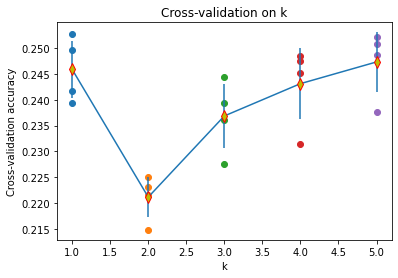

In [42]:
# plot the raw observations
for k in k_choices:
    accuracies = k_to_accuracies[k]
    print('k = %d, average accuracy = %f' % (k, np.average(accuracies)))
    plt.scatter([k] * len(accuracies), accuracies)

# plot the trend line with error bars that correspond to standard deviation
accuracies_mean = np.array([np.mean(v) for k,v in sorted(k_to_accuracies.items())])
accuracies_std = np.array([np.std(v) for k,v in sorted(k_to_accuracies.items())])
plt.errorbar(k_choices, accuracies_mean, yerr=accuracies_std,marker='d',ms='8',mfc='y', mec='r')
plt.title('Cross-validation on k')
plt.xlabel('k')
plt.ylabel('Cross-validation accuracy')
plt.show()